<a href="https://colab.research.google.com/github/ShayGihaz/ML_FinalProject_CNN_Intel-Classification-DataSet/blob/main/finalprojectml.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **Welcome to My Convolutional Neural Network Project**
Welcome!

I am excited to present this project, which leverages the CNNs to classify images from the Intel Image Classification dataset. This notebook is designed to be an accessible and comprehensive guide for anyone interested in understanding and implementing CNNs for image classification.

* *Project Overview*

  In this project, we will undertake the following key steps:
  1. **Installing the Dataset:** We will begin by installing the Intel Image Classification dataset from Kaggle into our Colab environment. Note: You must insert your Kaggle token to access the dataset.
  2. **Exploring the Dataset:** We will explore the dataset by printing several images from each label to understand the data we are working with.
  3. **Data Preparation:** We will split the data into training and testing sets, and create datasets and data loaders for efficient data handling.
  4. **Building a Basic Network:** We will construct a generic basic CNN model to serve as our starting point.
  5. **Training and Testing Loops:** We will implement generic training and testing loops to facilitate the training process.
  6. Improving the Network: We will enhance the basic network to improve its performance.
  7. **Enhancing the Training Process:** We will further improve the training process by implementing k-fold cross-validation.
  8. **Investigating Hyperparameters:** We will investigate various hyperparameters to determine the most suitable settings for our network. The hyperparameters we will focus on include learning rate, number of epochs, batch size, and optimizer. Fine-tuning these parameters is crucial for optimizing the model's performance.
  9. **Removing Noise from the Data:** We will identify and remove noise from the dataset. Noise can negatively impact the training process and overall accuracy, so this step aims to clean the data and improve the model's reliability.
  10. **Augmentation:** We will implement data augmentation techniques to artificially expand the training dataset. This involves applying random transformations such as rotations, flips, and color adjustments to the training images. Augmentation helps prevent overfitting and improves the model's generalization to new, unseen data.

## Objectives

By the end of this project, we will:
* Understand how to set up and preprocess the Intel Image Classification dataset.
* Learn to construct and train a CNN model for image classification.
* Gain insights into improving model performance through network enhancements and advanced training techniques like k-fold cross-validation.

## Acknowledgments

I would like to extend my heartfelt gratitude to Dr. Nir Shlezinger for their guidance and support throughout this project. Their invaluable insights and encouragement have been instrumental in shaping this work.

---

Thank you for taking the time to explore this project. I hope you find it informative and engaging.

# Install & Explore

## **Important Note:**

If you wish to run this notebook in Colab, please upload your Kaggle token to access the dataset before executing any cells. Additionally, to obtain results and visualize the graphs as presented in this notebook, you need to register on [neptune.ai](https://neptune.ai/). After registration, update the code with your API token and project name for each training and testing run to ensure that the plots are saved in your desired project.

## Installations

install pytorch and kaggel libraries


In [ ]:
!pip install -q kaggle


In [ ]:
!pip install neptune

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 502.6/502.6 kB 6.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.3/207.3 kB 19.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 139.2/139.2 kB 14.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 12.3/12.3 MB 50.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 82.2/82.2 kB 10.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 63.9/63.9 kB 9.5 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 137.9/137.9 kB 17.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 62.7/62.7 kB 8.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 66.4/66.4 kB 9.9 MB/s eta 0:00:00
  Created wheel for bravado-core: filename=bravado_core-6.1.1-py2.py3-none-any.whl size=67672 sha256=4b0e1502be9d7f1e93c67e65ea2cb490008f0cc79325f649ddb4bd3b3db10599
  Stored in directory: /root/.cache/pip/wheels/42/35/4a/44ec

In [ ]:
!mkdir -p ~/.kaggle
!mv kaggle.json ~/.kaggle/

In [ ]:
!chmod 600 /root/.kaggle/kaggle.json

download the data sets from kaggel




In [ ]:
!kaggle datasets download -d puneet6060/intel-image-classification

Dataset URL: https://www.kaggle.com/datasets/puneet6060/intel-image-classification
License(s): copyright-authors
100% 345M/346M [00:05<00:00, 43.2MB/s]
100% 346M/346M [00:05<00:00, 66.9MB/s]


extract zip file to DataSets folder


In [ ]:
!unzip -q /content/intel-image-classification.zip -d DataSets

##Import Cell

In [ ]:
#imports cell
import pandas as pd
import numpy as np
import os
import shutil
import random
import torch
from zipfile import ZipFile
from torchvision.io import read_image
from torch.utils.data import Dataset, Subset
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
from torchvision import datasets, transforms
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report, confusion_matrix
from PIL import Image
from torch.utils.data import DataLoader, TensorDataset
from tqdm import tqdm
import neptune
from sklearn.model_selection import StratifiedKFold, KFold

device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
#device = torch.device("cpu")
print(device)


cpu


## Combine Images

We will create a function that consolidates images from all existing directories (train and test) into a single directory, while simultaneously generating a comprehensive table of all images.

From this combined directory, we will then split the data according to our requirements.

This approach is necessary due to the specifications of our custom dataset.

In [ ]:
#creating a dict for labeling the dataset to unic numbers
labels_map = {
    'street': 0,
    'sea': 1,
    'mountain': 2,
    'glacier': 3,
    'forest': 4,
    'buildings': 5,
}

In [ ]:
def combine_images(source, destination):
    """
    this function get list of paths, combine all the images
    from the different paths to one path and return pd.dataframe
    that maps every image to its label.
    """
    counter = 0
    d = {'id': [], 'label': [], 'labelNumber': []}
    labelTable = pd.DataFrame(data=d)
    for i in source:
      folderName = i.split("/")[-1]
      files = sorted(os.listdir(i))
      # Iterate over each file in the source directory
      for j in files:
          # create a new row
          new_row = pd.DataFrame({'id': f"{counter}.jpg", 'label': folderName,'labelNumber': [labels_map[folderName]]})
          # adding a new row to the existind dataframe
          labelTable = pd.concat([labelTable, new_row], ignore_index=True)

          source_image_path = os.path.join(i, j)
          destination_image_path = os.path.join(destination, f"{counter}.jpg")

          counter += 1

          # Copy or move the image to the destination folder
          shutil.copy(source_image_path, destination_image_path)
    return labelTable


The following code box creates the 'DataSetCombine' directory.

If the directory already exists, we must check for any files within it. The presence of files could lead to image duplication, even if the files have different names.

To prevent this, we will delete the existing directory and recreate it with the same name, ensuring it is empty and ready to receive all the images.

In [ ]:
destination_folderPath = '/content/DataSetCombine'
if os.path.exists(destination_folderPath):
  numOfFiles = os.listdir(destination_folderPath)
  if len(numOfFiles) != 0:
    shutil.rmtree(destination_folderPath)
    os.makedirs(destination_folderPath, exist_ok=True)
else:
  os.makedirs(destination_folderPath, exist_ok=True)


In [ ]:
sourceFolders = ['/content/DataSets/seg_train/seg_train/buildings',
                      '/content/DataSets/seg_train/seg_train/forest',
                      '/content/DataSets/seg_train/seg_train/glacier',
                      '/content/DataSets/seg_train/seg_train/mountain',
                      '/content/DataSets/seg_train/seg_train/sea',
                      '/content/DataSets/seg_train/seg_train/street',
                      '/content/DataSets/seg_test/seg_test/buildings',
                      '/content/DataSets/seg_test/seg_test/forest',
                      '/content/DataSets/seg_test/seg_test/glacier',
                      '/content/DataSets/seg_test/seg_test/mountain',
                      '/content/DataSets/seg_test/seg_test/sea',
                      '/content/DataSets/seg_test/seg_test/street']



In [ ]:
fullTable = combine_images(sourceFolders, destination_folderPath)

## DataFrame - fullTable

*Sanity check:*

In [ ]:
fullTable

,id,label,labelNumber
0,0.jpg,buildings,5.0
1,1.jpg,buildings,5.0
2,2.jpg,buildings,5.0
3,3.jpg,buildings,5.0
4,4.jpg,buildings,5.0
...,...,...,...
17029,17029.jpg,street,0.0
17030,17030.jpg,street,0.0
17031,17031.jpg,street,0.0
17032,17032.jpg,street,0.0


## Data Distribution

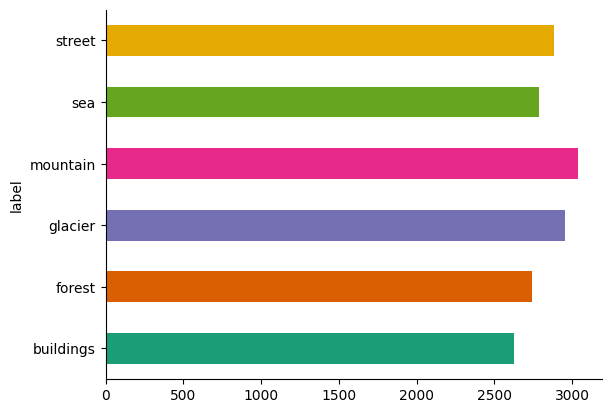

In [ ]:
fullTable.groupby('label').size().plot(kind='barh', color=sns.palettes.mpl_palette('Dark2'))
plt.gca().spines[['top', 'right',]].set_visible(False)

we can see that the distribution of the different labels is uniform.

*Sanity check*

In [ ]:
numOfFiles = os.listdir(destination_folderPath)
len(numOfFiles)

17034

## Image Dataset

The `ImageDataset` class is a custom dataset tailored for the Intel image classification dataset. It extends PyTorch's `Dataset` class, allowing us to efficiently manage and preprocess our dataset.



In [ ]:
class ImageDataset(Dataset):
    """
    custume dataset for intel dataset.
    """
    def __init__(self, tableOfPicture, imgDir, transform=None, target_transform=None):
        self.imgLabels = tableOfPicture
        self.imgDir = imgDir
        self.transform = transform
        self.target_transform = target_transform

    def __len__(self):
        return len(self.imgLabels)

    def __getitem__(self, idx):
        imgPath = os.path.join(self.imgDir, self.imgLabels.iloc[idx, 0])
        image = read_image(imgPath)
        label = self.imgLabels.iloc[idx, 2]
        imageId = self.imgLabels.iloc[idx, 0].split('.')[0] #split the name of the file from the .jpg
        if self.transform:
            image = self.transform(image)
        if self.target_transform:
            label = self.target_transform(label)
        return image, int(label), int(imageId)

In [ ]:
# here we are resize all the images to 150x150.
# we notice that several images are not in this size there for we are doing this.
transform = transforms.Resize((150, 150))
dataset = ImageDataset(fullTable, destination_folderPath, transform)

In [ ]:
dataset[0]

(tensor([[[247, 247, 248,  ..., 248, 247, 247],
          [246, 247, 247,  ..., 248, 247, 247],
          [246, 246, 247,  ..., 248, 247, 247],
          ...,
          [ 47,  62,  49,  ...,  51,  45,  94],
          [ 77,  47,  43,  ...,  22,  55,  39],
          [ 59,  55,  60,  ...,  31,  51,  63]],
 
         [[247, 247, 248,  ..., 248, 247, 247],
          [246, 247, 247,  ..., 248, 247, 247],
          [246, 246, 247,  ..., 248, 247, 247],
          ...,
          [ 46,  61,  48,  ...,  46,  40,  89],
          [ 76,  46,  42,  ...,  17,  50,  34],
          [ 58,  54,  59,  ...,  26,  46,  58]],
 
         [[245, 245, 246,  ..., 248, 245, 245],
          [244, 245, 245,  ..., 248, 245, 245],
          [244, 244, 245,  ..., 248, 245, 245],
          ...,
          [ 44,  59,  46,  ...,  43,  37,  86],
          [ 74,  44,  40,  ...,  14,  47,  31],
          [ 56,  52,  57,  ...,  23,  43,  55]]], dtype=torch.uint8),
 5,
 0)

In [ ]:
#create an invert dict to print label as string
inverted_labels_map = {v: k for k, v in labels_map.items()}

## Print Image

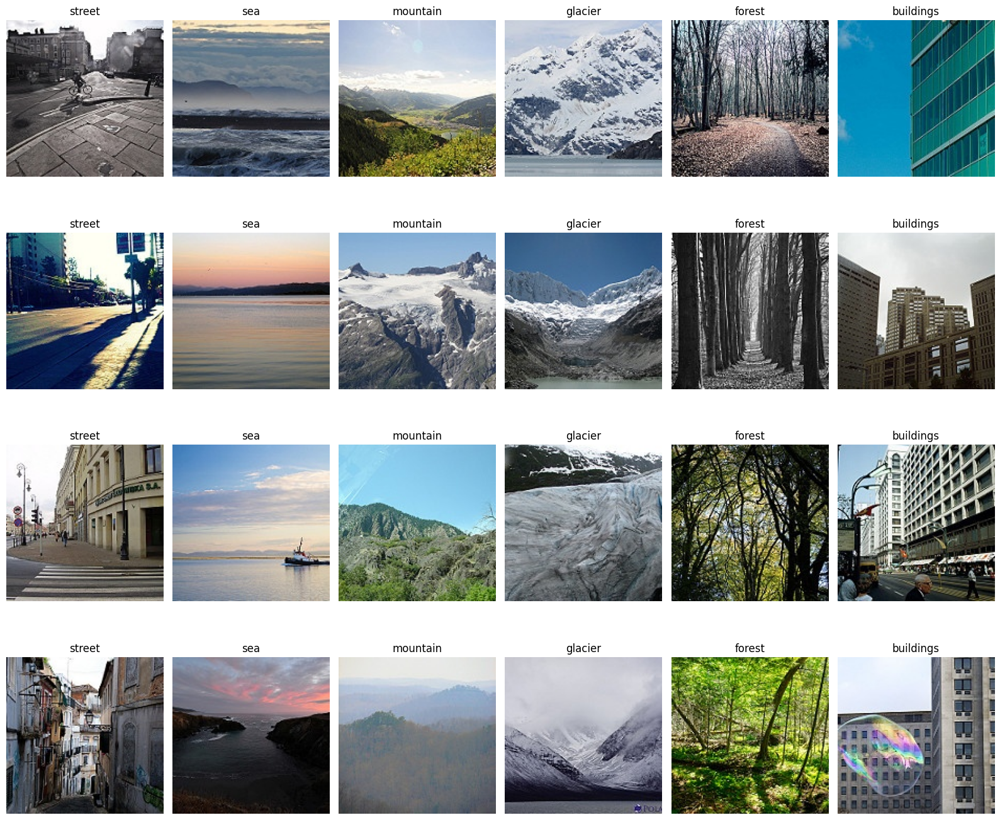

In [ ]:
#in this section we print 24 images.
#in each row we will get 6 images such as in each row we will have the 6 different labels.

fig, axes = plt.subplots(4, 6, figsize=(16, 14))  #4x6 grid of subplots
for i in range(4):  #rows
  for j in range(6):  #columns
    ax = axes[i, j]
    randImageNum = random.randint(0, 17033)
    label = dataset[randImageNum][1]
    while label != j:
      randImageNum = random.randint(0, 17033)
      label = dataset[randImageNum][1]
    image = np.array(dataset[randImageNum][0])
    ax.imshow(image.transpose(1, 2, 0)) # squeeze Remove axes of length one
    ax.axis('off')  # Turn off axis
    ax.set_title(inverted_labels_map[label])

plt.tight_layout()
plt.show()


# Data Preparation

## Split-Test

### **Splitting the Dataset into Training and Testing Sets**


In machine learning, there are several common techniques for splitting data into training and testing sets. For our dataset, which consists of 17,034 images with a relatively uniform class distribution, we will leverage Colab's GPU capabilities and aim to preserve this original distribution.

We will use the Train-Test Split method, which randomly divides the dataset into training and testing sets while maintaining the original class distribution. Given the uniform distribution of our classes, there is no need for more complex techniques like stratified sampling or k-fold cross-validation. These advanced methods are generally used for imbalanced datasets to ensure each class is adequately represented in both the training and testing sets.

For our project, we will split the data with 15% allocated for testing and the remaining 85% for training. This approach ensures a sufficient amount of data for both training and evaluating our model.

In [ ]:

X = fullTable.index  # Extract indices
y = fullTable['labelNumber'].values  # Extract labels

# Split the data into training and testing sets by scikit-learn func
idxTrain, idxTest, labelTrain, labelTest = train_test_split(X, y, test_size=0.15, random_state=156, stratify=y)


# Create training and testing DataFrames
trainDataFrame = pd.DataFrame({'image_path': idxTrain, 'label': labelTrain})
TestDataFrame = pd.DataFrame({'image_path': idxTest, 'label': labelTest})


In [ ]:
trainDataFrame

,image_path,label
0,96,5.0
1,16639,0.0
2,8334,2.0
3,13994,0.0
4,10960,1.0
5,7996,2.0
6,11959,0.0
7,1618,5.0
8,12654,0.0
9,3383,4.0


In [ ]:
TestDataFrame

,image_path,label
0,6357,3.0
1,5600,3.0
2,14219,5.0
3,12337,0.0
4,8489,2.0
...,...,...
2551,13473,0.0
2552,10108,1.0
2553,7671,2.0
2554,221,5.0


## Data Loaders

Data loaders play a crucial role in efficiently managing and processing the dataset by dividing it into batches. The batch size determines how frequently the model updates its weights during training, a process known as backpropagation. By adjusting the batch size, we can influence the learning dynamics and performance of our model.

In the future, as we progress with the model, we may experiment with different batch sizes to optimize the training process and improve the model's performance.

Data loaders not only handle the batching of data but also streamline the data loading process, making it more efficient and ensuring smooth integration with GPU acceleration provided by Google Colab.

In [ ]:
TrainX = np.array([dataset[i][0] for i in idxTrain])
TrainY = np.array([dataset[i][1] for i in idxTrain])
TrainZ = np.array([dataset[i][2] for i in idxTrain])  #ID train of the images


In [ ]:
tensorTrainX = torch.tensor(TrainX, dtype=torch.float32)
tensorTrainY = torch.tensor(TrainY, dtype=torch.long)
tensorTrainZ = torch.tensor(TrainZ, dtype=torch.long)

In [ ]:
# Create a TensorDataset object from the data
tensorDatasetTrain = TensorDataset(tensorTrainX, tensorTrainY, tensorTrainZ)

# Create a DataLoader object with batch size 64
trainDataloader = DataLoader(tensorDatasetTrain, batch_size=32, shuffle=True)

In [ ]:
TrainX.shape

(14478, 3, 150, 150)

In [ ]:
TestX = np.array([dataset[j][0] for j in idxTest])
TestY = np.array([dataset[j][1] for j in idxTest])
TestZ = np.array([dataset[j][2] for j in idxTest])    #ID test of the images

In [ ]:
tensorTestX = torch.tensor(TestX, dtype=torch.float32)
tensorTestY = torch.tensor(TestY, dtype=torch.long)
tensorTestZ = torch.tensor(TestZ, dtype=torch.long)


In [ ]:
tensorDatasetTest = TensorDataset(tensorTestX, tensorTestY, tensorTestZ)
testDataloader = DataLoader(tensorDatasetTest, batch_size=32, shuffle=True)

## Basic Network

Before deiving into complex architectures, I'll start by constructing the most basic network to ensure that all components are functioning correctly. This preliminary network will serve as a foundation for subsequent enhancements, including additional layers, depth, normalization, and initialization techniques.

### Convolution

The core of our network will be convolutional layers, designed to compress the dimensions of the input image while preserving essential information. Convolution operates by applying filters to the input image, extracting features, and producing feature maps that represent different aspects of the image.

### Scaling Up: Adding Complexity

As we progress, we'll gradually augment the network's complexity to improve its performance. Key enhancements will include:

* Padding: Adding zero-padding to the convolutional layers to preserve spatial dimensions and prevent information loss at the borders.

* Increasing Depth: Introducing additional convolutional layers to capture more intricate features and patterns in the data.

* Adjusting Architecture: Fine-tuning the network's architecture by tweaking parameters such as kernel size, number of output channels, and pooling size to optimize performance.

By iteratively refining and expanding the network, we'll delve into nuances such as optimal kernel sizes, pooling strategies, and feature map dimensions, ensuring that our model evolves into a robust and effective image classifier.

The convolutional neural network is comprised of **two** convolutional layers subsequect by two fully-connetected ones. For the former, we have:

*   kernel size $F_c=3$
*   number of output channels $D_2$ is a hyperparameter are the out_channels from each convolutional, controlling the number of trainable parameters
* the number of input channels is $D_1=3$ as we have RGB images
*   each convolutaional layer is followed by a ReLU activation and a MaxPooling layer with kernel size $F_p=2$.

Note chages in the diemnsions over the layers:
*   After passing through the first convolutional layer,
$$H_1 (=150) \times W_1 (=150) \times D_1 (=3) \\ ↓ \\
 H_2 (=H_1-F_c+1 = 148) \times W_2 (=W_1-F_c+1 = 148) \times D_2 (= 6) =148\times 148 \times 6. $$
 Which, after MaxPooling, the size is reduced to
$$74\times 74 \times 6. $$
*   Then, the secod layer converts to
$$H_3 (=H_2-F_c+1) \times W_3 (=W_2-F_c+1) \times D_2 (=6) =72\times 72 \times 6, $$ which after MaxPooling is reduced to $$36\times 36 \times 6.$$

*   Then, the third layer converts to
$$H_4 (=H_3-F_c+1) \times W_4 (=W_3-F_c+1) \times D_3 (=6) =34\times 34 \times 6, $$ which after MaxPooling is reduced to $$17\times 17 \times 6.$$

*   Then, the forth layer converts to
$$H_5 (=H_4-F_c(=4)+1) \times W_5 (=W_4-F_c(=4)+1) \times D_4 (=6) =14\times 14 \times 6, $$ which after MaxPooling is reduced to $$7\times 7 \times 6.$$

For this reason, the input to the fully-connetected layer is of size $6\cdot 7 \cdot 7$.


In [ ]:
class BasicCNN(nn.Module):
    def __init__(self, numLabels):
        super().__init__()
        self.conv1 = nn.Conv2d(3, 6, 3)          # 3=RGB, 6=numbers of kernels , 3=kernel size (7x7) --> 6 outputs, outputShape = 6x74x74
        self.pool = nn.MaxPool2d(2, 2)           # 2=2x2 pooling size, 2=stride 2 --> no overlap, outputShape = outputs x (w/2) x (h/2)
        self.conv2 = nn.Conv2d(6, 6, 3)          # 6=6 outputs from the previous layer, 6=numbers of kernels , 7=kernel size (7x7) --> 6 outputs , outputShape = 6x36x36
        self.conv3 = nn.Conv2d(6, 6, 3)          # 6=6 outputs from the previous layer, 6=numbers of kernels , 8=kernel size (8x8) --> 6 outputs , outputShape = 6x17x17
        self.conv4 = nn.Conv2d(6, 6, 4)          # 6=6 outputs from the previous layer, 6=numbers of kernels , 8=kernel size (8x8) --> 6 outputs , outputShape = 6x7x7
        self.fc1 = nn.Linear(6 * 7 * 7, 60)
        self.fc2 = nn.Linear(60, numLabels)

    def forward(self, x):
        x = self.pool(F.relu(self.conv1(x)))
        x = self.pool(F.relu(self.conv2(x)))
        x = self.pool(F.relu(self.conv3(x)))
        x = self.pool(F.relu(self.conv4(x)))
        x = x.view(-1, 6 * 7 * 7)              # flatten all dimensions except batch
        x = F.relu(self.fc1(x))
        x = self.fc2(x)
        return x

### **A few notes**
*  Currently, we will not initialize the weights because we first want to ensure that everything functions correctly and that there is a basic model that works.

* In every network I have encountered, a layer called ReLU is included, which led me to question its purpose. The answer is that without ReLU or another activation function, the next layer would receive a linear output, preventing the model from learning complex patterns. The purpose of an activation function is to introduce non-linearity, enabling the model to learn more intricate patterns.

*  We chose Cross Entropy Loss as our loss function. This function accepts the logits, which are the outputs of the last layer, and internally applies the softmax function.

# Training and Testing Loops

## Train Loop

In [ ]:
def train(model, dataLoaderTrain, optimizer, epochs, criterion, dataLoaderValidation=None):
    model.train()


    for epoch in range(epochs):
      accuracy = 0.0
      predList = None
      labelList = None
      correct = 0
      valAcc = 0
      valLoss = 0
      with tqdm(dataLoaderTrain, unit="batch") as tepoch:
        for batch_idx, (data, label, id) in enumerate(tepoch):
            tepoch.set_description(f"Epoch {epoch}")

            # send to device
            data, label, id = data.to(device), label.to(device), id.to(device)

            optimizer.zero_grad()
            output = model(data)
            loss = criterion(output, label)
            loss.backward()
            optimizer.step()

            # print statistics
            pred = output.data.max(1, keepdim=True)[1] # get the index of the max log-probability
            correctBatch = pred.eq(label.data.view_as(pred)).cpu().sum().item()
            correct += correctBatch
            run["train/loss"].append(loss.item())
            run["train/acc"].append(correctBatch/len(label))


            if batch_idx == 0:
              predList = pred
              labelList = label
            else:
              predList = torch.cat((predList, pred), 0)
              labelList = torch.cat((labelList, label), 0)

        accuracy = 100. * correct / len(dataLoaderTrain.dataset)
        report2 = classification_report(labelList.cpu(), predList.cpu())
        print(report2)

        #Validtion part
        tepoch.close()
        if dataLoaderValidation != None:
          print(f"Validtion part------EPOCH------:{epoch}")
          if epoch == epochs -1:
            valAcc, valLoss = test(model, dataLoaderValidation, criterion ,lastEpoch = True, val=True)
          else:
            valAcc, valLoss = test(model, dataLoaderValidation, criterion ,lastEpoch = False, val=True)



    return accuracy, loss.item() , valAcc, valLoss        #we return this val for k fold calculation acc&loss for each fold

## Test-Val Loop

During the testing phase, we switch the model to evaluation mode using `model.eval()`.

This step is crucial because it ensures that certain layers, such as dropout or normalization layers, which are used during training for regularization purposes, are deactivated. This allows the model to make predictions without interference from these layers, ensuring accurate evaluation of its performance.

#### **Key Differences**


* **Evaluation Mode:** We use `model.eval()` to switch the model to evaluation mode, ensuring that only relevant layers are active during inference.
* **with `torch.no_grad()`** Context Manager: This context manager temporarily disables gradient calculation, preventing PyTorch from tracking operations for automatic differentiation. During testing, we don't need to calculate gradients or update weights, so this context manager helps improve efficiency by skipping unnecessary computations.
* **No Backpropagation:** Unlike the training loop, there is no reference to backpropagation or optimizer steps in the testing loop. This means that the weights of the model are not updated during testing, as it's solely focused on evaluating the model's performance on unseen data.


By distinguishing between training and testing phases and appropriately configuring the model's behavior, we ensure accurate evaluation and reliable performance assessment.

In [ ]:
def test(model, dataLoader, criterion, lastEpoch=None, val=False, kfold=None):
    model.eval()

    predDataFrame = pd.DataFrame({'id':[], 'pred':[], 'label':[]})
    accuracy = 0.0
    predList = None
    labelList = None
    correct = 0
    correctBatch = 0
    with tqdm(dataLoader, unit="batch") as loader:
      with torch.no_grad():
        for batch_idx, (data, label, id) in enumerate(loader):


          # send to device
          data, label, id = data.to(device), label.to(device), id.to(device)

          output = model(data)
          loss = criterion(output, label)

          # print statistics
          pred = output.data.max(1, keepdim=True)[1] # get the index of the max log-probability
          correctBatch = pred.eq(label.data.view_as(pred)).cpu().sum().item()
          correct += correctBatch

          if val == True:
            run["val/loss"].append(loss.item())
            run["val/acc"].append(correctBatch/len(label))
          else:
            run["test/loss"].append(loss.item())
            run["test/acc"].append(correctBatch/len(label))

          if batch_idx == 0:
            predList = pred
            labelList = label
          else:
            predList = torch.cat((predList, pred), 0)
            labelList = torch.cat((labelList, label), 0)

          #this statment to create a table in the last epoch
          #the table shows the prediction and the true label for each image.
          new_row_epoch = pd.DataFrame({'id': id.cpu(), 'pred': pred.cpu().flatten(),'label': label.cpu()})
          # adding a new row to the existind dataframe
          predDataFrame = pd.concat([predDataFrame, new_row_epoch], ignore_index=True)


        accuracy = 100. * correct / len(dataLoader.dataset)
        report1 = classification_report(labelList.cpu(), predList.cpu())
        if lastEpoch == True:
           run["val/pred"]= neptune.types.File.as_html(predDataFrame)
        if val==False:
           run["test/pred"]= neptune.types.File.as_html(predDataFrame)
        print(report1)

    return accuracy, loss.item()      #we return this val for k fold calculation acc&loss for each fold

In the next section, we will execute the basic model we have constructed, starting with the training phase followed by the testing phase.

The initial lines of code establish a connection to the Neptune platform, which provides comprehensive data for analysis. This includes visualizations, such as graphs, and detailed metrics like accuracy and prediction tables, allowing us to thoroughly explore and evaluate the network's performance.

In [ ]:
run = neptune.init_run(
    project="gihazshay/finalProjectML",
    api_token="eyJhcGlfYWRkcmVzcyI6Imh0dHBzOi8vYXBwLm5lcHR1bmUuYWkiLCJhcGlfdXJsIjoiaHR0cHM6Ly9hcHAubmVwdHVuZS5haSIsImFwaV9rZXkiOiI0Mjc3OWFhMi0zYWI3LTRiMjQtYjFiMC0xMGNkYWU4MjBkOTcifQ==",
)

params = {"learning_rate": 0.0001, "optimizer": "Adam"}
run["parameters"] = params

net = BasicCNN(numLabels=6)
net = net.to(device)
criterionBasic = nn.CrossEntropyLoss()
optimizerBasic = optim.Adam(net.parameters(), lr=0.0001)    #net.parameters is the wight of the NN
accuracyt, loss = train(net, trainDataloader, optimizerBasic, 10, criterionBasic)
testModel = test(net, testDataloader, criterionBasic)

run.stop()

[neptune] [warning] NeptuneWarning: The following monitoring options are disabled by default in interactive sessions: 'capture_stdout', 'capture_stderr', 'capture_traceback', and 'capture_hardware_metrics'. To enable them, set each parameter to 'True' when initializing the run. The monitoring will continue until you call run.stop() or the kernel stops. Also note: Your source files can only be tracked if you pass the path(s) to the 'source_code' argument. For help, see the Neptune docs: https://docs.neptune.ai/logging/source_code/


[neptune] [info   ] Neptune initialized. Open in the app: https://app.neptune.ai/gihazshay/finalProjectML/e/FIN-207


Epoch 0:   0%|          | 0/453 [00:00<?, ?batch/s]/usr/local/lib/python3.10/dist-packages/torch/autograd/graph.py:744: UserWarning: Plan failed with a cudnnException: CUDNN_BACKEND_EXECUTION_PLAN_DESCRIPTOR: cudnnFinalize Descriptor Failed cudnn_status: CUDNN_STATUS_NOT_SUPPORTED (Triggered internally at ../aten/src/ATen/native/cudnn/Conv_v8.cpp:919.)
  return Variable._execution_engine.run_backward(  # Calls into the C++ engine to run the backward pass
Epoch 0: 100%|██████████| 453/453 [00:11<00:00, 40.66batch/s]


              precision    recall  f1-score   support

           0       0.63      0.66      0.65      2464
           1       0.46      0.28      0.35      2370
           2       0.55      0.55      0.55      2567
           3       0.51      0.64      0.57      2533
           4       0.79      0.78      0.79      2343
           5       0.47      0.51      0.49      2201

    accuracy                           0.57     14478
   macro avg       0.57      0.57      0.57     14478
weighted avg       0.57      0.57      0.57     14478



Epoch 1: 100%|██████████| 453/453 [00:10<00:00, 43.20batch/s]


              precision    recall  f1-score   support

           0       0.77      0.79      0.78      2464
           1       0.64      0.56      0.60      2370
           2       0.66      0.64      0.65      2567
           3       0.66      0.75      0.70      2533
           4       0.89      0.88      0.88      2343
           5       0.69      0.70      0.69      2201

    accuracy                           0.72     14478
   macro avg       0.72      0.72      0.72     14478
weighted avg       0.72      0.72      0.72     14478



Epoch 2: 100%|██████████| 453/453 [00:10<00:00, 41.88batch/s]


              precision    recall  f1-score   support

           0       0.86      0.88      0.87      2464
           1       0.76      0.72      0.74      2370
           2       0.76      0.74      0.75      2567
           3       0.75      0.80      0.78      2533
           4       0.94      0.93      0.93      2343
           5       0.82      0.81      0.81      2201

    accuracy                           0.81     14478
   macro avg       0.81      0.81      0.81     14478
weighted avg       0.81      0.81      0.81     14478



Epoch 3: 100%|██████████| 453/453 [00:10<00:00, 42.73batch/s]


              precision    recall  f1-score   support

           0       0.93      0.93      0.93      2464
           1       0.85      0.83      0.84      2370
           2       0.84      0.84      0.84      2567
           3       0.84      0.85      0.84      2533
           4       0.97      0.96      0.96      2343
           5       0.91      0.91      0.91      2201

    accuracy                           0.89     14478
   macro avg       0.89      0.89      0.89     14478
weighted avg       0.89      0.89      0.89     14478



Epoch 4: 100%|██████████| 453/453 [00:10<00:00, 43.21batch/s]


              precision    recall  f1-score   support

           0       0.97      0.97      0.97      2464
           1       0.93      0.93      0.93      2370
           2       0.92      0.92      0.92      2567
           3       0.92      0.93      0.93      2533
           4       0.99      0.98      0.98      2343
           5       0.96      0.96      0.96      2201

    accuracy                           0.95     14478
   macro avg       0.95      0.95      0.95     14478
weighted avg       0.95      0.95      0.95     14478



Epoch 5: 100%|██████████| 453/453 [00:11<00:00, 38.81batch/s]


              precision    recall  f1-score   support

           0       0.99      0.98      0.99      2464
           1       0.96      0.96      0.96      2370
           2       0.95      0.96      0.95      2567
           3       0.96      0.95      0.96      2533
           4       0.99      0.98      0.98      2343
           5       0.98      0.98      0.98      2201

    accuracy                           0.97     14478
   macro avg       0.97      0.97      0.97     14478
weighted avg       0.97      0.97      0.97     14478



Epoch 6: 100%|██████████| 453/453 [00:10<00:00, 41.70batch/s]


              precision    recall  f1-score   support

           0       0.99      0.99      0.99      2464
           1       0.98      0.98      0.98      2370
           2       0.97      0.97      0.97      2567
           3       0.98      0.98      0.98      2533
           4       0.99      0.99      0.99      2343
           5       0.99      0.99      0.99      2201

    accuracy                           0.98     14478
   macro avg       0.98      0.98      0.98     14478
weighted avg       0.98      0.98      0.98     14478



Epoch 7: 100%|██████████| 453/453 [00:10<00:00, 42.35batch/s]


              precision    recall  f1-score   support

           0       0.99      0.99      0.99      2464
           1       0.98      0.98      0.98      2370
           2       0.98      0.98      0.98      2567
           3       0.98      0.99      0.98      2533
           4       1.00      0.99      0.99      2343
           5       0.99      0.99      0.99      2201

    accuracy                           0.99     14478
   macro avg       0.99      0.99      0.99     14478
weighted avg       0.99      0.99      0.99     14478



Epoch 8: 100%|██████████| 453/453 [00:11<00:00, 40.92batch/s]


              precision    recall  f1-score   support

           0       0.99      0.99      0.99      2464
           1       0.99      0.99      0.99      2370
           2       0.98      0.99      0.99      2567
           3       0.99      0.99      0.99      2533
           4       1.00      0.99      0.99      2343
           5       0.99      0.99      0.99      2201

    accuracy                           0.99     14478
   macro avg       0.99      0.99      0.99     14478
weighted avg       0.99      0.99      0.99     14478



Epoch 9: 100%|██████████| 453/453 [00:10<00:00, 41.78batch/s]


              precision    recall  f1-score   support

           0       0.98      0.98      0.98      2464
           1       0.98      0.98      0.98      2370
           2       0.98      0.98      0.98      2567
           3       0.98      0.98      0.98      2533
           4       0.99      0.99      0.99      2343
           5       0.98      0.98      0.98      2201

    accuracy                           0.98     14478
   macro avg       0.98      0.98      0.98     14478
weighted avg       0.98      0.98      0.98     14478



100%|██████████| 80/80 [00:00<00:00, 96.24batch/s]


              precision    recall  f1-score   support

           0       0.77      0.74      0.76       419
           1       0.68      0.73      0.71       414
           2       0.72      0.67      0.69       470
           3       0.70      0.73      0.71       424
           4       0.85      0.93      0.89       402
           5       0.76      0.70      0.73       427

    accuracy                           0.75      2556
   macro avg       0.75      0.75      0.75      2556
weighted avg       0.75      0.75      0.74      2556

[neptune] [info   ] Shutting down background jobs, please wait a moment...
[neptune] [info   ] Done!
[neptune] [info   ] Waiting for the remaining 37 operations to synchronize with Neptune. Do not kill this process.
[neptune] [info   ] All 37 operations synced, thanks for waiting!
[neptune] [info   ] Explore the metadata in the Neptune app: https://app.neptune.ai/gihazshay/finalProjectML/e/FIN-207/metadata


# Basic Network Results

* First row:
  * Left - Test accuracy (average: 0.75)
  * Right - Test loss (average: 0.776)
* Second row:
  * Left - Train accuracy (average: 0.654, last accuracy value: 0.857)
  * Right - Train loss (average: 0.84, last loss value: 0.52)


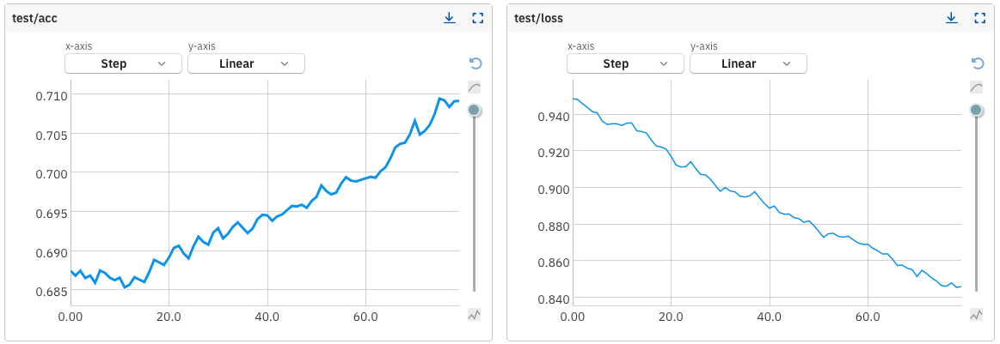

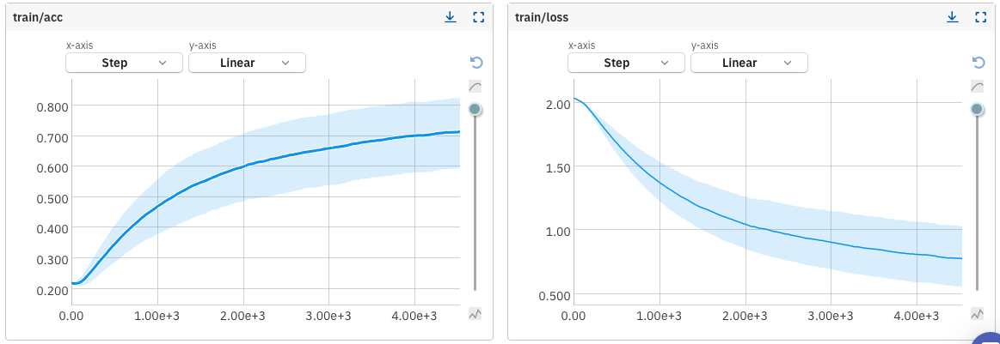

# New Architectures and Comparison

* FrstArchBasicCNN - From 4 convolution layers to 3 convolution layers and the kernel sizes is differet.

* SecArchBasicCNN - 2 convolution layers and more fully connected layers.

In [ ]:
class FrstArchBasicCNN(nn.Module):
    def __init__(self, numLabels):
        super().__init__()
        self.conv1 = nn.Conv2d(3, 6, 7)          # 3=RGB, 6=numbers of kernels , 7=kernel size (7x7) --> 6 outputs, outputShape after pool = 6x72x72
        self.pool = nn.MaxPool2d(2, 2)           # 2=2x2 pooling size, 2=stride 2 --> no overlap, outputShape = outputs x (w/2) x (h/2)
        self.conv2 = nn.Conv2d(6, 6, 7)          # 6=6 outputs from the previous layer, 6=numbers of kernels , 7=kernel size (7x7) --> 6 outputs , outputShape after pool = 6x33x33
        self.conv3 = nn.Conv2d(6, 6, 8)          # 6=6 outputs from the previous layer, 6=numbers of kernels , 8=kernel size (8x8) --> 6 outputs , outputShape after pool = 6x13x13
        self.fc1 = nn.Linear(6 * 13 * 13, 150)
        self.fc2 = nn.Linear(150, numLabels)

    def forward(self, x):
        x = self.pool(F.relu(self.conv1(x)))
        x = self.pool(F.relu(self.conv2(x)))
        x = self.pool(F.relu(self.conv3(x)))
        x = x.view(-1, 6 * 13 * 13)              # flatten all dimensions except batch
        x = F.relu(self.fc1(x))
        x = self.fc2(x)
        return x

In [ ]:
run = neptune.init_run(
    project="gihazshay/finalProjectML",
    api_token="eyJhcGlfYWRkcmVzcyI6Imh0dHBzOi8vYXBwLm5lcHR1bmUuYWkiLCJhcGlfdXJsIjoiaHR0cHM6Ly9hcHAubmVwdHVuZS5haSIsImFwaV9rZXkiOiI0Mjc3OWFhMi0zYWI3LTRiMjQtYjFiMC0xMGNkYWU4MjBkOTcifQ==",
)

params = {"learning_rate": 0.0001, "optimizer": "Adam"}
run["parameters"] = params

net = FrstArchBasicCNN(numLabels=6)
net = net.to(device)
criterionBasic = nn.CrossEntropyLoss()
optimizerBasic = optim.Adam(net.parameters(), lr=0.0001)    #net.parameters is the wight of the NN
trainModel = train(net, trainDataloader, optimizerBasic, 10, criterionBasic)
testModel = test(net, testDataloader, criterionBasic)

run.stop()

[neptune] [warning] NeptuneWarning: The following monitoring options are disabled by default in interactive sessions: 'capture_stdout', 'capture_stderr', 'capture_traceback', and 'capture_hardware_metrics'. To enable them, set each parameter to 'True' when initializing the run. The monitoring will continue until you call run.stop() or the kernel stops. Also note: Your source files can only be tracked if you pass the path(s) to the 'source_code' argument. For help, see the Neptune docs: https://docs.neptune.ai/logging/source_code/


[neptune] [info   ] Neptune initialized. Open in the app: https://app.neptune.ai/gihazshay/finalProjectML/e/FIN-223


NameError: name 'FrstArchBasic' is not defined

* First row:
  * Left - Test accuracy (averge: 0.72)
  * Right - Test loss (averge: 0.79)
* Second row:
  * Left - Train accuracy (averge: 0.74, last accuracy value: 0.857)
  * Right - Train loss (averge: 0.69, last loss value: 0.301)

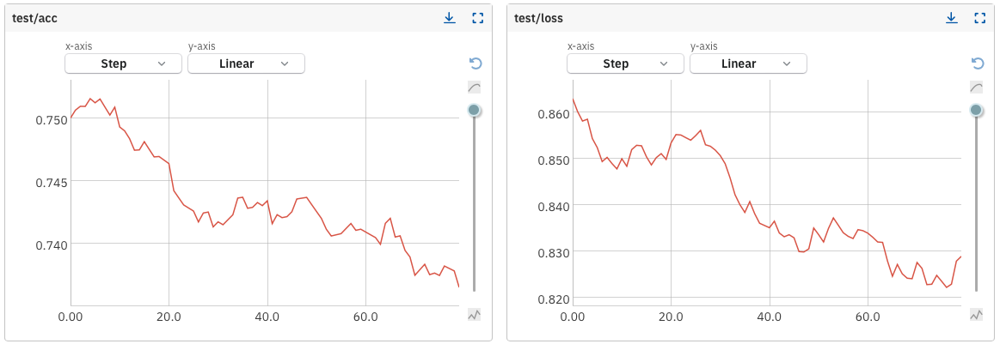

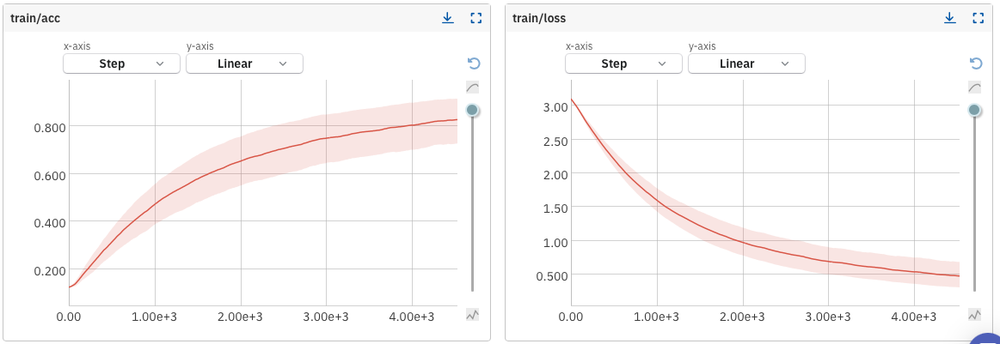

In [ ]:
class SecArchBasicCNN(nn.Module):
    def __init__(self, numLabels):
        super().__init__()
        self.conv1 = nn.Conv2d(3, 6, 7)          # 3=RGB, 6=numbers of kernels , 7=kernel size (7x7) --> 6 outputs, outputShape = 6x72x72
        self.pool = nn.MaxPool2d(2, 2)           # 2=2x2 pooling size, 2=stride 2 --> no overlap, outputShape = outputs x (w/2) x (h/2)
        self.conv2 = nn.Conv2d(6, 16, 7)         # 6=6 outputs from the previous layer, 16=numbers of kernels , 7=kernel size (7x7) --> 16 outputs , outputShape = 16x33x33
        self.fc1 = nn.Linear(16 * 33 * 33, 1000)
        self.fc2 = nn.Linear(1000, 700)
        self.fc3 = nn.Linear(700, 100)
        self.fc4 = nn.Linear(100, numLabels)

    def forward(self, x):
        x = self.pool(F.relu(self.conv1(x)))
        x = self.pool(F.relu(self.conv2(x)))
        x = x.view(-1, 16 * 33 * 33)              # flatten all dimensions except batch
        x = F.relu(self.fc1(x))
        x = F.relu(self.fc2(x))
        x = F.relu(self.fc3(x))
        x = self.fc4(x)
        return x

In [ ]:
run = neptune.init_run(
    project="gihazshay/finalProjectML",
    api_token="eyJhcGlfYWRkcmVzcyI6Imh0dHBzOi8vYXBwLm5lcHR1bmUuYWkiLCJhcGlfdXJsIjoiaHR0cHM6Ly9hcHAubmVwdHVuZS5haSIsImFwaV9rZXkiOiI0Mjc3OWFhMi0zYWI3LTRiMjQtYjFiMC0xMGNkYWU4MjBkOTcifQ==",
)

params = {"learning_rate": 0.0001, "optimizer": "Adam"}
run["parameters"] = params

net = SecArchBasicCNN(numLabels=6)
net = net.to(device)
criterionBasic = nn.CrossEntropyLoss()
optimizerBasic = optim.Adam(net.parameters(), lr=0.0001)    #net.parameters is the wight of the NN
trainModel = train(net, trainDataloader, optimizerBasic, 10, criterionBasic)
testModel = test(net, testDataloader, criterionBasic)

run.stop()

[neptune] [info   ] Neptune initialized. Open in the app: https://app.neptune.ai/gihazshay/finalProjectML/e/FIN-210


Epoch 0:   0%|          | 0/453 [00:00<?, ?batch/s]/usr/local/lib/python3.10/dist-packages/torch/autograd/graph.py:744: UserWarning: Plan failed with a cudnnException: CUDNN_BACKEND_EXECUTION_PLAN_DESCRIPTOR: cudnnFinalize Descriptor Failed cudnn_status: CUDNN_STATUS_NOT_SUPPORTED (Triggered internally at ../aten/src/ATen/native/cudnn/Conv_v8.cpp:919.)
  return Variable._execution_engine.run_backward(  # Calls into the C++ engine to run the backward pass
Epoch 0: 100%|██████████| 453/453 [00:06<00:00, 70.21batch/s]


              precision    recall  f1-score   support

           0       0.42      0.53      0.47      2464
           1       0.39      0.23      0.29      2370
           2       0.50      0.45      0.47      2567
           3       0.42      0.55      0.48      2533
           4       0.61      0.70      0.65      2343
           5       0.32      0.24      0.28      2201

    accuracy                           0.45     14478
   macro avg       0.44      0.45      0.44     14478
weighted avg       0.44      0.45      0.44     14478



Epoch 1: 100%|██████████| 453/453 [00:05<00:00, 85.07batch/s]


              precision    recall  f1-score   support

           0       0.65      0.70      0.68      2464
           1       0.48      0.36      0.41      2370
           2       0.58      0.62      0.60      2567
           3       0.55      0.62      0.58      2533
           4       0.86      0.85      0.85      2343
           5       0.47      0.45      0.46      2201

    accuracy                           0.60     14478
   macro avg       0.60      0.60      0.60     14478
weighted avg       0.60      0.60      0.60     14478



Epoch 2: 100%|██████████| 453/453 [00:04<00:00, 92.48batch/s]


              precision    recall  f1-score   support

           0       0.69      0.74      0.71      2464
           1       0.51      0.40      0.45      2370
           2       0.59      0.63      0.61      2567
           3       0.57      0.65      0.61      2533
           4       0.88      0.87      0.88      2343
           5       0.52      0.50      0.51      2201

    accuracy                           0.63     14478
   macro avg       0.63      0.63      0.63     14478
weighted avg       0.63      0.63      0.63     14478



Epoch 3: 100%|██████████| 453/453 [00:05<00:00, 78.39batch/s]


              precision    recall  f1-score   support

           0       0.71      0.75      0.73      2464
           1       0.54      0.43      0.48      2370
           2       0.61      0.63      0.62      2567
           3       0.59      0.68      0.63      2533
           4       0.90      0.87      0.89      2343
           5       0.53      0.53      0.53      2201

    accuracy                           0.65     14478
   macro avg       0.65      0.65      0.65     14478
weighted avg       0.65      0.65      0.65     14478



Epoch 4: 100%|██████████| 453/453 [00:05<00:00, 82.68batch/s]


              precision    recall  f1-score   support

           0       0.72      0.76      0.74      2464
           1       0.57      0.48      0.52      2370
           2       0.63      0.64      0.63      2567
           3       0.62      0.69      0.65      2533
           4       0.90      0.88      0.89      2343
           5       0.56      0.55      0.56      2201

    accuracy                           0.67     14478
   macro avg       0.67      0.67      0.66     14478
weighted avg       0.67      0.67      0.67     14478



Epoch 5: 100%|██████████| 453/453 [00:05<00:00, 90.56batch/s]


              precision    recall  f1-score   support

           0       0.72      0.77      0.75      2464
           1       0.59      0.51      0.55      2370
           2       0.64      0.64      0.64      2567
           3       0.64      0.71      0.67      2533
           4       0.90      0.89      0.89      2343
           5       0.58      0.58      0.58      2201

    accuracy                           0.68     14478
   macro avg       0.68      0.68      0.68     14478
weighted avg       0.68      0.68      0.68     14478



Epoch 6: 100%|██████████| 453/453 [00:05<00:00, 84.72batch/s]


              precision    recall  f1-score   support

           0       0.73      0.77      0.75      2464
           1       0.61      0.54      0.57      2370
           2       0.66      0.65      0.65      2567
           3       0.66      0.72      0.69      2533
           4       0.91      0.88      0.90      2343
           5       0.59      0.60      0.59      2201

    accuracy                           0.69     14478
   macro avg       0.69      0.69      0.69     14478
weighted avg       0.69      0.69      0.69     14478



Epoch 7: 100%|██████████| 453/453 [00:05<00:00, 79.52batch/s]


              precision    recall  f1-score   support

           0       0.75      0.78      0.76      2464
           1       0.64      0.56      0.60      2370
           2       0.67      0.67      0.67      2567
           3       0.67      0.74      0.70      2533
           4       0.92      0.89      0.91      2343
           5       0.62      0.63      0.63      2201

    accuracy                           0.71     14478
   macro avg       0.71      0.71      0.71     14478
weighted avg       0.71      0.71      0.71     14478



Epoch 8: 100%|██████████| 453/453 [00:04<00:00, 92.65batch/s]


              precision    recall  f1-score   support

           0       0.75      0.79      0.77      2464
           1       0.65      0.59      0.62      2370
           2       0.67      0.67      0.67      2567
           3       0.69      0.74      0.72      2533
           4       0.92      0.90      0.91      2343
           5       0.65      0.65      0.65      2201

    accuracy                           0.72     14478
   macro avg       0.72      0.72      0.72     14478
weighted avg       0.72      0.72      0.72     14478



Epoch 9: 100%|██████████| 453/453 [00:05<00:00, 86.45batch/s]


              precision    recall  f1-score   support

           0       0.76      0.78      0.77      2464
           1       0.66      0.60      0.63      2370
           2       0.69      0.67      0.68      2567
           3       0.69      0.75      0.72      2533
           4       0.92      0.90      0.91      2343
           5       0.65      0.66      0.66      2201

    accuracy                           0.73     14478
   macro avg       0.73      0.73      0.73     14478
weighted avg       0.73      0.73      0.73     14478



100%|██████████| 80/80 [00:00<00:00, 132.15batch/s]


              precision    recall  f1-score   support

           0       0.68      0.77      0.72       419
           1       0.77      0.52      0.62       414
           2       0.67      0.78      0.72       470
           3       0.71      0.70      0.70       424
           4       0.87      0.94      0.90       402
           5       0.67      0.63      0.65       427

    accuracy                           0.72      2556
   macro avg       0.73      0.72      0.72      2556
weighted avg       0.72      0.72      0.72      2556

[neptune] [info   ] Shutting down background jobs, please wait a moment...
[neptune] [info   ] Done!
[neptune] [info   ] Waiting for the remaining 22 operations to synchronize with Neptune. Do not kill this process.
[neptune] [info   ] All 22 operations synced, thanks for waiting!
[neptune] [info   ] Explore the metadata in the Neptune app: https://app.neptune.ai/gihazshay/finalProjectML/e/FIN-210/metadata


* First row:
  * Left - Test accuracy (averge: 0.745)
  * Right - Test loss (averge: 1.29)
* Second row:
  * Left - Train accuracy (averge: 0.88, last accuracy value: 0.988)
  * Right - Train loss (averge: 0.313, last accuracy value: 0.044)

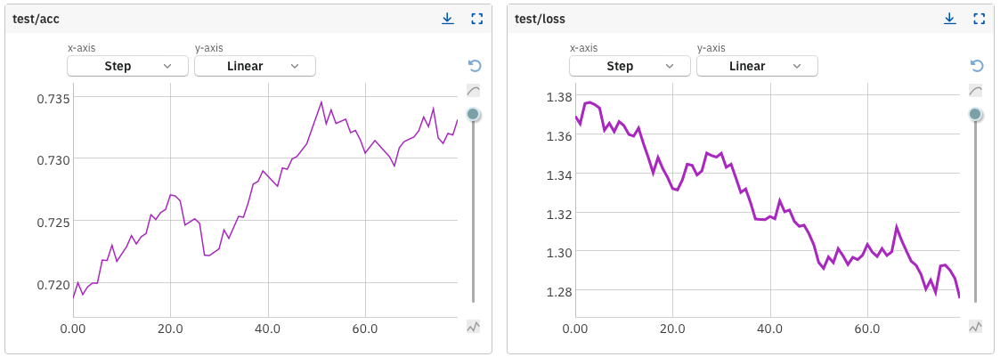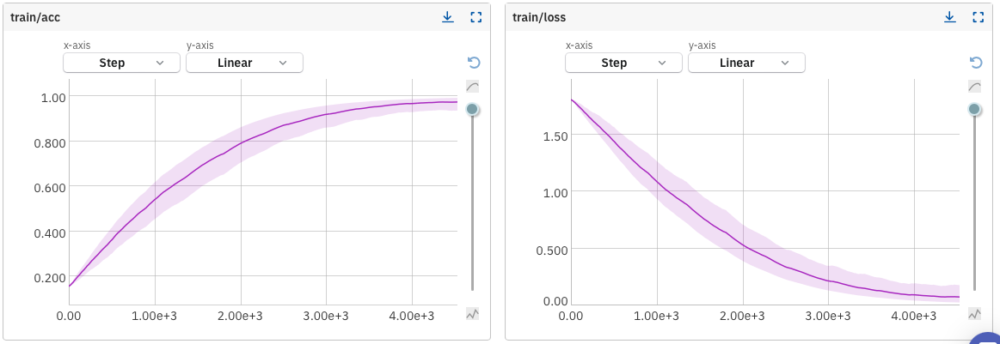

#### Comparison

BasicCNN - dark purple

frstArchBasicCNN - red

SecArchBasicCNN - bright purple


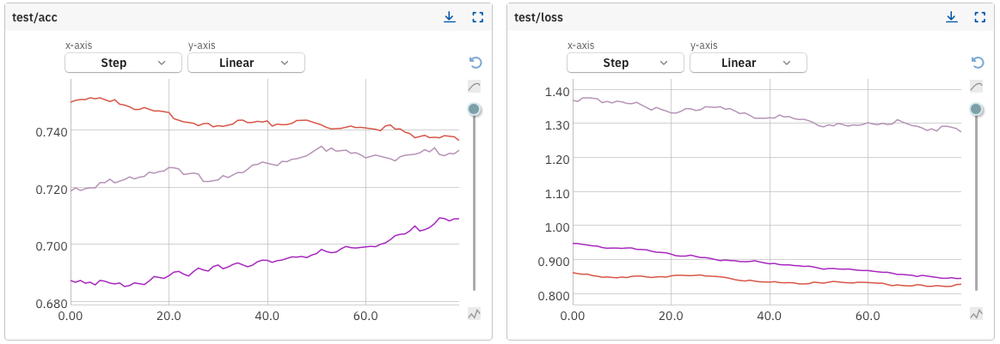

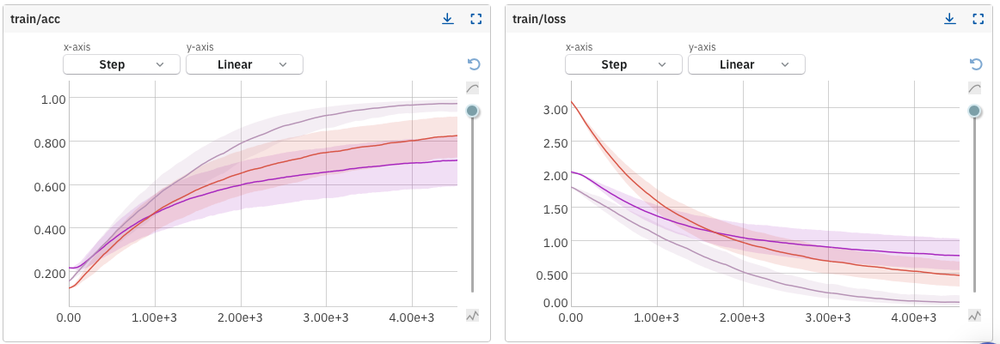

`SecArchBasicCNN` network is the best in terms of train performance, but due to its test performance, complexity and the amount of parameters that are calculated in the network we will not use it.


The `BasicCNN` network emerges as the optimal choice when considering a balance between performance and computational resources. Compared to the `frstArchBasicCNN` network, it offers slightly improved performance without the added complexity.

By selecting the `BasicCNN` architecture, we strike a balance between model effectiveness and computational efficiency, ensuring that our network meets both performance and practicality requirements.

**IMPORTENT NOTE:** By examining the comparison graphs, it might seem that the red graph is the best. However, it is not the most suitable choice because balance and stability are more important in this context.

Additionally, after selecting the best learning rate using the k-fold algorithm, we will conduct another comparison between BasicNN and frstArchBasicNN to ensure that we made the right choice.



---



## BasicNN Overfitting

Now we will examine the various hyperparameters of the network we previously selected (`BasicNN`).

We will investigate: number of epochs, learning rate, batch size, etc.

The procedure will be as follows:

1. Ensure that our network is capable of overfitting. This step will confirm that our network is functioning correctly.
2. Run our network using the code we created for k-fold cross-validation with a relatively small number of epochs to verify everything is working properly.
3. Test our hyperparameters and find the optimal ones for our network.

To induce overfitting, we selected 10 images from the entire training dataset and set the model to train for 25 epochs. We used the training function with the test dataset as the validation set. This approach allows us to monitor the loss function's progress during the weight update process. By using validation, this evaluation occurs after each epoch, enabling us to observe changes throughout the training process and the updates to the weights.



In [ ]:
net = BasicCNN(numLabels=6)
net = net.to(device)
criterionBasic = nn.CrossEntropyLoss()
optimizerBasic = optim.Adam(net.parameters(), lr=0.01)    #net.parameters is the wight of the NN

run = neptune.init_run(
    project="gihazshay/finalProjectML",
    api_token="eyJhcGlfYWRkcmVzcyI6Imh0dHBzOi8vYXBwLm5lcHR1bmUuYWkiLCJhcGlfdXJsIjoiaHR0cHM6Ly9hcHAubmVwdHVuZS5haSIsImFwaV9rZXkiOiI0Mjc3OWFhMi0zYWI3LTRiMjQtYjFiMC0xMGNkYWU4MjBkOTcifQ==",
)

params = {"learning_rate": 0.01, "optimizer": "Adam"}
run["parameters"] = params

trainModel = train(net, trainDataloader, optimizerBasic, 25, criterionBasic, dataLoaderValidation=testDataloader)

run.stop()

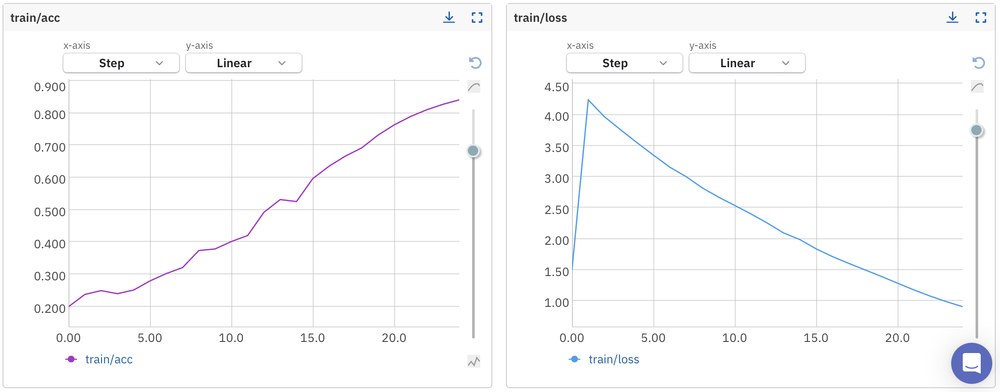

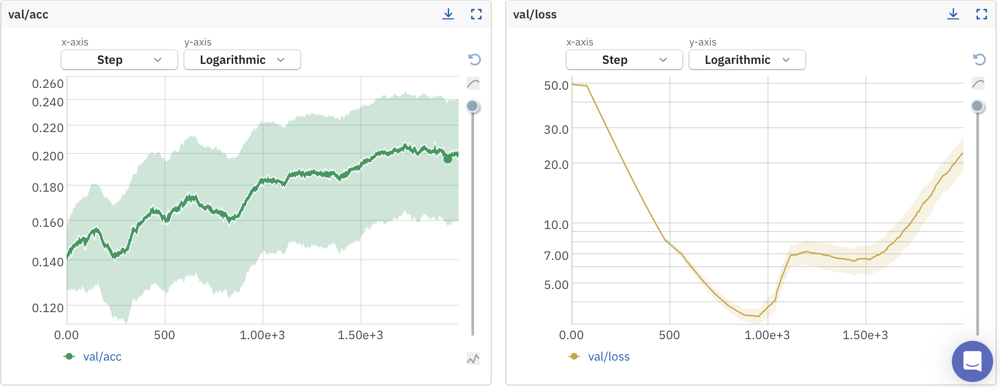

We can see in the validation loss graph that we have achieved overfitting!

The loss decreases initially but then starts to increase and continues to rise until the end.

Additionally, we can see that in the training graph, the accuracy is $0.85$, whereas in the validation graph, the final accuracy is much lower $(0.2)$ compared to the training accuracy.

This is a clear indication of overfitting.


# K-Fold

To assess our model's ability to generalize across diverse data samples, we'll employ K-Fold cross-validation. By dividing the training data into multiple subsets or "folds," each fold serves as both a validation set and part of the training data in different iterations.

With K-Fold cross-validation, we aim to ensure that our model generalizes effectively to all images in the dataset. Additionally, the validation process helps us identify instances of overfitting or underfitting, ensuring that our model's performance is optimal.

After checking the training results across all the folds, we would like to use all the data again to train the model so that it exposes to as many examples as possible and trains better, only then we will test the model.

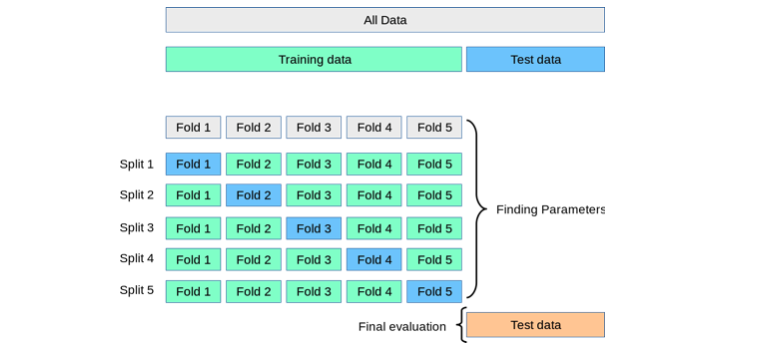



### BasicNN k-fold

First, we will check our k-fold metrics with 5 epochs and a learning rate of 0.0001.

#### Learning Rate: $0.0001$

In [ ]:
num_folds = 4

# Initialize the KFold object
kf = KFold(n_splits=num_folds, shuffle=True, random_state=40)


foldNum = 0
foldsMatrix = {}

for train_indices, val_indices in kf.split(idxTrain):

    TrainX_Kfold = np.array([dataset[i][0] for i in idxTrain[train_indices]])
    ValX_Kfold = np.array([dataset[j][0] for j in idxTrain[val_indices]])
    TrainY_Kfold = np.array([dataset[i][1] for i in idxTrain[train_indices]])
    ValY_Kfold = np.array([dataset[j][1] for j in idxTrain[val_indices]])
    ValZ_Kfold = np.array([dataset[j][2] for j in idxTrain[val_indices]])      #ID test of the images
    TrainZ_Kfold = np.array([dataset[i][2] for i in idxTrain[train_indices]])  #ID train of the images

    tensorTrainX_Kfold = torch.tensor(TrainX_Kfold, dtype=torch.float32).to(device)
    tensorValX_Kfold = torch.tensor(ValX_Kfold, dtype=torch.float32).to(device)
    tensorTrainY_Kfold = torch.tensor(TrainY_Kfold, dtype=torch.long).to(device)
    tensorValY_Kfold = torch.tensor(ValY_Kfold, dtype=torch.long).to(device)
    tensorTrainZ_Kfold = torch.tensor(TrainZ_Kfold, dtype=torch.long).to(device)
    tensorValZ_Kfold = torch.tensor(ValZ_Kfold, dtype=torch.long).to(device)

    # Create a TensorDataset object from the data
    tensorDatasetTrain_Kfold = TensorDataset(tensorTrainX_Kfold, tensorTrainY_Kfold, tensorTrainZ_Kfold)
    tensorDatasetVal_Kfold = TensorDataset(tensorValX_Kfold, tensorValY_Kfold, tensorValZ_Kfold)

    # Create a DataLoader object with batch size 32
    trainDataloaderKfold = DataLoader(tensorDatasetTrain_Kfold, batch_size=32, shuffle=True)
    valDataloaderKfold = DataLoader(tensorDatasetVal_Kfold, batch_size=32, shuffle=True)

    print(f"------fold------:{foldNum}")

    run = neptune.init_run(
    project="gihazshay/finalProjectML",
    api_token="eyJhcGlfYWRkcmVzcyI6Imh0dHBzOi8vYXBwLm5lcHR1bmUuYWkiLCJhcGlfdXJsIjoiaHR0cHM6Ly9hcHAubmVwdHVuZS5haSIsImFwaV9rZXkiOiI0Mjc3OWFhMi0zYWI3LTRiMjQtYjFiMC0xMGNkYWU4MjBkOTcifQ==",
    )

    params = {"learning_rate": 0.0001, "optimizer": "Adam"}
    run["parameters"] = params

    net = BasicCNN(numLabels=6)
    net = net.to(device)
    criterionBasic = nn.CrossEntropyLoss()
    optimizerBasic = optim.Adam(net.parameters(), lr=0.0001)    #net.parameters is the wight of the NN
    trainAcc, trainLoss, valAcc, valLoss = train(net, trainDataloaderKfold, optimizerBasic, 5, criterionBasic, valDataloaderKfold)

    run.stop()
    foldsMatrix[f"fold {foldNum}"] = {'train_acc':trainAcc, 'train_loss':trainLoss,
                                      'val_acc':valAcc, 'val_loss':valLoss}
    foldNum += 1



------fold------:0
[neptune] [info   ] Neptune initialized. Open in the app: https://app.neptune.ai/gihazshay/finalProjectML/e/FIN-354


Epoch 0: 100%|██████████| 340/340 [00:03<00:00, 112.03batch/s]


              precision    recall  f1-score   support

           0       0.46      0.45      0.45      1822
           1       0.39      0.10      0.16      1766
           2       0.46      0.46      0.46      1964
           3       0.37      0.52      0.43      1871
           4       0.52      0.64      0.57      1745
           5       0.30      0.33      0.31      1690

    accuracy                           0.42     10858
   macro avg       0.42      0.42      0.40     10858
weighted avg       0.42      0.42      0.40     10858

Validtion part------EPOCH------:0


100%|██████████| 114/114 [00:00<00:00, 233.27batch/s]


              precision    recall  f1-score   support

           0       0.64      0.58      0.61       629
           1       0.37      0.20      0.26       600
           2       0.47      0.63      0.54       617
           3       0.52      0.53      0.52       642
           4       0.76      0.81      0.78       588
           5       0.41      0.46      0.44       544

    accuracy                           0.54      3620
   macro avg       0.53      0.53      0.52      3620
weighted avg       0.53      0.54      0.53      3620



Epoch 1: 100%|██████████| 340/340 [00:03<00:00, 107.70batch/s]


              precision    recall  f1-score   support

           0       0.62      0.64      0.63      1822
           1       0.44      0.26      0.33      1766
           2       0.54      0.62      0.58      1964
           3       0.54      0.61      0.57      1871
           4       0.78      0.82      0.80      1745
           5       0.45      0.46      0.45      1690

    accuracy                           0.57     10858
   macro avg       0.56      0.57      0.56     10858
weighted avg       0.56      0.57      0.56     10858

Validtion part------EPOCH------:1


100%|██████████| 114/114 [00:00<00:00, 306.90batch/s]


              precision    recall  f1-score   support

           0       0.61      0.69      0.65       629
           1       0.40      0.14      0.21       600
           2       0.45      0.69      0.55       617
           3       0.50      0.62      0.55       642
           4       0.88      0.75      0.81       588
           5       0.49      0.40      0.44       544

    accuracy                           0.55      3620
   macro avg       0.56      0.55      0.54      3620
weighted avg       0.56      0.55      0.54      3620



Epoch 2: 100%|██████████| 340/340 [00:02<00:00, 127.82batch/s]


              precision    recall  f1-score   support

           0       0.65      0.68      0.67      1822
           1       0.47      0.30      0.36      1766
           2       0.57      0.63      0.60      1964
           3       0.56      0.62      0.59      1871
           4       0.84      0.85      0.84      1745
           5       0.47      0.50      0.49      1690

    accuracy                           0.60     10858
   macro avg       0.59      0.60      0.59     10858
weighted avg       0.59      0.60      0.59     10858

Validtion part------EPOCH------:2


100%|██████████| 114/114 [00:00<00:00, 308.28batch/s]


              precision    recall  f1-score   support

           0       0.64      0.72      0.68       629
           1       0.40      0.43      0.41       600
           2       0.62      0.49      0.55       617
           3       0.57      0.56      0.56       642
           4       0.86      0.85      0.85       588
           5       0.50      0.53      0.52       544

    accuracy                           0.60      3620
   macro avg       0.60      0.60      0.59      3620
weighted avg       0.60      0.60      0.60      3620



Epoch 3: 100%|██████████| 340/340 [00:02<00:00, 129.03batch/s]


              precision    recall  f1-score   support

           0       0.66      0.70      0.68      1822
           1       0.47      0.33      0.39      1766
           2       0.60      0.63      0.62      1964
           3       0.56      0.61      0.59      1871
           4       0.86      0.86      0.86      1745
           5       0.50      0.55      0.52      1690

    accuracy                           0.61     10858
   macro avg       0.61      0.61      0.61     10858
weighted avg       0.61      0.61      0.61     10858

Validtion part------EPOCH------:3


100%|██████████| 114/114 [00:00<00:00, 304.15batch/s]


              precision    recall  f1-score   support

           0       0.66      0.73      0.70       629
           1       0.41      0.21      0.27       600
           2       0.54      0.62      0.58       617
           3       0.49      0.68      0.57       642
           4       0.93      0.79      0.85       588
           5       0.54      0.51      0.53       544

    accuracy                           0.59      3620
   macro avg       0.59      0.59      0.58      3620
weighted avg       0.59      0.59      0.58      3620



Epoch 4: 100%|██████████| 340/340 [00:02<00:00, 130.36batch/s]


              precision    recall  f1-score   support

           0       0.68      0.72      0.70      1822
           1       0.48      0.35      0.41      1766
           2       0.61      0.65      0.63      1964
           3       0.58      0.62      0.60      1871
           4       0.87      0.86      0.86      1745
           5       0.52      0.57      0.54      1690

    accuracy                           0.63     10858
   macro avg       0.63      0.63      0.62     10858
weighted avg       0.63      0.63      0.63     10858

Validtion part------EPOCH------:4


100%|██████████| 114/114 [00:00<00:00, 307.02batch/s]


              precision    recall  f1-score   support

           0       0.78      0.60      0.68       629
           1       0.44      0.31      0.36       600
           2       0.58      0.58      0.58       617
           3       0.53      0.64      0.58       642
           4       0.86      0.88      0.87       588
           5       0.50      0.67      0.57       544

    accuracy                           0.61      3620
   macro avg       0.61      0.61      0.61      3620
weighted avg       0.62      0.61      0.61      3620

[neptune] [info   ] Shutting down background jobs, please wait a moment...
[neptune] [info   ] Done!
[neptune] [info   ] Waiting for the remaining 168 operations to synchronize with Neptune. Do not kill this process.
[neptune] [info   ] All 168 operations synced, thanks for waiting!
[neptune] [info   ] Explore the metadata in the Neptune app: https://app.neptune.ai/gihazshay/finalProjectML/e/FIN-354/metadata
------fold------:1
[neptune] [info   ] Neptun

Epoch 0: 100%|██████████| 340/340 [00:03<00:00, 105.04batch/s]


              precision    recall  f1-score   support

           0       0.47      0.48      0.48      1850
           1       0.34      0.19      0.25      1800
           2       0.46      0.40      0.43      1924
           3       0.43      0.50      0.46      1908
           4       0.58      0.77      0.66      1732
           5       0.29      0.32      0.30      1644

    accuracy                           0.44     10858
   macro avg       0.43      0.44      0.43     10858
weighted avg       0.43      0.44      0.43     10858

Validtion part------EPOCH------:0


100%|██████████| 114/114 [00:00<00:00, 237.71batch/s]


              precision    recall  f1-score   support

           0       0.54      0.67      0.60       601
           1       0.36      0.32      0.34       566
           2       0.59      0.58      0.59       657
           3       0.50      0.57      0.53       605
           4       0.81      0.81      0.81       601
           5       0.43      0.30      0.35       590

    accuracy                           0.55      3620
   macro avg       0.54      0.54      0.54      3620
weighted avg       0.54      0.55      0.54      3620



Epoch 1: 100%|██████████| 340/340 [00:03<00:00, 107.70batch/s]


              precision    recall  f1-score   support

           0       0.61      0.65      0.63      1850
           1       0.43      0.28      0.34      1800
           2       0.56      0.61      0.59      1924
           3       0.51      0.60      0.55      1908
           4       0.81      0.82      0.81      1732
           5       0.42      0.42      0.42      1644

    accuracy                           0.56     10858
   macro avg       0.56      0.56      0.56     10858
weighted avg       0.56      0.56      0.56     10858

Validtion part------EPOCH------:1


100%|██████████| 114/114 [00:00<00:00, 272.44batch/s]


              precision    recall  f1-score   support

           0       0.62      0.62      0.62       601
           1       0.40      0.48      0.44       566
           2       0.65      0.61      0.63       657
           3       0.60      0.46      0.53       605
           4       0.88      0.78      0.82       601
           5       0.43      0.53      0.48       590

    accuracy                           0.58      3620
   macro avg       0.60      0.58      0.58      3620
weighted avg       0.60      0.58      0.59      3620



Epoch 2: 100%|██████████| 340/340 [00:02<00:00, 128.65batch/s]


              precision    recall  f1-score   support

           0       0.63      0.69      0.66      1850
           1       0.46      0.31      0.37      1800
           2       0.60      0.64      0.62      1924
           3       0.55      0.62      0.58      1908
           4       0.84      0.83      0.84      1732
           5       0.47      0.48      0.47      1644

    accuracy                           0.60     10858
   macro avg       0.59      0.60      0.59     10858
weighted avg       0.59      0.60      0.59     10858

Validtion part------EPOCH------:2


100%|██████████| 114/114 [00:00<00:00, 304.80batch/s]


              precision    recall  f1-score   support

           0       0.57      0.77      0.66       601
           1       0.52      0.25      0.34       566
           2       0.58      0.69      0.63       657
           3       0.52      0.65      0.58       605
           4       0.85      0.83      0.84       601
           5       0.52      0.37      0.43       590

    accuracy                           0.60      3620
   macro avg       0.59      0.59      0.58      3620
weighted avg       0.59      0.60      0.58      3620



Epoch 3: 100%|██████████| 340/340 [00:02<00:00, 128.09batch/s]


              precision    recall  f1-score   support

           0       0.66      0.70      0.68      1850
           1       0.49      0.36      0.42      1800
           2       0.61      0.65      0.63      1924
           3       0.56      0.61      0.58      1908
           4       0.86      0.84      0.85      1732
           5       0.48      0.51      0.50      1644

    accuracy                           0.61     10858
   macro avg       0.61      0.61      0.61     10858
weighted avg       0.61      0.61      0.61     10858

Validtion part------EPOCH------:3


100%|██████████| 114/114 [00:00<00:00, 304.84batch/s]


              precision    recall  f1-score   support

           0       0.61      0.75      0.67       601
           1       0.45      0.43      0.44       566
           2       0.55      0.71      0.62       657
           3       0.58      0.49      0.53       605
           4       0.89      0.81      0.85       601
           5       0.56      0.42      0.48       590

    accuracy                           0.61      3620
   macro avg       0.61      0.60      0.60      3620
weighted avg       0.61      0.61      0.60      3620



Epoch 4: 100%|██████████| 340/340 [00:02<00:00, 128.36batch/s]


              precision    recall  f1-score   support

           0       0.66      0.72      0.69      1850
           1       0.50      0.38      0.43      1800
           2       0.62      0.64      0.63      1924
           3       0.57      0.62      0.60      1908
           4       0.87      0.85      0.86      1732
           5       0.50      0.54      0.52      1644

    accuracy                           0.62     10858
   macro avg       0.62      0.62      0.62     10858
weighted avg       0.62      0.62      0.62     10858

Validtion part------EPOCH------:4


100%|██████████| 114/114 [00:00<00:00, 300.59batch/s]


              precision    recall  f1-score   support

           0       0.64      0.74      0.68       601
           1       0.49      0.34      0.40       566
           2       0.61      0.68      0.64       657
           3       0.58      0.58      0.58       605
           4       0.83      0.88      0.85       601
           5       0.55      0.52      0.53       590

    accuracy                           0.63      3620
   macro avg       0.62      0.62      0.62      3620
weighted avg       0.62      0.63      0.62      3620

[neptune] [info   ] Shutting down background jobs, please wait a moment...
[neptune] [info   ] Done!
[neptune] [info   ] Waiting for the remaining 30 operations to synchronize with Neptune. Do not kill this process.
[neptune] [info   ] All 30 operations synced, thanks for waiting!
[neptune] [info   ] Explore the metadata in the Neptune app: https://app.neptune.ai/gihazshay/finalProjectML/e/FIN-355/metadata
------fold------:2
[neptune] [info   ] Neptune 

Epoch 0: 100%|██████████| 340/340 [00:03<00:00, 112.53batch/s]


              precision    recall  f1-score   support

           0       0.40      0.42      0.41      1855
           1       0.32      0.18      0.23      1767
           2       0.47      0.49      0.48      1933
           3       0.41      0.48      0.44      1863
           4       0.57      0.66      0.61      1737
           5       0.32      0.31      0.31      1704

    accuracy                           0.42     10859
   macro avg       0.41      0.42      0.41     10859
weighted avg       0.41      0.42      0.42     10859

Validtion part------EPOCH------:0


100%|██████████| 114/114 [00:00<00:00, 253.49batch/s]


              precision    recall  f1-score   support

           0       0.65      0.45      0.53       596
           1       0.57      0.17      0.26       599
           2       0.57      0.62      0.59       648
           3       0.50      0.71      0.59       650
           4       0.77      0.79      0.78       596
           5       0.39      0.59      0.47       530

    accuracy                           0.56      3619
   macro avg       0.58      0.56      0.54      3619
weighted avg       0.58      0.56      0.54      3619



Epoch 1: 100%|██████████| 340/340 [00:03<00:00, 103.80batch/s]


              precision    recall  f1-score   support

           0       0.62      0.63      0.62      1855
           1       0.44      0.26      0.33      1767
           2       0.56      0.62      0.59      1933
           3       0.53      0.64      0.58      1863
           4       0.78      0.80      0.79      1737
           5       0.48      0.48      0.48      1704

    accuracy                           0.58     10859
   macro avg       0.57      0.57      0.57     10859
weighted avg       0.57      0.58      0.57     10859

Validtion part------EPOCH------:1


100%|██████████| 114/114 [00:00<00:00, 234.94batch/s]


              precision    recall  f1-score   support

           0       0.60      0.70      0.65       596
           1       0.59      0.25      0.35       599
           2       0.54      0.71      0.61       648
           3       0.56      0.72      0.63       650
           4       0.85      0.80      0.82       596
           5       0.53      0.40      0.45       530

    accuracy                           0.60      3619
   macro avg       0.61      0.60      0.59      3619
weighted avg       0.61      0.60      0.59      3619



Epoch 2: 100%|██████████| 340/340 [00:02<00:00, 119.44batch/s]


              precision    recall  f1-score   support

           0       0.66      0.69      0.68      1855
           1       0.48      0.36      0.41      1767
           2       0.59      0.63      0.61      1933
           3       0.57      0.64      0.61      1863
           4       0.83      0.82      0.83      1737
           5       0.54      0.54      0.54      1704

    accuracy                           0.62     10859
   macro avg       0.61      0.62      0.61     10859
weighted avg       0.61      0.62      0.61     10859

Validtion part------EPOCH------:2


100%|██████████| 114/114 [00:00<00:00, 309.47batch/s]


              precision    recall  f1-score   support

           0       0.65      0.70      0.67       596
           1       0.61      0.34      0.43       599
           2       0.61      0.63      0.62       648
           3       0.62      0.71      0.66       650
           4       0.82      0.89      0.85       596
           5       0.49      0.54      0.51       530

    accuracy                           0.64      3619
   macro avg       0.63      0.63      0.63      3619
weighted avg       0.63      0.64      0.63      3619



Epoch 3: 100%|██████████| 340/340 [00:02<00:00, 127.24batch/s]


              precision    recall  f1-score   support

           0       0.68      0.72      0.70      1855
           1       0.52      0.43      0.47      1767
           2       0.61      0.63      0.62      1933
           3       0.61      0.67      0.64      1863
           4       0.86      0.83      0.85      1737
           5       0.57      0.59      0.58      1704

    accuracy                           0.64     10859
   macro avg       0.64      0.64      0.64     10859
weighted avg       0.64      0.64      0.64     10859

Validtion part------EPOCH------:3


100%|██████████| 114/114 [00:00<00:00, 308.46batch/s]


              precision    recall  f1-score   support

           0       0.75      0.56      0.64       596
           1       0.63      0.37      0.46       599
           2       0.60      0.70      0.64       648
           3       0.57      0.78      0.65       650
           4       0.82      0.91      0.86       596
           5       0.56      0.55      0.56       530

    accuracy                           0.65      3619
   macro avg       0.65      0.64      0.64      3619
weighted avg       0.65      0.65      0.64      3619



Epoch 4: 100%|██████████| 340/340 [00:02<00:00, 130.01batch/s]


              precision    recall  f1-score   support

           0       0.71      0.74      0.72      1855
           1       0.55      0.46      0.50      1767
           2       0.63      0.63      0.63      1933
           3       0.63      0.69      0.66      1863
           4       0.88      0.85      0.87      1737
           5       0.59      0.61      0.60      1704

    accuracy                           0.67     10859
   macro avg       0.67      0.67      0.66     10859
weighted avg       0.66      0.67      0.66     10859

Validtion part------EPOCH------:4


100%|██████████| 114/114 [00:00<00:00, 310.82batch/s]


              precision    recall  f1-score   support

           0       0.65      0.81      0.72       596
           1       0.55      0.58      0.57       599
           2       0.67      0.60      0.63       648
           3       0.69      0.65      0.67       650
           4       0.93      0.84      0.88       596
           5       0.57      0.56      0.56       530

    accuracy                           0.67      3619
   macro avg       0.68      0.67      0.67      3619
weighted avg       0.68      0.67      0.67      3619

[neptune] [info   ] Shutting down background jobs, please wait a moment...
[neptune] [info   ] Done!
[neptune] [info   ] Waiting for the remaining 30 operations to synchronize with Neptune. Do not kill this process.
[neptune] [info   ] All 30 operations synced, thanks for waiting!
[neptune] [info   ] Explore the metadata in the Neptune app: https://app.neptune.ai/gihazshay/finalProjectML/e/FIN-356/metadata
------fold------:3
[neptune] [info   ] Neptune 

Epoch 0: 100%|██████████| 340/340 [00:03<00:00, 111.99batch/s]


              precision    recall  f1-score   support

           0       0.44      0.52      0.48      1826
           1       0.30      0.17      0.22      1765
           2       0.47      0.52      0.49      1922
           3       0.46      0.56      0.50      1897
           4       0.66      0.69      0.68      1785
           5       0.32      0.26      0.29      1664

    accuracy                           0.46     10859
   macro avg       0.44      0.45      0.44     10859
weighted avg       0.44      0.46      0.45     10859

Validtion part------EPOCH------:0


100%|██████████| 114/114 [00:00<00:00, 249.15batch/s]


              precision    recall  f1-score   support

           0       0.56      0.68      0.61       625
           1       0.39      0.26      0.31       601
           2       0.53      0.64      0.58       659
           3       0.63      0.51      0.56       616
           4       0.70      0.83      0.76       548
           5       0.43      0.39      0.41       570

    accuracy                           0.55      3619
   macro avg       0.54      0.55      0.54      3619
weighted avg       0.54      0.55      0.54      3619



Epoch 1: 100%|██████████| 340/340 [00:03<00:00, 108.10batch/s]


              precision    recall  f1-score   support

           0       0.59      0.66      0.62      1826
           1       0.43      0.23      0.30      1765
           2       0.55      0.59      0.57      1922
           3       0.54      0.64      0.58      1897
           4       0.76      0.80      0.78      1785
           5       0.43      0.43      0.43      1664

    accuracy                           0.56     10859
   macro avg       0.55      0.56      0.55     10859
weighted avg       0.55      0.56      0.55     10859

Validtion part------EPOCH------:1


100%|██████████| 114/114 [00:00<00:00, 243.23batch/s]


              precision    recall  f1-score   support

           0       0.66      0.58      0.62       625
           1       0.54      0.13      0.21       601
           2       0.57      0.66      0.61       659
           3       0.47      0.78      0.59       616
           4       0.78      0.81      0.80       548
           5       0.46      0.47      0.47       570

    accuracy                           0.57      3619
   macro avg       0.58      0.57      0.55      3619
weighted avg       0.58      0.57      0.55      3619



Epoch 2: 100%|██████████| 340/340 [00:02<00:00, 119.63batch/s]


              precision    recall  f1-score   support

           0       0.62      0.69      0.66      1826
           1       0.49      0.30      0.37      1765
           2       0.57      0.60      0.58      1922
           3       0.58      0.66      0.61      1897
           4       0.80      0.82      0.81      1785
           5       0.46      0.48      0.47      1664

    accuracy                           0.59     10859
   macro avg       0.59      0.59      0.58     10859
weighted avg       0.59      0.59      0.59     10859

Validtion part------EPOCH------:2


100%|██████████| 114/114 [00:00<00:00, 306.87batch/s]


              precision    recall  f1-score   support

           0       0.67      0.68      0.67       625
           1       0.65      0.15      0.24       601
           2       0.57      0.68      0.62       659
           3       0.55      0.73      0.63       616
           4       0.88      0.77      0.82       548
           5       0.45      0.61      0.51       570

    accuracy                           0.60      3619
   macro avg       0.63      0.60      0.58      3619
weighted avg       0.62      0.60      0.58      3619



Epoch 3: 100%|██████████| 340/340 [00:02<00:00, 129.37batch/s]


              precision    recall  f1-score   support

           0       0.64      0.70      0.67      1826
           1       0.54      0.38      0.45      1765
           2       0.60      0.61      0.60      1922
           3       0.61      0.69      0.64      1897
           4       0.83      0.83      0.83      1785
           5       0.50      0.52      0.51      1664

    accuracy                           0.62     10859
   macro avg       0.62      0.62      0.62     10859
weighted avg       0.62      0.62      0.62     10859

Validtion part------EPOCH------:3


100%|██████████| 114/114 [00:00<00:00, 307.31batch/s]


              precision    recall  f1-score   support

           0       0.71      0.64      0.67       625
           1       0.63      0.26      0.37       601
           2       0.64      0.60      0.62       659
           3       0.53      0.79      0.64       616
           4       0.86      0.81      0.83       548
           5       0.48      0.64      0.55       570

    accuracy                           0.62      3619
   macro avg       0.64      0.62      0.61      3619
weighted avg       0.64      0.62      0.61      3619



Epoch 4: 100%|██████████| 340/340 [00:02<00:00, 128.90batch/s]


              precision    recall  f1-score   support

           0       0.66      0.71      0.69      1826
           1       0.57      0.45      0.51      1765
           2       0.62      0.62      0.62      1922
           3       0.62      0.69      0.65      1897
           4       0.85      0.83      0.84      1785
           5       0.53      0.55      0.54      1664

    accuracy                           0.64     10859
   macro avg       0.64      0.64      0.64     10859
weighted avg       0.64      0.64      0.64     10859

Validtion part------EPOCH------:4


100%|██████████| 114/114 [00:00<00:00, 308.90batch/s]


              precision    recall  f1-score   support

           0       0.72      0.69      0.70       625
           1       0.55      0.55      0.55       601
           2       0.73      0.53      0.62       659
           3       0.63      0.74      0.68       616
           4       0.85      0.82      0.84       548
           5       0.52      0.63      0.57       570

    accuracy                           0.66      3619
   macro avg       0.67      0.66      0.66      3619
weighted avg       0.67      0.66      0.66      3619

[neptune] [info   ] Shutting down background jobs, please wait a moment...
[neptune] [info   ] Done!
[neptune] [info   ] Waiting for the remaining 30 operations to synchronize with Neptune. Do not kill this process.
[neptune] [info   ] All 30 operations synced, thanks for waiting!
[neptune] [info   ] Explore the metadata in the Neptune app: https://app.neptune.ai/gihazshay/finalProjectML/e/FIN-357/metadata


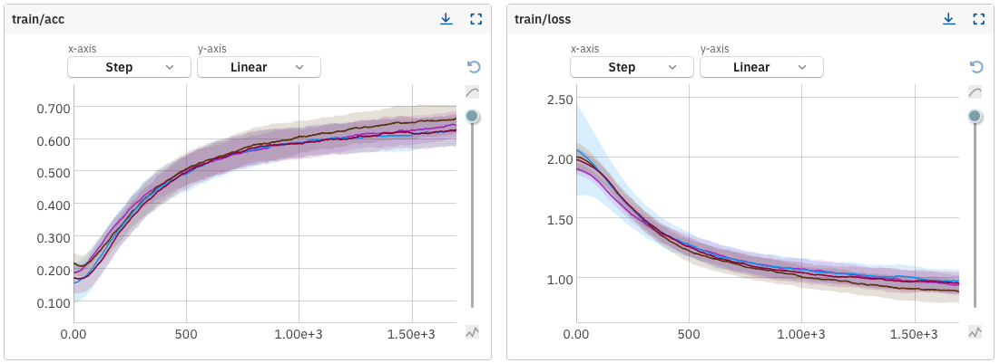

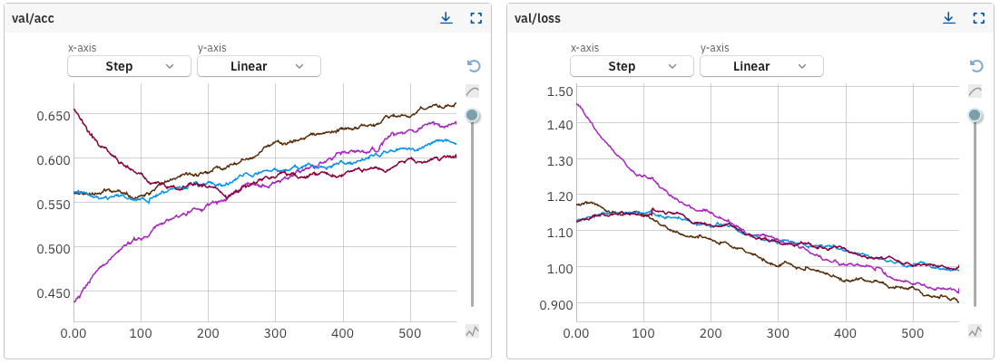

In [ ]:
net = BasicCNN(numLabels=6)
net = net.to(device)
criterionBasic = nn.CrossEntropyLoss()
optimizerBasic = optim.Adam(net.parameters(), lr=0.0001)    #net.parameters is the wight of the NN

run = neptune.init_run(
    project="gihazshay/finalProjectML",
    api_token="eyJhcGlfYWRkcmVzcyI6Imh0dHBzOi8vYXBwLm5lcHR1bmUuYWkiLCJhcGlfdXJsIjoiaHR0cHM6Ly9hcHAubmVwdHVuZS5haSIsImFwaV9rZXkiOiI0Mjc3OWFhMi0zYWI3LTRiMjQtYjFiMC0xMGNkYWU4MjBkOTcifQ==",
)

params = {"learning_rate": 0.0001, "optimizer": "Adam"}
run["parameters"] = params

trainModel = train(net, trainDataloader, optimizerBasic, 5, criterionBasic)
testAcc, testLoss = test(net, testDataloader, criterionBasic)

run.stop()


[neptune] [info   ] Neptune initialized. Open in the app: https://app.neptune.ai/gihazshay/finalProjectML/e/FIN-358


Epoch 0: 100%|██████████| 453/453 [00:06<00:00, 70.81batch/s]


              precision    recall  f1-score   support

           0       0.52      0.59      0.55      2451
           1       0.39      0.17      0.24      2366
           2       0.53      0.46      0.49      2581
           3       0.42      0.68      0.52      2513
           4       0.74      0.69      0.72      2333
           5       0.40      0.38      0.39      2234

    accuracy                           0.50     14478
   macro avg       0.50      0.50      0.48     14478
weighted avg       0.50      0.50      0.49     14478



Epoch 1: 100%|██████████| 453/453 [00:05<00:00, 90.22batch/s]


              precision    recall  f1-score   support

           0       0.65      0.70      0.68      2451
           1       0.52      0.36      0.43      2366
           2       0.57      0.62      0.59      2581
           3       0.58      0.66      0.62      2513
           4       0.82      0.80      0.81      2333
           5       0.51      0.52      0.51      2234

    accuracy                           0.61     14478
   macro avg       0.61      0.61      0.61     14478
weighted avg       0.61      0.61      0.61     14478



Epoch 2: 100%|██████████| 453/453 [00:05<00:00, 88.60batch/s]


              precision    recall  f1-score   support

           0       0.68      0.72      0.70      2451
           1       0.55      0.42      0.48      2366
           2       0.59      0.64      0.61      2581
           3       0.63      0.69      0.66      2513
           4       0.85      0.83      0.84      2333
           5       0.57      0.58      0.57      2234

    accuracy                           0.65     14478
   macro avg       0.65      0.65      0.64     14478
weighted avg       0.65      0.65      0.64     14478



Epoch 3: 100%|██████████| 453/453 [00:06<00:00, 74.72batch/s]


              precision    recall  f1-score   support

           0       0.71      0.73      0.72      2451
           1       0.57      0.46      0.51      2366
           2       0.60      0.64      0.62      2581
           3       0.65      0.71      0.68      2513
           4       0.86      0.85      0.86      2333
           5       0.62      0.62      0.62      2234

    accuracy                           0.67     14478
   macro avg       0.67      0.67      0.67     14478
weighted avg       0.67      0.67      0.67     14478



Epoch 4: 100%|██████████| 453/453 [00:05<00:00, 90.37batch/s]


              precision    recall  f1-score   support

           0       0.72      0.75      0.73      2451
           1       0.61      0.52      0.56      2366
           2       0.62      0.65      0.63      2581
           3       0.67      0.72      0.70      2513
           4       0.88      0.86      0.87      2333
           5       0.66      0.65      0.66      2234

    accuracy                           0.69     14478
   macro avg       0.69      0.69      0.69     14478
weighted avg       0.69      0.69      0.69     14478



100%|██████████| 80/80 [00:00<00:00, 146.53batch/s]


              precision    recall  f1-score   support

           0       0.80      0.68      0.73       432
           1       0.62      0.50      0.55       418
           2       0.64      0.61      0.63       456
           3       0.64      0.76      0.69       444
           4       0.89      0.85      0.87       412
           5       0.63      0.80      0.71       394

    accuracy                           0.70      2556
   macro avg       0.70      0.70      0.70      2556
weighted avg       0.70      0.70      0.70      2556

[neptune] [info   ] Shutting down background jobs, please wait a moment...
[neptune] [info   ] Done!
[neptune] [info   ] Waiting for the remaining 92 operations to synchronize with Neptune. Do not kill this process.
[neptune] [info   ] All 92 operations synced, thanks for waiting!
[neptune] [info   ] Explore the metadata in the Neptune app: https://app.neptune.ai/gihazshay/finalProjectML/e/FIN-358/metadata


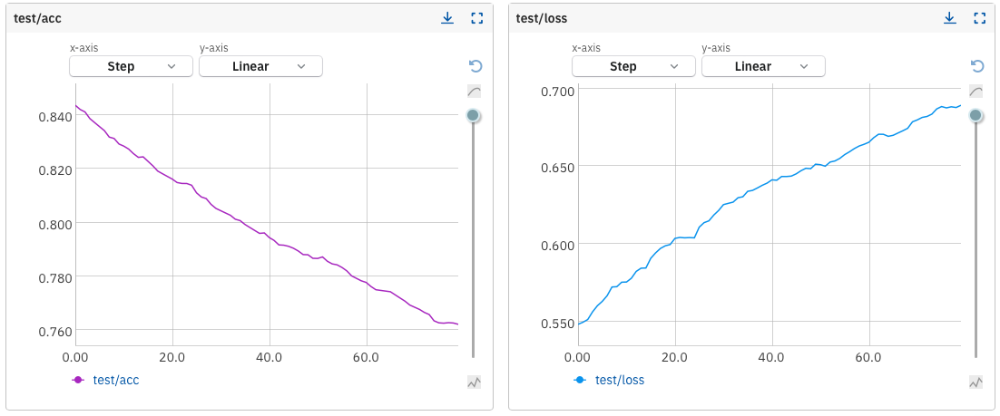

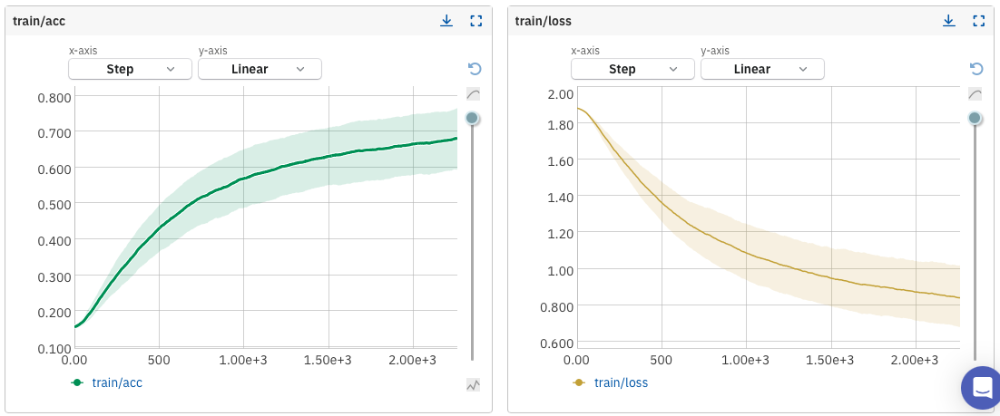

We can see that the k-fold cross-validation is working. After checking the learning rate of 0.0001, we will test the following learning rates: 0.1, 0.001, and 0.0005 to determine the best one.

Next, we will run the algorithm with a learning rate of 0.0005 and generate comparison graphs.

By analyzing these results, we can make a decision on the best learning rate to use. This step is crucial for improving the performance and generalization of our model.


#### Learning Rate: $0.001$

In [ ]:
num_folds = 4

# Initialize the KFold object
kf = KFold(n_splits=num_folds, shuffle=True, random_state=40)


foldNum = 0
foldsMatrix = {}

for train_indices, val_indices in kf.split(idxTrain):



    TrainX_Kfold = np.array([dataset[i][0] for i in idxTrain[train_indices]])
    ValX_Kfold = np.array([dataset[j][0] for j in idxTrain[val_indices]])
    TrainY_Kfold = np.array([dataset[i][1] for i in idxTrain[train_indices]])
    ValY_Kfold = np.array([dataset[j][1] for j in idxTrain[val_indices]])
    ValZ_Kfold = np.array([dataset[j][2] for j in idxTrain[val_indices]])      #ID test of the images
    TrainZ_Kfold = np.array([dataset[i][2] for i in idxTrain[train_indices]])  #ID train of the images

    tensorTrainX_Kfold = torch.tensor(TrainX_Kfold, dtype=torch.float32).to(device)
    tensorValX_Kfold = torch.tensor(ValX_Kfold, dtype=torch.float32).to(device)
    tensorTrainY_Kfold = torch.tensor(TrainY_Kfold, dtype=torch.long).to(device)
    tensorValY_Kfold = torch.tensor(ValY_Kfold, dtype=torch.long).to(device)
    tensorTrainZ_Kfold = torch.tensor(TrainZ_Kfold, dtype=torch.long).to(device)
    tensorValZ_Kfold = torch.tensor(ValZ_Kfold, dtype=torch.long).to(device)

    # Create a TensorDataset object from the data
    tensorDatasetTrain_Kfold = TensorDataset(tensorTrainX_Kfold, tensorTrainY_Kfold, tensorTrainZ_Kfold)
    tensorDatasetVal_Kfold = TensorDataset(tensorValX_Kfold, tensorValY_Kfold, tensorValZ_Kfold)

    # Create a DataLoader object with batch size 32
    trainDataloaderKfold = DataLoader(tensorDatasetTrain_Kfold, batch_size=32, shuffle=True)
    valDataloaderKfold = DataLoader(tensorDatasetVal_Kfold, batch_size=32, shuffle=True)

    print(f"------fold------:{foldNum}")

    run = neptune.init_run(
    project="gihazshay/finalProjectML",
    api_token="eyJhcGlfYWRkcmVzcyI6Imh0dHBzOi8vYXBwLm5lcHR1bmUuYWkiLCJhcGlfdXJsIjoiaHR0cHM6Ly9hcHAubmVwdHVuZS5haSIsImFwaV9rZXkiOiI0Mjc3OWFhMi0zYWI3LTRiMjQtYjFiMC0xMGNkYWU4MjBkOTcifQ==",
    )

    params = {"learning_rate": 0.001, "optimizer": "Adam"}
    run["parameters"] = params

    net = BasicCNN(numLabels=6)
    net = net.to(device)
    criterionBasic = nn.CrossEntropyLoss()
    optimizerBasic = optim.Adam(net.parameters(), lr=0.001)    #net.parameters is the wight of the NN
    trainAcc, trainLoss, valAcc, valLoss = train(net, trainDataloaderKfold, optimizerBasic, 5, criterionBasic, valDataloaderKfold)

    run.stop()
    foldsMatrix[f"fold {foldNum}"] = {'train_acc':trainAcc, 'train_loss':trainLoss,
                                      'val_acc':valAcc, 'val_loss':valLoss}
    foldNum += 1


------fold------:0
[neptune] [info   ] Neptune initialized. Open in the app: https://app.neptune.ai/gihazshay/finalProjectML/e/FIN-349


Epoch 0: 100%|██████████| 340/340 [00:02<00:00, 123.36batch/s]


              precision    recall  f1-score   support

           0       0.55      0.63      0.59      1822
           1       0.41      0.31      0.36      1766
           2       0.55      0.55      0.55      1964
           3       0.49      0.54      0.52      1871
           4       0.75      0.76      0.76      1745
           5       0.52      0.51      0.52      1690

    accuracy                           0.55     10858
   macro avg       0.55      0.55      0.55     10858
weighted avg       0.55      0.55      0.55     10858

Validtion part------EPOCH------:0


100%|██████████| 114/114 [00:00<00:00, 307.61batch/s]


              precision    recall  f1-score   support

           0       0.73      0.59      0.66       629
           1       0.53      0.42      0.47       600
           2       0.65      0.56      0.60       617
           3       0.57      0.63      0.60       642
           4       0.71      0.91      0.80       588
           5       0.55      0.65      0.59       544

    accuracy                           0.62      3620
   macro avg       0.62      0.63      0.62      3620
weighted avg       0.62      0.62      0.62      3620



Epoch 1: 100%|██████████| 340/340 [00:02<00:00, 131.25batch/s]


              precision    recall  f1-score   support

           0       0.68      0.73      0.70      1822
           1       0.51      0.39      0.44      1766
           2       0.62      0.64      0.63      1964
           3       0.57      0.62      0.60      1871
           4       0.86      0.82      0.84      1745
           5       0.62      0.65      0.63      1690

    accuracy                           0.64     10858
   macro avg       0.64      0.64      0.64     10858
weighted avg       0.64      0.64      0.64     10858

Validtion part------EPOCH------:1


100%|██████████| 114/114 [00:00<00:00, 304.57batch/s]


              precision    recall  f1-score   support

           0       0.66      0.62      0.64       629
           1       0.45      0.56      0.50       600
           2       0.64      0.58      0.61       617
           3       0.48      0.56      0.51       642
           4       0.99      0.53      0.69       588
           5       0.57      0.69      0.62       544

    accuracy                           0.59      3620
   macro avg       0.63      0.59      0.60      3620
weighted avg       0.63      0.59      0.60      3620



Epoch 2: 100%|██████████| 340/340 [00:02<00:00, 120.69batch/s]


              precision    recall  f1-score   support

           0       0.74      0.75      0.75      1822
           1       0.56      0.47      0.51      1766
           2       0.65      0.66      0.65      1964
           3       0.62      0.68      0.64      1871
           4       0.88      0.86      0.87      1745
           5       0.68      0.71      0.70      1690

    accuracy                           0.69     10858
   macro avg       0.69      0.69      0.69     10858
weighted avg       0.69      0.69      0.69     10858

Validtion part------EPOCH------:2


100%|██████████| 114/114 [00:00<00:00, 243.22batch/s]


              precision    recall  f1-score   support

           0       0.75      0.64      0.69       629
           1       0.60      0.47      0.52       600
           2       0.56      0.70      0.62       617
           3       0.66      0.67      0.67       642
           4       0.72      0.93      0.81       588
           5       0.73      0.59      0.65       544

    accuracy                           0.66      3620
   macro avg       0.67      0.66      0.66      3620
weighted avg       0.67      0.66      0.66      3620



Epoch 3: 100%|██████████| 340/340 [00:03<00:00, 106.26batch/s]


              precision    recall  f1-score   support

           0       0.75      0.78      0.76      1822
           1       0.59      0.53      0.56      1766
           2       0.68      0.67      0.67      1964
           3       0.65      0.70      0.67      1871
           4       0.90      0.88      0.89      1745
           5       0.72      0.71      0.71      1690

    accuracy                           0.71     10858
   macro avg       0.71      0.71      0.71     10858
weighted avg       0.71      0.71      0.71     10858

Validtion part------EPOCH------:3


100%|██████████| 114/114 [00:00<00:00, 231.96batch/s]


              precision    recall  f1-score   support

           0       0.80      0.70      0.75       629
           1       0.52      0.62      0.57       600
           2       0.63      0.66      0.65       617
           3       0.69      0.55      0.61       642
           4       0.92      0.89      0.90       588
           5       0.66      0.77      0.71       544

    accuracy                           0.69      3620
   macro avg       0.70      0.70      0.70      3620
weighted avg       0.70      0.69      0.70      3620



Epoch 4: 100%|██████████| 340/340 [00:03<00:00, 109.27batch/s]


              precision    recall  f1-score   support

           0       0.76      0.80      0.78      1822
           1       0.62      0.58      0.60      1766
           2       0.68      0.67      0.68      1964
           3       0.67      0.71      0.69      1871
           4       0.90      0.89      0.90      1745
           5       0.72      0.72      0.72      1690

    accuracy                           0.73     10858
   macro avg       0.73      0.73      0.73     10858
weighted avg       0.73      0.73      0.73     10858

Validtion part------EPOCH------:4


100%|██████████| 114/114 [00:00<00:00, 295.90batch/s]


              precision    recall  f1-score   support

           0       0.79      0.72      0.75       629
           1       0.62      0.51      0.56       600
           2       0.60      0.72      0.65       617
           3       0.67      0.64      0.65       642
           4       0.85      0.92      0.88       588
           5       0.68      0.71      0.69       544

    accuracy                           0.70      3620
   macro avg       0.70      0.70      0.70      3620
weighted avg       0.70      0.70      0.70      3620

[neptune] [info   ] Shutting down background jobs, please wait a moment...
[neptune] [info   ] Done!
[neptune] [info   ] Waiting for the remaining 122 operations to synchronize with Neptune. Do not kill this process.
[neptune] [info   ] All 122 operations synced, thanks for waiting!
[neptune] [info   ] Explore the metadata in the Neptune app: https://app.neptune.ai/gihazshay/finalProjectML/e/FIN-349/metadata
------fold------:1
[neptune] [info   ] Neptun

Epoch 0: 100%|██████████| 340/340 [00:02<00:00, 123.68batch/s]


              precision    recall  f1-score   support

           0       0.48      0.62      0.54      1850
           1       0.41      0.24      0.31      1800
           2       0.52      0.46      0.49      1924
           3       0.52      0.55      0.53      1908
           4       0.67      0.74      0.70      1732
           5       0.42      0.44      0.43      1644

    accuracy                           0.51     10858
   macro avg       0.50      0.51      0.50     10858
weighted avg       0.50      0.51      0.50     10858

Validtion part------EPOCH------:0


100%|██████████| 114/114 [00:00<00:00, 318.32batch/s]


              precision    recall  f1-score   support

           0       0.72      0.62      0.66       601
           1       0.69      0.10      0.18       566
           2       0.55      0.66      0.60       657
           3       0.51      0.79      0.62       605
           4       0.86      0.79      0.83       601
           5       0.54      0.66      0.60       590

    accuracy                           0.61      3620
   macro avg       0.64      0.61      0.58      3620
weighted avg       0.64      0.61      0.59      3620



Epoch 1: 100%|██████████| 340/340 [00:02<00:00, 128.46batch/s]


              precision    recall  f1-score   support

           0       0.68      0.72      0.70      1850
           1       0.55      0.45      0.49      1800
           2       0.62      0.59      0.60      1924
           3       0.60      0.68      0.64      1908
           4       0.83      0.82      0.82      1732
           5       0.57      0.60      0.58      1644

    accuracy                           0.64     10858
   macro avg       0.64      0.64      0.64     10858
weighted avg       0.64      0.64      0.64     10858

Validtion part------EPOCH------:1


100%|██████████| 114/114 [00:00<00:00, 307.91batch/s]


              precision    recall  f1-score   support

           0       0.70      0.66      0.68       601
           1       0.64      0.47      0.54       566
           2       0.57      0.68      0.62       657
           3       0.77      0.50      0.61       605
           4       0.93      0.81      0.87       601
           5       0.50      0.80      0.61       590

    accuracy                           0.65      3620
   macro avg       0.69      0.65      0.65      3620
weighted avg       0.68      0.65      0.66      3620



Epoch 2: 100%|██████████| 340/340 [00:02<00:00, 124.10batch/s]


              precision    recall  f1-score   support

           0       0.72      0.75      0.73      1850
           1       0.63      0.57      0.59      1800
           2       0.67      0.61      0.64      1924
           3       0.66      0.73      0.69      1908
           4       0.87      0.86      0.86      1732
           5       0.63      0.66      0.64      1644

    accuracy                           0.70     10858
   macro avg       0.70      0.70      0.70     10858
weighted avg       0.70      0.70      0.69     10858

Validtion part------EPOCH------:2


100%|██████████| 114/114 [00:00<00:00, 255.87batch/s]


              precision    recall  f1-score   support

           0       0.69      0.79      0.74       601
           1       0.74      0.44      0.55       566
           2       0.72      0.56      0.63       657
           3       0.59      0.82      0.69       605
           4       0.84      0.90      0.87       601
           5       0.62      0.63      0.63       590

    accuracy                           0.69      3620
   macro avg       0.70      0.69      0.68      3620
weighted avg       0.70      0.69      0.68      3620



Epoch 3: 100%|██████████| 340/340 [00:03<00:00, 107.49batch/s]


              precision    recall  f1-score   support

           0       0.76      0.78      0.77      1850
           1       0.66      0.62      0.64      1800
           2       0.70      0.66      0.68      1924
           3       0.70      0.74      0.72      1908
           4       0.88      0.86      0.87      1732
           5       0.67      0.71      0.69      1644

    accuracy                           0.73     10858
   macro avg       0.73      0.73      0.73     10858
weighted avg       0.73      0.73      0.73     10858

Validtion part------EPOCH------:3


100%|██████████| 114/114 [00:00<00:00, 226.76batch/s]


              precision    recall  f1-score   support

           0       0.68      0.83      0.75       601
           1       0.67      0.62      0.64       566
           2       0.71      0.67      0.69       657
           3       0.70      0.75      0.72       605
           4       0.89      0.88      0.88       601
           5       0.71      0.58      0.64       590

    accuracy                           0.72      3620
   macro avg       0.72      0.72      0.72      3620
weighted avg       0.72      0.72      0.72      3620



Epoch 4: 100%|██████████| 340/340 [00:03<00:00, 111.08batch/s]


              precision    recall  f1-score   support

           0       0.76      0.79      0.78      1850
           1       0.67      0.66      0.66      1800
           2       0.73      0.66      0.69      1924
           3       0.71      0.76      0.73      1908
           4       0.89      0.88      0.89      1732
           5       0.70      0.71      0.71      1644

    accuracy                           0.74     10858
   macro avg       0.74      0.74      0.74     10858
weighted avg       0.74      0.74      0.74     10858

Validtion part------EPOCH------:4


100%|██████████| 114/114 [00:00<00:00, 303.89batch/s]


              precision    recall  f1-score   support

           0       0.82      0.70      0.75       601
           1       0.82      0.35      0.49       566
           2       0.63      0.67      0.65       657
           3       0.57      0.83      0.68       605
           4       0.81      0.94      0.87       601
           5       0.69      0.68      0.69       590

    accuracy                           0.70      3620
   macro avg       0.72      0.70      0.69      3620
weighted avg       0.72      0.70      0.69      3620

[neptune] [info   ] Shutting down background jobs, please wait a moment...
[neptune] [info   ] Done!
[neptune] [info   ] Waiting for the remaining 30 operations to synchronize with Neptune. Do not kill this process.
[neptune] [info   ] All 30 operations synced, thanks for waiting!
[neptune] [info   ] Explore the metadata in the Neptune app: https://app.neptune.ai/gihazshay/finalProjectML/e/FIN-350/metadata
------fold------:2
[neptune] [info   ] Neptune 

Epoch 0: 100%|██████████| 340/340 [00:02<00:00, 122.09batch/s]


              precision    recall  f1-score   support

           0       0.56      0.66      0.61      1855
           1       0.41      0.32      0.36      1767
           2       0.50      0.44      0.47      1933
           3       0.52      0.54      0.53      1863
           4       0.72      0.77      0.75      1737
           5       0.49      0.52      0.50      1704

    accuracy                           0.54     10859
   macro avg       0.53      0.54      0.54     10859
weighted avg       0.53      0.54      0.53     10859

Validtion part------EPOCH------:0


100%|██████████| 114/114 [00:00<00:00, 301.27batch/s]


              precision    recall  f1-score   support

           0       0.74      0.65      0.69       596
           1       0.52      0.20      0.29       599
           2       0.63      0.46      0.53       648
           3       0.46      0.89      0.60       650
           4       0.96      0.79      0.87       596
           5       0.59      0.70      0.64       530

    accuracy                           0.62      3619
   macro avg       0.65      0.62      0.60      3619
weighted avg       0.65      0.62      0.60      3619



Epoch 1: 100%|██████████| 340/340 [00:02<00:00, 128.53batch/s]


              precision    recall  f1-score   support

           0       0.72      0.75      0.73      1855
           1       0.53      0.46      0.50      1767
           2       0.63      0.56      0.59      1933
           3       0.62      0.72      0.67      1863
           4       0.87      0.86      0.87      1737
           5       0.64      0.67      0.66      1704

    accuracy                           0.67     10859
   macro avg       0.67      0.67      0.67     10859
weighted avg       0.67      0.67      0.67     10859

Validtion part------EPOCH------:1


100%|██████████| 114/114 [00:00<00:00, 305.50batch/s]


              precision    recall  f1-score   support

           0       0.71      0.79      0.75       596
           1       0.75      0.32      0.45       599
           2       0.59      0.72      0.65       648
           3       0.60      0.83      0.69       650
           4       0.84      0.93      0.88       596
           5       0.81      0.52      0.63       530

    accuracy                           0.69      3619
   macro avg       0.71      0.69      0.68      3619
weighted avg       0.71      0.69      0.68      3619



Epoch 2: 100%|██████████| 340/340 [00:02<00:00, 128.36batch/s]


              precision    recall  f1-score   support

           0       0.76      0.77      0.76      1855
           1       0.64      0.57      0.60      1767
           2       0.66      0.64      0.65      1933
           3       0.67      0.74      0.70      1863
           4       0.89      0.88      0.88      1737
           5       0.70      0.72      0.71      1704

    accuracy                           0.72     10859
   macro avg       0.72      0.72      0.72     10859
weighted avg       0.72      0.72      0.72     10859

Validtion part------EPOCH------:2


100%|██████████| 114/114 [00:00<00:00, 300.66batch/s]


              precision    recall  f1-score   support

           0       0.78      0.75      0.77       596
           1       0.79      0.47      0.59       599
           2       0.66      0.70      0.68       648
           3       0.65      0.86      0.74       650
           4       0.82      0.94      0.88       596
           5       0.76      0.67      0.71       530

    accuracy                           0.74      3619
   macro avg       0.75      0.73      0.73      3619
weighted avg       0.74      0.74      0.73      3619



Epoch 3: 100%|██████████| 340/340 [00:03<00:00, 111.02batch/s]


              precision    recall  f1-score   support

           0       0.79      0.81      0.80      1855
           1       0.70      0.63      0.66      1767
           2       0.69      0.70      0.70      1933
           3       0.72      0.76      0.74      1863
           4       0.91      0.91      0.91      1737
           5       0.75      0.76      0.75      1704

    accuracy                           0.76     10859
   macro avg       0.76      0.76      0.76     10859
weighted avg       0.76      0.76      0.76     10859

Validtion part------EPOCH------:3


100%|██████████| 114/114 [00:00<00:00, 237.49batch/s]


              precision    recall  f1-score   support

           0       0.80      0.75      0.77       596
           1       0.73      0.58      0.65       599
           2       0.60      0.81      0.69       648
           3       0.79      0.63      0.70       650
           4       0.80      0.97      0.87       596
           5       0.79      0.69      0.74       530

    accuracy                           0.74      3619
   macro avg       0.75      0.74      0.74      3619
weighted avg       0.75      0.74      0.74      3619



Epoch 4: 100%|██████████| 340/340 [00:03<00:00, 107.45batch/s]


              precision    recall  f1-score   support

           0       0.80      0.81      0.80      1855
           1       0.72      0.67      0.70      1767
           2       0.70      0.71      0.70      1933
           3       0.73      0.76      0.74      1863
           4       0.92      0.92      0.92      1737
           5       0.76      0.77      0.76      1704

    accuracy                           0.77     10859
   macro avg       0.77      0.77      0.77     10859
weighted avg       0.77      0.77      0.77     10859

Validtion part------EPOCH------:4


100%|██████████| 114/114 [00:00<00:00, 249.16batch/s]


              precision    recall  f1-score   support

           0       0.83      0.71      0.76       596
           1       0.75      0.60      0.66       599
           2       0.59      0.83      0.69       648
           3       0.79      0.69      0.74       650
           4       0.90      0.94      0.92       596
           5       0.74      0.73      0.73       530

    accuracy                           0.75      3619
   macro avg       0.77      0.75      0.75      3619
weighted avg       0.76      0.75      0.75      3619

[neptune] [info   ] Shutting down background jobs, please wait a moment...
[neptune] [info   ] Done!
[neptune] [info   ] Waiting for the remaining 30 operations to synchronize with Neptune. Do not kill this process.
[neptune] [info   ] All 30 operations synced, thanks for waiting!
[neptune] [info   ] Explore the metadata in the Neptune app: https://app.neptune.ai/gihazshay/finalProjectML/e/FIN-351/metadata
------fold------:3
[neptune] [info   ] Neptune 

Epoch 0: 100%|██████████| 340/340 [00:02<00:00, 125.22batch/s]


              precision    recall  f1-score   support

           0       0.61      0.61      0.61      1826
           1       0.51      0.32      0.39      1765
           2       0.54      0.55      0.55      1922
           3       0.53      0.61      0.57      1897
           4       0.70      0.83      0.76      1785
           5       0.50      0.50      0.50      1664

    accuracy                           0.57     10859
   macro avg       0.56      0.57      0.56     10859
weighted avg       0.56      0.57      0.56     10859

Validtion part------EPOCH------:0


100%|██████████| 114/114 [00:00<00:00, 310.10batch/s]


              precision    recall  f1-score   support

           0       0.61      0.80      0.69       625
           1       0.54      0.58      0.56       601
           2       0.69      0.59      0.64       659
           3       0.76      0.56      0.65       616
           4       0.82      0.88      0.85       548
           5       0.57      0.55      0.56       570

    accuracy                           0.66      3619
   macro avg       0.66      0.66      0.66      3619
weighted avg       0.66      0.66      0.65      3619



Epoch 1: 100%|██████████| 340/340 [00:02<00:00, 127.58batch/s]


              precision    recall  f1-score   support

           0       0.69      0.73      0.71      1826
           1       0.64      0.56      0.60      1765
           2       0.66      0.65      0.66      1922
           3       0.66      0.70      0.68      1897
           4       0.88      0.86      0.87      1785
           5       0.62      0.65      0.64      1664

    accuracy                           0.69     10859
   macro avg       0.69      0.69      0.69     10859
weighted avg       0.69      0.69      0.69     10859

Validtion part------EPOCH------:1


100%|██████████| 114/114 [00:00<00:00, 306.49batch/s]


              precision    recall  f1-score   support

           0       0.69      0.76      0.72       625
           1       0.67      0.55      0.60       601
           2       0.75      0.65      0.69       659
           3       0.65      0.84      0.74       616
           4       0.97      0.71      0.82       548
           5       0.61      0.72      0.66       570

    accuracy                           0.71      3619
   macro avg       0.72      0.71      0.71      3619
weighted avg       0.72      0.71      0.71      3619



Epoch 2: 100%|██████████| 340/340 [00:02<00:00, 127.92batch/s]


              precision    recall  f1-score   support

           0       0.75      0.76      0.75      1826
           1       0.67      0.64      0.66      1765
           2       0.71      0.67      0.69      1922
           3       0.70      0.75      0.72      1897
           4       0.90      0.88      0.89      1785
           5       0.68      0.71      0.69      1664

    accuracy                           0.73     10859
   macro avg       0.73      0.73      0.73     10859
weighted avg       0.73      0.73      0.73     10859

Validtion part------EPOCH------:2


100%|██████████| 114/114 [00:00<00:00, 296.32batch/s]


              precision    recall  f1-score   support

           0       0.75      0.77      0.76       625
           1       0.64      0.76      0.69       601
           2       0.75      0.74      0.74       659
           3       0.78      0.65      0.71       616
           4       0.93      0.86      0.89       548
           5       0.69      0.72      0.70       570

    accuracy                           0.75      3619
   macro avg       0.76      0.75      0.75      3619
weighted avg       0.75      0.75      0.75      3619



Epoch 3: 100%|██████████| 340/340 [00:02<00:00, 113.83batch/s]


              precision    recall  f1-score   support

           0       0.76      0.77      0.77      1826
           1       0.70      0.67      0.69      1765
           2       0.72      0.70      0.71      1922
           3       0.72      0.76      0.74      1897
           4       0.89      0.89      0.89      1785
           5       0.71      0.72      0.71      1664

    accuracy                           0.75     10859
   macro avg       0.75      0.75      0.75     10859
weighted avg       0.75      0.75      0.75     10859

Validtion part------EPOCH------:3


100%|██████████| 114/114 [00:00<00:00, 247.16batch/s]


              precision    recall  f1-score   support

           0       0.78      0.72      0.75       625
           1       0.79      0.69      0.73       601
           2       0.78      0.69      0.73       659
           3       0.76      0.73      0.75       616
           4       0.95      0.84      0.89       548
           5       0.56      0.84      0.67       570

    accuracy                           0.75      3619
   macro avg       0.77      0.75      0.75      3619
weighted avg       0.77      0.75      0.75      3619



Epoch 4: 100%|██████████| 340/340 [00:03<00:00, 107.25batch/s]


              precision    recall  f1-score   support

           0       0.77      0.79      0.78      1826
           1       0.74      0.71      0.72      1765
           2       0.73      0.71      0.72      1922
           3       0.74      0.76      0.75      1897
           4       0.91      0.90      0.91      1785
           5       0.73      0.74      0.73      1664

    accuracy                           0.77     10859
   macro avg       0.77      0.77      0.77     10859
weighted avg       0.77      0.77      0.77     10859

Validtion part------EPOCH------:4


100%|██████████| 114/114 [00:00<00:00, 237.84batch/s]


              precision    recall  f1-score   support

           0       0.69      0.75      0.72       625
           1       0.69      0.75      0.72       601
           2       0.88      0.48      0.62       659
           3       0.69      0.85      0.76       616
           4       0.98      0.73      0.84       548
           5       0.60      0.80      0.69       570

    accuracy                           0.72      3619
   macro avg       0.76      0.73      0.72      3619
weighted avg       0.75      0.72      0.72      3619

[neptune] [info   ] Shutting down background jobs, please wait a moment...
[neptune] [info   ] Done!
[neptune] [info   ] Waiting for the remaining 31 operations to synchronize with Neptune. Do not kill this process.
[neptune] [info   ] All 31 operations synced, thanks for waiting!
[neptune] [info   ] Explore the metadata in the Neptune app: https://app.neptune.ai/gihazshay/finalProjectML/e/FIN-352/metadata


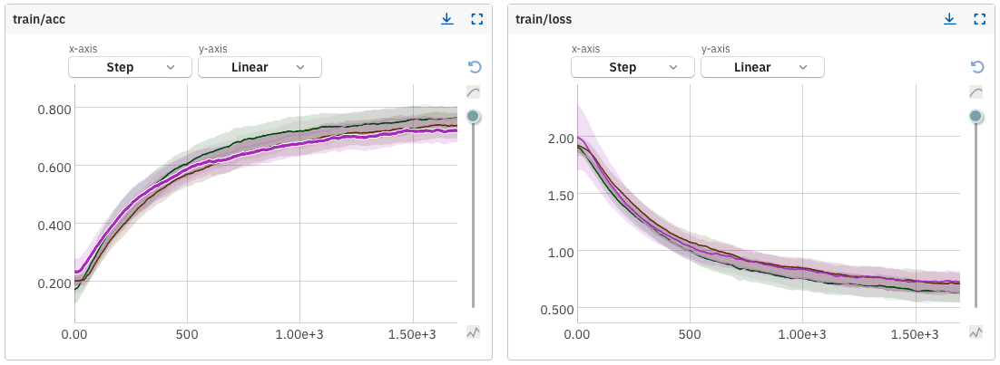

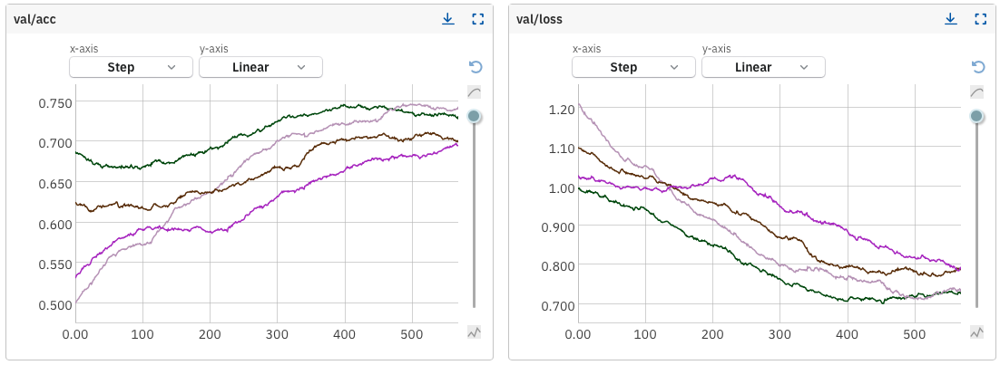

In [ ]:
net = BasicCNN(numLabels=6)
net = net.to(device)
criterionBasic = nn.CrossEntropyLoss()
optimizerBasic = optim.Adam(net.parameters(), lr=0.001)    #net.parameters is the wight of the NN

run = neptune.init_run(
    project="gihazshay/finalProjectML",
    api_token="eyJhcGlfYWRkcmVzcyI6Imh0dHBzOi8vYXBwLm5lcHR1bmUuYWkiLCJhcGlfdXJsIjoiaHR0cHM6Ly9hcHAubmVwdHVuZS5haSIsImFwaV9rZXkiOiI0Mjc3OWFhMi0zYWI3LTRiMjQtYjFiMC0xMGNkYWU4MjBkOTcifQ==",
)

params = {"learning_rate": 0.001, "optimizer": "Adam"}
run["parameters"] = params

trainModel = train(net, trainDataloader, optimizerBasic, 5, criterionBasic)
testAcc, testLoss = test(net, testDataloader, criterionBasic)

run.stop()


[neptune] [info   ] Neptune initialized. Open in the app: https://app.neptune.ai/gihazshay/finalProjectML/e/FIN-353


Epoch 0: 100%|██████████| 453/453 [00:05<00:00, 82.84batch/s]


              precision    recall  f1-score   support

           0       0.62      0.65      0.64      2451
           1       0.39      0.21      0.27      2366
           2       0.56      0.61      0.58      2581
           3       0.50      0.61      0.55      2513
           4       0.79      0.75      0.77      2333
           5       0.52      0.59      0.55      2234

    accuracy                           0.57     14478
   macro avg       0.56      0.57      0.56     14478
weighted avg       0.56      0.57      0.56     14478



Epoch 1: 100%|██████████| 453/453 [00:05<00:00, 78.19batch/s]


              precision    recall  f1-score   support

           0       0.71      0.75      0.73      2451
           1       0.53      0.39      0.45      2366
           2       0.64      0.66      0.65      2581
           3       0.59      0.69      0.64      2513
           4       0.88      0.84      0.86      2333
           5       0.68      0.70      0.69      2234

    accuracy                           0.67     14478
   macro avg       0.67      0.67      0.67     14478
weighted avg       0.67      0.67      0.67     14478



Epoch 2: 100%|██████████| 453/453 [00:05<00:00, 78.68batch/s]


              precision    recall  f1-score   support

           0       0.75      0.77      0.76      2451
           1       0.63      0.53      0.58      2366
           2       0.69      0.70      0.70      2581
           3       0.64      0.72      0.67      2513
           4       0.90      0.89      0.90      2333
           5       0.72      0.73      0.73      2234

    accuracy                           0.72     14478
   macro avg       0.72      0.72      0.72     14478
weighted avg       0.72      0.72      0.72     14478



Epoch 3: 100%|██████████| 453/453 [00:05<00:00, 87.93batch/s]


              precision    recall  f1-score   support

           0       0.78      0.79      0.79      2451
           1       0.70      0.65      0.67      2366
           2       0.72      0.70      0.71      2581
           3       0.68      0.75      0.71      2513
           4       0.91      0.90      0.91      2333
           5       0.75      0.76      0.75      2234

    accuracy                           0.76     14478
   macro avg       0.76      0.76      0.76     14478
weighted avg       0.76      0.76      0.76     14478



Epoch 4: 100%|██████████| 453/453 [00:05<00:00, 81.50batch/s]


              precision    recall  f1-score   support

           0       0.80      0.82      0.81      2451
           1       0.72      0.68      0.70      2366
           2       0.73      0.71      0.72      2581
           3       0.70      0.76      0.73      2513
           4       0.92      0.91      0.92      2333
           5       0.78      0.77      0.78      2234

    accuracy                           0.77     14478
   macro avg       0.78      0.78      0.78     14478
weighted avg       0.77      0.77      0.77     14478



100%|██████████| 80/80 [00:00<00:00, 111.54batch/s]


              precision    recall  f1-score   support

           0       0.80      0.77      0.78       432
           1       0.74      0.66      0.70       418
           2       0.67      0.77      0.72       456
           3       0.66      0.77      0.71       444
           4       0.93      0.92      0.92       412
           5       0.82      0.68      0.74       394

    accuracy                           0.76      2556
   macro avg       0.77      0.76      0.76      2556
weighted avg       0.77      0.76      0.76      2556

[neptune] [info   ] Shutting down background jobs, please wait a moment...
[neptune] [info   ] Done!
[neptune] [info   ] Waiting for the remaining 46 operations to synchronize with Neptune. Do not kill this process.
[neptune] [info   ] All 46 operations synced, thanks for waiting!
[neptune] [info   ] Explore the metadata in the Neptune app: https://app.neptune.ai/gihazshay/finalProjectML/e/FIN-353/metadata


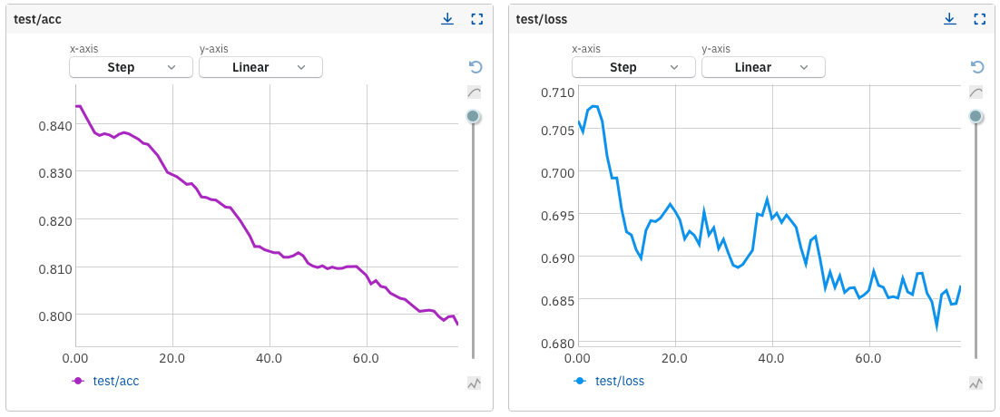

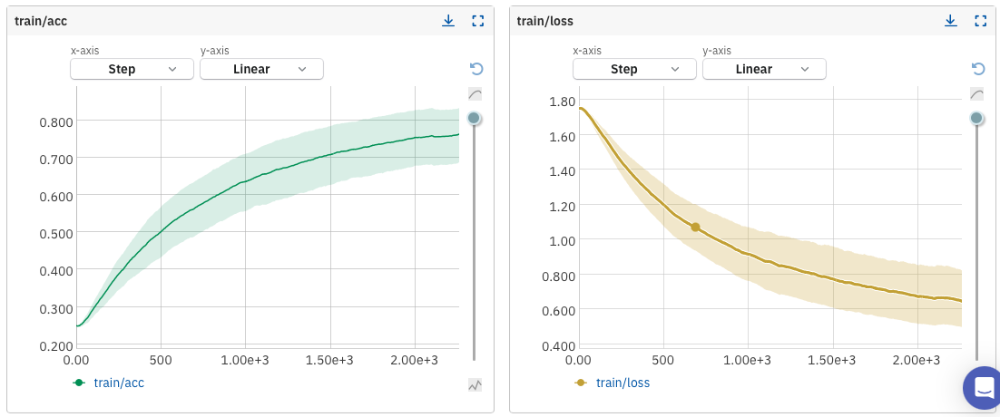

#### Learning Rate: $0.0005$

In [ ]:
num_folds = 4

# Initialize the KFold object
kf = KFold(n_splits=num_folds, shuffle=True, random_state=40)


foldNum = 0
foldsMatrix = {}

for train_indices, val_indices in kf.split(idxTrain):



    TrainX_Kfold = np.array([dataset[i][0] for i in idxTrain[train_indices]])
    ValX_Kfold = np.array([dataset[j][0] for j in idxTrain[val_indices]])
    TrainY_Kfold = np.array([dataset[i][1] for i in idxTrain[train_indices]])
    ValY_Kfold = np.array([dataset[j][1] for j in idxTrain[val_indices]])
    ValZ_Kfold = np.array([dataset[j][2] for j in idxTrain[val_indices]])      #ID test of the images
    TrainZ_Kfold = np.array([dataset[i][2] for i in idxTrain[train_indices]])  #ID train of the images

    tensorTrainX_Kfold = torch.tensor(TrainX_Kfold, dtype=torch.float32).to(device)
    tensorValX_Kfold = torch.tensor(ValX_Kfold, dtype=torch.float32).to(device)
    tensorTrainY_Kfold = torch.tensor(TrainY_Kfold, dtype=torch.long).to(device)
    tensorValY_Kfold = torch.tensor(ValY_Kfold, dtype=torch.long).to(device)
    tensorTrainZ_Kfold = torch.tensor(TrainZ_Kfold, dtype=torch.long).to(device)
    tensorValZ_Kfold = torch.tensor(ValZ_Kfold, dtype=torch.long).to(device)

    # Create a TensorDataset object from the data
    tensorDatasetTrain_Kfold = TensorDataset(tensorTrainX_Kfold, tensorTrainY_Kfold, tensorTrainZ_Kfold)
    tensorDatasetVal_Kfold = TensorDataset(tensorValX_Kfold, tensorValY_Kfold, tensorValZ_Kfold)

    # Create a DataLoader object with batch size 32
    trainDataloaderKfold = DataLoader(tensorDatasetTrain_Kfold, batch_size=32, shuffle=True)
    valDataloaderKfold = DataLoader(tensorDatasetVal_Kfold, batch_size=32, shuffle=True)

    print(f"------fold------:{foldNum}")

    run = neptune.init_run(
    project="gihazshay/finalProjectML",
    api_token="eyJhcGlfYWRkcmVzcyI6Imh0dHBzOi8vYXBwLm5lcHR1bmUuYWkiLCJhcGlfdXJsIjoiaHR0cHM6Ly9hcHAubmVwdHVuZS5haSIsImFwaV9rZXkiOiI0Mjc3OWFhMi0zYWI3LTRiMjQtYjFiMC0xMGNkYWU4MjBkOTcifQ==",
    )

    params = {"learning_rate": 0.0005, "optimizer": "Adam"}
    run["parameters"] = params

    net = BasicCNN(numLabels=6)
    net = net.to(device)
    criterionBasic = nn.CrossEntropyLoss()
    optimizerBasic = optim.Adam(net.parameters(), lr=0.0005)    #net.parameters is the wight of the NN
    trainAcc, trainLoss, valAcc, valLoss = train(net, trainDataloaderKfold, optimizerBasic, 5, criterionBasic, valDataloaderKfold)

    run.stop()
    foldsMatrix[f"fold {foldNum}"] = {'train_acc':trainAcc, 'train_loss':trainLoss,
                                      'val_acc':valAcc, 'val_loss':valLoss}
    foldNum += 1


------fold------:0
[neptune] [info   ] Neptune initialized. Open in the app: https://app.neptune.ai/gihazshay/finalProjectML/e/FIN-364


Epoch 0: 100%|██████████| 340/340 [00:02<00:00, 126.78batch/s]


              precision    recall  f1-score   support

           0       0.51      0.62      0.56      1822
           1       0.42      0.30      0.35      1766
           2       0.50      0.43      0.47      1964
           3       0.49      0.45      0.47      1871
           4       0.65      0.76      0.70      1745
           5       0.39      0.44      0.42      1690

    accuracy                           0.50     10858
   macro avg       0.49      0.50      0.49     10858
weighted avg       0.49      0.50      0.49     10858

Validtion part------EPOCH------:0


100%|██████████| 114/114 [00:00<00:00, 304.18batch/s]


              precision    recall  f1-score   support

           0       0.64      0.80      0.71       629
           1       0.47      0.48      0.48       600
           2       0.56      0.58      0.57       617
           3       0.55      0.66      0.60       642
           4       0.91      0.76      0.83       588
           5       0.65      0.37      0.47       544

    accuracy                           0.61      3620
   macro avg       0.63      0.61      0.61      3620
weighted avg       0.63      0.61      0.61      3620



Epoch 1: 100%|██████████| 340/340 [00:02<00:00, 130.74batch/s]


              precision    recall  f1-score   support

           0       0.68      0.71      0.70      1822
           1       0.55      0.43      0.48      1766
           2       0.62      0.60      0.61      1964
           3       0.60      0.69      0.64      1871
           4       0.85      0.84      0.85      1745
           5       0.55      0.59      0.57      1690

    accuracy                           0.64     10858
   macro avg       0.64      0.64      0.64     10858
weighted avg       0.64      0.64      0.64     10858

Validtion part------EPOCH------:1


100%|██████████| 114/114 [00:00<00:00, 309.56batch/s]


              precision    recall  f1-score   support

           0       0.69      0.80      0.74       629
           1       0.54      0.48      0.51       600
           2       0.54      0.65      0.59       617
           3       0.61      0.64      0.62       642
           4       0.91      0.82      0.86       588
           5       0.68      0.53      0.60       544

    accuracy                           0.65      3620
   macro avg       0.66      0.65      0.65      3620
weighted avg       0.66      0.65      0.65      3620



Epoch 2: 100%|██████████| 340/340 [00:02<00:00, 128.09batch/s]


              precision    recall  f1-score   support

           0       0.72      0.74      0.73      1822
           1       0.60      0.49      0.54      1766
           2       0.64      0.66      0.65      1964
           3       0.67      0.73      0.70      1871
           4       0.88      0.87      0.87      1745
           5       0.62      0.65      0.64      1690

    accuracy                           0.69     10858
   macro avg       0.69      0.69      0.69     10858
weighted avg       0.69      0.69      0.69     10858

Validtion part------EPOCH------:2


100%|██████████| 114/114 [00:00<00:00, 305.70batch/s]


              precision    recall  f1-score   support

           0       0.77      0.70      0.73       629
           1       0.46      0.65      0.54       600
           2       0.68      0.53      0.60       617
           3       0.68      0.55      0.61       642
           4       0.85      0.89      0.87       588
           5       0.62      0.69      0.65       544

    accuracy                           0.66      3620
   macro avg       0.68      0.67      0.67      3620
weighted avg       0.68      0.66      0.67      3620



Epoch 3: 100%|██████████| 340/340 [00:03<00:00, 108.76batch/s]


              precision    recall  f1-score   support

           0       0.75      0.76      0.76      1822
           1       0.60      0.51      0.55      1766
           2       0.66      0.67      0.66      1964
           3       0.67      0.72      0.70      1871
           4       0.89      0.89      0.89      1745
           5       0.66      0.68      0.67      1690

    accuracy                           0.71     10858
   macro avg       0.71      0.71      0.70     10858
weighted avg       0.70      0.71      0.70     10858

Validtion part------EPOCH------:3


100%|██████████| 114/114 [00:00<00:00, 232.59batch/s]


              precision    recall  f1-score   support

           0       0.67      0.84      0.74       629
           1       0.57      0.45      0.50       600
           2       0.61      0.63      0.62       617
           3       0.69      0.65      0.67       642
           4       0.91      0.88      0.89       588
           5       0.64      0.64      0.64       544

    accuracy                           0.68      3620
   macro avg       0.68      0.68      0.68      3620
weighted avg       0.68      0.68      0.68      3620



Epoch 4: 100%|██████████| 340/340 [00:03<00:00, 103.54batch/s]


              precision    recall  f1-score   support

           0       0.75      0.77      0.76      1822
           1       0.62      0.53      0.57      1766
           2       0.67      0.68      0.67      1964
           3       0.68      0.74      0.71      1871
           4       0.90      0.90      0.90      1745
           5       0.69      0.69      0.69      1690

    accuracy                           0.72     10858
   macro avg       0.72      0.72      0.72     10858
weighted avg       0.72      0.72      0.72     10858

Validtion part------EPOCH------:4


100%|██████████| 114/114 [00:00<00:00, 275.95batch/s]


              precision    recall  f1-score   support

           0       0.74      0.74      0.74       629
           1       0.50      0.65      0.56       600
           2       0.67      0.58      0.62       617
           3       0.72      0.57      0.64       642
           4       0.87      0.91      0.89       588
           5       0.66      0.67      0.66       544

    accuracy                           0.69      3620
   macro avg       0.69      0.69      0.69      3620
weighted avg       0.69      0.69      0.69      3620

[neptune] [info   ] Shutting down background jobs, please wait a moment...
[neptune] [info   ] Done!
[neptune] [info   ] Waiting for the remaining 30 operations to synchronize with Neptune. Do not kill this process.
[neptune] [info   ] All 30 operations synced, thanks for waiting!
[neptune] [info   ] Explore the metadata in the Neptune app: https://app.neptune.ai/gihazshay/finalProjectML/e/FIN-364/metadata
------fold------:1
[neptune] [info   ] Neptune 

Epoch 0: 100%|██████████| 340/340 [00:02<00:00, 123.51batch/s]


              precision    recall  f1-score   support

           0       0.54      0.67      0.60      1850
           1       0.42      0.26      0.32      1800
           2       0.52      0.56      0.54      1924
           3       0.49      0.57      0.53      1908
           4       0.83      0.77      0.80      1732
           5       0.48      0.45      0.46      1644

    accuracy                           0.55     10858
   macro avg       0.55      0.55      0.54     10858
weighted avg       0.54      0.55      0.54     10858

Validtion part------EPOCH------:0


100%|██████████| 114/114 [00:00<00:00, 308.28batch/s]


              precision    recall  f1-score   support

           0       0.57      0.86      0.69       601
           1       0.66      0.34      0.45       566
           2       0.59      0.67      0.63       657
           3       0.64      0.68      0.66       605
           4       0.88      0.84      0.86       601
           5       0.55      0.44      0.49       590

    accuracy                           0.64      3620
   macro avg       0.65      0.64      0.63      3620
weighted avg       0.65      0.64      0.63      3620



Epoch 1: 100%|██████████| 340/340 [00:02<00:00, 129.12batch/s]


              precision    recall  f1-score   support

           0       0.70      0.74      0.72      1850
           1       0.59      0.51      0.55      1800
           2       0.63      0.65      0.64      1924
           3       0.64      0.69      0.66      1908
           4       0.88      0.84      0.86      1732
           5       0.62      0.63      0.62      1644

    accuracy                           0.68     10858
   macro avg       0.68      0.68      0.68     10858
weighted avg       0.68      0.68      0.67     10858

Validtion part------EPOCH------:1


100%|██████████| 114/114 [00:00<00:00, 307.33batch/s]


              precision    recall  f1-score   support

           0       0.77      0.66      0.71       601
           1       0.71      0.44      0.54       566
           2       0.69      0.62      0.65       657
           3       0.55      0.86      0.67       605
           4       0.90      0.86      0.88       601
           5       0.62      0.68      0.65       590

    accuracy                           0.69      3620
   macro avg       0.71      0.69      0.68      3620
weighted avg       0.71      0.69      0.68      3620



Epoch 2: 100%|██████████| 340/340 [00:02<00:00, 126.87batch/s]


              precision    recall  f1-score   support

           0       0.73      0.76      0.75      1850
           1       0.63      0.59      0.61      1800
           2       0.67      0.64      0.65      1924
           3       0.68      0.72      0.70      1908
           4       0.90      0.87      0.89      1732
           5       0.67      0.68      0.67      1644

    accuracy                           0.71     10858
   macro avg       0.71      0.71      0.71     10858
weighted avg       0.71      0.71      0.71     10858

Validtion part------EPOCH------:2


100%|██████████| 114/114 [00:00<00:00, 250.97batch/s]


              precision    recall  f1-score   support

           0       0.75      0.75      0.75       601
           1       0.76      0.39      0.51       566
           2       0.70      0.58      0.63       657
           3       0.52      0.86      0.65       605
           4       0.91      0.89      0.90       601
           5       0.68      0.70      0.69       590

    accuracy                           0.69      3620
   macro avg       0.72      0.69      0.69      3620
weighted avg       0.72      0.69      0.69      3620



Epoch 3: 100%|██████████| 340/340 [00:03<00:00, 110.06batch/s]


              precision    recall  f1-score   support

           0       0.76      0.78      0.77      1850
           1       0.64      0.61      0.62      1800
           2       0.68      0.65      0.66      1924
           3       0.68      0.73      0.71      1908
           4       0.91      0.88      0.89      1732
           5       0.70      0.71      0.70      1644

    accuracy                           0.73     10858
   macro avg       0.73      0.73      0.73     10858
weighted avg       0.73      0.73      0.73     10858

Validtion part------EPOCH------:3


100%|██████████| 114/114 [00:00<00:00, 225.41batch/s]


              precision    recall  f1-score   support

           0       0.76      0.76      0.76       601
           1       0.61      0.77      0.68       566
           2       0.69      0.67      0.68       657
           3       0.75      0.67      0.71       605
           4       0.94      0.85      0.89       601
           5       0.68      0.69      0.69       590

    accuracy                           0.73      3620
   macro avg       0.74      0.73      0.74      3620
weighted avg       0.74      0.73      0.74      3620



Epoch 4: 100%|██████████| 340/340 [00:03<00:00, 106.30batch/s]


              precision    recall  f1-score   support

           0       0.78      0.80      0.79      1850
           1       0.67      0.65      0.66      1800
           2       0.70      0.66      0.68      1924
           3       0.71      0.75      0.73      1908
           4       0.91      0.89      0.90      1732
           5       0.72      0.74      0.73      1644

    accuracy                           0.75     10858
   macro avg       0.75      0.75      0.75     10858
weighted avg       0.75      0.75      0.75     10858

Validtion part------EPOCH------:4


100%|██████████| 114/114 [00:00<00:00, 310.46batch/s]


              precision    recall  f1-score   support

           0       0.80      0.72      0.76       601
           1       0.62      0.75      0.68       566
           2       0.69      0.69      0.69       657
           3       0.71      0.70      0.70       605
           4       0.94      0.87      0.91       601
           5       0.70      0.70      0.70       590

    accuracy                           0.74      3620
   macro avg       0.74      0.74      0.74      3620
weighted avg       0.74      0.74      0.74      3620

[neptune] [info   ] Shutting down background jobs, please wait a moment...
[neptune] [info   ] Done!
[neptune] [info   ] Waiting for the remaining 29 operations to synchronize with Neptune. Do not kill this process.
[neptune] [info   ] All 29 operations synced, thanks for waiting!
[neptune] [info   ] Explore the metadata in the Neptune app: https://app.neptune.ai/gihazshay/finalProjectML/e/FIN-365/metadata
------fold------:2
[neptune] [info   ] Neptune 

Epoch 0: 100%|██████████| 340/340 [00:02<00:00, 122.27batch/s]


              precision    recall  f1-score   support

           0       0.53      0.61      0.57      1855
           1       0.42      0.27      0.33      1767
           2       0.53      0.43      0.47      1933
           3       0.47      0.50      0.48      1863
           4       0.69      0.77      0.73      1737
           5       0.38      0.48      0.43      1704

    accuracy                           0.51     10859
   macro avg       0.50      0.51      0.50     10859
weighted avg       0.50      0.51      0.50     10859

Validtion part------EPOCH------:0


100%|██████████| 114/114 [00:00<00:00, 309.55batch/s]


              precision    recall  f1-score   support

           0       0.74      0.47      0.57       596
           1       0.52      0.36      0.43       599
           2       0.55      0.67      0.60       648
           3       0.55      0.58      0.57       650
           4       0.82      0.86      0.84       596
           5       0.46      0.63      0.54       530

    accuracy                           0.60      3619
   macro avg       0.61      0.60      0.59      3619
weighted avg       0.61      0.60      0.59      3619



Epoch 1: 100%|██████████| 340/340 [00:02<00:00, 128.24batch/s]


              precision    recall  f1-score   support

           0       0.66      0.72      0.69      1855
           1       0.48      0.39      0.43      1767
           2       0.60      0.59      0.60      1933
           3       0.54      0.58      0.56      1863
           4       0.87      0.82      0.85      1737
           5       0.55      0.60      0.57      1704

    accuracy                           0.62     10859
   macro avg       0.62      0.62      0.62     10859
weighted avg       0.62      0.62      0.62     10859

Validtion part------EPOCH------:1


100%|██████████| 114/114 [00:00<00:00, 315.32batch/s]


              precision    recall  f1-score   support

           0       0.72      0.58      0.64       596
           1       0.58      0.36      0.45       599
           2       0.64      0.58      0.61       648
           3       0.49      0.81      0.61       650
           4       0.91      0.81      0.86       596
           5       0.55      0.60      0.57       530

    accuracy                           0.62      3619
   macro avg       0.65      0.62      0.62      3619
weighted avg       0.65      0.62      0.62      3619



Epoch 2: 100%|██████████| 340/340 [00:02<00:00, 127.80batch/s]


              precision    recall  f1-score   support

           0       0.70      0.74      0.72      1855
           1       0.55      0.45      0.49      1767
           2       0.63      0.62      0.62      1933
           3       0.59      0.65      0.62      1863
           4       0.88      0.83      0.85      1737
           5       0.60      0.64      0.62      1704

    accuracy                           0.66     10859
   macro avg       0.66      0.66      0.65     10859
weighted avg       0.66      0.66      0.65     10859

Validtion part------EPOCH------:2


100%|██████████| 114/114 [00:00<00:00, 308.92batch/s]


              precision    recall  f1-score   support

           0       0.68      0.78      0.73       596
           1       0.51      0.69      0.58       599
           2       0.77      0.41      0.53       648
           3       0.63      0.66      0.64       650
           4       0.88      0.85      0.86       596
           5       0.63      0.61      0.62       530

    accuracy                           0.67      3619
   macro avg       0.68      0.67      0.66      3619
weighted avg       0.68      0.67      0.66      3619



Epoch 3: 100%|██████████| 340/340 [00:02<00:00, 116.41batch/s]


              precision    recall  f1-score   support

           0       0.73      0.75      0.74      1855
           1       0.57      0.53      0.55      1767
           2       0.66      0.62      0.64      1933
           3       0.63      0.68      0.65      1863
           4       0.89      0.83      0.86      1737
           5       0.64      0.68      0.66      1704

    accuracy                           0.68     10859
   macro avg       0.69      0.68      0.68     10859
weighted avg       0.68      0.68      0.68     10859

Validtion part------EPOCH------:3


100%|██████████| 114/114 [00:00<00:00, 240.17batch/s]


              precision    recall  f1-score   support

           0       0.69      0.76      0.72       596
           1       0.65      0.56      0.60       599
           2       0.68      0.67      0.67       648
           3       0.73      0.64      0.68       650
           4       0.86      0.90      0.88       596
           5       0.60      0.71      0.65       530

    accuracy                           0.70      3619
   macro avg       0.70      0.70      0.70      3619
weighted avg       0.70      0.70      0.70      3619



Epoch 4: 100%|██████████| 340/340 [00:03<00:00, 105.16batch/s]


              precision    recall  f1-score   support

           0       0.74      0.77      0.75      1855
           1       0.61      0.59      0.60      1767
           2       0.69      0.64      0.66      1933
           3       0.66      0.71      0.68      1863
           4       0.91      0.86      0.89      1737
           5       0.66      0.69      0.67      1704

    accuracy                           0.71     10859
   macro avg       0.71      0.71      0.71     10859
weighted avg       0.71      0.71      0.71     10859

Validtion part------EPOCH------:4


100%|██████████| 114/114 [00:00<00:00, 237.29batch/s]


              precision    recall  f1-score   support

           0       0.77      0.71      0.74       596
           1       0.71      0.52      0.60       599
           2       0.67      0.69      0.68       648
           3       0.66      0.78      0.71       650
           4       0.85      0.91      0.88       596
           5       0.69      0.72      0.70       530

    accuracy                           0.72      3619
   macro avg       0.72      0.72      0.72      3619
weighted avg       0.72      0.72      0.72      3619

[neptune] [info   ] Shutting down background jobs, please wait a moment...
[neptune] [info   ] Done!
[neptune] [info   ] Waiting for the remaining 30 operations to synchronize with Neptune. Do not kill this process.
[neptune] [info   ] All 30 operations synced, thanks for waiting!
[neptune] [info   ] Explore the metadata in the Neptune app: https://app.neptune.ai/gihazshay/finalProjectML/e/FIN-366/metadata
------fold------:3
[neptune] [info   ] Neptune 

Epoch 0: 100%|██████████| 340/340 [00:02<00:00, 122.30batch/s]


              precision    recall  f1-score   support

           0       0.58      0.63      0.61      1826
           1       0.46      0.34      0.39      1765
           2       0.58      0.46      0.51      1922
           3       0.51      0.56      0.53      1897
           4       0.81      0.79      0.80      1785
           5       0.40      0.54      0.46      1664

    accuracy                           0.55     10859
   macro avg       0.56      0.55      0.55     10859
weighted avg       0.56      0.55      0.55     10859

Validtion part------EPOCH------:0


100%|██████████| 114/114 [00:00<00:00, 310.31batch/s]


              precision    recall  f1-score   support

           0       0.67      0.75      0.71       625
           1       0.61      0.32      0.42       601
           2       0.53      0.81      0.64       659
           3       0.62      0.66      0.64       616
           4       0.85      0.89      0.87       548
           5       0.70      0.45      0.54       570

    accuracy                           0.65      3619
   macro avg       0.66      0.65      0.64      3619
weighted avg       0.66      0.65      0.63      3619



Epoch 1: 100%|██████████| 340/340 [00:02<00:00, 127.99batch/s]


              precision    recall  f1-score   support

           0       0.71      0.73      0.72      1826
           1       0.54      0.44      0.48      1765
           2       0.62      0.63      0.62      1922
           3       0.60      0.68      0.64      1897
           4       0.89      0.87      0.88      1785
           5       0.64      0.66      0.65      1664

    accuracy                           0.67     10859
   macro avg       0.67      0.67      0.67     10859
weighted avg       0.67      0.67      0.67     10859

Validtion part------EPOCH------:1


100%|██████████| 114/114 [00:00<00:00, 299.58batch/s]


              precision    recall  f1-score   support

           0       0.80      0.70      0.75       625
           1       0.61      0.41      0.49       601
           2       0.57      0.80      0.66       659
           3       0.69      0.63      0.66       616
           4       0.80      0.95      0.87       548
           5       0.72      0.66      0.69       570

    accuracy                           0.69      3619
   macro avg       0.70      0.69      0.69      3619
weighted avg       0.69      0.69      0.68      3619



Epoch 2: 100%|██████████| 340/340 [00:02<00:00, 128.55batch/s]


              precision    recall  f1-score   support

           0       0.75      0.77      0.76      1826
           1       0.58      0.47      0.51      1765
           2       0.65      0.66      0.65      1922
           3       0.63      0.72      0.68      1897
           4       0.90      0.89      0.90      1785
           5       0.69      0.71      0.70      1664

    accuracy                           0.70     10859
   macro avg       0.70      0.70      0.70     10859
weighted avg       0.70      0.70      0.70     10859

Validtion part------EPOCH------:2


100%|██████████| 114/114 [00:00<00:00, 308.76batch/s]


              precision    recall  f1-score   support

           0       0.70      0.78      0.74       625
           1       0.69      0.36      0.47       601
           2       0.63      0.75      0.69       659
           3       0.66      0.71      0.68       616
           4       0.78      0.96      0.86       548
           5       0.70      0.63      0.66       570

    accuracy                           0.69      3619
   macro avg       0.70      0.70      0.68      3619
weighted avg       0.69      0.69      0.68      3619



Epoch 3: 100%|██████████| 340/340 [00:03<00:00, 112.74batch/s]


              precision    recall  f1-score   support

           0       0.76      0.78      0.77      1826
           1       0.61      0.53      0.56      1765
           2       0.67      0.65      0.66      1922
           3       0.66      0.75      0.71      1897
           4       0.90      0.90      0.90      1785
           5       0.71      0.71      0.71      1664

    accuracy                           0.72     10859
   macro avg       0.72      0.72      0.72     10859
weighted avg       0.72      0.72      0.72     10859

Validtion part------EPOCH------:3


100%|██████████| 114/114 [00:00<00:00, 238.76batch/s]


              precision    recall  f1-score   support

           0       0.79      0.76      0.78       625
           1       0.76      0.32      0.45       601
           2       0.71      0.68      0.69       659
           3       0.57      0.84      0.68       616
           4       0.92      0.92      0.92       548
           5       0.66      0.79      0.72       570

    accuracy                           0.72      3619
   macro avg       0.74      0.72      0.71      3619
weighted avg       0.73      0.72      0.70      3619



Epoch 4: 100%|██████████| 340/340 [00:03<00:00, 103.96batch/s]


              precision    recall  f1-score   support

           0       0.79      0.79      0.79      1826
           1       0.62      0.57      0.60      1765
           2       0.69      0.64      0.66      1922
           3       0.69      0.77      0.72      1897
           4       0.91      0.91      0.91      1785
           5       0.72      0.74      0.73      1664

    accuracy                           0.74     10859
   macro avg       0.74      0.74      0.74     10859
weighted avg       0.74      0.74      0.74     10859

Validtion part------EPOCH------:4


100%|██████████| 114/114 [00:00<00:00, 238.56batch/s]


              precision    recall  f1-score   support

           0       0.83      0.77      0.80       625
           1       0.68      0.48      0.56       601
           2       0.69      0.70      0.70       659
           3       0.57      0.87      0.68       616
           4       0.88      0.93      0.90       548
           5       0.81      0.61      0.69       570

    accuracy                           0.72      3619
   macro avg       0.74      0.72      0.72      3619
weighted avg       0.74      0.72      0.72      3619

[neptune] [info   ] Shutting down background jobs, please wait a moment...
[neptune] [info   ] Done!
[neptune] [info   ] Waiting for the remaining 30 operations to synchronize with Neptune. Do not kill this process.
[neptune] [info   ] All 30 operations synced, thanks for waiting!
[neptune] [info   ] Explore the metadata in the Neptune app: https://app.neptune.ai/gihazshay/finalProjectML/e/FIN-367/metadata


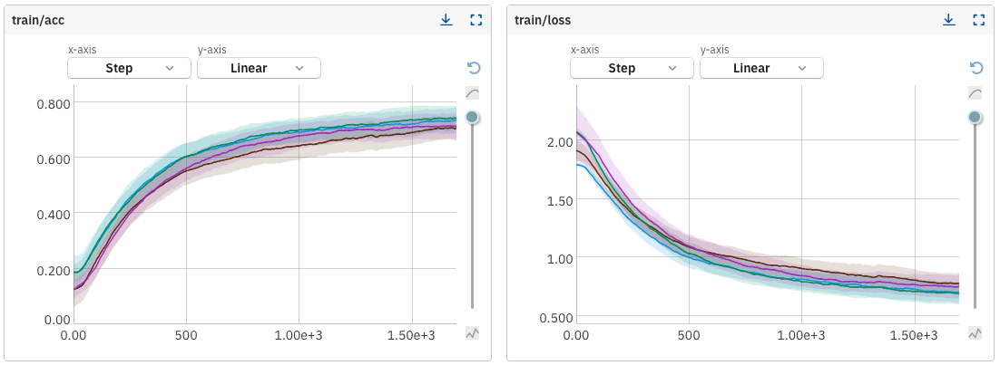

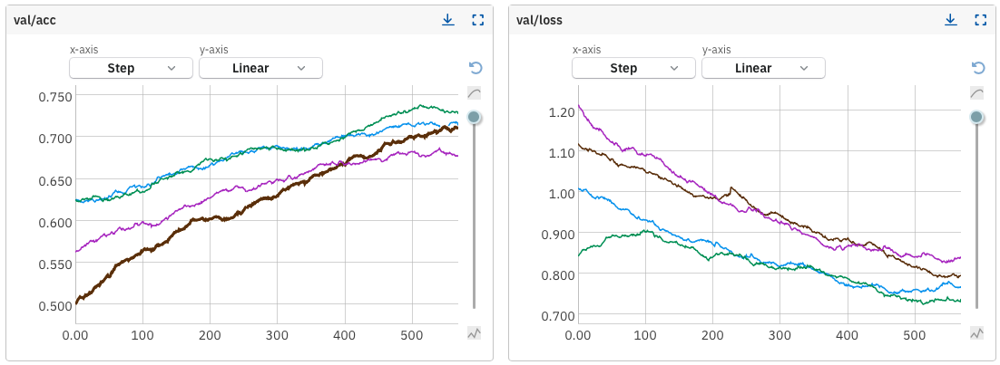

In [ ]:
net = BasicCNN(numLabels=6)
net = net.to(device)
criterionBasic = nn.CrossEntropyLoss()
optimizerBasic = optim.Adam(net.parameters(), lr=0.0005)    #net.parameters is the wight of the NN

run = neptune.init_run(
    project="gihazshay/finalProjectML",
    api_token="eyJhcGlfYWRkcmVzcyI6Imh0dHBzOi8vYXBwLm5lcHR1bmUuYWkiLCJhcGlfdXJsIjoiaHR0cHM6Ly9hcHAubmVwdHVuZS5haSIsImFwaV9rZXkiOiI0Mjc3OWFhMi0zYWI3LTRiMjQtYjFiMC0xMGNkYWU4MjBkOTcifQ==",
)

params = {"learning_rate": 0.0005, "optimizer": "Adam"}
run["parameters"] = params

trainModel = train(net, trainDataloader, optimizerBasic, 5, criterionBasic)
testAcc, testLoss = test(net, testDataloader, criterionBasic)

run.stop()


[neptune] [info   ] Neptune initialized. Open in the app: https://app.neptune.ai/gihazshay/finalProjectML/e/FIN-368


Epoch 0: 100%|██████████| 453/453 [00:05<00:00, 87.17batch/s]


              precision    recall  f1-score   support

           0       0.54      0.63      0.59      2451
           1       0.44      0.26      0.33      2366
           2       0.52      0.42      0.47      2581
           3       0.50      0.59      0.54      2513
           4       0.67      0.74      0.71      2333
           5       0.45      0.52      0.49      2234

    accuracy                           0.53     14478
   macro avg       0.52      0.53      0.52     14478
weighted avg       0.52      0.53      0.52     14478



Epoch 1: 100%|██████████| 453/453 [00:05<00:00, 82.31batch/s]


              precision    recall  f1-score   support

           0       0.71      0.73      0.72      2451
           1       0.60      0.52      0.56      2366
           2       0.64      0.59      0.61      2581
           3       0.60      0.73      0.66      2513
           4       0.88      0.86      0.87      2333
           5       0.63      0.63      0.63      2234

    accuracy                           0.67     14478
   macro avg       0.68      0.68      0.67     14478
weighted avg       0.68      0.67      0.67     14478



Epoch 2: 100%|██████████| 453/453 [00:05<00:00, 78.47batch/s]


              precision    recall  f1-score   support

           0       0.75      0.75      0.75      2451
           1       0.65      0.56      0.60      2366
           2       0.66      0.67      0.66      2581
           3       0.66      0.74      0.70      2513
           4       0.90      0.88      0.89      2333
           5       0.67      0.69      0.68      2234

    accuracy                           0.71     14478
   macro avg       0.71      0.71      0.71     14478
weighted avg       0.71      0.71      0.71     14478



Epoch 3: 100%|██████████| 453/453 [00:05<00:00, 89.77batch/s]


              precision    recall  f1-score   support

           0       0.77      0.77      0.77      2451
           1       0.68      0.61      0.64      2366
           2       0.68      0.69      0.68      2581
           3       0.68      0.73      0.70      2513
           4       0.89      0.90      0.90      2333
           5       0.71      0.71      0.71      2234

    accuracy                           0.73     14478
   macro avg       0.73      0.73      0.73     14478
weighted avg       0.73      0.73      0.73     14478



Epoch 4: 100%|██████████| 453/453 [00:05<00:00, 83.22batch/s]


              precision    recall  f1-score   support

           0       0.79      0.79      0.79      2451
           1       0.71      0.65      0.68      2366
           2       0.69      0.71      0.70      2581
           3       0.70      0.74      0.72      2513
           4       0.90      0.91      0.91      2333
           5       0.72      0.72      0.72      2234

    accuracy                           0.75     14478
   macro avg       0.75      0.75      0.75     14478
weighted avg       0.75      0.75      0.75     14478



100%|██████████| 80/80 [00:00<00:00, 118.11batch/s]


              precision    recall  f1-score   support

           0       0.77      0.82      0.80       432
           1       0.71      0.69      0.70       418
           2       0.69      0.68      0.69       456
           3       0.73      0.73      0.73       444
           4       0.95      0.92      0.93       412
           5       0.74      0.74      0.74       394

    accuracy                           0.76      2556
   macro avg       0.76      0.76      0.76      2556
weighted avg       0.76      0.76      0.76      2556

[neptune] [info   ] Shutting down background jobs, please wait a moment...
[neptune] [info   ] Done!
[neptune] [info   ] Waiting for the remaining 46 operations to synchronize with Neptune. Do not kill this process.
[neptune] [info   ] All 46 operations synced, thanks for waiting!
[neptune] [info   ] Explore the metadata in the Neptune app: https://app.neptune.ai/gihazshay/finalProjectML/e/FIN-368/metadata


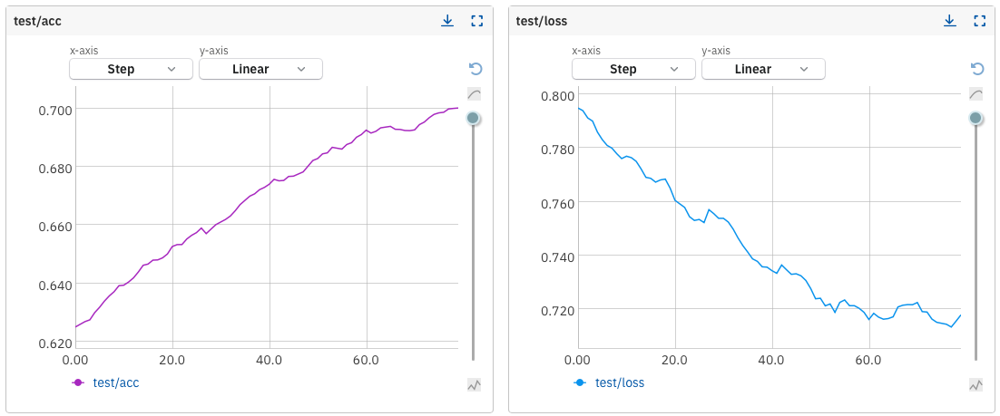

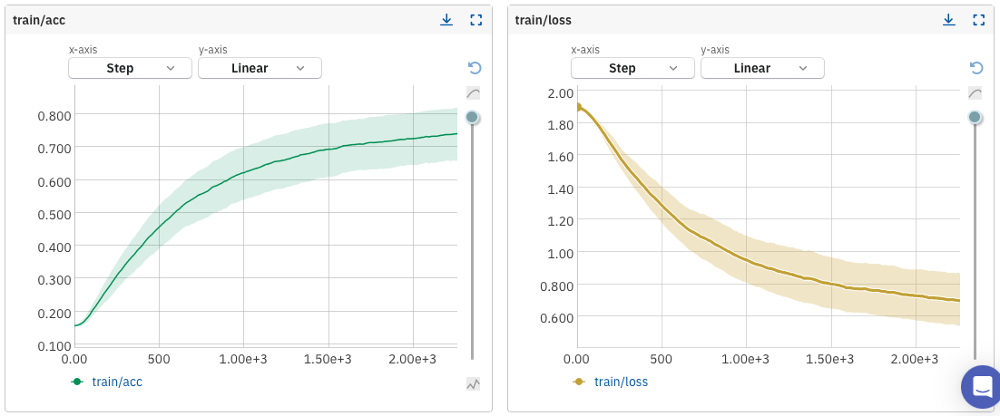

#### Learning Rate Comparison

#### ($0.1$, $0.001$, $0.005$, $0.0005$, $0.0001$)

Green: $0.1$

Red: $0.005$

Yellow: $0.001$

Blue: $0.0005$

Light Purple: $0.0001$


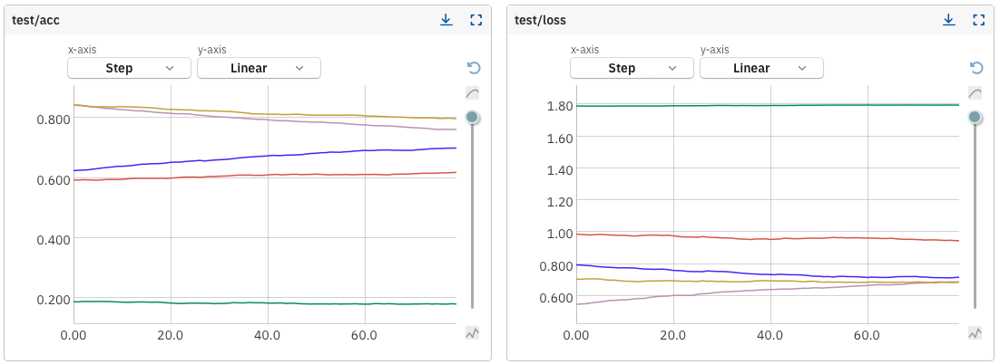

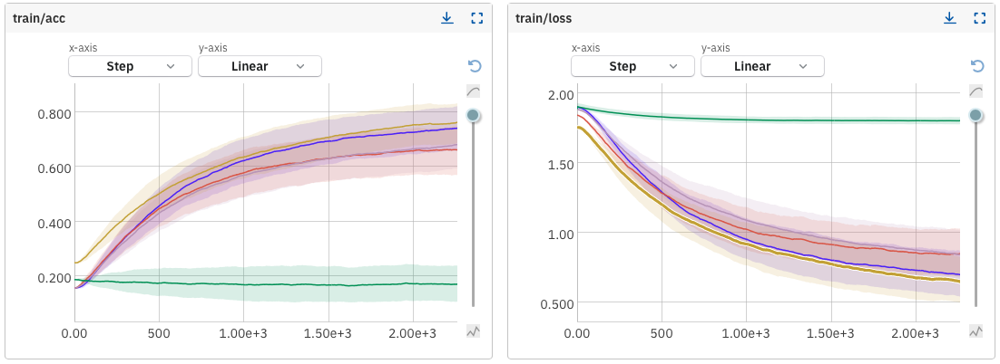

We can see from the graphs that the green line represents the worst performance, while the yellow graph shows the best performance in all aspects. The yellow graph has the highest accuracy for both training and testing, and the lowest loss for both training and testing.

Therefore, we will choose a learning rate of $0.001$ for further training.

Let's proceed with training the model using a learning rate of $0.001$ and observe the results over a larger number of epochs. We will continue to monitor the training and validation metrics to ensure the model's performance remains consistent.

## Last architecture comparison

As mentioned after the architecture comparison, we have chosen our best learning rate.

Below is the comparison between `BasicNN`(Purple) and `frstArchBasicNN`(Brown).

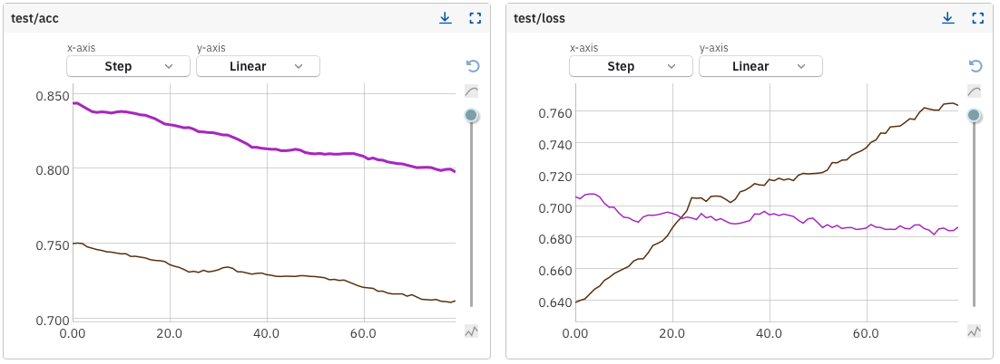

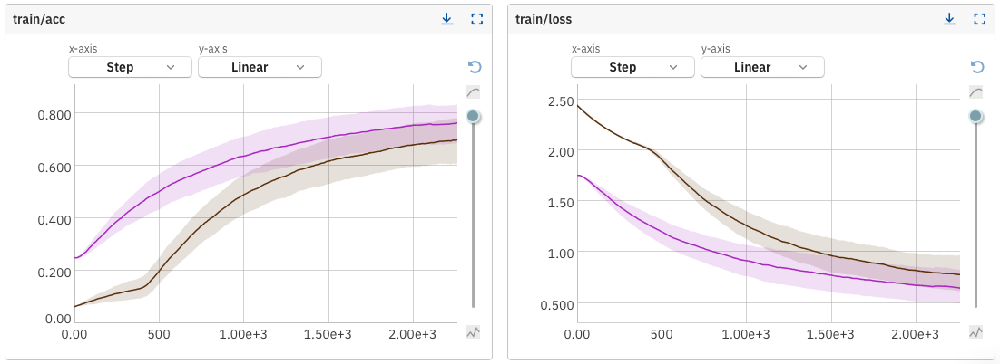

We can clearly see that we made the right choice!

The best neural network is `BasicNN`, so we will continue to inspect the hyperparameters with this model.



---



## Number of Epochs

#### $20$ Epochs

In [ ]:
num_folds = 4

# Initialize the KFold object
kf = KFold(n_splits=num_folds, shuffle=True, random_state=40)


foldNum = 0
foldsMatrix = {}


for train_indices, val_indices in kf.split(idxTrain):


    TrainX_Kfold = np.array([dataset[i][0] for i in idxTrain[train_indices]])
    ValX_Kfold = np.array([dataset[j][0] for j in idxTrain[val_indices]])
    TrainY_Kfold = np.array([dataset[i][1] for i in idxTrain[train_indices]])
    ValY_Kfold = np.array([dataset[j][1] for j in idxTrain[val_indices]])
    ValZ_Kfold = np.array([dataset[j][2] for j in idxTrain[val_indices]])      #ID test of the images
    TrainZ_Kfold = np.array([dataset[i][2] for i in idxTrain[train_indices]])  #ID train of the images

    tensorTrainX_Kfold = torch.tensor(TrainX_Kfold, dtype=torch.float32).to(device)
    tensorValX_Kfold = torch.tensor(ValX_Kfold, dtype=torch.float32).to(device)
    tensorTrainY_Kfold = torch.tensor(TrainY_Kfold, dtype=torch.long).to(device)
    tensorValY_Kfold = torch.tensor(ValY_Kfold, dtype=torch.long).to(device)
    tensorTrainZ_Kfold = torch.tensor(TrainZ_Kfold, dtype=torch.long).to(device)
    tensorValZ_Kfold = torch.tensor(ValZ_Kfold, dtype=torch.long).to(device)

    # Create a TensorDataset object from the data
    tensorDatasetTrain_Kfold = TensorDataset(tensorTrainX_Kfold, tensorTrainY_Kfold, tensorTrainZ_Kfold)
    tensorDatasetVal_Kfold = TensorDataset(tensorValX_Kfold, tensorValY_Kfold, tensorValZ_Kfold)

    # Create a DataLoader object with batch size 32
    trainDataloaderKfold = DataLoader(tensorDatasetTrain_Kfold, batch_size=32, shuffle=True)
    valDataloaderKfold = DataLoader(tensorDatasetVal_Kfold, batch_size=32, shuffle=True)

    print(f"------fold------:{foldNum}")

    run = neptune.init_run(
    project="gihazshay/finalProjectML",
    api_token="eyJhcGlfYWRkcmVzcyI6Imh0dHBzOi8vYXBwLm5lcHR1bmUuYWkiLCJhcGlfdXJsIjoiaHR0cHM6Ly9hcHAubmVwdHVuZS5haSIsImFwaV9rZXkiOiI0Mjc3OWFhMi0zYWI3LTRiMjQtYjFiMC0xMGNkYWU4MjBkOTcifQ==",
    )
    params = {"learning_rate": 0.001, "optimizer": "Adam"}
    run["parameters"] = params

    net = BasicCNN(numLabels=6)
    net = net.to(device)
    criterionBasic = nn.CrossEntropyLoss()
    optimizerBasic = optim.Adam(net.parameters(), lr=0.001)    #net.parameters is the wight of the NN
    trainAcc, trainLoss, valAcc, valLoss = train(net, trainDataloaderKfold, optimizerBasic, 20, criterionBasic, valDataloaderKfold)

    run.stop()
    foldsMatrix[f"fold {foldNum}"] = {'train_acc':trainAcc, 'train_loss':trainLoss,
                                      'val_acc':valAcc, 'val_loss':valLoss}
    foldNum += 1

------fold------:0


[neptune] [warning] NeptuneWarning: The following monitoring options are disabled by default in interactive sessions: 'capture_stdout', 'capture_stderr', 'capture_traceback', and 'capture_hardware_metrics'. To enable them, set each parameter to 'True' when initializing the run. The monitoring will continue until you call run.stop() or the kernel stops. Also note: Your source files can only be tracked if you pass the path(s) to the 'source_code' argument. For help, see the Neptune docs: https://docs.neptune.ai/logging/source_code/


[neptune] [info   ] Neptune initialized. Open in the app: https://app.neptune.ai/gihazshay/finalProjectML/e/FIN-378


Epoch 0:   0%|          | 0/340 [00:00<?, ?batch/s]/usr/local/lib/python3.10/dist-packages/torch/autograd/graph.py:744: UserWarning: Plan failed with a cudnnException: CUDNN_BACKEND_EXECUTION_PLAN_DESCRIPTOR: cudnnFinalize Descriptor Failed cudnn_status: CUDNN_STATUS_NOT_SUPPORTED (Triggered internally at ../aten/src/ATen/native/cudnn/Conv_v8.cpp:919.)
  return Variable._execution_engine.run_backward(  # Calls into the C++ engine to run the backward pass
Epoch 0: 100%|██████████| 340/340 [00:04<00:00, 83.70batch/s] 


              precision    recall  f1-score   support

           0       0.51      0.59      0.55      1822
           1       0.45      0.25      0.32      1766
           2       0.55      0.54      0.54      1964
           3       0.51      0.55      0.53      1871
           4       0.68      0.75      0.72      1745
           5       0.47      0.52      0.49      1690

    accuracy                           0.54     10858
   macro avg       0.53      0.54      0.53     10858
weighted avg       0.53      0.54      0.53     10858

Validtion part------EPOCH------:0


100%|██████████| 114/114 [00:00<00:00, 310.42batch/s]


              precision    recall  f1-score   support

           0       0.68      0.68      0.68       629
           1       0.50      0.48      0.49       600
           2       0.60      0.67      0.63       617
           3       0.64      0.59      0.61       642
           4       0.89      0.83      0.86       588
           5       0.59      0.61      0.60       544

    accuracy                           0.65      3620
   macro avg       0.65      0.65      0.65      3620
weighted avg       0.65      0.65      0.65      3620



Epoch 1: 100%|██████████| 340/340 [00:02<00:00, 134.63batch/s]


              precision    recall  f1-score   support

           0       0.69      0.73      0.71      1822
           1       0.56      0.42      0.48      1766
           2       0.63      0.66      0.64      1964
           3       0.61      0.68      0.65      1871
           4       0.87      0.85      0.86      1745
           5       0.62      0.66      0.64      1690

    accuracy                           0.67     10858
   macro avg       0.66      0.67      0.66     10858
weighted avg       0.66      0.67      0.66     10858

Validtion part------EPOCH------:1


100%|██████████| 114/114 [00:00<00:00, 319.94batch/s]


              precision    recall  f1-score   support

           0       0.64      0.76      0.69       629
           1       0.37      0.79      0.51       600
           2       0.69      0.48      0.56       617
           3       0.74      0.30      0.42       642
           4       0.99      0.66      0.80       588
           5       0.65      0.60      0.63       544

    accuracy                           0.60      3620
   macro avg       0.68      0.60      0.60      3620
weighted avg       0.68      0.60      0.60      3620



Epoch 2: 100%|██████████| 340/340 [00:02<00:00, 114.22batch/s]


              precision    recall  f1-score   support

           0       0.72      0.75      0.73      1822
           1       0.61      0.55      0.58      1766
           2       0.67      0.66      0.67      1964
           3       0.66      0.70      0.68      1871
           4       0.89      0.87      0.88      1745
           5       0.67      0.69      0.68      1690

    accuracy                           0.70     10858
   macro avg       0.71      0.71      0.70     10858
weighted avg       0.70      0.70      0.70     10858

Validtion part------EPOCH------:2


100%|██████████| 114/114 [00:00<00:00, 150.87batch/s]


              precision    recall  f1-score   support

           0       0.71      0.80      0.75       629
           1       0.54      0.70      0.61       600
           2       0.67      0.61      0.64       617
           3       0.75      0.58      0.65       642
           4       0.88      0.89      0.88       588
           5       0.69      0.62      0.65       544

    accuracy                           0.70      3620
   macro avg       0.71      0.70      0.70      3620
weighted avg       0.71      0.70      0.70      3620



Epoch 3: 100%|██████████| 340/340 [00:03<00:00, 107.28batch/s]


              precision    recall  f1-score   support

           0       0.74      0.77      0.76      1822
           1       0.65      0.60      0.62      1766
           2       0.69      0.68      0.69      1964
           3       0.69      0.73      0.71      1871
           4       0.89      0.87      0.88      1745
           5       0.68      0.72      0.70      1690

    accuracy                           0.73     10858
   macro avg       0.73      0.73      0.73     10858
weighted avg       0.73      0.73      0.73     10858

Validtion part------EPOCH------:3


100%|██████████| 114/114 [00:00<00:00, 310.70batch/s]


              precision    recall  f1-score   support

           0       0.79      0.65      0.71       629
           1       0.69      0.61      0.65       600
           2       0.66      0.67      0.67       617
           3       0.70      0.72      0.71       642
           4       0.89      0.88      0.89       588
           5       0.62      0.80      0.70       544

    accuracy                           0.72      3620
   macro avg       0.73      0.72      0.72      3620
weighted avg       0.73      0.72      0.72      3620



Epoch 4: 100%|██████████| 340/340 [00:02<00:00, 133.79batch/s]


              precision    recall  f1-score   support

           0       0.77      0.79      0.78      1822
           1       0.69      0.67      0.68      1766
           2       0.72      0.70      0.71      1964
           3       0.72      0.74      0.73      1871
           4       0.91      0.90      0.90      1745
           5       0.72      0.73      0.72      1690

    accuracy                           0.75     10858
   macro avg       0.75      0.75      0.75     10858
weighted avg       0.75      0.75      0.75     10858

Validtion part------EPOCH------:4


100%|██████████| 114/114 [00:00<00:00, 332.06batch/s]


              precision    recall  f1-score   support

           0       0.72      0.79      0.75       629
           1       0.75      0.43      0.54       600
           2       0.58      0.73      0.64       617
           3       0.63      0.79      0.70       642
           4       0.84      0.91      0.87       588
           5       0.80      0.53      0.64       544

    accuracy                           0.70      3620
   macro avg       0.72      0.70      0.69      3620
weighted avg       0.71      0.70      0.69      3620



Epoch 5: 100%|██████████| 340/340 [00:02<00:00, 126.17batch/s]


              precision    recall  f1-score   support

           0       0.78      0.80      0.79      1822
           1       0.71      0.68      0.69      1766
           2       0.72      0.71      0.72      1964
           3       0.73      0.75      0.74      1871
           4       0.91      0.90      0.90      1745
           5       0.75      0.75      0.75      1690

    accuracy                           0.77     10858
   macro avg       0.77      0.77      0.77     10858
weighted avg       0.77      0.77      0.77     10858

Validtion part------EPOCH------:5


100%|██████████| 114/114 [00:00<00:00, 263.89batch/s]


              precision    recall  f1-score   support

           0       0.68      0.85      0.76       629
           1       0.76      0.61      0.68       600
           2       0.69      0.67      0.68       617
           3       0.68      0.81      0.74       642
           4       0.94      0.84      0.89       588
           5       0.74      0.63      0.68       544

    accuracy                           0.74      3620
   macro avg       0.75      0.73      0.74      3620
weighted avg       0.75      0.74      0.74      3620



Epoch 6: 100%|██████████| 340/340 [00:02<00:00, 129.24batch/s]


              precision    recall  f1-score   support

           0       0.79      0.82      0.80      1822
           1       0.72      0.68      0.70      1766
           2       0.72      0.72      0.72      1964
           3       0.74      0.76      0.75      1871
           4       0.92      0.92      0.92      1745
           5       0.77      0.77      0.77      1690

    accuracy                           0.78     10858
   macro avg       0.78      0.78      0.78     10858
weighted avg       0.78      0.78      0.78     10858

Validtion part------EPOCH------:6


100%|██████████| 114/114 [00:00<00:00, 314.47batch/s]


              precision    recall  f1-score   support

           0       0.75      0.74      0.75       629
           1       0.64      0.69      0.66       600
           2       0.65      0.68      0.66       617
           3       0.66      0.80      0.72       642
           4       0.96      0.84      0.89       588
           5       0.74      0.56      0.63       544

    accuracy                           0.72      3620
   macro avg       0.73      0.72      0.72      3620
weighted avg       0.73      0.72      0.72      3620



Epoch 7: 100%|██████████| 340/340 [00:02<00:00, 113.72batch/s]


              precision    recall  f1-score   support

           0       0.79      0.82      0.81      1822
           1       0.76      0.72      0.74      1766
           2       0.75      0.74      0.75      1964
           3       0.75      0.78      0.76      1871
           4       0.92      0.92      0.92      1745
           5       0.77      0.77      0.77      1690

    accuracy                           0.79     10858
   macro avg       0.79      0.79      0.79     10858
weighted avg       0.79      0.79      0.79     10858

Validtion part------EPOCH------:7


100%|██████████| 114/114 [00:00<00:00, 234.41batch/s]


              precision    recall  f1-score   support

           0       0.76      0.72      0.74       629
           1       0.75      0.65      0.70       600
           2       0.65      0.74      0.69       617
           3       0.74      0.71      0.72       642
           4       0.94      0.86      0.90       588
           5       0.65      0.78      0.71       544

    accuracy                           0.74      3620
   macro avg       0.75      0.74      0.74      3620
weighted avg       0.75      0.74      0.74      3620



Epoch 8: 100%|██████████| 340/340 [00:03<00:00, 106.31batch/s]


              precision    recall  f1-score   support

           0       0.81      0.83      0.82      1822
           1       0.76      0.74      0.75      1766
           2       0.76      0.76      0.76      1964
           3       0.76      0.77      0.77      1871
           4       0.92      0.92      0.92      1745
           5       0.78      0.78      0.78      1690

    accuracy                           0.80     10858
   macro avg       0.80      0.80      0.80     10858
weighted avg       0.80      0.80      0.80     10858

Validtion part------EPOCH------:8


100%|██████████| 114/114 [00:00<00:00, 229.22batch/s]


              precision    recall  f1-score   support

           0       0.76      0.72      0.74       629
           1       0.78      0.66      0.72       600
           2       0.69      0.72      0.71       617
           3       0.69      0.81      0.75       642
           4       0.84      0.93      0.88       588
           5       0.73      0.64      0.68       544

    accuracy                           0.75      3620
   macro avg       0.75      0.75      0.75      3620
weighted avg       0.75      0.75      0.75      3620



Epoch 9: 100%|██████████| 340/340 [00:02<00:00, 128.94batch/s]


              precision    recall  f1-score   support

           0       0.81      0.84      0.83      1822
           1       0.77      0.74      0.75      1766
           2       0.76      0.75      0.76      1964
           3       0.76      0.79      0.77      1871
           4       0.93      0.92      0.93      1745
           5       0.79      0.79      0.79      1690

    accuracy                           0.80     10858
   macro avg       0.80      0.80      0.80     10858
weighted avg       0.80      0.80      0.80     10858

Validtion part------EPOCH------:9


100%|██████████| 114/114 [00:00<00:00, 315.61batch/s]


              precision    recall  f1-score   support

           0       0.72      0.79      0.76       629
           1       0.79      0.64      0.71       600
           2       0.65      0.78      0.71       617
           3       0.78      0.63      0.70       642
           4       0.91      0.88      0.89       588
           5       0.65      0.74      0.69       544

    accuracy                           0.74      3620
   macro avg       0.75      0.74      0.74      3620
weighted avg       0.75      0.74      0.74      3620



Epoch 10: 100%|██████████| 340/340 [00:02<00:00, 133.43batch/s]


              precision    recall  f1-score   support

           0       0.82      0.85      0.84      1822
           1       0.79      0.76      0.78      1766
           2       0.77      0.77      0.77      1964
           3       0.77      0.79      0.78      1871
           4       0.93      0.93      0.93      1745
           5       0.81      0.80      0.81      1690

    accuracy                           0.82     10858
   macro avg       0.82      0.82      0.82     10858
weighted avg       0.82      0.82      0.82     10858

Validtion part------EPOCH------:10


100%|██████████| 114/114 [00:00<00:00, 320.94batch/s]


              precision    recall  f1-score   support

           0       0.79      0.69      0.74       629
           1       0.69      0.73      0.71       600
           2       0.77      0.65      0.70       617
           3       0.69      0.81      0.75       642
           4       0.95      0.88      0.91       588
           5       0.67      0.75      0.71       544

    accuracy                           0.75      3620
   macro avg       0.76      0.75      0.75      3620
weighted avg       0.76      0.75      0.75      3620



Epoch 11: 100%|██████████| 340/340 [00:02<00:00, 130.22batch/s]


              precision    recall  f1-score   support

           0       0.83      0.86      0.85      1822
           1       0.80      0.77      0.79      1766
           2       0.77      0.78      0.78      1964
           3       0.78      0.80      0.79      1871
           4       0.93      0.92      0.93      1745
           5       0.82      0.81      0.82      1690

    accuracy                           0.82     10858
   macro avg       0.82      0.82      0.82     10858
weighted avg       0.82      0.82      0.82     10858

Validtion part------EPOCH------:11


100%|██████████| 114/114 [00:00<00:00, 288.67batch/s]


              precision    recall  f1-score   support

           0       0.77      0.66      0.71       629
           1       0.75      0.69      0.72       600
           2       0.69      0.74      0.72       617
           3       0.74      0.72      0.73       642
           4       0.87      0.90      0.88       588
           5       0.65      0.74      0.70       544

    accuracy                           0.74      3620
   macro avg       0.75      0.75      0.74      3620
weighted avg       0.75      0.74      0.74      3620



Epoch 12: 100%|██████████| 340/340 [00:02<00:00, 125.64batch/s]


              precision    recall  f1-score   support

           0       0.84      0.87      0.86      1822
           1       0.79      0.78      0.78      1766
           2       0.77      0.77      0.77      1964
           3       0.78      0.78      0.78      1871
           4       0.94      0.93      0.93      1745
           5       0.83      0.82      0.83      1690

    accuracy                           0.83     10858
   macro avg       0.83      0.83      0.83     10858
weighted avg       0.83      0.83      0.82     10858

Validtion part------EPOCH------:12


100%|██████████| 114/114 [00:00<00:00, 261.62batch/s]


              precision    recall  f1-score   support

           0       0.77      0.67      0.72       629
           1       0.72      0.70      0.71       600
           2       0.73      0.67      0.70       617
           3       0.70      0.76      0.72       642
           4       0.87      0.91      0.89       588
           5       0.64      0.72      0.68       544

    accuracy                           0.74      3620
   macro avg       0.74      0.74      0.74      3620
weighted avg       0.74      0.74      0.74      3620



Epoch 13: 100%|██████████| 340/340 [00:02<00:00, 113.88batch/s]


              precision    recall  f1-score   support

           0       0.86      0.87      0.86      1822
           1       0.82      0.79      0.81      1766
           2       0.79      0.80      0.80      1964
           3       0.79      0.80      0.79      1871
           4       0.94      0.94      0.94      1745
           5       0.85      0.84      0.84      1690

    accuracy                           0.84     10858
   macro avg       0.84      0.84      0.84     10858
weighted avg       0.84      0.84      0.84     10858

Validtion part------EPOCH------:13


100%|██████████| 114/114 [00:00<00:00, 233.61batch/s]


              precision    recall  f1-score   support

           0       0.74      0.77      0.75       629
           1       0.78      0.66      0.71       600
           2       0.70      0.69      0.70       617
           3       0.67      0.79      0.72       642
           4       0.88      0.91      0.90       588
           5       0.70      0.64      0.67       544

    accuracy                           0.74      3620
   macro avg       0.75      0.74      0.74      3620
weighted avg       0.75      0.74      0.74      3620



Epoch 14: 100%|██████████| 340/340 [00:03<00:00, 109.12batch/s]


              precision    recall  f1-score   support

           0       0.86      0.88      0.87      1822
           1       0.82      0.80      0.81      1766
           2       0.80      0.79      0.80      1964
           3       0.80      0.81      0.80      1871
           4       0.94      0.94      0.94      1745
           5       0.86      0.85      0.85      1690

    accuracy                           0.84     10858
   macro avg       0.85      0.85      0.85     10858
weighted avg       0.84      0.84      0.84     10858

Validtion part------EPOCH------:14


100%|██████████| 114/114 [00:00<00:00, 314.66batch/s]


              precision    recall  f1-score   support

           0       0.68      0.81      0.74       629
           1       0.75      0.68      0.71       600
           2       0.71      0.67      0.69       617
           3       0.62      0.81      0.70       642
           4       0.97      0.79      0.87       588
           5       0.74      0.58      0.65       544

    accuracy                           0.73      3620
   macro avg       0.75      0.72      0.73      3620
weighted avg       0.74      0.73      0.73      3620



Epoch 15: 100%|██████████| 340/340 [00:02<00:00, 127.41batch/s]


              precision    recall  f1-score   support

           0       0.88      0.89      0.88      1822
           1       0.84      0.81      0.82      1766
           2       0.79      0.81      0.80      1964
           3       0.80      0.81      0.80      1871
           4       0.95      0.94      0.95      1745
           5       0.87      0.86      0.86      1690

    accuracy                           0.85     10858
   macro avg       0.85      0.85      0.85     10858
weighted avg       0.85      0.85      0.85     10858

Validtion part------EPOCH------:15


100%|██████████| 114/114 [00:00<00:00, 314.94batch/s]


              precision    recall  f1-score   support

           0       0.71      0.63      0.67       629
           1       0.83      0.46      0.59       600
           2       0.74      0.63      0.68       617
           3       0.61      0.75      0.67       642
           4       0.79      0.93      0.86       588
           5       0.56      0.74      0.64       544

    accuracy                           0.69      3620
   macro avg       0.71      0.69      0.69      3620
weighted avg       0.71      0.69      0.69      3620



Epoch 16: 100%|██████████| 340/340 [00:02<00:00, 127.38batch/s]


              precision    recall  f1-score   support

           0       0.89      0.90      0.90      1822
           1       0.84      0.82      0.83      1766
           2       0.82      0.81      0.81      1964
           3       0.80      0.82      0.81      1871
           4       0.96      0.95      0.96      1745
           5       0.88      0.88      0.88      1690

    accuracy                           0.86     10858
   macro avg       0.87      0.86      0.86     10858
weighted avg       0.86      0.86      0.86     10858

Validtion part------EPOCH------:16


100%|██████████| 114/114 [00:00<00:00, 320.02batch/s]


              precision    recall  f1-score   support

           0       0.72      0.68      0.70       629
           1       0.79      0.61      0.69       600
           2       0.66      0.75      0.70       617
           3       0.74      0.64      0.69       642
           4       0.82      0.93      0.87       588
           5       0.61      0.72      0.66       544

    accuracy                           0.72      3620
   macro avg       0.73      0.72      0.72      3620
weighted avg       0.73      0.72      0.72      3620



Epoch 17: 100%|██████████| 340/340 [00:02<00:00, 126.57batch/s]


              precision    recall  f1-score   support

           0       0.89      0.91      0.90      1822
           1       0.84      0.83      0.84      1766
           2       0.83      0.82      0.83      1964
           3       0.81      0.82      0.82      1871
           4       0.95      0.95      0.95      1745
           5       0.89      0.87      0.88      1690

    accuracy                           0.87     10858
   macro avg       0.87      0.87      0.87     10858
weighted avg       0.87      0.87      0.87     10858

Validtion part------EPOCH------:17


100%|██████████| 114/114 [00:00<00:00, 313.99batch/s]


              precision    recall  f1-score   support

           0       0.69      0.81      0.75       629
           1       0.67      0.74      0.70       600
           2       0.69      0.66      0.68       617
           3       0.72      0.65      0.68       642
           4       0.92      0.85      0.88       588
           5       0.70      0.65      0.67       544

    accuracy                           0.73      3620
   macro avg       0.73      0.73      0.73      3620
weighted avg       0.73      0.73      0.73      3620



Epoch 18: 100%|██████████| 340/340 [00:02<00:00, 114.53batch/s]


              precision    recall  f1-score   support

           0       0.89      0.90      0.89      1822
           1       0.85      0.83      0.84      1766
           2       0.81      0.83      0.82      1964
           3       0.81      0.81      0.81      1871
           4       0.95      0.94      0.94      1745
           5       0.88      0.89      0.88      1690

    accuracy                           0.86     10858
   macro avg       0.87      0.87      0.87     10858
weighted avg       0.86      0.86      0.86     10858

Validtion part------EPOCH------:18


100%|██████████| 114/114 [00:00<00:00, 235.45batch/s]


              precision    recall  f1-score   support

           0       0.70      0.74      0.72       629
           1       0.77      0.64      0.70       600
           2       0.67      0.72      0.69       617
           3       0.73      0.69      0.71       642
           4       0.84      0.93      0.88       588
           5       0.64      0.62      0.63       544

    accuracy                           0.73      3620
   macro avg       0.72      0.72      0.72      3620
weighted avg       0.73      0.73      0.72      3620



Epoch 19: 100%|██████████| 340/340 [00:03<00:00, 110.62batch/s]


              precision    recall  f1-score   support

           0       0.89      0.91      0.90      1822
           1       0.85      0.83      0.84      1766
           2       0.81      0.82      0.82      1964
           3       0.82      0.82      0.82      1871
           4       0.96      0.95      0.95      1745
           5       0.89      0.88      0.89      1690

    accuracy                           0.87     10858
   macro avg       0.87      0.87      0.87     10858
weighted avg       0.87      0.87      0.87     10858

Validtion part------EPOCH------:19


100%|██████████| 114/114 [00:00<00:00, 233.34batch/s]


              precision    recall  f1-score   support

           0       0.71      0.74      0.73       629
           1       0.65      0.77      0.71       600
           2       0.75      0.59      0.66       617
           3       0.67      0.77      0.72       642
           4       0.92      0.85      0.89       588
           5       0.70      0.64      0.67       544

    accuracy                           0.73      3620
   macro avg       0.74      0.73      0.73      3620
weighted avg       0.73      0.73      0.73      3620

[neptune] [info   ] Shutting down background jobs, please wait a moment...
[neptune] [info   ] Done!
[neptune] [info   ] Waiting for the remaining 40 operations to synchronize with Neptune. Do not kill this process.
[neptune] [info   ] All 40 operations synced, thanks for waiting!
[neptune] [info   ] Explore the metadata in the Neptune app: https://app.neptune.ai/gihazshay/finalProjectML/e/FIN-378/metadata
------fold------:1
[neptune] [info   ] Neptune 

Epoch 0: 100%|██████████| 340/340 [00:02<00:00, 115.60batch/s]


              precision    recall  f1-score   support

           0       0.51      0.62      0.56      1850
           1       0.40      0.28      0.33      1800
           2       0.53      0.49      0.51      1924
           3       0.54      0.46      0.50      1908
           4       0.67      0.81      0.73      1732
           5       0.40      0.44      0.42      1644

    accuracy                           0.52     10858
   macro avg       0.51      0.52      0.51     10858
weighted avg       0.51      0.52      0.51     10858

Validtion part------EPOCH------:0


100%|██████████| 114/114 [00:00<00:00, 316.90batch/s]


              precision    recall  f1-score   support

           0       0.60      0.83      0.70       601
           1       0.73      0.13      0.21       566
           2       0.55      0.72      0.62       657
           3       0.57      0.76      0.65       605
           4       0.83      0.87      0.85       601
           5       0.60      0.41      0.49       590

    accuracy                           0.63      3620
   macro avg       0.65      0.62      0.59      3620
weighted avg       0.65      0.63      0.59      3620



Epoch 1: 100%|██████████| 340/340 [00:02<00:00, 127.36batch/s]


              precision    recall  f1-score   support

           0       0.71      0.74      0.73      1850
           1       0.58      0.47      0.52      1800
           2       0.64      0.63      0.63      1924
           3       0.64      0.73      0.68      1908
           4       0.86      0.86      0.86      1732
           5       0.62      0.66      0.64      1644

    accuracy                           0.68     10858
   macro avg       0.68      0.68      0.68     10858
weighted avg       0.68      0.68      0.68     10858

Validtion part------EPOCH------:1


100%|██████████| 114/114 [00:00<00:00, 312.18batch/s]


              precision    recall  f1-score   support

           0       0.71      0.74      0.72       601
           1       0.44      0.82      0.57       566
           2       0.70      0.60      0.64       657
           3       0.77      0.42      0.54       605
           4       0.83      0.90      0.86       601
           5       0.77      0.52      0.62       590

    accuracy                           0.66      3620
   macro avg       0.70      0.67      0.66      3620
weighted avg       0.70      0.66      0.66      3620



Epoch 2: 100%|██████████| 340/340 [00:02<00:00, 126.92batch/s]


              precision    recall  f1-score   support

           0       0.73      0.77      0.75      1850
           1       0.66      0.58      0.61      1800
           2       0.67      0.66      0.67      1924
           3       0.69      0.74      0.71      1908
           4       0.89      0.88      0.89      1732
           5       0.67      0.70      0.69      1644

    accuracy                           0.72     10858
   macro avg       0.72      0.72      0.72     10858
weighted avg       0.72      0.72      0.72     10858

Validtion part------EPOCH------:2


100%|██████████| 114/114 [00:00<00:00, 317.53batch/s]


              precision    recall  f1-score   support

           0       0.72      0.77      0.74       601
           1       0.54      0.84      0.65       566
           2       0.81      0.51      0.63       657
           3       0.76      0.67      0.71       605
           4       0.96      0.83      0.89       601
           5       0.68      0.71      0.70       590

    accuracy                           0.72      3620
   macro avg       0.74      0.72      0.72      3620
weighted avg       0.75      0.72      0.72      3620



Epoch 3: 100%|██████████| 340/340 [00:02<00:00, 119.22batch/s]


              precision    recall  f1-score   support

           0       0.76      0.78      0.77      1850
           1       0.68      0.64      0.66      1800
           2       0.72      0.69      0.70      1924
           3       0.72      0.76      0.74      1908
           4       0.89      0.89      0.89      1732
           5       0.71      0.72      0.71      1644

    accuracy                           0.75     10858
   macro avg       0.75      0.75      0.75     10858
weighted avg       0.74      0.75      0.74     10858

Validtion part------EPOCH------:3


100%|██████████| 114/114 [00:00<00:00, 237.83batch/s]


              precision    recall  f1-score   support

           0       0.69      0.70      0.70       601
           1       0.50      0.88      0.63       566
           2       0.78      0.52      0.63       657
           3       0.75      0.58      0.65       605
           4       0.99      0.71      0.82       601
           5       0.65      0.73      0.69       590

    accuracy                           0.68      3620
   macro avg       0.73      0.69      0.69      3620
weighted avg       0.73      0.68      0.69      3620



Epoch 4: 100%|██████████| 340/340 [00:03<00:00, 111.14batch/s]


              precision    recall  f1-score   support

           0       0.76      0.79      0.78      1850
           1       0.71      0.67      0.69      1800
           2       0.73      0.71      0.72      1924
           3       0.72      0.75      0.73      1908
           4       0.90      0.89      0.90      1732
           5       0.72      0.75      0.74      1644

    accuracy                           0.76     10858
   macro avg       0.76      0.76      0.76     10858
weighted avg       0.76      0.76      0.76     10858

Validtion part------EPOCH------:4


100%|██████████| 114/114 [00:00<00:00, 236.86batch/s]


              precision    recall  f1-score   support

           0       0.69      0.72      0.71       601
           1       0.55      0.86      0.67       566
           2       0.81      0.50      0.62       657
           3       0.73      0.68      0.70       605
           4       0.98      0.71      0.82       601
           5       0.65      0.78      0.71       590

    accuracy                           0.70      3620
   macro avg       0.74      0.71      0.70      3620
weighted avg       0.74      0.70      0.70      3620



Epoch 5: 100%|██████████| 340/340 [00:03<00:00, 109.02batch/s]


              precision    recall  f1-score   support

           0       0.79      0.81      0.80      1850
           1       0.75      0.71      0.73      1800
           2       0.73      0.72      0.73      1924
           3       0.74      0.77      0.76      1908
           4       0.91      0.91      0.91      1732
           5       0.75      0.76      0.76      1644

    accuracy                           0.78     10858
   macro avg       0.78      0.78      0.78     10858
weighted avg       0.78      0.78      0.78     10858

Validtion part------EPOCH------:5


100%|██████████| 114/114 [00:00<00:00, 211.36batch/s]


              precision    recall  f1-score   support

           0       0.77      0.75      0.76       601
           1       0.75      0.65      0.70       566
           2       0.66      0.79      0.72       657
           3       0.70      0.78      0.74       605
           4       0.96      0.86      0.91       601
           5       0.77      0.69      0.73       590

    accuracy                           0.76      3620
   macro avg       0.77      0.76      0.76      3620
weighted avg       0.77      0.76      0.76      3620



Epoch 6: 100%|██████████| 340/340 [00:02<00:00, 119.32batch/s]


              precision    recall  f1-score   support

           0       0.80      0.81      0.80      1850
           1       0.76      0.73      0.75      1800
           2       0.75      0.73      0.74      1924
           3       0.75      0.78      0.77      1908
           4       0.91      0.91      0.91      1732
           5       0.76      0.78      0.77      1644

    accuracy                           0.79     10858
   macro avg       0.79      0.79      0.79     10858
weighted avg       0.79      0.79      0.79     10858

Validtion part------EPOCH------:6


100%|██████████| 114/114 [00:00<00:00, 312.67batch/s]


              precision    recall  f1-score   support

           0       0.70      0.81      0.75       601
           1       0.56      0.88      0.68       566
           2       0.84      0.42      0.56       657
           3       0.75      0.68      0.71       605
           4       0.96      0.86      0.91       601
           5       0.69      0.73      0.71       590

    accuracy                           0.72      3620
   macro avg       0.75      0.73      0.72      3620
weighted avg       0.75      0.72      0.72      3620



Epoch 7: 100%|██████████| 340/340 [00:02<00:00, 124.88batch/s]


              precision    recall  f1-score   support

           0       0.81      0.84      0.82      1850
           1       0.77      0.75      0.76      1800
           2       0.76      0.73      0.75      1924
           3       0.76      0.77      0.76      1908
           4       0.93      0.92      0.92      1732
           5       0.78      0.79      0.79      1644

    accuracy                           0.80     10858
   macro avg       0.80      0.80      0.80     10858
weighted avg       0.80      0.80      0.80     10858

Validtion part------EPOCH------:7


100%|██████████| 114/114 [00:00<00:00, 308.78batch/s]


              precision    recall  f1-score   support

           0       0.77      0.76      0.77       601
           1       0.75      0.71      0.73       566
           2       0.72      0.76      0.74       657
           3       0.75      0.72      0.74       605
           4       0.89      0.92      0.90       601
           5       0.73      0.73      0.73       590

    accuracy                           0.77      3620
   macro avg       0.77      0.77      0.77      3620
weighted avg       0.77      0.77      0.77      3620



Epoch 8: 100%|██████████| 340/340 [00:02<00:00, 124.21batch/s]


              precision    recall  f1-score   support

           0       0.83      0.85      0.84      1850
           1       0.78      0.77      0.77      1800
           2       0.77      0.75      0.76      1924
           3       0.77      0.78      0.78      1908
           4       0.93      0.93      0.93      1732
           5       0.80      0.82      0.81      1644

    accuracy                           0.81     10858
   macro avg       0.82      0.82      0.82     10858
weighted avg       0.81      0.81      0.81     10858

Validtion part------EPOCH------:8


100%|██████████| 114/114 [00:00<00:00, 308.51batch/s]


              precision    recall  f1-score   support

           0       0.77      0.74      0.76       601
           1       0.61      0.82      0.70       566
           2       0.73      0.74      0.73       657
           3       0.74      0.67      0.70       605
           4       0.95      0.89      0.92       601
           5       0.75      0.66      0.70       590

    accuracy                           0.75      3620
   macro avg       0.76      0.75      0.75      3620
weighted avg       0.76      0.75      0.75      3620



Epoch 9: 100%|██████████| 340/340 [00:02<00:00, 118.12batch/s]


              precision    recall  f1-score   support

           0       0.83      0.85      0.84      1850
           1       0.80      0.79      0.80      1800
           2       0.78      0.77      0.77      1924
           3       0.79      0.79      0.79      1908
           4       0.93      0.93      0.93      1732
           5       0.81      0.81      0.81      1644

    accuracy                           0.82     10858
   macro avg       0.82      0.82      0.82     10858
weighted avg       0.82      0.82      0.82     10858

Validtion part------EPOCH------:9


100%|██████████| 114/114 [00:00<00:00, 229.54batch/s]


              precision    recall  f1-score   support

           0       0.81      0.68      0.74       601
           1       0.75      0.74      0.75       566
           2       0.78      0.63      0.69       657
           3       0.70      0.80      0.75       605
           4       0.86      0.94      0.90       601
           5       0.69      0.79      0.74       590

    accuracy                           0.76      3620
   macro avg       0.76      0.76      0.76      3620
weighted avg       0.76      0.76      0.76      3620



Epoch 10: 100%|██████████| 340/340 [00:03<00:00, 112.41batch/s]


              precision    recall  f1-score   support

           0       0.85      0.87      0.86      1850
           1       0.81      0.80      0.81      1800
           2       0.79      0.77      0.78      1924
           3       0.79      0.79      0.79      1908
           4       0.94      0.94      0.94      1732
           5       0.82      0.83      0.83      1644

    accuracy                           0.83     10858
   macro avg       0.83      0.83      0.83     10858
weighted avg       0.83      0.83      0.83     10858

Validtion part------EPOCH------:10


100%|██████████| 114/114 [00:00<00:00, 241.89batch/s]


              precision    recall  f1-score   support

           0       0.73      0.78      0.75       601
           1       0.78      0.67      0.72       566
           2       0.75      0.70      0.73       657
           3       0.65      0.85      0.73       605
           4       0.96      0.86      0.91       601
           5       0.73      0.67      0.69       590

    accuracy                           0.75      3620
   macro avg       0.77      0.75      0.76      3620
weighted avg       0.76      0.75      0.76      3620



Epoch 11: 100%|██████████| 340/340 [00:03<00:00, 108.51batch/s]


              precision    recall  f1-score   support

           0       0.85      0.87      0.86      1850
           1       0.82      0.81      0.81      1800
           2       0.80      0.78      0.79      1924
           3       0.79      0.80      0.80      1908
           4       0.94      0.93      0.94      1732
           5       0.84      0.84      0.84      1644

    accuracy                           0.84     10858
   macro avg       0.84      0.84      0.84     10858
weighted avg       0.84      0.84      0.84     10858

Validtion part------EPOCH------:11


100%|██████████| 114/114 [00:00<00:00, 223.41batch/s]


              precision    recall  f1-score   support

           0       0.80      0.70      0.75       601
           1       0.70      0.82      0.76       566
           2       0.75      0.72      0.74       657
           3       0.79      0.70      0.74       605
           4       0.88      0.93      0.91       601
           5       0.71      0.76      0.74       590

    accuracy                           0.77      3620
   macro avg       0.77      0.77      0.77      3620
weighted avg       0.77      0.77      0.77      3620



Epoch 12: 100%|██████████| 340/340 [00:02<00:00, 121.03batch/s]


              precision    recall  f1-score   support

           0       0.87      0.87      0.87      1850
           1       0.80      0.80      0.80      1800
           2       0.80      0.79      0.79      1924
           3       0.79      0.79      0.79      1908
           4       0.94      0.95      0.94      1732
           5       0.84      0.84      0.84      1644

    accuracy                           0.84     10858
   macro avg       0.84      0.84      0.84     10858
weighted avg       0.84      0.84      0.84     10858

Validtion part------EPOCH------:12


100%|██████████| 114/114 [00:00<00:00, 313.79batch/s]


              precision    recall  f1-score   support

           0       0.75      0.76      0.76       601
           1       0.76      0.71      0.74       566
           2       0.67      0.82      0.74       657
           3       0.79      0.64      0.71       605
           4       0.85      0.95      0.90       601
           5       0.76      0.67      0.71       590

    accuracy                           0.76      3620
   macro avg       0.76      0.76      0.76      3620
weighted avg       0.76      0.76      0.76      3620



Epoch 13: 100%|██████████| 340/340 [00:02<00:00, 122.31batch/s]


              precision    recall  f1-score   support

           0       0.87      0.89      0.88      1850
           1       0.83      0.83      0.83      1800
           2       0.81      0.80      0.80      1924
           3       0.81      0.80      0.80      1908
           4       0.95      0.95      0.95      1732
           5       0.85      0.86      0.85      1644

    accuracy                           0.85     10858
   macro avg       0.85      0.85      0.85     10858
weighted avg       0.85      0.85      0.85     10858

Validtion part------EPOCH------:13


100%|██████████| 114/114 [00:00<00:00, 307.15batch/s]


              precision    recall  f1-score   support

           0       0.79      0.72      0.75       601
           1       0.77      0.75      0.76       566
           2       0.75      0.71      0.73       657
           3       0.72      0.76      0.74       605
           4       0.91      0.92      0.92       601
           5       0.71      0.78      0.74       590

    accuracy                           0.77      3620
   macro avg       0.77      0.77      0.77      3620
weighted avg       0.77      0.77      0.77      3620



Epoch 14: 100%|██████████| 340/340 [00:02<00:00, 123.75batch/s]


              precision    recall  f1-score   support

           0       0.89      0.90      0.89      1850
           1       0.85      0.85      0.85      1800
           2       0.81      0.80      0.81      1924
           3       0.82      0.82      0.82      1908
           4       0.95      0.95      0.95      1732
           5       0.87      0.88      0.87      1644

    accuracy                           0.86     10858
   macro avg       0.87      0.87      0.87     10858
weighted avg       0.86      0.86      0.86     10858

Validtion part------EPOCH------:14


100%|██████████| 114/114 [00:00<00:00, 318.42batch/s]


              precision    recall  f1-score   support

           0       0.72      0.78      0.75       601
           1       0.83      0.54      0.66       566
           2       0.64      0.84      0.73       657
           3       0.69      0.75      0.71       605
           4       0.93      0.89      0.91       601
           5       0.76      0.63      0.69       590

    accuracy                           0.74      3620
   macro avg       0.76      0.74      0.74      3620
weighted avg       0.76      0.74      0.74      3620



Epoch 15: 100%|██████████| 340/340 [00:02<00:00, 116.51batch/s]


              precision    recall  f1-score   support

           0       0.88      0.90      0.89      1850
           1       0.84      0.84      0.84      1800
           2       0.82      0.81      0.81      1924
           3       0.83      0.82      0.82      1908
           4       0.94      0.95      0.94      1732
           5       0.87      0.88      0.87      1644

    accuracy                           0.86     10858
   macro avg       0.86      0.86      0.86     10858
weighted avg       0.86      0.86      0.86     10858

Validtion part------EPOCH------:15


100%|██████████| 114/114 [00:00<00:00, 242.42batch/s]


              precision    recall  f1-score   support

           0       0.74      0.77      0.76       601
           1       0.69      0.71      0.70       566
           2       0.70      0.75      0.73       657
           3       0.76      0.64      0.70       605
           4       0.87      0.94      0.90       601
           5       0.72      0.66      0.69       590

    accuracy                           0.75      3620
   macro avg       0.75      0.75      0.74      3620
weighted avg       0.75      0.75      0.75      3620



Epoch 16: 100%|██████████| 340/340 [00:03<00:00, 113.19batch/s]


              precision    recall  f1-score   support

           0       0.89      0.91      0.90      1850
           1       0.85      0.85      0.85      1800
           2       0.83      0.81      0.82      1924
           3       0.83      0.83      0.83      1908
           4       0.95      0.95      0.95      1732
           5       0.88      0.88      0.88      1644

    accuracy                           0.87     10858
   macro avg       0.87      0.87      0.87     10858
weighted avg       0.87      0.87      0.87     10858

Validtion part------EPOCH------:16


100%|██████████| 114/114 [00:00<00:00, 212.91batch/s]


              precision    recall  f1-score   support

           0       0.73      0.80      0.76       601
           1       0.80      0.70      0.75       566
           2       0.74      0.73      0.73       657
           3       0.67      0.79      0.72       605
           4       0.90      0.92      0.91       601
           5       0.77      0.66      0.71       590

    accuracy                           0.76      3620
   macro avg       0.77      0.76      0.76      3620
weighted avg       0.77      0.76      0.76      3620



Epoch 17: 100%|██████████| 340/340 [00:03<00:00, 108.75batch/s]


              precision    recall  f1-score   support

           0       0.89      0.91      0.90      1850
           1       0.86      0.86      0.86      1800
           2       0.84      0.82      0.83      1924
           3       0.84      0.83      0.84      1908
           4       0.94      0.94      0.94      1732
           5       0.89      0.90      0.90      1644

    accuracy                           0.88     10858
   macro avg       0.88      0.88      0.88     10858
weighted avg       0.88      0.88      0.88     10858

Validtion part------EPOCH------:17


100%|██████████| 114/114 [00:00<00:00, 215.36batch/s]


              precision    recall  f1-score   support

           0       0.78      0.67      0.73       601
           1       0.49      0.92      0.64       566
           2       0.76      0.47      0.58       657
           3       0.79      0.55      0.64       605
           4       0.96      0.87      0.91       601
           5       0.67      0.75      0.71       590

    accuracy                           0.70      3620
   macro avg       0.74      0.71      0.70      3620
weighted avg       0.74      0.70      0.70      3620



Epoch 18: 100%|██████████| 340/340 [00:02<00:00, 119.65batch/s]


              precision    recall  f1-score   support

           0       0.91      0.92      0.91      1850
           1       0.86      0.86      0.86      1800
           2       0.83      0.83      0.83      1924
           3       0.83      0.82      0.83      1908
           4       0.95      0.95      0.95      1732
           5       0.89      0.89      0.89      1644

    accuracy                           0.88     10858
   macro avg       0.88      0.88      0.88     10858
weighted avg       0.88      0.88      0.88     10858

Validtion part------EPOCH------:18


100%|██████████| 114/114 [00:00<00:00, 315.79batch/s]


              precision    recall  f1-score   support

           0       0.72      0.75      0.74       601
           1       0.73      0.68      0.71       566
           2       0.63      0.82      0.71       657
           3       0.80      0.59      0.68       605
           4       0.85      0.94      0.89       601
           5       0.74      0.64      0.69       590

    accuracy                           0.74      3620
   macro avg       0.75      0.74      0.74      3620
weighted avg       0.75      0.74      0.74      3620



Epoch 19: 100%|██████████| 340/340 [00:02<00:00, 123.62batch/s]


              precision    recall  f1-score   support

           0       0.91      0.92      0.92      1850
           1       0.86      0.86      0.86      1800
           2       0.84      0.83      0.84      1924
           3       0.84      0.84      0.84      1908
           4       0.96      0.96      0.96      1732
           5       0.90      0.89      0.90      1644

    accuracy                           0.88     10858
   macro avg       0.88      0.88      0.88     10858
weighted avg       0.88      0.88      0.88     10858

Validtion part------EPOCH------:19


100%|██████████| 114/114 [00:00<00:00, 317.99batch/s]


              precision    recall  f1-score   support

           0       0.79      0.71      0.75       601
           1       0.79      0.65      0.71       566
           2       0.69      0.74      0.71       657
           3       0.70      0.74      0.72       605
           4       0.91      0.92      0.91       601
           5       0.69      0.77      0.73       590

    accuracy                           0.76      3620
   macro avg       0.76      0.75      0.76      3620
weighted avg       0.76      0.76      0.76      3620

[neptune] [info   ] Shutting down background jobs, please wait a moment...
[neptune] [info   ] Done!
[neptune] [info   ] Waiting for the remaining 40 operations to synchronize with Neptune. Do not kill this process.
[neptune] [info   ] All 40 operations synced, thanks for waiting!
[neptune] [info   ] Explore the metadata in the Neptune app: https://app.neptune.ai/gihazshay/finalProjectML/e/FIN-379/metadata
------fold------:2
[neptune] [info   ] Neptune 

Epoch 0: 100%|██████████| 340/340 [00:03<00:00, 112.59batch/s]


              precision    recall  f1-score   support

           0       0.52      0.60      0.56      1855
           1       0.49      0.32      0.39      1767
           2       0.52      0.52      0.52      1933
           3       0.51      0.56      0.53      1863
           4       0.74      0.79      0.76      1737
           5       0.49      0.48      0.48      1704

    accuracy                           0.55     10859
   macro avg       0.54      0.55      0.54     10859
weighted avg       0.54      0.55      0.54     10859

Validtion part------EPOCH------:0


100%|██████████| 114/114 [00:00<00:00, 299.74batch/s]


              precision    recall  f1-score   support

           0       0.71      0.62      0.66       596
           1       0.56      0.60      0.57       599
           2       0.62      0.46      0.53       648
           3       0.67      0.62      0.64       650
           4       0.80      0.88      0.84       596
           5       0.53      0.72      0.61       530

    accuracy                           0.65      3619
   macro avg       0.65      0.65      0.64      3619
weighted avg       0.65      0.65      0.64      3619



Epoch 1: 100%|██████████| 340/340 [00:02<00:00, 114.23batch/s]


              precision    recall  f1-score   support

           0       0.67      0.71      0.69      1855
           1       0.57      0.50      0.53      1767
           2       0.60      0.61      0.60      1933
           3       0.60      0.63      0.62      1863
           4       0.86      0.83      0.84      1737
           5       0.61      0.62      0.61      1704

    accuracy                           0.65     10859
   macro avg       0.65      0.65      0.65     10859
weighted avg       0.65      0.65      0.65     10859

Validtion part------EPOCH------:1


100%|██████████| 114/114 [00:00<00:00, 217.03batch/s]


              precision    recall  f1-score   support

           0       0.78      0.58      0.67       596
           1       0.62      0.57      0.59       599
           2       0.64      0.60      0.62       648
           3       0.65      0.70      0.68       650
           4       0.84      0.92      0.88       596
           5       0.59      0.73      0.65       530

    accuracy                           0.68      3619
   macro avg       0.69      0.68      0.68      3619
weighted avg       0.69      0.68      0.68      3619



Epoch 2: 100%|██████████| 340/340 [00:03<00:00, 112.64batch/s]


              precision    recall  f1-score   support

           0       0.72      0.74      0.73      1855
           1       0.62      0.59      0.61      1767
           2       0.63      0.62      0.62      1933
           3       0.63      0.66      0.65      1863
           4       0.87      0.85      0.86      1737
           5       0.65      0.67      0.66      1704

    accuracy                           0.69     10859
   macro avg       0.69      0.69      0.69     10859
weighted avg       0.69      0.69      0.69     10859

Validtion part------EPOCH------:2


100%|██████████| 114/114 [00:00<00:00, 186.74batch/s]


              precision    recall  f1-score   support

           0       0.66      0.80      0.73       596
           1       0.58      0.61      0.60       599
           2       0.56      0.72      0.63       648
           3       0.78      0.50      0.61       650
           4       0.87      0.88      0.87       596
           5       0.68      0.55      0.61       530

    accuracy                           0.68      3619
   macro avg       0.69      0.67      0.67      3619
weighted avg       0.69      0.68      0.67      3619



Epoch 3: 100%|██████████| 340/340 [00:03<00:00, 108.19batch/s]


              precision    recall  f1-score   support

           0       0.73      0.76      0.75      1855
           1       0.65      0.62      0.64      1767
           2       0.66      0.64      0.65      1933
           3       0.66      0.69      0.68      1863
           4       0.90      0.87      0.88      1737
           5       0.69      0.70      0.69      1704

    accuracy                           0.71     10859
   macro avg       0.71      0.71      0.71     10859
weighted avg       0.71      0.71      0.71     10859

Validtion part------EPOCH------:3


100%|██████████| 114/114 [00:00<00:00, 209.06batch/s]


              precision    recall  f1-score   support

           0       0.75      0.66      0.70       596
           1       0.60      0.68      0.63       599
           2       0.61      0.67      0.64       648
           3       0.69      0.57      0.62       650
           4       0.85      0.92      0.88       596
           5       0.69      0.67      0.68       530

    accuracy                           0.69      3619
   macro avg       0.70      0.70      0.70      3619
weighted avg       0.70      0.69      0.69      3619



Epoch 4: 100%|██████████| 340/340 [00:03<00:00, 111.60batch/s]


              precision    recall  f1-score   support

           0       0.75      0.77      0.76      1855
           1       0.69      0.66      0.67      1767
           2       0.67      0.65      0.66      1933
           3       0.69      0.73      0.71      1863
           4       0.90      0.88      0.89      1737
           5       0.72      0.71      0.72      1704

    accuracy                           0.73     10859
   macro avg       0.74      0.73      0.73     10859
weighted avg       0.73      0.73      0.73     10859

Validtion part------EPOCH------:4


100%|██████████| 114/114 [00:00<00:00, 227.50batch/s]


              precision    recall  f1-score   support

           0       0.72      0.78      0.75       596
           1       0.81      0.48      0.61       599
           2       0.66      0.67      0.67       648
           3       0.67      0.79      0.72       650
           4       0.89      0.91      0.90       596
           5       0.65      0.71      0.68       530

    accuracy                           0.72      3619
   macro avg       0.73      0.72      0.72      3619
weighted avg       0.73      0.72      0.72      3619



Epoch 5: 100%|██████████| 340/340 [00:02<00:00, 117.18batch/s]


              precision    recall  f1-score   support

           0       0.77      0.78      0.78      1855
           1       0.71      0.69      0.70      1767
           2       0.70      0.69      0.69      1933
           3       0.71      0.73      0.72      1863
           4       0.91      0.89      0.90      1737
           5       0.72      0.75      0.73      1704

    accuracy                           0.75     10859
   macro avg       0.75      0.75      0.75     10859
weighted avg       0.75      0.75      0.75     10859

Validtion part------EPOCH------:5


100%|██████████| 114/114 [00:00<00:00, 242.59batch/s]


              precision    recall  f1-score   support

           0       0.66      0.73      0.70       596
           1       0.60      0.73      0.66       599
           2       0.59      0.65      0.62       648
           3       0.80      0.53      0.63       650
           4       0.76      0.96      0.84       596
           5       0.76      0.48      0.59       530

    accuracy                           0.68      3619
   macro avg       0.69      0.68      0.67      3619
weighted avg       0.69      0.68      0.67      3619



Epoch 6: 100%|██████████| 340/340 [00:02<00:00, 119.88batch/s]


              precision    recall  f1-score   support

           0       0.78      0.80      0.79      1855
           1       0.73      0.71      0.72      1767
           2       0.71      0.70      0.71      1933
           3       0.71      0.73      0.72      1863
           4       0.92      0.90      0.91      1737
           5       0.74      0.76      0.75      1704

    accuracy                           0.77     10859
   macro avg       0.77      0.77      0.77     10859
weighted avg       0.77      0.77      0.77     10859

Validtion part------EPOCH------:6


100%|██████████| 114/114 [00:00<00:00, 226.49batch/s]


              precision    recall  f1-score   support

           0       0.77      0.69      0.73       596
           1       0.72      0.68      0.70       599
           2       0.68      0.72      0.70       648
           3       0.72      0.77      0.74       650
           4       0.93      0.89      0.91       596
           5       0.68      0.73      0.71       530

    accuracy                           0.75      3619
   macro avg       0.75      0.75      0.75      3619
weighted avg       0.75      0.75      0.75      3619



Epoch 7: 100%|██████████| 340/340 [00:02<00:00, 118.12batch/s]


              precision    recall  f1-score   support

           0       0.80      0.81      0.81      1855
           1       0.73      0.72      0.73      1767
           2       0.72      0.72      0.72      1933
           3       0.73      0.75      0.74      1863
           4       0.92      0.91      0.91      1737
           5       0.77      0.78      0.78      1704

    accuracy                           0.78     10859
   macro avg       0.78      0.78      0.78     10859
weighted avg       0.78      0.78      0.78     10859

Validtion part------EPOCH------:7


100%|██████████| 114/114 [00:00<00:00, 221.76batch/s]


              precision    recall  f1-score   support

           0       0.73      0.79      0.76       596
           1       0.68      0.74      0.71       599
           2       0.70      0.67      0.68       648
           3       0.79      0.64      0.71       650
           4       0.86      0.93      0.90       596
           5       0.69      0.70      0.69       530

    accuracy                           0.74      3619
   macro avg       0.74      0.74      0.74      3619
weighted avg       0.74      0.74      0.74      3619



Epoch 8: 100%|██████████| 340/340 [00:03<00:00, 110.63batch/s]


              precision    recall  f1-score   support

           0       0.81      0.83      0.82      1855
           1       0.74      0.73      0.74      1767
           2       0.74      0.72      0.73      1933
           3       0.74      0.76      0.75      1863
           4       0.93      0.90      0.91      1737
           5       0.78      0.80      0.79      1704

    accuracy                           0.79     10859
   macro avg       0.79      0.79      0.79     10859
weighted avg       0.79      0.79      0.79     10859

Validtion part------EPOCH------:8


100%|██████████| 114/114 [00:00<00:00, 227.84batch/s]


              precision    recall  f1-score   support

           0       0.69      0.70      0.70       596
           1       0.70      0.65      0.67       599
           2       0.61      0.79      0.69       648
           3       0.73      0.65      0.69       650
           4       0.95      0.81      0.87       596
           5       0.64      0.64      0.64       530

    accuracy                           0.71      3619
   macro avg       0.72      0.71      0.71      3619
weighted avg       0.72      0.71      0.71      3619



Epoch 9: 100%|██████████| 340/340 [00:03<00:00, 110.49batch/s]


              precision    recall  f1-score   support

           0       0.83      0.84      0.83      1855
           1       0.78      0.77      0.77      1767
           2       0.75      0.75      0.75      1933
           3       0.75      0.77      0.76      1863
           4       0.93      0.91      0.92      1737
           5       0.80      0.80      0.80      1704

    accuracy                           0.80     10859
   macro avg       0.81      0.81      0.81     10859
weighted avg       0.80      0.80      0.80     10859

Validtion part------EPOCH------:9


100%|██████████| 114/114 [00:00<00:00, 194.92batch/s]


              precision    recall  f1-score   support

           0       0.70      0.80      0.75       596
           1       0.79      0.67      0.73       599
           2       0.69      0.73      0.71       648
           3       0.76      0.69      0.72       650
           4       0.92      0.87      0.89       596
           5       0.66      0.72      0.69       530

    accuracy                           0.75      3619
   macro avg       0.75      0.75      0.75      3619
weighted avg       0.75      0.75      0.75      3619



Epoch 10: 100%|██████████| 340/340 [00:03<00:00, 112.31batch/s]


              precision    recall  f1-score   support

           0       0.84      0.85      0.84      1855
           1       0.79      0.77      0.78      1767
           2       0.77      0.76      0.76      1933
           3       0.76      0.77      0.77      1863
           4       0.93      0.92      0.93      1737
           5       0.81      0.82      0.81      1704

    accuracy                           0.81     10859
   macro avg       0.82      0.82      0.82     10859
weighted avg       0.81      0.81      0.81     10859

Validtion part------EPOCH------:10


100%|██████████| 114/114 [00:00<00:00, 225.38batch/s]


              precision    recall  f1-score   support

           0       0.77      0.67      0.72       596
           1       0.56      0.88      0.68       599
           2       0.80      0.56      0.66       648
           3       0.76      0.69      0.72       650
           4       0.91      0.90      0.90       596
           5       0.67      0.67      0.67       530

    accuracy                           0.73      3619
   macro avg       0.74      0.73      0.73      3619
weighted avg       0.75      0.73      0.73      3619



Epoch 11: 100%|██████████| 340/340 [00:02<00:00, 114.61batch/s]


              precision    recall  f1-score   support

           0       0.86      0.86      0.86      1855
           1       0.80      0.79      0.79      1767
           2       0.77      0.76      0.77      1933
           3       0.77      0.79      0.78      1863
           4       0.94      0.93      0.93      1737
           5       0.82      0.82      0.82      1704

    accuracy                           0.82     10859
   macro avg       0.83      0.83      0.83     10859
weighted avg       0.82      0.82      0.82     10859

Validtion part------EPOCH------:11


100%|██████████| 114/114 [00:00<00:00, 238.25batch/s]


              precision    recall  f1-score   support

           0       0.78      0.66      0.72       596
           1       0.71      0.73      0.72       599
           2       0.66      0.72      0.69       648
           3       0.79      0.64      0.71       650
           4       0.94      0.86      0.90       596
           5       0.60      0.83      0.70       530

    accuracy                           0.74      3619
   macro avg       0.75      0.74      0.74      3619
weighted avg       0.75      0.74      0.74      3619



Epoch 12: 100%|██████████| 340/340 [00:03<00:00, 110.47batch/s]


              precision    recall  f1-score   support

           0       0.86      0.87      0.86      1855
           1       0.81      0.79      0.80      1767
           2       0.78      0.78      0.78      1933
           3       0.78      0.80      0.79      1863
           4       0.95      0.93      0.94      1737
           5       0.84      0.85      0.85      1704

    accuracy                           0.83     10859
   macro avg       0.84      0.84      0.84     10859
weighted avg       0.84      0.83      0.84     10859

Validtion part------EPOCH------:12


100%|██████████| 114/114 [00:00<00:00, 253.20batch/s]


              precision    recall  f1-score   support

           0       0.60      0.84      0.70       596
           1       0.77      0.66      0.72       599
           2       0.65      0.77      0.71       648
           3       0.79      0.63      0.70       650
           4       0.85      0.91      0.88       596
           5       0.73      0.50      0.59       530

    accuracy                           0.72      3619
   macro avg       0.73      0.72      0.72      3619
weighted avg       0.73      0.72      0.72      3619



Epoch 13: 100%|██████████| 340/340 [00:02<00:00, 122.32batch/s]


              precision    recall  f1-score   support

           0       0.87      0.89      0.88      1855
           1       0.81      0.80      0.81      1767
           2       0.78      0.79      0.78      1933
           3       0.79      0.79      0.79      1863
           4       0.95      0.93      0.94      1737
           5       0.86      0.86      0.86      1704

    accuracy                           0.84     10859
   macro avg       0.84      0.84      0.84     10859
weighted avg       0.84      0.84      0.84     10859

Validtion part------EPOCH------:13


100%|██████████| 114/114 [00:00<00:00, 258.97batch/s]


              precision    recall  f1-score   support

           0       0.74      0.73      0.73       596
           1       0.72      0.73      0.73       599
           2       0.69      0.73      0.71       648
           3       0.72      0.70      0.71       650
           4       0.86      0.93      0.89       596
           5       0.73      0.62      0.67       530

    accuracy                           0.74      3619
   macro avg       0.74      0.74      0.74      3619
weighted avg       0.74      0.74      0.74      3619



Epoch 14: 100%|██████████| 340/340 [00:02<00:00, 114.61batch/s]


              precision    recall  f1-score   support

           0       0.88      0.89      0.89      1855
           1       0.82      0.81      0.82      1767
           2       0.79      0.80      0.79      1933
           3       0.81      0.81      0.81      1863
           4       0.95      0.94      0.94      1737
           5       0.86      0.86      0.86      1704

    accuracy                           0.85     10859
   macro avg       0.85      0.85      0.85     10859
weighted avg       0.85      0.85      0.85     10859

Validtion part------EPOCH------:14


100%|██████████| 114/114 [00:00<00:00, 220.24batch/s]


              precision    recall  f1-score   support

           0       0.73      0.74      0.74       596
           1       0.74      0.69      0.71       599
           2       0.68      0.71      0.70       648
           3       0.70      0.70      0.70       650
           4       0.90      0.90      0.90       596
           5       0.67      0.68      0.68       530

    accuracy                           0.74      3619
   macro avg       0.74      0.74      0.74      3619
weighted avg       0.74      0.74      0.74      3619



Epoch 15: 100%|██████████| 340/340 [00:03<00:00, 111.64batch/s]


              precision    recall  f1-score   support

           0       0.90      0.90      0.90      1855
           1       0.83      0.82      0.83      1767
           2       0.81      0.81      0.81      1933
           3       0.82      0.82      0.82      1863
           4       0.95      0.94      0.95      1737
           5       0.87      0.88      0.88      1704

    accuracy                           0.86     10859
   macro avg       0.86      0.86      0.86     10859
weighted avg       0.86      0.86      0.86     10859

Validtion part------EPOCH------:15


100%|██████████| 114/114 [00:00<00:00, 205.73batch/s]


              precision    recall  f1-score   support

           0       0.66      0.79      0.72       596
           1       0.70      0.72      0.71       599
           2       0.69      0.59      0.64       648
           3       0.68      0.73      0.71       650
           4       0.82      0.94      0.88       596
           5       0.77      0.52      0.62       530

    accuracy                           0.72      3619
   macro avg       0.72      0.72      0.71      3619
weighted avg       0.72      0.72      0.71      3619



Epoch 16: 100%|██████████| 340/340 [00:03<00:00, 112.68batch/s]


              precision    recall  f1-score   support

           0       0.89      0.90      0.90      1855
           1       0.85      0.83      0.84      1767
           2       0.81      0.82      0.81      1933
           3       0.83      0.82      0.82      1863
           4       0.95      0.94      0.94      1737
           5       0.87      0.87      0.87      1704

    accuracy                           0.86     10859
   macro avg       0.87      0.86      0.86     10859
weighted avg       0.86      0.86      0.86     10859

Validtion part------EPOCH------:16


100%|██████████| 114/114 [00:00<00:00, 197.97batch/s]


              precision    recall  f1-score   support

           0       0.75      0.62      0.68       596
           1       0.71      0.70      0.70       599
           2       0.71      0.57      0.63       648
           3       0.61      0.76      0.68       650
           4       0.92      0.84      0.88       596
           5       0.61      0.78      0.69       530

    accuracy                           0.71      3619
   macro avg       0.72      0.71      0.71      3619
weighted avg       0.72      0.71      0.71      3619



Epoch 17: 100%|██████████| 340/340 [00:02<00:00, 114.41batch/s]


              precision    recall  f1-score   support

           0       0.90      0.90      0.90      1855
           1       0.84      0.83      0.84      1767
           2       0.81      0.83      0.82      1933
           3       0.83      0.83      0.83      1863
           4       0.95      0.94      0.95      1737
           5       0.88      0.90      0.89      1704

    accuracy                           0.87     10859
   macro avg       0.87      0.87      0.87     10859
weighted avg       0.87      0.87      0.87     10859

Validtion part------EPOCH------:17


100%|██████████| 114/114 [00:00<00:00, 306.97batch/s]


              precision    recall  f1-score   support

           0       0.78      0.63      0.69       596
           1       0.70      0.68      0.69       599
           2       0.63      0.76      0.69       648
           3       0.67      0.68      0.67       650
           4       0.85      0.92      0.88       596
           5       0.71      0.62      0.67       530

    accuracy                           0.72      3619
   macro avg       0.72      0.72      0.72      3619
weighted avg       0.72      0.72      0.72      3619



Epoch 18: 100%|██████████| 340/340 [00:02<00:00, 120.85batch/s]


              precision    recall  f1-score   support

           0       0.91      0.91      0.91      1855
           1       0.86      0.85      0.85      1767
           2       0.83      0.84      0.84      1933
           3       0.84      0.84      0.84      1863
           4       0.96      0.95      0.96      1737
           5       0.89      0.89      0.89      1704

    accuracy                           0.88     10859
   macro avg       0.88      0.88      0.88     10859
weighted avg       0.88      0.88      0.88     10859

Validtion part------EPOCH------:18


100%|██████████| 114/114 [00:00<00:00, 306.02batch/s]


              precision    recall  f1-score   support

           0       0.72      0.74      0.73       596
           1       0.63      0.75      0.69       599
           2       0.68      0.67      0.67       648
           3       0.69      0.64      0.67       650
           4       0.92      0.89      0.90       596
           5       0.71      0.63      0.67       530

    accuracy                           0.72      3619
   macro avg       0.72      0.72      0.72      3619
weighted avg       0.72      0.72      0.72      3619



Epoch 19: 100%|██████████| 340/340 [00:02<00:00, 119.14batch/s]


              precision    recall  f1-score   support

           0       0.90      0.91      0.91      1855
           1       0.86      0.85      0.86      1767
           2       0.82      0.83      0.82      1933
           3       0.84      0.83      0.83      1863
           4       0.97      0.96      0.96      1737
           5       0.89      0.90      0.90      1704

    accuracy                           0.88     10859
   macro avg       0.88      0.88      0.88     10859
weighted avg       0.88      0.88      0.88     10859

Validtion part------EPOCH------:19


100%|██████████| 114/114 [00:00<00:00, 248.94batch/s]


              precision    recall  f1-score   support

           0       0.71      0.70      0.70       596
           1       0.66      0.72      0.69       599
           2       0.70      0.69      0.69       648
           3       0.69      0.66      0.67       650
           4       0.87      0.90      0.89       596
           5       0.70      0.65      0.67       530

    accuracy                           0.72      3619
   macro avg       0.72      0.72      0.72      3619
weighted avg       0.72      0.72      0.72      3619

[neptune] [info   ] Shutting down background jobs, please wait a moment...
[neptune] [info   ] Done!
[neptune] [info   ] Waiting for the remaining 55 operations to synchronize with Neptune. Do not kill this process.
[neptune] [info   ] All 55 operations synced, thanks for waiting!
[neptune] [info   ] Explore the metadata in the Neptune app: https://app.neptune.ai/gihazshay/finalProjectML/e/FIN-380/metadata
------fold------:3
[neptune] [info   ] Neptune 

Epoch 0: 100%|██████████| 340/340 [00:03<00:00, 111.55batch/s]


              precision    recall  f1-score   support

           0       0.52      0.60      0.56      1826
           1       0.46      0.14      0.22      1765
           2       0.51      0.47      0.49      1922
           3       0.47      0.64      0.54      1897
           4       0.69      0.66      0.68      1785
           5       0.39      0.51      0.44      1664

    accuracy                           0.51     10859
   macro avg       0.51      0.50      0.49     10859
weighted avg       0.51      0.51      0.49     10859

Validtion part------EPOCH------:0


100%|██████████| 114/114 [00:00<00:00, 213.84batch/s]


              precision    recall  f1-score   support

           0       0.72      0.37      0.49       625
           1       0.67      0.21      0.32       601
           2       0.54      0.72      0.62       659
           3       0.62      0.66      0.64       616
           4       0.55      0.96      0.70       548
           5       0.53      0.58      0.56       570

    accuracy                           0.58      3619
   macro avg       0.61      0.58      0.55      3619
weighted avg       0.61      0.58      0.55      3619



Epoch 1: 100%|██████████| 340/340 [00:03<00:00, 111.82batch/s]


              precision    recall  f1-score   support

           0       0.69      0.69      0.69      1826
           1       0.57      0.42      0.49      1765
           2       0.63      0.61      0.62      1922
           3       0.59      0.69      0.64      1897
           4       0.85      0.83      0.84      1785
           5       0.57      0.65      0.61      1664

    accuracy                           0.65     10859
   macro avg       0.65      0.65      0.65     10859
weighted avg       0.65      0.65      0.65     10859

Validtion part------EPOCH------:1


100%|██████████| 114/114 [00:00<00:00, 231.19batch/s]


              precision    recall  f1-score   support

           0       0.75      0.66      0.70       625
           1       0.62      0.58      0.60       601
           2       0.66      0.69      0.67       659
           3       0.64      0.72      0.68       616
           4       0.95      0.80      0.86       548
           5       0.61      0.71      0.66       570

    accuracy                           0.69      3619
   macro avg       0.70      0.69      0.70      3619
weighted avg       0.70      0.69      0.69      3619



Epoch 2: 100%|██████████| 340/340 [00:02<00:00, 118.19batch/s]


              precision    recall  f1-score   support

           0       0.73      0.73      0.73      1826
           1       0.64      0.53      0.58      1765
           2       0.66      0.63      0.65      1922
           3       0.62      0.72      0.67      1897
           4       0.88      0.86      0.87      1785
           5       0.62      0.68      0.65      1664

    accuracy                           0.69     10859
   macro avg       0.69      0.69      0.69     10859
weighted avg       0.69      0.69      0.69     10859

Validtion part------EPOCH------:2


100%|██████████| 114/114 [00:00<00:00, 238.55batch/s]


              precision    recall  f1-score   support

           0       0.71      0.79      0.75       625
           1       0.70      0.50      0.58       601
           2       0.70      0.68      0.69       659
           3       0.61      0.79      0.69       616
           4       0.90      0.88      0.89       548
           5       0.69      0.64      0.66       570

    accuracy                           0.71      3619
   macro avg       0.72      0.71      0.71      3619
weighted avg       0.72      0.71      0.71      3619



Epoch 3: 100%|██████████| 340/340 [00:03<00:00, 110.11batch/s]


              precision    recall  f1-score   support

           0       0.77      0.76      0.76      1826
           1       0.65      0.59      0.62      1765
           2       0.69      0.66      0.67      1922
           3       0.66      0.72      0.69      1897
           4       0.90      0.89      0.89      1785
           5       0.67      0.72      0.70      1664

    accuracy                           0.72     10859
   macro avg       0.72      0.72      0.72     10859
weighted avg       0.72      0.72      0.72     10859

Validtion part------EPOCH------:3


100%|██████████| 114/114 [00:00<00:00, 310.90batch/s]


              precision    recall  f1-score   support

           0       0.67      0.85      0.75       625
           1       0.65      0.62      0.64       601
           2       0.81      0.59      0.69       659
           3       0.63      0.80      0.70       616
           4       0.96      0.83      0.89       548
           5       0.68      0.64      0.66       570

    accuracy                           0.72      3619
   macro avg       0.73      0.72      0.72      3619
weighted avg       0.73      0.72      0.72      3619



Epoch 4: 100%|██████████| 340/340 [00:02<00:00, 120.18batch/s]


              precision    recall  f1-score   support

           0       0.76      0.77      0.76      1826
           1       0.66      0.59      0.63      1765
           2       0.69      0.69      0.69      1922
           3       0.66      0.72      0.69      1897
           4       0.91      0.88      0.90      1785
           5       0.70      0.74      0.72      1664

    accuracy                           0.73     10859
   macro avg       0.73      0.73      0.73     10859
weighted avg       0.73      0.73      0.73     10859

Validtion part------EPOCH------:4


100%|██████████| 114/114 [00:00<00:00, 297.06batch/s]


              precision    recall  f1-score   support

           0       0.73      0.82      0.77       625
           1       0.69      0.63      0.66       601
           2       0.77      0.67      0.72       659
           3       0.65      0.79      0.71       616
           4       0.92      0.89      0.90       548
           5       0.71      0.65      0.68       570

    accuracy                           0.74      3619
   macro avg       0.75      0.74      0.74      3619
weighted avg       0.74      0.74      0.74      3619



Epoch 5: 100%|██████████| 340/340 [00:02<00:00, 119.25batch/s]


              precision    recall  f1-score   support

           0       0.80      0.80      0.80      1826
           1       0.68      0.64      0.66      1765
           2       0.71      0.68      0.69      1922
           3       0.69      0.74      0.72      1897
           4       0.92      0.91      0.92      1785
           5       0.73      0.76      0.75      1664

    accuracy                           0.76     10859
   macro avg       0.76      0.76      0.76     10859
weighted avg       0.76      0.76      0.75     10859

Validtion part------EPOCH------:5


100%|██████████| 114/114 [00:00<00:00, 210.54batch/s]


              precision    recall  f1-score   support

           0       0.85      0.65      0.74       625
           1       0.72      0.59      0.65       601
           2       0.74      0.73      0.73       659
           3       0.67      0.81      0.73       616
           4       0.79      0.96      0.87       548
           5       0.71      0.73      0.72       570

    accuracy                           0.74      3619
   macro avg       0.75      0.74      0.74      3619
weighted avg       0.75      0.74      0.74      3619



Epoch 6: 100%|██████████| 340/340 [00:02<00:00, 117.03batch/s]


              precision    recall  f1-score   support

           0       0.80      0.81      0.81      1826
           1       0.71      0.66      0.68      1765
           2       0.71      0.69      0.70      1922
           3       0.70      0.76      0.73      1897
           4       0.92      0.91      0.92      1785
           5       0.75      0.77      0.76      1664

    accuracy                           0.77     10859
   macro avg       0.77      0.77      0.77     10859
weighted avg       0.77      0.77      0.77     10859

Validtion part------EPOCH------:6


100%|██████████| 114/114 [00:00<00:00, 208.73batch/s]


              precision    recall  f1-score   support

           0       0.69      0.67      0.68       625
           1       0.69      0.64      0.66       601
           2       0.75      0.66      0.70       659
           3       0.66      0.78      0.71       616
           4       0.98      0.66      0.79       548
           5       0.59      0.80      0.68       570

    accuracy                           0.70      3619
   macro avg       0.73      0.70      0.71      3619
weighted avg       0.72      0.70      0.70      3619



Epoch 7: 100%|██████████| 340/340 [00:03<00:00, 111.11batch/s]


              precision    recall  f1-score   support

           0       0.81      0.81      0.81      1826
           1       0.72      0.68      0.70      1765
           2       0.74      0.71      0.72      1922
           3       0.71      0.77      0.74      1897
           4       0.92      0.91      0.92      1785
           5       0.77      0.79      0.78      1664

    accuracy                           0.78     10859
   macro avg       0.78      0.78      0.78     10859
weighted avg       0.78      0.78      0.78     10859

Validtion part------EPOCH------:7


100%|██████████| 114/114 [00:00<00:00, 200.51batch/s]


              precision    recall  f1-score   support

           0       0.73      0.74      0.73       625
           1       0.69      0.64      0.67       601
           2       0.78      0.63      0.69       659
           3       0.67      0.77      0.72       616
           4       0.97      0.78      0.86       548
           5       0.63      0.81      0.71       570

    accuracy                           0.73      3619
   macro avg       0.74      0.73      0.73      3619
weighted avg       0.74      0.73      0.73      3619



Epoch 8: 100%|██████████| 340/340 [00:03<00:00, 110.99batch/s]


              precision    recall  f1-score   support

           0       0.83      0.84      0.83      1826
           1       0.74      0.70      0.72      1765
           2       0.73      0.72      0.73      1922
           3       0.73      0.77      0.75      1897
           4       0.93      0.92      0.92      1785
           5       0.79      0.80      0.80      1664

    accuracy                           0.79     10859
   macro avg       0.79      0.79      0.79     10859
weighted avg       0.79      0.79      0.79     10859

Validtion part------EPOCH------:8


100%|██████████| 114/114 [00:00<00:00, 238.55batch/s]


              precision    recall  f1-score   support

           0       0.71      0.87      0.78       625
           1       0.72      0.68      0.70       601
           2       0.71      0.77      0.74       659
           3       0.73      0.73      0.73       616
           4       0.94      0.91      0.93       548
           5       0.80      0.61      0.69       570

    accuracy                           0.76      3619
   macro avg       0.77      0.76      0.76      3619
weighted avg       0.76      0.76      0.76      3619



Epoch 9: 100%|██████████| 340/340 [00:03<00:00, 111.68batch/s]


              precision    recall  f1-score   support

           0       0.85      0.85      0.85      1826
           1       0.75      0.70      0.73      1765
           2       0.74      0.72      0.73      1922
           3       0.73      0.78      0.75      1897
           4       0.94      0.93      0.94      1785
           5       0.81      0.81      0.81      1664

    accuracy                           0.80     10859
   macro avg       0.80      0.80      0.80     10859
weighted avg       0.80      0.80      0.80     10859

Validtion part------EPOCH------:9


100%|██████████| 114/114 [00:00<00:00, 254.93batch/s]


              precision    recall  f1-score   support

           0       0.79      0.75      0.77       625
           1       0.72      0.71      0.71       601
           2       0.72      0.74      0.73       659
           3       0.77      0.69      0.73       616
           4       0.92      0.93      0.93       548
           5       0.70      0.79      0.74       570

    accuracy                           0.77      3619
   macro avg       0.77      0.77      0.77      3619
weighted avg       0.77      0.77      0.76      3619



Epoch 10: 100%|██████████| 340/340 [00:02<00:00, 123.61batch/s]


              precision    recall  f1-score   support

           0       0.85      0.85      0.85      1826
           1       0.76      0.73      0.75      1765
           2       0.76      0.73      0.75      1922
           3       0.73      0.78      0.76      1897
           4       0.94      0.93      0.93      1785
           5       0.82      0.84      0.83      1664

    accuracy                           0.81     10859
   macro avg       0.81      0.81      0.81     10859
weighted avg       0.81      0.81      0.81     10859

Validtion part------EPOCH------:10


100%|██████████| 114/114 [00:00<00:00, 295.19batch/s]


              precision    recall  f1-score   support

           0       0.82      0.74      0.78       625
           1       0.76      0.63      0.69       601
           2       0.66      0.80      0.72       659
           3       0.76      0.66      0.70       616
           4       0.93      0.93      0.93       548
           5       0.68      0.80      0.74       570

    accuracy                           0.76      3619
   macro avg       0.77      0.76      0.76      3619
weighted avg       0.76      0.76      0.76      3619



Epoch 11: 100%|██████████| 340/340 [00:02<00:00, 113.50batch/s]


              precision    recall  f1-score   support

           0       0.86      0.86      0.86      1826
           1       0.76      0.74      0.75      1765
           2       0.77      0.75      0.76      1922
           3       0.74      0.78      0.76      1897
           4       0.94      0.94      0.94      1785
           5       0.84      0.84      0.84      1664

    accuracy                           0.82     10859
   macro avg       0.82      0.82      0.82     10859
weighted avg       0.82      0.82      0.82     10859

Validtion part------EPOCH------:11


100%|██████████| 114/114 [00:00<00:00, 228.65batch/s]


              precision    recall  f1-score   support

           0       0.64      0.75      0.69       625
           1       0.65      0.74      0.69       601
           2       0.84      0.52      0.65       659
           3       0.65      0.78      0.71       616
           4       0.98      0.63      0.77       548
           5       0.64      0.77      0.70       570

    accuracy                           0.70      3619
   macro avg       0.73      0.70      0.70      3619
weighted avg       0.73      0.70      0.70      3619



Epoch 12: 100%|██████████| 340/340 [00:02<00:00, 114.34batch/s]


              precision    recall  f1-score   support

           0       0.87      0.88      0.88      1826
           1       0.79      0.76      0.77      1765
           2       0.78      0.75      0.76      1922
           3       0.76      0.80      0.78      1897
           4       0.95      0.94      0.95      1785
           5       0.83      0.84      0.83      1664

    accuracy                           0.83     10859
   macro avg       0.83      0.83      0.83     10859
weighted avg       0.83      0.83      0.83     10859

Validtion part------EPOCH------:12


100%|██████████| 114/114 [00:00<00:00, 216.46batch/s]


              precision    recall  f1-score   support

           0       0.77      0.80      0.78       625
           1       0.71      0.65      0.68       601
           2       0.70      0.74      0.72       659
           3       0.70      0.76      0.73       616
           4       0.93      0.93      0.93       548
           5       0.75      0.68      0.71       570

    accuracy                           0.76      3619
   macro avg       0.76      0.76      0.76      3619
weighted avg       0.76      0.76      0.76      3619



Epoch 13: 100%|██████████| 340/340 [00:03<00:00, 110.66batch/s]


              precision    recall  f1-score   support

           0       0.88      0.89      0.89      1826
           1       0.79      0.76      0.77      1765
           2       0.78      0.76      0.77      1922
           3       0.75      0.80      0.78      1897
           4       0.95      0.94      0.95      1785
           5       0.86      0.87      0.87      1664

    accuracy                           0.84     10859
   macro avg       0.84      0.84      0.84     10859
weighted avg       0.84      0.84      0.84     10859

Validtion part------EPOCH------:13


100%|██████████| 114/114 [00:00<00:00, 213.74batch/s]


              precision    recall  f1-score   support

           0       0.75      0.79      0.77       625
           1       0.75      0.67      0.71       601
           2       0.68      0.80      0.74       659
           3       0.75      0.70      0.72       616
           4       0.91      0.94      0.93       548
           5       0.75      0.68      0.71       570

    accuracy                           0.76      3619
   macro avg       0.77      0.76      0.76      3619
weighted avg       0.76      0.76      0.76      3619



Epoch 14: 100%|██████████| 340/340 [00:02<00:00, 113.58batch/s]


              precision    recall  f1-score   support

           0       0.89      0.89      0.89      1826
           1       0.79      0.78      0.79      1765
           2       0.78      0.77      0.78      1922
           3       0.77      0.81      0.79      1897
           4       0.95      0.94      0.95      1785
           5       0.86      0.86      0.86      1664

    accuracy                           0.84     10859
   macro avg       0.84      0.84      0.84     10859
weighted avg       0.84      0.84      0.84     10859

Validtion part------EPOCH------:14


100%|██████████| 114/114 [00:00<00:00, 241.70batch/s]


              precision    recall  f1-score   support

           0       0.77      0.78      0.78       625
           1       0.78      0.63      0.70       601
           2       0.75      0.71      0.73       659
           3       0.65      0.83      0.73       616
           4       0.95      0.89      0.92       548
           5       0.71      0.71      0.71       570

    accuracy                           0.76      3619
   macro avg       0.77      0.76      0.76      3619
weighted avg       0.77      0.76      0.76      3619



Epoch 15: 100%|██████████| 340/340 [00:02<00:00, 113.70batch/s]


              precision    recall  f1-score   support

           0       0.90      0.91      0.90      1826
           1       0.81      0.78      0.80      1765
           2       0.80      0.78      0.79      1922
           3       0.78      0.82      0.80      1897
           4       0.95      0.94      0.95      1785
           5       0.87      0.88      0.88      1664

    accuracy                           0.85     10859
   macro avg       0.85      0.85      0.85     10859
weighted avg       0.85      0.85      0.85     10859

Validtion part------EPOCH------:15


100%|██████████| 114/114 [00:00<00:00, 235.64batch/s]


              precision    recall  f1-score   support

           0       0.73      0.78      0.75       625
           1       0.72      0.67      0.69       601
           2       0.79      0.59      0.68       659
           3       0.68      0.79      0.73       616
           4       0.92      0.88      0.90       548
           5       0.67      0.75      0.71       570

    accuracy                           0.74      3619
   macro avg       0.75      0.75      0.74      3619
weighted avg       0.75      0.74      0.74      3619



Epoch 16: 100%|██████████| 340/340 [00:02<00:00, 116.57batch/s]


              precision    recall  f1-score   support

           0       0.91      0.91      0.91      1826
           1       0.82      0.79      0.81      1765
           2       0.79      0.78      0.79      1922
           3       0.78      0.82      0.80      1897
           4       0.96      0.96      0.96      1785
           5       0.88      0.88      0.88      1664

    accuracy                           0.85     10859
   macro avg       0.86      0.86      0.86     10859
weighted avg       0.85      0.85      0.85     10859

Validtion part------EPOCH------:16


100%|██████████| 114/114 [00:00<00:00, 305.80batch/s]


              precision    recall  f1-score   support

           0       0.74      0.83      0.78       625
           1       0.64      0.75      0.69       601
           2       0.79      0.59      0.68       659
           3       0.66      0.74      0.70       616
           4       0.92      0.92      0.92       548
           5       0.78      0.66      0.72       570

    accuracy                           0.74      3619
   macro avg       0.75      0.75      0.75      3619
weighted avg       0.75      0.74      0.74      3619



Epoch 17: 100%|██████████| 340/340 [00:02<00:00, 120.11batch/s]


              precision    recall  f1-score   support

           0       0.91      0.91      0.91      1826
           1       0.81      0.79      0.80      1765
           2       0.79      0.78      0.79      1922
           3       0.79      0.82      0.81      1897
           4       0.96      0.95      0.96      1785
           5       0.88      0.90      0.89      1664

    accuracy                           0.86     10859
   macro avg       0.86      0.86      0.86     10859
weighted avg       0.86      0.86      0.86     10859

Validtion part------EPOCH------:17


100%|██████████| 114/114 [00:00<00:00, 220.76batch/s]


              precision    recall  f1-score   support

           0       0.73      0.82      0.77       625
           1       0.66      0.71      0.69       601
           2       0.76      0.68      0.72       659
           3       0.71      0.71      0.71       616
           4       0.96      0.88      0.92       548
           5       0.69      0.69      0.69       570

    accuracy                           0.75      3619
   macro avg       0.75      0.75      0.75      3619
weighted avg       0.75      0.75      0.75      3619



Epoch 18: 100%|██████████| 340/340 [00:02<00:00, 114.97batch/s]


              precision    recall  f1-score   support

           0       0.93      0.92      0.93      1826
           1       0.84      0.82      0.83      1765
           2       0.81      0.81      0.81      1922
           3       0.81      0.84      0.82      1897
           4       0.97      0.96      0.96      1785
           5       0.91      0.91      0.91      1664

    accuracy                           0.87     10859
   macro avg       0.88      0.88      0.88     10859
weighted avg       0.87      0.87      0.87     10859

Validtion part------EPOCH------:18


100%|██████████| 114/114 [00:00<00:00, 196.96batch/s]


              precision    recall  f1-score   support

           0       0.66      0.84      0.74       625
           1       0.72      0.65      0.68       601
           2       0.73      0.66      0.69       659
           3       0.72      0.64      0.68       616
           4       0.92      0.91      0.92       548
           5       0.67      0.68      0.67       570

    accuracy                           0.73      3619
   macro avg       0.74      0.73      0.73      3619
weighted avg       0.73      0.73      0.73      3619



Epoch 19: 100%|██████████| 340/340 [00:03<00:00, 107.80batch/s]


              precision    recall  f1-score   support

           0       0.93      0.93      0.93      1826
           1       0.84      0.82      0.83      1765
           2       0.82      0.81      0.82      1922
           3       0.81      0.83      0.82      1897
           4       0.96      0.96      0.96      1785
           5       0.91      0.91      0.91      1664

    accuracy                           0.88     10859
   macro avg       0.88      0.88      0.88     10859
weighted avg       0.88      0.88      0.88     10859

Validtion part------EPOCH------:19


100%|██████████| 114/114 [00:00<00:00, 230.38batch/s]


              precision    recall  f1-score   support

           0       0.79      0.73      0.76       625
           1       0.74      0.62      0.67       601
           2       0.67      0.71      0.69       659
           3       0.66      0.73      0.69       616
           4       0.87      0.95      0.90       548
           5       0.71      0.69      0.70       570

    accuracy                           0.73      3619
   macro avg       0.74      0.74      0.74      3619
weighted avg       0.74      0.73      0.73      3619

[neptune] [info   ] Shutting down background jobs, please wait a moment...
[neptune] [info   ] Done!
[neptune] [info   ] Waiting for the remaining 3 operations to synchronize with Neptune. Do not kill this process.
[neptune] [info   ] All 3 operations synced, thanks for waiting!
[neptune] [info   ] Explore the metadata in the Neptune app: https://app.neptune.ai/gihazshay/finalProjectML/e/FIN-381/metadata


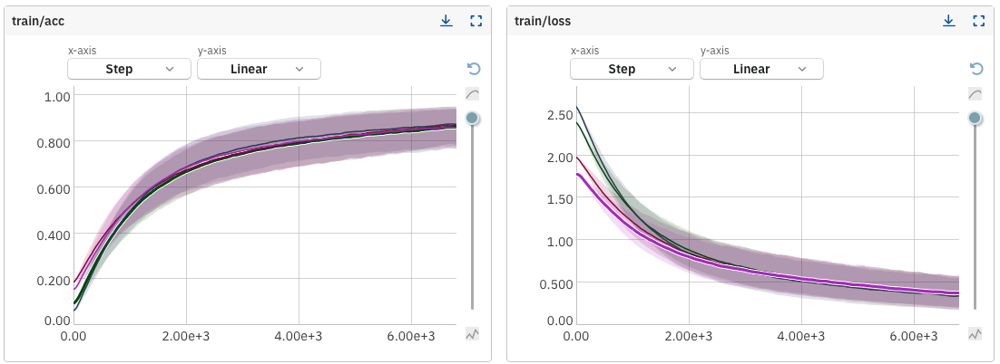

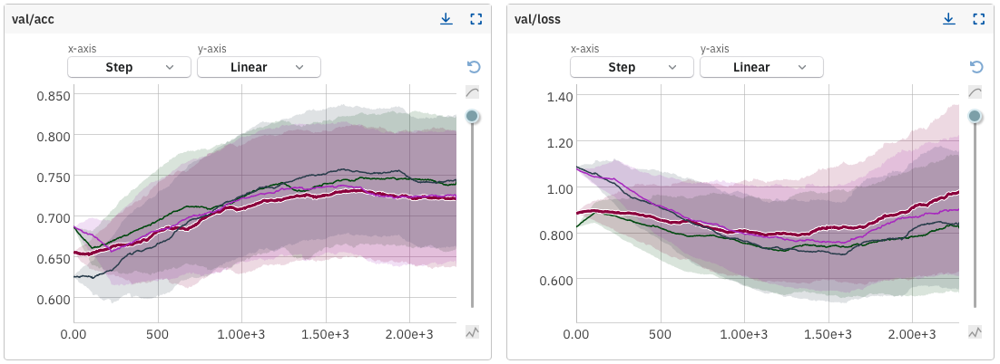

In [ ]:
net = BasicCNN(numLabels=6)
net = net.to(device)
criterionBasic = nn.CrossEntropyLoss()
optimizerBasic = optim.Adam(net.parameters(), lr=0.001)    #net.parameters is the wight of the NN

run = neptune.init_run(
    project="gihazshay/finalProjectML",
    api_token="eyJhcGlfYWRkcmVzcyI6Imh0dHBzOi8vYXBwLm5lcHR1bmUuYWkiLCJhcGlfdXJsIjoiaHR0cHM6Ly9hcHAubmVwdHVuZS5haSIsImFwaV9rZXkiOiI0Mjc3OWFhMi0zYWI3LTRiMjQtYjFiMC0xMGNkYWU4MjBkOTcifQ==",
)

params = {"learning_rate": 0.001, "optimizer": "Adam"}
run["parameters"] = params

trainModel = train(net, trainDataloader, optimizerBasic, 20, criterionBasic)
testAcc, testLoss = test(net, testDataloader, criterionBasic)

run.stop()

[neptune] [info   ] Neptune initialized. Open in the app: https://app.neptune.ai/gihazshay/finalProjectML/e/FIN-383


Epoch 0: 100%|██████████| 453/453 [00:06<00:00, 74.58batch/s]


              precision    recall  f1-score   support

           0       0.52      0.64      0.57      2451
           1       0.46      0.29      0.35      2366
           2       0.55      0.52      0.53      2581
           3       0.52      0.58      0.55      2513
           4       0.71      0.71      0.71      2333
           5       0.49      0.52      0.50      2234

    accuracy                           0.54     14478
   macro avg       0.54      0.54      0.54     14478
weighted avg       0.54      0.54      0.54     14478



Epoch 1: 100%|██████████| 453/453 [00:05<00:00, 75.96batch/s]


              precision    recall  f1-score   support

           0       0.69      0.73      0.71      2451
           1       0.57      0.54      0.55      2366
           2       0.65      0.60      0.62      2581
           3       0.64      0.66      0.65      2513
           4       0.88      0.82      0.85      2333
           5       0.61      0.68      0.64      2234

    accuracy                           0.67     14478
   macro avg       0.67      0.67      0.67     14478
weighted avg       0.67      0.67      0.67     14478



Epoch 2: 100%|██████████| 453/453 [00:04<00:00, 94.52batch/s]


              precision    recall  f1-score   support

           0       0.73      0.76      0.74      2451
           1       0.67      0.65      0.66      2366
           2       0.71      0.65      0.68      2581
           3       0.70      0.73      0.71      2513
           4       0.90      0.86      0.88      2333
           5       0.65      0.71      0.68      2234

    accuracy                           0.73     14478
   macro avg       0.73      0.73      0.73     14478
weighted avg       0.73      0.73      0.73     14478



Epoch 3: 100%|██████████| 453/453 [00:05<00:00, 80.97batch/s]


              precision    recall  f1-score   support

           0       0.76      0.77      0.76      2451
           1       0.71      0.69      0.70      2366
           2       0.72      0.69      0.70      2581
           3       0.72      0.74      0.73      2513
           4       0.92      0.89      0.90      2333
           5       0.70      0.74      0.72      2234

    accuracy                           0.75     14478
   macro avg       0.75      0.75      0.75     14478
weighted avg       0.75      0.75      0.75     14478



Epoch 4: 100%|██████████| 453/453 [00:05<00:00, 83.56batch/s]


              precision    recall  f1-score   support

           0       0.78      0.79      0.79      2451
           1       0.75      0.72      0.73      2366
           2       0.74      0.71      0.73      2581
           3       0.73      0.76      0.75      2513
           4       0.93      0.90      0.91      2333
           5       0.74      0.75      0.74      2234

    accuracy                           0.77     14478
   macro avg       0.78      0.77      0.77     14478
weighted avg       0.77      0.77      0.77     14478



Epoch 5: 100%|██████████| 453/453 [00:04<00:00, 93.55batch/s]


              precision    recall  f1-score   support

           0       0.79      0.81      0.80      2451
           1       0.76      0.74      0.75      2366
           2       0.75      0.73      0.74      2581
           3       0.74      0.77      0.75      2513
           4       0.93      0.92      0.92      2333
           5       0.76      0.77      0.76      2234

    accuracy                           0.79     14478
   macro avg       0.79      0.79      0.79     14478
weighted avg       0.79      0.79      0.79     14478



Epoch 6: 100%|██████████| 453/453 [00:05<00:00, 87.82batch/s]


              precision    recall  f1-score   support

           0       0.81      0.82      0.82      2451
           1       0.77      0.76      0.77      2366
           2       0.76      0.74      0.75      2581
           3       0.75      0.78      0.76      2513
           4       0.93      0.93      0.93      2333
           5       0.77      0.77      0.77      2234

    accuracy                           0.80     14478
   macro avg       0.80      0.80      0.80     14478
weighted avg       0.80      0.80      0.80     14478



Epoch 7: 100%|██████████| 453/453 [00:05<00:00, 81.56batch/s]


              precision    recall  f1-score   support

           0       0.82      0.83      0.82      2451
           1       0.79      0.78      0.78      2366
           2       0.76      0.75      0.76      2581
           3       0.76      0.77      0.77      2513
           4       0.94      0.94      0.94      2333
           5       0.79      0.79      0.79      2234

    accuracy                           0.81     14478
   macro avg       0.81      0.81      0.81     14478
weighted avg       0.81      0.81      0.81     14478



Epoch 8: 100%|██████████| 453/453 [00:04<00:00, 95.72batch/s]


              precision    recall  f1-score   support

           0       0.83      0.83      0.83      2451
           1       0.79      0.78      0.79      2366
           2       0.77      0.76      0.76      2581
           3       0.77      0.78      0.77      2513
           4       0.94      0.94      0.94      2333
           5       0.79      0.80      0.79      2234

    accuracy                           0.81     14478
   macro avg       0.81      0.81      0.81     14478
weighted avg       0.81      0.81      0.81     14478



Epoch 9: 100%|██████████| 453/453 [00:04<00:00, 94.68batch/s]


              precision    recall  f1-score   support

           0       0.84      0.84      0.84      2451
           1       0.81      0.81      0.81      2366
           2       0.77      0.77      0.77      2581
           3       0.79      0.79      0.79      2513
           4       0.93      0.94      0.93      2333
           5       0.80      0.80      0.80      2234

    accuracy                           0.82     14478
   macro avg       0.82      0.82      0.82     14478
weighted avg       0.82      0.82      0.82     14478



Epoch 10: 100%|██████████| 453/453 [00:05<00:00, 77.32batch/s]


              precision    recall  f1-score   support

           0       0.84      0.86      0.85      2451
           1       0.82      0.81      0.81      2366
           2       0.78      0.77      0.78      2581
           3       0.78      0.79      0.79      2513
           4       0.95      0.94      0.94      2333
           5       0.82      0.81      0.81      2234

    accuracy                           0.83     14478
   macro avg       0.83      0.83      0.83     14478
weighted avg       0.83      0.83      0.83     14478



Epoch 11: 100%|██████████| 453/453 [00:04<00:00, 91.86batch/s]


              precision    recall  f1-score   support

           0       0.85      0.86      0.86      2451
           1       0.81      0.81      0.81      2366
           2       0.79      0.78      0.78      2581
           3       0.79      0.79      0.79      2513
           4       0.94      0.94      0.94      2333
           5       0.82      0.82      0.82      2234

    accuracy                           0.83     14478
   macro avg       0.83      0.83      0.83     14478
weighted avg       0.83      0.83      0.83     14478



Epoch 12: 100%|██████████| 453/453 [00:04<00:00, 94.92batch/s]


              precision    recall  f1-score   support

           0       0.87      0.88      0.87      2451
           1       0.83      0.83      0.83      2366
           2       0.80      0.79      0.79      2581
           3       0.80      0.80      0.80      2513
           4       0.95      0.95      0.95      2333
           5       0.84      0.83      0.84      2234

    accuracy                           0.85     14478
   macro avg       0.85      0.85      0.85     14478
weighted avg       0.85      0.85      0.85     14478



Epoch 13: 100%|██████████| 453/453 [00:07<00:00, 63.31batch/s]


              precision    recall  f1-score   support

           0       0.87      0.88      0.87      2451
           1       0.84      0.84      0.84      2366
           2       0.81      0.79      0.80      2581
           3       0.80      0.81      0.80      2513
           4       0.96      0.95      0.95      2333
           5       0.84      0.84      0.84      2234

    accuracy                           0.85     14478
   macro avg       0.85      0.85      0.85     14478
weighted avg       0.85      0.85      0.85     14478



Epoch 14: 100%|██████████| 453/453 [00:07<00:00, 59.05batch/s]


              precision    recall  f1-score   support

           0       0.87      0.88      0.87      2451
           1       0.85      0.85      0.85      2366
           2       0.82      0.80      0.81      2581
           3       0.81      0.82      0.81      2513
           4       0.96      0.95      0.96      2333
           5       0.85      0.85      0.85      2234

    accuracy                           0.86     14478
   macro avg       0.86      0.86      0.86     14478
weighted avg       0.86      0.86      0.86     14478



Epoch 15: 100%|██████████| 453/453 [00:05<00:00, 77.95batch/s]


              precision    recall  f1-score   support

           0       0.89      0.90      0.89      2451
           1       0.86      0.86      0.86      2366
           2       0.83      0.82      0.82      2581
           3       0.82      0.82      0.82      2513
           4       0.96      0.96      0.96      2333
           5       0.87      0.87      0.87      2234

    accuracy                           0.87     14478
   macro avg       0.87      0.87      0.87     14478
weighted avg       0.87      0.87      0.87     14478



Epoch 16: 100%|██████████| 453/453 [00:05<00:00, 78.24batch/s]


              precision    recall  f1-score   support

           0       0.90      0.90      0.90      2451
           1       0.87      0.86      0.86      2366
           2       0.83      0.82      0.83      2581
           3       0.82      0.83      0.83      2513
           4       0.96      0.96      0.96      2333
           5       0.88      0.88      0.88      2234

    accuracy                           0.88     14478
   macro avg       0.88      0.88      0.88     14478
weighted avg       0.88      0.88      0.88     14478



Epoch 17: 100%|██████████| 453/453 [00:04<00:00, 96.45batch/s]


              precision    recall  f1-score   support

           0       0.89      0.91      0.90      2451
           1       0.86      0.86      0.86      2366
           2       0.84      0.83      0.83      2581
           3       0.83      0.84      0.83      2513
           4       0.96      0.96      0.96      2333
           5       0.87      0.87      0.87      2234

    accuracy                           0.88     14478
   macro avg       0.88      0.88      0.88     14478
weighted avg       0.88      0.88      0.88     14478



Epoch 18: 100%|██████████| 453/453 [00:04<00:00, 92.23batch/s]


              precision    recall  f1-score   support

           0       0.90      0.91      0.91      2451
           1       0.86      0.87      0.87      2366
           2       0.84      0.82      0.83      2581
           3       0.84      0.84      0.84      2513
           4       0.96      0.96      0.96      2333
           5       0.89      0.89      0.89      2234

    accuracy                           0.88     14478
   macro avg       0.88      0.88      0.88     14478
weighted avg       0.88      0.88      0.88     14478



Epoch 19: 100%|██████████| 453/453 [00:05<00:00, 76.50batch/s]


              precision    recall  f1-score   support

           0       0.91      0.92      0.91      2451
           1       0.87      0.87      0.87      2366
           2       0.85      0.83      0.84      2581
           3       0.84      0.85      0.85      2513
           4       0.96      0.96      0.96      2333
           5       0.89      0.89      0.89      2234

    accuracy                           0.89     14478
   macro avg       0.89      0.89      0.89     14478
weighted avg       0.89      0.89      0.89     14478



100%|██████████| 80/80 [00:00<00:00, 127.44batch/s]


              precision    recall  f1-score   support

           0       0.71      0.83      0.77       432
           1       0.78      0.69      0.73       418
           2       0.68      0.75      0.71       456
           3       0.70      0.75      0.73       444
           4       0.94      0.88      0.91       412
           5       0.81      0.65      0.72       394

    accuracy                           0.76      2556
   macro avg       0.77      0.76      0.76      2556
weighted avg       0.77      0.76      0.76      2556

[neptune] [info   ] Shutting down background jobs, please wait a moment...
[neptune] [info   ] Done!
[neptune] [info   ] Waiting for the remaining 48 operations to synchronize with Neptune. Do not kill this process.
[neptune] [info   ] All 48 operations synced, thanks for waiting!
[neptune] [info   ] Explore the metadata in the Neptune app: https://app.neptune.ai/gihazshay/finalProjectML/e/FIN-383/metadata


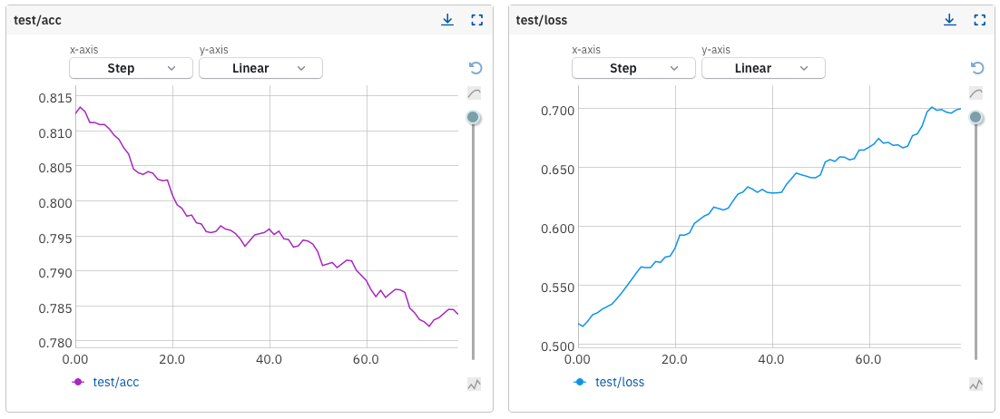

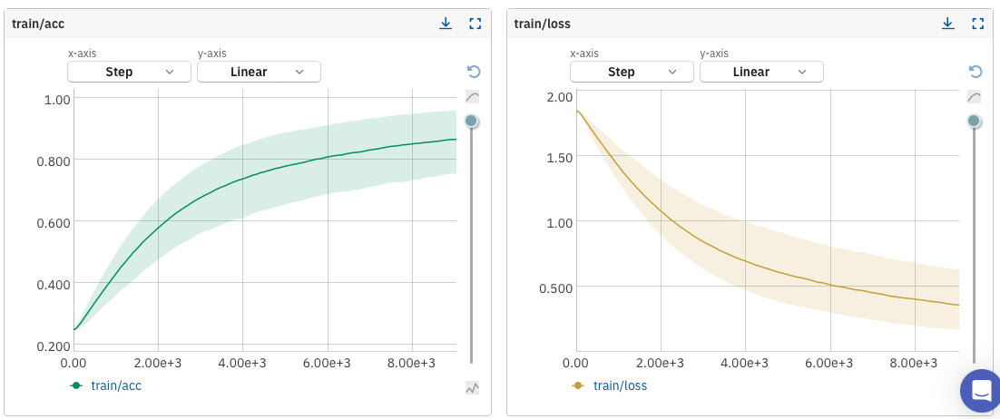

By examining the validation loss graph, it is evident that we need fewer epochs.

It appears that **overfitting** is starting to occur, so we will choose $12$ epochs and see if this is appropriate.

#### $12$ Epochs

In [ ]:
num_folds = 4

# Initialize the KFold object
kf = KFold(n_splits=num_folds, shuffle=True, random_state=40)


foldNum = 0
foldsMatrix = {}


for train_indices, val_indices in kf.split(idxTrain):


    TrainX_Kfold = np.array([dataset[i][0] for i in idxTrain[train_indices]])
    ValX_Kfold = np.array([dataset[j][0] for j in idxTrain[val_indices]])
    TrainY_Kfold = np.array([dataset[i][1] for i in idxTrain[train_indices]])
    ValY_Kfold = np.array([dataset[j][1] for j in idxTrain[val_indices]])
    ValZ_Kfold = np.array([dataset[j][2] for j in idxTrain[val_indices]])      #ID test of the images
    TrainZ_Kfold = np.array([dataset[i][2] for i in idxTrain[train_indices]])  #ID train of the images

    tensorTrainX_Kfold = torch.tensor(TrainX_Kfold, dtype=torch.float32).to(device)
    tensorValX_Kfold = torch.tensor(ValX_Kfold, dtype=torch.float32).to(device)
    tensorTrainY_Kfold = torch.tensor(TrainY_Kfold, dtype=torch.long).to(device)
    tensorValY_Kfold = torch.tensor(ValY_Kfold, dtype=torch.long).to(device)
    tensorTrainZ_Kfold = torch.tensor(TrainZ_Kfold, dtype=torch.long).to(device)
    tensorValZ_Kfold = torch.tensor(ValZ_Kfold, dtype=torch.long).to(device)

    # Create a TensorDataset object from the data
    tensorDatasetTrain_Kfold = TensorDataset(tensorTrainX_Kfold, tensorTrainY_Kfold, tensorTrainZ_Kfold)
    tensorDatasetVal_Kfold = TensorDataset(tensorValX_Kfold, tensorValY_Kfold, tensorValZ_Kfold)

    # Create a DataLoader object with batch size 32
    trainDataloaderKfold = DataLoader(tensorDatasetTrain_Kfold, batch_size=32, shuffle=True)
    valDataloaderKfold = DataLoader(tensorDatasetVal_Kfold, batch_size=32, shuffle=True)

    print(f"------fold------:{foldNum}")

    run = neptune.init_run(
    project="gihazshay/finalProjectML",
    api_token="eyJhcGlfYWRkcmVzcyI6Imh0dHBzOi8vYXBwLm5lcHR1bmUuYWkiLCJhcGlfdXJsIjoiaHR0cHM6Ly9hcHAubmVwdHVuZS5haSIsImFwaV9rZXkiOiI0Mjc3OWFhMi0zYWI3LTRiMjQtYjFiMC0xMGNkYWU4MjBkOTcifQ==",
    )

    params = {"learning_rate": 0.001, "optimizer": "Adam"}
    run["parameters"] = params

    net = BasicCNN(numLabels=6)
    net = net.to(device)
    criterionBasic = nn.CrossEntropyLoss()
    optimizerBasic = optim.Adam(net.parameters(), lr=0.001)    #net.parameters is the wight of the NN
    trainAcc, trainLoss, valAcc, valLoss = train(net, trainDataloaderKfold, optimizerBasic, 12, criterionBasic, valDataloaderKfold)

    run.stop()
    foldsMatrix[f"fold {foldNum}"] = {'train_acc':trainAcc, 'train_loss':trainLoss,
                                      'val_acc':valAcc, 'val_loss':valLoss}
    foldNum += 1


------fold------:0
[neptune] [info   ] Neptune initialized. Open in the app: https://app.neptune.ai/gihazshay/finalProjectML/e/FIN-384


Epoch 0: 100%|██████████| 340/340 [00:03<00:00, 106.88batch/s]


              precision    recall  f1-score   support

           0       0.60      0.64      0.62      1822
           1       0.42      0.25      0.31      1766
           2       0.54      0.58      0.56      1964
           3       0.53      0.63      0.57      1871
           4       0.74      0.80      0.77      1745
           5       0.48      0.47      0.48      1690

    accuracy                           0.56     10858
   macro avg       0.55      0.56      0.55     10858
weighted avg       0.55      0.56      0.55     10858

Validtion part------EPOCH------:0


100%|██████████| 114/114 [00:00<00:00, 303.73batch/s]


              precision    recall  f1-score   support

           0       0.69      0.75      0.72       629
           1       0.51      0.38      0.43       600
           2       0.57      0.67      0.62       617
           3       0.61      0.68      0.64       642
           4       0.88      0.84      0.86       588
           5       0.62      0.57      0.59       544

    accuracy                           0.65      3620
   macro avg       0.65      0.65      0.64      3620
weighted avg       0.65      0.65      0.64      3620



Epoch 1: 100%|██████████| 340/340 [00:02<00:00, 131.43batch/s]


              precision    recall  f1-score   support

           0       0.70      0.74      0.72      1822
           1       0.57      0.50      0.53      1766
           2       0.64      0.64      0.64      1964
           3       0.64      0.71      0.67      1871
           4       0.87      0.85      0.86      1745
           5       0.65      0.62      0.63      1690

    accuracy                           0.68     10858
   macro avg       0.68      0.68      0.68     10858
weighted avg       0.68      0.68      0.68     10858

Validtion part------EPOCH------:1


100%|██████████| 114/114 [00:00<00:00, 314.28batch/s]


              precision    recall  f1-score   support

           0       0.78      0.65      0.71       629
           1       0.64      0.52      0.58       600
           2       0.71      0.58      0.64       617
           3       0.60      0.81      0.69       642
           4       0.95      0.79      0.86       588
           5       0.58      0.81      0.68       544

    accuracy                           0.69      3620
   macro avg       0.71      0.69      0.69      3620
weighted avg       0.71      0.69      0.69      3620



Epoch 2: 100%|██████████| 340/340 [00:02<00:00, 130.58batch/s]


              precision    recall  f1-score   support

           0       0.74      0.76      0.75      1822
           1       0.65      0.60      0.63      1766
           2       0.67      0.65      0.66      1964
           3       0.67      0.74      0.70      1871
           4       0.91      0.88      0.90      1745
           5       0.69      0.69      0.69      1690

    accuracy                           0.72     10858
   macro avg       0.72      0.72      0.72     10858
weighted avg       0.72      0.72      0.72     10858

Validtion part------EPOCH------:2


100%|██████████| 114/114 [00:00<00:00, 313.36batch/s]


              precision    recall  f1-score   support

           0       0.80      0.70      0.75       629
           1       0.60      0.64      0.62       600
           2       0.64      0.68      0.66       617
           3       0.68      0.69      0.69       642
           4       0.92      0.90      0.91       588
           5       0.70      0.70      0.70       544

    accuracy                           0.72      3620
   macro avg       0.72      0.72      0.72      3620
weighted avg       0.72      0.72      0.72      3620



Epoch 3: 100%|██████████| 340/340 [00:02<00:00, 114.34batch/s]


              precision    recall  f1-score   support

           0       0.77      0.78      0.77      1822
           1       0.67      0.67      0.67      1766
           2       0.71      0.68      0.69      1964
           3       0.70      0.74      0.72      1871
           4       0.91      0.90      0.91      1745
           5       0.72      0.72      0.72      1690

    accuracy                           0.75     10858
   macro avg       0.75      0.75      0.75     10858
weighted avg       0.75      0.75      0.75     10858

Validtion part------EPOCH------:3


100%|██████████| 114/114 [00:00<00:00, 258.84batch/s]


              precision    recall  f1-score   support

           0       0.70      0.84      0.76       629
           1       0.78      0.55      0.64       600
           2       0.70      0.69      0.70       617
           3       0.69      0.81      0.74       642
           4       0.95      0.87      0.91       588
           5       0.71      0.70      0.70       544

    accuracy                           0.74      3620
   macro avg       0.75      0.74      0.74      3620
weighted avg       0.75      0.74      0.74      3620



Epoch 4: 100%|██████████| 340/340 [00:03<00:00, 106.42batch/s]


              precision    recall  f1-score   support

           0       0.78      0.80      0.79      1822
           1       0.68      0.68      0.68      1766
           2       0.72      0.69      0.71      1964
           3       0.72      0.75      0.73      1871
           4       0.92      0.91      0.92      1745
           5       0.75      0.75      0.75      1690

    accuracy                           0.76     10858
   macro avg       0.76      0.76      0.76     10858
weighted avg       0.76      0.76      0.76     10858

Validtion part------EPOCH------:4


100%|██████████| 114/114 [00:00<00:00, 240.81batch/s]


              precision    recall  f1-score   support

           0       0.83      0.65      0.73       629
           1       0.76      0.49      0.60       600
           2       0.68      0.63      0.66       617
           3       0.60      0.85      0.70       642
           4       0.94      0.89      0.91       588
           5       0.64      0.82      0.71       544

    accuracy                           0.72      3620
   macro avg       0.74      0.72      0.72      3620
weighted avg       0.74      0.72      0.72      3620



Epoch 5: 100%|██████████| 340/340 [00:02<00:00, 125.05batch/s]


              precision    recall  f1-score   support

           0       0.78      0.80      0.79      1822
           1       0.73      0.72      0.73      1766
           2       0.75      0.73      0.74      1964
           3       0.73      0.76      0.75      1871
           4       0.92      0.90      0.91      1745
           5       0.76      0.76      0.76      1690

    accuracy                           0.78     10858
   macro avg       0.78      0.78      0.78     10858
weighted avg       0.78      0.78      0.78     10858

Validtion part------EPOCH------:5


100%|██████████| 114/114 [00:00<00:00, 306.29batch/s]


              precision    recall  f1-score   support

           0       0.81      0.74      0.77       629
           1       0.59      0.80      0.68       600
           2       0.76      0.63      0.68       617
           3       0.73      0.63      0.68       642
           4       0.87      0.94      0.90       588
           5       0.73      0.72      0.73       544

    accuracy                           0.74      3620
   macro avg       0.75      0.74      0.74      3620
weighted avg       0.75      0.74      0.74      3620



Epoch 6: 100%|██████████| 340/340 [00:02<00:00, 127.32batch/s]


              precision    recall  f1-score   support

           0       0.80      0.81      0.80      1822
           1       0.73      0.73      0.73      1766
           2       0.75      0.73      0.74      1964
           3       0.73      0.76      0.74      1871
           4       0.93      0.92      0.93      1745
           5       0.77      0.77      0.77      1690

    accuracy                           0.78     10858
   macro avg       0.79      0.79      0.79     10858
weighted avg       0.78      0.78      0.78     10858

Validtion part------EPOCH------:6


100%|██████████| 114/114 [00:00<00:00, 302.61batch/s]


              precision    recall  f1-score   support

           0       0.80      0.77      0.78       629
           1       0.57      0.80      0.67       600
           2       0.73      0.54      0.62       617
           3       0.66      0.70      0.68       642
           4       0.94      0.89      0.91       588
           5       0.77      0.66      0.71       544

    accuracy                           0.73      3620
   macro avg       0.74      0.73      0.73      3620
weighted avg       0.74      0.73      0.73      3620



Epoch 7: 100%|██████████| 340/340 [00:02<00:00, 128.62batch/s]


              precision    recall  f1-score   support

           0       0.81      0.82      0.82      1822
           1       0.74      0.76      0.75      1766
           2       0.77      0.74      0.76      1964
           3       0.75      0.77      0.76      1871
           4       0.94      0.93      0.94      1745
           5       0.79      0.78      0.78      1690

    accuracy                           0.80     10858
   macro avg       0.80      0.80      0.80     10858
weighted avg       0.80      0.80      0.80     10858

Validtion part------EPOCH------:7


100%|██████████| 114/114 [00:00<00:00, 308.22batch/s]


              precision    recall  f1-score   support

           0       0.80      0.76      0.78       629
           1       0.81      0.59      0.69       600
           2       0.65      0.75      0.70       617
           3       0.72      0.74      0.73       642
           4       0.89      0.93      0.91       588
           5       0.69      0.76      0.72       544

    accuracy                           0.76      3620
   macro avg       0.76      0.76      0.76      3620
weighted avg       0.76      0.76      0.76      3620



Epoch 8: 100%|██████████| 340/340 [00:02<00:00, 118.11batch/s]


              precision    recall  f1-score   support

           0       0.81      0.84      0.82      1822
           1       0.75      0.77      0.76      1766
           2       0.77      0.74      0.75      1964
           3       0.75      0.77      0.76      1871
           4       0.94      0.92      0.93      1745
           5       0.80      0.79      0.79      1690

    accuracy                           0.80     10858
   macro avg       0.80      0.80      0.80     10858
weighted avg       0.80      0.80      0.80     10858

Validtion part------EPOCH------:8


100%|██████████| 114/114 [00:00<00:00, 241.95batch/s]


              precision    recall  f1-score   support

           0       0.83      0.68      0.75       629
           1       0.66      0.71      0.69       600
           2       0.71      0.67      0.69       617
           3       0.72      0.67      0.70       642
           4       0.95      0.89      0.92       588
           5       0.63      0.85      0.72       544

    accuracy                           0.74      3620
   macro avg       0.75      0.74      0.74      3620
weighted avg       0.75      0.74      0.74      3620



Epoch 9: 100%|██████████| 340/340 [00:03<00:00, 105.93batch/s]


              precision    recall  f1-score   support

           0       0.84      0.85      0.85      1822
           1       0.78      0.78      0.78      1766
           2       0.78      0.76      0.77      1964
           3       0.77      0.79      0.78      1871
           4       0.95      0.94      0.95      1745
           5       0.81      0.81      0.81      1690

    accuracy                           0.82     10858
   macro avg       0.82      0.82      0.82     10858
weighted avg       0.82      0.82      0.82     10858

Validtion part------EPOCH------:9


100%|██████████| 114/114 [00:00<00:00, 219.39batch/s]


              precision    recall  f1-score   support

           0       0.79      0.77      0.78       629
           1       0.72      0.72      0.72       600
           2       0.78      0.63      0.70       617
           3       0.67      0.81      0.73       642
           4       0.89      0.95      0.92       588
           5       0.73      0.69      0.71       544

    accuracy                           0.76      3620
   macro avg       0.76      0.76      0.76      3620
weighted avg       0.76      0.76      0.76      3620



Epoch 10: 100%|██████████| 340/340 [00:02<00:00, 124.36batch/s]


              precision    recall  f1-score   support

           0       0.84      0.85      0.84      1822
           1       0.76      0.78      0.77      1766
           2       0.78      0.75      0.77      1964
           3       0.76      0.78      0.77      1871
           4       0.95      0.94      0.94      1745
           5       0.82      0.81      0.82      1690

    accuracy                           0.82     10858
   macro avg       0.82      0.82      0.82     10858
weighted avg       0.82      0.82      0.82     10858

Validtion part------EPOCH------:10


100%|██████████| 114/114 [00:00<00:00, 320.59batch/s]


              precision    recall  f1-score   support

           0       0.73      0.79      0.76       629
           1       0.59      0.83      0.69       600
           2       0.80      0.52      0.63       617
           3       0.73      0.65      0.69       642
           4       0.96      0.84      0.90       588
           5       0.68      0.78      0.73       544

    accuracy                           0.73      3620
   macro avg       0.75      0.74      0.73      3620
weighted avg       0.75      0.73      0.73      3620



Epoch 11: 100%|██████████| 340/340 [00:02<00:00, 129.41batch/s]


              precision    recall  f1-score   support

           0       0.86      0.86      0.86      1822
           1       0.79      0.79      0.79      1766
           2       0.79      0.77      0.78      1964
           3       0.76      0.79      0.77      1871
           4       0.95      0.94      0.95      1745
           5       0.83      0.83      0.83      1690

    accuracy                           0.83     10858
   macro avg       0.83      0.83      0.83     10858
weighted avg       0.83      0.83      0.83     10858

Validtion part------EPOCH------:11


100%|██████████| 114/114 [00:00<00:00, 309.36batch/s]


              precision    recall  f1-score   support

           0       0.78      0.78      0.78       629
           1       0.75      0.68      0.72       600
           2       0.73      0.71      0.72       617
           3       0.65      0.80      0.72       642
           4       0.92      0.91      0.91       588
           5       0.79      0.66      0.72       544

    accuracy                           0.76      3620
   macro avg       0.77      0.76      0.76      3620
weighted avg       0.76      0.76      0.76      3620

[neptune] [info   ] Shutting down background jobs, please wait a moment...
[neptune] [info   ] Done!
[neptune] [info   ] Waiting for the remaining 47 operations to synchronize with Neptune. Do not kill this process.
[neptune] [info   ] All 47 operations synced, thanks for waiting!
[neptune] [info   ] Explore the metadata in the Neptune app: https://app.neptune.ai/gihazshay/finalProjectML/e/FIN-384/metadata
------fold------:1
[neptune] [info   ] Neptune 

Epoch 0: 100%|██████████| 340/340 [00:02<00:00, 122.81batch/s]


              precision    recall  f1-score   support

           0       0.48      0.60      0.53      1850
           1       0.45      0.25      0.32      1800
           2       0.53      0.51      0.52      1924
           3       0.49      0.55      0.52      1908
           4       0.66      0.73      0.69      1732
           5       0.39      0.40      0.40      1644

    accuracy                           0.51     10858
   macro avg       0.50      0.50      0.50     10858
weighted avg       0.50      0.51      0.50     10858

Validtion part------EPOCH------:0


100%|██████████| 114/114 [00:00<00:00, 315.10batch/s]


              precision    recall  f1-score   support

           0       0.55      0.74      0.63       601
           1       0.61      0.41      0.49       566
           2       0.69      0.61      0.64       657
           3       0.60      0.69      0.65       605
           4       0.69      0.89      0.78       601
           5       0.55      0.37      0.44       590

    accuracy                           0.62      3620
   macro avg       0.62      0.62      0.61      3620
weighted avg       0.62      0.62      0.61      3620



Epoch 1: 100%|██████████| 340/340 [00:02<00:00, 119.37batch/s]


              precision    recall  f1-score   support

           0       0.67      0.72      0.69      1850
           1       0.56      0.50      0.53      1800
           2       0.63      0.61      0.62      1924
           3       0.63      0.66      0.65      1908
           4       0.85      0.82      0.83      1732
           5       0.55      0.59      0.57      1644

    accuracy                           0.65     10858
   macro avg       0.65      0.65      0.65     10858
weighted avg       0.65      0.65      0.65     10858

Validtion part------EPOCH------:1


100%|██████████| 114/114 [00:00<00:00, 252.24batch/s]


              precision    recall  f1-score   support

           0       0.72      0.71      0.71       601
           1       0.50      0.72      0.59       566
           2       0.72      0.61      0.66       657
           3       0.64      0.64      0.64       605
           4       0.93      0.79      0.85       601
           5       0.64      0.59      0.61       590

    accuracy                           0.67      3620
   macro avg       0.69      0.67      0.68      3620
weighted avg       0.69      0.67      0.68      3620



Epoch 2: 100%|██████████| 340/340 [00:03<00:00, 102.86batch/s]


              precision    recall  f1-score   support

           0       0.71      0.75      0.73      1850
           1       0.61      0.59      0.60      1800
           2       0.68      0.64      0.66      1924
           3       0.68      0.70      0.69      1908
           4       0.88      0.85      0.87      1732
           5       0.63      0.66      0.64      1644

    accuracy                           0.70     10858
   macro avg       0.70      0.70      0.70     10858
weighted avg       0.70      0.70      0.70     10858

Validtion part------EPOCH------:2


100%|██████████| 114/114 [00:00<00:00, 230.67batch/s]


              precision    recall  f1-score   support

           0       0.69      0.77      0.73       601
           1       0.62      0.67      0.64       566
           2       0.64      0.78      0.70       657
           3       0.77      0.62      0.69       605
           4       0.98      0.74      0.84       601
           5       0.68      0.69      0.68       590

    accuracy                           0.71      3620
   macro avg       0.73      0.71      0.71      3620
weighted avg       0.73      0.71      0.72      3620



Epoch 3: 100%|██████████| 340/340 [00:02<00:00, 116.22batch/s]


              precision    recall  f1-score   support

           0       0.74      0.78      0.76      1850
           1       0.66      0.66      0.66      1800
           2       0.71      0.67      0.69      1924
           3       0.70      0.71      0.71      1908
           4       0.89      0.86      0.88      1732
           5       0.68      0.69      0.68      1644

    accuracy                           0.73     10858
   macro avg       0.73      0.73      0.73     10858
weighted avg       0.73      0.73      0.73     10858

Validtion part------EPOCH------:3


100%|██████████| 114/114 [00:00<00:00, 306.48batch/s]


              precision    recall  f1-score   support

           0       0.82      0.63      0.71       601
           1       0.74      0.57      0.64       566
           2       0.56      0.86      0.68       657
           3       0.78      0.53      0.63       605
           4       0.88      0.89      0.88       601
           5       0.65      0.78      0.71       590

    accuracy                           0.71      3620
   macro avg       0.74      0.71      0.71      3620
weighted avg       0.74      0.71      0.71      3620



Epoch 4: 100%|██████████| 340/340 [00:02<00:00, 129.18batch/s]


              precision    recall  f1-score   support

           0       0.77      0.80      0.79      1850
           1       0.68      0.69      0.69      1800
           2       0.72      0.68      0.70      1924
           3       0.72      0.72      0.72      1908
           4       0.91      0.90      0.90      1732
           5       0.70      0.72      0.71      1644

    accuracy                           0.75     10858
   macro avg       0.75      0.75      0.75     10858
weighted avg       0.75      0.75      0.75     10858

Validtion part------EPOCH------:4


100%|██████████| 114/114 [00:00<00:00, 310.85batch/s]


              precision    recall  f1-score   support

           0       0.75      0.73      0.74       601
           1       0.77      0.65      0.70       566
           2       0.70      0.75      0.73       657
           3       0.72      0.75      0.73       605
           4       0.79      0.94      0.86       601
           5       0.76      0.65      0.70       590

    accuracy                           0.75      3620
   macro avg       0.75      0.75      0.74      3620
weighted avg       0.75      0.75      0.74      3620



Epoch 5: 100%|██████████| 340/340 [00:02<00:00, 127.34batch/s]


              precision    recall  f1-score   support

           0       0.79      0.80      0.79      1850
           1       0.72      0.72      0.72      1800
           2       0.75      0.71      0.73      1924
           3       0.73      0.73      0.73      1908
           4       0.91      0.90      0.90      1732
           5       0.72      0.76      0.74      1644

    accuracy                           0.77     10858
   macro avg       0.77      0.77      0.77     10858
weighted avg       0.77      0.77      0.77     10858

Validtion part------EPOCH------:5


100%|██████████| 114/114 [00:00<00:00, 309.02batch/s]


              precision    recall  f1-score   support

           0       0.71      0.75      0.73       601
           1       0.73      0.69      0.71       566
           2       0.72      0.76      0.74       657
           3       0.66      0.78      0.71       605
           4       0.98      0.72      0.83       601
           5       0.69      0.71      0.70       590

    accuracy                           0.74      3620
   macro avg       0.75      0.74      0.74      3620
weighted avg       0.75      0.74      0.74      3620



Epoch 6: 100%|██████████| 340/340 [00:02<00:00, 124.14batch/s]


              precision    recall  f1-score   support

           0       0.79      0.81      0.80      1850
           1       0.74      0.75      0.75      1800
           2       0.76      0.73      0.74      1924
           3       0.75      0.75      0.75      1908
           4       0.92      0.90      0.91      1732
           5       0.74      0.76      0.75      1644

    accuracy                           0.78     10858
   macro avg       0.78      0.78      0.78     10858
weighted avg       0.78      0.78      0.78     10858

Validtion part------EPOCH------:6


100%|██████████| 114/114 [00:00<00:00, 248.46batch/s]


              precision    recall  f1-score   support

           0       0.73      0.81      0.77       601
           1       0.81      0.64      0.71       566
           2       0.70      0.79      0.74       657
           3       0.76      0.69      0.72       605
           4       0.95      0.87      0.91       601
           5       0.68      0.77      0.73       590

    accuracy                           0.76      3620
   macro avg       0.77      0.76      0.76      3620
weighted avg       0.77      0.76      0.76      3620



Epoch 7: 100%|██████████| 340/340 [00:03<00:00, 110.58batch/s]


              precision    recall  f1-score   support

           0       0.81      0.82      0.81      1850
           1       0.75      0.76      0.76      1800
           2       0.76      0.73      0.74      1924
           3       0.76      0.75      0.76      1908
           4       0.92      0.92      0.92      1732
           5       0.76      0.77      0.77      1644

    accuracy                           0.79     10858
   macro avg       0.79      0.79      0.79     10858
weighted avg       0.79      0.79      0.79     10858

Validtion part------EPOCH------:7


100%|██████████| 114/114 [00:00<00:00, 244.83batch/s]


              precision    recall  f1-score   support

           0       0.68      0.77      0.72       601
           1       0.59      0.88      0.71       566
           2       0.81      0.57      0.67       657
           3       0.70      0.70      0.70       605
           4       0.99      0.64      0.78       601
           5       0.69      0.75      0.72       590

    accuracy                           0.71      3620
   macro avg       0.74      0.72      0.72      3620
weighted avg       0.75      0.71      0.72      3620



Epoch 8: 100%|██████████| 340/340 [00:03<00:00, 105.16batch/s]


              precision    recall  f1-score   support

           0       0.81      0.83      0.82      1850
           1       0.75      0.76      0.76      1800
           2       0.78      0.74      0.76      1924
           3       0.75      0.76      0.75      1908
           4       0.92      0.91      0.91      1732
           5       0.76      0.77      0.77      1644

    accuracy                           0.79     10858
   macro avg       0.80      0.80      0.80     10858
weighted avg       0.79      0.79      0.79     10858

Validtion part------EPOCH------:8


100%|██████████| 114/114 [00:00<00:00, 292.70batch/s]


              precision    recall  f1-score   support

           0       0.76      0.77      0.76       601
           1       0.88      0.50      0.64       566
           2       0.65      0.83      0.73       657
           3       0.71      0.72      0.72       605
           4       0.90      0.92      0.91       601
           5       0.71      0.75      0.73       590

    accuracy                           0.75      3620
   macro avg       0.77      0.75      0.75      3620
weighted avg       0.77      0.75      0.75      3620



Epoch 9: 100%|██████████| 340/340 [00:02<00:00, 127.98batch/s]


              precision    recall  f1-score   support

           0       0.84      0.84      0.84      1850
           1       0.76      0.78      0.77      1800
           2       0.78      0.75      0.77      1924
           3       0.77      0.77      0.77      1908
           4       0.92      0.92      0.92      1732
           5       0.79      0.81      0.80      1644

    accuracy                           0.81     10858
   macro avg       0.81      0.81      0.81     10858
weighted avg       0.81      0.81      0.81     10858

Validtion part------EPOCH------:9


100%|██████████| 114/114 [00:00<00:00, 313.42batch/s]


              precision    recall  f1-score   support

           0       0.75      0.82      0.79       601
           1       0.74      0.77      0.76       566
           2       0.83      0.64      0.72       657
           3       0.66      0.81      0.73       605
           4       0.96      0.86      0.91       601
           5       0.74      0.74      0.74       590

    accuracy                           0.77      3620
   macro avg       0.78      0.77      0.77      3620
weighted avg       0.78      0.77      0.77      3620



Epoch 10: 100%|██████████| 340/340 [00:02<00:00, 129.47batch/s]


              precision    recall  f1-score   support

           0       0.84      0.85      0.84      1850
           1       0.78      0.80      0.79      1800
           2       0.79      0.76      0.77      1924
           3       0.77      0.77      0.77      1908
           4       0.92      0.92      0.92      1732
           5       0.79      0.80      0.80      1644

    accuracy                           0.82     10858
   macro avg       0.82      0.82      0.82     10858
weighted avg       0.82      0.82      0.82     10858

Validtion part------EPOCH------:10


100%|██████████| 114/114 [00:00<00:00, 311.13batch/s]


              precision    recall  f1-score   support

           0       0.74      0.82      0.78       601
           1       0.70      0.75      0.72       566
           2       0.74      0.74      0.74       657
           3       0.69      0.74      0.71       605
           4       0.96      0.86      0.90       601
           5       0.78      0.66      0.71       590

    accuracy                           0.76      3620
   macro avg       0.77      0.76      0.76      3620
weighted avg       0.77      0.76      0.76      3620



Epoch 11: 100%|██████████| 340/340 [00:02<00:00, 127.08batch/s]


              precision    recall  f1-score   support

           0       0.84      0.85      0.85      1850
           1       0.79      0.80      0.79      1800
           2       0.79      0.77      0.78      1924
           3       0.78      0.77      0.78      1908
           4       0.93      0.93      0.93      1732
           5       0.79      0.81      0.80      1644

    accuracy                           0.82     10858
   macro avg       0.82      0.82      0.82     10858
weighted avg       0.82      0.82      0.82     10858

Validtion part------EPOCH------:11


100%|██████████| 114/114 [00:00<00:00, 301.12batch/s]


              precision    recall  f1-score   support

           0       0.78      0.77      0.77       601
           1       0.73      0.77      0.75       566
           2       0.80      0.66      0.72       657
           3       0.71      0.71      0.71       605
           4       0.86      0.94      0.90       601
           5       0.71      0.75      0.73       590

    accuracy                           0.76      3620
   macro avg       0.76      0.77      0.76      3620
weighted avg       0.76      0.76      0.76      3620

[neptune] [info   ] Shutting down background jobs, please wait a moment...
[neptune] [info   ] Done!
[neptune] [info   ] Waiting for the remaining 46 operations to synchronize with Neptune. Do not kill this process.
[neptune] [info   ] All 46 operations synced, thanks for waiting!
[neptune] [info   ] Explore the metadata in the Neptune app: https://app.neptune.ai/gihazshay/finalProjectML/e/FIN-385/metadata
------fold------:2
[neptune] [info   ] Neptune 

Epoch 0: 100%|██████████| 340/340 [00:03<00:00, 101.84batch/s]


              precision    recall  f1-score   support

           0       0.57      0.55      0.56      1855
           1       0.39      0.18      0.25      1767
           2       0.46      0.57      0.51      1933
           3       0.51      0.57      0.54      1863
           4       0.69      0.71      0.70      1737
           5       0.40      0.48      0.44      1704

    accuracy                           0.51     10859
   macro avg       0.51      0.51      0.50     10859
weighted avg       0.51      0.51      0.50     10859

Validtion part------EPOCH------:0


100%|██████████| 114/114 [00:00<00:00, 229.07batch/s]


              precision    recall  f1-score   support

           0       0.59      0.82      0.69       596
           1       0.76      0.12      0.21       599
           2       0.57      0.67      0.62       648
           3       0.60      0.74      0.67       650
           4       0.83      0.83      0.83       596
           5       0.53      0.54      0.54       530

    accuracy                           0.63      3619
   macro avg       0.65      0.62      0.59      3619
weighted avg       0.65      0.63      0.59      3619



Epoch 1: 100%|██████████| 340/340 [00:02<00:00, 123.12batch/s]


              precision    recall  f1-score   support

           0       0.70      0.73      0.71      1855
           1       0.52      0.35      0.42      1767
           2       0.59      0.65      0.62      1933
           3       0.61      0.69      0.65      1863
           4       0.84      0.81      0.83      1737
           5       0.62      0.67      0.64      1704

    accuracy                           0.65     10859
   macro avg       0.65      0.65      0.64     10859
weighted avg       0.64      0.65      0.64     10859

Validtion part------EPOCH------:1


100%|██████████| 114/114 [00:00<00:00, 319.91batch/s]


              precision    recall  f1-score   support

           0       0.70      0.65      0.67       596
           1       0.54      0.50      0.52       599
           2       0.66      0.64      0.65       648
           3       0.69      0.66      0.67       650
           4       0.94      0.79      0.86       596
           5       0.56      0.81      0.66       530

    accuracy                           0.67      3619
   macro avg       0.68      0.67      0.67      3619
weighted avg       0.68      0.67      0.67      3619



Epoch 2: 100%|██████████| 340/340 [00:02<00:00, 125.91batch/s]


              precision    recall  f1-score   support

           0       0.72      0.74      0.73      1855
           1       0.56      0.47      0.51      1767
           2       0.63      0.65      0.64      1933
           3       0.65      0.71      0.68      1863
           4       0.87      0.85      0.86      1737
           5       0.67      0.69      0.68      1704

    accuracy                           0.68     10859
   macro avg       0.68      0.68      0.68     10859
weighted avg       0.68      0.68      0.68     10859

Validtion part------EPOCH------:2


100%|██████████| 114/114 [00:00<00:00, 313.76batch/s]


              precision    recall  f1-score   support

           0       0.76      0.59      0.66       596
           1       0.68      0.38      0.49       599
           2       0.74      0.55      0.63       648
           3       0.58      0.87      0.69       650
           4       0.95      0.82      0.88       596
           5       0.54      0.85      0.66       530

    accuracy                           0.68      3619
   macro avg       0.71      0.68      0.67      3619
weighted avg       0.71      0.68      0.67      3619



Epoch 3: 100%|██████████| 340/340 [00:02<00:00, 127.00batch/s]


              precision    recall  f1-score   support

           0       0.75      0.76      0.75      1855
           1       0.63      0.60      0.62      1767
           2       0.67      0.65      0.66      1933
           3       0.69      0.73      0.71      1863
           4       0.89      0.87      0.88      1737
           5       0.70      0.72      0.71      1704

    accuracy                           0.72     10859
   macro avg       0.72      0.72      0.72     10859
weighted avg       0.72      0.72      0.72     10859

Validtion part------EPOCH------:3


100%|██████████| 114/114 [00:00<00:00, 310.91batch/s]


              precision    recall  f1-score   support

           0       0.75      0.70      0.72       596
           1       0.72      0.57      0.64       599
           2       0.66      0.72      0.69       648
           3       0.70      0.77      0.74       650
           4       0.94      0.85      0.90       596
           5       0.65      0.76      0.70       530

    accuracy                           0.73      3619
   macro avg       0.74      0.73      0.73      3619
weighted avg       0.74      0.73      0.73      3619



Epoch 4: 100%|██████████| 340/340 [00:02<00:00, 119.08batch/s]


              precision    recall  f1-score   support

           0       0.77      0.77      0.77      1855
           1       0.69      0.67      0.68      1767
           2       0.70      0.68      0.69      1933
           3       0.71      0.74      0.73      1863
           4       0.91      0.88      0.90      1737
           5       0.72      0.75      0.74      1704

    accuracy                           0.75     10859
   macro avg       0.75      0.75      0.75     10859
weighted avg       0.75      0.75      0.75     10859

Validtion part------EPOCH------:4


100%|██████████| 114/114 [00:00<00:00, 253.26batch/s]


              precision    recall  f1-score   support

           0       0.76      0.71      0.74       596
           1       0.76      0.55      0.64       599
           2       0.58      0.84      0.69       648
           3       0.80      0.63      0.70       650
           4       0.95      0.85      0.90       596
           5       0.65      0.79      0.71       530

    accuracy                           0.73      3619
   macro avg       0.75      0.73      0.73      3619
weighted avg       0.75      0.73      0.73      3619



Epoch 5: 100%|██████████| 340/340 [00:03<00:00, 110.05batch/s]


              precision    recall  f1-score   support

           0       0.78      0.79      0.79      1855
           1       0.71      0.73      0.72      1767
           2       0.72      0.69      0.71      1933
           3       0.73      0.74      0.74      1863
           4       0.92      0.89      0.91      1737
           5       0.74      0.76      0.75      1704

    accuracy                           0.77     10859
   macro avg       0.77      0.77      0.77     10859
weighted avg       0.77      0.77      0.77     10859

Validtion part------EPOCH------:5


100%|██████████| 114/114 [00:00<00:00, 229.87batch/s]


              precision    recall  f1-score   support

           0       0.69      0.62      0.65       596
           1       0.80      0.64      0.71       599
           2       0.64      0.78      0.70       648
           3       0.77      0.71      0.74       650
           4       0.64      0.98      0.78       596
           5       0.84      0.48      0.61       530

    accuracy                           0.71      3619
   macro avg       0.73      0.70      0.70      3619
weighted avg       0.73      0.71      0.70      3619



Epoch 6: 100%|██████████| 340/340 [00:03<00:00, 107.05batch/s]


              precision    recall  f1-score   support

           0       0.80      0.81      0.80      1855
           1       0.74      0.75      0.75      1767
           2       0.75      0.71      0.73      1933
           3       0.74      0.76      0.75      1863
           4       0.91      0.90      0.90      1737
           5       0.76      0.77      0.77      1704

    accuracy                           0.78     10859
   macro avg       0.78      0.78      0.78     10859
weighted avg       0.78      0.78      0.78     10859

Validtion part------EPOCH------:6


100%|██████████| 114/114 [00:00<00:00, 313.75batch/s]


              precision    recall  f1-score   support

           0       0.76      0.78      0.77       596
           1       0.73      0.76      0.75       599
           2       0.68      0.80      0.74       648
           3       0.85      0.59      0.69       650
           4       0.88      0.95      0.91       596
           5       0.73      0.74      0.73       530

    accuracy                           0.77      3619
   macro avg       0.77      0.77      0.77      3619
weighted avg       0.77      0.77      0.77      3619



Epoch 7: 100%|██████████| 340/340 [00:02<00:00, 128.46batch/s]


              precision    recall  f1-score   support

           0       0.80      0.82      0.81      1855
           1       0.75      0.75      0.75      1767
           2       0.74      0.73      0.73      1933
           3       0.74      0.77      0.76      1863
           4       0.92      0.90      0.91      1737
           5       0.77      0.77      0.77      1704

    accuracy                           0.79     10859
   macro avg       0.79      0.79      0.79     10859
weighted avg       0.79      0.79      0.79     10859

Validtion part------EPOCH------:7


100%|██████████| 114/114 [00:00<00:00, 306.92batch/s]


              precision    recall  f1-score   support

           0       0.75      0.79      0.77       596
           1       0.68      0.81      0.74       599
           2       0.72      0.70      0.71       648
           3       0.84      0.52      0.65       650
           4       0.94      0.91      0.93       596
           5       0.65      0.82      0.72       530

    accuracy                           0.75      3619
   macro avg       0.76      0.76      0.75      3619
weighted avg       0.77      0.75      0.75      3619



Epoch 8: 100%|██████████| 340/340 [00:02<00:00, 126.08batch/s]


              precision    recall  f1-score   support

           0       0.82      0.81      0.82      1855
           1       0.78      0.78      0.78      1767
           2       0.77      0.75      0.76      1933
           3       0.76      0.77      0.77      1863
           4       0.93      0.92      0.93      1737
           5       0.78      0.81      0.80      1704

    accuracy                           0.81     10859
   macro avg       0.81      0.81      0.81     10859
weighted avg       0.81      0.81      0.81     10859

Validtion part------EPOCH------:8


100%|██████████| 114/114 [00:00<00:00, 304.06batch/s]


              precision    recall  f1-score   support

           0       0.75      0.77      0.76       596
           1       0.69      0.84      0.76       599
           2       0.83      0.58      0.69       648
           3       0.72      0.82      0.77       650
           4       0.97      0.84      0.90       596
           5       0.72      0.78      0.75       530

    accuracy                           0.77      3619
   macro avg       0.78      0.77      0.77      3619
weighted avg       0.78      0.77      0.77      3619



Epoch 9: 100%|██████████| 340/340 [00:02<00:00, 125.50batch/s]


              precision    recall  f1-score   support

           0       0.84      0.84      0.84      1855
           1       0.77      0.79      0.78      1767
           2       0.78      0.75      0.76      1933
           3       0.77      0.78      0.78      1863
           4       0.94      0.92      0.93      1737
           5       0.80      0.82      0.81      1704

    accuracy                           0.81     10859
   macro avg       0.82      0.82      0.82     10859
weighted avg       0.81      0.81      0.81     10859

Validtion part------EPOCH------:9


100%|██████████| 114/114 [00:00<00:00, 310.05batch/s]


              precision    recall  f1-score   support

           0       0.71      0.85      0.77       596
           1       0.70      0.84      0.76       599
           2       0.79      0.73      0.76       648
           3       0.78      0.72      0.75       650
           4       0.96      0.87      0.92       596
           5       0.78      0.66      0.72       530

    accuracy                           0.78      3619
   macro avg       0.79      0.78      0.78      3619
weighted avg       0.79      0.78      0.78      3619



Epoch 10: 100%|██████████| 340/340 [00:02<00:00, 114.64batch/s]


              precision    recall  f1-score   support

           0       0.84      0.84      0.84      1855
           1       0.80      0.80      0.80      1767
           2       0.79      0.77      0.78      1933
           3       0.78      0.80      0.79      1863
           4       0.95      0.93      0.94      1737
           5       0.81      0.82      0.81      1704

    accuracy                           0.82     10859
   macro avg       0.83      0.83      0.83     10859
weighted avg       0.83      0.82      0.82     10859

Validtion part------EPOCH------:10


100%|██████████| 114/114 [00:00<00:00, 243.43batch/s]


              precision    recall  f1-score   support

           0       0.76      0.81      0.78       596
           1       0.72      0.74      0.73       599
           2       0.77      0.69      0.73       648
           3       0.72      0.82      0.77       650
           4       0.94      0.92      0.93       596
           5       0.78      0.70      0.74       530

    accuracy                           0.78      3619
   macro avg       0.78      0.78      0.78      3619
weighted avg       0.78      0.78      0.78      3619



Epoch 11: 100%|██████████| 340/340 [00:03<00:00, 107.98batch/s]


              precision    recall  f1-score   support

           0       0.84      0.85      0.85      1855
           1       0.78      0.80      0.79      1767
           2       0.78      0.76      0.77      1933
           3       0.79      0.79      0.79      1863
           4       0.94      0.93      0.93      1737
           5       0.83      0.82      0.83      1704

    accuracy                           0.83     10859
   macro avg       0.83      0.83      0.83     10859
weighted avg       0.83      0.83      0.83     10859

Validtion part------EPOCH------:11


100%|██████████| 114/114 [00:00<00:00, 231.97batch/s]


              precision    recall  f1-score   support

           0       0.79      0.75      0.77       596
           1       0.81      0.73      0.76       599
           2       0.77      0.75      0.76       648
           3       0.75      0.82      0.79       650
           4       0.95      0.92      0.93       596
           5       0.70      0.79      0.74       530

    accuracy                           0.79      3619
   macro avg       0.80      0.79      0.79      3619
weighted avg       0.80      0.79      0.79      3619

[neptune] [info   ] Shutting down background jobs, please wait a moment...
[neptune] [info   ] Done!
[neptune] [info   ] Waiting for the remaining 45 operations to synchronize with Neptune. Do not kill this process.
[neptune] [info   ] All 45 operations synced, thanks for waiting!
[neptune] [info   ] Explore the metadata in the Neptune app: https://app.neptune.ai/gihazshay/finalProjectML/e/FIN-386/metadata
------fold------:3
[neptune] [info   ] Neptune 

Epoch 0: 100%|██████████| 340/340 [00:03<00:00, 110.33batch/s]


              precision    recall  f1-score   support

           0       0.56      0.65      0.60      1826
           1       0.43      0.38      0.40      1765
           2       0.52      0.38      0.44      1922
           3       0.49      0.64      0.55      1897
           4       0.78      0.75      0.76      1785
           5       0.49      0.46      0.48      1664

    accuracy                           0.54     10859
   macro avg       0.54      0.54      0.54     10859
weighted avg       0.54      0.54      0.54     10859

Validtion part------EPOCH------:0


100%|██████████| 114/114 [00:00<00:00, 301.11batch/s]


              precision    recall  f1-score   support

           0       0.62      0.81      0.70       625
           1       0.59      0.56      0.58       601
           2       0.67      0.54      0.60       659
           3       0.68      0.64      0.66       616
           4       0.85      0.88      0.86       548
           5       0.59      0.58      0.58       570

    accuracy                           0.66      3619
   macro avg       0.67      0.67      0.66      3619
weighted avg       0.66      0.66      0.66      3619



Epoch 1: 100%|██████████| 340/340 [00:02<00:00, 126.36batch/s]


              precision    recall  f1-score   support

           0       0.69      0.74      0.71      1826
           1       0.59      0.54      0.56      1765
           2       0.64      0.54      0.59      1922
           3       0.61      0.70      0.65      1897
           4       0.87      0.84      0.85      1785
           5       0.60      0.62      0.61      1664

    accuracy                           0.66     10859
   macro avg       0.66      0.66      0.66     10859
weighted avg       0.66      0.66      0.66     10859

Validtion part------EPOCH------:1


100%|██████████| 114/114 [00:00<00:00, 308.15batch/s]


              precision    recall  f1-score   support

           0       0.67      0.81      0.73       625
           1       0.50      0.76      0.60       601
           2       0.69      0.56      0.62       659
           3       0.63      0.50      0.55       616
           4       0.92      0.81      0.86       548
           5       0.71      0.56      0.63       570

    accuracy                           0.66      3619
   macro avg       0.69      0.67      0.67      3619
weighted avg       0.68      0.66      0.66      3619



Epoch 2: 100%|██████████| 340/340 [00:02<00:00, 126.05batch/s]


              precision    recall  f1-score   support

           0       0.72      0.75      0.73      1826
           1       0.63      0.60      0.61      1765
           2       0.66      0.58      0.62      1922
           3       0.65      0.73      0.68      1897
           4       0.89      0.87      0.88      1785
           5       0.66      0.68      0.67      1664

    accuracy                           0.70     10859
   macro avg       0.70      0.70      0.70     10859
weighted avg       0.70      0.70      0.70     10859

Validtion part------EPOCH------:2


100%|██████████| 114/114 [00:00<00:00, 305.29batch/s]


              precision    recall  f1-score   support

           0       0.70      0.83      0.76       625
           1       0.68      0.48      0.56       601
           2       0.72      0.58      0.64       659
           3       0.60      0.83      0.70       616
           4       0.88      0.89      0.89       548
           5       0.72      0.64      0.68       570

    accuracy                           0.71      3619
   macro avg       0.72      0.71      0.70      3619
weighted avg       0.71      0.71      0.70      3619



Epoch 3: 100%|██████████| 340/340 [00:02<00:00, 125.22batch/s]


              precision    recall  f1-score   support

           0       0.76      0.79      0.77      1826
           1       0.65      0.61      0.63      1765
           2       0.66      0.61      0.63      1922
           3       0.66      0.74      0.70      1897
           4       0.90      0.88      0.89      1785
           5       0.70      0.71      0.70      1664

    accuracy                           0.72     10859
   macro avg       0.72      0.72      0.72     10859
weighted avg       0.72      0.72      0.72     10859

Validtion part------EPOCH------:3


100%|██████████| 114/114 [00:00<00:00, 250.93batch/s]


              precision    recall  f1-score   support

           0       0.68      0.83      0.75       625
           1       0.72      0.53      0.61       601
           2       0.76      0.54      0.63       659
           3       0.65      0.78      0.71       616
           4       0.94      0.84      0.89       548
           5       0.59      0.75      0.66       570

    accuracy                           0.71      3619
   macro avg       0.72      0.71      0.71      3619
weighted avg       0.72      0.71      0.70      3619



Epoch 4: 100%|██████████| 340/340 [00:02<00:00, 117.03batch/s]


              precision    recall  f1-score   support

           0       0.77      0.80      0.79      1826
           1       0.69      0.64      0.67      1765
           2       0.69      0.64      0.66      1922
           3       0.68      0.75      0.72      1897
           4       0.92      0.89      0.91      1785
           5       0.73      0.74      0.73      1664

    accuracy                           0.74     10859
   macro avg       0.75      0.75      0.75     10859
weighted avg       0.75      0.74      0.74     10859

Validtion part------EPOCH------:4


100%|██████████| 114/114 [00:00<00:00, 251.09batch/s]


              precision    recall  f1-score   support

           0       0.75      0.77      0.76       625
           1       0.53      0.81      0.64       601
           2       0.72      0.61      0.66       659
           3       0.84      0.49      0.62       616
           4       0.83      0.94      0.89       548
           5       0.75      0.68      0.71       570

    accuracy                           0.71      3619
   macro avg       0.74      0.72      0.71      3619
weighted avg       0.74      0.71      0.71      3619



Epoch 5: 100%|██████████| 340/340 [00:03<00:00, 108.32batch/s]


              precision    recall  f1-score   support

           0       0.78      0.81      0.79      1826
           1       0.69      0.68      0.68      1765
           2       0.72      0.66      0.69      1922
           3       0.71      0.76      0.74      1897
           4       0.91      0.90      0.90      1785
           5       0.75      0.75      0.75      1664

    accuracy                           0.76     10859
   macro avg       0.76      0.76      0.76     10859
weighted avg       0.76      0.76      0.76     10859

Validtion part------EPOCH------:5


100%|██████████| 114/114 [00:00<00:00, 228.34batch/s]


              precision    recall  f1-score   support

           0       0.82      0.72      0.76       625
           1       0.71      0.65      0.68       601
           2       0.77      0.63      0.69       659
           3       0.65      0.81      0.72       616
           4       0.91      0.88      0.89       548
           5       0.67      0.79      0.72       570

    accuracy                           0.74      3619
   macro avg       0.75      0.75      0.75      3619
weighted avg       0.75      0.74      0.74      3619



Epoch 6: 100%|██████████| 340/340 [00:02<00:00, 113.52batch/s]


              precision    recall  f1-score   support

           0       0.80      0.82      0.81      1826
           1       0.70      0.68      0.69      1765
           2       0.71      0.68      0.70      1922
           3       0.72      0.75      0.74      1897
           4       0.91      0.90      0.90      1785
           5       0.75      0.77      0.76      1664

    accuracy                           0.77     10859
   macro avg       0.77      0.77      0.77     10859
weighted avg       0.77      0.77      0.76     10859

Validtion part------EPOCH------:6


100%|██████████| 114/114 [00:00<00:00, 297.78batch/s]


              precision    recall  f1-score   support

           0       0.76      0.80      0.78       625
           1       0.63      0.76      0.69       601
           2       0.78      0.58      0.67       659
           3       0.72      0.74      0.73       616
           4       0.95      0.87      0.91       548
           5       0.69      0.75      0.72       570

    accuracy                           0.75      3619
   macro avg       0.76      0.75      0.75      3619
weighted avg       0.75      0.75      0.75      3619



Epoch 7: 100%|██████████| 340/340 [00:02<00:00, 119.61batch/s]


              precision    recall  f1-score   support

           0       0.80      0.84      0.82      1826
           1       0.73      0.70      0.71      1765
           2       0.72      0.69      0.71      1922
           3       0.74      0.77      0.76      1897
           4       0.93      0.91      0.92      1785
           5       0.79      0.79      0.79      1664

    accuracy                           0.78     10859
   macro avg       0.78      0.78      0.78     10859
weighted avg       0.78      0.78      0.78     10859

Validtion part------EPOCH------:7


100%|██████████| 114/114 [00:00<00:00, 308.65batch/s]


              precision    recall  f1-score   support

           0       0.79      0.78      0.78       625
           1       0.78      0.49      0.60       601
           2       0.59      0.84      0.70       659
           3       0.75      0.72      0.74       616
           4       0.86      0.93      0.90       548
           5       0.75      0.68      0.71       570

    accuracy                           0.74      3619
   macro avg       0.76      0.74      0.74      3619
weighted avg       0.75      0.74      0.74      3619



Epoch 8: 100%|██████████| 340/340 [00:02<00:00, 124.06batch/s]


              precision    recall  f1-score   support

           0       0.81      0.84      0.83      1826
           1       0.74      0.72      0.73      1765
           2       0.74      0.70      0.72      1922
           3       0.75      0.78      0.77      1897
           4       0.93      0.91      0.92      1785
           5       0.79      0.80      0.80      1664

    accuracy                           0.79     10859
   macro avg       0.79      0.79      0.79     10859
weighted avg       0.79      0.79      0.79     10859

Validtion part------EPOCH------:8


100%|██████████| 114/114 [00:00<00:00, 300.72batch/s]


              precision    recall  f1-score   support

           0       0.74      0.81      0.77       625
           1       0.75      0.56      0.64       601
           2       0.64      0.79      0.71       659
           3       0.76      0.62      0.68       616
           4       0.93      0.88      0.90       548
           5       0.66      0.78      0.72       570

    accuracy                           0.74      3619
   macro avg       0.75      0.74      0.74      3619
weighted avg       0.75      0.74      0.74      3619



Epoch 9: 100%|██████████| 340/340 [00:02<00:00, 119.19batch/s]


              precision    recall  f1-score   support

           0       0.83      0.85      0.84      1826
           1       0.75      0.73      0.74      1765
           2       0.73      0.74      0.74      1922
           3       0.76      0.77      0.77      1897
           4       0.94      0.92      0.93      1785
           5       0.80      0.81      0.81      1664

    accuracy                           0.80     10859
   macro avg       0.80      0.80      0.80     10859
weighted avg       0.80      0.80      0.80     10859

Validtion part------EPOCH------:9


100%|██████████| 114/114 [00:00<00:00, 246.75batch/s]


              precision    recall  f1-score   support

           0       0.80      0.74      0.77       625
           1       0.67      0.72      0.69       601
           2       0.68      0.72      0.70       659
           3       0.79      0.66      0.72       616
           4       0.91      0.89      0.90       548
           5       0.68      0.76      0.72       570

    accuracy                           0.75      3619
   macro avg       0.75      0.75      0.75      3619
weighted avg       0.75      0.75      0.75      3619



Epoch 10: 100%|██████████| 340/340 [00:03<00:00, 109.18batch/s]


              precision    recall  f1-score   support

           0       0.83      0.86      0.84      1826
           1       0.74      0.71      0.73      1765
           2       0.73      0.72      0.73      1922
           3       0.75      0.78      0.76      1897
           4       0.93      0.91      0.92      1785
           5       0.81      0.82      0.82      1664

    accuracy                           0.80     10859
   macro avg       0.80      0.80      0.80     10859
weighted avg       0.80      0.80      0.80     10859

Validtion part------EPOCH------:10


100%|██████████| 114/114 [00:00<00:00, 243.30batch/s]


              precision    recall  f1-score   support

           0       0.72      0.84      0.78       625
           1       0.67      0.77      0.72       601
           2       0.76      0.64      0.69       659
           3       0.72      0.75      0.73       616
           4       0.90      0.87      0.88       548
           5       0.78      0.64      0.70       570

    accuracy                           0.75      3619
   macro avg       0.76      0.75      0.75      3619
weighted avg       0.75      0.75      0.75      3619



Epoch 11: 100%|██████████| 340/340 [00:03<00:00, 108.75batch/s]


              precision    recall  f1-score   support

           0       0.85      0.88      0.87      1826
           1       0.76      0.74      0.75      1765
           2       0.75      0.74      0.75      1922
           3       0.77      0.78      0.78      1897
           4       0.94      0.93      0.93      1785
           5       0.84      0.83      0.83      1664

    accuracy                           0.82     10859
   macro avg       0.82      0.82      0.82     10859
weighted avg       0.82      0.82      0.82     10859

Validtion part------EPOCH------:11


100%|██████████| 114/114 [00:00<00:00, 192.96batch/s]


              precision    recall  f1-score   support

           0       0.65      0.89      0.75       625
           1       0.69      0.74      0.71       601
           2       0.73      0.69      0.71       659
           3       0.73      0.76      0.75       616
           4       0.95      0.81      0.88       548
           5       0.80      0.57      0.67       570

    accuracy                           0.74      3619
   macro avg       0.76      0.74      0.74      3619
weighted avg       0.76      0.74      0.74      3619

[neptune] [info   ] Shutting down background jobs, please wait a moment...
[neptune] [info   ] Done!
[neptune] [info   ] Waiting for the remaining 47 operations to synchronize with Neptune. Do not kill this process.
[neptune] [info   ] All 47 operations synced, thanks for waiting!
[neptune] [info   ] Explore the metadata in the Neptune app: https://app.neptune.ai/gihazshay/finalProjectML/e/FIN-387/metadata


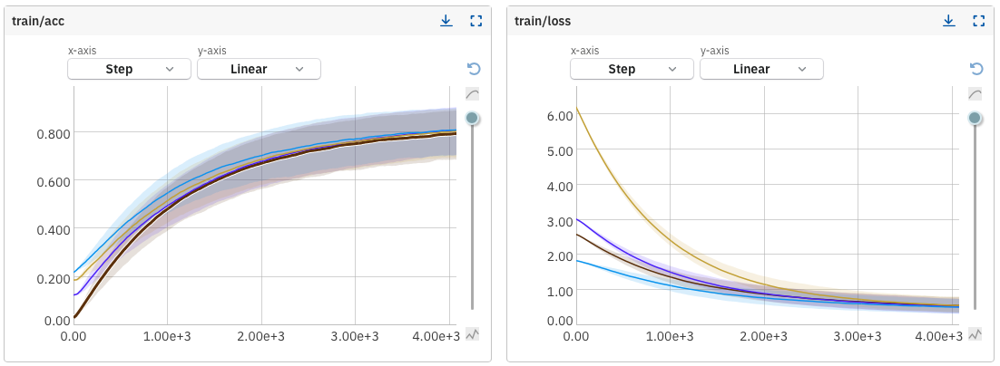

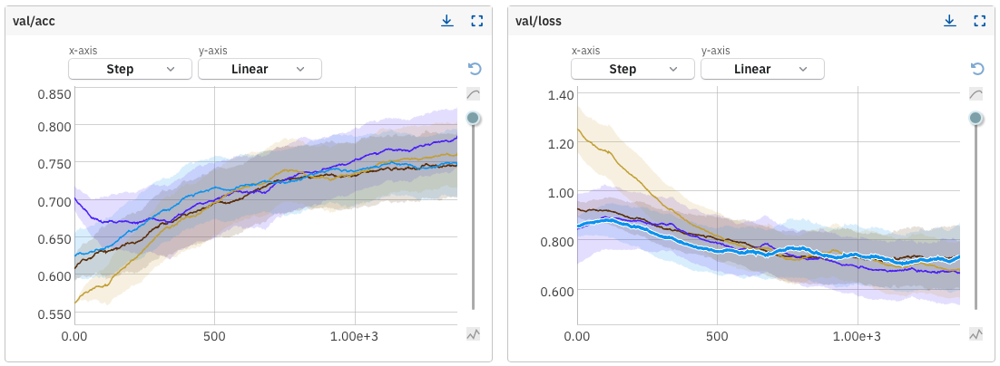

In [ ]:
net = BasicCNN(numLabels=6)
net = net.to(device)
criterionBasic = nn.CrossEntropyLoss()
optimizerBasic = optim.Adam(net.parameters(), lr=0.001)    #net.parameters is the wight of the NN

run = neptune.init_run(
    project="gihazshay/finalProjectML",
    api_token="eyJhcGlfYWRkcmVzcyI6Imh0dHBzOi8vYXBwLm5lcHR1bmUuYWkiLCJhcGlfdXJsIjoiaHR0cHM6Ly9hcHAubmVwdHVuZS5haSIsImFwaV9rZXkiOiI0Mjc3OWFhMi0zYWI3LTRiMjQtYjFiMC0xMGNkYWU4MjBkOTcifQ==",
)

params = {"learning_rate": 0.001, "optimizer": "Adam"}
run["parameters"] = params

trainModel = train(net, trainDataloader, optimizerBasic, 12, criterionBasic)
testAcc, testLoss = test(net, testDataloader, criterionBasic)

run.stop()

[neptune] [info   ] Neptune initialized. Open in the app: https://app.neptune.ai/gihazshay/finalProjectML/e/FIN-388


Epoch 0: 100%|██████████| 453/453 [00:05<00:00, 87.04batch/s]


              precision    recall  f1-score   support

           0       0.63      0.64      0.63      2451
           1       0.46      0.33      0.38      2366
           2       0.56      0.56      0.56      2581
           3       0.53      0.57      0.55      2513
           4       0.77      0.81      0.79      2333
           5       0.53      0.61      0.56      2234

    accuracy                           0.58     14478
   macro avg       0.58      0.59      0.58     14478
weighted avg       0.58      0.58      0.58     14478



Epoch 1: 100%|██████████| 453/453 [00:05<00:00, 85.25batch/s]


              precision    recall  f1-score   support

           0       0.74      0.76      0.75      2451
           1       0.63      0.54      0.58      2366
           2       0.67      0.66      0.67      2581
           3       0.65      0.72      0.68      2513
           4       0.90      0.88      0.89      2333
           5       0.69      0.71      0.70      2234

    accuracy                           0.71     14478
   macro avg       0.71      0.71      0.71     14478
weighted avg       0.71      0.71      0.71     14478



Epoch 2: 100%|██████████| 453/453 [00:05<00:00, 76.97batch/s]


              precision    recall  f1-score   support

           0       0.76      0.76      0.76      2451
           1       0.70      0.65      0.67      2366
           2       0.72      0.69      0.71      2581
           3       0.70      0.76      0.73      2513
           4       0.91      0.90      0.90      2333
           5       0.72      0.74      0.73      2234

    accuracy                           0.75     14478
   macro avg       0.75      0.75      0.75     14478
weighted avg       0.75      0.75      0.75     14478



Epoch 3: 100%|██████████| 453/453 [00:05<00:00, 89.27batch/s]


              precision    recall  f1-score   support

           0       0.78      0.80      0.79      2451
           1       0.73      0.69      0.71      2366
           2       0.73      0.70      0.72      2581
           3       0.72      0.77      0.74      2513
           4       0.91      0.90      0.91      2333
           5       0.75      0.75      0.75      2234

    accuracy                           0.77     14478
   macro avg       0.77      0.77      0.77     14478
weighted avg       0.77      0.77      0.77     14478



Epoch 4: 100%|██████████| 453/453 [00:05<00:00, 81.21batch/s]


              precision    recall  f1-score   support

           0       0.80      0.81      0.81      2451
           1       0.76      0.73      0.74      2366
           2       0.75      0.71      0.73      2581
           3       0.73      0.78      0.76      2513
           4       0.93      0.92      0.93      2333
           5       0.76      0.77      0.77      2234

    accuracy                           0.79     14478
   macro avg       0.79      0.79      0.79     14478
weighted avg       0.79      0.79      0.79     14478



Epoch 5: 100%|██████████| 453/453 [00:05<00:00, 76.35batch/s]


              precision    recall  f1-score   support

           0       0.82      0.82      0.82      2451
           1       0.76      0.74      0.75      2366
           2       0.75      0.73      0.74      2581
           3       0.75      0.78      0.76      2513
           4       0.92      0.92      0.92      2333
           5       0.78      0.78      0.78      2234

    accuracy                           0.80     14478
   macro avg       0.80      0.80      0.80     14478
weighted avg       0.80      0.80      0.80     14478



Epoch 6: 100%|██████████| 453/453 [00:04<00:00, 91.91batch/s]


              precision    recall  f1-score   support

           0       0.81      0.83      0.82      2451
           1       0.77      0.75      0.76      2366
           2       0.77      0.74      0.75      2581
           3       0.76      0.79      0.77      2513
           4       0.93      0.92      0.93      2333
           5       0.79      0.79      0.79      2234

    accuracy                           0.80     14478
   macro avg       0.80      0.80      0.80     14478
weighted avg       0.80      0.80      0.80     14478



Epoch 7: 100%|██████████| 453/453 [00:05<00:00, 85.78batch/s]


              precision    recall  f1-score   support

           0       0.82      0.84      0.83      2451
           1       0.78      0.76      0.77      2366
           2       0.76      0.74      0.75      2581
           3       0.76      0.79      0.77      2513
           4       0.93      0.93      0.93      2333
           5       0.80      0.79      0.80      2234

    accuracy                           0.81     14478
   macro avg       0.81      0.81      0.81     14478
weighted avg       0.81      0.81      0.81     14478



Epoch 8: 100%|██████████| 453/453 [00:05<00:00, 76.03batch/s]


              precision    recall  f1-score   support

           0       0.83      0.85      0.84      2451
           1       0.80      0.78      0.79      2366
           2       0.77      0.76      0.76      2581
           3       0.78      0.80      0.79      2513
           4       0.94      0.93      0.93      2333
           5       0.81      0.81      0.81      2234

    accuracy                           0.82     14478
   macro avg       0.82      0.82      0.82     14478
weighted avg       0.82      0.82      0.82     14478



Epoch 9: 100%|██████████| 453/453 [00:05<00:00, 90.26batch/s]


              precision    recall  f1-score   support

           0       0.84      0.85      0.85      2451
           1       0.79      0.77      0.78      2366
           2       0.77      0.77      0.77      2581
           3       0.78      0.79      0.78      2513
           4       0.94      0.94      0.94      2333
           5       0.82      0.82      0.82      2234

    accuracy                           0.82     14478
   macro avg       0.82      0.82      0.82     14478
weighted avg       0.82      0.82      0.82     14478



Epoch 10: 100%|██████████| 453/453 [00:05<00:00, 88.32batch/s]


              precision    recall  f1-score   support

           0       0.85      0.86      0.86      2451
           1       0.80      0.79      0.80      2366
           2       0.79      0.77      0.78      2581
           3       0.78      0.80      0.79      2513
           4       0.94      0.94      0.94      2333
           5       0.83      0.84      0.83      2234

    accuracy                           0.83     14478
   macro avg       0.83      0.83      0.83     14478
weighted avg       0.83      0.83      0.83     14478



Epoch 11: 100%|██████████| 453/453 [00:05<00:00, 76.25batch/s]


              precision    recall  f1-score   support

           0       0.85      0.87      0.86      2451
           1       0.81      0.80      0.81      2366
           2       0.79      0.77      0.78      2581
           3       0.79      0.81      0.80      2513
           4       0.95      0.95      0.95      2333
           5       0.83      0.83      0.83      2234

    accuracy                           0.84     14478
   macro avg       0.84      0.84      0.84     14478
weighted avg       0.84      0.84      0.84     14478



100%|██████████| 80/80 [00:00<00:00, 135.01batch/s]


              precision    recall  f1-score   support

           0       0.83      0.69      0.75       432
           1       0.73      0.77      0.75       418
           2       0.77      0.67      0.71       456
           3       0.76      0.76      0.76       444
           4       0.93      0.91      0.92       412
           5       0.67      0.86      0.75       394

    accuracy                           0.77      2556
   macro avg       0.78      0.78      0.77      2556
weighted avg       0.78      0.77      0.77      2556

[neptune] [info   ] Shutting down background jobs, please wait a moment...
[neptune] [info   ] Done!
[neptune] [info   ] Waiting for the remaining 96 operations to synchronize with Neptune. Do not kill this process.
[neptune] [info   ] All 96 operations synced, thanks for waiting!
[neptune] [info   ] Explore the metadata in the Neptune app: https://app.neptune.ai/gihazshay/finalProjectML/e/FIN-388/metadata


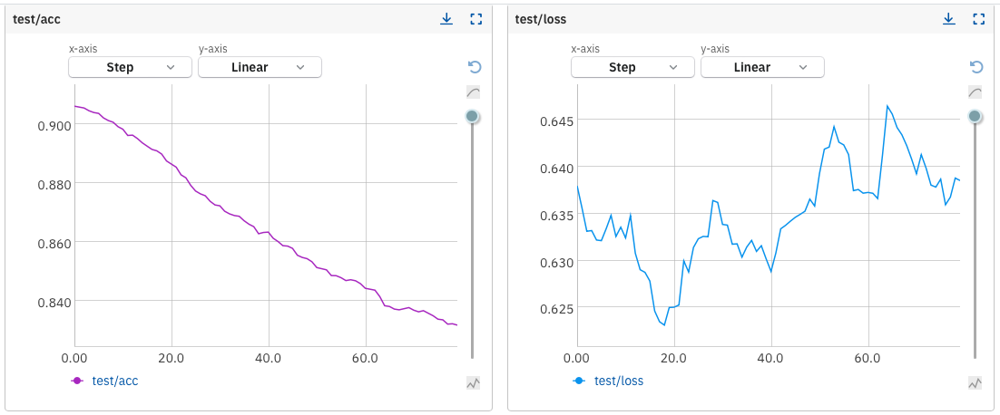

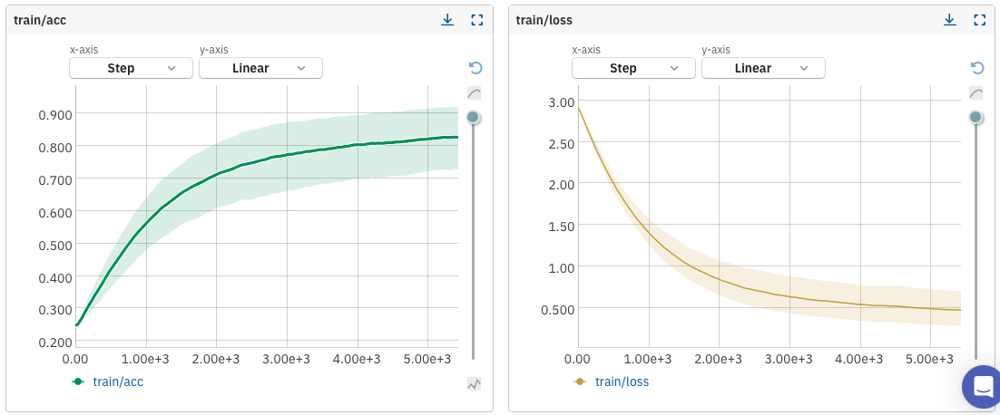

Now, we can see that using 12 epochs is a very suitable choice for our model. We will continue to test our hyperparameters with the number of epochs set to 12.

Additionally, we will include the results of the model we have created so far.

**Average accuracy and loss:**


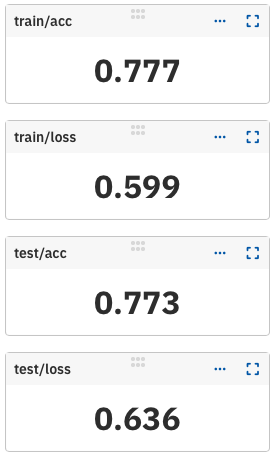

**Last sample of the training accuracy and loss:**

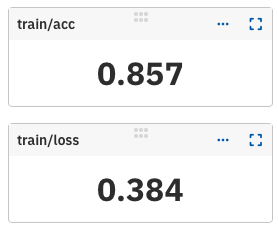



---



## Batch size

Another hyperparameter that needs to be considered is the batch size.

The batch size affects the network in several ways. Small batch sizes can lead to more noisy updates, potentially requiring more iterations to converge. On the other hand, larger batch sizes consume more memory as they process more data simultaneously, which can be a limiting factor on machines with limited GPU or RAM resources.

Additionally, smaller batch sizes update the model weights more frequently, which can make the training process more stable and result in better generalization.

Currently, our batch size is set to 32, which is relatively small. We will test two larger batch sizes and decide which is the most suitable for our model.

It will be easier to determine which batch size is best by showing the results as numbers rather than graphs. Therefore, we will present the results in a numerical format.

### batch size: $64$

In [ ]:
num_folds = 4

# Initialize the KFold object
kf = KFold(n_splits=num_folds, shuffle=True, random_state=40)


foldNum = 0
foldsMatrix = {}


for train_indices, val_indices in kf.split(idxTrain):


    TrainX_Kfold = np.array([dataset[i][0] for i in idxTrain[train_indices]])
    ValX_Kfold = np.array([dataset[j][0] for j in idxTrain[val_indices]])
    TrainY_Kfold = np.array([dataset[i][1] for i in idxTrain[train_indices]])
    ValY_Kfold = np.array([dataset[j][1] for j in idxTrain[val_indices]])
    ValZ_Kfold = np.array([dataset[j][2] for j in idxTrain[val_indices]])      #ID test of the images
    TrainZ_Kfold = np.array([dataset[i][2] for i in idxTrain[train_indices]])  #ID train of the images

    tensorTrainX_Kfold = torch.tensor(TrainX_Kfold, dtype=torch.float32).to(device)
    tensorValX_Kfold = torch.tensor(ValX_Kfold, dtype=torch.float32).to(device)
    tensorTrainY_Kfold = torch.tensor(TrainY_Kfold, dtype=torch.long).to(device)
    tensorValY_Kfold = torch.tensor(ValY_Kfold, dtype=torch.long).to(device)
    tensorTrainZ_Kfold = torch.tensor(TrainZ_Kfold, dtype=torch.long).to(device)
    tensorValZ_Kfold = torch.tensor(ValZ_Kfold, dtype=torch.long).to(device)

    # Create a TensorDataset object from the data
    tensorDatasetTrain_Kfold = TensorDataset(tensorTrainX_Kfold, tensorTrainY_Kfold, tensorTrainZ_Kfold)
    tensorDatasetVal_Kfold = TensorDataset(tensorValX_Kfold, tensorValY_Kfold, tensorValZ_Kfold)

    # Create a DataLoader object with batch size 64
    trainDataloaderKfold = DataLoader(tensorDatasetTrain_Kfold, batch_size=64, shuffle=True)
    valDataloaderKfold = DataLoader(tensorDatasetVal_Kfold, batch_size=64, shuffle=True)

    print(f"------fold------:{foldNum}")

    run = neptune.init_run(
    project="gihazshay/finalProjectML",
    api_token="eyJhcGlfYWRkcmVzcyI6Imh0dHBzOi8vYXBwLm5lcHR1bmUuYWkiLCJhcGlfdXJsIjoiaHR0cHM6Ly9hcHAubmVwdHVuZS5haSIsImFwaV9rZXkiOiI0Mjc3OWFhMi0zYWI3LTRiMjQtYjFiMC0xMGNkYWU4MjBkOTcifQ==",
    )

    params = {"learning_rate": 0.001, "optimizer": "Adam"}
    run["parameters"] = params

    net = BasicCNN(numLabels=6)
    net = net.to(device)
    criterionBasic = nn.CrossEntropyLoss()
    optimizerBasic = optim.Adam(net.parameters(), lr=0.001)    #net.parameters is the wight of the NN
    trainAcc, trainLoss, valAcc, valLoss = train(net, trainDataloaderKfold, optimizerBasic, 12, criterionBasic, valDataloaderKfold)

    run.stop()
    foldsMatrix[f"fold {foldNum}"] = {'train_acc':trainAcc, 'train_loss':trainLoss,
                                      'val_acc':valAcc, 'val_loss':valLoss}
    foldNum += 1


------fold------:0
[neptune] [info   ] Neptune initialized. Open in the app: https://app.neptune.ai/gihazshay/finalProjectML/e/FIN-394


Epoch 0:   0%|          | 0/170 [00:00<?, ?batch/s]/usr/local/lib/python3.10/dist-packages/torch/autograd/graph.py:744: UserWarning: Plan failed with a cudnnException: CUDNN_BACKEND_EXECUTION_PLAN_DESCRIPTOR: cudnnFinalize Descriptor Failed cudnn_status: CUDNN_STATUS_NOT_SUPPORTED (Triggered internally at ../aten/src/ATen/native/cudnn/Conv_v8.cpp:919.)
  return Variable._execution_engine.run_backward(  # Calls into the C++ engine to run the backward pass
Epoch 0: 100%|██████████| 170/170 [00:02<00:00, 70.81batch/s]


              precision    recall  f1-score   support

           0       0.46      0.61      0.53      1822
           1       0.43      0.16      0.23      1766
           2       0.49      0.54      0.51      1964
           3       0.50      0.56      0.53      1871
           4       0.71      0.72      0.72      1745
           5       0.42      0.43      0.43      1690

    accuracy                           0.51     10858
   macro avg       0.50      0.50      0.49     10858
weighted avg       0.50      0.51      0.49     10858

Validtion part------EPOCH------:0


100%|██████████| 57/57 [00:00<00:00, 162.59batch/s]


              precision    recall  f1-score   support

           0       0.67      0.71      0.69       629
           1       0.38      0.41      0.39       600
           2       0.52      0.67      0.59       617
           3       0.69      0.41      0.51       642
           4       0.75      0.88      0.81       588
           5       0.57      0.46      0.51       544

    accuracy                           0.59      3620
   macro avg       0.60      0.59      0.58      3620
weighted avg       0.60      0.59      0.58      3620



Epoch 1: 100%|██████████| 170/170 [00:02<00:00, 83.30batch/s]


              precision    recall  f1-score   support

           0       0.69      0.72      0.70      1822
           1       0.52      0.33      0.40      1766
           2       0.60      0.64      0.62      1964
           3       0.60      0.69      0.64      1871
           4       0.86      0.85      0.86      1745
           5       0.55      0.60      0.58      1690

    accuracy                           0.64     10858
   macro avg       0.64      0.64      0.63     10858
weighted avg       0.64      0.64      0.63     10858

Validtion part------EPOCH------:1


100%|██████████| 57/57 [00:00<00:00, 199.66batch/s]


              precision    recall  f1-score   support

           0       0.68      0.75      0.71       629
           1       0.53      0.38      0.44       600
           2       0.68      0.53      0.59       617
           3       0.61      0.77      0.68       642
           4       0.87      0.88      0.88       588
           5       0.57      0.66      0.61       544

    accuracy                           0.66      3620
   macro avg       0.66      0.66      0.65      3620
weighted avg       0.66      0.66      0.65      3620



Epoch 2: 100%|██████████| 170/170 [00:01<00:00, 92.22batch/s]


              precision    recall  f1-score   support

           0       0.72      0.75      0.74      1822
           1       0.55      0.40      0.46      1766
           2       0.63      0.65      0.64      1964
           3       0.64      0.72      0.68      1871
           4       0.88      0.87      0.88      1745
           5       0.60      0.65      0.63      1690

    accuracy                           0.67     10858
   macro avg       0.67      0.67      0.67     10858
weighted avg       0.67      0.67      0.67     10858

Validtion part------EPOCH------:2


100%|██████████| 57/57 [00:00<00:00, 207.53batch/s]


              precision    recall  f1-score   support

           0       0.74      0.69      0.71       629
           1       0.51      0.42      0.46       600
           2       0.62      0.57      0.59       617
           3       0.67      0.67      0.67       642
           4       0.81      0.90      0.86       588
           5       0.58      0.71      0.64       544

    accuracy                           0.66      3620
   macro avg       0.65      0.66      0.66      3620
weighted avg       0.66      0.66      0.66      3620



Epoch 3: 100%|██████████| 170/170 [00:01<00:00, 93.05batch/s]


              precision    recall  f1-score   support

           0       0.74      0.76      0.75      1822
           1       0.59      0.45      0.51      1766
           2       0.64      0.65      0.64      1964
           3       0.65      0.73      0.69      1871
           4       0.88      0.87      0.88      1745
           5       0.61      0.66      0.63      1690

    accuracy                           0.69     10858
   macro avg       0.68      0.69      0.68     10858
weighted avg       0.68      0.69      0.68     10858

Validtion part------EPOCH------:3


100%|██████████| 57/57 [00:00<00:00, 204.73batch/s]


              precision    recall  f1-score   support

           0       0.65      0.83      0.73       629
           1       0.55      0.42      0.48       600
           2       0.66      0.60      0.63       617
           3       0.63      0.78      0.70       642
           4       0.98      0.71      0.83       588
           5       0.62      0.65      0.63       544

    accuracy                           0.67      3620
   macro avg       0.68      0.66      0.66      3620
weighted avg       0.68      0.67      0.67      3620



Epoch 4: 100%|██████████| 170/170 [00:01<00:00, 92.40batch/s]


              precision    recall  f1-score   support

           0       0.76      0.77      0.77      1822
           1       0.60      0.50      0.55      1766
           2       0.66      0.64      0.65      1964
           3       0.67      0.74      0.70      1871
           4       0.90      0.89      0.89      1745
           5       0.65      0.69      0.67      1690

    accuracy                           0.71     10858
   macro avg       0.71      0.71      0.70     10858
weighted avg       0.70      0.71      0.70     10858

Validtion part------EPOCH------:4


100%|██████████| 57/57 [00:00<00:00, 204.15batch/s]


              precision    recall  f1-score   support

           0       0.72      0.79      0.75       629
           1       0.50      0.60      0.54       600
           2       0.64      0.53      0.58       617
           3       0.69      0.68      0.69       642
           4       0.82      0.92      0.87       588
           5       0.74      0.54      0.63       544

    accuracy                           0.68      3620
   macro avg       0.68      0.68      0.68      3620
weighted avg       0.68      0.68      0.68      3620



Epoch 5: 100%|██████████| 170/170 [00:01<00:00, 92.42batch/s]


              precision    recall  f1-score   support

           0       0.77      0.79      0.78      1822
           1       0.63      0.54      0.58      1766
           2       0.67      0.66      0.66      1964
           3       0.69      0.75      0.72      1871
           4       0.90      0.89      0.90      1745
           5       0.67      0.71      0.69      1690

    accuracy                           0.72     10858
   macro avg       0.72      0.72      0.72     10858
weighted avg       0.72      0.72      0.72     10858

Validtion part------EPOCH------:5


100%|██████████| 57/57 [00:00<00:00, 203.26batch/s]


              precision    recall  f1-score   support

           0       0.71      0.82      0.76       629
           1       0.56      0.53      0.55       600
           2       0.66      0.61      0.63       617
           3       0.68      0.74      0.71       642
           4       0.91      0.88      0.89       588
           5       0.71      0.63      0.67       544

    accuracy                           0.70      3620
   macro avg       0.70      0.70      0.70      3620
weighted avg       0.70      0.70      0.70      3620



Epoch 6: 100%|██████████| 170/170 [00:01<00:00, 86.06batch/s]


              precision    recall  f1-score   support

           0       0.77      0.80      0.79      1822
           1       0.63      0.55      0.59      1766
           2       0.68      0.66      0.67      1964
           3       0.71      0.76      0.73      1871
           4       0.90      0.88      0.89      1745
           5       0.69      0.73      0.71      1690

    accuracy                           0.73     10858
   macro avg       0.73      0.73      0.73     10858
weighted avg       0.73      0.73      0.73     10858

Validtion part------EPOCH------:6


100%|██████████| 57/57 [00:00<00:00, 163.02batch/s]


              precision    recall  f1-score   support

           0       0.70      0.84      0.76       629
           1       0.55      0.51      0.53       600
           2       0.65      0.59      0.62       617
           3       0.62      0.79      0.70       642
           4       0.94      0.81      0.87       588
           5       0.74      0.58      0.65       544

    accuracy                           0.69      3620
   macro avg       0.70      0.69      0.69      3620
weighted avg       0.70      0.69      0.69      3620



Epoch 7: 100%|██████████| 170/170 [00:02<00:00, 79.01batch/s]


              precision    recall  f1-score   support

           0       0.79      0.82      0.80      1822
           1       0.65      0.61      0.63      1766
           2       0.70      0.66      0.68      1964
           3       0.72      0.77      0.74      1871
           4       0.92      0.90      0.91      1745
           5       0.71      0.74      0.73      1690

    accuracy                           0.75     10858
   macro avg       0.75      0.75      0.75     10858
weighted avg       0.75      0.75      0.75     10858

Validtion part------EPOCH------:7


100%|██████████| 57/57 [00:00<00:00, 160.76batch/s]


              precision    recall  f1-score   support

           0       0.76      0.78      0.77       629
           1       0.60      0.52      0.56       600
           2       0.60      0.68      0.64       617
           3       0.66      0.70      0.68       642
           4       0.92      0.88      0.90       588
           5       0.70      0.66      0.68       544

    accuracy                           0.70      3620
   macro avg       0.71      0.70      0.70      3620
weighted avg       0.71      0.70      0.70      3620



Epoch 8: 100%|██████████| 170/170 [00:02<00:00, 79.38batch/s]


              precision    recall  f1-score   support

           0       0.81      0.82      0.81      1822
           1       0.67      0.62      0.65      1766
           2       0.71      0.68      0.69      1964
           3       0.73      0.78      0.75      1871
           4       0.92      0.92      0.92      1745
           5       0.73      0.75      0.74      1690

    accuracy                           0.76     10858
   macro avg       0.76      0.76      0.76     10858
weighted avg       0.76      0.76      0.76     10858

Validtion part------EPOCH------:8


100%|██████████| 57/57 [00:00<00:00, 197.76batch/s]


              precision    recall  f1-score   support

           0       0.77      0.76      0.76       629
           1       0.59      0.53      0.56       600
           2       0.61      0.69      0.64       617
           3       0.70      0.73      0.71       642
           4       0.96      0.85      0.90       588
           5       0.67      0.73      0.70       544

    accuracy                           0.71      3620
   macro avg       0.72      0.71      0.71      3620
weighted avg       0.72      0.71      0.71      3620



Epoch 9: 100%|██████████| 170/170 [00:01<00:00, 90.49batch/s]


              precision    recall  f1-score   support

           0       0.82      0.83      0.82      1822
           1       0.68      0.64      0.66      1766
           2       0.71      0.69      0.70      1964
           3       0.73      0.78      0.75      1871
           4       0.92      0.92      0.92      1745
           5       0.75      0.77      0.76      1690

    accuracy                           0.77     10858
   macro avg       0.77      0.77      0.77     10858
weighted avg       0.77      0.77      0.77     10858

Validtion part------EPOCH------:9


100%|██████████| 57/57 [00:00<00:00, 204.28batch/s]


              precision    recall  f1-score   support

           0       0.72      0.86      0.79       629
           1       0.57      0.64      0.60       600
           2       0.73      0.52      0.61       617
           3       0.68      0.76      0.72       642
           4       0.91      0.89      0.90       588
           5       0.76      0.63      0.69       544

    accuracy                           0.72      3620
   macro avg       0.73      0.72      0.72      3620
weighted avg       0.73      0.72      0.72      3620



Epoch 10: 100%|██████████| 170/170 [00:01<00:00, 91.72batch/s]


              precision    recall  f1-score   support

           0       0.84      0.85      0.84      1822
           1       0.71      0.68      0.70      1766
           2       0.73      0.70      0.71      1964
           3       0.75      0.80      0.77      1871
           4       0.93      0.93      0.93      1745
           5       0.78      0.79      0.79      1690

    accuracy                           0.79     10858
   macro avg       0.79      0.79      0.79     10858
weighted avg       0.79      0.79      0.79     10858

Validtion part------EPOCH------:10


100%|██████████| 57/57 [00:00<00:00, 200.05batch/s]


              precision    recall  f1-score   support

           0       0.74      0.85      0.79       629
           1       0.52      0.71      0.60       600
           2       0.70      0.50      0.58       617
           3       0.67      0.70      0.69       642
           4       0.94      0.89      0.91       588
           5       0.77      0.60      0.67       544

    accuracy                           0.71      3620
   macro avg       0.72      0.71      0.71      3620
weighted avg       0.72      0.71      0.71      3620



Epoch 11: 100%|██████████| 170/170 [00:01<00:00, 89.69batch/s]


              precision    recall  f1-score   support

           0       0.83      0.84      0.84      1822
           1       0.71      0.70      0.70      1766
           2       0.74      0.70      0.71      1964
           3       0.75      0.78      0.77      1871
           4       0.93      0.93      0.93      1745
           5       0.77      0.78      0.78      1690

    accuracy                           0.79     10858
   macro avg       0.79      0.79      0.79     10858
weighted avg       0.79      0.79      0.79     10858

Validtion part------EPOCH------:11


100%|██████████| 57/57 [00:00<00:00, 197.15batch/s]


              precision    recall  f1-score   support

           0       0.75      0.80      0.78       629
           1       0.68      0.54      0.60       600
           2       0.69      0.63      0.66       617
           3       0.67      0.80      0.73       642
           4       0.94      0.89      0.91       588
           5       0.67      0.73      0.70       544

    accuracy                           0.73      3620
   macro avg       0.73      0.73      0.73      3620
weighted avg       0.73      0.73      0.73      3620

[neptune] [info   ] Shutting down background jobs, please wait a moment...
[neptune] [info   ] Done!
[neptune] [info   ] Waiting for the remaining 21 operations to synchronize with Neptune. Do not kill this process.
[neptune] [info   ] All 21 operations synced, thanks for waiting!
[neptune] [info   ] Explore the metadata in the Neptune app: https://app.neptune.ai/gihazshay/finalProjectML/e/FIN-394/metadata
------fold------:1
[neptune] [info   ] Neptune 

Epoch 0: 100%|██████████| 170/170 [00:01<00:00, 87.26batch/s]


              precision    recall  f1-score   support

           0       0.44      0.59      0.51      1850
           1       0.42      0.34      0.38      1800
           2       0.51      0.44      0.47      1924
           3       0.46      0.47      0.47      1908
           4       0.74      0.76      0.75      1732
           5       0.43      0.39      0.40      1644

    accuracy                           0.50     10858
   macro avg       0.50      0.50      0.50     10858
weighted avg       0.50      0.50      0.50     10858

Validtion part------EPOCH------:0


100%|██████████| 57/57 [00:00<00:00, 203.31batch/s]


              precision    recall  f1-score   support

           0       0.81      0.50      0.62       601
           1       0.62      0.24      0.34       566
           2       0.59      0.62      0.61       657
           3       0.53      0.67      0.59       605
           4       0.84      0.83      0.84       601
           5       0.45      0.75      0.56       590

    accuracy                           0.60      3620
   macro avg       0.64      0.60      0.59      3620
weighted avg       0.64      0.60      0.60      3620



Epoch 1: 100%|██████████| 170/170 [00:02<00:00, 84.17batch/s]


              precision    recall  f1-score   support

           0       0.67      0.71      0.69      1850
           1       0.51      0.41      0.46      1800
           2       0.58      0.59      0.58      1924
           3       0.58      0.62      0.60      1908
           4       0.85      0.83      0.84      1732
           5       0.51      0.57      0.54      1644

    accuracy                           0.62     10858
   macro avg       0.62      0.62      0.62     10858
weighted avg       0.62      0.62      0.62     10858

Validtion part------EPOCH------:1


100%|██████████| 57/57 [00:00<00:00, 169.44batch/s]


              precision    recall  f1-score   support

           0       0.78      0.60      0.68       601
           1       0.53      0.43      0.48       566
           2       0.52      0.75      0.62       657
           3       0.67      0.52      0.59       605
           4       0.88      0.84      0.86       601
           5       0.55      0.65      0.59       590

    accuracy                           0.64      3620
   macro avg       0.66      0.63      0.64      3620
weighted avg       0.65      0.64      0.64      3620



Epoch 2: 100%|██████████| 170/170 [00:02<00:00, 78.96batch/s]


              precision    recall  f1-score   support

           0       0.70      0.73      0.71      1850
           1       0.55      0.46      0.50      1800
           2       0.62      0.62      0.62      1924
           3       0.62      0.65      0.63      1908
           4       0.88      0.85      0.86      1732
           5       0.57      0.63      0.60      1644

    accuracy                           0.65     10858
   macro avg       0.65      0.66      0.65     10858
weighted avg       0.65      0.65      0.65     10858

Validtion part------EPOCH------:2


100%|██████████| 57/57 [00:00<00:00, 166.82batch/s]


              precision    recall  f1-score   support

           0       0.76      0.67      0.71       601
           1       0.57      0.56      0.56       566
           2       0.70      0.59      0.64       657
           3       0.64      0.66      0.65       605
           4       0.96      0.78      0.86       601
           5       0.55      0.81      0.65       590

    accuracy                           0.68      3620
   macro avg       0.70      0.68      0.68      3620
weighted avg       0.70      0.68      0.68      3620



Epoch 3: 100%|██████████| 170/170 [00:02<00:00, 80.72batch/s]


              precision    recall  f1-score   support

           0       0.71      0.74      0.73      1850
           1       0.58      0.50      0.54      1800
           2       0.65      0.64      0.65      1924
           3       0.64      0.69      0.66      1908
           4       0.88      0.86      0.87      1732
           5       0.65      0.68      0.66      1644

    accuracy                           0.68     10858
   macro avg       0.69      0.69      0.68     10858
weighted avg       0.68      0.68      0.68     10858

Validtion part------EPOCH------:3


100%|██████████| 57/57 [00:00<00:00, 199.73batch/s]


              precision    recall  f1-score   support

           0       0.76      0.62      0.68       601
           1       0.54      0.58      0.56       566
           2       0.64      0.69      0.66       657
           3       0.58      0.66      0.62       605
           4       0.98      0.75      0.85       601
           5       0.64      0.73      0.68       590

    accuracy                           0.67      3620
   macro avg       0.69      0.67      0.67      3620
weighted avg       0.69      0.67      0.68      3620



Epoch 4: 100%|██████████| 170/170 [00:01<00:00, 92.30batch/s]


              precision    recall  f1-score   support

           0       0.74      0.77      0.76      1850
           1       0.62      0.53      0.57      1800
           2       0.67      0.67      0.67      1924
           3       0.66      0.73      0.70      1908
           4       0.91      0.89      0.90      1732
           5       0.69      0.71      0.70      1644

    accuracy                           0.72     10858
   macro avg       0.72      0.72      0.72     10858
weighted avg       0.72      0.72      0.71     10858

Validtion part------EPOCH------:4


100%|██████████| 57/57 [00:00<00:00, 199.24batch/s]


              precision    recall  f1-score   support

           0       0.71      0.66      0.68       601
           1       0.64      0.66      0.65       566
           2       0.68      0.68      0.68       657
           3       0.72      0.69      0.70       605
           4       0.70      0.97      0.81       601
           5       0.76      0.55      0.64       590

    accuracy                           0.70      3620
   macro avg       0.70      0.70      0.69      3620
weighted avg       0.70      0.70      0.70      3620



Epoch 5: 100%|██████████| 170/170 [00:01<00:00, 90.92batch/s]


              precision    recall  f1-score   support

           0       0.77      0.79      0.78      1850
           1       0.70      0.64      0.67      1800
           2       0.70      0.71      0.71      1924
           3       0.71      0.75      0.73      1908
           4       0.91      0.90      0.90      1732
           5       0.73      0.73      0.73      1644

    accuracy                           0.75     10858
   macro avg       0.75      0.75      0.75     10858
weighted avg       0.75      0.75      0.75     10858

Validtion part------EPOCH------:5


100%|██████████| 57/57 [00:00<00:00, 205.15batch/s]


              precision    recall  f1-score   support

           0       0.83      0.66      0.74       601
           1       0.70      0.68      0.69       566
           2       0.65      0.82      0.73       657
           3       0.77      0.64      0.70       605
           4       0.83      0.93      0.88       601
           5       0.72      0.71      0.72       590

    accuracy                           0.74      3620
   macro avg       0.75      0.74      0.74      3620
weighted avg       0.75      0.74      0.74      3620



Epoch 6: 100%|██████████| 170/170 [00:01<00:00, 90.55batch/s]


              precision    recall  f1-score   support

           0       0.79      0.80      0.79      1850
           1       0.73      0.67      0.70      1800
           2       0.72      0.74      0.73      1924
           3       0.72      0.75      0.74      1908
           4       0.91      0.91      0.91      1732
           5       0.74      0.73      0.74      1644

    accuracy                           0.77     10858
   macro avg       0.77      0.77      0.77     10858
weighted avg       0.77      0.77      0.77     10858

Validtion part------EPOCH------:6


100%|██████████| 57/57 [00:00<00:00, 202.10batch/s]


              precision    recall  f1-score   support

           0       0.78      0.75      0.76       601
           1       0.68      0.75      0.71       566
           2       0.74      0.67      0.71       657
           3       0.71      0.74      0.72       605
           4       0.96      0.86      0.90       601
           5       0.69      0.76      0.72       590

    accuracy                           0.75      3620
   macro avg       0.76      0.75      0.75      3620
weighted avg       0.76      0.75      0.75      3620



Epoch 7: 100%|██████████| 170/170 [00:01<00:00, 89.43batch/s]


              precision    recall  f1-score   support

           0       0.80      0.81      0.81      1850
           1       0.74      0.68      0.71      1800
           2       0.72      0.74      0.73      1924
           3       0.72      0.76      0.74      1908
           4       0.91      0.91      0.91      1732
           5       0.75      0.75      0.75      1644

    accuracy                           0.77     10858
   macro avg       0.77      0.77      0.77     10858
weighted avg       0.77      0.77      0.77     10858

Validtion part------EPOCH------:7


100%|██████████| 57/57 [00:00<00:00, 191.76batch/s]


              precision    recall  f1-score   support

           0       0.76      0.79      0.78       601
           1       0.78      0.63      0.70       566
           2       0.71      0.74      0.73       657
           3       0.69      0.76      0.73       605
           4       0.93      0.90      0.91       601
           5       0.71      0.75      0.73       590

    accuracy                           0.76      3620
   macro avg       0.77      0.76      0.76      3620
weighted avg       0.76      0.76      0.76      3620



Epoch 8: 100%|██████████| 170/170 [00:02<00:00, 83.88batch/s]


              precision    recall  f1-score   support

           0       0.80      0.82      0.81      1850
           1       0.75      0.68      0.71      1800
           2       0.74      0.76      0.75      1924
           3       0.73      0.76      0.75      1908
           4       0.91      0.91      0.91      1732
           5       0.75      0.76      0.76      1644

    accuracy                           0.78     10858
   macro avg       0.78      0.78      0.78     10858
weighted avg       0.78      0.78      0.78     10858

Validtion part------EPOCH------:8


100%|██████████| 57/57 [00:00<00:00, 171.27batch/s]


              precision    recall  f1-score   support

           0       0.77      0.78      0.77       601
           1       0.76      0.61      0.68       566
           2       0.66      0.83      0.73       657
           3       0.75      0.71      0.73       605
           4       0.89      0.91      0.90       601
           5       0.75      0.70      0.72       590

    accuracy                           0.76      3620
   macro avg       0.76      0.76      0.76      3620
weighted avg       0.76      0.76      0.76      3620



Epoch 9: 100%|██████████| 170/170 [00:02<00:00, 80.16batch/s]


              precision    recall  f1-score   support

           0       0.82      0.83      0.82      1850
           1       0.76      0.71      0.74      1800
           2       0.74      0.75      0.75      1924
           3       0.74      0.77      0.75      1908
           4       0.91      0.92      0.91      1732
           5       0.76      0.76      0.76      1644

    accuracy                           0.79     10858
   macro avg       0.79      0.79      0.79     10858
weighted avg       0.79      0.79      0.79     10858

Validtion part------EPOCH------:9


100%|██████████| 57/57 [00:00<00:00, 161.48batch/s]


              precision    recall  f1-score   support

           0       0.75      0.80      0.78       601
           1       0.69      0.75      0.72       566
           2       0.72      0.76      0.74       657
           3       0.81      0.65      0.72       605
           4       0.91      0.91      0.91       601
           5       0.71      0.70      0.71       590

    accuracy                           0.76      3620
   macro avg       0.76      0.76      0.76      3620
weighted avg       0.76      0.76      0.76      3620



Epoch 10: 100%|██████████| 170/170 [00:02<00:00, 77.36batch/s]


              precision    recall  f1-score   support

           0       0.83      0.84      0.84      1850
           1       0.77      0.73      0.75      1800
           2       0.75      0.76      0.76      1924
           3       0.77      0.79      0.78      1908
           4       0.93      0.92      0.93      1732
           5       0.77      0.77      0.77      1644

    accuracy                           0.80     10858
   macro avg       0.80      0.80      0.80     10858
weighted avg       0.80      0.80      0.80     10858

Validtion part------EPOCH------:10


100%|██████████| 57/57 [00:00<00:00, 164.98batch/s]


              precision    recall  f1-score   support

           0       0.82      0.68      0.74       601
           1       0.75      0.70      0.72       566
           2       0.72      0.77      0.74       657
           3       0.75      0.74      0.74       605
           4       0.89      0.92      0.91       601
           5       0.69      0.79      0.74       590

    accuracy                           0.77      3620
   macro avg       0.77      0.77      0.77      3620
weighted avg       0.77      0.77      0.77      3620



Epoch 11: 100%|██████████| 170/170 [00:01<00:00, 88.06batch/s]


              precision    recall  f1-score   support

           0       0.84      0.85      0.84      1850
           1       0.79      0.76      0.77      1800
           2       0.77      0.78      0.78      1924
           3       0.76      0.78      0.77      1908
           4       0.93      0.94      0.94      1732
           5       0.80      0.78      0.79      1644

    accuracy                           0.81     10858
   macro avg       0.82      0.81      0.82     10858
weighted avg       0.81      0.81      0.81     10858

Validtion part------EPOCH------:11


100%|██████████| 57/57 [00:00<00:00, 201.55batch/s]


              precision    recall  f1-score   support

           0       0.80      0.73      0.76       601
           1       0.77      0.67      0.71       566
           2       0.66      0.83      0.74       657
           3       0.77      0.71      0.74       605
           4       0.85      0.94      0.89       601
           5       0.77      0.69      0.73       590

    accuracy                           0.76      3620
   macro avg       0.77      0.76      0.76      3620
weighted avg       0.77      0.76      0.76      3620

[neptune] [info   ] Shutting down background jobs, please wait a moment...
[neptune] [info   ] Done!
[neptune] [info   ] Waiting for the remaining 22 operations to synchronize with Neptune. Do not kill this process.
[neptune] [info   ] All 22 operations synced, thanks for waiting!
[neptune] [info   ] Explore the metadata in the Neptune app: https://app.neptune.ai/gihazshay/finalProjectML/e/FIN-395/metadata
------fold------:2
[neptune] [info   ] Neptune 

Epoch 0:  95%|█████████▍| 161/170 [00:01<00:00, 92.43batch/s]/usr/local/lib/python3.10/dist-packages/torch/autograd/graph.py:744: UserWarning: Plan failed with a cudnnException: CUDNN_BACKEND_EXECUTION_PLAN_DESCRIPTOR: cudnnFinalize Descriptor Failed cudnn_status: CUDNN_STATUS_NOT_SUPPORTED (Triggered internally at ../aten/src/ATen/native/cudnn/Conv_v8.cpp:919.)
  return Variable._execution_engine.run_backward(  # Calls into the C++ engine to run the backward pass
Epoch 0: 100%|██████████| 170/170 [00:01<00:00, 87.52batch/s]


              precision    recall  f1-score   support

           0       0.49      0.62      0.55      1855
           1       0.39      0.25      0.31      1767
           2       0.46      0.44      0.45      1933
           3       0.45      0.44      0.44      1863
           4       0.70      0.74      0.72      1737
           5       0.39      0.44      0.41      1704

    accuracy                           0.49     10859
   macro avg       0.48      0.49      0.48     10859
weighted avg       0.48      0.49      0.48     10859

Validtion part------EPOCH------:0


100%|██████████| 57/57 [00:00<00:00, 200.03batch/s]


              precision    recall  f1-score   support

           0       0.59      0.80      0.68       596
           1       0.46      0.24      0.31       599
           2       0.50      0.62      0.55       648
           3       0.61      0.57      0.59       650
           4       0.84      0.86      0.85       596
           5       0.52      0.48      0.50       530

    accuracy                           0.60      3619
   macro avg       0.59      0.59      0.58      3619
weighted avg       0.59      0.60      0.58      3619



Epoch 1: 100%|██████████| 170/170 [00:01<00:00, 90.01batch/s]


              precision    recall  f1-score   support

           0       0.68      0.70      0.69      1855
           1       0.50      0.41      0.45      1767
           2       0.57      0.54      0.56      1933
           3       0.57      0.66      0.61      1863
           4       0.87      0.86      0.87      1737
           5       0.57      0.60      0.59      1704

    accuracy                           0.63     10859
   macro avg       0.63      0.63      0.63     10859
weighted avg       0.63      0.63      0.62     10859

Validtion part------EPOCH------:1


100%|██████████| 57/57 [00:00<00:00, 193.71batch/s]


              precision    recall  f1-score   support

           0       0.65      0.78      0.71       596
           1       0.51      0.51      0.51       599
           2       0.70      0.37      0.49       648
           3       0.56      0.78      0.65       650
           4       0.93      0.80      0.86       596
           5       0.61      0.61      0.61       530

    accuracy                           0.64      3619
   macro avg       0.66      0.64      0.64      3619
weighted avg       0.66      0.64      0.64      3619



Epoch 2: 100%|██████████| 170/170 [00:01<00:00, 90.06batch/s]


              precision    recall  f1-score   support

           0       0.71      0.74      0.73      1855
           1       0.54      0.48      0.51      1767
           2       0.59      0.55      0.57      1933
           3       0.61      0.69      0.65      1863
           4       0.88      0.87      0.88      1737
           5       0.64      0.65      0.64      1704

    accuracy                           0.66     10859
   macro avg       0.66      0.66      0.66     10859
weighted avg       0.66      0.66      0.66     10859

Validtion part------EPOCH------:2


100%|██████████| 57/57 [00:00<00:00, 201.24batch/s]


              precision    recall  f1-score   support

           0       0.66      0.77      0.71       596
           1       0.54      0.56      0.55       599
           2       0.59      0.52      0.55       648
           3       0.72      0.54      0.62       650
           4       0.83      0.92      0.88       596
           5       0.58      0.64      0.61       530

    accuracy                           0.66      3619
   macro avg       0.65      0.66      0.65      3619
weighted avg       0.66      0.66      0.65      3619



Epoch 3: 100%|██████████| 170/170 [00:01<00:00, 89.61batch/s]


              precision    recall  f1-score   support

           0       0.73      0.75      0.74      1855
           1       0.56      0.56      0.56      1767
           2       0.62      0.56      0.59      1933
           3       0.65      0.70      0.67      1863
           4       0.88      0.87      0.88      1737
           5       0.67      0.68      0.68      1704

    accuracy                           0.69     10859
   macro avg       0.69      0.69      0.69     10859
weighted avg       0.69      0.69      0.68     10859

Validtion part------EPOCH------:3


100%|██████████| 57/57 [00:00<00:00, 167.22batch/s]


              precision    recall  f1-score   support

           0       0.71      0.79      0.75       596
           1       0.58      0.46      0.52       599
           2       0.55      0.63      0.59       648
           3       0.71      0.64      0.67       650
           4       0.87      0.91      0.89       596
           5       0.63      0.64      0.64       530

    accuracy                           0.68      3619
   macro avg       0.68      0.68      0.68      3619
weighted avg       0.68      0.68      0.67      3619



Epoch 4: 100%|██████████| 170/170 [00:02<00:00, 81.11batch/s]


              precision    recall  f1-score   support

           0       0.75      0.76      0.76      1855
           1       0.60      0.61      0.61      1767
           2       0.63      0.57      0.60      1933
           3       0.68      0.72      0.70      1863
           4       0.91      0.88      0.89      1737
           5       0.67      0.70      0.69      1704

    accuracy                           0.71     10859
   macro avg       0.71      0.71      0.71     10859
weighted avg       0.71      0.71      0.71     10859

Validtion part------EPOCH------:4


100%|██████████| 57/57 [00:00<00:00, 165.11batch/s]


              precision    recall  f1-score   support

           0       0.74      0.75      0.75       596
           1       0.53      0.65      0.59       599
           2       0.57      0.62      0.59       648
           3       0.76      0.62      0.69       650
           4       0.80      0.95      0.87       596
           5       0.76      0.51      0.61       530

    accuracy                           0.68      3619
   macro avg       0.70      0.68      0.68      3619
weighted avg       0.69      0.68      0.68      3619



Epoch 5: 100%|██████████| 170/170 [00:02<00:00, 77.12batch/s]


              precision    recall  f1-score   support

           0       0.76      0.78      0.77      1855
           1       0.63      0.65      0.64      1767
           2       0.65      0.57      0.61      1933
           3       0.70      0.74      0.72      1863
           4       0.90      0.88      0.89      1737
           5       0.69      0.71      0.70      1704

    accuracy                           0.72     10859
   macro avg       0.72      0.72      0.72     10859
weighted avg       0.72      0.72      0.72     10859

Validtion part------EPOCH------:5


100%|██████████| 57/57 [00:00<00:00, 158.74batch/s]


              precision    recall  f1-score   support

           0       0.75      0.77      0.76       596
           1       0.54      0.69      0.61       599
           2       0.63      0.52      0.57       648
           3       0.66      0.73      0.69       650
           4       0.90      0.90      0.90       596
           5       0.75      0.56      0.64       530

    accuracy                           0.69      3619
   macro avg       0.70      0.69      0.69      3619
weighted avg       0.70      0.69      0.69      3619



Epoch 6: 100%|██████████| 170/170 [00:02<00:00, 81.97batch/s]


              precision    recall  f1-score   support

           0       0.77      0.79      0.78      1855
           1       0.63      0.65      0.64      1767
           2       0.66      0.60      0.63      1933
           3       0.70      0.73      0.72      1863
           4       0.91      0.89      0.90      1737
           5       0.72      0.73      0.73      1704

    accuracy                           0.73     10859
   macro avg       0.73      0.73      0.73     10859
weighted avg       0.73      0.73      0.73     10859

Validtion part------EPOCH------:6


100%|██████████| 57/57 [00:00<00:00, 196.42batch/s]


              precision    recall  f1-score   support

           0       0.69      0.79      0.74       596
           1       0.58      0.67      0.62       599
           2       0.72      0.42      0.53       648
           3       0.66      0.79      0.72       650
           4       0.96      0.81      0.88       596
           5       0.66      0.73      0.69       530

    accuracy                           0.70      3619
   macro avg       0.71      0.70      0.70      3619
weighted avg       0.71      0.70      0.69      3619



Epoch 7: 100%|██████████| 170/170 [00:01<00:00, 90.19batch/s]


              precision    recall  f1-score   support

           0       0.78      0.79      0.78      1855
           1       0.64      0.67      0.66      1767
           2       0.67      0.61      0.64      1933
           3       0.72      0.74      0.73      1863
           4       0.91      0.89      0.90      1737
           5       0.72      0.75      0.74      1704

    accuracy                           0.74     10859
   macro avg       0.74      0.74      0.74     10859
weighted avg       0.74      0.74      0.74     10859

Validtion part------EPOCH------:7


100%|██████████| 57/57 [00:00<00:00, 199.21batch/s]


              precision    recall  f1-score   support

           0       0.73      0.81      0.77       596
           1       0.60      0.71      0.65       599
           2       0.67      0.52      0.58       648
           3       0.71      0.69      0.70       650
           4       0.88      0.94      0.91       596
           5       0.72      0.65      0.68       530

    accuracy                           0.72      3619
   macro avg       0.72      0.72      0.72      3619
weighted avg       0.72      0.72      0.71      3619



Epoch 8: 100%|██████████| 170/170 [00:01<00:00, 89.07batch/s]


              precision    recall  f1-score   support

           0       0.80      0.81      0.80      1855
           1       0.66      0.69      0.68      1767
           2       0.69      0.63      0.66      1933
           3       0.74      0.75      0.74      1863
           4       0.92      0.90      0.91      1737
           5       0.74      0.76      0.75      1704

    accuracy                           0.76     10859
   macro avg       0.76      0.76      0.76     10859
weighted avg       0.76      0.76      0.76     10859

Validtion part------EPOCH------:8


100%|██████████| 57/57 [00:00<00:00, 197.65batch/s]


              precision    recall  f1-score   support

           0       0.77      0.74      0.75       596
           1       0.61      0.66      0.63       599
           2       0.59      0.62      0.60       648
           3       0.70      0.68      0.69       650
           4       0.91      0.91      0.91       596
           5       0.70      0.67      0.68       530

    accuracy                           0.71      3619
   macro avg       0.72      0.71      0.71      3619
weighted avg       0.71      0.71      0.71      3619



Epoch 9: 100%|██████████| 170/170 [00:01<00:00, 88.65batch/s]


              precision    recall  f1-score   support

           0       0.81      0.81      0.81      1855
           1       0.68      0.73      0.71      1767
           2       0.71      0.64      0.68      1933
           3       0.74      0.75      0.74      1863
           4       0.92      0.91      0.92      1737
           5       0.76      0.78      0.77      1704

    accuracy                           0.77     10859
   macro avg       0.77      0.77      0.77     10859
weighted avg       0.77      0.77      0.77     10859

Validtion part------EPOCH------:9


100%|██████████| 57/57 [00:00<00:00, 196.87batch/s]


              precision    recall  f1-score   support

           0       0.82      0.70      0.76       596
           1       0.63      0.48      0.55       599
           2       0.63      0.54      0.58       648
           3       0.61      0.76      0.68       650
           4       0.88      0.94      0.91       596
           5       0.64      0.77      0.70       530

    accuracy                           0.70      3619
   macro avg       0.70      0.70      0.69      3619
weighted avg       0.70      0.70      0.69      3619



Epoch 10: 100%|██████████| 170/170 [00:01<00:00, 88.71batch/s]


              precision    recall  f1-score   support

           0       0.82      0.83      0.82      1855
           1       0.71      0.73      0.72      1767
           2       0.71      0.68      0.70      1933
           3       0.76      0.75      0.76      1863
           4       0.93      0.91      0.92      1737
           5       0.77      0.80      0.78      1704

    accuracy                           0.78     10859
   macro avg       0.78      0.78      0.78     10859
weighted avg       0.78      0.78      0.78     10859

Validtion part------EPOCH------:10


100%|██████████| 57/57 [00:00<00:00, 202.06batch/s]


              precision    recall  f1-score   support

           0       0.76      0.79      0.77       596
           1       0.58      0.73      0.64       599
           2       0.68      0.51      0.58       648
           3       0.71      0.67      0.69       650
           4       0.88      0.95      0.91       596
           5       0.72      0.68      0.70       530

    accuracy                           0.72      3619
   macro avg       0.72      0.72      0.72      3619
weighted avg       0.72      0.72      0.71      3619



Epoch 11: 100%|██████████| 170/170 [00:02<00:00, 81.48batch/s]


              precision    recall  f1-score   support

           0       0.83      0.83      0.83      1855
           1       0.72      0.74      0.73      1767
           2       0.72      0.69      0.70      1933
           3       0.77      0.77      0.77      1863
           4       0.94      0.93      0.93      1737
           5       0.77      0.79      0.78      1704

    accuracy                           0.79     10859
   macro avg       0.79      0.79      0.79     10859
weighted avg       0.79      0.79      0.79     10859

Validtion part------EPOCH------:11


100%|██████████| 57/57 [00:00<00:00, 159.77batch/s]


              precision    recall  f1-score   support

           0       0.77      0.75      0.76       596
           1       0.62      0.64      0.63       599
           2       0.72      0.45      0.55       648
           3       0.63      0.80      0.71       650
           4       0.92      0.91      0.92       596
           5       0.65      0.74      0.69       530

    accuracy                           0.71      3619
   macro avg       0.72      0.72      0.71      3619
weighted avg       0.72      0.71      0.71      3619

[neptune] [info   ] Shutting down background jobs, please wait a moment...
[neptune] [info   ] Done!
[neptune] [info   ] Waiting for the remaining 21 operations to synchronize with Neptune. Do not kill this process.
[neptune] [info   ] All 21 operations synced, thanks for waiting!
[neptune] [info   ] Explore the metadata in the Neptune app: https://app.neptune.ai/gihazshay/finalProjectML/e/FIN-396/metadata
------fold------:3
[neptune] [info   ] Neptune 

Epoch 0: 100%|██████████| 170/170 [00:02<00:00, 76.94batch/s]


              precision    recall  f1-score   support

           0       0.57      0.62      0.59      1826
           1       0.36      0.22      0.27      1765
           2       0.49      0.43      0.46      1922
           3       0.46      0.70      0.55      1897
           4       0.77      0.79      0.78      1785
           5       0.48      0.40      0.44      1664

    accuracy                           0.53     10859
   macro avg       0.52      0.53      0.51     10859
weighted avg       0.52      0.53      0.52     10859

Validtion part------EPOCH------:0


100%|██████████| 57/57 [00:00<00:00, 172.11batch/s]


              precision    recall  f1-score   support

           0       0.77      0.66      0.71       625
           1       0.51      0.30      0.38       601
           2       0.64      0.47      0.54       659
           3       0.50      0.88      0.64       616
           4       0.91      0.82      0.86       548
           5       0.58      0.68      0.63       570

    accuracy                           0.63      3619
   macro avg       0.65      0.64      0.63      3619
weighted avg       0.65      0.63      0.62      3619



Epoch 1: 100%|██████████| 170/170 [00:01<00:00, 87.98batch/s]


              precision    recall  f1-score   support

           0       0.69      0.73      0.71      1826
           1       0.48      0.36      0.41      1765
           2       0.58      0.55      0.56      1922
           3       0.59      0.72      0.65      1897
           4       0.87      0.85      0.86      1785
           5       0.60      0.62      0.61      1664

    accuracy                           0.64     10859
   macro avg       0.64      0.64      0.63     10859
weighted avg       0.63      0.64      0.63     10859

Validtion part------EPOCH------:1


100%|██████████| 57/57 [00:00<00:00, 200.52batch/s]


              precision    recall  f1-score   support

           0       0.78      0.69      0.73       625
           1       0.48      0.50      0.49       601
           2       0.71      0.41      0.52       659
           3       0.54      0.83      0.65       616
           4       0.95      0.84      0.89       548
           5       0.62      0.68      0.65       570

    accuracy                           0.65      3619
   macro avg       0.68      0.66      0.66      3619
weighted avg       0.68      0.65      0.65      3619



Epoch 2: 100%|██████████| 170/170 [00:01<00:00, 90.14batch/s]


              precision    recall  f1-score   support

           0       0.74      0.76      0.75      1826
           1       0.53      0.42      0.47      1765
           2       0.61      0.61      0.61      1922
           3       0.64      0.74      0.69      1897
           4       0.90      0.89      0.90      1785
           5       0.65      0.67      0.66      1664

    accuracy                           0.68     10859
   macro avg       0.68      0.68      0.68     10859
weighted avg       0.68      0.68      0.68     10859

Validtion part------EPOCH------:2


100%|██████████| 57/57 [00:00<00:00, 203.27batch/s]


              precision    recall  f1-score   support

           0       0.72      0.82      0.77       625
           1       0.54      0.57      0.55       601
           2       0.68      0.59      0.63       659
           3       0.70      0.71      0.70       616
           4       0.93      0.90      0.92       548
           5       0.70      0.67      0.68       570

    accuracy                           0.71      3619
   macro avg       0.71      0.71      0.71      3619
weighted avg       0.71      0.71      0.71      3619



Epoch 3: 100%|██████████| 170/170 [00:01<00:00, 89.33batch/s]


              precision    recall  f1-score   support

           0       0.75      0.77      0.76      1826
           1       0.59      0.50      0.54      1765
           2       0.63      0.62      0.63      1922
           3       0.67      0.76      0.71      1897
           4       0.90      0.90      0.90      1785
           5       0.69      0.70      0.70      1664

    accuracy                           0.71     10859
   macro avg       0.71      0.71      0.71     10859
weighted avg       0.71      0.71      0.71     10859

Validtion part------EPOCH------:3


100%|██████████| 57/57 [00:00<00:00, 199.75batch/s]


              precision    recall  f1-score   support

           0       0.76      0.80      0.78       625
           1       0.76      0.38      0.51       601
           2       0.60      0.78      0.68       659
           3       0.67      0.78      0.72       616
           4       0.96      0.87      0.91       548
           5       0.71      0.72      0.71       570

    accuracy                           0.72      3619
   macro avg       0.74      0.72      0.72      3619
weighted avg       0.74      0.72      0.72      3619



Epoch 4: 100%|██████████| 170/170 [00:01<00:00, 90.08batch/s]


              precision    recall  f1-score   support

           0       0.77      0.79      0.78      1826
           1       0.65      0.60      0.62      1765
           2       0.66      0.66      0.66      1922
           3       0.71      0.75      0.73      1897
           4       0.92      0.90      0.91      1785
           5       0.71      0.71      0.71      1664

    accuracy                           0.74     10859
   macro avg       0.74      0.74      0.74     10859
weighted avg       0.74      0.74      0.74     10859

Validtion part------EPOCH------:4


100%|██████████| 57/57 [00:00<00:00, 199.34batch/s]


              precision    recall  f1-score   support

           0       0.81      0.77      0.79       625
           1       0.73      0.49      0.58       601
           2       0.79      0.58      0.67       659
           3       0.56      0.89      0.69       616
           4       0.91      0.92      0.92       548
           5       0.72      0.76      0.74       570

    accuracy                           0.73      3619
   macro avg       0.75      0.74      0.73      3619
weighted avg       0.75      0.73      0.73      3619



Epoch 5: 100%|██████████| 170/170 [00:01<00:00, 86.00batch/s]


              precision    recall  f1-score   support

           0       0.79      0.79      0.79      1826
           1       0.69      0.63      0.66      1765
           2       0.68      0.70      0.69      1922
           3       0.73      0.77      0.75      1897
           4       0.92      0.92      0.92      1785
           5       0.72      0.73      0.73      1664

    accuracy                           0.76     10859
   macro avg       0.76      0.76      0.76     10859
weighted avg       0.76      0.76      0.76     10859

Validtion part------EPOCH------:5


100%|██████████| 57/57 [00:00<00:00, 172.42batch/s]


              precision    recall  f1-score   support

           0       0.75      0.83      0.79       625
           1       0.78      0.57      0.66       601
           2       0.72      0.70      0.71       659
           3       0.67      0.82      0.73       616
           4       0.94      0.91      0.92       548
           5       0.73      0.72      0.73       570

    accuracy                           0.76      3619
   macro avg       0.77      0.76      0.76      3619
weighted avg       0.76      0.76      0.75      3619



Epoch 6: 100%|██████████| 170/170 [00:02<00:00, 79.01batch/s]


              precision    recall  f1-score   support

           0       0.81      0.81      0.81      1826
           1       0.72      0.68      0.70      1765
           2       0.70      0.72      0.71      1922
           3       0.76      0.77      0.76      1897
           4       0.93      0.93      0.93      1785
           5       0.75      0.76      0.75      1664

    accuracy                           0.78     10859
   macro avg       0.78      0.78      0.78     10859
weighted avg       0.78      0.78      0.78     10859

Validtion part------EPOCH------:6


100%|██████████| 57/57 [00:00<00:00, 151.21batch/s]


              precision    recall  f1-score   support

           0       0.82      0.76      0.79       625
           1       0.74      0.71      0.72       601
           2       0.75      0.71      0.73       659
           3       0.71      0.81      0.76       616
           4       0.96      0.90      0.93       548
           5       0.71      0.76      0.73       570

    accuracy                           0.77      3619
   macro avg       0.78      0.78      0.78      3619
weighted avg       0.78      0.77      0.77      3619



Epoch 7: 100%|██████████| 170/170 [00:02<00:00, 76.81batch/s]


              precision    recall  f1-score   support

           0       0.82      0.82      0.82      1826
           1       0.75      0.71      0.73      1765
           2       0.71      0.74      0.73      1922
           3       0.77      0.76      0.77      1897
           4       0.93      0.92      0.92      1785
           5       0.76      0.77      0.77      1664

    accuracy                           0.79     10859
   macro avg       0.79      0.79      0.79     10859
weighted avg       0.79      0.79      0.79     10859

Validtion part------EPOCH------:7


100%|██████████| 57/57 [00:00<00:00, 159.34batch/s]


              precision    recall  f1-score   support

           0       0.73      0.86      0.79       625
           1       0.83      0.39      0.53       601
           2       0.66      0.78      0.71       659
           3       0.64      0.78      0.70       616
           4       0.94      0.90      0.92       548
           5       0.73      0.70      0.71       570

    accuracy                           0.73      3619
   macro avg       0.75      0.73      0.73      3619
weighted avg       0.75      0.73      0.72      3619



Epoch 8: 100%|██████████| 170/170 [00:02<00:00, 83.51batch/s]


              precision    recall  f1-score   support

           0       0.82      0.83      0.82      1826
           1       0.75      0.72      0.74      1765
           2       0.71      0.75      0.73      1922
           3       0.78      0.77      0.77      1897
           4       0.94      0.92      0.93      1785
           5       0.77      0.78      0.77      1664

    accuracy                           0.79     10859
   macro avg       0.79      0.79      0.79     10859
weighted avg       0.79      0.79      0.79     10859

Validtion part------EPOCH------:8


100%|██████████| 57/57 [00:00<00:00, 197.51batch/s]


              precision    recall  f1-score   support

           0       0.82      0.77      0.80       625
           1       0.81      0.59      0.68       601
           2       0.68      0.77      0.72       659
           3       0.68      0.83      0.75       616
           4       0.94      0.91      0.92       548
           5       0.75      0.74      0.74       570

    accuracy                           0.77      3619
   macro avg       0.78      0.77      0.77      3619
weighted avg       0.78      0.77      0.77      3619



Epoch 9: 100%|██████████| 170/170 [00:01<00:00, 89.17batch/s]


              precision    recall  f1-score   support

           0       0.84      0.84      0.84      1826
           1       0.78      0.76      0.77      1765
           2       0.74      0.76      0.75      1922
           3       0.80      0.79      0.79      1897
           4       0.94      0.93      0.93      1785
           5       0.79      0.79      0.79      1664

    accuracy                           0.81     10859
   macro avg       0.81      0.81      0.81     10859
weighted avg       0.81      0.81      0.81     10859

Validtion part------EPOCH------:9


100%|██████████| 57/57 [00:00<00:00, 195.10batch/s]


              precision    recall  f1-score   support

           0       0.72      0.85      0.78       625
           1       0.78      0.68      0.73       601
           2       0.80      0.68      0.73       659
           3       0.72      0.83      0.77       616
           4       0.91      0.95      0.93       548
           5       0.75      0.66      0.70       570

    accuracy                           0.77      3619
   macro avg       0.78      0.77      0.77      3619
weighted avg       0.77      0.77      0.77      3619



Epoch 10: 100%|██████████| 170/170 [00:01<00:00, 87.59batch/s]


              precision    recall  f1-score   support

           0       0.84      0.86      0.85      1826
           1       0.79      0.76      0.78      1765
           2       0.75      0.77      0.76      1922
           3       0.81      0.80      0.80      1897
           4       0.94      0.94      0.94      1785
           5       0.80      0.81      0.80      1664

    accuracy                           0.82     10859
   macro avg       0.82      0.82      0.82     10859
weighted avg       0.82      0.82      0.82     10859

Validtion part------EPOCH------:10


100%|██████████| 57/57 [00:00<00:00, 196.06batch/s]


              precision    recall  f1-score   support

           0       0.81      0.77      0.79       625
           1       0.81      0.65      0.72       601
           2       0.72      0.76      0.74       659
           3       0.71      0.82      0.76       616
           4       0.89      0.96      0.92       548
           5       0.76      0.72      0.74       570

    accuracy                           0.78      3619
   macro avg       0.78      0.78      0.78      3619
weighted avg       0.78      0.78      0.78      3619



Epoch 11: 100%|██████████| 170/170 [00:01<00:00, 87.10batch/s]


              precision    recall  f1-score   support

           0       0.85      0.85      0.85      1826
           1       0.81      0.78      0.80      1765
           2       0.76      0.78      0.77      1922
           3       0.80      0.80      0.80      1897
           4       0.93      0.93      0.93      1785
           5       0.81      0.82      0.81      1664

    accuracy                           0.83     10859
   macro avg       0.83      0.83      0.83     10859
weighted avg       0.83      0.83      0.83     10859

Validtion part------EPOCH------:11


100%|██████████| 57/57 [00:00<00:00, 202.46batch/s]


              precision    recall  f1-score   support

           0       0.74      0.83      0.78       625
           1       0.69      0.79      0.74       601
           2       0.74      0.74      0.74       659
           3       0.81      0.66      0.73       616
           4       0.92      0.94      0.93       548
           5       0.75      0.68      0.71       570

    accuracy                           0.77      3619
   macro avg       0.78      0.77      0.77      3619
weighted avg       0.77      0.77      0.77      3619

[neptune] [info   ] Shutting down background jobs, please wait a moment...
[neptune] [info   ] Done!
[neptune] [info   ] Waiting for the remaining 21 operations to synchronize with Neptune. Do not kill this process.
[neptune] [info   ] All 21 operations synced, thanks for waiting!
[neptune] [info   ] Explore the metadata in the Neptune app: https://app.neptune.ai/gihazshay/finalProjectML/e/FIN-397/metadata


In [ ]:
net = BasicCNN(numLabels=6)
net = net.to(device)
criterionBasic = nn.CrossEntropyLoss()
optimizerBasic = optim.Adam(net.parameters(), lr=0.001)    #net.parameters is the wight of the NN

run = neptune.init_run(
    project="gihazshay/finalProjectML",
    api_token="eyJhcGlfYWRkcmVzcyI6Imh0dHBzOi8vYXBwLm5lcHR1bmUuYWkiLCJhcGlfdXJsIjoiaHR0cHM6Ly9hcHAubmVwdHVuZS5haSIsImFwaV9rZXkiOiI0Mjc3OWFhMi0zYWI3LTRiMjQtYjFiMC0xMGNkYWU4MjBkOTcifQ==",
)

params = {"learning_rate": 0.001, "optimizer": "Adam"}
run["parameters"] = params

trainModel = train(net, trainDataloader, optimizerBasic, 12, criterionBasic)
testAcc, testLoss = test(net, testDataloader, criterionBasic)

run.stop()

[neptune] [info   ] Neptune initialized. Open in the app: https://app.neptune.ai/gihazshay/finalProjectML/e/FIN-398


Epoch 0: 100%|██████████| 453/453 [00:05<00:00, 79.00batch/s]


              precision    recall  f1-score   support

           0       0.49      0.57      0.53      2451
           1       0.45      0.27      0.34      2366
           2       0.48      0.47      0.47      2581
           3       0.45      0.61      0.52      2513
           4       0.74      0.66      0.69      2333
           5       0.46      0.44      0.45      2234

    accuracy                           0.51     14478
   macro avg       0.51      0.50      0.50     14478
weighted avg       0.51      0.51      0.50     14478



Epoch 1: 100%|██████████| 453/453 [00:04<00:00, 95.05batch/s]


              precision    recall  f1-score   support

           0       0.70      0.73      0.71      2451
           1       0.61      0.55      0.57      2366
           2       0.62      0.60      0.61      2581
           3       0.67      0.72      0.69      2513
           4       0.85      0.83      0.84      2333
           5       0.61      0.65      0.63      2234

    accuracy                           0.68     14478
   macro avg       0.68      0.68      0.68     14478
weighted avg       0.68      0.68      0.68     14478



Epoch 2: 100%|██████████| 453/453 [00:05<00:00, 88.65batch/s]


              precision    recall  f1-score   support

           0       0.74      0.76      0.75      2451
           1       0.66      0.66      0.66      2366
           2       0.67      0.61      0.64      2581
           3       0.71      0.74      0.72      2513
           4       0.89      0.85      0.87      2333
           5       0.67      0.71      0.69      2234

    accuracy                           0.72     14478
   macro avg       0.72      0.72      0.72     14478
weighted avg       0.72      0.72      0.72     14478



Epoch 3: 100%|██████████| 453/453 [00:05<00:00, 80.27batch/s]


              precision    recall  f1-score   support

           0       0.75      0.77      0.76      2451
           1       0.69      0.69      0.69      2366
           2       0.70      0.66      0.68      2581
           3       0.74      0.77      0.75      2513
           4       0.90      0.87      0.89      2333
           5       0.70      0.73      0.71      2234

    accuracy                           0.75     14478
   macro avg       0.75      0.75      0.75     14478
weighted avg       0.75      0.75      0.75     14478



Epoch 4: 100%|██████████| 453/453 [00:04<00:00, 95.25batch/s]


              precision    recall  f1-score   support

           0       0.77      0.79      0.78      2451
           1       0.71      0.72      0.71      2366
           2       0.71      0.68      0.69      2581
           3       0.74      0.76      0.75      2513
           4       0.92      0.89      0.90      2333
           5       0.74      0.76      0.75      2234

    accuracy                           0.76     14478
   macro avg       0.76      0.76      0.76     14478
weighted avg       0.76      0.76      0.76     14478



Epoch 5: 100%|██████████| 453/453 [00:04<00:00, 94.34batch/s]


              precision    recall  f1-score   support

           0       0.78      0.80      0.79      2451
           1       0.73      0.72      0.72      2366
           2       0.72      0.69      0.70      2581
           3       0.74      0.76      0.75      2513
           4       0.92      0.90      0.91      2333
           5       0.75      0.76      0.76      2234

    accuracy                           0.77     14478
   macro avg       0.77      0.77      0.77     14478
weighted avg       0.77      0.77      0.77     14478



Epoch 6: 100%|██████████| 453/453 [00:06<00:00, 74.78batch/s]


              precision    recall  f1-score   support

           0       0.80      0.81      0.81      2451
           1       0.74      0.73      0.73      2366
           2       0.72      0.69      0.70      2581
           3       0.75      0.77      0.76      2513
           4       0.92      0.91      0.92      2333
           5       0.76      0.78      0.77      2234

    accuracy                           0.78     14478
   macro avg       0.78      0.78      0.78     14478
weighted avg       0.78      0.78      0.78     14478



Epoch 7: 100%|██████████| 453/453 [00:04<00:00, 93.93batch/s]


              precision    recall  f1-score   support

           0       0.80      0.82      0.81      2451
           1       0.74      0.74      0.74      2366
           2       0.72      0.70      0.71      2581
           3       0.76      0.76      0.76      2513
           4       0.93      0.90      0.92      2333
           5       0.78      0.79      0.79      2234

    accuracy                           0.79     14478
   macro avg       0.79      0.79      0.79     14478
weighted avg       0.79      0.79      0.79     14478



Epoch 8: 100%|██████████| 453/453 [00:04<00:00, 94.49batch/s]


              precision    recall  f1-score   support

           0       0.81      0.83      0.82      2451
           1       0.76      0.76      0.76      2366
           2       0.73      0.72      0.73      2581
           3       0.78      0.77      0.77      2513
           4       0.93      0.91      0.92      2333
           5       0.79      0.80      0.79      2234

    accuracy                           0.80     14478
   macro avg       0.80      0.80      0.80     14478
weighted avg       0.80      0.80      0.80     14478



Epoch 9: 100%|██████████| 453/453 [00:05<00:00, 79.28batch/s]


              precision    recall  f1-score   support

           0       0.82      0.84      0.83      2451
           1       0.77      0.76      0.77      2366
           2       0.74      0.73      0.73      2581
           3       0.78      0.79      0.78      2513
           4       0.93      0.92      0.92      2333
           5       0.80      0.81      0.80      2234

    accuracy                           0.80     14478
   macro avg       0.81      0.81      0.81     14478
weighted avg       0.81      0.80      0.80     14478



Epoch 10: 100%|██████████| 453/453 [00:05<00:00, 88.05batch/s]


              precision    recall  f1-score   support

           0       0.83      0.85      0.84      2451
           1       0.78      0.78      0.78      2366
           2       0.75      0.74      0.75      2581
           3       0.79      0.80      0.80      2513
           4       0.94      0.92      0.93      2333
           5       0.82      0.83      0.82      2234

    accuracy                           0.82     14478
   macro avg       0.82      0.82      0.82     14478
weighted avg       0.82      0.82      0.82     14478



Epoch 11: 100%|██████████| 453/453 [00:04<00:00, 94.53batch/s]


              precision    recall  f1-score   support

           0       0.85      0.86      0.85      2451
           1       0.79      0.78      0.78      2366
           2       0.75      0.76      0.75      2581
           3       0.80      0.78      0.79      2513
           4       0.94      0.93      0.93      2333
           5       0.83      0.84      0.83      2234

    accuracy                           0.82     14478
   macro avg       0.82      0.82      0.82     14478
weighted avg       0.82      0.82      0.82     14478



100%|██████████| 80/80 [00:00<00:00, 148.64batch/s]


              precision    recall  f1-score   support

           0       0.81      0.80      0.80       432
           1       0.65      0.79      0.72       418
           2       0.68      0.68      0.68       456
           3       0.77      0.67      0.72       444
           4       0.90      0.95      0.92       412
           5       0.83      0.73      0.78       394

    accuracy                           0.77      2556
   macro avg       0.77      0.77      0.77      2556
weighted avg       0.77      0.77      0.77      2556

[neptune] [info   ] Shutting down background jobs, please wait a moment...
[neptune] [info   ] Done!
[neptune] [info   ] Waiting for the remaining 6 operations to synchronize with Neptune. Do not kill this process.
[neptune] [info   ] All 6 operations synced, thanks for waiting!
[neptune] [info   ] Explore the metadata in the Neptune app: https://app.neptune.ai/gihazshay/finalProjectML/e/FIN-398/metadata


**Average accuracy and loss:**

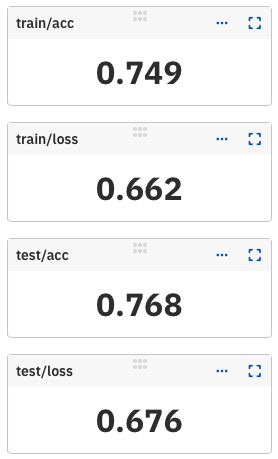

**Last sample of the training accuracy and loss:**

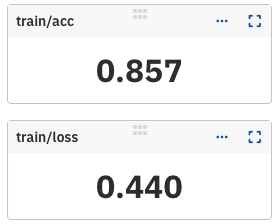

### batch size: $124$

In [ ]:
num_folds = 4

# Initialize the KFold object
kf = KFold(n_splits=num_folds, shuffle=True, random_state=40)


foldNum = 0
foldsMatrix = {}


for train_indices, val_indices in kf.split(idxTrain):


    TrainX_Kfold = np.array([dataset[i][0] for i in idxTrain[train_indices]])
    ValX_Kfold = np.array([dataset[j][0] for j in idxTrain[val_indices]])
    TrainY_Kfold = np.array([dataset[i][1] for i in idxTrain[train_indices]])
    ValY_Kfold = np.array([dataset[j][1] for j in idxTrain[val_indices]])
    ValZ_Kfold = np.array([dataset[j][2] for j in idxTrain[val_indices]])      #ID test of the images
    TrainZ_Kfold = np.array([dataset[i][2] for i in idxTrain[train_indices]])  #ID train of the images

    tensorTrainX_Kfold = torch.tensor(TrainX_Kfold, dtype=torch.float32).to(device)
    tensorValX_Kfold = torch.tensor(ValX_Kfold, dtype=torch.float32).to(device)
    tensorTrainY_Kfold = torch.tensor(TrainY_Kfold, dtype=torch.long).to(device)
    tensorValY_Kfold = torch.tensor(ValY_Kfold, dtype=torch.long).to(device)
    tensorTrainZ_Kfold = torch.tensor(TrainZ_Kfold, dtype=torch.long).to(device)
    tensorValZ_Kfold = torch.tensor(ValZ_Kfold, dtype=torch.long).to(device)

    # Create a TensorDataset object from the data
    tensorDatasetTrain_Kfold = TensorDataset(tensorTrainX_Kfold, tensorTrainY_Kfold, tensorTrainZ_Kfold)
    tensorDatasetVal_Kfold = TensorDataset(tensorValX_Kfold, tensorValY_Kfold, tensorValZ_Kfold)

    # Create a DataLoader object with batch size 124
    trainDataloaderKfold = DataLoader(tensorDatasetTrain_Kfold, batch_size=124, shuffle=True)
    valDataloaderKfold = DataLoader(tensorDatasetVal_Kfold, batch_size=124, shuffle=True)

    print(f"------fold------:{foldNum}")

    run = neptune.init_run(
    project="gihazshay/finalProjectML",
    api_token="eyJhcGlfYWRkcmVzcyI6Imh0dHBzOi8vYXBwLm5lcHR1bmUuYWkiLCJhcGlfdXJsIjoiaHR0cHM6Ly9hcHAubmVwdHVuZS5haSIsImFwaV9rZXkiOiI0Mjc3OWFhMi0zYWI3LTRiMjQtYjFiMC0xMGNkYWU4MjBkOTcifQ==",
    )

    params = {"learning_rate": 0.001, "optimizer": "Adam"}
    run["parameters"] = params

    net = BasicCNN(numLabels=6)
    net = net.to(device)
    criterionBasic = nn.CrossEntropyLoss()
    optimizerBasic = optim.Adam(net.parameters(), lr=0.001)    #net.parameters is the wight of the NN
    trainAcc, trainLoss, valAcc, valLoss = train(net, trainDataloaderKfold, optimizerBasic, 12, criterionBasic, valDataloaderKfold)

    run.stop()
    foldsMatrix[f"fold {foldNum}"] = {'train_acc':trainAcc, 'train_loss':trainLoss,
                                      'val_acc':valAcc, 'val_loss':valLoss}
    foldNum += 1


------fold------:0
[neptune] [info   ] Neptune initialized. Open in the app: https://app.neptune.ai/gihazshay/finalProjectML/e/FIN-399


Epoch 0:   0%|          | 0/88 [00:00<?, ?batch/s]/usr/local/lib/python3.10/dist-packages/torch/autograd/graph.py:744: UserWarning: Plan failed with a cudnnException: CUDNN_BACKEND_EXECUTION_PLAN_DESCRIPTOR: cudnnFinalize Descriptor Failed cudnn_status: CUDNN_STATUS_NOT_SUPPORTED (Triggered internally at ../aten/src/ATen/native/cudnn/Conv_v8.cpp:919.)
  return Variable._execution_engine.run_backward(  # Calls into the C++ engine to run the backward pass
Epoch 0: 100%|██████████| 88/88 [00:01<00:00, 47.75batch/s]


              precision    recall  f1-score   support

           0       0.30      0.52      0.38      1822
           1       0.39      0.19      0.25      1766
           2       0.44      0.42      0.43      1964
           3       0.46      0.16      0.23      1871
           4       0.56      0.62      0.59      1745
           5       0.32      0.46      0.38      1690

    accuracy                           0.39     10858
   macro avg       0.41      0.39      0.38     10858
weighted avg       0.41      0.39      0.38     10858

Validtion part------EPOCH------:0


100%|██████████| 30/30 [00:00<00:00, 103.20batch/s]


              precision    recall  f1-score   support

           0       0.62      0.51      0.56       629
           1       0.48      0.34      0.40       600
           2       0.44      0.67      0.53       617
           3       0.44      0.44      0.44       642
           4       0.86      0.80      0.83       588
           5       0.49      0.50      0.49       544

    accuracy                           0.54      3620
   macro avg       0.56      0.54      0.54      3620
weighted avg       0.55      0.54      0.54      3620



Epoch 1: 100%|██████████| 88/88 [00:01<00:00, 49.50batch/s]


              precision    recall  f1-score   support

           0       0.60      0.65      0.62      1822
           1       0.46      0.35      0.40      1766
           2       0.51      0.60      0.55      1964
           3       0.54      0.49      0.52      1871
           4       0.85      0.86      0.85      1745
           5       0.53      0.55      0.54      1690

    accuracy                           0.58     10858
   macro avg       0.58      0.58      0.58     10858
weighted avg       0.58      0.58      0.58     10858

Validtion part------EPOCH------:1


100%|██████████| 30/30 [00:00<00:00, 102.58batch/s]


              precision    recall  f1-score   support

           0       0.69      0.57      0.63       629
           1       0.48      0.21      0.29       600
           2       0.41      0.81      0.55       617
           3       0.54      0.47      0.50       642
           4       0.90      0.82      0.86       588
           5       0.52      0.51      0.52       544

    accuracy                           0.57      3620
   macro avg       0.59      0.57      0.56      3620
weighted avg       0.59      0.57      0.56      3620



Epoch 2: 100%|██████████| 88/88 [00:01<00:00, 49.05batch/s]


              precision    recall  f1-score   support

           0       0.64      0.70      0.67      1822
           1       0.49      0.35      0.41      1766
           2       0.56      0.63      0.59      1964
           3       0.56      0.60      0.58      1871
           4       0.87      0.86      0.86      1745
           5       0.56      0.57      0.56      1690

    accuracy                           0.62     10858
   macro avg       0.61      0.61      0.61     10858
weighted avg       0.61      0.62      0.61     10858

Validtion part------EPOCH------:2


100%|██████████| 30/30 [00:00<00:00, 104.80batch/s]


              precision    recall  f1-score   support

           0       0.63      0.75      0.68       629
           1       0.44      0.52      0.48       600
           2       0.56      0.58      0.57       617
           3       0.61      0.49      0.54       642
           4       0.88      0.85      0.86       588
           5       0.59      0.47      0.52       544

    accuracy                           0.61      3620
   macro avg       0.62      0.61      0.61      3620
weighted avg       0.62      0.61      0.61      3620



Epoch 3: 100%|██████████| 88/88 [00:01<00:00, 52.45batch/s]


              precision    recall  f1-score   support

           0       0.67      0.73      0.70      1822
           1       0.54      0.44      0.48      1766
           2       0.61      0.63      0.62      1964
           3       0.58      0.62      0.60      1871
           4       0.88      0.88      0.88      1745
           5       0.60      0.59      0.59      1690

    accuracy                           0.65     10858
   macro avg       0.65      0.65      0.65     10858
weighted avg       0.64      0.65      0.64     10858

Validtion part------EPOCH------:3


100%|██████████| 30/30 [00:00<00:00, 119.63batch/s]


              precision    recall  f1-score   support

           0       0.58      0.79      0.67       629
           1       0.49      0.40      0.44       600
           2       0.52      0.67      0.59       617
           3       0.61      0.50      0.55       642
           4       0.93      0.73      0.82       588
           5       0.60      0.54      0.57       544

    accuracy                           0.61      3620
   macro avg       0.62      0.61      0.61      3620
weighted avg       0.62      0.61      0.61      3620



Epoch 4: 100%|██████████| 88/88 [00:01<00:00, 52.91batch/s]


              precision    recall  f1-score   support

           0       0.70      0.76      0.73      1822
           1       0.57      0.47      0.51      1766
           2       0.61      0.66      0.63      1964
           3       0.60      0.63      0.61      1871
           4       0.89      0.88      0.88      1745
           5       0.64      0.61      0.63      1690

    accuracy                           0.67     10858
   macro avg       0.67      0.67      0.67     10858
weighted avg       0.67      0.67      0.66     10858

Validtion part------EPOCH------:4


100%|██████████| 30/30 [00:00<00:00, 120.07batch/s]


              precision    recall  f1-score   support

           0       0.69      0.67      0.68       629
           1       0.60      0.30      0.40       600
           2       0.62      0.60      0.61       617
           3       0.51      0.78      0.61       642
           4       0.86      0.87      0.86       588
           5       0.61      0.59      0.60       544

    accuracy                           0.64      3620
   macro avg       0.65      0.63      0.63      3620
weighted avg       0.65      0.64      0.63      3620



Epoch 5: 100%|██████████| 88/88 [00:01<00:00, 53.89batch/s]


              precision    recall  f1-score   support

           0       0.71      0.76      0.73      1822
           1       0.60      0.49      0.54      1766
           2       0.63      0.65      0.64      1964
           3       0.62      0.68      0.65      1871
           4       0.89      0.88      0.89      1745
           5       0.65      0.64      0.64      1690

    accuracy                           0.68     10858
   macro avg       0.68      0.68      0.68     10858
weighted avg       0.68      0.68      0.68     10858

Validtion part------EPOCH------:5


100%|██████████| 30/30 [00:00<00:00, 119.00batch/s]


              precision    recall  f1-score   support

           0       0.68      0.73      0.71       629
           1       0.50      0.59      0.54       600
           2       0.66      0.41      0.51       617
           3       0.58      0.70      0.63       642
           4       0.87      0.90      0.88       588
           5       0.65      0.56      0.60       544

    accuracy                           0.65      3620
   macro avg       0.66      0.65      0.65      3620
weighted avg       0.66      0.65      0.65      3620



Epoch 6: 100%|██████████| 88/88 [00:01<00:00, 52.72batch/s]


              precision    recall  f1-score   support

           0       0.73      0.76      0.74      1822
           1       0.61      0.54      0.57      1766
           2       0.63      0.63      0.63      1964
           3       0.64      0.69      0.66      1871
           4       0.89      0.89      0.89      1745
           5       0.66      0.66      0.66      1690

    accuracy                           0.69     10858
   macro avg       0.69      0.70      0.69     10858
weighted avg       0.69      0.69      0.69     10858

Validtion part------EPOCH------:6


100%|██████████| 30/30 [00:00<00:00, 117.81batch/s]


              precision    recall  f1-score   support

           0       0.67      0.80      0.73       629
           1       0.55      0.54      0.54       600
           2       0.58      0.64      0.61       617
           3       0.66      0.64      0.65       642
           4       0.90      0.89      0.89       588
           5       0.71      0.53      0.61       544

    accuracy                           0.67      3620
   macro avg       0.68      0.67      0.67      3620
weighted avg       0.68      0.67      0.67      3620



Epoch 7: 100%|██████████| 88/88 [00:01<00:00, 53.12batch/s]


              precision    recall  f1-score   support

           0       0.75      0.78      0.77      1822
           1       0.65      0.59      0.62      1766
           2       0.67      0.67      0.67      1964
           3       0.66      0.71      0.69      1871
           4       0.91      0.90      0.91      1745
           5       0.70      0.69      0.69      1690

    accuracy                           0.72     10858
   macro avg       0.72      0.72      0.72     10858
weighted avg       0.72      0.72      0.72     10858

Validtion part------EPOCH------:7


100%|██████████| 30/30 [00:00<00:00, 119.62batch/s]


              precision    recall  f1-score   support

           0       0.73      0.73      0.73       629
           1       0.70      0.37      0.49       600
           2       0.64      0.56      0.60       617
           3       0.52      0.84      0.64       642
           4       0.89      0.90      0.89       588
           5       0.69      0.63      0.66       544

    accuracy                           0.67      3620
   macro avg       0.69      0.67      0.67      3620
weighted avg       0.69      0.67      0.67      3620



Epoch 8: 100%|██████████| 88/88 [00:01<00:00, 51.32batch/s]


              precision    recall  f1-score   support

           0       0.77      0.79      0.78      1822
           1       0.65      0.61      0.63      1766
           2       0.69      0.68      0.68      1964
           3       0.68      0.73      0.70      1871
           4       0.91      0.91      0.91      1745
           5       0.71      0.71      0.71      1690

    accuracy                           0.74     10858
   macro avg       0.74      0.74      0.74     10858
weighted avg       0.74      0.74      0.74     10858

Validtion part------EPOCH------:8


100%|██████████| 30/30 [00:00<00:00, 106.11batch/s]


              precision    recall  f1-score   support

           0       0.77      0.68      0.72       629
           1       0.65      0.56      0.60       600
           2       0.62      0.66      0.64       617
           3       0.62      0.70      0.66       642
           4       0.88      0.91      0.90       588
           5       0.67      0.68      0.68       544

    accuracy                           0.70      3620
   macro avg       0.70      0.70      0.70      3620
weighted avg       0.70      0.70      0.70      3620



Epoch 9: 100%|██████████| 88/88 [00:01<00:00, 49.45batch/s]


              precision    recall  f1-score   support

           0       0.78      0.80      0.79      1822
           1       0.70      0.65      0.67      1766
           2       0.68      0.70      0.69      1964
           3       0.70      0.73      0.71      1871
           4       0.92      0.91      0.92      1745
           5       0.73      0.72      0.73      1690

    accuracy                           0.75     10858
   macro avg       0.75      0.75      0.75     10858
weighted avg       0.75      0.75      0.75     10858

Validtion part------EPOCH------:9


100%|██████████| 30/30 [00:00<00:00, 103.78batch/s]


              precision    recall  f1-score   support

           0       0.69      0.82      0.75       629
           1       0.60      0.67      0.63       600
           2       0.74      0.48      0.58       617
           3       0.63      0.74      0.68       642
           4       0.89      0.92      0.91       588
           5       0.71      0.58      0.64       544

    accuracy                           0.70      3620
   macro avg       0.71      0.70      0.70      3620
weighted avg       0.71      0.70      0.70      3620



Epoch 10: 100%|██████████| 88/88 [00:01<00:00, 46.43batch/s]


              precision    recall  f1-score   support

           0       0.80      0.83      0.81      1822
           1       0.70      0.66      0.68      1766
           2       0.71      0.70      0.71      1964
           3       0.72      0.76      0.74      1871
           4       0.93      0.93      0.93      1745
           5       0.76      0.74      0.75      1690

    accuracy                           0.77     10858
   macro avg       0.77      0.77      0.77     10858
weighted avg       0.77      0.77      0.77     10858

Validtion part------EPOCH------:10


100%|██████████| 30/30 [00:00<00:00, 99.83batch/s] 


              precision    recall  f1-score   support

           0       0.80      0.69      0.74       629
           1       0.58      0.70      0.63       600
           2       0.71      0.52      0.60       617
           3       0.58      0.75      0.65       642
           4       0.94      0.90      0.92       588
           5       0.70      0.64      0.67       544

    accuracy                           0.70      3620
   macro avg       0.72      0.70      0.70      3620
weighted avg       0.72      0.70      0.70      3620



Epoch 11: 100%|██████████| 88/88 [00:01<00:00, 50.60batch/s]


              precision    recall  f1-score   support

           0       0.82      0.83      0.82      1822
           1       0.73      0.69      0.71      1766
           2       0.72      0.72      0.72      1964
           3       0.72      0.76      0.74      1871
           4       0.94      0.93      0.93      1745
           5       0.78      0.76      0.77      1690

    accuracy                           0.78     10858
   macro avg       0.78      0.78      0.78     10858
weighted avg       0.78      0.78      0.78     10858

Validtion part------EPOCH------:11


100%|██████████| 30/30 [00:00<00:00, 118.04batch/s]


              precision    recall  f1-score   support

           0       0.77      0.76      0.77       629
           1       0.71      0.56      0.63       600
           2       0.64      0.69      0.66       617
           3       0.61      0.77      0.68       642
           4       0.93      0.91      0.92       588
           5       0.73      0.64      0.68       544

    accuracy                           0.72      3620
   macro avg       0.73      0.72      0.72      3620
weighted avg       0.73      0.72      0.72      3620

[neptune] [info   ] Shutting down background jobs, please wait a moment...
[neptune] [info   ] Done!
[neptune] [info   ] Waiting for the remaining 181 operations to synchronize with Neptune. Do not kill this process.
[neptune] [info   ] All 181 operations synced, thanks for waiting!
[neptune] [info   ] Explore the metadata in the Neptune app: https://app.neptune.ai/gihazshay/finalProjectML/e/FIN-399/metadata
------fold------:1
[neptune] [info   ] Neptun

Epoch 0: 100%|██████████| 88/88 [00:01<00:00, 51.26batch/s]


              precision    recall  f1-score   support

           0       0.44      0.66      0.52      1850
           1       0.42      0.15      0.22      1800
           2       0.50      0.40      0.44      1924
           3       0.45      0.62      0.52      1908
           4       0.71      0.63      0.67      1732
           5       0.43      0.43      0.43      1644

    accuracy                           0.48     10858
   macro avg       0.49      0.48      0.47     10858
weighted avg       0.49      0.48      0.47     10858

Validtion part------EPOCH------:0


100%|██████████| 30/30 [00:00<00:00, 117.64batch/s]


              precision    recall  f1-score   support

           0       0.61      0.74      0.67       601
           1       0.55      0.27      0.36       566
           2       0.59      0.64      0.61       657
           3       0.50      0.75      0.60       605
           4       0.93      0.72      0.81       601
           5       0.60      0.53      0.56       590

    accuracy                           0.61      3620
   macro avg       0.63      0.61      0.60      3620
weighted avg       0.63      0.61      0.60      3620



Epoch 1: 100%|██████████| 88/88 [00:01<00:00, 54.01batch/s]


              precision    recall  f1-score   support

           0       0.68      0.72      0.70      1850
           1       0.52      0.41      0.46      1800
           2       0.59      0.62      0.60      1924
           3       0.61      0.66      0.63      1908
           4       0.84      0.82      0.83      1732
           5       0.58      0.60      0.59      1644

    accuracy                           0.64     10858
   macro avg       0.63      0.64      0.63     10858
weighted avg       0.63      0.64      0.63     10858

Validtion part------EPOCH------:1


100%|██████████| 30/30 [00:00<00:00, 120.67batch/s]


              precision    recall  f1-score   support

           0       0.76      0.50      0.60       601
           1       0.62      0.31      0.41       566
           2       0.58      0.66      0.62       657
           3       0.67      0.66      0.66       605
           4       0.67      0.95      0.78       601
           5       0.52      0.66      0.58       590

    accuracy                           0.63      3620
   macro avg       0.64      0.62      0.61      3620
weighted avg       0.64      0.63      0.61      3620



Epoch 2: 100%|██████████| 88/88 [00:01<00:00, 53.04batch/s]


              precision    recall  f1-score   support

           0       0.71      0.75      0.73      1850
           1       0.58      0.52      0.55      1800
           2       0.65      0.62      0.63      1924
           3       0.66      0.70      0.68      1908
           4       0.86      0.84      0.85      1732
           5       0.61      0.63      0.62      1644

    accuracy                           0.68     10858
   macro avg       0.68      0.68      0.68     10858
weighted avg       0.68      0.68      0.68     10858

Validtion part------EPOCH------:2


100%|██████████| 30/30 [00:00<00:00, 121.01batch/s]


              precision    recall  f1-score   support

           0       0.72      0.72      0.72       601
           1       0.74      0.39      0.51       566
           2       0.65      0.66      0.66       657
           3       0.59      0.84      0.70       605
           4       0.83      0.90      0.86       601
           5       0.67      0.63      0.65       590

    accuracy                           0.69      3620
   macro avg       0.70      0.69      0.68      3620
weighted avg       0.70      0.69      0.68      3620



Epoch 3: 100%|██████████| 88/88 [00:01<00:00, 53.88batch/s]


              precision    recall  f1-score   support

           0       0.74      0.76      0.75      1850
           1       0.62      0.57      0.59      1800
           2       0.67      0.65      0.66      1924
           3       0.68      0.72      0.70      1908
           4       0.89      0.87      0.88      1732
           5       0.64      0.67      0.65      1644

    accuracy                           0.70     10858
   macro avg       0.70      0.71      0.70     10858
weighted avg       0.70      0.70      0.70     10858

Validtion part------EPOCH------:3


100%|██████████| 30/30 [00:00<00:00, 120.11batch/s]


              precision    recall  f1-score   support

           0       0.69      0.72      0.71       601
           1       0.58      0.73      0.65       566
           2       0.83      0.48      0.61       657
           3       0.64      0.78      0.71       605
           4       0.97      0.72      0.83       601
           5       0.61      0.74      0.66       590

    accuracy                           0.69      3620
   macro avg       0.72      0.70      0.69      3620
weighted avg       0.72      0.69      0.69      3620



Epoch 4: 100%|██████████| 88/88 [00:01<00:00, 48.53batch/s]


              precision    recall  f1-score   support

           0       0.75      0.78      0.77      1850
           1       0.67      0.63      0.65      1800
           2       0.71      0.67      0.69      1924
           3       0.70      0.75      0.72      1908
           4       0.91      0.88      0.89      1732
           5       0.66      0.70      0.68      1644

    accuracy                           0.73     10858
   macro avg       0.73      0.73      0.73     10858
weighted avg       0.73      0.73      0.73     10858

Validtion part------EPOCH------:4


100%|██████████| 30/30 [00:00<00:00, 104.81batch/s]


              precision    recall  f1-score   support

           0       0.71      0.76      0.73       601
           1       0.74      0.52      0.61       566
           2       0.64      0.76      0.70       657
           3       0.69      0.78      0.73       605
           4       0.83      0.94      0.88       601
           5       0.75      0.56      0.64       590

    accuracy                           0.72      3620
   macro avg       0.73      0.72      0.71      3620
weighted avg       0.72      0.72      0.72      3620



Epoch 5: 100%|██████████| 88/88 [00:01<00:00, 48.42batch/s]


              precision    recall  f1-score   support

           0       0.76      0.79      0.77      1850
           1       0.69      0.66      0.68      1800
           2       0.72      0.70      0.71      1924
           3       0.72      0.76      0.74      1908
           4       0.90      0.88      0.89      1732
           5       0.70      0.72      0.71      1644

    accuracy                           0.75     10858
   macro avg       0.75      0.75      0.75     10858
weighted avg       0.75      0.75      0.75     10858

Validtion part------EPOCH------:5


100%|██████████| 30/30 [00:00<00:00, 103.17batch/s]


              precision    recall  f1-score   support

           0       0.83      0.58      0.68       601
           1       0.79      0.47      0.59       566
           2       0.63      0.80      0.70       657
           3       0.69      0.78      0.73       605
           4       0.81      0.93      0.87       601
           5       0.67      0.74      0.71       590

    accuracy                           0.72      3620
   macro avg       0.74      0.72      0.71      3620
weighted avg       0.73      0.72      0.71      3620



Epoch 6: 100%|██████████| 88/88 [00:01<00:00, 48.33batch/s]


              precision    recall  f1-score   support

           0       0.79      0.79      0.79      1850
           1       0.74      0.70      0.72      1800
           2       0.74      0.72      0.73      1924
           3       0.73      0.77      0.75      1908
           4       0.92      0.90      0.91      1732
           5       0.72      0.75      0.73      1644

    accuracy                           0.77     10858
   macro avg       0.77      0.77      0.77     10858
weighted avg       0.77      0.77      0.77     10858

Validtion part------EPOCH------:6


100%|██████████| 30/30 [00:00<00:00, 121.58batch/s]


              precision    recall  f1-score   support

           0       0.75      0.74      0.75       601
           1       0.77      0.62      0.69       566
           2       0.71      0.76      0.74       657
           3       0.70      0.80      0.75       605
           4       0.96      0.85      0.90       601
           5       0.70      0.76      0.73       590

    accuracy                           0.76      3620
   macro avg       0.77      0.76      0.76      3620
weighted avg       0.76      0.76      0.76      3620



Epoch 7: 100%|██████████| 88/88 [00:01<00:00, 52.37batch/s]


              precision    recall  f1-score   support

           0       0.79      0.82      0.80      1850
           1       0.75      0.71      0.73      1800
           2       0.75      0.74      0.74      1924
           3       0.74      0.77      0.76      1908
           4       0.92      0.90      0.91      1732
           5       0.75      0.75      0.75      1644

    accuracy                           0.78     10858
   macro avg       0.78      0.78      0.78     10858
weighted avg       0.78      0.78      0.78     10858

Validtion part------EPOCH------:7


100%|██████████| 30/30 [00:00<00:00, 116.62batch/s]


              precision    recall  f1-score   support

           0       0.74      0.76      0.75       601
           1       0.64      0.84      0.73       566
           2       0.80      0.69      0.74       657
           3       0.80      0.67      0.73       605
           4       0.94      0.88      0.91       601
           5       0.70      0.75      0.73       590

    accuracy                           0.76      3620
   macro avg       0.77      0.77      0.76      3620
weighted avg       0.77      0.76      0.76      3620



Epoch 8: 100%|██████████| 88/88 [00:01<00:00, 52.65batch/s]


              precision    recall  f1-score   support

           0       0.80      0.82      0.81      1850
           1       0.75      0.72      0.74      1800
           2       0.76      0.74      0.75      1924
           3       0.75      0.77      0.76      1908
           4       0.91      0.90      0.91      1732
           5       0.75      0.76      0.75      1644

    accuracy                           0.78     10858
   macro avg       0.79      0.79      0.79     10858
weighted avg       0.79      0.78      0.78     10858

Validtion part------EPOCH------:8


100%|██████████| 30/30 [00:00<00:00, 118.82batch/s]


              precision    recall  f1-score   support

           0       0.68      0.79      0.73       601
           1       0.68      0.78      0.73       566
           2       0.85      0.59      0.69       657
           3       0.76      0.72      0.74       605
           4       0.96      0.84      0.89       601
           5       0.62      0.76      0.68       590

    accuracy                           0.74      3620
   macro avg       0.76      0.75      0.75      3620
weighted avg       0.76      0.74      0.74      3620



Epoch 9: 100%|██████████| 88/88 [00:01<00:00, 52.35batch/s]


              precision    recall  f1-score   support

           0       0.82      0.84      0.83      1850
           1       0.76      0.74      0.75      1800
           2       0.78      0.76      0.77      1924
           3       0.76      0.78      0.77      1908
           4       0.93      0.92      0.92      1732
           5       0.76      0.77      0.77      1644

    accuracy                           0.80     10858
   macro avg       0.80      0.80      0.80     10858
weighted avg       0.80      0.80      0.80     10858

Validtion part------EPOCH------:9


100%|██████████| 30/30 [00:00<00:00, 119.38batch/s]


              precision    recall  f1-score   support

           0       0.78      0.70      0.73       601
           1       0.74      0.70      0.72       566
           2       0.71      0.79      0.75       657
           3       0.74      0.75      0.75       605
           4       0.81      0.96      0.88       601
           5       0.78      0.64      0.70       590

    accuracy                           0.76      3620
   macro avg       0.76      0.76      0.76      3620
weighted avg       0.76      0.76      0.76      3620



Epoch 10: 100%|██████████| 88/88 [00:01<00:00, 52.65batch/s]


              precision    recall  f1-score   support

           0       0.82      0.85      0.83      1850
           1       0.78      0.76      0.77      1800
           2       0.77      0.76      0.77      1924
           3       0.77      0.79      0.78      1908
           4       0.93      0.92      0.92      1732
           5       0.79      0.79      0.79      1644

    accuracy                           0.81     10858
   macro avg       0.81      0.81      0.81     10858
weighted avg       0.81      0.81      0.81     10858

Validtion part------EPOCH------:10


100%|██████████| 30/30 [00:00<00:00, 117.82batch/s]


              precision    recall  f1-score   support

           0       0.80      0.73      0.76       601
           1       0.65      0.86      0.74       566
           2       0.77      0.70      0.73       657
           3       0.82      0.63      0.71       605
           4       0.94      0.90      0.92       601
           5       0.68      0.79      0.73       590

    accuracy                           0.77      3620
   macro avg       0.78      0.77      0.77      3620
weighted avg       0.78      0.77      0.77      3620



Epoch 11: 100%|██████████| 88/88 [00:01<00:00, 52.54batch/s]


              precision    recall  f1-score   support

           0       0.83      0.86      0.85      1850
           1       0.79      0.78      0.79      1800
           2       0.79      0.77      0.78      1924
           3       0.78      0.81      0.80      1908
           4       0.94      0.93      0.93      1732
           5       0.81      0.81      0.81      1644

    accuracy                           0.82     10858
   macro avg       0.83      0.83      0.83     10858
weighted avg       0.82      0.82      0.82     10858

Validtion part------EPOCH------:11


100%|██████████| 30/30 [00:00<00:00, 103.84batch/s]


              precision    recall  f1-score   support

           0       0.76      0.75      0.76       601
           1       0.84      0.62      0.71       566
           2       0.67      0.84      0.75       657
           3       0.74      0.73      0.74       605
           4       0.88      0.94      0.91       601
           5       0.75      0.69      0.72       590

    accuracy                           0.77      3620
   macro avg       0.77      0.76      0.76      3620
weighted avg       0.77      0.77      0.76      3620

[neptune] [info   ] Shutting down background jobs, please wait a moment...
[neptune] [info   ] Done!
[neptune] [info   ] Waiting for the remaining 18 operations to synchronize with Neptune. Do not kill this process.
[neptune] [info   ] All 18 operations synced, thanks for waiting!
[neptune] [info   ] Explore the metadata in the Neptune app: https://app.neptune.ai/gihazshay/finalProjectML/e/FIN-400/metadata
------fold------:2
[neptune] [info   ] Neptune 

Epoch 0:  97%|█████████▋| 85/88 [00:01<00:00, 47.21batch/s]/usr/local/lib/python3.10/dist-packages/torch/autograd/graph.py:744: UserWarning: Plan failed with a cudnnException: CUDNN_BACKEND_EXECUTION_PLAN_DESCRIPTOR: cudnnFinalize Descriptor Failed cudnn_status: CUDNN_STATUS_NOT_SUPPORTED (Triggered internally at ../aten/src/ATen/native/cudnn/Conv_v8.cpp:919.)
  return Variable._execution_engine.run_backward(  # Calls into the C++ engine to run the backward pass
Epoch 0: 100%|██████████| 88/88 [00:01<00:00, 44.18batch/s]


              precision    recall  f1-score   support

           0       0.48      0.52      0.50      1855
           1       0.33      0.20      0.25      1767
           2       0.50      0.44      0.47      1933
           3       0.46      0.48      0.47      1863
           4       0.63      0.71      0.67      1737
           5       0.34      0.42      0.38      1704

    accuracy                           0.46     10859
   macro avg       0.46      0.46      0.46     10859
weighted avg       0.46      0.46      0.46     10859

Validtion part------EPOCH------:0


100%|██████████| 30/30 [00:00<00:00, 100.18batch/s]


              precision    recall  f1-score   support

           0       0.65      0.64      0.64       596
           1       0.48      0.19      0.27       599
           2       0.70      0.48      0.57       648
           3       0.47      0.78      0.58       650
           4       0.83      0.84      0.84       596
           5       0.48      0.60      0.53       530

    accuracy                           0.59      3619
   macro avg       0.60      0.59      0.57      3619
weighted avg       0.60      0.59      0.57      3619



Epoch 1: 100%|██████████| 88/88 [00:01<00:00, 50.45batch/s]


              precision    recall  f1-score   support

           0       0.65      0.69      0.67      1855
           1       0.48      0.39      0.43      1767
           2       0.58      0.59      0.58      1933
           3       0.55      0.59      0.57      1863
           4       0.85      0.82      0.84      1737
           5       0.53      0.58      0.55      1704

    accuracy                           0.61     10859
   macro avg       0.61      0.61      0.61     10859
weighted avg       0.61      0.61      0.61     10859

Validtion part------EPOCH------:1


100%|██████████| 30/30 [00:00<00:00, 120.80batch/s]


              precision    recall  f1-score   support

           0       0.64      0.74      0.69       596
           1       0.67      0.20      0.31       599
           2       0.68      0.54      0.60       648
           3       0.50      0.75      0.60       650
           4       0.84      0.88      0.86       596
           5       0.49      0.59      0.53       530

    accuracy                           0.62      3619
   macro avg       0.64      0.62      0.60      3619
weighted avg       0.64      0.62      0.60      3619



Epoch 2: 100%|██████████| 88/88 [00:01<00:00, 53.02batch/s]


              precision    recall  f1-score   support

           0       0.67      0.69      0.68      1855
           1       0.54      0.40      0.46      1767
           2       0.60      0.62      0.61      1933
           3       0.57      0.62      0.60      1863
           4       0.86      0.83      0.85      1737
           5       0.56      0.62      0.59      1704

    accuracy                           0.63     10859
   macro avg       0.63      0.63      0.63     10859
weighted avg       0.63      0.63      0.63     10859

Validtion part------EPOCH------:2


100%|██████████| 30/30 [00:00<00:00, 120.61batch/s]


              precision    recall  f1-score   support

           0       0.61      0.69      0.65       596
           1       0.61      0.34      0.43       599
           2       0.58      0.71      0.64       648
           3       0.68      0.53      0.60       650
           4       0.77      0.92      0.84       596
           5       0.52      0.59      0.56       530

    accuracy                           0.63      3619
   macro avg       0.63      0.63      0.62      3619
weighted avg       0.63      0.63      0.62      3619



Epoch 3: 100%|██████████| 88/88 [00:01<00:00, 53.56batch/s]


              precision    recall  f1-score   support

           0       0.72      0.74      0.73      1855
           1       0.59      0.48      0.53      1767
           2       0.64      0.65      0.65      1933
           3       0.62      0.66      0.64      1863
           4       0.89      0.85      0.87      1737
           5       0.59      0.65      0.62      1704

    accuracy                           0.67     10859
   macro avg       0.67      0.67      0.67     10859
weighted avg       0.67      0.67      0.67     10859

Validtion part------EPOCH------:3


100%|██████████| 30/30 [00:00<00:00, 120.09batch/s]


              precision    recall  f1-score   support

           0       0.70      0.74      0.72       596
           1       0.66      0.52      0.58       599
           2       0.65      0.68      0.66       648
           3       0.61      0.75      0.68       650
           4       0.94      0.81      0.87       596
           5       0.62      0.63      0.63       530

    accuracy                           0.69      3619
   macro avg       0.70      0.69      0.69      3619
weighted avg       0.70      0.69      0.69      3619



Epoch 4: 100%|██████████| 88/88 [00:01<00:00, 52.37batch/s]


              precision    recall  f1-score   support

           0       0.73      0.75      0.74      1855
           1       0.64      0.53      0.58      1767
           2       0.67      0.67      0.67      1933
           3       0.64      0.70      0.67      1863
           4       0.90      0.87      0.88      1737
           5       0.64      0.69      0.66      1704

    accuracy                           0.70     10859
   macro avg       0.70      0.70      0.70     10859
weighted avg       0.70      0.70      0.70     10859

Validtion part------EPOCH------:4


100%|██████████| 30/30 [00:00<00:00, 119.55batch/s]


              precision    recall  f1-score   support

           0       0.67      0.80      0.73       596
           1       0.66      0.56      0.61       599
           2       0.59      0.75      0.66       648
           3       0.68      0.67      0.67       650
           4       0.84      0.90      0.87       596
           5       0.80      0.45      0.57       530

    accuracy                           0.69      3619
   macro avg       0.71      0.69      0.69      3619
weighted avg       0.70      0.69      0.69      3619



Epoch 5: 100%|██████████| 88/88 [00:01<00:00, 52.95batch/s]


              precision    recall  f1-score   support

           0       0.75      0.77      0.76      1855
           1       0.67      0.58      0.63      1767
           2       0.70      0.67      0.68      1933
           3       0.65      0.72      0.69      1863
           4       0.90      0.88      0.89      1737
           5       0.67      0.70      0.69      1704

    accuracy                           0.72     10859
   macro avg       0.72      0.72      0.72     10859
weighted avg       0.72      0.72      0.72     10859

Validtion part------EPOCH------:5


100%|██████████| 30/30 [00:00<00:00, 116.76batch/s]


              precision    recall  f1-score   support

           0       0.77      0.63      0.70       596
           1       0.64      0.70      0.67       599
           2       0.73      0.67      0.70       648
           3       0.75      0.68      0.71       650
           4       0.94      0.83      0.88       596
           5       0.55      0.80      0.66       530

    accuracy                           0.72      3619
   macro avg       0.73      0.72      0.72      3619
weighted avg       0.73      0.72      0.72      3619



Epoch 6: 100%|██████████| 88/88 [00:01<00:00, 51.14batch/s]


              precision    recall  f1-score   support

           0       0.77      0.77      0.77      1855
           1       0.70      0.63      0.67      1767
           2       0.72      0.70      0.71      1933
           3       0.69      0.74      0.71      1863
           4       0.91      0.90      0.90      1737
           5       0.70      0.74      0.72      1704

    accuracy                           0.75     10859
   macro avg       0.75      0.75      0.75     10859
weighted avg       0.75      0.75      0.74     10859

Validtion part------EPOCH------:6


100%|██████████| 30/30 [00:00<00:00, 97.89batch/s]


              precision    recall  f1-score   support

           0       0.71      0.82      0.76       596
           1       0.71      0.67      0.69       599
           2       0.78      0.64      0.70       648
           3       0.67      0.80      0.73       650
           4       0.91      0.90      0.91       596
           5       0.73      0.65      0.69       530

    accuracy                           0.75      3619
   macro avg       0.75      0.75      0.75      3619
weighted avg       0.75      0.75      0.75      3619



Epoch 7: 100%|██████████| 88/88 [00:01<00:00, 48.89batch/s]


              precision    recall  f1-score   support

           0       0.78      0.80      0.79      1855
           1       0.71      0.65      0.68      1767
           2       0.72      0.71      0.72      1933
           3       0.69      0.74      0.71      1863
           4       0.92      0.90      0.91      1737
           5       0.73      0.74      0.73      1704

    accuracy                           0.76     10859
   macro avg       0.76      0.76      0.76     10859
weighted avg       0.76      0.76      0.76     10859

Validtion part------EPOCH------:7


100%|██████████| 30/30 [00:00<00:00, 99.93batch/s]


              precision    recall  f1-score   support

           0       0.68      0.84      0.75       596
           1       0.79      0.57      0.66       599
           2       0.68      0.75      0.72       648
           3       0.68      0.79      0.73       650
           4       0.87      0.92      0.89       596
           5       0.80      0.51      0.62       530

    accuracy                           0.74      3619
   macro avg       0.75      0.73      0.73      3619
weighted avg       0.75      0.74      0.73      3619



Epoch 8: 100%|██████████| 88/88 [00:01<00:00, 48.99batch/s]


              precision    recall  f1-score   support

           0       0.78      0.80      0.79      1855
           1       0.72      0.67      0.69      1767
           2       0.73      0.72      0.72      1933
           3       0.70      0.74      0.72      1863
           4       0.91      0.91      0.91      1737
           5       0.72      0.74      0.73      1704

    accuracy                           0.76     10859
   macro avg       0.76      0.76      0.76     10859
weighted avg       0.76      0.76      0.76     10859

Validtion part------EPOCH------:8


100%|██████████| 30/30 [00:00<00:00, 101.78batch/s]


              precision    recall  f1-score   support

           0       0.76      0.76      0.76       596
           1       0.76      0.65      0.70       599
           2       0.79      0.64      0.71       648
           3       0.62      0.84      0.72       650
           4       0.87      0.92      0.90       596
           5       0.73      0.66      0.69       530

    accuracy                           0.75      3619
   macro avg       0.76      0.75      0.75      3619
weighted avg       0.75      0.75      0.75      3619



Epoch 9: 100%|██████████| 88/88 [00:01<00:00, 46.54batch/s]


              precision    recall  f1-score   support

           0       0.80      0.81      0.80      1855
           1       0.75      0.69      0.72      1767
           2       0.75      0.73      0.74      1933
           3       0.70      0.76      0.73      1863
           4       0.92      0.91      0.92      1737
           5       0.74      0.77      0.76      1704

    accuracy                           0.78     10859
   macro avg       0.78      0.78      0.78     10859
weighted avg       0.78      0.78      0.78     10859

Validtion part------EPOCH------:9


100%|██████████| 30/30 [00:00<00:00, 115.24batch/s]


              precision    recall  f1-score   support

           0       0.74      0.78      0.76       596
           1       0.74      0.68      0.71       599
           2       0.72      0.75      0.73       648
           3       0.69      0.77      0.73       650
           4       0.91      0.91      0.91       596
           5       0.74      0.63      0.68       530

    accuracy                           0.75      3619
   macro avg       0.76      0.75      0.75      3619
weighted avg       0.76      0.75      0.75      3619



Epoch 10: 100%|██████████| 88/88 [00:01<00:00, 52.28batch/s]


              precision    recall  f1-score   support

           0       0.81      0.82      0.82      1855
           1       0.76      0.71      0.74      1767
           2       0.77      0.75      0.76      1933
           3       0.72      0.78      0.75      1863
           4       0.93      0.91      0.92      1737
           5       0.76      0.77      0.77      1704

    accuracy                           0.79     10859
   macro avg       0.79      0.79      0.79     10859
weighted avg       0.79      0.79      0.79     10859

Validtion part------EPOCH------:10


100%|██████████| 30/30 [00:00<00:00, 115.97batch/s]


              precision    recall  f1-score   support

           0       0.78      0.69      0.73       596
           1       0.75      0.68      0.71       599
           2       0.71      0.75      0.73       648
           3       0.69      0.77      0.73       650
           4       0.79      0.96      0.86       596
           5       0.77      0.59      0.67       530

    accuracy                           0.74      3619
   macro avg       0.75      0.74      0.74      3619
weighted avg       0.74      0.74      0.74      3619



Epoch 11: 100%|██████████| 88/88 [00:01<00:00, 52.58batch/s]


              precision    recall  f1-score   support

           0       0.82      0.82      0.82      1855
           1       0.76      0.73      0.74      1767
           2       0.76      0.74      0.75      1933
           3       0.72      0.76      0.74      1863
           4       0.92      0.91      0.92      1737
           5       0.77      0.79      0.78      1704

    accuracy                           0.79     10859
   macro avg       0.79      0.79      0.79     10859
weighted avg       0.79      0.79      0.79     10859

Validtion part------EPOCH------:11


100%|██████████| 30/30 [00:00<00:00, 114.53batch/s]


              precision    recall  f1-score   support

           0       0.72      0.82      0.77       596
           1       0.77      0.70      0.73       599
           2       0.71      0.75      0.73       648
           3       0.78      0.64      0.70       650
           4       0.88      0.92      0.90       596
           5       0.67      0.70      0.69       530

    accuracy                           0.76      3619
   macro avg       0.76      0.76      0.75      3619
weighted avg       0.76      0.76      0.75      3619

[neptune] [info   ] Shutting down background jobs, please wait a moment...
[neptune] [info   ] Done!
[neptune] [info   ] Waiting for the remaining 48 operations to synchronize with Neptune. Do not kill this process.
[neptune] [info   ] All 48 operations synced, thanks for waiting!
[neptune] [info   ] Explore the metadata in the Neptune app: https://app.neptune.ai/gihazshay/finalProjectML/e/FIN-401/metadata
------fold------:3
[neptune] [info   ] Neptune 

Epoch 0: 100%|██████████| 88/88 [00:01<00:00, 50.18batch/s]


              precision    recall  f1-score   support

           0       0.46      0.60      0.52      1826
           1       0.36      0.31      0.33      1765
           2       0.50      0.35      0.41      1922
           3       0.49      0.53      0.51      1897
           4       0.76      0.69      0.72      1785
           5       0.39      0.46      0.42      1664

    accuracy                           0.49     10859
   macro avg       0.49      0.49      0.49     10859
weighted avg       0.50      0.49      0.49     10859

Validtion part------EPOCH------:0


100%|██████████| 30/30 [00:00<00:00, 118.92batch/s]


              precision    recall  f1-score   support

           0       0.62      0.77      0.69       625
           1       0.61      0.15      0.24       601
           2       0.57      0.59      0.58       659
           3       0.54      0.76      0.63       616
           4       0.84      0.86      0.85       548
           5       0.53      0.55      0.54       570

    accuracy                           0.61      3619
   macro avg       0.62      0.61      0.59      3619
weighted avg       0.62      0.61      0.59      3619



Epoch 1: 100%|██████████| 88/88 [00:01<00:00, 53.41batch/s]


              precision    recall  f1-score   support

           0       0.70      0.73      0.71      1826
           1       0.51      0.36      0.43      1765
           2       0.59      0.58      0.58      1922
           3       0.58      0.71      0.64      1897
           4       0.88      0.86      0.87      1785
           5       0.58      0.61      0.59      1664

    accuracy                           0.64     10859
   macro avg       0.64      0.64      0.64     10859
weighted avg       0.64      0.64      0.64     10859

Validtion part------EPOCH------:1


100%|██████████| 30/30 [00:00<00:00, 119.29batch/s]


              precision    recall  f1-score   support

           0       0.67      0.82      0.74       625
           1       0.60      0.35      0.44       601
           2       0.59      0.72      0.65       659
           3       0.65      0.75      0.69       616
           4       0.87      0.90      0.88       548
           5       0.71      0.54      0.61       570

    accuracy                           0.68      3619
   macro avg       0.68      0.68      0.67      3619
weighted avg       0.68      0.68      0.67      3619



Epoch 2: 100%|██████████| 88/88 [00:01<00:00, 51.24batch/s]


              precision    recall  f1-score   support

           0       0.72      0.74      0.73      1826
           1       0.53      0.38      0.44      1765
           2       0.58      0.63      0.61      1922
           3       0.62      0.71      0.66      1897
           4       0.88      0.87      0.87      1785
           5       0.64      0.66      0.65      1664

    accuracy                           0.67     10859
   macro avg       0.66      0.67      0.66     10859
weighted avg       0.66      0.67      0.66     10859

Validtion part------EPOCH------:2


100%|██████████| 30/30 [00:00<00:00, 103.86batch/s]


              precision    recall  f1-score   support

           0       0.67      0.84      0.75       625
           1       0.58      0.36      0.44       601
           2       0.74      0.50      0.59       659
           3       0.59      0.81      0.68       616
           4       0.90      0.90      0.90       548
           5       0.60      0.66      0.63       570

    accuracy                           0.67      3619
   macro avg       0.68      0.68      0.67      3619
weighted avg       0.68      0.67      0.66      3619



Epoch 3: 100%|██████████| 88/88 [00:01<00:00, 47.46batch/s]


              precision    recall  f1-score   support

           0       0.75      0.76      0.75      1826
           1       0.56      0.45      0.50      1765
           2       0.61      0.64      0.63      1922
           3       0.66      0.72      0.69      1897
           4       0.90      0.89      0.89      1785
           5       0.68      0.71      0.70      1664

    accuracy                           0.70     10859
   macro avg       0.69      0.70      0.69     10859
weighted avg       0.69      0.70      0.69     10859

Validtion part------EPOCH------:3


100%|██████████| 30/30 [00:00<00:00, 104.31batch/s]


              precision    recall  f1-score   support

           0       0.75      0.78      0.76       625
           1       0.58      0.45      0.50       601
           2       0.66      0.63      0.64       659
           3       0.68      0.81      0.74       616
           4       0.94      0.85      0.89       548
           5       0.69      0.76      0.73       570

    accuracy                           0.71      3619
   macro avg       0.71      0.71      0.71      3619
weighted avg       0.71      0.71      0.71      3619



Epoch 4: 100%|██████████| 88/88 [00:01<00:00, 47.03batch/s]


              precision    recall  f1-score   support

           0       0.76      0.78      0.77      1826
           1       0.59      0.50      0.54      1765
           2       0.63      0.66      0.65      1922
           3       0.70      0.74      0.72      1897
           4       0.92      0.90      0.91      1785
           5       0.73      0.74      0.73      1664

    accuracy                           0.72     10859
   macro avg       0.72      0.72      0.72     10859
weighted avg       0.72      0.72      0.72     10859

Validtion part------EPOCH------:4


100%|██████████| 30/30 [00:00<00:00, 98.33batch/s]


              precision    recall  f1-score   support

           0       0.67      0.86      0.75       625
           1       0.59      0.57      0.58       601
           2       0.77      0.49      0.60       659
           3       0.65      0.84      0.73       616
           4       0.93      0.88      0.90       548
           5       0.73      0.64      0.68       570

    accuracy                           0.71      3619
   macro avg       0.72      0.71      0.71      3619
weighted avg       0.72      0.71      0.70      3619



Epoch 5: 100%|██████████| 88/88 [00:01<00:00, 48.69batch/s]


              precision    recall  f1-score   support

           0       0.78      0.80      0.79      1826
           1       0.65      0.60      0.62      1765
           2       0.68      0.69      0.68      1922
           3       0.72      0.75      0.74      1897
           4       0.92      0.91      0.91      1785
           5       0.75      0.76      0.76      1664

    accuracy                           0.75     10859
   macro avg       0.75      0.75      0.75     10859
weighted avg       0.75      0.75      0.75     10859

Validtion part------EPOCH------:5


100%|██████████| 30/30 [00:00<00:00, 121.11batch/s]


              precision    recall  f1-score   support

           0       0.76      0.76      0.76       625
           1       0.68      0.39      0.50       601
           2       0.61      0.78      0.68       659
           3       0.69      0.82      0.75       616
           4       0.78      0.96      0.86       548
           5       0.83      0.57      0.68       570

    accuracy                           0.71      3619
   macro avg       0.72      0.71      0.70      3619
weighted avg       0.72      0.71      0.70      3619



Epoch 6: 100%|██████████| 88/88 [00:01<00:00, 51.32batch/s]


              precision    recall  f1-score   support

           0       0.78      0.81      0.79      1826
           1       0.68      0.61      0.64      1765
           2       0.68      0.70      0.69      1922
           3       0.74      0.77      0.75      1897
           4       0.92      0.91      0.92      1785
           5       0.75      0.75      0.75      1664

    accuracy                           0.76     10859
   macro avg       0.76      0.76      0.76     10859
weighted avg       0.76      0.76      0.76     10859

Validtion part------EPOCH------:6


100%|██████████| 30/30 [00:00<00:00, 121.07batch/s]


              precision    recall  f1-score   support

           0       0.71      0.85      0.78       625
           1       0.76      0.51      0.61       601
           2       0.71      0.73      0.72       659
           3       0.70      0.81      0.75       616
           4       0.93      0.88      0.91       548
           5       0.73      0.71      0.72       570

    accuracy                           0.75      3619
   macro avg       0.76      0.75      0.75      3619
weighted avg       0.75      0.75      0.75      3619



Epoch 7: 100%|██████████| 88/88 [00:01<00:00, 53.00batch/s]


              precision    recall  f1-score   support

           0       0.81      0.82      0.81      1826
           1       0.72      0.66      0.69      1765
           2       0.70      0.73      0.71      1922
           3       0.75      0.77      0.76      1897
           4       0.93      0.92      0.92      1785
           5       0.79      0.79      0.79      1664

    accuracy                           0.78     10859
   macro avg       0.78      0.78      0.78     10859
weighted avg       0.78      0.78      0.78     10859

Validtion part------EPOCH------:7


100%|██████████| 30/30 [00:00<00:00, 118.83batch/s]


              precision    recall  f1-score   support

           0       0.66      0.89      0.76       625
           1       0.70      0.65      0.67       601
           2       0.75      0.64      0.69       659
           3       0.66      0.86      0.75       616
           4       0.95      0.84      0.89       548
           5       0.83      0.55      0.66       570

    accuracy                           0.74      3619
   macro avg       0.76      0.74      0.74      3619
weighted avg       0.75      0.74      0.74      3619



Epoch 8: 100%|██████████| 88/88 [00:01<00:00, 52.95batch/s]


              precision    recall  f1-score   support

           0       0.80      0.82      0.81      1826
           1       0.73      0.66      0.70      1765
           2       0.70      0.74      0.72      1922
           3       0.76      0.77      0.76      1897
           4       0.92      0.92      0.92      1785
           5       0.78      0.78      0.78      1664

    accuracy                           0.78     10859
   macro avg       0.78      0.78      0.78     10859
weighted avg       0.78      0.78      0.78     10859

Validtion part------EPOCH------:8


100%|██████████| 30/30 [00:00<00:00, 119.92batch/s]


              precision    recall  f1-score   support

           0       0.67      0.89      0.77       625
           1       0.72      0.65      0.68       601
           2       0.77      0.63      0.69       659
           3       0.65      0.88      0.75       616
           4       0.95      0.84      0.89       548
           5       0.83      0.59      0.69       570

    accuracy                           0.74      3619
   macro avg       0.77      0.75      0.75      3619
weighted avg       0.76      0.74      0.74      3619



Epoch 9: 100%|██████████| 88/88 [00:01<00:00, 52.55batch/s]


              precision    recall  f1-score   support

           0       0.82      0.83      0.82      1826
           1       0.74      0.68      0.71      1765
           2       0.71      0.74      0.73      1922
           3       0.75      0.78      0.77      1897
           4       0.93      0.93      0.93      1785
           5       0.78      0.78      0.78      1664

    accuracy                           0.79     10859
   macro avg       0.79      0.79      0.79     10859
weighted avg       0.79      0.79      0.79     10859

Validtion part------EPOCH------:9


100%|██████████| 30/30 [00:00<00:00, 119.13batch/s]


              precision    recall  f1-score   support

           0       0.78      0.80      0.79       625
           1       0.81      0.56      0.66       601
           2       0.69      0.81      0.75       659
           3       0.75      0.78      0.77       616
           4       0.87      0.95      0.91       548
           5       0.75      0.72      0.74       570

    accuracy                           0.77      3619
   macro avg       0.78      0.77      0.77      3619
weighted avg       0.77      0.77      0.77      3619



Epoch 10: 100%|██████████| 88/88 [00:01<00:00, 51.64batch/s]


              precision    recall  f1-score   support

           0       0.82      0.83      0.83      1826
           1       0.76      0.68      0.72      1765
           2       0.71      0.75      0.73      1922
           3       0.76      0.78      0.77      1897
           4       0.93      0.93      0.93      1785
           5       0.80      0.80      0.80      1664

    accuracy                           0.79     10859
   macro avg       0.80      0.80      0.80     10859
weighted avg       0.80      0.79      0.79     10859

Validtion part------EPOCH------:10


100%|██████████| 30/30 [00:00<00:00, 104.71batch/s]


              precision    recall  f1-score   support

           0       0.83      0.76      0.79       625
           1       0.64      0.75      0.69       601
           2       0.68      0.76      0.72       659
           3       0.89      0.56      0.69       616
           4       0.90      0.95      0.92       548
           5       0.69      0.79      0.74       570

    accuracy                           0.76      3619
   macro avg       0.77      0.76      0.76      3619
weighted avg       0.77      0.76      0.75      3619



Epoch 11: 100%|██████████| 88/88 [00:01<00:00, 49.68batch/s]


              precision    recall  f1-score   support

           0       0.82      0.84      0.83      1826
           1       0.74      0.68      0.71      1765
           2       0.72      0.75      0.73      1922
           3       0.77      0.78      0.77      1897
           4       0.93      0.92      0.93      1785
           5       0.79      0.79      0.79      1664

    accuracy                           0.79     10859
   macro avg       0.79      0.79      0.79     10859
weighted avg       0.79      0.79      0.79     10859

Validtion part------EPOCH------:11


100%|██████████| 30/30 [00:00<00:00, 105.95batch/s]


              precision    recall  f1-score   support

           0       0.72      0.83      0.77       625
           1       0.75      0.52      0.62       601
           2       0.67      0.76      0.71       659
           3       0.65      0.88      0.75       616
           4       0.87      0.95      0.90       548
           5       0.86      0.46      0.60       570

    accuracy                           0.73      3619
   macro avg       0.75      0.73      0.72      3619
weighted avg       0.75      0.73      0.72      3619

[neptune] [info   ] Shutting down background jobs, please wait a moment...
[neptune] [info   ] Done!
[neptune] [info   ] Waiting for the remaining 359 operations to synchronize with Neptune. Do not kill this process.
[neptune] [info   ] All 359 operations synced, thanks for waiting!
[neptune] [info   ] Explore the metadata in the Neptune app: https://app.neptune.ai/gihazshay/finalProjectML/e/FIN-402/metadata


In [ ]:
net = BasicCNN(numLabels=6)
net = net.to(device)
criterionBasic = nn.CrossEntropyLoss()
optimizerBasic = optim.Adam(net.parameters(), lr=0.001)    #net.parameters is the wight of the NN

run = neptune.init_run(
    project="gihazshay/finalProjectML",
    api_token="eyJhcGlfYWRkcmVzcyI6Imh0dHBzOi8vYXBwLm5lcHR1bmUuYWkiLCJhcGlfdXJsIjoiaHR0cHM6Ly9hcHAubmVwdHVuZS5haSIsImFwaV9rZXkiOiI0Mjc3OWFhMi0zYWI3LTRiMjQtYjFiMC0xMGNkYWU4MjBkOTcifQ==",
)

params = {"learning_rate": 0.001, "optimizer": "Adam"}
run["parameters"] = params

trainModel = train(net, trainDataloader, optimizerBasic, 12, criterionBasic)
testAcc, testLoss = test(net, testDataloader, criterionBasic)

run.stop()

[neptune] [info   ] Neptune initialized. Open in the app: https://app.neptune.ai/gihazshay/finalProjectML/e/FIN-403


Epoch 0: 100%|██████████| 453/453 [00:04<00:00, 91.19batch/s]


              precision    recall  f1-score   support

           0       0.61      0.61      0.61      2451
           1       0.52      0.42      0.46      2366
           2       0.55      0.48      0.52      2581
           3       0.53      0.66      0.59      2513
           4       0.74      0.80      0.77      2333
           5       0.49      0.47      0.48      2234

    accuracy                           0.58     14478
   macro avg       0.57      0.58      0.57     14478
weighted avg       0.57      0.58      0.57     14478



Epoch 1: 100%|██████████| 453/453 [00:04<00:00, 92.84batch/s]


              precision    recall  f1-score   support

           0       0.71      0.73      0.72      2451
           1       0.64      0.62      0.63      2366
           2       0.65      0.61      0.63      2581
           3       0.69      0.75      0.72      2513
           4       0.89      0.86      0.87      2333
           5       0.65      0.68      0.66      2234

    accuracy                           0.70     14478
   macro avg       0.71      0.71      0.71     14478
weighted avg       0.71      0.70      0.70     14478



Epoch 2: 100%|██████████| 453/453 [00:05<00:00, 78.73batch/s]


              precision    recall  f1-score   support

           0       0.74      0.76      0.75      2451
           1       0.70      0.67      0.68      2366
           2       0.68      0.68      0.68      2581
           3       0.74      0.75      0.74      2513
           4       0.90      0.88      0.89      2333
           5       0.69      0.70      0.70      2234

    accuracy                           0.74     14478
   macro avg       0.74      0.74      0.74     14478
weighted avg       0.74      0.74      0.74     14478



Epoch 3: 100%|██████████| 453/453 [00:04<00:00, 93.89batch/s]


              precision    recall  f1-score   support

           0       0.77      0.79      0.78      2451
           1       0.74      0.72      0.73      2366
           2       0.71      0.71      0.71      2581
           3       0.75      0.76      0.76      2513
           4       0.91      0.90      0.91      2333
           5       0.73      0.73      0.73      2234

    accuracy                           0.77     14478
   macro avg       0.77      0.77      0.77     14478
weighted avg       0.77      0.77      0.77     14478



Epoch 4: 100%|██████████| 453/453 [00:04<00:00, 95.01batch/s]


              precision    recall  f1-score   support

           0       0.79      0.80      0.79      2451
           1       0.77      0.76      0.76      2366
           2       0.73      0.74      0.74      2581
           3       0.77      0.77      0.77      2513
           4       0.92      0.91      0.92      2333
           5       0.75      0.75      0.75      2234

    accuracy                           0.79     14478
   macro avg       0.79      0.79      0.79     14478
weighted avg       0.79      0.79      0.79     14478



Epoch 5: 100%|██████████| 453/453 [00:05<00:00, 79.19batch/s]


              precision    recall  f1-score   support

           0       0.79      0.80      0.80      2451
           1       0.77      0.75      0.76      2366
           2       0.74      0.75      0.75      2581
           3       0.77      0.77      0.77      2513
           4       0.91      0.91      0.91      2333
           5       0.76      0.77      0.76      2234

    accuracy                           0.79     14478
   macro avg       0.79      0.79      0.79     14478
weighted avg       0.79      0.79      0.79     14478



Epoch 6: 100%|██████████| 453/453 [00:05<00:00, 89.96batch/s]


              precision    recall  f1-score   support

           0       0.81      0.81      0.81      2451
           1       0.79      0.78      0.79      2366
           2       0.75      0.77      0.76      2581
           3       0.79      0.77      0.78      2513
           4       0.92      0.92      0.92      2333
           5       0.77      0.78      0.77      2234

    accuracy                           0.80     14478
   macro avg       0.80      0.80      0.80     14478
weighted avg       0.80      0.80      0.80     14478



Epoch 7: 100%|██████████| 453/453 [00:04<00:00, 95.43batch/s]


              precision    recall  f1-score   support

           0       0.82      0.83      0.83      2451
           1       0.81      0.79      0.80      2366
           2       0.77      0.79      0.78      2581
           3       0.80      0.79      0.80      2513
           4       0.93      0.92      0.93      2333
           5       0.77      0.79      0.78      2234

    accuracy                           0.82     14478
   macro avg       0.82      0.82      0.82     14478
weighted avg       0.82      0.82      0.82     14478



Epoch 8: 100%|██████████| 453/453 [00:05<00:00, 87.64batch/s]


              precision    recall  f1-score   support

           0       0.83      0.83      0.83      2451
           1       0.82      0.81      0.81      2366
           2       0.77      0.79      0.78      2581
           3       0.80      0.79      0.79      2513
           4       0.93      0.93      0.93      2333
           5       0.80      0.80      0.80      2234

    accuracy                           0.82     14478
   macro avg       0.82      0.82      0.82     14478
weighted avg       0.82      0.82      0.82     14478



Epoch 9: 100%|██████████| 453/453 [00:05<00:00, 80.93batch/s]


              precision    recall  f1-score   support

           0       0.83      0.86      0.84      2451
           1       0.82      0.81      0.81      2366
           2       0.78      0.80      0.79      2581
           3       0.81      0.79      0.80      2513
           4       0.93      0.93      0.93      2333
           5       0.81      0.80      0.80      2234

    accuracy                           0.83     14478
   macro avg       0.83      0.83      0.83     14478
weighted avg       0.83      0.83      0.83     14478



Epoch 10: 100%|██████████| 453/453 [00:04<00:00, 94.88batch/s]


              precision    recall  f1-score   support

           0       0.85      0.86      0.85      2451
           1       0.83      0.82      0.82      2366
           2       0.79      0.82      0.81      2581
           3       0.82      0.79      0.81      2513
           4       0.94      0.94      0.94      2333
           5       0.82      0.81      0.82      2234

    accuracy                           0.84     14478
   macro avg       0.84      0.84      0.84     14478
weighted avg       0.84      0.84      0.84     14478



Epoch 11: 100%|██████████| 453/453 [00:05<00:00, 90.48batch/s]


              precision    recall  f1-score   support

           0       0.85      0.86      0.86      2451
           1       0.83      0.83      0.83      2366
           2       0.79      0.81      0.80      2581
           3       0.82      0.79      0.80      2513
           4       0.94      0.94      0.94      2333
           5       0.84      0.83      0.83      2234

    accuracy                           0.84     14478
   macro avg       0.85      0.85      0.85     14478
weighted avg       0.84      0.84      0.84     14478



100%|██████████| 80/80 [00:00<00:00, 119.37batch/s]


              precision    recall  f1-score   support

           0       0.79      0.80      0.80       432
           1       0.77      0.71      0.74       418
           2       0.68      0.80      0.74       456
           3       0.82      0.71      0.76       444
           4       0.93      0.91      0.92       412
           5       0.75      0.79      0.77       394

    accuracy                           0.79      2556
   macro avg       0.79      0.79      0.79      2556
weighted avg       0.79      0.79      0.79      2556

[neptune] [info   ] Shutting down background jobs, please wait a moment...
[neptune] [info   ] Done!
[neptune] [info   ] Waiting for the remaining 9 operations to synchronize with Neptune. Do not kill this process.
[neptune] [info   ] All 9 operations synced, thanks for waiting!
[neptune] [info   ] Explore the metadata in the Neptune app: https://app.neptune.ai/gihazshay/finalProjectML/e/FIN-403/metadata


**Average accuracy and loss:**

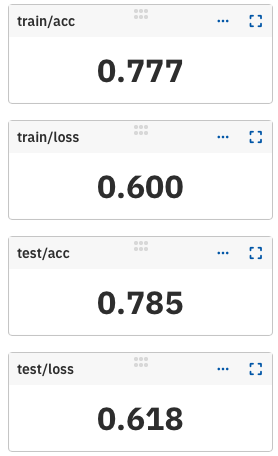

**Last sample of the training accuracy and loss:**

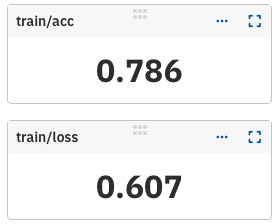

***The differences are not significant at all, so we will choose to continue with a batch size of 32! It's also more memory-efficient, considering our limited resources.***


---



## Optimizer

Optimizers play a crucial role in training NN by adjusting the model's parameters to minimize the loss function. Different optimizers use various strategies to navigate the loss landscape and find the optimal weights for the model.

Until now, we have been using the Adam optimizer. Adam combines the advantages of two other extensions of SGD optimiter: AdaGrad and RMSprop as we learn in the course.

Next, we will try the RMSprop optimizer. RMSprop is designed to adapt the learning rate for each parameter by dividing the gradient by a running average of the magnitudes of recent gradients.

We will also try SGD with momentum. SGD updates the model parameters based on the gradient of the loss function with respect to a single training example.



**Expectations:**

We expect that Adam will perform the best among these optimizers.


### RMSprop

In [ ]:
num_folds = 4
# Initialize the KFold object
kf = KFold(n_splits=num_folds, shuffle=True, random_state=40)


foldNum = 0
foldsMatrix = {}


for train_indices, val_indices in kf.split(idxTrain):


    TrainX_Kfold = np.array([dataset[i][0] for i in idxTrain[train_indices]])
    ValX_Kfold = np.array([dataset[j][0] for j in idxTrain[val_indices]])
    TrainY_Kfold = np.array([dataset[i][1] for i in idxTrain[train_indices]])
    ValY_Kfold = np.array([dataset[j][1] for j in idxTrain[val_indices]])
    ValZ_Kfold = np.array([dataset[j][2] for j in idxTrain[val_indices]])      #ID test of the images
    TrainZ_Kfold = np.array([dataset[i][2] for i in idxTrain[train_indices]])  #ID train of the images

    tensorTrainX_Kfold = torch.tensor(TrainX_Kfold, dtype=torch.float32).to(device)
    tensorValX_Kfold = torch.tensor(ValX_Kfold, dtype=torch.float32).to(device)
    tensorTrainY_Kfold = torch.tensor(TrainY_Kfold, dtype=torch.long).to(device)
    tensorValY_Kfold = torch.tensor(ValY_Kfold, dtype=torch.long).to(device)
    tensorTrainZ_Kfold = torch.tensor(TrainZ_Kfold, dtype=torch.long).to(device)
    tensorValZ_Kfold = torch.tensor(ValZ_Kfold, dtype=torch.long).to(device)

    # Create a TensorDataset object from the data
    tensorDatasetTrain_Kfold = TensorDataset(tensorTrainX_Kfold, tensorTrainY_Kfold, tensorTrainZ_Kfold)
    tensorDatasetVal_Kfold = TensorDataset(tensorValX_Kfold, tensorValY_Kfold, tensorValZ_Kfold)

    # Create a DataLoader object with batch size 32
    trainDataloaderKfold = DataLoader(tensorDatasetTrain_Kfold, batch_size=32, shuffle=True)
    valDataloaderKfold = DataLoader(tensorDatasetVal_Kfold, batch_size=32, shuffle=True)

    print(f"------fold------:{foldNum}")

    run = neptune.init_run(
    project="gihazshay/finalProjectML",
    api_token="eyJhcGlfYWRkcmVzcyI6Imh0dHBzOi8vYXBwLm5lcHR1bmUuYWkiLCJhcGlfdXJsIjoiaHR0cHM6Ly9hcHAubmVwdHVuZS5haSIsImFwaV9rZXkiOiI0Mjc3OWFhMi0zYWI3LTRiMjQtYjFiMC0xMGNkYWU4MjBkOTcifQ==",
    )

    params = {"learning_rate": 0.001, "optimizer": "RMSprop"}
    run["parameters"] = params

    net = BasicCNN(numLabels=6)
    net = net.to(device)
    criterionBasic = nn.CrossEntropyLoss()
    optimizerBasic = optim.RMSprop(net.parameters(), lr=0.001)    #net.parameters is the wight of the NN
    trainAcc, trainLoss, valAcc, valLoss = train(net, trainDataloaderKfold, optimizerBasic, 12, criterionBasic, valDataloaderKfold)

    run.stop()
    foldsMatrix[f"fold {foldNum}"] = {'train_acc':trainAcc, 'train_loss':trainLoss,
                                      'val_acc':valAcc, 'val_loss':valLoss}
    foldNum += 1


------fold------:0


[neptune] [warning] NeptuneWarning: The following monitoring options are disabled by default in interactive sessions: 'capture_stdout', 'capture_stderr', 'capture_traceback', and 'capture_hardware_metrics'. To enable them, set each parameter to 'True' when initializing the run. The monitoring will continue until you call run.stop() or the kernel stops. Also note: Your source files can only be tracked if you pass the path(s) to the 'source_code' argument. For help, see the Neptune docs: https://docs.neptune.ai/logging/source_code/


[neptune] [info   ] Neptune initialized. Open in the app: https://app.neptune.ai/gihazshay/finalProjectML/e/FIN-404


Epoch 0:   0%|          | 0/340 [00:00<?, ?batch/s]/usr/local/lib/python3.10/dist-packages/torch/autograd/graph.py:744: UserWarning: Plan failed with a cudnnException: CUDNN_BACKEND_EXECUTION_PLAN_DESCRIPTOR: cudnnFinalize Descriptor Failed cudnn_status: CUDNN_STATUS_NOT_SUPPORTED (Triggered internally at ../aten/src/ATen/native/cudnn/Conv_v8.cpp:919.)
  return Variable._execution_engine.run_backward(  # Calls into the C++ engine to run the backward pass
Epoch 0: 100%|██████████| 340/340 [00:04<00:00, 80.43batch/s] 


              precision    recall  f1-score   support

           0       0.58      0.67      0.62      1822
           1       0.46      0.26      0.33      1766
           2       0.51      0.52      0.51      1964
           3       0.54      0.63      0.58      1871
           4       0.75      0.77      0.76      1745
           5       0.48      0.50      0.49      1690

    accuracy                           0.56     10858
   macro avg       0.55      0.56      0.55     10858
weighted avg       0.55      0.56      0.55     10858

Validtion part------EPOCH------:0


100%|██████████| 114/114 [00:00<00:00, 312.70batch/s]


              precision    recall  f1-score   support

           0       0.78      0.64      0.70       629
           1       0.48      0.57      0.52       600
           2       0.66      0.44      0.53       617
           3       0.65      0.69      0.67       642
           4       0.92      0.81      0.86       588
           5       0.54      0.78      0.64       544

    accuracy                           0.65      3620
   macro avg       0.67      0.66      0.65      3620
weighted avg       0.67      0.65      0.65      3620



Epoch 1: 100%|██████████| 340/340 [00:02<00:00, 132.32batch/s]


              precision    recall  f1-score   support

           0       0.70      0.75      0.72      1822
           1       0.54      0.43      0.48      1766
           2       0.57      0.61      0.59      1964
           3       0.66      0.69      0.68      1871
           4       0.87      0.84      0.86      1745
           5       0.64      0.66      0.65      1690

    accuracy                           0.66     10858
   macro avg       0.66      0.67      0.66     10858
weighted avg       0.66      0.66      0.66     10858

Validtion part------EPOCH------:1


100%|██████████| 114/114 [00:00<00:00, 310.37batch/s]


              precision    recall  f1-score   support

           0       0.69      0.58      0.63       629
           1       0.56      0.39      0.46       600
           2       0.60      0.44      0.51       617
           3       0.71      0.62      0.66       642
           4       0.66      0.96      0.78       588
           5       0.48      0.72      0.58       544

    accuracy                           0.61      3620
   macro avg       0.62      0.62      0.60      3620
weighted avg       0.62      0.61      0.60      3620



Epoch 2: 100%|██████████| 340/340 [00:02<00:00, 133.82batch/s]


              precision    recall  f1-score   support

           0       0.73      0.77      0.75      1822
           1       0.57      0.52      0.55      1766
           2       0.60      0.60      0.60      1964
           3       0.70      0.71      0.71      1871
           4       0.88      0.86      0.87      1745
           5       0.68      0.70      0.69      1690

    accuracy                           0.69     10858
   macro avg       0.69      0.70      0.69     10858
weighted avg       0.69      0.69      0.69     10858

Validtion part------EPOCH------:2


100%|██████████| 114/114 [00:00<00:00, 315.06batch/s]


              precision    recall  f1-score   support

           0       0.75      0.49      0.59       629
           1       0.51      0.45      0.48       600
           2       0.49      0.63      0.55       617
           3       0.81      0.45      0.58       642
           4       0.60      0.96      0.74       588
           5       0.62      0.69      0.65       544

    accuracy                           0.61      3620
   macro avg       0.63      0.61      0.60      3620
weighted avg       0.64      0.61      0.60      3620



Epoch 3: 100%|██████████| 340/340 [00:02<00:00, 117.47batch/s]


              precision    recall  f1-score   support

           0       0.76      0.78      0.77      1822
           1       0.62      0.60      0.61      1766
           2       0.64      0.63      0.63      1964
           3       0.72      0.73      0.73      1871
           4       0.89      0.88      0.88      1745
           5       0.70      0.72      0.71      1690

    accuracy                           0.72     10858
   macro avg       0.72      0.72      0.72     10858
weighted avg       0.72      0.72      0.72     10858

Validtion part------EPOCH------:3


100%|██████████| 114/114 [00:00<00:00, 248.19batch/s]


              precision    recall  f1-score   support

           0       0.80      0.57      0.67       629
           1       0.62      0.48      0.54       600
           2       0.58      0.65      0.61       617
           3       0.75      0.64      0.69       642
           4       0.69      0.96      0.80       588
           5       0.64      0.75      0.69       544

    accuracy                           0.67      3620
   macro avg       0.68      0.68      0.67      3620
weighted avg       0.68      0.67      0.67      3620



Epoch 4: 100%|██████████| 340/340 [00:03<00:00, 106.25batch/s]


              precision    recall  f1-score   support

           0       0.76      0.79      0.78      1822
           1       0.65      0.61      0.63      1766
           2       0.66      0.66      0.66      1964
           3       0.72      0.74      0.73      1871
           4       0.90      0.89      0.90      1745
           5       0.73      0.73      0.73      1690

    accuracy                           0.74     10858
   macro avg       0.74      0.74      0.74     10858
weighted avg       0.74      0.74      0.74     10858

Validtion part------EPOCH------:4


100%|██████████| 114/114 [00:00<00:00, 257.15batch/s]


              precision    recall  f1-score   support

           0       0.80      0.70      0.75       629
           1       0.71      0.34      0.46       600
           2       0.58      0.64      0.61       617
           3       0.61      0.83      0.70       642
           4       0.83      0.91      0.87       588
           5       0.66      0.72      0.69       544

    accuracy                           0.69      3620
   macro avg       0.70      0.69      0.68      3620
weighted avg       0.70      0.69      0.68      3620



Epoch 5: 100%|██████████| 340/340 [00:02<00:00, 130.77batch/s]


              precision    recall  f1-score   support

           0       0.78      0.80      0.79      1822
           1       0.69      0.64      0.66      1766
           2       0.68      0.68      0.68      1964
           3       0.74      0.75      0.75      1871
           4       0.91      0.90      0.90      1745
           5       0.73      0.75      0.74      1690

    accuracy                           0.75     10858
   macro avg       0.75      0.75      0.75     10858
weighted avg       0.75      0.75      0.75     10858

Validtion part------EPOCH------:5


100%|██████████| 114/114 [00:00<00:00, 319.90batch/s]


              precision    recall  f1-score   support

           0       0.78      0.55      0.65       629
           1       0.64      0.51      0.57       600
           2       0.51      0.74      0.61       617
           3       0.75      0.67      0.71       642
           4       0.62      0.97      0.76       588
           5       0.81      0.47      0.60       544

    accuracy                           0.65      3620
   macro avg       0.69      0.65      0.65      3620
weighted avg       0.68      0.65      0.65      3620



Epoch 6: 100%|██████████| 340/340 [00:02<00:00, 131.00batch/s]


              precision    recall  f1-score   support

           0       0.79      0.82      0.80      1822
           1       0.71      0.66      0.69      1766
           2       0.69      0.70      0.70      1964
           3       0.75      0.75      0.75      1871
           4       0.91      0.92      0.92      1745
           5       0.76      0.77      0.76      1690

    accuracy                           0.77     10858
   macro avg       0.77      0.77      0.77     10858
weighted avg       0.77      0.77      0.77     10858

Validtion part------EPOCH------:6


100%|██████████| 114/114 [00:00<00:00, 322.11batch/s]


              precision    recall  f1-score   support

           0       0.78      0.77      0.77       629
           1       0.65      0.66      0.65       600
           2       0.63      0.58      0.60       617
           3       0.66      0.81      0.73       642
           4       0.96      0.85      0.90       588
           5       0.70      0.68      0.69       544

    accuracy                           0.72      3620
   macro avg       0.73      0.72      0.72      3620
weighted avg       0.73      0.72      0.72      3620



Epoch 7: 100%|██████████| 340/340 [00:02<00:00, 131.19batch/s]


              precision    recall  f1-score   support

           0       0.80      0.83      0.82      1822
           1       0.71      0.68      0.69      1766
           2       0.70      0.71      0.70      1964
           3       0.75      0.76      0.75      1871
           4       0.93      0.92      0.92      1745
           5       0.78      0.77      0.77      1690

    accuracy                           0.78     10858
   macro avg       0.78      0.78      0.78     10858
weighted avg       0.78      0.78      0.78     10858

Validtion part------EPOCH------:7


100%|██████████| 114/114 [00:00<00:00, 322.85batch/s]


              precision    recall  f1-score   support

           0       0.77      0.80      0.78       629
           1       0.73      0.48      0.58       600
           2       0.56      0.70      0.62       617
           3       0.66      0.77      0.71       642
           4       0.85      0.92      0.89       588
           5       0.77      0.60      0.67       544

    accuracy                           0.71      3620
   macro avg       0.72      0.71      0.71      3620
weighted avg       0.72      0.71      0.71      3620



Epoch 8: 100%|██████████| 340/340 [00:02<00:00, 122.99batch/s]


              precision    recall  f1-score   support

           0       0.82      0.85      0.83      1822
           1       0.75      0.70      0.73      1766
           2       0.72      0.73      0.72      1964
           3       0.76      0.76      0.76      1871
           4       0.92      0.93      0.92      1745
           5       0.80      0.80      0.80      1690

    accuracy                           0.79     10858
   macro avg       0.79      0.79      0.79     10858
weighted avg       0.79      0.79      0.79     10858

Validtion part------EPOCH------:8


100%|██████████| 114/114 [00:00<00:00, 254.94batch/s]


              precision    recall  f1-score   support

           0       0.76      0.73      0.75       629
           1       0.72      0.40      0.51       600
           2       0.60      0.53      0.57       617
           3       0.49      0.90      0.64       642
           4       0.97      0.81      0.88       588
           5       0.74      0.63      0.68       544

    accuracy                           0.67      3620
   macro avg       0.71      0.67      0.67      3620
weighted avg       0.71      0.67      0.67      3620



Epoch 9: 100%|██████████| 340/340 [00:03<00:00, 106.40batch/s]


              precision    recall  f1-score   support

           0       0.83      0.85      0.84      1822
           1       0.75      0.71      0.73      1766
           2       0.71      0.73      0.72      1964
           3       0.77      0.76      0.77      1871
           4       0.93      0.93      0.93      1745
           5       0.79      0.80      0.79      1690

    accuracy                           0.80     10858
   macro avg       0.80      0.80      0.80     10858
weighted avg       0.80      0.80      0.80     10858

Validtion part------EPOCH------:9


100%|██████████| 114/114 [00:00<00:00, 244.35batch/s]


              precision    recall  f1-score   support

           0       0.69      0.85      0.77       629
           1       0.63      0.69      0.66       600
           2       0.65      0.61      0.63       617
           3       0.79      0.63      0.70       642
           4       0.90      0.89      0.90       588
           5       0.72      0.69      0.70       544

    accuracy                           0.73      3620
   macro avg       0.73      0.73      0.73      3620
weighted avg       0.73      0.73      0.73      3620



Epoch 10: 100%|██████████| 340/340 [00:02<00:00, 124.32batch/s]


              precision    recall  f1-score   support

           0       0.84      0.86      0.85      1822
           1       0.74      0.72      0.73      1766
           2       0.72      0.74      0.73      1964
           3       0.78      0.77      0.77      1871
           4       0.94      0.93      0.94      1745
           5       0.81      0.81      0.81      1690

    accuracy                           0.80     10858
   macro avg       0.81      0.80      0.81     10858
weighted avg       0.80      0.80      0.80     10858

Validtion part------EPOCH------:10


100%|██████████| 114/114 [00:00<00:00, 315.86batch/s]


              precision    recall  f1-score   support

           0       0.67      0.84      0.75       629
           1       0.73      0.40      0.52       600
           2       0.56      0.69      0.62       617
           3       0.66      0.80      0.72       642
           4       0.83      0.91      0.87       588
           5       0.81      0.47      0.60       544

    accuracy                           0.69      3620
   macro avg       0.71      0.69      0.68      3620
weighted avg       0.71      0.69      0.68      3620



Epoch 11: 100%|██████████| 340/340 [00:02<00:00, 133.69batch/s]


              precision    recall  f1-score   support

           0       0.85      0.87      0.86      1822
           1       0.77      0.74      0.75      1766
           2       0.73      0.74      0.74      1964
           3       0.78      0.78      0.78      1871
           4       0.93      0.94      0.93      1745
           5       0.83      0.83      0.83      1690

    accuracy                           0.81     10858
   macro avg       0.82      0.82      0.82     10858
weighted avg       0.81      0.81      0.81     10858

Validtion part------EPOCH------:11


100%|██████████| 114/114 [00:00<00:00, 309.97batch/s]


              precision    recall  f1-score   support

           0       0.71      0.79      0.74       629
           1       0.73      0.38      0.50       600
           2       0.60      0.64      0.62       617
           3       0.59      0.83      0.69       642
           4       0.81      0.93      0.86       588
           5       0.79      0.53      0.63       544

    accuracy                           0.69      3620
   macro avg       0.70      0.68      0.67      3620
weighted avg       0.70      0.69      0.68      3620

[neptune] [info   ] Shutting down background jobs, please wait a moment...
[neptune] [info   ] Done!
[neptune] [info   ] Waiting for the remaining 2 operations to synchronize with Neptune. Do not kill this process.
[neptune] [info   ] All 2 operations synced, thanks for waiting!
[neptune] [info   ] Explore the metadata in the Neptune app: https://app.neptune.ai/gihazshay/finalProjectML/e/FIN-404/metadata
------fold------:1
[neptune] [info   ] Neptune in

Epoch 0: 100%|██████████| 340/340 [00:02<00:00, 124.26batch/s]


              precision    recall  f1-score   support

           0       0.54      0.59      0.56      1850
           1       0.39      0.16      0.23      1800
           2       0.50      0.56      0.53      1924
           3       0.49      0.58      0.53      1908
           4       0.62      0.77      0.69      1732
           5       0.43      0.42      0.42      1644

    accuracy                           0.51     10858
   macro avg       0.50      0.51      0.49     10858
weighted avg       0.50      0.51      0.49     10858

Validtion part------EPOCH------:0


100%|██████████| 114/114 [00:00<00:00, 312.80batch/s]


              precision    recall  f1-score   support

           0       0.76      0.57      0.65       601
           1       0.34      0.53      0.41       566
           2       0.56      0.64      0.60       657
           3       0.66      0.49      0.56       605
           4       0.68      0.91      0.77       601
           5       0.74      0.34      0.47       590

    accuracy                           0.58      3620
   macro avg       0.62      0.58      0.58      3620
weighted avg       0.62      0.58      0.58      3620



Epoch 1: 100%|██████████| 340/340 [00:02<00:00, 127.72batch/s]


              precision    recall  f1-score   support

           0       0.68      0.71      0.70      1850
           1       0.51      0.32      0.39      1800
           2       0.58      0.63      0.60      1924
           3       0.60      0.72      0.65      1908
           4       0.82      0.81      0.82      1732
           5       0.60      0.63      0.62      1644

    accuracy                           0.64     10858
   macro avg       0.63      0.64      0.63     10858
weighted avg       0.63      0.64      0.63     10858

Validtion part------EPOCH------:1


100%|██████████| 114/114 [00:00<00:00, 243.24batch/s]


              precision    recall  f1-score   support

           0       0.67      0.59      0.62       601
           1       0.53      0.38      0.44       566
           2       0.70      0.54      0.61       657
           3       0.50      0.86      0.63       605
           4       0.97      0.64      0.78       601
           5       0.60      0.76      0.67       590

    accuracy                           0.63      3620
   macro avg       0.66      0.63      0.63      3620
weighted avg       0.66      0.63      0.63      3620



Epoch 2: 100%|██████████| 340/340 [00:03<00:00, 110.11batch/s]


              precision    recall  f1-score   support

           0       0.70      0.75      0.73      1850
           1       0.56      0.42      0.48      1800
           2       0.63      0.62      0.62      1924
           3       0.62      0.73      0.67      1908
           4       0.86      0.84      0.85      1732
           5       0.66      0.67      0.67      1644

    accuracy                           0.67     10858
   macro avg       0.67      0.67      0.67     10858
weighted avg       0.67      0.67      0.67     10858

Validtion part------EPOCH------:2


100%|██████████| 114/114 [00:00<00:00, 240.66batch/s]


              precision    recall  f1-score   support

           0       0.68      0.76      0.72       601
           1       0.52      0.38      0.44       566
           2       0.54      0.73      0.62       657
           3       0.52      0.77      0.62       605
           4       0.90      0.81      0.85       601
           5       0.85      0.29      0.43       590

    accuracy                           0.63      3620
   macro avg       0.67      0.62      0.61      3620
weighted avg       0.67      0.63      0.62      3620



Epoch 3: 100%|██████████| 340/340 [00:03<00:00, 109.57batch/s]


              precision    recall  f1-score   support

           0       0.72      0.77      0.75      1850
           1       0.57      0.48      0.52      1800
           2       0.63      0.64      0.64      1924
           3       0.65      0.73      0.69      1908
           4       0.87      0.86      0.86      1732
           5       0.71      0.69      0.70      1644

    accuracy                           0.69     10858
   macro avg       0.69      0.69      0.69     10858
weighted avg       0.69      0.69      0.69     10858

Validtion part------EPOCH------:3


100%|██████████| 114/114 [00:00<00:00, 258.19batch/s]


              precision    recall  f1-score   support

           0       0.81      0.34      0.47       601
           1       0.34      0.81      0.48       566
           2       0.89      0.01      0.02       657
           3       0.59      0.63      0.61       605
           4       0.57      0.95      0.71       601
           5       0.75      0.47      0.58       590

    accuracy                           0.52      3620
   macro avg       0.66      0.53      0.48      3620
weighted avg       0.66      0.52      0.47      3620



Epoch 4: 100%|██████████| 340/340 [00:02<00:00, 126.09batch/s]


              precision    recall  f1-score   support

           0       0.74      0.78      0.76      1850
           1       0.60      0.54      0.57      1800
           2       0.67      0.64      0.65      1924
           3       0.66      0.74      0.70      1908
           4       0.87      0.86      0.86      1732
           5       0.71      0.69      0.70      1644

    accuracy                           0.71     10858
   macro avg       0.71      0.71      0.71     10858
weighted avg       0.71      0.71      0.71     10858

Validtion part------EPOCH------:4


100%|██████████| 114/114 [00:00<00:00, 320.47batch/s]


              precision    recall  f1-score   support

           0       0.67      0.50      0.57       601
           1       0.47      0.66      0.55       566
           2       0.63      0.55      0.59       657
           3       0.80      0.28      0.42       605
           4       0.52      0.98      0.68       601
           5       0.66      0.52      0.58       590

    accuracy                           0.58      3620
   macro avg       0.63      0.58      0.57      3620
weighted avg       0.63      0.58      0.57      3620



Epoch 5: 100%|██████████| 340/340 [00:02<00:00, 126.67batch/s]


              precision    recall  f1-score   support

           0       0.76      0.80      0.78      1850
           1       0.62      0.60      0.61      1800
           2       0.68      0.63      0.66      1924
           3       0.69      0.74      0.71      1908
           4       0.88      0.88      0.88      1732
           5       0.74      0.73      0.73      1644

    accuracy                           0.73     10858
   macro avg       0.73      0.73      0.73     10858
weighted avg       0.73      0.73      0.73     10858

Validtion part------EPOCH------:5


100%|██████████| 114/114 [00:00<00:00, 306.44batch/s]


              precision    recall  f1-score   support

           0       0.69      0.80      0.74       601
           1       0.72      0.59      0.64       566
           2       0.70      0.66      0.68       657
           3       0.75      0.62      0.68       605
           4       0.84      0.91      0.88       601
           5       0.61      0.71      0.66       590

    accuracy                           0.71      3620
   macro avg       0.72      0.71      0.71      3620
weighted avg       0.72      0.71      0.71      3620



Epoch 6: 100%|██████████| 340/340 [00:02<00:00, 127.46batch/s]


              precision    recall  f1-score   support

           0       0.78      0.81      0.79      1850
           1       0.67      0.64      0.66      1800
           2       0.71      0.67      0.69      1924
           3       0.69      0.73      0.71      1908
           4       0.89      0.88      0.89      1732
           5       0.74      0.74      0.74      1644

    accuracy                           0.75     10858
   macro avg       0.75      0.75      0.75     10858
weighted avg       0.75      0.75      0.75     10858

Validtion part------EPOCH------:6


100%|██████████| 114/114 [00:00<00:00, 305.94batch/s]


              precision    recall  f1-score   support

           0       0.73      0.79      0.76       601
           1       0.51      0.82      0.63       566
           2       0.76      0.62      0.68       657
           3       0.74      0.60      0.67       605
           4       0.95      0.81      0.88       601
           5       0.74      0.67      0.71       590

    accuracy                           0.72      3620
   macro avg       0.74      0.72      0.72      3620
weighted avg       0.74      0.72      0.72      3620



Epoch 7: 100%|██████████| 340/340 [00:02<00:00, 119.69batch/s]


              precision    recall  f1-score   support

           0       0.79      0.83      0.81      1850
           1       0.67      0.66      0.67      1800
           2       0.71      0.68      0.69      1924
           3       0.71      0.75      0.73      1908
           4       0.90      0.88      0.89      1732
           5       0.77      0.75      0.76      1644

    accuracy                           0.76     10858
   macro avg       0.76      0.76      0.76     10858
weighted avg       0.76      0.76      0.76     10858

Validtion part------EPOCH------:7


100%|██████████| 114/114 [00:00<00:00, 238.08batch/s]


              precision    recall  f1-score   support

           0       0.85      0.59      0.69       601
           1       0.70      0.63      0.66       566
           2       0.81      0.51      0.62       657
           3       0.60      0.85      0.70       605
           4       0.89      0.85      0.87       601
           5       0.61      0.87      0.72       590

    accuracy                           0.71      3620
   macro avg       0.74      0.72      0.71      3620
weighted avg       0.74      0.71      0.71      3620



Epoch 8: 100%|██████████| 340/340 [00:03<00:00, 108.48batch/s]


              precision    recall  f1-score   support

           0       0.79      0.82      0.81      1850
           1       0.70      0.69      0.70      1800
           2       0.73      0.69      0.71      1924
           3       0.71      0.74      0.73      1908
           4       0.90      0.91      0.91      1732
           5       0.77      0.76      0.77      1644

    accuracy                           0.77     10858
   macro avg       0.77      0.77      0.77     10858
weighted avg       0.77      0.77      0.77     10858

Validtion part------EPOCH------:8


100%|██████████| 114/114 [00:00<00:00, 236.65batch/s]


              precision    recall  f1-score   support

           0       0.68      0.83      0.75       601
           1       0.47      0.89      0.61       566
           2       0.77      0.37      0.50       657
           3       0.77      0.49      0.60       605
           4       0.80      0.93      0.86       601
           5       0.78      0.54      0.63       590

    accuracy                           0.67      3620
   macro avg       0.71      0.67      0.66      3620
weighted avg       0.71      0.67      0.66      3620



Epoch 9: 100%|██████████| 340/340 [00:03<00:00, 109.80batch/s]


              precision    recall  f1-score   support

           0       0.81      0.84      0.83      1850
           1       0.71      0.72      0.72      1800
           2       0.75      0.70      0.72      1924
           3       0.72      0.75      0.74      1908
           4       0.91      0.90      0.90      1732
           5       0.79      0.77      0.78      1644

    accuracy                           0.78     10858
   macro avg       0.78      0.78      0.78     10858
weighted avg       0.78      0.78      0.78     10858

Validtion part------EPOCH------:9


100%|██████████| 114/114 [00:00<00:00, 305.74batch/s]


              precision    recall  f1-score   support

           0       0.77      0.70      0.73       601
           1       0.78      0.57      0.66       566
           2       0.67      0.71      0.69       657
           3       0.63      0.80      0.70       605
           4       0.96      0.78      0.86       601
           5       0.64      0.77      0.70       590

    accuracy                           0.72      3620
   macro avg       0.74      0.72      0.72      3620
weighted avg       0.74      0.72      0.72      3620



Epoch 10: 100%|██████████| 340/340 [00:02<00:00, 127.79batch/s]


              precision    recall  f1-score   support

           0       0.82      0.85      0.83      1850
           1       0.73      0.73      0.73      1800
           2       0.76      0.73      0.74      1924
           3       0.74      0.76      0.75      1908
           4       0.91      0.91      0.91      1732
           5       0.80      0.79      0.80      1644

    accuracy                           0.79     10858
   macro avg       0.79      0.79      0.79     10858
weighted avg       0.79      0.79      0.79     10858

Validtion part------EPOCH------:10


100%|██████████| 114/114 [00:00<00:00, 299.52batch/s]


              precision    recall  f1-score   support

           0       0.73      0.84      0.78       601
           1       0.78      0.55      0.64       566
           2       0.73      0.67      0.70       657
           3       0.62      0.81      0.70       605
           4       0.97      0.81      0.88       601
           5       0.71      0.76      0.73       590

    accuracy                           0.74      3620
   macro avg       0.76      0.74      0.74      3620
weighted avg       0.75      0.74      0.74      3620



Epoch 11: 100%|██████████| 340/340 [00:02<00:00, 126.37batch/s]


              precision    recall  f1-score   support

           0       0.83      0.85      0.84      1850
           1       0.74      0.76      0.75      1800
           2       0.76      0.74      0.75      1924
           3       0.75      0.75      0.75      1908
           4       0.91      0.90      0.91      1732
           5       0.81      0.80      0.80      1644

    accuracy                           0.80     10858
   macro avg       0.80      0.80      0.80     10858
weighted avg       0.80      0.80      0.80     10858

Validtion part------EPOCH------:11


100%|██████████| 114/114 [00:00<00:00, 305.45batch/s]


              precision    recall  f1-score   support

           0       0.72      0.84      0.78       601
           1       0.84      0.42      0.56       566
           2       0.69      0.68      0.68       657
           3       0.57      0.80      0.67       605
           4       0.89      0.88      0.88       601
           5       0.74      0.70      0.72       590

    accuracy                           0.72      3620
   macro avg       0.74      0.72      0.72      3620
weighted avg       0.74      0.72      0.72      3620

[neptune] [info   ] Shutting down background jobs, please wait a moment...
[neptune] [info   ] Done!
[neptune] [info   ] Waiting for the remaining 43 operations to synchronize with Neptune. Do not kill this process.
[neptune] [info   ] All 43 operations synced, thanks for waiting!
[neptune] [info   ] Explore the metadata in the Neptune app: https://app.neptune.ai/gihazshay/finalProjectML/e/FIN-405/metadata
------fold------:2
[neptune] [info   ] Neptune 

Epoch 0: 100%|██████████| 340/340 [00:02<00:00, 123.02batch/s]


              precision    recall  f1-score   support

           0       0.49      0.61      0.54      1855
           1       0.43      0.23      0.30      1767
           2       0.45      0.48      0.47      1933
           3       0.44      0.46      0.45      1863
           4       0.57      0.67      0.61      1737
           5       0.43      0.40      0.41      1704

    accuracy                           0.48     10859
   macro avg       0.47      0.47      0.46     10859
weighted avg       0.47      0.48      0.47     10859

Validtion part------EPOCH------:0


100%|██████████| 114/114 [00:00<00:00, 251.96batch/s]


              precision    recall  f1-score   support

           0       0.67      0.61      0.64       596
           1       0.49      0.16      0.24       599
           2       0.45      0.76      0.57       648
           3       0.57      0.68      0.62       650
           4       0.68      0.93      0.78       596
           5       0.70      0.26      0.38       530

    accuracy                           0.58      3619
   macro avg       0.59      0.57      0.54      3619
weighted avg       0.59      0.58      0.54      3619



Epoch 1: 100%|██████████| 340/340 [00:02<00:00, 114.28batch/s]


              precision    recall  f1-score   support

           0       0.67      0.72      0.70      1855
           1       0.49      0.38      0.43      1767
           2       0.59      0.60      0.60      1933
           3       0.58      0.64      0.61      1863
           4       0.83      0.81      0.82      1737
           5       0.60      0.64      0.62      1704

    accuracy                           0.63     10859
   macro avg       0.63      0.63      0.63     10859
weighted avg       0.63      0.63      0.63     10859

Validtion part------EPOCH------:1


100%|██████████| 114/114 [00:00<00:00, 239.11batch/s]


              precision    recall  f1-score   support

           0       0.64      0.80      0.71       596
           1       0.44      0.58      0.50       599
           2       0.62      0.57      0.60       648
           3       0.71      0.61      0.66       650
           4       0.81      0.93      0.86       596
           5       0.79      0.37      0.50       530

    accuracy                           0.65      3619
   macro avg       0.67      0.64      0.64      3619
weighted avg       0.67      0.65      0.64      3619



Epoch 2: 100%|██████████| 340/340 [00:03<00:00, 108.98batch/s]


              precision    recall  f1-score   support

           0       0.71      0.75      0.73      1855
           1       0.53      0.43      0.47      1767
           2       0.61      0.63      0.62      1933
           3       0.61      0.66      0.64      1863
           4       0.87      0.84      0.85      1737
           5       0.66      0.68      0.67      1704

    accuracy                           0.67     10859
   macro avg       0.66      0.67      0.66     10859
weighted avg       0.66      0.67      0.66     10859

Validtion part------EPOCH------:2


100%|██████████| 114/114 [00:00<00:00, 230.49batch/s]


              precision    recall  f1-score   support

           0       0.78      0.69      0.73       596
           1       0.42      0.63      0.51       599
           2       0.61      0.64      0.62       648
           3       0.77      0.55      0.64       650
           4       0.89      0.87      0.88       596
           5       0.70      0.60      0.65       530

    accuracy                           0.66      3619
   macro avg       0.69      0.66      0.67      3619
weighted avg       0.69      0.66      0.67      3619



Epoch 3: 100%|██████████| 340/340 [00:02<00:00, 125.05batch/s]


              precision    recall  f1-score   support

           0       0.74      0.77      0.76      1855
           1       0.55      0.48      0.51      1767
           2       0.63      0.63      0.63      1933
           3       0.64      0.70      0.67      1863
           4       0.88      0.86      0.87      1737
           5       0.68      0.70      0.69      1704

    accuracy                           0.69     10859
   macro avg       0.69      0.69      0.69     10859
weighted avg       0.69      0.69      0.69     10859

Validtion part------EPOCH------:3


100%|██████████| 114/114 [00:00<00:00, 317.81batch/s]


              precision    recall  f1-score   support

           0       0.70      0.50      0.58       596
           1       0.49      0.18      0.27       599
           2       0.80      0.30      0.43       648
           3       0.32      0.96      0.48       650
           4       0.98      0.70      0.82       596
           5       0.67      0.41      0.51       530

    accuracy                           0.52      3619
   macro avg       0.66      0.51      0.51      3619
weighted avg       0.66      0.52      0.51      3619



Epoch 4: 100%|██████████| 340/340 [00:02<00:00, 127.36batch/s]


              precision    recall  f1-score   support

           0       0.76      0.77      0.77      1855
           1       0.59      0.53      0.56      1767
           2       0.66      0.64      0.65      1933
           3       0.65      0.71      0.68      1863
           4       0.90      0.87      0.89      1737
           5       0.70      0.73      0.71      1704

    accuracy                           0.71     10859
   macro avg       0.71      0.71      0.71     10859
weighted avg       0.71      0.71      0.71     10859

Validtion part------EPOCH------:4


100%|██████████| 114/114 [00:00<00:00, 308.85batch/s]


              precision    recall  f1-score   support

           0       0.79      0.69      0.74       596
           1       0.52      0.50      0.51       599
           2       0.57      0.73      0.64       648
           3       0.82      0.56      0.66       650
           4       0.82      0.95      0.88       596
           5       0.68      0.72      0.70       530

    accuracy                           0.69      3619
   macro avg       0.70      0.69      0.69      3619
weighted avg       0.70      0.69      0.69      3619



Epoch 5: 100%|██████████| 340/340 [00:02<00:00, 128.04batch/s]


              precision    recall  f1-score   support

           0       0.78      0.80      0.79      1855
           1       0.63      0.56      0.59      1767
           2       0.67      0.65      0.66      1933
           3       0.66      0.73      0.69      1863
           4       0.91      0.88      0.90      1737
           5       0.73      0.75      0.74      1704

    accuracy                           0.73     10859
   macro avg       0.73      0.73      0.73     10859
weighted avg       0.73      0.73      0.73     10859

Validtion part------EPOCH------:5


100%|██████████| 114/114 [00:00<00:00, 311.69batch/s]


              precision    recall  f1-score   support

           0       0.83      0.55      0.66       596
           1       0.65      0.33      0.44       599
           2       0.61      0.72      0.66       648
           3       0.60      0.81      0.69       650
           4       0.92      0.85      0.88       596
           5       0.60      0.84      0.70       530

    accuracy                           0.68      3619
   macro avg       0.70      0.68      0.67      3619
weighted avg       0.70      0.68      0.67      3619



Epoch 6: 100%|██████████| 340/340 [00:02<00:00, 120.83batch/s]


              precision    recall  f1-score   support

           0       0.79      0.81      0.80      1855
           1       0.63      0.60      0.62      1767
           2       0.68      0.66      0.67      1933
           3       0.68      0.72      0.70      1863
           4       0.92      0.89      0.90      1737
           5       0.75      0.77      0.76      1704

    accuracy                           0.74     10859
   macro avg       0.74      0.74      0.74     10859
weighted avg       0.74      0.74      0.74     10859

Validtion part------EPOCH------:6


100%|██████████| 114/114 [00:00<00:00, 261.33batch/s]


              precision    recall  f1-score   support

           0       0.80      0.69      0.74       596
           1       0.60      0.60      0.60       599
           2       0.65      0.63      0.64       648
           3       0.67      0.77      0.71       650
           4       0.84      0.94      0.89       596
           5       0.74      0.65      0.69       530

    accuracy                           0.71      3619
   macro avg       0.72      0.71      0.71      3619
weighted avg       0.71      0.71      0.71      3619



Epoch 7: 100%|██████████| 340/340 [00:03<00:00, 112.91batch/s]


              precision    recall  f1-score   support

           0       0.81      0.82      0.81      1855
           1       0.65      0.63      0.64      1767
           2       0.71      0.67      0.69      1933
           3       0.69      0.74      0.71      1863
           4       0.92      0.90      0.91      1737
           5       0.77      0.79      0.78      1704

    accuracy                           0.76     10859
   macro avg       0.76      0.76      0.76     10859
weighted avg       0.76      0.76      0.76     10859

Validtion part------EPOCH------:7


100%|██████████| 114/114 [00:00<00:00, 231.01batch/s]


              precision    recall  f1-score   support

           0       0.76      0.74      0.75       596
           1       0.56      0.63      0.59       599
           2       0.60      0.70      0.65       648
           3       0.76      0.62      0.69       650
           4       0.88      0.94      0.91       596
           5       0.75      0.61      0.67       530

    accuracy                           0.71      3619
   macro avg       0.72      0.71      0.71      3619
weighted avg       0.72      0.71      0.71      3619



Epoch 8: 100%|██████████| 340/340 [00:03<00:00, 111.50batch/s]


              precision    recall  f1-score   support

           0       0.82      0.82      0.82      1855
           1       0.67      0.65      0.66      1767
           2       0.70      0.68      0.69      1933
           3       0.71      0.75      0.73      1863
           4       0.92      0.91      0.91      1737
           5       0.78      0.80      0.79      1704

    accuracy                           0.77     10859
   macro avg       0.77      0.77      0.77     10859
weighted avg       0.77      0.77      0.77     10859

Validtion part------EPOCH------:8


100%|██████████| 114/114 [00:00<00:00, 212.84batch/s]


              precision    recall  f1-score   support

           0       0.61      0.81      0.70       596
           1       0.65      0.57      0.61       599
           2       0.75      0.52      0.61       648
           3       0.67      0.78      0.72       650
           4       0.97      0.74      0.84       596
           5       0.60      0.72      0.66       530

    accuracy                           0.69      3619
   macro avg       0.71      0.69      0.69      3619
weighted avg       0.71      0.69      0.69      3619



Epoch 9: 100%|██████████| 340/340 [00:03<00:00, 108.71batch/s]


              precision    recall  f1-score   support

           0       0.83      0.84      0.84      1855
           1       0.69      0.68      0.69      1767
           2       0.73      0.70      0.71      1933
           3       0.72      0.74      0.73      1863
           4       0.93      0.92      0.93      1737
           5       0.81      0.82      0.81      1704

    accuracy                           0.78     10859
   macro avg       0.78      0.79      0.78     10859
weighted avg       0.78      0.78      0.78     10859

Validtion part------EPOCH------:9


100%|██████████| 114/114 [00:00<00:00, 256.59batch/s]


              precision    recall  f1-score   support

           0       0.74      0.77      0.75       596
           1       0.63      0.41      0.49       599
           2       0.52      0.83      0.64       648
           3       0.81      0.50      0.62       650
           4       0.92      0.92      0.92       596
           5       0.66      0.71      0.68       530

    accuracy                           0.69      3619
   macro avg       0.71      0.69      0.68      3619
weighted avg       0.71      0.69      0.68      3619



Epoch 10: 100%|██████████| 340/340 [00:03<00:00, 109.47batch/s]


              precision    recall  f1-score   support

           0       0.84      0.86      0.85      1855
           1       0.71      0.69      0.70      1767
           2       0.74      0.72      0.73      1933
           3       0.73      0.76      0.75      1863
           4       0.93      0.92      0.93      1737
           5       0.82      0.82      0.82      1704

    accuracy                           0.79     10859
   macro avg       0.80      0.80      0.80     10859
weighted avg       0.79      0.79      0.79     10859

Validtion part------EPOCH------:10


100%|██████████| 114/114 [00:00<00:00, 235.32batch/s]


              precision    recall  f1-score   support

           0       0.81      0.66      0.73       596
           1       0.68      0.44      0.53       599
           2       0.60      0.75      0.67       648
           3       0.68      0.72      0.70       650
           4       0.85      0.95      0.90       596
           5       0.67      0.73      0.70       530

    accuracy                           0.71      3619
   macro avg       0.71      0.71      0.70      3619
weighted avg       0.71      0.71      0.70      3619



Epoch 11: 100%|██████████| 340/340 [00:02<00:00, 115.23batch/s]


              precision    recall  f1-score   support

           0       0.86      0.87      0.86      1855
           1       0.72      0.71      0.72      1767
           2       0.74      0.73      0.74      1933
           3       0.74      0.76      0.75      1863
           4       0.94      0.92      0.93      1737
           5       0.84      0.85      0.84      1704

    accuracy                           0.80     10859
   macro avg       0.81      0.81      0.81     10859
weighted avg       0.81      0.80      0.80     10859

Validtion part------EPOCH------:11


100%|██████████| 114/114 [00:00<00:00, 306.99batch/s]


              precision    recall  f1-score   support

           0       0.80      0.70      0.75       596
           1       0.53      0.76      0.63       599
           2       0.68      0.54      0.60       648
           3       0.80      0.56      0.66       650
           4       0.89      0.93      0.91       596
           5       0.64      0.79      0.71       530

    accuracy                           0.71      3619
   macro avg       0.72      0.71      0.71      3619
weighted avg       0.73      0.71      0.71      3619

[neptune] [info   ] Shutting down background jobs, please wait a moment...
[neptune] [info   ] Done!
[neptune] [info   ] Waiting for the remaining 44 operations to synchronize with Neptune. Do not kill this process.
[neptune] [info   ] All 44 operations synced, thanks for waiting!
[neptune] [info   ] Explore the metadata in the Neptune app: https://app.neptune.ai/gihazshay/finalProjectML/e/FIN-406/metadata
------fold------:3
[neptune] [info   ] Neptune 

Epoch 0: 100%|██████████| 340/340 [00:02<00:00, 119.76batch/s]


              precision    recall  f1-score   support

           0       0.59      0.59      0.59      1826
           1       0.32      0.22      0.26      1765
           2       0.47      0.54      0.50      1922
           3       0.46      0.49      0.47      1897
           4       0.68      0.72      0.70      1785
           5       0.45      0.46      0.45      1664

    accuracy                           0.50     10859
   macro avg       0.49      0.50      0.50     10859
weighted avg       0.49      0.50      0.50     10859

Validtion part------EPOCH------:0


100%|██████████| 114/114 [00:00<00:00, 242.60batch/s]


              precision    recall  f1-score   support

           0       0.69      0.73      0.71       625
           1       0.47      0.43      0.45       601
           2       0.65      0.54      0.59       659
           3       0.62      0.63      0.62       616
           4       0.87      0.82      0.85       548
           5       0.54      0.67      0.60       570

    accuracy                           0.63      3619
   macro avg       0.64      0.64      0.64      3619
weighted avg       0.64      0.63      0.63      3619



Epoch 1: 100%|██████████| 340/340 [00:02<00:00, 117.12batch/s]


              precision    recall  f1-score   support

           0       0.69      0.73      0.71      1826
           1       0.50      0.37      0.42      1765
           2       0.60      0.62      0.61      1922
           3       0.56      0.62      0.59      1897
           4       0.85      0.83      0.84      1785
           5       0.60      0.63      0.62      1664

    accuracy                           0.64     10859
   macro avg       0.63      0.63      0.63     10859
weighted avg       0.63      0.64      0.63     10859

Validtion part------EPOCH------:1


100%|██████████| 114/114 [00:00<00:00, 229.49batch/s]


              precision    recall  f1-score   support

           0       0.75      0.64      0.69       625
           1       0.42      0.68      0.52       601
           2       0.60      0.71      0.65       659
           3       0.69      0.19      0.29       616
           4       0.98      0.66      0.79       548
           5       0.54      0.77      0.63       570

    accuracy                           0.60      3619
   macro avg       0.66      0.61      0.60      3619
weighted avg       0.66      0.60      0.59      3619



Epoch 2: 100%|██████████| 340/340 [00:03<00:00, 109.04batch/s]


              precision    recall  f1-score   support

           0       0.72      0.76      0.74      1826
           1       0.56      0.50      0.52      1765
           2       0.64      0.66      0.65      1922
           3       0.63      0.64      0.63      1897
           4       0.88      0.85      0.87      1785
           5       0.63      0.66      0.65      1664

    accuracy                           0.68     10859
   macro avg       0.68      0.68      0.68     10859
weighted avg       0.68      0.68      0.68     10859

Validtion part------EPOCH------:2


100%|██████████| 114/114 [00:00<00:00, 248.47batch/s]


              precision    recall  f1-score   support

           0       0.68      0.44      0.54       625
           1       0.62      0.44      0.51       601
           2       0.52      0.82      0.64       659
           3       0.75      0.49      0.60       616
           4       0.52      0.98      0.68       548
           5       0.74      0.40      0.52       570

    accuracy                           0.59      3619
   macro avg       0.64      0.60      0.58      3619
weighted avg       0.64      0.59      0.58      3619



Epoch 3: 100%|██████████| 340/340 [00:02<00:00, 122.80batch/s]


              precision    recall  f1-score   support

           0       0.75      0.78      0.76      1826
           1       0.61      0.58      0.59      1765
           2       0.67      0.68      0.67      1922
           3       0.66      0.67      0.67      1897
           4       0.89      0.88      0.88      1785
           5       0.68      0.70      0.69      1664

    accuracy                           0.71     10859
   macro avg       0.71      0.71      0.71     10859
weighted avg       0.71      0.71      0.71     10859

Validtion part------EPOCH------:3


100%|██████████| 114/114 [00:00<00:00, 315.88batch/s]


              precision    recall  f1-score   support

           0       0.85      0.38      0.52       625
           1       0.73      0.14      0.23       601
           2       0.72      0.51      0.59       659
           3       0.44      0.89      0.59       616
           4       0.68      0.97      0.80       548
           5       0.60      0.79      0.68       570

    accuracy                           0.60      3619
   macro avg       0.67      0.61      0.57      3619
weighted avg       0.67      0.60      0.57      3619



Epoch 4: 100%|██████████| 340/340 [00:02<00:00, 125.07batch/s]


              precision    recall  f1-score   support

           0       0.76      0.78      0.77      1826
           1       0.63      0.59      0.61      1765
           2       0.68      0.68      0.68      1922
           3       0.68      0.67      0.67      1897
           4       0.91      0.88      0.90      1785
           5       0.69      0.72      0.70      1664

    accuracy                           0.72     10859
   macro avg       0.72      0.72      0.72     10859
weighted avg       0.72      0.72      0.72     10859

Validtion part------EPOCH------:4


100%|██████████| 114/114 [00:00<00:00, 311.33batch/s]


              precision    recall  f1-score   support

           0       0.69      0.83      0.75       625
           1       0.52      0.80      0.63       601
           2       0.69      0.64      0.67       659
           3       0.78      0.44      0.56       616
           4       0.97      0.79      0.87       548
           5       0.69      0.65      0.67       570

    accuracy                           0.69      3619
   macro avg       0.72      0.69      0.69      3619
weighted avg       0.72      0.69      0.69      3619



Epoch 5: 100%|██████████| 340/340 [00:02<00:00, 124.90batch/s]


              precision    recall  f1-score   support

           0       0.78      0.79      0.79      1826
           1       0.66      0.63      0.65      1765
           2       0.69      0.69      0.69      1922
           3       0.69      0.70      0.70      1897
           4       0.91      0.90      0.90      1785
           5       0.71      0.73      0.72      1664

    accuracy                           0.74     10859
   macro avg       0.74      0.74      0.74     10859
weighted avg       0.74      0.74      0.74     10859

Validtion part------EPOCH------:5


100%|██████████| 114/114 [00:00<00:00, 306.73batch/s]


              precision    recall  f1-score   support

           0       0.70      0.77      0.73       625
           1       0.65      0.55      0.60       601
           2       0.77      0.60      0.67       659
           3       0.55      0.89      0.68       616
           4       0.99      0.70      0.82       548
           5       0.69      0.64      0.66       570

    accuracy                           0.69      3619
   macro avg       0.73      0.69      0.70      3619
weighted avg       0.72      0.69      0.69      3619



Epoch 6: 100%|██████████| 340/340 [00:02<00:00, 122.54batch/s]


              precision    recall  f1-score   support

           0       0.80      0.82      0.81      1826
           1       0.68      0.66      0.67      1765
           2       0.71      0.70      0.71      1922
           3       0.70      0.71      0.71      1897
           4       0.92      0.91      0.91      1785
           5       0.75      0.75      0.75      1664

    accuracy                           0.76     10859
   macro avg       0.76      0.76      0.76     10859
weighted avg       0.76      0.76      0.76     10859

Validtion part------EPOCH------:6


100%|██████████| 114/114 [00:00<00:00, 248.83batch/s]


              precision    recall  f1-score   support

           0       0.79      0.69      0.74       625
           1       0.73      0.38      0.50       601
           2       0.73      0.69      0.71       659
           3       0.51      0.90      0.65       616
           4       0.97      0.83      0.89       548
           5       0.67      0.70      0.68       570

    accuracy                           0.69      3619
   macro avg       0.73      0.70      0.69      3619
weighted avg       0.73      0.69      0.69      3619



Epoch 7: 100%|██████████| 340/340 [00:02<00:00, 114.32batch/s]


              precision    recall  f1-score   support

           0       0.81      0.83      0.82      1826
           1       0.68      0.66      0.67      1765
           2       0.71      0.70      0.71      1922
           3       0.70      0.72      0.71      1897
           4       0.92      0.91      0.91      1785
           5       0.77      0.76      0.77      1664

    accuracy                           0.76     10859
   macro avg       0.76      0.76      0.76     10859
weighted avg       0.76      0.76      0.76     10859

Validtion part------EPOCH------:7


100%|██████████| 114/114 [00:00<00:00, 223.65batch/s]


              precision    recall  f1-score   support

           0       0.64      0.75      0.69       625
           1       0.69      0.54      0.61       601
           2       0.61      0.80      0.69       659
           3       0.75      0.52      0.61       616
           4       0.69      0.99      0.81       548
           5       0.78      0.46      0.58       570

    accuracy                           0.68      3619
   macro avg       0.69      0.68      0.67      3619
weighted avg       0.69      0.68      0.66      3619



Epoch 8: 100%|██████████| 340/340 [00:03<00:00, 111.39batch/s]


              precision    recall  f1-score   support

           0       0.83      0.84      0.84      1826
           1       0.71      0.69      0.70      1765
           2       0.74      0.72      0.73      1922
           3       0.72      0.74      0.73      1897
           4       0.93      0.92      0.92      1785
           5       0.77      0.78      0.77      1664

    accuracy                           0.78     10859
   macro avg       0.78      0.78      0.78     10859
weighted avg       0.78      0.78      0.78     10859

Validtion part------EPOCH------:8


100%|██████████| 114/114 [00:00<00:00, 240.15batch/s]


              precision    recall  f1-score   support

           0       0.76      0.78      0.77       625
           1       0.65      0.66      0.65       601
           2       0.70      0.71      0.70       659
           3       0.66      0.69      0.68       616
           4       0.88      0.93      0.90       548
           5       0.78      0.64      0.70       570

    accuracy                           0.73      3619
   macro avg       0.74      0.73      0.73      3619
weighted avg       0.73      0.73      0.73      3619



Epoch 9: 100%|██████████| 340/340 [00:02<00:00, 116.17batch/s]


              precision    recall  f1-score   support

           0       0.83      0.85      0.84      1826
           1       0.72      0.70      0.71      1765
           2       0.74      0.74      0.74      1922
           3       0.73      0.74      0.73      1897
           4       0.93      0.92      0.93      1785
           5       0.80      0.80      0.80      1664

    accuracy                           0.79     10859
   macro avg       0.79      0.79      0.79     10859
weighted avg       0.79      0.79      0.79     10859

Validtion part------EPOCH------:9


100%|██████████| 114/114 [00:00<00:00, 304.94batch/s]


              precision    recall  f1-score   support

           0       0.78      0.71      0.74       625
           1       0.73      0.29      0.42       601
           2       0.49      0.90      0.63       659
           3       0.67      0.61      0.64       616
           4       0.85      0.94      0.89       548
           5       0.75      0.56      0.64       570

    accuracy                           0.67      3619
   macro avg       0.71      0.67      0.66      3619
weighted avg       0.71      0.67      0.66      3619



Epoch 10: 100%|██████████| 340/340 [00:02<00:00, 124.83batch/s]


              precision    recall  f1-score   support

           0       0.84      0.85      0.85      1826
           1       0.73      0.71      0.72      1765
           2       0.74      0.74      0.74      1922
           3       0.73      0.75      0.74      1897
           4       0.93      0.92      0.93      1785
           5       0.81      0.81      0.81      1664

    accuracy                           0.80     10859
   macro avg       0.80      0.80      0.80     10859
weighted avg       0.80      0.80      0.80     10859

Validtion part------EPOCH------:10


100%|██████████| 114/114 [00:00<00:00, 303.95batch/s]


              precision    recall  f1-score   support

           0       0.71      0.73      0.72       625
           1       0.81      0.27      0.41       601
           2       0.61      0.78      0.69       659
           3       0.60      0.73      0.66       616
           4       0.75      0.97      0.84       548
           5       0.74      0.61      0.67       570

    accuracy                           0.68      3619
   macro avg       0.70      0.68      0.66      3619
weighted avg       0.70      0.68      0.66      3619



Epoch 11: 100%|██████████| 340/340 [00:02<00:00, 125.58batch/s]


              precision    recall  f1-score   support

           0       0.86      0.88      0.87      1826
           1       0.75      0.73      0.74      1765
           2       0.75      0.75      0.75      1922
           3       0.76      0.76      0.76      1897
           4       0.94      0.93      0.93      1785
           5       0.83      0.82      0.83      1664

    accuracy                           0.81     10859
   macro avg       0.81      0.81      0.81     10859
weighted avg       0.81      0.81      0.81     10859

Validtion part------EPOCH------:11


100%|██████████| 114/114 [00:00<00:00, 313.46batch/s]


              precision    recall  f1-score   support

           0       0.74      0.64      0.68       625
           1       0.82      0.39      0.53       601
           2       0.63      0.77      0.69       659
           3       0.68      0.74      0.71       616
           4       0.74      0.97      0.84       548
           5       0.68      0.71      0.69       570

    accuracy                           0.70      3619
   macro avg       0.71      0.70      0.69      3619
weighted avg       0.71      0.70      0.69      3619

[neptune] [info   ] Shutting down background jobs, please wait a moment...
[neptune] [info   ] Done!
[neptune] [info   ] Waiting for the remaining 47 operations to synchronize with Neptune. Do not kill this process.
[neptune] [info   ] All 47 operations synced, thanks for waiting!
[neptune] [info   ] Explore the metadata in the Neptune app: https://app.neptune.ai/gihazshay/finalProjectML/e/FIN-407/metadata


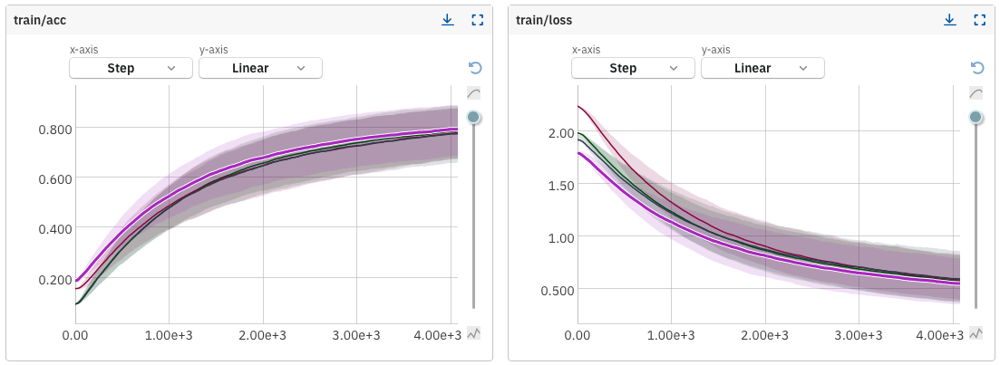

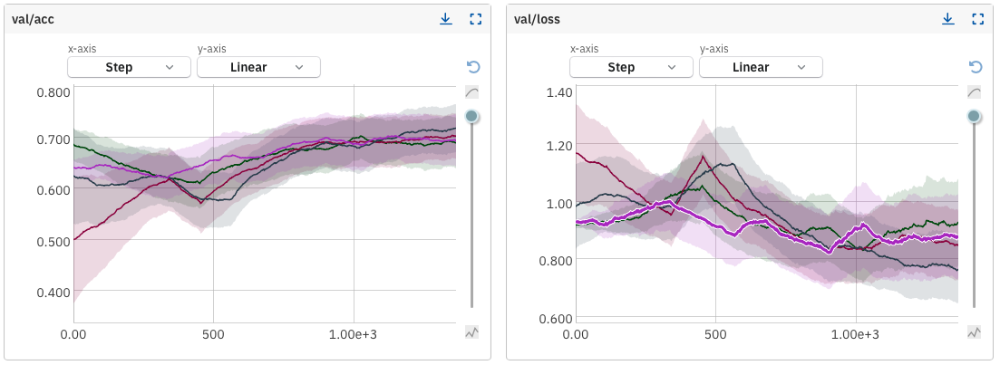

In [ ]:
net = BasicCNN(numLabels=6)
net = net.to(device)
criterionBasic = nn.CrossEntropyLoss()
optimizerBasic = optim.RMSprop(net.parameters(), lr=0.001)    #net.parameters is the wight of the NN

run = neptune.init_run(
    project="gihazshay/finalProjectML",
    api_token="eyJhcGlfYWRkcmVzcyI6Imh0dHBzOi8vYXBwLm5lcHR1bmUuYWkiLCJhcGlfdXJsIjoiaHR0cHM6Ly9hcHAubmVwdHVuZS5haSIsImFwaV9rZXkiOiI0Mjc3OWFhMi0zYWI3LTRiMjQtYjFiMC0xMGNkYWU4MjBkOTcifQ==",
)

params = {"learning_rate": 0.001, "optimizer": "RMSprop"}
run["parameters"] = params

trainModel = train(net, trainDataloader, optimizerBasic, 12, criterionBasic)
testAcc, testLoss = test(net, testDataloader, criterionBasic)

run.stop()

[neptune] [info   ] Neptune initialized. Open in the app: https://app.neptune.ai/gihazshay/finalProjectML/e/FIN-408


Epoch 0: 100%|██████████| 453/453 [00:05<00:00, 88.46batch/s]


              precision    recall  f1-score   support

           0       0.57      0.61      0.59      2451
           1       0.41      0.39      0.40      2366
           2       0.46      0.43      0.44      2581
           3       0.51      0.52      0.52      2513
           4       0.75      0.75      0.75      2333
           5       0.50      0.51      0.50      2234

    accuracy                           0.53     14478
   macro avg       0.53      0.53      0.53     14478
weighted avg       0.53      0.53      0.53     14478



Epoch 1: 100%|██████████| 453/453 [00:05<00:00, 83.09batch/s]


              precision    recall  f1-score   support

           0       0.70      0.74      0.72      2451
           1       0.55      0.46      0.50      2366
           2       0.61      0.61      0.61      2581
           3       0.61      0.67      0.63      2513
           4       0.88      0.86      0.87      2333
           5       0.62      0.64      0.63      2234

    accuracy                           0.66     14478
   macro avg       0.66      0.66      0.66     14478
weighted avg       0.66      0.66      0.66     14478



Epoch 2: 100%|██████████| 453/453 [00:05<00:00, 77.80batch/s]


              precision    recall  f1-score   support

           0       0.74      0.76      0.75      2451
           1       0.62      0.55      0.58      2366
           2       0.64      0.65      0.65      2581
           3       0.65      0.69      0.67      2513
           4       0.90      0.89      0.90      2333
           5       0.70      0.70      0.70      2234

    accuracy                           0.71     14478
   macro avg       0.71      0.71      0.71     14478
weighted avg       0.71      0.71      0.71     14478



Epoch 3: 100%|██████████| 453/453 [00:04<00:00, 92.68batch/s]


              precision    recall  f1-score   support

           0       0.76      0.78      0.77      2451
           1       0.65      0.60      0.62      2366
           2       0.68      0.67      0.68      2581
           3       0.69      0.72      0.70      2513
           4       0.91      0.90      0.90      2333
           5       0.70      0.72      0.71      2234

    accuracy                           0.73     14478
   macro avg       0.73      0.73      0.73     14478
weighted avg       0.73      0.73      0.73     14478



Epoch 4: 100%|██████████| 453/453 [00:05<00:00, 87.01batch/s]


              precision    recall  f1-score   support

           0       0.78      0.81      0.79      2451
           1       0.69      0.62      0.66      2366
           2       0.69      0.72      0.71      2581
           3       0.72      0.73      0.72      2513
           4       0.92      0.91      0.91      2333
           5       0.74      0.75      0.75      2234

    accuracy                           0.76     14478
   macro avg       0.76      0.76      0.76     14478
weighted avg       0.75      0.76      0.75     14478



Epoch 5: 100%|██████████| 453/453 [00:05<00:00, 78.16batch/s]


              precision    recall  f1-score   support

           0       0.80      0.81      0.80      2451
           1       0.71      0.66      0.69      2366
           2       0.71      0.74      0.72      2581
           3       0.72      0.73      0.73      2513
           4       0.91      0.91      0.91      2333
           5       0.75      0.75      0.75      2234

    accuracy                           0.77     14478
   macro avg       0.77      0.77      0.77     14478
weighted avg       0.77      0.77      0.77     14478



Epoch 6: 100%|██████████| 453/453 [00:04<00:00, 92.89batch/s]


              precision    recall  f1-score   support

           0       0.80      0.82      0.81      2451
           1       0.73      0.69      0.71      2366
           2       0.73      0.74      0.73      2581
           3       0.74      0.75      0.74      2513
           4       0.92      0.92      0.92      2333
           5       0.76      0.76      0.76      2234

    accuracy                           0.78     14478
   macro avg       0.78      0.78      0.78     14478
weighted avg       0.78      0.78      0.78     14478



Epoch 7: 100%|██████████| 453/453 [00:04<00:00, 91.80batch/s]


              precision    recall  f1-score   support

           0       0.81      0.82      0.81      2451
           1       0.75      0.70      0.73      2366
           2       0.73      0.75      0.74      2581
           3       0.75      0.76      0.75      2513
           4       0.92      0.92      0.92      2333
           5       0.76      0.77      0.77      2234

    accuracy                           0.79     14478
   macro avg       0.79      0.79      0.79     14478
weighted avg       0.79      0.79      0.78     14478



Epoch 8: 100%|██████████| 453/453 [00:05<00:00, 76.64batch/s]


              precision    recall  f1-score   support

           0       0.81      0.83      0.82      2451
           1       0.75      0.72      0.74      2366
           2       0.75      0.75      0.75      2581
           3       0.76      0.76      0.76      2513
           4       0.92      0.93      0.93      2333
           5       0.77      0.77      0.77      2234

    accuracy                           0.79     14478
   macro avg       0.79      0.79      0.79     14478
weighted avg       0.79      0.79      0.79     14478



Epoch 9: 100%|██████████| 453/453 [00:05<00:00, 87.97batch/s]


              precision    recall  f1-score   support

           0       0.81      0.84      0.83      2451
           1       0.76      0.74      0.75      2366
           2       0.76      0.76      0.76      2581
           3       0.76      0.77      0.77      2513
           4       0.93      0.92      0.93      2333
           5       0.79      0.78      0.78      2234

    accuracy                           0.80     14478
   macro avg       0.80      0.80      0.80     14478
weighted avg       0.80      0.80      0.80     14478



Epoch 10: 100%|██████████| 453/453 [00:04<00:00, 92.67batch/s]


              precision    recall  f1-score   support

           0       0.83      0.84      0.84      2451
           1       0.78      0.75      0.76      2366
           2       0.76      0.78      0.77      2581
           3       0.77      0.78      0.78      2513
           4       0.93      0.92      0.93      2333
           5       0.79      0.80      0.80      2234

    accuracy                           0.81     14478
   macro avg       0.81      0.81      0.81     14478
weighted avg       0.81      0.81      0.81     14478



Epoch 11: 100%|██████████| 453/453 [00:05<00:00, 80.81batch/s]


              precision    recall  f1-score   support

           0       0.84      0.86      0.85      2451
           1       0.79      0.76      0.77      2366
           2       0.77      0.79      0.78      2581
           3       0.78      0.78      0.78      2513
           4       0.93      0.93      0.93      2333
           5       0.80      0.80      0.80      2234

    accuracy                           0.82     14478
   macro avg       0.82      0.82      0.82     14478
weighted avg       0.82      0.82      0.82     14478



100%|██████████| 80/80 [00:00<00:00, 119.63batch/s]


              precision    recall  f1-score   support

           0       0.76      0.80      0.78       432
           1       0.84      0.37      0.51       418
           2       0.56      0.86      0.68       456
           3       0.78      0.58      0.66       444
           4       0.82      0.95      0.88       412
           5       0.71      0.75      0.73       394

    accuracy                           0.72      2556
   macro avg       0.74      0.72      0.71      2556
weighted avg       0.74      0.72      0.71      2556

[neptune] [info   ] Shutting down background jobs, please wait a moment...
[neptune] [info   ] Done!
[neptune] [info   ] Waiting for the remaining 37 operations to synchronize with Neptune. Do not kill this process.
[neptune] [info   ] All 37 operations synced, thanks for waiting!
[neptune] [info   ] Explore the metadata in the Neptune app: https://app.neptune.ai/gihazshay/finalProjectML/e/FIN-408/metadata


***Fisrt column: average***

***Second column: last sample***

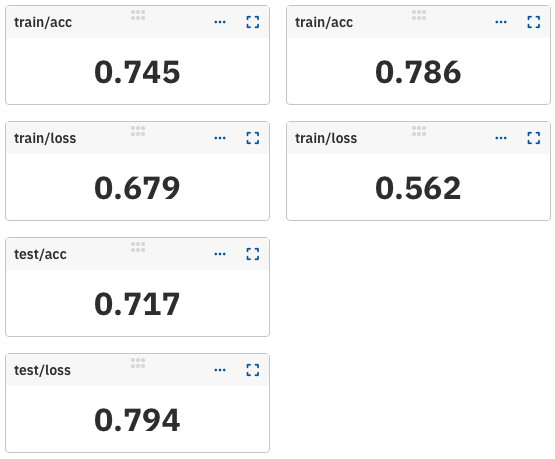

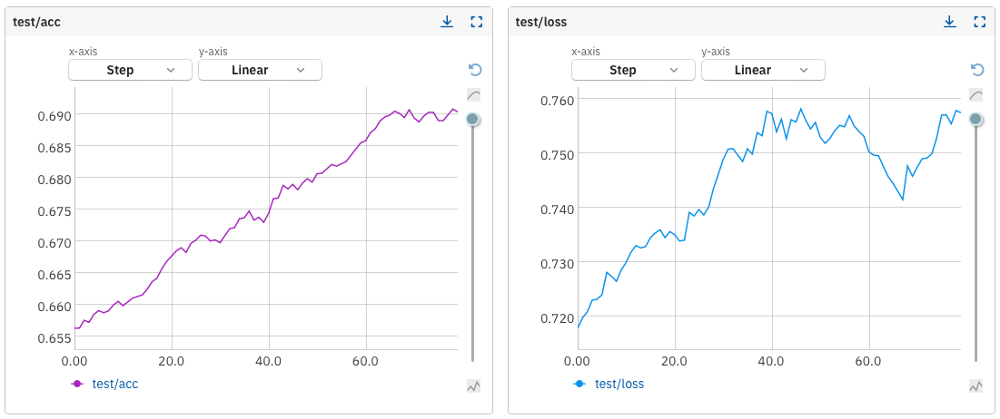

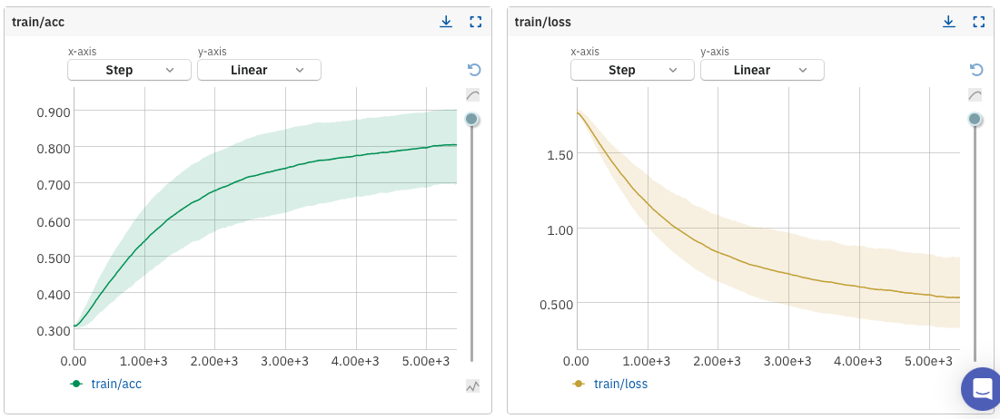

### SGD

In [ ]:
num_folds = 4

# Initialize the KFold object
kf = KFold(n_splits=num_folds, shuffle=True, random_state=40)


foldNum = 0
foldsMatrix = {}


for train_indices, val_indices in kf.split(idxTrain):


    TrainX_Kfold = np.array([dataset[i][0] for i in idxTrain[train_indices]])
    ValX_Kfold = np.array([dataset[j][0] for j in idxTrain[val_indices]])
    TrainY_Kfold = np.array([dataset[i][1] for i in idxTrain[train_indices]])
    ValY_Kfold = np.array([dataset[j][1] for j in idxTrain[val_indices]])
    ValZ_Kfold = np.array([dataset[j][2] for j in idxTrain[val_indices]])      #ID test of the images
    TrainZ_Kfold = np.array([dataset[i][2] for i in idxTrain[train_indices]])  #ID train of the images

    tensorTrainX_Kfold = torch.tensor(TrainX_Kfold, dtype=torch.float32).to(device)
    tensorValX_Kfold = torch.tensor(ValX_Kfold, dtype=torch.float32).to(device)
    tensorTrainY_Kfold = torch.tensor(TrainY_Kfold, dtype=torch.long).to(device)
    tensorValY_Kfold = torch.tensor(ValY_Kfold, dtype=torch.long).to(device)
    tensorTrainZ_Kfold = torch.tensor(TrainZ_Kfold, dtype=torch.long).to(device)
    tensorValZ_Kfold = torch.tensor(ValZ_Kfold, dtype=torch.long).to(device)

    # Create a TensorDataset object from the data
    tensorDatasetTrain_Kfold = TensorDataset(tensorTrainX_Kfold, tensorTrainY_Kfold, tensorTrainZ_Kfold)
    tensorDatasetVal_Kfold = TensorDataset(tensorValX_Kfold, tensorValY_Kfold, tensorValZ_Kfold)

    # Create a DataLoader object with batch size 32
    trainDataloaderKfold = DataLoader(tensorDatasetTrain_Kfold, batch_size=32, shuffle=True)
    valDataloaderKfold = DataLoader(tensorDatasetVal_Kfold, batch_size=32, shuffle=True)

    print(f"------fold------:{foldNum}")

    run = neptune.init_run(
    project="gihazshay/finalProjectML",
    api_token="eyJhcGlfYWRkcmVzcyI6Imh0dHBzOi8vYXBwLm5lcHR1bmUuYWkiLCJhcGlfdXJsIjoiaHR0cHM6Ly9hcHAubmVwdHVuZS5haSIsImFwaV9rZXkiOiI0Mjc3OWFhMi0zYWI3LTRiMjQtYjFiMC0xMGNkYWU4MjBkOTcifQ==",
    )

    params = {"learning_rate": 0.001, "optimizer": "SGD"}
    run["parameters"] = params

    net = BasicCNN(numLabels=6)
    net = net.to(device)
    criterionBasic = nn.CrossEntropyLoss()
    optimizerBasic = optim.SGD(net.parameters(), lr=0.001, momentum=0.9)    #net.parameters is the wight of the NN
    trainAcc, trainLoss, valAcc, valLoss = train(net, trainDataloaderKfold, optimizerBasic, 12, criterionBasic, valDataloaderKfold)

    run.stop()
    foldsMatrix[f"fold {foldNum}"] = {'train_acc':trainAcc, 'train_loss':trainLoss,
                                      'val_acc':valAcc, 'val_loss':valLoss}
    foldNum += 1


------fold------:0
[neptune] [info   ] Neptune initialized. Open in the app: https://app.neptune.ai/gihazshay/finalProjectML/e/FIN-409


Epoch 0: 100%|██████████| 340/340 [00:03<00:00, 99.99batch/s] 


              precision    recall  f1-score   support

           0       0.53      0.53      0.53      1822
           1       0.37      0.22      0.28      1766
           2       0.55      0.52      0.54      1964
           3       0.46      0.53      0.49      1871
           4       0.63      0.74      0.68      1745
           5       0.41      0.46      0.43      1690

    accuracy                           0.50     10858
   macro avg       0.49      0.50      0.49     10858
weighted avg       0.49      0.50      0.49     10858

Validtion part------EPOCH------:0


100%|██████████| 114/114 [00:00<00:00, 229.33batch/s]


              precision    recall  f1-score   support

           0       0.55      0.88      0.67       629
           1       0.47      0.32      0.38       600
           2       0.56      0.67      0.61       617
           3       0.56      0.57      0.57       642
           4       0.87      0.85      0.86       588
           5       0.71      0.31      0.44       544

    accuracy                           0.60      3620
   macro avg       0.62      0.60      0.59      3620
weighted avg       0.61      0.60      0.59      3620



Epoch 1: 100%|██████████| 340/340 [00:02<00:00, 125.28batch/s]


              precision    recall  f1-score   support

           0       0.64      0.69      0.66      1822
           1       0.46      0.29      0.36      1766
           2       0.62      0.67      0.64      1964
           3       0.52      0.59      0.55      1871
           4       0.83      0.81      0.82      1745
           5       0.58      0.63      0.61      1690

    accuracy                           0.61     10858
   macro avg       0.61      0.61      0.61     10858
weighted avg       0.61      0.61      0.61     10858

Validtion part------EPOCH------:1


100%|██████████| 114/114 [00:00<00:00, 309.83batch/s]


              precision    recall  f1-score   support

           0       0.71      0.71      0.71       629
           1       0.45      0.40      0.42       600
           2       0.63      0.60      0.61       617
           3       0.54      0.62      0.58       642
           4       0.91      0.81      0.86       588
           5       0.63      0.72      0.67       544

    accuracy                           0.64      3620
   macro avg       0.65      0.64      0.64      3620
weighted avg       0.64      0.64      0.64      3620



Epoch 2: 100%|██████████| 340/340 [00:02<00:00, 130.73batch/s]


              precision    recall  f1-score   support

           0       0.68      0.71      0.70      1822
           1       0.50      0.34      0.40      1766
           2       0.63      0.67      0.65      1964
           3       0.55      0.63      0.59      1871
           4       0.86      0.83      0.85      1745
           5       0.63      0.67      0.65      1690

    accuracy                           0.64     10858
   macro avg       0.64      0.64      0.64     10858
weighted avg       0.64      0.64      0.64     10858

Validtion part------EPOCH------:2


100%|██████████| 114/114 [00:00<00:00, 307.53batch/s]


              precision    recall  f1-score   support

           0       0.74      0.75      0.75       629
           1       0.55      0.35      0.43       600
           2       0.58      0.71      0.64       617
           3       0.52      0.71      0.60       642
           4       0.94      0.84      0.88       588
           5       0.71      0.58      0.63       544

    accuracy                           0.66      3620
   macro avg       0.67      0.66      0.66      3620
weighted avg       0.67      0.66      0.66      3620



Epoch 3: 100%|██████████| 340/340 [00:02<00:00, 130.24batch/s]


              precision    recall  f1-score   support

           0       0.69      0.74      0.72      1822
           1       0.50      0.39      0.44      1766
           2       0.64      0.67      0.66      1964
           3       0.58      0.65      0.61      1871
           4       0.88      0.86      0.87      1745
           5       0.67      0.67      0.67      1690

    accuracy                           0.66     10858
   macro avg       0.66      0.66      0.66     10858
weighted avg       0.66      0.66      0.66     10858

Validtion part------EPOCH------:3


100%|██████████| 114/114 [00:00<00:00, 305.28batch/s]


              precision    recall  f1-score   support

           0       0.76      0.73      0.74       629
           1       0.57      0.35      0.43       600
           2       0.61      0.64      0.62       617
           3       0.60      0.72      0.66       642
           4       0.83      0.91      0.87       588
           5       0.67      0.72      0.70       544

    accuracy                           0.68      3620
   macro avg       0.67      0.68      0.67      3620
weighted avg       0.67      0.68      0.67      3620



Epoch 4: 100%|██████████| 340/340 [00:02<00:00, 125.84batch/s]


              precision    recall  f1-score   support

           0       0.73      0.76      0.74      1822
           1       0.56      0.45      0.50      1766
           2       0.65      0.67      0.66      1964
           3       0.60      0.66      0.63      1871
           4       0.89      0.86      0.88      1745
           5       0.68      0.72      0.70      1690

    accuracy                           0.69     10858
   macro avg       0.69      0.69      0.69     10858
weighted avg       0.68      0.69      0.68     10858

Validtion part------EPOCH------:4


100%|██████████| 114/114 [00:00<00:00, 257.00batch/s]


              precision    recall  f1-score   support

           0       0.68      0.74      0.70       629
           1       0.72      0.29      0.42       600
           2       0.53      0.76      0.62       617
           3       0.63      0.63      0.63       642
           4       0.76      0.94      0.84       588
           5       0.74      0.58      0.65       544

    accuracy                           0.66      3620
   macro avg       0.67      0.66      0.64      3620
weighted avg       0.67      0.66      0.64      3620



Epoch 5: 100%|██████████| 340/340 [00:03<00:00, 108.80batch/s]


              precision    recall  f1-score   support

           0       0.73      0.76      0.75      1822
           1       0.57      0.47      0.52      1766
           2       0.68      0.69      0.68      1964
           3       0.62      0.67      0.64      1871
           4       0.89      0.88      0.88      1745
           5       0.70      0.72      0.71      1690

    accuracy                           0.70     10858
   macro avg       0.70      0.70      0.70     10858
weighted avg       0.70      0.70      0.70     10858

Validtion part------EPOCH------:5


100%|██████████| 114/114 [00:00<00:00, 241.00batch/s]


              precision    recall  f1-score   support

           0       0.68      0.82      0.74       629
           1       0.63      0.37      0.47       600
           2       0.70      0.54      0.61       617
           3       0.56      0.80      0.66       642
           4       0.87      0.91      0.89       588
           5       0.70      0.64      0.67       544

    accuracy                           0.68      3620
   macro avg       0.69      0.68      0.67      3620
weighted avg       0.69      0.68      0.67      3620



Epoch 6: 100%|██████████| 340/340 [00:02<00:00, 114.12batch/s]


              precision    recall  f1-score   support

           0       0.76      0.78      0.77      1822
           1       0.59      0.50      0.54      1766
           2       0.67      0.65      0.66      1964
           3       0.62      0.70      0.66      1871
           4       0.90      0.89      0.89      1745
           5       0.72      0.74      0.73      1690

    accuracy                           0.71     10858
   macro avg       0.71      0.71      0.71     10858
weighted avg       0.71      0.71      0.71     10858

Validtion part------EPOCH------:6


100%|██████████| 114/114 [00:00<00:00, 306.17batch/s]


              precision    recall  f1-score   support

           0       0.79      0.70      0.74       629
           1       0.64      0.49      0.55       600
           2       0.69      0.60      0.65       617
           3       0.63      0.77      0.69       642
           4       0.91      0.88      0.90       588
           5       0.63      0.83      0.72       544

    accuracy                           0.71      3620
   macro avg       0.72      0.71      0.71      3620
weighted avg       0.72      0.71      0.71      3620



Epoch 7: 100%|██████████| 340/340 [00:02<00:00, 127.74batch/s]


              precision    recall  f1-score   support

           0       0.75      0.78      0.77      1822
           1       0.59      0.52      0.55      1766
           2       0.67      0.66      0.67      1964
           3       0.64      0.69      0.67      1871
           4       0.89      0.88      0.88      1745
           5       0.73      0.73      0.73      1690

    accuracy                           0.71     10858
   macro avg       0.71      0.71      0.71     10858
weighted avg       0.71      0.71      0.71     10858

Validtion part------EPOCH------:7


100%|██████████| 114/114 [00:00<00:00, 310.41batch/s]


              precision    recall  f1-score   support

           0       0.71      0.79      0.75       629
           1       0.54      0.56      0.55       600
           2       0.62      0.66      0.64       617
           3       0.67      0.59      0.63       642
           4       0.93      0.87      0.89       588
           5       0.71      0.69      0.70       544

    accuracy                           0.69      3620
   macro avg       0.70      0.69      0.69      3620
weighted avg       0.69      0.69      0.69      3620



Epoch 8: 100%|██████████| 340/340 [00:02<00:00, 129.00batch/s]


              precision    recall  f1-score   support

           0       0.79      0.80      0.79      1822
           1       0.64      0.57      0.60      1766
           2       0.70      0.69      0.69      1964
           3       0.66      0.71      0.69      1871
           4       0.91      0.90      0.91      1745
           5       0.74      0.76      0.75      1690

    accuracy                           0.74     10858
   macro avg       0.74      0.74      0.74     10858
weighted avg       0.74      0.74      0.74     10858

Validtion part------EPOCH------:8


100%|██████████| 114/114 [00:00<00:00, 304.82batch/s]


              precision    recall  f1-score   support

           0       0.72      0.82      0.77       629
           1       0.50      0.69      0.58       600
           2       0.73      0.50      0.59       617
           3       0.65      0.60      0.63       642
           4       0.97      0.80      0.88       588
           5       0.70      0.75      0.73       544

    accuracy                           0.69      3620
   macro avg       0.71      0.69      0.69      3620
weighted avg       0.71      0.69      0.69      3620



Epoch 9: 100%|██████████| 340/340 [00:02<00:00, 123.29batch/s]


              precision    recall  f1-score   support

           0       0.76      0.79      0.78      1822
           1       0.63      0.58      0.60      1766
           2       0.71      0.67      0.69      1964
           3       0.67      0.72      0.69      1871
           4       0.90      0.89      0.90      1745
           5       0.74      0.75      0.75      1690

    accuracy                           0.73     10858
   macro avg       0.73      0.73      0.73     10858
weighted avg       0.73      0.73      0.73     10858

Validtion part------EPOCH------:9


100%|██████████| 114/114 [00:00<00:00, 252.72batch/s]


              precision    recall  f1-score   support

           0       0.77      0.78      0.77       629
           1       0.65      0.44      0.52       600
           2       0.59      0.72      0.64       617
           3       0.59      0.75      0.66       642
           4       0.96      0.85      0.90       588
           5       0.76      0.65      0.70       544

    accuracy                           0.70      3620
   macro avg       0.72      0.70      0.70      3620
weighted avg       0.71      0.70      0.70      3620



Epoch 10: 100%|██████████| 340/340 [00:03<00:00, 107.87batch/s]


              precision    recall  f1-score   support

           0       0.78      0.80      0.79      1822
           1       0.66      0.60      0.63      1766
           2       0.70      0.70      0.70      1964
           3       0.66      0.72      0.69      1871
           4       0.91      0.88      0.90      1745
           5       0.76      0.77      0.77      1690

    accuracy                           0.74     10858
   macro avg       0.75      0.74      0.74     10858
weighted avg       0.74      0.74      0.74     10858

Validtion part------EPOCH------:10


100%|██████████| 114/114 [00:00<00:00, 240.89batch/s]


              precision    recall  f1-score   support

           0       0.80      0.63      0.70       629
           1       0.52      0.71      0.60       600
           2       0.74      0.54      0.62       617
           3       0.76      0.52      0.62       642
           4       0.84      0.93      0.88       588
           5       0.59      0.83      0.69       544

    accuracy                           0.69      3620
   macro avg       0.71      0.69      0.69      3620
weighted avg       0.71      0.69      0.68      3620



Epoch 11: 100%|██████████| 340/340 [00:03<00:00, 109.79batch/s]


              precision    recall  f1-score   support

           0       0.80      0.82      0.81      1822
           1       0.67      0.63      0.65      1766
           2       0.71      0.69      0.70      1964
           3       0.69      0.73      0.71      1871
           4       0.91      0.90      0.91      1745
           5       0.78      0.79      0.78      1690

    accuracy                           0.76     10858
   macro avg       0.76      0.76      0.76     10858
weighted avg       0.76      0.76      0.76     10858

Validtion part------EPOCH------:11


100%|██████████| 114/114 [00:00<00:00, 308.60batch/s]


              precision    recall  f1-score   support

           0       0.74      0.75      0.75       629
           1       0.78      0.46      0.57       600
           2       0.68      0.68      0.68       617
           3       0.64      0.76      0.70       642
           4       0.86      0.92      0.89       588
           5       0.68      0.77      0.72       544

    accuracy                           0.72      3620
   macro avg       0.73      0.72      0.72      3620
weighted avg       0.73      0.72      0.72      3620

[neptune] [info   ] Shutting down background jobs, please wait a moment...
[neptune] [info   ] Done!
[neptune] [info   ] Waiting for the remaining 43 operations to synchronize with Neptune. Do not kill this process.
[neptune] [info   ] All 43 operations synced, thanks for waiting!
[neptune] [info   ] Explore the metadata in the Neptune app: https://app.neptune.ai/gihazshay/finalProjectML/e/FIN-409/metadata
------fold------:1
[neptune] [info   ] Neptune 

Epoch 0: 100%|██████████| 340/340 [00:02<00:00, 118.01batch/s]


              precision    recall  f1-score   support

           0       0.43      0.56      0.48      1850
           1       0.38      0.24      0.30      1800
           2       0.46      0.46      0.46      1924
           3       0.48      0.27      0.34      1908
           4       0.59      0.69      0.64      1732
           5       0.36      0.50      0.42      1644

    accuracy                           0.45     10858
   macro avg       0.45      0.45      0.44     10858
weighted avg       0.45      0.45      0.44     10858

Validtion part------EPOCH------:0


100%|██████████| 114/114 [00:00<00:00, 322.51batch/s]


              precision    recall  f1-score   support

           0       0.73      0.42      0.53       601
           1       0.48      0.07      0.12       566
           2       0.57      0.56      0.56       657
           3       0.44      0.79      0.56       605
           4       0.92      0.72      0.81       601
           5       0.49      0.83      0.62       590

    accuracy                           0.57      3620
   macro avg       0.60      0.56      0.53      3620
weighted avg       0.61      0.57      0.54      3620



Epoch 1: 100%|██████████| 340/340 [00:02<00:00, 131.85batch/s]


              precision    recall  f1-score   support

           0       0.63      0.66      0.65      1850
           1       0.49      0.24      0.32      1800
           2       0.56      0.50      0.53      1924
           3       0.48      0.73      0.58      1908
           4       0.78      0.79      0.78      1732
           5       0.58      0.60      0.59      1644

    accuracy                           0.58     10858
   macro avg       0.59      0.59      0.57     10858
weighted avg       0.59      0.58      0.57     10858

Validtion part------EPOCH------:1


100%|██████████| 114/114 [00:00<00:00, 313.52batch/s]


              precision    recall  f1-score   support

           0       0.60      0.64      0.62       601
           1       0.47      0.50      0.48       566
           2       0.74      0.36      0.48       657
           3       0.48      0.78      0.59       605
           4       0.98      0.58      0.73       601
           5       0.60      0.73      0.66       590

    accuracy                           0.59      3620
   macro avg       0.64      0.60      0.59      3620
weighted avg       0.65      0.59      0.59      3620



Epoch 2: 100%|██████████| 340/340 [00:02<00:00, 128.18batch/s]


              precision    recall  f1-score   support

           0       0.67      0.70      0.69      1850
           1       0.53      0.41      0.46      1800
           2       0.58      0.54      0.56      1924
           3       0.55      0.69      0.61      1908
           4       0.84      0.83      0.83      1732
           5       0.63      0.64      0.63      1644

    accuracy                           0.63     10858
   macro avg       0.63      0.63      0.63     10858
weighted avg       0.63      0.63      0.63     10858

Validtion part------EPOCH------:2


100%|██████████| 114/114 [00:00<00:00, 314.16batch/s]


              precision    recall  f1-score   support

           0       0.78      0.69      0.73       601
           1       0.56      0.50      0.53       566
           2       0.64      0.55      0.59       657
           3       0.62      0.74      0.67       605
           4       0.85      0.90      0.87       601
           5       0.66      0.75      0.70       590

    accuracy                           0.69      3620
   macro avg       0.69      0.69      0.68      3620
weighted avg       0.69      0.69      0.68      3620



Epoch 3: 100%|██████████| 340/340 [00:02<00:00, 120.06batch/s]


              precision    recall  f1-score   support

           0       0.70      0.73      0.71      1850
           1       0.57      0.49      0.52      1800
           2       0.61      0.56      0.59      1924
           3       0.60      0.70      0.64      1908
           4       0.85      0.83      0.84      1732
           5       0.66      0.66      0.66      1644

    accuracy                           0.66     10858
   macro avg       0.66      0.66      0.66     10858
weighted avg       0.66      0.66      0.66     10858

Validtion part------EPOCH------:3


100%|██████████| 114/114 [00:00<00:00, 248.81batch/s]


              precision    recall  f1-score   support

           0       0.72      0.74      0.73       601
           1       0.53      0.55      0.54       566
           2       0.58      0.59      0.58       657
           3       0.67      0.58      0.62       605
           4       0.84      0.91      0.87       601
           5       0.70      0.67      0.69       590

    accuracy                           0.67      3620
   macro avg       0.67      0.67      0.67      3620
weighted avg       0.67      0.67      0.67      3620



Epoch 4: 100%|██████████| 340/340 [00:03<00:00, 104.03batch/s]


              precision    recall  f1-score   support

           0       0.74      0.75      0.74      1850
           1       0.59      0.56      0.57      1800
           2       0.62      0.56      0.59      1924
           3       0.64      0.72      0.68      1908
           4       0.88      0.86      0.87      1732
           5       0.68      0.70      0.69      1644

    accuracy                           0.69     10858
   macro avg       0.69      0.69      0.69     10858
weighted avg       0.69      0.69      0.69     10858

Validtion part------EPOCH------:4


100%|██████████| 114/114 [00:00<00:00, 232.82batch/s]


              precision    recall  f1-score   support

           0       0.73      0.78      0.75       601
           1       0.59      0.61      0.60       566
           2       0.68      0.50      0.58       657
           3       0.59      0.80      0.68       605
           4       0.92      0.86      0.89       601
           5       0.75      0.66      0.70       590

    accuracy                           0.70      3620
   macro avg       0.71      0.70      0.70      3620
weighted avg       0.71      0.70      0.70      3620



Epoch 5: 100%|██████████| 340/340 [00:03<00:00, 110.46batch/s]


              precision    recall  f1-score   support

           0       0.74      0.76      0.75      1850
           1       0.59      0.60      0.60      1800
           2       0.63      0.57      0.60      1924
           3       0.66      0.70      0.68      1908
           4       0.88      0.88      0.88      1732
           5       0.70      0.69      0.70      1644

    accuracy                           0.70     10858
   macro avg       0.70      0.70      0.70     10858
weighted avg       0.70      0.70      0.70     10858

Validtion part------EPOCH------:5


100%|██████████| 114/114 [00:00<00:00, 208.66batch/s]


              precision    recall  f1-score   support

           0       0.71      0.76      0.73       601
           1       0.71      0.48      0.57       566
           2       0.63      0.58      0.60       657
           3       0.64      0.74      0.69       605
           4       0.83      0.92      0.87       601
           5       0.66      0.71      0.69       590

    accuracy                           0.70      3620
   macro avg       0.70      0.70      0.69      3620
weighted avg       0.70      0.70      0.69      3620



Epoch 6: 100%|██████████| 340/340 [00:03<00:00, 98.48batch/s]


              precision    recall  f1-score   support

           0       0.75      0.77      0.76      1850
           1       0.64      0.68      0.66      1800
           2       0.66      0.60      0.63      1924
           3       0.69      0.71      0.70      1908
           4       0.89      0.89      0.89      1732
           5       0.71      0.70      0.71      1644

    accuracy                           0.72     10858
   macro avg       0.72      0.72      0.72     10858
weighted avg       0.72      0.72      0.72     10858

Validtion part------EPOCH------:6


100%|██████████| 114/114 [00:00<00:00, 219.83batch/s]


              precision    recall  f1-score   support

           0       0.63      0.90      0.74       601
           1       0.74      0.32      0.45       566
           2       0.59      0.67      0.63       657
           3       0.57      0.81      0.67       605
           4       0.87      0.90      0.88       601
           5       0.86      0.42      0.57       590

    accuracy                           0.67      3620
   macro avg       0.71      0.67      0.66      3620
weighted avg       0.71      0.67      0.66      3620



Epoch 7: 100%|██████████| 340/340 [00:02<00:00, 113.72batch/s]


              precision    recall  f1-score   support

           0       0.75      0.78      0.76      1850
           1       0.65      0.66      0.66      1800
           2       0.66      0.61      0.63      1924
           3       0.69      0.72      0.70      1908
           4       0.90      0.88      0.89      1732
           5       0.73      0.71      0.72      1644

    accuracy                           0.73     10858
   macro avg       0.73      0.73      0.73     10858
weighted avg       0.73      0.73      0.73     10858

Validtion part------EPOCH------:7


100%|██████████| 114/114 [00:00<00:00, 310.59batch/s]


              precision    recall  f1-score   support

           0       0.78      0.73      0.75       601
           1       0.72      0.58      0.65       566
           2       0.52      0.82      0.64       657
           3       0.74      0.49      0.59       605
           4       0.89      0.90      0.90       601
           5       0.72      0.69      0.71       590

    accuracy                           0.71      3620
   macro avg       0.73      0.70      0.71      3620
weighted avg       0.73      0.71      0.71      3620



Epoch 8: 100%|██████████| 340/340 [00:02<00:00, 125.79batch/s]


              precision    recall  f1-score   support

           0       0.77      0.79      0.78      1850
           1       0.68      0.70      0.69      1800
           2       0.68      0.64      0.66      1924
           3       0.71      0.72      0.71      1908
           4       0.90      0.90      0.90      1732
           5       0.72      0.72      0.72      1644

    accuracy                           0.74     10858
   macro avg       0.74      0.74      0.74     10858
weighted avg       0.74      0.74      0.74     10858

Validtion part------EPOCH------:8


100%|██████████| 114/114 [00:00<00:00, 294.91batch/s]


              precision    recall  f1-score   support

           0       0.69      0.73      0.71       601
           1       0.63      0.79      0.70       566
           2       0.71      0.44      0.54       657
           3       0.74      0.68      0.71       605
           4       0.94      0.84      0.88       601
           5       0.58      0.77      0.66       590

    accuracy                           0.70      3620
   macro avg       0.71      0.71      0.70      3620
weighted avg       0.72      0.70      0.70      3620



Epoch 9: 100%|██████████| 340/340 [00:03<00:00, 108.99batch/s]


              precision    recall  f1-score   support

           0       0.78      0.80      0.79      1850
           1       0.69      0.71      0.70      1800
           2       0.68      0.65      0.66      1924
           3       0.72      0.73      0.72      1908
           4       0.91      0.91      0.91      1732
           5       0.74      0.74      0.74      1644

    accuracy                           0.75     10858
   macro avg       0.75      0.75      0.75     10858
weighted avg       0.75      0.75      0.75     10858

Validtion part------EPOCH------:9


100%|██████████| 114/114 [00:00<00:00, 247.83batch/s]


              precision    recall  f1-score   support

           0       0.78      0.71      0.74       601
           1       0.77      0.60      0.67       566
           2       0.64      0.70      0.67       657
           3       0.68      0.72      0.70       605
           4       0.91      0.89      0.90       601
           5       0.67      0.78      0.72       590

    accuracy                           0.73      3620
   macro avg       0.74      0.73      0.73      3620
weighted avg       0.74      0.73      0.73      3620



Epoch 10: 100%|██████████| 340/340 [00:03<00:00, 108.69batch/s]


              precision    recall  f1-score   support

           0       0.79      0.80      0.80      1850
           1       0.70      0.70      0.70      1800
           2       0.69      0.69      0.69      1924
           3       0.72      0.71      0.72      1908
           4       0.92      0.91      0.91      1732
           5       0.74      0.73      0.73      1644

    accuracy                           0.76     10858
   macro avg       0.76      0.76      0.76     10858
weighted avg       0.76      0.76      0.76     10858

Validtion part------EPOCH------:10


100%|██████████| 114/114 [00:00<00:00, 234.26batch/s]


              precision    recall  f1-score   support

           0       0.71      0.76      0.73       601
           1       0.57      0.78      0.66       566
           2       0.83      0.34      0.48       657
           3       0.59      0.84      0.69       605
           4       0.93      0.83      0.88       601
           5       0.74      0.69      0.71       590

    accuracy                           0.70      3620
   macro avg       0.73      0.71      0.69      3620
weighted avg       0.73      0.70      0.69      3620



Epoch 11: 100%|██████████| 340/340 [00:02<00:00, 120.83batch/s]


              precision    recall  f1-score   support

           0       0.79      0.82      0.81      1850
           1       0.73      0.75      0.74      1800
           2       0.71      0.68      0.69      1924
           3       0.73      0.73      0.73      1908
           4       0.90      0.89      0.90      1732
           5       0.78      0.77      0.77      1644

    accuracy                           0.77     10858
   macro avg       0.77      0.77      0.77     10858
weighted avg       0.77      0.77      0.77     10858

Validtion part------EPOCH------:11


100%|██████████| 114/114 [00:00<00:00, 299.58batch/s]


              precision    recall  f1-score   support

           0       0.76      0.71      0.73       601
           1       0.53      0.90      0.67       566
           2       0.79      0.42      0.55       657
           3       0.69      0.65      0.67       605
           4       0.95      0.85      0.90       601
           5       0.69      0.74      0.71       590

    accuracy                           0.71      3620
   macro avg       0.73      0.71      0.71      3620
weighted avg       0.74      0.71      0.70      3620

[neptune] [info   ] Shutting down background jobs, please wait a moment...
[neptune] [info   ] Done!
[neptune] [info   ] Waiting for the remaining 46 operations to synchronize with Neptune. Do not kill this process.
[neptune] [info   ] All 46 operations synced, thanks for waiting!
[neptune] [info   ] Explore the metadata in the Neptune app: https://app.neptune.ai/gihazshay/finalProjectML/e/FIN-410/metadata
------fold------:2
[neptune] [info   ] Neptune 

Epoch 0: 100%|██████████| 340/340 [00:02<00:00, 125.27batch/s]


              precision    recall  f1-score   support

           0       0.48      0.48      0.48      1855
           1       0.34      0.14      0.20      1767
           2       0.43      0.40      0.42      1933
           3       0.34      0.37      0.36      1863
           4       0.46      0.61      0.52      1737
           5       0.28      0.35      0.31      1704

    accuracy                           0.39     10859
   macro avg       0.39      0.39      0.38     10859
weighted avg       0.39      0.39      0.38     10859

Validtion part------EPOCH------:0


100%|██████████| 114/114 [00:00<00:00, 302.99batch/s]


              precision    recall  f1-score   support

           0       0.54      0.57      0.56       596
           1       0.45      0.08      0.14       599
           2       0.41      0.67      0.50       648
           3       0.50      0.24      0.33       650
           4       0.93      0.49      0.64       596
           5       0.32      0.73      0.45       530

    accuracy                           0.46      3619
   macro avg       0.53      0.46      0.44      3619
weighted avg       0.53      0.46      0.44      3619



Epoch 1: 100%|██████████| 340/340 [00:02<00:00, 129.36batch/s]


              precision    recall  f1-score   support

           0       0.63      0.68      0.66      1855
           1       0.44      0.20      0.28      1767
           2       0.52      0.51      0.51      1933
           3       0.45      0.60      0.51      1863
           4       0.80      0.79      0.80      1737
           5       0.47      0.55      0.51      1704

    accuracy                           0.55     10859
   macro avg       0.55      0.55      0.54     10859
weighted avg       0.55      0.55      0.54     10859

Validtion part------EPOCH------:1


100%|██████████| 114/114 [00:00<00:00, 314.20batch/s]


              precision    recall  f1-score   support

           0       0.65      0.79      0.71       596
           1       0.51      0.14      0.22       599
           2       0.61      0.47      0.53       648
           3       0.44      0.74      0.55       650
           4       0.93      0.83      0.88       596
           5       0.53      0.58      0.55       530

    accuracy                           0.59      3619
   macro avg       0.61      0.59      0.57      3619
weighted avg       0.61      0.59      0.57      3619



Epoch 2: 100%|██████████| 340/340 [00:02<00:00, 124.38batch/s]


              precision    recall  f1-score   support

           0       0.68      0.69      0.69      1855
           1       0.50      0.31      0.38      1767
           2       0.59      0.57      0.58      1933
           3       0.49      0.67      0.57      1863
           4       0.84      0.82      0.83      1737
           5       0.58      0.61      0.59      1704

    accuracy                           0.61     10859
   macro avg       0.61      0.61      0.61     10859
weighted avg       0.61      0.61      0.61     10859

Validtion part------EPOCH------:2


100%|██████████| 114/114 [00:00<00:00, 259.00batch/s]


              precision    recall  f1-score   support

           0       0.71      0.65      0.68       596
           1       0.52      0.23      0.32       599
           2       0.51      0.77      0.62       648
           3       0.69      0.44      0.54       650
           4       0.74      0.94      0.83       596
           5       0.52      0.66      0.58       530

    accuracy                           0.61      3619
   macro avg       0.62      0.61      0.59      3619
weighted avg       0.62      0.61      0.59      3619



Epoch 3: 100%|██████████| 340/340 [00:03<00:00, 113.10batch/s]


              precision    recall  f1-score   support

           0       0.70      0.72      0.71      1855
           1       0.55      0.39      0.46      1767
           2       0.60      0.64      0.62      1933
           3       0.57      0.67      0.61      1863
           4       0.86      0.83      0.85      1737
           5       0.65      0.67      0.66      1704

    accuracy                           0.65     10859
   macro avg       0.66      0.65      0.65     10859
weighted avg       0.65      0.65      0.65     10859

Validtion part------EPOCH------:3


100%|██████████| 114/114 [00:00<00:00, 230.74batch/s]


              precision    recall  f1-score   support

           0       0.79      0.58      0.67       596
           1       0.46      0.55      0.50       599
           2       0.57      0.68      0.62       648
           3       0.73      0.42      0.53       650
           4       0.78      0.94      0.85       596
           5       0.65      0.74      0.69       530

    accuracy                           0.65      3619
   macro avg       0.66      0.65      0.64      3619
weighted avg       0.66      0.65      0.64      3619



Epoch 4: 100%|██████████| 340/340 [00:02<00:00, 117.00batch/s]


              precision    recall  f1-score   support

           0       0.75      0.76      0.75      1855
           1       0.56      0.49      0.52      1767
           2       0.61      0.62      0.62      1933
           3       0.63      0.69      0.66      1863
           4       0.89      0.86      0.87      1737
           5       0.68      0.71      0.69      1704

    accuracy                           0.68     10859
   macro avg       0.69      0.69      0.68     10859
weighted avg       0.68      0.68      0.68     10859

Validtion part------EPOCH------:4


100%|██████████| 114/114 [00:00<00:00, 223.68batch/s]


              precision    recall  f1-score   support

           0       0.77      0.72      0.74       596
           1       0.65      0.42      0.51       599
           2       0.52      0.79      0.62       648
           3       0.68      0.65      0.66       650
           4       0.90      0.92      0.91       596
           5       0.74      0.64      0.69       530

    accuracy                           0.69      3619
   macro avg       0.71      0.69      0.69      3619
weighted avg       0.71      0.69      0.69      3619



Epoch 5: 100%|██████████| 340/340 [00:02<00:00, 125.52batch/s]


              precision    recall  f1-score   support

           0       0.75      0.76      0.75      1855
           1       0.59      0.58      0.59      1767
           2       0.64      0.63      0.64      1933
           3       0.68      0.70      0.69      1863
           4       0.89      0.87      0.88      1737
           5       0.70      0.72      0.71      1704

    accuracy                           0.71     10859
   macro avg       0.71      0.71      0.71     10859
weighted avg       0.71      0.71      0.71     10859

Validtion part------EPOCH------:5


100%|██████████| 114/114 [00:00<00:00, 310.63batch/s]


              precision    recall  f1-score   support

           0       0.77      0.72      0.74       596
           1       0.65      0.53      0.59       599
           2       0.67      0.58      0.62       648
           3       0.61      0.84      0.71       650
           4       0.93      0.92      0.92       596
           5       0.71      0.69      0.70       530

    accuracy                           0.71      3619
   macro avg       0.72      0.71      0.71      3619
weighted avg       0.72      0.71      0.71      3619



Epoch 6: 100%|██████████| 340/340 [00:02<00:00, 128.51batch/s]


              precision    recall  f1-score   support

           0       0.77      0.77      0.77      1855
           1       0.63      0.61      0.62      1767
           2       0.67      0.65      0.66      1933
           3       0.69      0.73      0.71      1863
           4       0.90      0.89      0.90      1737
           5       0.72      0.73      0.73      1704

    accuracy                           0.73     10859
   macro avg       0.73      0.73      0.73     10859
weighted avg       0.73      0.73      0.73     10859

Validtion part------EPOCH------:6


100%|██████████| 114/114 [00:00<00:00, 316.12batch/s]


              precision    recall  f1-score   support

           0       0.68      0.83      0.75       596
           1       0.70      0.60      0.65       599
           2       0.66      0.66      0.66       648
           3       0.74      0.74      0.74       650
           4       0.95      0.85      0.90       596
           5       0.67      0.69      0.68       530

    accuracy                           0.73      3619
   macro avg       0.73      0.73      0.73      3619
weighted avg       0.73      0.73      0.73      3619



Epoch 7: 100%|██████████| 340/340 [00:02<00:00, 127.03batch/s]


              precision    recall  f1-score   support

           0       0.78      0.78      0.78      1855
           1       0.63      0.63      0.63      1767
           2       0.65      0.63      0.64      1933
           3       0.69      0.71      0.70      1863
           4       0.90      0.88      0.89      1737
           5       0.73      0.75      0.74      1704

    accuracy                           0.73     10859
   macro avg       0.73      0.73      0.73     10859
weighted avg       0.73      0.73      0.73     10859

Validtion part------EPOCH------:7


100%|██████████| 114/114 [00:00<00:00, 311.19batch/s]


              precision    recall  f1-score   support

           0       0.77      0.71      0.74       596
           1       0.61      0.63      0.62       599
           2       0.61      0.73      0.66       648
           3       0.82      0.57      0.67       650
           4       0.85      0.92      0.89       596
           5       0.70      0.75      0.73       530

    accuracy                           0.72      3619
   macro avg       0.73      0.72      0.72      3619
weighted avg       0.73      0.72      0.72      3619



Epoch 8: 100%|██████████| 340/340 [00:02<00:00, 125.24batch/s]


              precision    recall  f1-score   support

           0       0.79      0.80      0.79      1855
           1       0.67      0.65      0.66      1767
           2       0.69      0.67      0.68      1933
           3       0.70      0.75      0.73      1863
           4       0.91      0.90      0.90      1737
           5       0.74      0.75      0.75      1704

    accuracy                           0.75     10859
   macro avg       0.75      0.75      0.75     10859
weighted avg       0.75      0.75      0.75     10859

Validtion part------EPOCH------:8


100%|██████████| 114/114 [00:00<00:00, 254.56batch/s]


              precision    recall  f1-score   support

           0       0.76      0.60      0.67       596
           1       0.58      0.71      0.64       599
           2       0.67      0.48      0.56       648
           3       0.84      0.52      0.65       650
           4       0.93      0.90      0.92       596
           5       0.49      0.89      0.63       530

    accuracy                           0.68      3619
   macro avg       0.71      0.69      0.68      3619
weighted avg       0.72      0.68      0.68      3619



Epoch 9: 100%|██████████| 340/340 [00:03<00:00, 109.36batch/s]


              precision    recall  f1-score   support

           0       0.79      0.80      0.80      1855
           1       0.67      0.66      0.66      1767
           2       0.68      0.67      0.67      1933
           3       0.70      0.73      0.72      1863
           4       0.91      0.90      0.91      1737
           5       0.75      0.75      0.75      1704

    accuracy                           0.75     10859
   macro avg       0.75      0.75      0.75     10859
weighted avg       0.75      0.75      0.75     10859

Validtion part------EPOCH------:9


100%|██████████| 114/114 [00:00<00:00, 251.64batch/s]


              precision    recall  f1-score   support

           0       0.83      0.65      0.73       596
           1       0.72      0.62      0.67       599
           2       0.63      0.76      0.69       648
           3       0.81      0.66      0.73       650
           4       0.86      0.96      0.91       596
           5       0.66      0.82      0.73       530

    accuracy                           0.74      3619
   macro avg       0.75      0.75      0.74      3619
weighted avg       0.75      0.74      0.74      3619



Epoch 10: 100%|██████████| 340/340 [00:03<00:00, 108.65batch/s]


              precision    recall  f1-score   support

           0       0.80      0.80      0.80      1855
           1       0.70      0.68      0.69      1767
           2       0.69      0.69      0.69      1933
           3       0.71      0.75      0.73      1863
           4       0.92      0.91      0.91      1737
           5       0.76      0.76      0.76      1704

    accuracy                           0.76     10859
   macro avg       0.76      0.76      0.76     10859
weighted avg       0.76      0.76      0.76     10859

Validtion part------EPOCH------:10


100%|██████████| 114/114 [00:00<00:00, 258.64batch/s]


              precision    recall  f1-score   support

           0       0.83      0.62      0.71       596
           1       0.73      0.62      0.67       599
           2       0.63      0.72      0.67       648
           3       0.77      0.65      0.71       650
           4       0.86      0.95      0.90       596
           5       0.64      0.84      0.72       530

    accuracy                           0.73      3619
   macro avg       0.74      0.73      0.73      3619
weighted avg       0.74      0.73      0.73      3619



Epoch 11: 100%|██████████| 340/340 [00:02<00:00, 125.72batch/s]


              precision    recall  f1-score   support

           0       0.81      0.82      0.81      1855
           1       0.71      0.68      0.69      1767
           2       0.70      0.70      0.70      1933
           3       0.71      0.74      0.72      1863
           4       0.92      0.91      0.91      1737
           5       0.78      0.78      0.78      1704

    accuracy                           0.77     10859
   macro avg       0.77      0.77      0.77     10859
weighted avg       0.77      0.77      0.77     10859

Validtion part------EPOCH------:11


100%|██████████| 114/114 [00:00<00:00, 311.87batch/s]


              precision    recall  f1-score   support

           0       0.67      0.87      0.76       596
           1       0.67      0.66      0.66       599
           2       0.80      0.42      0.55       648
           3       0.64      0.84      0.72       650
           4       0.95      0.89      0.92       596
           5       0.70      0.65      0.67       530

    accuracy                           0.72      3619
   macro avg       0.74      0.72      0.71      3619
weighted avg       0.74      0.72      0.71      3619

[neptune] [info   ] Shutting down background jobs, please wait a moment...
[neptune] [info   ] Done!
[neptune] [info   ] Waiting for the remaining 45 operations to synchronize with Neptune. Do not kill this process.
[neptune] [info   ] All 45 operations synced, thanks for waiting!
[neptune] [info   ] Explore the metadata in the Neptune app: https://app.neptune.ai/gihazshay/finalProjectML/e/FIN-411/metadata
------fold------:3
[neptune] [info   ] Neptune 

Epoch 0: 100%|██████████| 340/340 [00:02<00:00, 129.83batch/s]


              precision    recall  f1-score   support

           0       0.33      0.56      0.42      1826
           1       0.30      0.28      0.29      1765
           2       0.48      0.25      0.33      1922
           3       0.41      0.25      0.31      1897
           4       0.45      0.62      0.52      1785
           5       0.42      0.37      0.40      1664

    accuracy                           0.39     10859
   macro avg       0.40      0.39      0.38     10859
weighted avg       0.40      0.39      0.38     10859

Validtion part------EPOCH------:0


100%|██████████| 114/114 [00:00<00:00, 312.29batch/s]


              precision    recall  f1-score   support

           0       0.62      0.57      0.60       625
           1       0.23      0.03      0.06       601
           2       0.63      0.39      0.48       659
           3       0.34      0.92      0.50       616
           4       0.94      0.55      0.69       548
           5       0.52      0.51      0.51       570

    accuracy                           0.50      3619
   macro avg       0.55      0.50      0.47      3619
weighted avg       0.54      0.50      0.47      3619



Epoch 1: 100%|██████████| 340/340 [00:02<00:00, 127.78batch/s]


              precision    recall  f1-score   support

           0       0.64      0.70      0.67      1826
           1       0.40      0.29      0.34      1765
           2       0.58      0.54      0.56      1922
           3       0.49      0.59      0.53      1897
           4       0.82      0.79      0.81      1785
           5       0.54      0.58      0.56      1664

    accuracy                           0.58     10859
   macro avg       0.58      0.58      0.58     10859
weighted avg       0.58      0.58      0.58     10859

Validtion part------EPOCH------:1


100%|██████████| 114/114 [00:00<00:00, 304.05batch/s]


              precision    recall  f1-score   support

           0       0.68      0.71      0.69       625
           1       0.58      0.15      0.24       601
           2       0.67      0.66      0.67       659
           3       0.52      0.73      0.61       616
           4       0.79      0.88      0.83       548
           5       0.58      0.70      0.63       570

    accuracy                           0.64      3619
   macro avg       0.64      0.64      0.61      3619
weighted avg       0.63      0.64      0.61      3619



Epoch 2: 100%|██████████| 340/340 [00:02<00:00, 124.36batch/s]


              precision    recall  f1-score   support

           0       0.67      0.72      0.69      1826
           1       0.46      0.36      0.40      1765
           2       0.61      0.62      0.61      1922
           3       0.54      0.59      0.57      1897
           4       0.84      0.82      0.83      1785
           5       0.60      0.63      0.62      1664

    accuracy                           0.62     10859
   macro avg       0.62      0.62      0.62     10859
weighted avg       0.62      0.62      0.62     10859

Validtion part------EPOCH------:2


100%|██████████| 114/114 [00:00<00:00, 252.77batch/s]


              precision    recall  f1-score   support

           0       0.72      0.59      0.65       625
           1       0.52      0.36      0.43       601
           2       0.62      0.67      0.65       659
           3       0.64      0.44      0.52       616
           4       0.89      0.82      0.85       548
           5       0.47      0.87      0.61       570

    accuracy                           0.62      3619
   macro avg       0.64      0.63      0.62      3619
weighted avg       0.64      0.62      0.62      3619



Epoch 3: 100%|██████████| 340/340 [00:02<00:00, 115.96batch/s]


              precision    recall  f1-score   support

           0       0.68      0.73      0.71      1826
           1       0.49      0.40      0.44      1765
           2       0.62      0.64      0.63      1922
           3       0.57      0.61      0.59      1897
           4       0.87      0.83      0.85      1785
           5       0.63      0.67      0.65      1664

    accuracy                           0.65     10859
   macro avg       0.64      0.65      0.64     10859
weighted avg       0.64      0.65      0.64     10859

Validtion part------EPOCH------:3


100%|██████████| 114/114 [00:00<00:00, 236.09batch/s]


              precision    recall  f1-score   support

           0       0.71      0.76      0.74       625
           1       0.48      0.42      0.45       601
           2       0.68      0.62      0.65       659
           3       0.59      0.74      0.66       616
           4       0.90      0.82      0.86       548
           5       0.68      0.66      0.67       570

    accuracy                           0.67      3619
   macro avg       0.67      0.67      0.67      3619
weighted avg       0.67      0.67      0.67      3619



Epoch 4: 100%|██████████| 340/340 [00:03<00:00, 109.50batch/s]


              precision    recall  f1-score   support

           0       0.70      0.75      0.72      1826
           1       0.52      0.43      0.47      1765
           2       0.64      0.67      0.65      1922
           3       0.61      0.65      0.63      1897
           4       0.87      0.85      0.86      1785
           5       0.66      0.68      0.67      1664

    accuracy                           0.67     10859
   macro avg       0.67      0.67      0.67     10859
weighted avg       0.67      0.67      0.67     10859

Validtion part------EPOCH------:4


100%|██████████| 114/114 [00:00<00:00, 232.90batch/s]


              precision    recall  f1-score   support

           0       0.68      0.80      0.73       625
           1       0.55      0.38      0.45       601
           2       0.61      0.73      0.67       659
           3       0.61      0.66      0.63       616
           4       0.96      0.75      0.84       548
           5       0.67      0.66      0.66       570

    accuracy                           0.67      3619
   macro avg       0.68      0.67      0.67      3619
weighted avg       0.67      0.67      0.66      3619



Epoch 5: 100%|██████████| 340/340 [00:02<00:00, 123.93batch/s]


              precision    recall  f1-score   support

           0       0.71      0.77      0.74      1826
           1       0.54      0.49      0.51      1765
           2       0.64      0.63      0.64      1922
           3       0.62      0.65      0.64      1897
           4       0.89      0.84      0.87      1785
           5       0.66      0.68      0.67      1664

    accuracy                           0.68     10859
   macro avg       0.68      0.68      0.68     10859
weighted avg       0.68      0.68      0.68     10859

Validtion part------EPOCH------:5


100%|██████████| 114/114 [00:00<00:00, 315.02batch/s]


              precision    recall  f1-score   support

           0       0.74      0.73      0.74       625
           1       0.51      0.43      0.47       601
           2       0.54      0.80      0.64       659
           3       0.67      0.48      0.56       616
           4       0.82      0.91      0.86       548
           5       0.72      0.59      0.65       570

    accuracy                           0.66      3619
   macro avg       0.67      0.66      0.65      3619
weighted avg       0.66      0.66      0.65      3619



Epoch 6: 100%|██████████| 340/340 [00:02<00:00, 126.08batch/s]


              precision    recall  f1-score   support

           0       0.73      0.78      0.76      1826
           1       0.58      0.51      0.54      1765
           2       0.65      0.67      0.66      1922
           3       0.64      0.66      0.65      1897
           4       0.89      0.86      0.88      1785
           5       0.71      0.72      0.72      1664

    accuracy                           0.70     10859
   macro avg       0.70      0.70      0.70     10859
weighted avg       0.70      0.70      0.70     10859

Validtion part------EPOCH------:6


100%|██████████| 114/114 [00:00<00:00, 305.53batch/s]


              precision    recall  f1-score   support

           0       0.77      0.71      0.74       625
           1       0.54      0.52      0.53       601
           2       0.57      0.83      0.67       659
           3       0.79      0.38      0.52       616
           4       0.83      0.93      0.88       548
           5       0.69      0.71      0.70       570

    accuracy                           0.68      3619
   macro avg       0.70      0.68      0.67      3619
weighted avg       0.70      0.68      0.67      3619



Epoch 7: 100%|██████████| 340/340 [00:02<00:00, 126.91batch/s]


              precision    recall  f1-score   support

           0       0.75      0.79      0.77      1826
           1       0.61      0.54      0.57      1765
           2       0.67      0.68      0.67      1922
           3       0.68      0.71      0.69      1897
           4       0.90      0.87      0.89      1785
           5       0.71      0.73      0.72      1664

    accuracy                           0.72     10859
   macro avg       0.72      0.72      0.72     10859
weighted avg       0.72      0.72      0.72     10859

Validtion part------EPOCH------:7


100%|██████████| 114/114 [00:00<00:00, 309.20batch/s]


              precision    recall  f1-score   support

           0       0.76      0.72      0.74       625
           1       0.50      0.65      0.56       601
           2       0.74      0.48      0.58       659
           3       0.62      0.71      0.66       616
           4       0.85      0.91      0.88       548
           5       0.73      0.65      0.69       570

    accuracy                           0.68      3619
   macro avg       0.70      0.69      0.69      3619
weighted avg       0.70      0.68      0.68      3619



Epoch 8: 100%|██████████| 340/340 [00:02<00:00, 118.46batch/s]


              precision    recall  f1-score   support

           0       0.75      0.78      0.77      1826
           1       0.61      0.56      0.59      1765
           2       0.67      0.68      0.68      1922
           3       0.68      0.70      0.69      1897
           4       0.90      0.88      0.89      1785
           5       0.73      0.74      0.74      1664

    accuracy                           0.72     10859
   macro avg       0.72      0.73      0.72     10859
weighted avg       0.72      0.72      0.72     10859

Validtion part------EPOCH------:8


100%|██████████| 114/114 [00:00<00:00, 245.72batch/s]


              precision    recall  f1-score   support

           0       0.66      0.69      0.67       625
           1       0.57      0.41      0.48       601
           2       0.70      0.65      0.67       659
           3       0.59      0.75      0.66       616
           4       0.98      0.60      0.75       548
           5       0.58      0.81      0.68       570

    accuracy                           0.65      3619
   macro avg       0.68      0.65      0.65      3619
weighted avg       0.68      0.65      0.65      3619



Epoch 9: 100%|██████████| 340/340 [00:03<00:00, 112.56batch/s]


              precision    recall  f1-score   support

           0       0.77      0.79      0.78      1826
           1       0.64      0.58      0.61      1765
           2       0.67      0.69      0.68      1922
           3       0.68      0.70      0.69      1897
           4       0.91      0.88      0.90      1785
           5       0.74      0.77      0.75      1664

    accuracy                           0.74     10859
   macro avg       0.74      0.74      0.74     10859
weighted avg       0.74      0.74      0.74     10859

Validtion part------EPOCH------:9


100%|██████████| 114/114 [00:00<00:00, 232.87batch/s]


              precision    recall  f1-score   support

           0       0.65      0.81      0.72       625
           1       0.57      0.62      0.59       601
           2       0.75      0.54      0.63       659
           3       0.61      0.82      0.70       616
           4       0.98      0.70      0.82       548
           5       0.71      0.61      0.66       570

    accuracy                           0.68      3619
   macro avg       0.71      0.68      0.69      3619
weighted avg       0.71      0.68      0.68      3619



Epoch 10: 100%|██████████| 340/340 [00:03<00:00, 108.49batch/s]


              precision    recall  f1-score   support

           0       0.76      0.80      0.78      1826
           1       0.66      0.61      0.63      1765
           2       0.69      0.70      0.70      1922
           3       0.71      0.72      0.72      1897
           4       0.91      0.88      0.89      1785
           5       0.75      0.75      0.75      1664

    accuracy                           0.74     10859
   macro avg       0.75      0.75      0.75     10859
weighted avg       0.74      0.74      0.74     10859

Validtion part------EPOCH------:10


100%|██████████| 114/114 [00:00<00:00, 250.58batch/s]


              precision    recall  f1-score   support

           0       0.67      0.80      0.73       625
           1       0.62      0.56      0.59       601
           2       0.76      0.61      0.67       659
           3       0.59      0.78      0.68       616
           4       0.96      0.78      0.86       548
           5       0.69      0.66      0.67       570

    accuracy                           0.70      3619
   macro avg       0.72      0.70      0.70      3619
weighted avg       0.71      0.70      0.70      3619



Epoch 11: 100%|██████████| 340/340 [00:02<00:00, 123.89batch/s]


              precision    recall  f1-score   support

           0       0.79      0.82      0.80      1826
           1       0.68      0.67      0.68      1765
           2       0.72      0.71      0.72      1922
           3       0.72      0.73      0.73      1897
           4       0.92      0.89      0.90      1785
           5       0.76      0.77      0.76      1664

    accuracy                           0.76     10859
   macro avg       0.77      0.76      0.76     10859
weighted avg       0.76      0.76      0.76     10859

Validtion part------EPOCH------:11


100%|██████████| 114/114 [00:00<00:00, 304.51batch/s]


              precision    recall  f1-score   support

           0       0.65      0.89      0.75       625
           1       0.68      0.67      0.68       601
           2       0.73      0.70      0.72       659
           3       0.73      0.71      0.72       616
           4       0.92      0.88      0.90       548
           5       0.75      0.55      0.63       570

    accuracy                           0.73      3619
   macro avg       0.74      0.73      0.73      3619
weighted avg       0.74      0.73      0.73      3619

[neptune] [info   ] Shutting down background jobs, please wait a moment...
[neptune] [info   ] Done!
[neptune] [info   ] Waiting for the remaining 45 operations to synchronize with Neptune. Do not kill this process.
[neptune] [info   ] All 45 operations synced, thanks for waiting!
[neptune] [info   ] Explore the metadata in the Neptune app: https://app.neptune.ai/gihazshay/finalProjectML/e/FIN-412/metadata


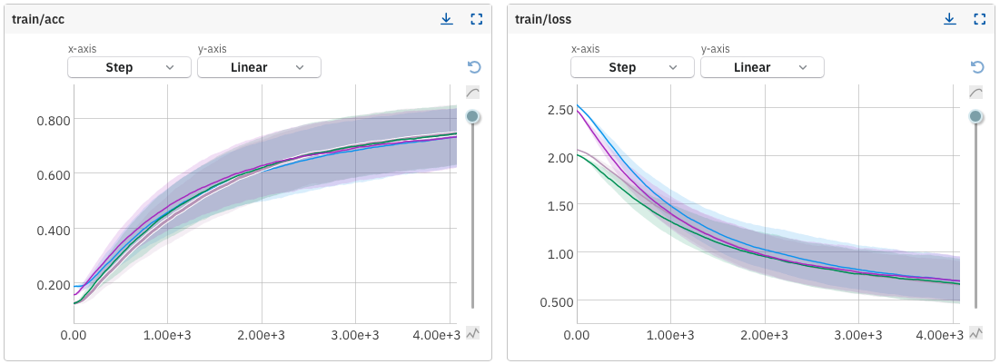

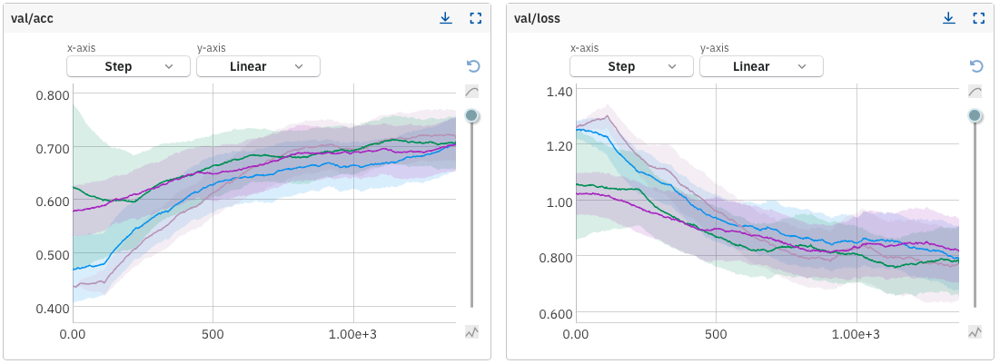

In [ ]:
net = BasicCNN(numLabels=6)
net = net.to(device)
criterionBasic = nn.CrossEntropyLoss()
optimizerBasic = optim.SGD(net.parameters(), lr=0.001, momentum=0.9)    #net.parameters is the wight of the NN

run = neptune.init_run(
    project="gihazshay/finalProjectML",
    api_token="eyJhcGlfYWRkcmVzcyI6Imh0dHBzOi8vYXBwLm5lcHR1bmUuYWkiLCJhcGlfdXJsIjoiaHR0cHM6Ly9hcHAubmVwdHVuZS5haSIsImFwaV9rZXkiOiI0Mjc3OWFhMi0zYWI3LTRiMjQtYjFiMC0xMGNkYWU4MjBkOTcifQ==",
)

params = {"learning_rate": 0.001, "optimizer": "SGD"}
run["parameters"] = params

trainModel = train(net, trainDataloader, optimizerBasic, 12, criterionBasic)
testAcc, testLoss = test(net, testDataloader, criterionBasic)

run.stop()

[neptune] [info   ] Neptune initialized. Open in the app: https://app.neptune.ai/gihazshay/finalProjectML/e/FIN-413


Epoch 0: 100%|██████████| 453/453 [00:05<00:00, 89.08batch/s]


              precision    recall  f1-score   support

           0       0.49      0.55      0.52      2451
           1       0.41      0.09      0.15      2366
           2       0.45      0.53      0.48      2581
           3       0.43      0.46      0.45      2513
           4       0.56      0.74      0.64      2333
           5       0.42      0.45      0.43      2234

    accuracy                           0.47     14478
   macro avg       0.46      0.47      0.45     14478
weighted avg       0.46      0.47      0.45     14478



Epoch 1: 100%|██████████| 453/453 [00:05<00:00, 78.87batch/s]


              precision    recall  f1-score   support

           0       0.65      0.69      0.67      2451
           1       0.47      0.36      0.41      2366
           2       0.58      0.52      0.55      2581
           3       0.54      0.67      0.60      2513
           4       0.84      0.80      0.82      2333
           5       0.56      0.61      0.58      2234

    accuracy                           0.61     14478
   macro avg       0.61      0.61      0.61     14478
weighted avg       0.61      0.61      0.60     14478



Epoch 2: 100%|██████████| 453/453 [00:05<00:00, 87.64batch/s]


              precision    recall  f1-score   support

           0       0.69      0.73      0.71      2451
           1       0.51      0.41      0.46      2366
           2       0.61      0.56      0.58      2581
           3       0.59      0.70      0.64      2513
           4       0.86      0.83      0.85      2333
           5       0.62      0.67      0.64      2234

    accuracy                           0.65     14478
   macro avg       0.65      0.65      0.65     14478
weighted avg       0.65      0.65      0.65     14478



Epoch 3: 100%|██████████| 453/453 [00:04<00:00, 93.23batch/s]


              precision    recall  f1-score   support

           0       0.69      0.74      0.72      2451
           1       0.57      0.51      0.54      2366
           2       0.63      0.61      0.62      2581
           3       0.63      0.68      0.65      2513
           4       0.87      0.83      0.85      2333
           5       0.64      0.66      0.65      2234

    accuracy                           0.67     14478
   macro avg       0.67      0.67      0.67     14478
weighted avg       0.67      0.67      0.67     14478



Epoch 4: 100%|██████████| 453/453 [00:05<00:00, 82.39batch/s]


              precision    recall  f1-score   support

           0       0.72      0.76      0.74      2451
           1       0.65      0.59      0.62      2366
           2       0.67      0.68      0.67      2581
           3       0.67      0.69      0.68      2513
           4       0.89      0.85      0.87      2333
           5       0.67      0.68      0.68      2234

    accuracy                           0.71     14478
   macro avg       0.71      0.71      0.71     14478
weighted avg       0.71      0.71      0.71     14478



Epoch 5: 100%|██████████| 453/453 [00:05<00:00, 82.32batch/s]


              precision    recall  f1-score   support

           0       0.74      0.78      0.76      2451
           1       0.68      0.61      0.64      2366
           2       0.66      0.69      0.68      2581
           3       0.70      0.72      0.71      2513
           4       0.89      0.86      0.87      2333
           5       0.70      0.71      0.70      2234

    accuracy                           0.73     14478
   macro avg       0.73      0.73      0.73     14478
weighted avg       0.73      0.73      0.73     14478



Epoch 6: 100%|██████████| 453/453 [00:04<00:00, 94.20batch/s]


              precision    recall  f1-score   support

           0       0.75      0.79      0.77      2451
           1       0.71      0.65      0.68      2366
           2       0.69      0.73      0.71      2581
           3       0.72      0.73      0.72      2513
           4       0.90      0.88      0.89      2333
           5       0.71      0.70      0.71      2234

    accuracy                           0.75     14478
   macro avg       0.75      0.75      0.75     14478
weighted avg       0.75      0.75      0.75     14478



Epoch 7: 100%|██████████| 453/453 [00:05<00:00, 87.48batch/s]


              precision    recall  f1-score   support

           0       0.76      0.79      0.77      2451
           1       0.72      0.64      0.68      2366
           2       0.68      0.73      0.70      2581
           3       0.73      0.72      0.73      2513
           4       0.91      0.89      0.90      2333
           5       0.72      0.72      0.72      2234

    accuracy                           0.75     14478
   macro avg       0.75      0.75      0.75     14478
weighted avg       0.75      0.75      0.75     14478



Epoch 8: 100%|██████████| 453/453 [00:06<00:00, 74.44batch/s]


              precision    recall  f1-score   support

           0       0.78      0.80      0.79      2451
           1       0.71      0.65      0.68      2366
           2       0.69      0.73      0.71      2581
           3       0.74      0.74      0.74      2513
           4       0.91      0.90      0.90      2333
           5       0.74      0.74      0.74      2234

    accuracy                           0.76     14478
   macro avg       0.76      0.76      0.76     14478
weighted avg       0.76      0.76      0.76     14478



Epoch 9: 100%|██████████| 453/453 [00:04<00:00, 93.03batch/s]


              precision    recall  f1-score   support

           0       0.78      0.80      0.79      2451
           1       0.75      0.71      0.73      2366
           2       0.72      0.75      0.73      2581
           3       0.76      0.75      0.76      2513
           4       0.92      0.90      0.91      2333
           5       0.75      0.75      0.75      2234

    accuracy                           0.78     14478
   macro avg       0.78      0.78      0.78     14478
weighted avg       0.78      0.78      0.78     14478



Epoch 10: 100%|██████████| 453/453 [00:05<00:00, 90.39batch/s]


              precision    recall  f1-score   support

           0       0.79      0.82      0.80      2451
           1       0.75      0.73      0.74      2366
           2       0.72      0.75      0.74      2581
           3       0.76      0.76      0.76      2513
           4       0.92      0.89      0.91      2333
           5       0.77      0.76      0.76      2234

    accuracy                           0.78     14478
   macro avg       0.78      0.78      0.78     14478
weighted avg       0.78      0.78      0.78     14478



Epoch 11: 100%|██████████| 453/453 [00:05<00:00, 76.74batch/s]


              precision    recall  f1-score   support

           0       0.79      0.81      0.80      2451
           1       0.76      0.73      0.74      2366
           2       0.73      0.76      0.74      2581
           3       0.76      0.75      0.76      2513
           4       0.92      0.90      0.91      2333
           5       0.76      0.76      0.76      2234

    accuracy                           0.78     14478
   macro avg       0.79      0.79      0.79     14478
weighted avg       0.79      0.78      0.79     14478



100%|██████████| 80/80 [00:00<00:00, 138.97batch/s]


              precision    recall  f1-score   support

           0       0.86      0.61      0.72       432
           1       0.67      0.74      0.70       418
           2       0.72      0.71      0.71       456
           3       0.78      0.67      0.72       444
           4       0.79      0.96      0.87       412
           5       0.71      0.80      0.75       394

    accuracy                           0.75      2556
   macro avg       0.75      0.75      0.75      2556
weighted avg       0.75      0.75      0.74      2556

[neptune] [info   ] Shutting down background jobs, please wait a moment...
[neptune] [info   ] Done!
[neptune] [info   ] Waiting for the remaining 491 operations to synchronize with Neptune. Do not kill this process.
[neptune] [info   ] All 491 operations synced, thanks for waiting!
[neptune] [info   ] Explore the metadata in the Neptune app: https://app.neptune.ai/gihazshay/finalProjectML/e/FIN-413/metadata


***Fisrt column: average***

***Second column: last sample***

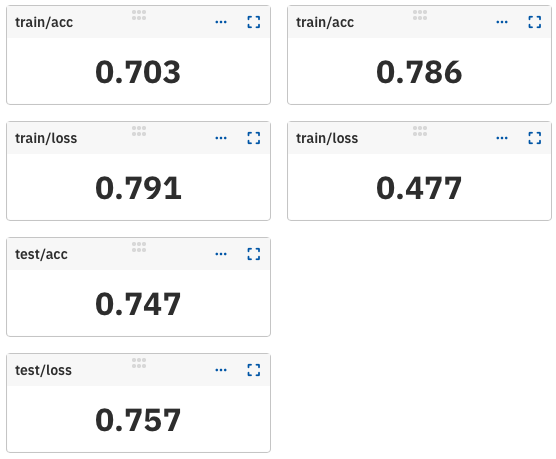

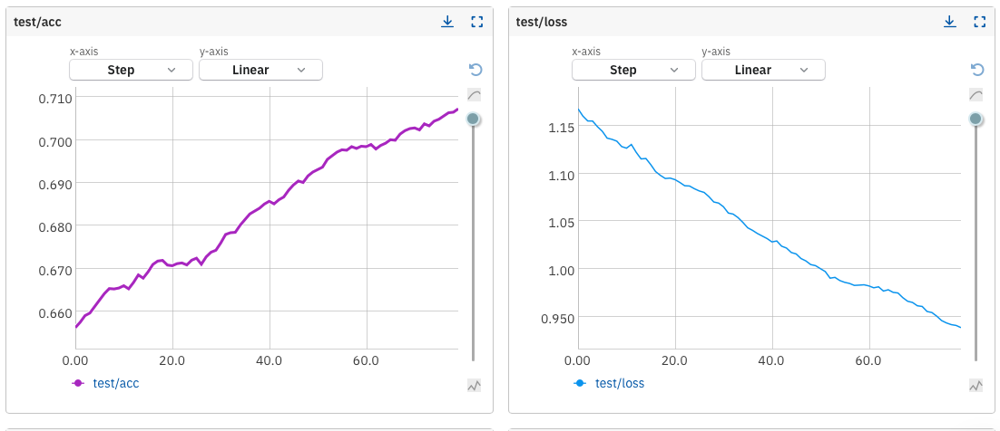

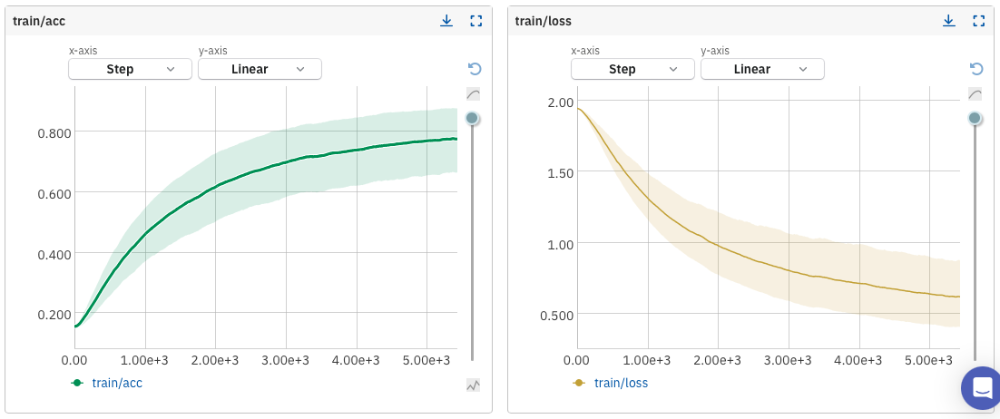

Now we can be sure that we made the right choice by choosing to use the Adam optimizer!

With Adam, we achieved the following results:


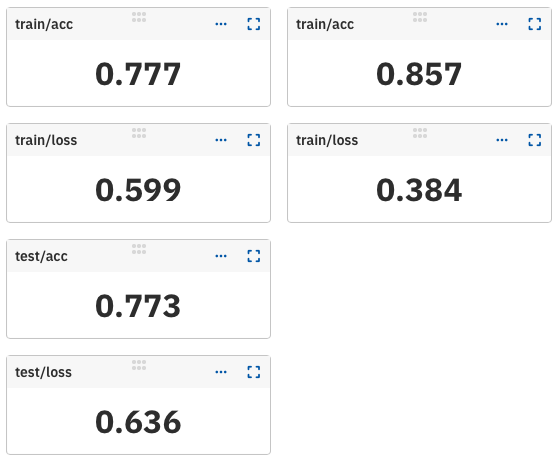

And these results are the best among the three optimizers!



---



#Noisy Data

Now we want to download the local folder from the Colab and then manually delete ״noisy״ images, i.e., specific images that act as noise in our dataset, such as flowers, a band playing ect.

In my opinion, this noise interferes with the model's learning, and I want to check if performance will improve after reducing most of the noise.

Therefore, first, we'll compress the folder we created at the beginning of the project (DataSetCombine) containing all the data into a zip file.

Then, manually, we'll create a CSV file named `noisyImages_update`, which will allow us to identify and remove any image acting as noise.

An important note: all the noisy data were part of the images defined as glaciers.

We've identified 249 noisy images. After removing these images, the data distribution remains uniform (refer back to the '`Data Distribution`' section), as the relative proportion of the Glacier label doesn't change significantly at all after the noise is removed.

In [ ]:
# Path to the folder you want to zip
folder_path = '/content/DataSetCombine'

# Name of the output zip file
output_filename = '/content/DataSetCombine'

# Creating a zip archive
shutil.make_archive(output_filename, 'zip', folder_path)

'/content/DataSetCombine.zip'

In [ ]:
noisy_df = pd.read_csv('/content/noisyImages_update.csv', header = None, names = ['index'])

In [ ]:
noisy_df

,index
0,4463
1,4466
2,4480
3,4489
4,4491
...,...
244,15478
245,15485
246,15492
247,6835


In [ ]:
imageIdx = noisy_df['index'].values

### Examples of Noise

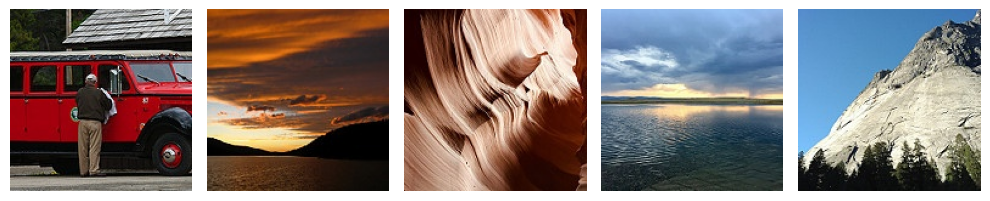

In [ ]:
fig, axes = plt.subplots(1, 5, figsize=(10, 25))  #4x6 grid of subplots

for i in range(5):
  ax = axes[i]
  idx = random.choice(imageIdx)
  image = np.array(dataset[idx][0])
  ax.imshow(image.transpose(1, 2, 0)) # squeeze Remove axes of length one
  ax.axis('off')  # Turn off axis
  #print(idx)
  #print(dataset[idx])

plt.tight_layout()
plt.show()

In [ ]:
idxTrainNoisy = []
idxTestNoisy = []
labelTrainNoisy = []
labelTestNoisy = []

After creating the CSV file, we will iterate through all the indices of both the training and test datasets and generate new lists that exclude the images acting as noise.

With these lists, we can train the model using data that is free from noise interference.

In [ ]:
for i in range(len(idxTrain)):
  if idxTrain[i] not in imageIdx:
    idxTrainNoisy.append(idxTrain[i])
    labelTrainNoisy.append(labelTrain[i])

In [ ]:
for i in range(len(idxTest)):
  if idxTrain[i] not in imageIdx:
    idxTestNoisy.append(idxTest[i])
    labelTestNoisy.append(labelTest[i])

Sanity check:

In [ ]:
len(idxTrainNoisy)

14263

In [ ]:
len(idxTrain)

14478

In [ ]:
len(idxTestNoisy)

2515

In [ ]:
len(idxTest)

2556

Convert the lists to `pandas.core.indexes.base.Index` type.

In [ ]:
idxTrainNoisy = pd.Index(idxTrainNoisy)
idxTestNoisy = pd.Index(idxTestNoisy)

### BasicNN, 12 Epochs, Adam, No noise

In [ ]:
num_folds = 4

# Initialize the KFold object
kf = KFold(n_splits=num_folds, shuffle=True, random_state=40)


foldNum = 0
foldsMatrix = {}


for train_indices, val_indices in kf.split(idxTrainNoisy):


    TrainX_Kfold = np.array([dataset[i][0] for i in idxTrainNoisy[train_indices]])
    ValX_Kfold = np.array([dataset[j][0] for j in idxTrainNoisy[val_indices]])
    TrainY_Kfold = np.array([dataset[i][1] for i in idxTrainNoisy[train_indices]])
    ValY_Kfold = np.array([dataset[j][1] for j in idxTrainNoisy[val_indices]])
    ValZ_Kfold = np.array([dataset[j][2] for j in idxTrainNoisy[val_indices]])      #ID test of the images
    TrainZ_Kfold = np.array([dataset[i][2] for i in idxTrainNoisy[train_indices]])  #ID train of the images

    tensorTrainX_Kfold = torch.tensor(TrainX_Kfold, dtype=torch.float32).to(device)
    tensorValX_Kfold = torch.tensor(ValX_Kfold, dtype=torch.float32).to(device)
    tensorTrainY_Kfold = torch.tensor(TrainY_Kfold, dtype=torch.long).to(device)
    tensorValY_Kfold = torch.tensor(ValY_Kfold, dtype=torch.long).to(device)
    tensorTrainZ_Kfold = torch.tensor(TrainZ_Kfold, dtype=torch.long).to(device)
    tensorValZ_Kfold = torch.tensor(ValZ_Kfold, dtype=torch.long).to(device)

    # Create a TensorDataset object from the data
    tensorDatasetTrain_Kfold = TensorDataset(tensorTrainX_Kfold, tensorTrainY_Kfold, tensorTrainZ_Kfold)
    tensorDatasetVal_Kfold = TensorDataset(tensorValX_Kfold, tensorValY_Kfold, tensorValZ_Kfold)

    # Create a DataLoader object with batch size 32
    trainDataloaderKfold = DataLoader(tensorDatasetTrain_Kfold, batch_size=32, shuffle=True)
    valDataloaderKfold = DataLoader(tensorDatasetVal_Kfold, batch_size=32, shuffle=True)

    print(f"------fold------:{foldNum}")

    run = neptune.init_run(
    project="gihazshay/finalProjectML",
    api_token="eyJhcGlfYWRkcmVzcyI6Imh0dHBzOi8vYXBwLm5lcHR1bmUuYWkiLCJhcGlfdXJsIjoiaHR0cHM6Ly9hcHAubmVwdHVuZS5haSIsImFwaV9rZXkiOiI0Mjc3OWFhMi0zYWI3LTRiMjQtYjFiMC0xMGNkYWU4MjBkOTcifQ==",
    )

    params = {"learning_rate": 0.001, "optimizer": "Adam"}
    run["parameters"] = params

    net = BasicCNN(numLabels=6)
    net = net.to(device)
    criterionBasic = nn.CrossEntropyLoss()
    optimizerBasic = optim.Adam(net.parameters(), lr=0.001)    #net.parameters is the wight of the NN
    trainAcc, trainLoss, valAcc, valLoss = train(net, trainDataloaderKfold, optimizerBasic, 12, criterionBasic, valDataloaderKfold)

    run.stop()
    foldsMatrix[f"fold {foldNum}"] = {'train_acc':trainAcc, 'train_loss':trainLoss,
                                      'val_acc':valAcc, 'val_loss':valLoss}
    foldNum += 1


------fold------:0
[neptune] [info   ] Neptune initialized. Open in the app: https://app.neptune.ai/gihazshay/finalProjectML/e/FIN-425


Epoch 0:   0%|          | 0/335 [00:00<?, ?batch/s]/usr/local/lib/python3.10/dist-packages/torch/autograd/graph.py:744: UserWarning: Plan failed with a cudnnException: CUDNN_BACKEND_EXECUTION_PLAN_DESCRIPTOR: cudnnFinalize Descriptor Failed cudnn_status: CUDNN_STATUS_NOT_SUPPORTED (Triggered internally at ../aten/src/ATen/native/cudnn/Conv_v8.cpp:919.)
  return Variable._execution_engine.run_backward(  # Calls into the C++ engine to run the backward pass
Epoch 0: 100%|██████████| 335/335 [00:04<00:00, 68.64batch/s]


              precision    recall  f1-score   support

           0       0.45      0.54      0.49      1853
           1       0.37      0.19      0.25      1756
           2       0.48      0.52      0.50      1931
           3       0.47      0.47      0.47      1727
           4       0.55      0.58      0.56      1732
           5       0.44      0.49      0.46      1698

    accuracy                           0.47     10697
   macro avg       0.46      0.47      0.46     10697
weighted avg       0.46      0.47      0.46     10697

Validtion part------EPOCH------:0


100%|██████████| 112/112 [00:00<00:00, 314.26batch/s]


              precision    recall  f1-score   support

           0       0.60      0.69      0.64       598
           1       0.44      0.34      0.38       610
           2       0.50      0.73      0.59       650
           3       0.59      0.51      0.55       571
           4       0.85      0.56      0.68       601
           5       0.54      0.57      0.56       536

    accuracy                           0.57      3566
   macro avg       0.59      0.57      0.57      3566
weighted avg       0.59      0.57      0.57      3566



Epoch 1: 100%|██████████| 335/335 [00:02<00:00, 135.01batch/s]


              precision    recall  f1-score   support

           0       0.66      0.68      0.67      1853
           1       0.48      0.30      0.37      1756
           2       0.60      0.63      0.61      1931
           3       0.58      0.69      0.63      1727
           4       0.80      0.78      0.79      1732
           5       0.55      0.62      0.58      1698

    accuracy                           0.62     10697
   macro avg       0.61      0.62      0.61     10697
weighted avg       0.61      0.62      0.61     10697

Validtion part------EPOCH------:1


100%|██████████| 112/112 [00:00<00:00, 311.95batch/s]


              precision    recall  f1-score   support

           0       0.60      0.70      0.64       598
           1       0.55      0.37      0.44       610
           2       0.63      0.55      0.59       650
           3       0.70      0.51      0.59       571
           4       0.72      0.93      0.81       601
           5       0.44      0.57      0.50       536

    accuracy                           0.60      3566
   macro avg       0.61      0.60      0.60      3566
weighted avg       0.61      0.60      0.60      3566



Epoch 2: 100%|██████████| 335/335 [00:02<00:00, 133.03batch/s]


              precision    recall  f1-score   support

           0       0.71      0.74      0.73      1853
           1       0.53      0.37      0.44      1756
           2       0.63      0.65      0.64      1931
           3       0.62      0.72      0.66      1727
           4       0.87      0.82      0.84      1732
           5       0.60      0.67      0.63      1698

    accuracy                           0.66     10697
   macro avg       0.66      0.66      0.66     10697
weighted avg       0.66      0.66      0.66     10697

Validtion part------EPOCH------:2


100%|██████████| 112/112 [00:00<00:00, 254.56batch/s]


              precision    recall  f1-score   support

           0       0.75      0.69      0.72       598
           1       0.57      0.37      0.45       610
           2       0.71      0.48      0.58       650
           3       0.65      0.75      0.69       571
           4       0.84      0.89      0.87       601
           5       0.45      0.75      0.57       536

    accuracy                           0.65      3566
   macro avg       0.66      0.66      0.65      3566
weighted avg       0.67      0.65      0.64      3566



Epoch 3: 100%|██████████| 335/335 [00:02<00:00, 111.79batch/s]


              precision    recall  f1-score   support

           0       0.74      0.78      0.76      1853
           1       0.56      0.42      0.48      1756
           2       0.64      0.65      0.64      1931
           3       0.64      0.74      0.69      1727
           4       0.89      0.84      0.86      1732
           5       0.64      0.70      0.67      1698

    accuracy                           0.69     10697
   macro avg       0.69      0.69      0.69     10697
weighted avg       0.69      0.69      0.69     10697

Validtion part------EPOCH------:3


100%|██████████| 112/112 [00:00<00:00, 241.25batch/s]


              precision    recall  f1-score   support

           0       0.74      0.79      0.77       598
           1       0.56      0.50      0.53       610
           2       0.64      0.63      0.64       650
           3       0.69      0.74      0.71       571
           4       0.87      0.91      0.89       601
           5       0.67      0.62      0.65       536

    accuracy                           0.70      3566
   macro avg       0.70      0.70      0.70      3566
weighted avg       0.70      0.70      0.70      3566



Epoch 4: 100%|██████████| 335/335 [00:04<00:00, 80.96batch/s] 


              precision    recall  f1-score   support

           0       0.76      0.80      0.78      1853
           1       0.58      0.47      0.52      1756
           2       0.67      0.66      0.67      1931
           3       0.66      0.76      0.70      1727
           4       0.91      0.86      0.89      1732
           5       0.68      0.72      0.70      1698

    accuracy                           0.71     10697
   macro avg       0.71      0.71      0.71     10697
weighted avg       0.71      0.71      0.71     10697

Validtion part------EPOCH------:4


100%|██████████| 112/112 [00:00<00:00, 310.63batch/s]


              precision    recall  f1-score   support

           0       0.66      0.90      0.76       598
           1       0.58      0.53      0.56       610
           2       0.72      0.63      0.67       650
           3       0.68      0.76      0.72       571
           4       0.98      0.81      0.89       601
           5       0.69      0.62      0.65       536

    accuracy                           0.71      3566
   macro avg       0.72      0.71      0.71      3566
weighted avg       0.72      0.71      0.71      3566



Epoch 5: 100%|██████████| 335/335 [00:02<00:00, 130.30batch/s]


              precision    recall  f1-score   support

           0       0.79      0.82      0.80      1853
           1       0.60      0.51      0.55      1756
           2       0.67      0.66      0.66      1931
           3       0.67      0.77      0.72      1727
           4       0.92      0.88      0.90      1732
           5       0.71      0.74      0.72      1698

    accuracy                           0.73     10697
   macro avg       0.73      0.73      0.73     10697
weighted avg       0.73      0.73      0.73     10697

Validtion part------EPOCH------:5


100%|██████████| 112/112 [00:00<00:00, 318.74batch/s]


              precision    recall  f1-score   support

           0       0.69      0.85      0.76       598
           1       0.53      0.61      0.57       610
           2       0.63      0.69      0.66       650
           3       0.71      0.59      0.65       571
           4       0.98      0.79      0.87       601
           5       0.72      0.61      0.66       536

    accuracy                           0.69      3566
   macro avg       0.71      0.69      0.69      3566
weighted avg       0.71      0.69      0.69      3566



Epoch 6: 100%|██████████| 335/335 [00:02<00:00, 133.27batch/s]


              precision    recall  f1-score   support

           0       0.79      0.81      0.80      1853
           1       0.62      0.53      0.57      1756
           2       0.69      0.66      0.68      1931
           3       0.68      0.76      0.72      1727
           4       0.90      0.88      0.89      1732
           5       0.71      0.75      0.73      1698

    accuracy                           0.73     10697
   macro avg       0.73      0.73      0.73     10697
weighted avg       0.73      0.73      0.73     10697

Validtion part------EPOCH------:6


100%|██████████| 112/112 [00:00<00:00, 318.85batch/s]


              precision    recall  f1-score   support

           0       0.81      0.73      0.77       598
           1       0.63      0.55      0.59       610
           2       0.73      0.63      0.68       650
           3       0.67      0.84      0.74       571
           4       0.91      0.90      0.91       601
           5       0.64      0.75      0.69       536

    accuracy                           0.73      3566
   macro avg       0.73      0.73      0.73      3566
weighted avg       0.73      0.73      0.73      3566



Epoch 7: 100%|██████████| 335/335 [00:02<00:00, 132.66batch/s]


              precision    recall  f1-score   support

           0       0.82      0.83      0.82      1853
           1       0.66      0.59      0.62      1756
           2       0.71      0.67      0.69      1931
           3       0.70      0.80      0.75      1727
           4       0.93      0.90      0.92      1732
           5       0.75      0.77      0.76      1698

    accuracy                           0.76     10697
   macro avg       0.76      0.76      0.76     10697
weighted avg       0.76      0.76      0.76     10697

Validtion part------EPOCH------:7


100%|██████████| 112/112 [00:00<00:00, 303.87batch/s]


              precision    recall  f1-score   support

           0       0.76      0.77      0.77       598
           1       0.65      0.58      0.61       610
           2       0.84      0.51      0.63       650
           3       0.65      0.85      0.74       571
           4       0.92      0.90      0.91       601
           5       0.60      0.76      0.67       536

    accuracy                           0.72      3566
   macro avg       0.74      0.73      0.72      3566
weighted avg       0.74      0.72      0.72      3566



Epoch 8: 100%|██████████| 335/335 [00:02<00:00, 116.16batch/s]


              precision    recall  f1-score   support

           0       0.83      0.84      0.84      1853
           1       0.68      0.63      0.65      1756
           2       0.73      0.69      0.71      1931
           3       0.72      0.80      0.76      1727
           4       0.93      0.91      0.92      1732
           5       0.76      0.78      0.77      1698

    accuracy                           0.77     10697
   macro avg       0.78      0.78      0.77     10697
weighted avg       0.77      0.77      0.77     10697

Validtion part------EPOCH------:8


100%|██████████| 112/112 [00:00<00:00, 261.47batch/s]


              precision    recall  f1-score   support

           0       0.79      0.77      0.78       598
           1       0.59      0.73      0.65       610
           2       0.78      0.58      0.66       650
           3       0.74      0.74      0.74       571
           4       0.95      0.88      0.91       601
           5       0.65      0.76      0.70       536

    accuracy                           0.74      3566
   macro avg       0.75      0.74      0.74      3566
weighted avg       0.75      0.74      0.74      3566



Epoch 9: 100%|██████████| 335/335 [00:03<00:00, 107.12batch/s]


              precision    recall  f1-score   support

           0       0.83      0.84      0.84      1853
           1       0.67      0.63      0.65      1756
           2       0.73      0.69      0.71      1931
           3       0.72      0.79      0.75      1727
           4       0.93      0.91      0.92      1732
           5       0.76      0.79      0.77      1698

    accuracy                           0.77     10697
   macro avg       0.77      0.77      0.77     10697
weighted avg       0.77      0.77      0.77     10697

Validtion part------EPOCH------:9


100%|██████████| 112/112 [00:00<00:00, 239.26batch/s]


              precision    recall  f1-score   support

           0       0.76      0.80      0.78       598
           1       0.66      0.58      0.62       610
           2       0.72      0.61      0.66       650
           3       0.71      0.79      0.75       571
           4       0.97      0.84      0.90       601
           5       0.60      0.76      0.67       536

    accuracy                           0.73      3566
   macro avg       0.74      0.73      0.73      3566
weighted avg       0.74      0.73      0.73      3566



Epoch 10: 100%|██████████| 335/335 [00:02<00:00, 125.60batch/s]


              precision    recall  f1-score   support

           0       0.84      0.85      0.85      1853
           1       0.70      0.65      0.67      1756
           2       0.75      0.70      0.72      1931
           3       0.73      0.81      0.76      1727
           4       0.93      0.92      0.93      1732
           5       0.78      0.81      0.80      1698

    accuracy                           0.79     10697
   macro avg       0.79      0.79      0.79     10697
weighted avg       0.79      0.79      0.79     10697

Validtion part------EPOCH------:10


100%|██████████| 112/112 [00:00<00:00, 315.07batch/s]


              precision    recall  f1-score   support

           0       0.80      0.77      0.78       598
           1       0.62      0.71      0.67       610
           2       0.68      0.71      0.69       650
           3       0.80      0.63      0.71       571
           4       0.89      0.93      0.91       601
           5       0.71      0.70      0.71       536

    accuracy                           0.74      3566
   macro avg       0.75      0.74      0.74      3566
weighted avg       0.75      0.74      0.74      3566



Epoch 11: 100%|██████████| 335/335 [00:02<00:00, 132.91batch/s]


              precision    recall  f1-score   support

           0       0.86      0.86      0.86      1853
           1       0.71      0.68      0.70      1756
           2       0.74      0.71      0.72      1931
           3       0.74      0.81      0.77      1727
           4       0.94      0.92      0.93      1732
           5       0.80      0.81      0.81      1698

    accuracy                           0.80     10697
   macro avg       0.80      0.80      0.80     10697
weighted avg       0.80      0.80      0.80     10697

Validtion part------EPOCH------:11


100%|██████████| 112/112 [00:00<00:00, 314.30batch/s]


              precision    recall  f1-score   support

           0       0.77      0.81      0.79       598
           1       0.72      0.51      0.60       610
           2       0.72      0.70      0.71       650
           3       0.66      0.87      0.75       571
           4       0.94      0.91      0.92       601
           5       0.70      0.71      0.71       536

    accuracy                           0.75      3566
   macro avg       0.75      0.75      0.75      3566
weighted avg       0.75      0.75      0.75      3566

[neptune] [info   ] Shutting down background jobs, please wait a moment...
[neptune] [info   ] Done!
[neptune] [info   ] Waiting for the remaining 110 operations to synchronize with Neptune. Do not kill this process.
[neptune] [info   ] All 110 operations synced, thanks for waiting!
[neptune] [info   ] Explore the metadata in the Neptune app: https://app.neptune.ai/gihazshay/finalProjectML/e/FIN-425/metadata
------fold------:1
[neptune] [info   ] Neptun

Epoch 0: 100%|██████████| 335/335 [00:02<00:00, 125.10batch/s]


              precision    recall  f1-score   support

           0       0.51      0.61      0.56      1844
           1       0.41      0.22      0.29      1781
           2       0.52      0.54      0.53      1943
           3       0.51      0.58      0.54      1696
           4       0.72      0.77      0.74      1782
           5       0.41      0.41      0.41      1651

    accuracy                           0.52     10697
   macro avg       0.51      0.52      0.51     10697
weighted avg       0.51      0.52      0.51     10697

Validtion part------EPOCH------:0


100%|██████████| 112/112 [00:00<00:00, 309.80batch/s]


              precision    recall  f1-score   support

           0       0.62      0.77      0.68       607
           1       0.64      0.16      0.26       585
           2       0.61      0.61      0.61       638
           3       0.56      0.71      0.63       602
           4       0.71      0.91      0.80       551
           5       0.51      0.49      0.50       583

    accuracy                           0.61      3566
   macro avg       0.61      0.61      0.58      3566
weighted avg       0.61      0.61      0.58      3566



Epoch 1: 100%|██████████| 335/335 [00:02<00:00, 124.86batch/s]


              precision    recall  f1-score   support

           0       0.70      0.73      0.71      1844
           1       0.54      0.42      0.47      1781
           2       0.63      0.63      0.63      1943
           3       0.61      0.67      0.64      1696
           4       0.85      0.85      0.85      1782
           5       0.54      0.58      0.56      1651

    accuracy                           0.65     10697
   macro avg       0.64      0.65      0.64     10697
weighted avg       0.65      0.65      0.65     10697

Validtion part------EPOCH------:1


100%|██████████| 112/112 [00:00<00:00, 252.41batch/s]


              precision    recall  f1-score   support

           0       0.67      0.69      0.68       607
           1       0.54      0.60      0.57       585
           2       0.67      0.58      0.62       638
           3       0.58      0.67      0.62       602
           4       0.97      0.63      0.76       551
           5       0.59      0.70      0.64       583

    accuracy                           0.64      3566
   macro avg       0.67      0.64      0.65      3566
weighted avg       0.67      0.64      0.65      3566



Epoch 2: 100%|██████████| 335/335 [00:03<00:00, 110.27batch/s]


              precision    recall  f1-score   support

           0       0.74      0.75      0.75      1844
           1       0.61      0.53      0.57      1781
           2       0.66      0.65      0.66      1943
           3       0.65      0.72      0.68      1696
           4       0.90      0.86      0.88      1782
           5       0.61      0.66      0.64      1651

    accuracy                           0.70     10697
   macro avg       0.70      0.70      0.69     10697
weighted avg       0.70      0.70      0.70     10697

Validtion part------EPOCH------:2


100%|██████████| 112/112 [00:00<00:00, 242.47batch/s]


              precision    recall  f1-score   support

           0       0.75      0.77      0.76       607
           1       0.70      0.54      0.61       585
           2       0.72      0.58      0.64       638
           3       0.59      0.90      0.72       602
           4       0.91      0.85      0.88       551
           5       0.72      0.67      0.69       583

    accuracy                           0.72      3566
   macro avg       0.73      0.72      0.72      3566
weighted avg       0.73      0.72      0.71      3566



Epoch 3: 100%|██████████| 335/335 [00:02<00:00, 111.70batch/s]


              precision    recall  f1-score   support

           0       0.75      0.76      0.75      1844
           1       0.66      0.59      0.62      1781
           2       0.70      0.67      0.68      1943
           3       0.67      0.75      0.71      1696
           4       0.91      0.89      0.90      1782
           5       0.67      0.68      0.67      1651

    accuracy                           0.72     10697
   macro avg       0.72      0.72      0.72     10697
weighted avg       0.73      0.72      0.72     10697

Validtion part------EPOCH------:3


100%|██████████| 112/112 [00:00<00:00, 308.68batch/s]


              precision    recall  f1-score   support

           0       0.78      0.68      0.72       607
           1       0.56      0.74      0.64       585
           2       0.71      0.64      0.67       638
           3       0.66      0.70      0.68       602
           4       0.97      0.81      0.88       551
           5       0.67      0.68      0.68       583

    accuracy                           0.71      3566
   macro avg       0.72      0.71      0.71      3566
weighted avg       0.72      0.71      0.71      3566



Epoch 4: 100%|██████████| 335/335 [00:02<00:00, 123.67batch/s]


              precision    recall  f1-score   support

           0       0.78      0.77      0.78      1844
           1       0.70      0.67      0.68      1781
           2       0.73      0.69      0.71      1943
           3       0.71      0.77      0.74      1696
           4       0.93      0.91      0.92      1782
           5       0.68      0.72      0.70      1651

    accuracy                           0.75     10697
   macro avg       0.75      0.75      0.75     10697
weighted avg       0.75      0.75      0.75     10697

Validtion part------EPOCH------:4


100%|██████████| 112/112 [00:00<00:00, 309.05batch/s]


              precision    recall  f1-score   support

           0       0.75      0.70      0.72       607
           1       0.77      0.60      0.67       585
           2       0.67      0.72      0.70       638
           3       0.73      0.76      0.74       602
           4       0.97      0.76      0.85       551
           5       0.61      0.83      0.70       583

    accuracy                           0.73      3566
   macro avg       0.75      0.73      0.73      3566
weighted avg       0.75      0.73      0.73      3566



Epoch 5: 100%|██████████| 335/335 [00:02<00:00, 127.78batch/s]


              precision    recall  f1-score   support

           0       0.79      0.79      0.79      1844
           1       0.72      0.69      0.70      1781
           2       0.72      0.71      0.72      1943
           3       0.71      0.76      0.73      1696
           4       0.92      0.91      0.91      1782
           5       0.72      0.73      0.73      1651

    accuracy                           0.76     10697
   macro avg       0.76      0.76      0.76     10697
weighted avg       0.76      0.76      0.76     10697

Validtion part------EPOCH------:5


100%|██████████| 112/112 [00:00<00:00, 314.03batch/s]


              precision    recall  f1-score   support

           0       0.66      0.79      0.72       607
           1       0.62      0.72      0.67       585
           2       0.71      0.61      0.66       638
           3       0.59      0.81      0.69       602
           4       0.98      0.65      0.78       551
           5       0.79      0.57      0.66       583

    accuracy                           0.69      3566
   macro avg       0.73      0.69      0.70      3566
weighted avg       0.72      0.69      0.69      3566



Epoch 6: 100%|██████████| 335/335 [00:02<00:00, 130.14batch/s]


              precision    recall  f1-score   support

           0       0.79      0.81      0.80      1844
           1       0.75      0.71      0.73      1781
           2       0.75      0.74      0.74      1943
           3       0.74      0.78      0.76      1696
           4       0.93      0.91      0.92      1782
           5       0.73      0.74      0.73      1651

    accuracy                           0.78     10697
   macro avg       0.78      0.78      0.78     10697
weighted avg       0.78      0.78      0.78     10697

Validtion part------EPOCH------:6


100%|██████████| 112/112 [00:00<00:00, 294.94batch/s]


              precision    recall  f1-score   support

           0       0.79      0.78      0.79       607
           1       0.72      0.69      0.71       585
           2       0.72      0.71      0.71       638
           3       0.75      0.78      0.76       602
           4       0.92      0.93      0.93       551
           5       0.72      0.75      0.74       583

    accuracy                           0.77      3566
   macro avg       0.77      0.77      0.77      3566
weighted avg       0.77      0.77      0.77      3566



Epoch 7: 100%|██████████| 335/335 [00:02<00:00, 116.10batch/s]


              precision    recall  f1-score   support

           0       0.82      0.83      0.82      1844
           1       0.75      0.74      0.74      1781
           2       0.76      0.73      0.74      1943
           3       0.74      0.79      0.77      1696
           4       0.93      0.92      0.93      1782
           5       0.75      0.76      0.76      1651

    accuracy                           0.79     10697
   macro avg       0.79      0.79      0.79     10697
weighted avg       0.79      0.79      0.79     10697

Validtion part------EPOCH------:7


100%|██████████| 112/112 [00:00<00:00, 250.68batch/s]


              precision    recall  f1-score   support

           0       0.83      0.74      0.78       607
           1       0.84      0.40      0.54       585
           2       0.59      0.82      0.68       638
           3       0.64      0.82      0.72       602
           4       0.94      0.92      0.93       551
           5       0.75      0.72      0.73       583

    accuracy                           0.73      3566
   macro avg       0.77      0.73      0.73      3566
weighted avg       0.76      0.73      0.73      3566



Epoch 8: 100%|██████████| 335/335 [00:03<00:00, 104.75batch/s]


              precision    recall  f1-score   support

           0       0.83      0.83      0.83      1844
           1       0.75      0.73      0.74      1781
           2       0.75      0.73      0.74      1943
           3       0.73      0.78      0.75      1696
           4       0.93      0.92      0.93      1782
           5       0.77      0.78      0.78      1651

    accuracy                           0.79     10697
   macro avg       0.79      0.79      0.79     10697
weighted avg       0.79      0.79      0.79     10697

Validtion part------EPOCH------:8


100%|██████████| 112/112 [00:00<00:00, 214.73batch/s]


              precision    recall  f1-score   support

           0       0.72      0.89      0.79       607
           1       0.79      0.68      0.73       585
           2       0.76      0.69      0.72       638
           3       0.72      0.82      0.77       602
           4       0.91      0.92      0.91       551
           5       0.77      0.64      0.70       583

    accuracy                           0.77      3566
   macro avg       0.78      0.77      0.77      3566
weighted avg       0.77      0.77      0.77      3566



Epoch 9: 100%|██████████| 335/335 [00:02<00:00, 120.33batch/s]


              precision    recall  f1-score   support

           0       0.84      0.84      0.84      1844
           1       0.77      0.76      0.76      1781
           2       0.77      0.75      0.76      1943
           3       0.75      0.79      0.77      1696
           4       0.94      0.94      0.94      1782
           5       0.79      0.80      0.80      1651

    accuracy                           0.81     10697
   macro avg       0.81      0.81      0.81     10697
weighted avg       0.81      0.81      0.81     10697

Validtion part------EPOCH------:9


100%|██████████| 112/112 [00:00<00:00, 311.78batch/s]


              precision    recall  f1-score   support

           0       0.83      0.64      0.72       607
           1       0.81      0.63      0.71       585
           2       0.76      0.68      0.72       638
           3       0.73      0.83      0.78       602
           4       0.92      0.92      0.92       551
           5       0.60      0.86      0.71       583

    accuracy                           0.76      3566
   macro avg       0.78      0.76      0.76      3566
weighted avg       0.77      0.76      0.76      3566



Epoch 10: 100%|██████████| 335/335 [00:02<00:00, 123.47batch/s]


              precision    recall  f1-score   support

           0       0.85      0.85      0.85      1844
           1       0.78      0.76      0.77      1781
           2       0.78      0.75      0.76      1943
           3       0.76      0.80      0.78      1696
           4       0.95      0.94      0.94      1782
           5       0.80      0.80      0.80      1651

    accuracy                           0.82     10697
   macro avg       0.82      0.82      0.82     10697
weighted avg       0.82      0.82      0.82     10697

Validtion part------EPOCH------:10


100%|██████████| 112/112 [00:00<00:00, 310.49batch/s]


              precision    recall  f1-score   support

           0       0.82      0.76      0.79       607
           1       0.60      0.84      0.70       585
           2       0.81      0.58      0.68       638
           3       0.78      0.71      0.74       602
           4       0.94      0.91      0.93       551
           5       0.70      0.78      0.73       583

    accuracy                           0.76      3566
   macro avg       0.77      0.76      0.76      3566
weighted avg       0.77      0.76      0.76      3566



Epoch 11: 100%|██████████| 335/335 [00:02<00:00, 128.57batch/s]


              precision    recall  f1-score   support

           0       0.85      0.86      0.86      1844
           1       0.78      0.77      0.78      1781
           2       0.78      0.76      0.77      1943
           3       0.77      0.80      0.78      1696
           4       0.95      0.94      0.94      1782
           5       0.82      0.82      0.82      1651

    accuracy                           0.82     10697
   macro avg       0.82      0.82      0.82     10697
weighted avg       0.82      0.82      0.82     10697

Validtion part------EPOCH------:11


100%|██████████| 112/112 [00:00<00:00, 308.93batch/s]


              precision    recall  f1-score   support

           0       0.70      0.85      0.77       607
           1       0.67      0.76      0.71       585
           2       0.69      0.75      0.72       638
           3       0.86      0.55      0.67       602
           4       0.93      0.88      0.90       551
           5       0.71      0.69      0.70       583

    accuracy                           0.75      3566
   macro avg       0.76      0.75      0.75      3566
weighted avg       0.76      0.75      0.74      3566

[neptune] [info   ] Shutting down background jobs, please wait a moment...
[neptune] [info   ] Done!
[neptune] [info   ] Waiting for the remaining 15 operations to synchronize with Neptune. Do not kill this process.
[neptune] [info   ] All 15 operations synced, thanks for waiting!
[neptune] [info   ] Explore the metadata in the Neptune app: https://app.neptune.ai/gihazshay/finalProjectML/e/FIN-426/metadata
------fold------:2
[neptune] [info   ] Neptune 

Epoch 0: 100%|██████████| 335/335 [00:02<00:00, 115.55batch/s]


              precision    recall  f1-score   support

           0       0.54      0.65      0.59      1815
           1       0.47      0.36      0.41      1758
           2       0.53      0.43      0.47      1929
           3       0.50      0.57      0.53      1741
           4       0.78      0.71      0.75      1763
           5       0.46      0.53      0.49      1691

    accuracy                           0.54     10697
   macro avg       0.55      0.54      0.54     10697
weighted avg       0.55      0.54      0.54     10697

Validtion part------EPOCH------:0


100%|██████████| 112/112 [00:00<00:00, 261.58batch/s]


              precision    recall  f1-score   support

           0       0.62      0.86      0.72       636
           1       0.53      0.55      0.54       608
           2       0.71      0.46      0.55       652
           3       0.59      0.71      0.64       557
           4       0.93      0.78      0.85       570
           5       0.59      0.54      0.56       543

    accuracy                           0.65      3566
   macro avg       0.66      0.65      0.65      3566
weighted avg       0.66      0.65      0.64      3566



Epoch 1: 100%|██████████| 335/335 [00:03<00:00, 107.73batch/s]


              precision    recall  f1-score   support

           0       0.72      0.74      0.73      1815
           1       0.59      0.52      0.56      1758
           2       0.64      0.61      0.62      1929
           3       0.65      0.73      0.69      1741
           4       0.87      0.86      0.87      1763
           5       0.64      0.67      0.66      1691

    accuracy                           0.69     10697
   macro avg       0.69      0.69      0.69     10697
weighted avg       0.69      0.69      0.69     10697

Validtion part------EPOCH------:1


100%|██████████| 112/112 [00:00<00:00, 236.18batch/s]


              precision    recall  f1-score   support

           0       0.75      0.75      0.75       636
           1       0.53      0.75      0.62       608
           2       0.77      0.48      0.59       652
           3       0.63      0.77      0.69       557
           4       0.94      0.86      0.90       570
           5       0.69      0.60      0.64       543

    accuracy                           0.70      3566
   macro avg       0.72      0.70      0.70      3566
weighted avg       0.72      0.70      0.70      3566



Epoch 2: 100%|██████████| 335/335 [00:03<00:00, 109.33batch/s]


              precision    recall  f1-score   support

           0       0.77      0.78      0.77      1815
           1       0.67      0.61      0.64      1758
           2       0.69      0.65      0.67      1929
           3       0.69      0.77      0.73      1741
           4       0.90      0.88      0.89      1763
           5       0.71      0.73      0.72      1691

    accuracy                           0.74     10697
   macro avg       0.74      0.74      0.74     10697
weighted avg       0.74      0.74      0.74     10697

Validtion part------EPOCH------:2


100%|██████████| 112/112 [00:00<00:00, 288.42batch/s]


              precision    recall  f1-score   support

           0       0.85      0.66      0.75       636
           1       0.71      0.51      0.59       608
           2       0.80      0.49      0.61       652
           3       0.48      0.96      0.64       557
           4       0.92      0.86      0.89       570
           5       0.66      0.72      0.69       543

    accuracy                           0.69      3566
   macro avg       0.74      0.70      0.69      3566
weighted avg       0.74      0.69      0.69      3566



Epoch 3: 100%|██████████| 335/335 [00:02<00:00, 125.70batch/s]


              precision    recall  f1-score   support

           0       0.79      0.80      0.80      1815
           1       0.70      0.64      0.67      1758
           2       0.70      0.67      0.69      1929
           3       0.71      0.80      0.75      1741
           4       0.91      0.89      0.90      1763
           5       0.74      0.76      0.75      1691

    accuracy                           0.76     10697
   macro avg       0.76      0.76      0.76     10697
weighted avg       0.76      0.76      0.76     10697

Validtion part------EPOCH------:3


100%|██████████| 112/112 [00:00<00:00, 299.75batch/s]


              precision    recall  f1-score   support

           0       0.75      0.85      0.80       636
           1       0.84      0.44      0.58       608
           2       0.72      0.65      0.68       652
           3       0.56      0.92      0.69       557
           4       0.90      0.92      0.91       570
           5       0.77      0.61      0.68       543

    accuracy                           0.73      3566
   macro avg       0.76      0.73      0.72      3566
weighted avg       0.76      0.73      0.72      3566



Epoch 4: 100%|██████████| 335/335 [00:02<00:00, 125.24batch/s]


              precision    recall  f1-score   support

           0       0.82      0.82      0.82      1815
           1       0.74      0.69      0.71      1758
           2       0.74      0.70      0.72      1929
           3       0.74      0.83      0.78      1741
           4       0.92      0.91      0.92      1763
           5       0.77      0.78      0.78      1691

    accuracy                           0.79     10697
   macro avg       0.79      0.79      0.79     10697
weighted avg       0.79      0.79      0.79     10697

Validtion part------EPOCH------:4


100%|██████████| 112/112 [00:00<00:00, 295.14batch/s]


              precision    recall  f1-score   support

           0       0.74      0.82      0.78       636
           1       0.82      0.47      0.60       608
           2       0.69      0.73      0.71       652
           3       0.81      0.59      0.68       557
           4       0.91      0.89      0.90       570
           5       0.50      0.79      0.61       543

    accuracy                           0.72      3566
   macro avg       0.75      0.72      0.71      3566
weighted avg       0.75      0.72      0.71      3566



Epoch 5: 100%|██████████| 335/335 [00:02<00:00, 119.94batch/s]


              precision    recall  f1-score   support

           0       0.82      0.83      0.83      1815
           1       0.75      0.70      0.72      1758
           2       0.75      0.71      0.73      1929
           3       0.75      0.82      0.78      1741
           4       0.92      0.91      0.92      1763
           5       0.78      0.79      0.78      1691

    accuracy                           0.79     10697
   macro avg       0.79      0.80      0.79     10697
weighted avg       0.79      0.79      0.79     10697

Validtion part------EPOCH------:5


100%|██████████| 112/112 [00:00<00:00, 296.06batch/s]


              precision    recall  f1-score   support

           0       0.78      0.78      0.78       636
           1       0.62      0.82      0.70       608
           2       0.80      0.65      0.71       652
           3       0.77      0.72      0.74       557
           4       0.85      0.95      0.90       570
           5       0.77      0.64      0.70       543

    accuracy                           0.76      3566
   macro avg       0.76      0.76      0.76      3566
weighted avg       0.76      0.76      0.75      3566



Epoch 6: 100%|██████████| 335/335 [00:02<00:00, 118.75batch/s]


              precision    recall  f1-score   support

           0       0.84      0.85      0.84      1815
           1       0.76      0.73      0.74      1758
           2       0.76      0.73      0.74      1929
           3       0.75      0.82      0.78      1741
           4       0.93      0.92      0.92      1763
           5       0.80      0.80      0.80      1691

    accuracy                           0.81     10697
   macro avg       0.81      0.81      0.81     10697
weighted avg       0.81      0.81      0.81     10697

Validtion part------EPOCH------:6


100%|██████████| 112/112 [00:00<00:00, 231.08batch/s]


              precision    recall  f1-score   support

           0       0.77      0.84      0.81       636
           1       0.72      0.74      0.73       608
           2       0.71      0.77      0.74       652
           3       0.76      0.71      0.73       557
           4       0.94      0.90      0.92       570
           5       0.77      0.69      0.73       543

    accuracy                           0.78      3566
   macro avg       0.78      0.77      0.78      3566
weighted avg       0.78      0.78      0.78      3566



Epoch 7: 100%|██████████| 335/335 [00:03<00:00, 108.51batch/s]


              precision    recall  f1-score   support

           0       0.83      0.84      0.83      1815
           1       0.77      0.74      0.75      1758
           2       0.77      0.74      0.75      1929
           3       0.76      0.83      0.79      1741
           4       0.93      0.92      0.92      1763
           5       0.80      0.79      0.79      1691

    accuracy                           0.81     10697
   macro avg       0.81      0.81      0.81     10697
weighted avg       0.81      0.81      0.81     10697

Validtion part------EPOCH------:7


100%|██████████| 112/112 [00:00<00:00, 232.02batch/s]


              precision    recall  f1-score   support

           0       0.78      0.82      0.80       636
           1       0.79      0.63      0.70       608
           2       0.74      0.72      0.73       652
           3       0.65      0.88      0.74       557
           4       0.92      0.91      0.91       570
           5       0.79      0.66      0.72       543

    accuracy                           0.77      3566
   macro avg       0.78      0.77      0.77      3566
weighted avg       0.78      0.77      0.77      3566



Epoch 8: 100%|██████████| 335/335 [00:03<00:00, 106.92batch/s]


              precision    recall  f1-score   support

           0       0.85      0.85      0.85      1815
           1       0.78      0.76      0.77      1758
           2       0.78      0.76      0.77      1929
           3       0.78      0.84      0.80      1741
           4       0.94      0.93      0.93      1763
           5       0.83      0.83      0.83      1691

    accuracy                           0.82     10697
   macro avg       0.83      0.83      0.83     10697
weighted avg       0.82      0.82      0.82     10697

Validtion part------EPOCH------:8


100%|██████████| 112/112 [00:00<00:00, 298.71batch/s]


              precision    recall  f1-score   support

           0       0.79      0.80      0.80       636
           1       0.75      0.63      0.69       608
           2       0.68      0.79      0.73       652
           3       0.74      0.73      0.73       557
           4       0.94      0.89      0.91       570
           5       0.71      0.74      0.72       543

    accuracy                           0.76      3566
   macro avg       0.77      0.76      0.76      3566
weighted avg       0.77      0.76      0.76      3566



Epoch 9: 100%|██████████| 335/335 [00:02<00:00, 124.76batch/s]


              precision    recall  f1-score   support

           0       0.85      0.86      0.85      1815
           1       0.80      0.76      0.78      1758
           2       0.79      0.76      0.78      1929
           3       0.77      0.83      0.80      1741
           4       0.94      0.92      0.93      1763
           5       0.84      0.83      0.83      1691

    accuracy                           0.83     10697
   macro avg       0.83      0.83      0.83     10697
weighted avg       0.83      0.83      0.83     10697

Validtion part------EPOCH------:9


100%|██████████| 112/112 [00:00<00:00, 295.14batch/s]


              precision    recall  f1-score   support

           0       0.78      0.78      0.78       636
           1       0.64      0.80      0.71       608
           2       0.82      0.61      0.70       652
           3       0.75      0.74      0.74       557
           4       0.96      0.86      0.91       570
           5       0.68      0.77      0.72       543

    accuracy                           0.76      3566
   macro avg       0.77      0.76      0.76      3566
weighted avg       0.77      0.76      0.76      3566



Epoch 10: 100%|██████████| 335/335 [00:02<00:00, 119.93batch/s]


              precision    recall  f1-score   support

           0       0.87      0.88      0.88      1815
           1       0.80      0.78      0.79      1758
           2       0.81      0.77      0.79      1929
           3       0.79      0.85      0.82      1741
           4       0.94      0.93      0.93      1763
           5       0.85      0.84      0.84      1691

    accuracy                           0.84     10697
   macro avg       0.84      0.84      0.84     10697
weighted avg       0.84      0.84      0.84     10697

Validtion part------EPOCH------:10


100%|██████████| 112/112 [00:00<00:00, 296.01batch/s]


              precision    recall  f1-score   support

           0       0.80      0.77      0.78       636
           1       0.72      0.74      0.73       608
           2       0.71      0.78      0.74       652
           3       0.77      0.73      0.75       557
           4       0.86      0.95      0.90       570
           5       0.79      0.66      0.72       543

    accuracy                           0.77      3566
   macro avg       0.77      0.77      0.77      3566
weighted avg       0.77      0.77      0.77      3566



Epoch 11: 100%|██████████| 335/335 [00:02<00:00, 122.65batch/s]


              precision    recall  f1-score   support

           0       0.88      0.89      0.88      1815
           1       0.81      0.78      0.80      1758
           2       0.79      0.78      0.79      1929
           3       0.79      0.85      0.82      1741
           4       0.95      0.94      0.94      1763
           5       0.87      0.85      0.86      1691

    accuracy                           0.85     10697
   macro avg       0.85      0.85      0.85     10697
weighted avg       0.85      0.85      0.85     10697

Validtion part------EPOCH------:11


100%|██████████| 112/112 [00:00<00:00, 262.87batch/s]


              precision    recall  f1-score   support

           0       0.82      0.75      0.78       636
           1       0.72      0.76      0.74       608
           2       0.78      0.71      0.75       652
           3       0.72      0.80      0.76       557
           4       0.91      0.90      0.90       570
           5       0.71      0.73      0.72       543

    accuracy                           0.77      3566
   macro avg       0.78      0.78      0.77      3566
weighted avg       0.78      0.77      0.77      3566

[neptune] [info   ] Shutting down background jobs, please wait a moment...
[neptune] [info   ] Done!
[neptune] [info   ] Waiting for the remaining 18 operations to synchronize with Neptune. Do not kill this process.
[neptune] [info   ] All 18 operations synced, thanks for waiting!
[neptune] [info   ] Explore the metadata in the Neptune app: https://app.neptune.ai/gihazshay/finalProjectML/e/FIN-427/metadata
------fold------:3
[neptune] [info   ] Neptune 

Epoch 0: 100%|██████████| 335/335 [00:03<00:00, 94.44batch/s]


              precision    recall  f1-score   support

           0       0.56      0.62      0.59      1841
           1       0.42      0.31      0.36      1803
           2       0.57      0.56      0.57      1940
           3       0.50      0.62      0.55      1730
           4       0.78      0.82      0.80      1722
           5       0.46      0.39      0.42      1662

    accuracy                           0.55     10698
   macro avg       0.55      0.55      0.55     10698
weighted avg       0.55      0.55      0.55     10698

Validtion part------EPOCH------:0


100%|██████████| 112/112 [00:00<00:00, 223.24batch/s]


              precision    recall  f1-score   support

           0       0.60      0.74      0.66       610
           1       0.57      0.32      0.41       563
           2       0.85      0.43      0.57       641
           3       0.60      0.57      0.58       568
           4       0.82      0.92      0.87       611
           5       0.41      0.67      0.51       572

    accuracy                           0.61      3565
   macro avg       0.64      0.61      0.60      3565
weighted avg       0.65      0.61      0.60      3565



Epoch 1: 100%|██████████| 335/335 [00:03<00:00, 110.39batch/s]


              precision    recall  f1-score   support

           0       0.71      0.74      0.72      1841
           1       0.54      0.45      0.49      1803
           2       0.68      0.68      0.68      1940
           3       0.60      0.69      0.64      1730
           4       0.89      0.87      0.88      1722
           5       0.64      0.64      0.64      1662

    accuracy                           0.68     10698
   macro avg       0.68      0.68      0.68     10698
weighted avg       0.68      0.68      0.68     10698

Validtion part------EPOCH------:1


100%|██████████| 112/112 [00:00<00:00, 231.54batch/s]


              precision    recall  f1-score   support

           0       0.68      0.71      0.70       610
           1       0.71      0.41      0.52       563
           2       0.56      0.82      0.66       641
           3       0.59      0.73      0.65       568
           4       0.78      0.96      0.86       611
           5       0.89      0.32      0.47       572

    accuracy                           0.67      3565
   macro avg       0.70      0.66      0.64      3565
weighted avg       0.70      0.67      0.65      3565



Epoch 2: 100%|██████████| 335/335 [00:02<00:00, 120.37batch/s]


              precision    recall  f1-score   support

           0       0.75      0.77      0.76      1841
           1       0.66      0.60      0.63      1803
           2       0.73      0.72      0.72      1940
           3       0.66      0.75      0.70      1730
           4       0.91      0.90      0.91      1722
           5       0.72      0.69      0.70      1662

    accuracy                           0.74     10698
   macro avg       0.74      0.74      0.74     10698
weighted avg       0.74      0.74      0.74     10698

Validtion part------EPOCH------:2


100%|██████████| 112/112 [00:00<00:00, 311.93batch/s]


              precision    recall  f1-score   support

           0       0.79      0.78      0.79       610
           1       0.73      0.60      0.66       563
           2       0.73      0.74      0.74       641
           3       0.68      0.83      0.75       568
           4       0.91      0.95      0.93       611
           5       0.79      0.71      0.75       572

    accuracy                           0.77      3565
   macro avg       0.77      0.77      0.77      3565
weighted avg       0.77      0.77      0.77      3565



Epoch 3: 100%|██████████| 335/335 [00:02<00:00, 126.23batch/s]


              precision    recall  f1-score   support

           0       0.78      0.79      0.79      1841
           1       0.71      0.65      0.68      1803
           2       0.76      0.73      0.74      1940
           3       0.69      0.79      0.74      1730
           4       0.93      0.91      0.92      1722
           5       0.73      0.72      0.73      1662

    accuracy                           0.77     10698
   macro avg       0.77      0.77      0.77     10698
weighted avg       0.77      0.77      0.76     10698

Validtion part------EPOCH------:3


100%|██████████| 112/112 [00:00<00:00, 305.17batch/s]


              precision    recall  f1-score   support

           0       0.76      0.86      0.81       610
           1       0.78      0.57      0.66       563
           2       0.63      0.85      0.72       641
           3       0.79      0.64      0.71       568
           4       0.93      0.93      0.93       611
           5       0.77      0.71      0.74       572

    accuracy                           0.77      3565
   macro avg       0.78      0.76      0.76      3565
weighted avg       0.78      0.77      0.76      3565



Epoch 4: 100%|██████████| 335/335 [00:02<00:00, 119.09batch/s]


              precision    recall  f1-score   support

           0       0.78      0.79      0.79      1841
           1       0.74      0.67      0.70      1803
           2       0.76      0.75      0.75      1940
           3       0.71      0.79      0.75      1730
           4       0.93      0.92      0.92      1722
           5       0.74      0.72      0.73      1662

    accuracy                           0.77     10698
   macro avg       0.78      0.77      0.77     10698
weighted avg       0.77      0.77      0.77     10698

Validtion part------EPOCH------:4


100%|██████████| 112/112 [00:00<00:00, 227.36batch/s]


              precision    recall  f1-score   support

           0       0.82      0.71      0.76       610
           1       0.74      0.62      0.67       563
           2       0.72      0.77      0.74       641
           3       0.74      0.77      0.76       568
           4       0.91      0.94      0.93       611
           5       0.70      0.80      0.75       572

    accuracy                           0.77      3565
   macro avg       0.77      0.77      0.77      3565
weighted avg       0.77      0.77      0.77      3565



Epoch 5: 100%|██████████| 335/335 [00:03<00:00, 108.72batch/s]


              precision    recall  f1-score   support

           0       0.80      0.82      0.81      1841
           1       0.75      0.69      0.72      1803
           2       0.77      0.76      0.77      1940
           3       0.72      0.80      0.76      1730
           4       0.93      0.92      0.93      1722
           5       0.77      0.75      0.76      1662

    accuracy                           0.79     10698
   macro avg       0.79      0.79      0.79     10698
weighted avg       0.79      0.79      0.79     10698

Validtion part------EPOCH------:5


100%|██████████| 112/112 [00:00<00:00, 213.78batch/s]


              precision    recall  f1-score   support

           0       0.80      0.79      0.79       610
           1       0.68      0.66      0.67       563
           2       0.67      0.80      0.73       641
           3       0.73      0.77      0.75       568
           4       0.92      0.94      0.93       611
           5       0.84      0.62      0.71       572

    accuracy                           0.77      3565
   macro avg       0.77      0.76      0.76      3565
weighted avg       0.77      0.77      0.77      3565



Epoch 6: 100%|██████████| 335/335 [00:03<00:00, 107.39batch/s]


              precision    recall  f1-score   support

           0       0.81      0.83      0.82      1841
           1       0.78      0.72      0.75      1803
           2       0.77      0.76      0.76      1940
           3       0.74      0.81      0.77      1730
           4       0.94      0.93      0.93      1722
           5       0.78      0.76      0.77      1662

    accuracy                           0.80     10698
   macro avg       0.80      0.80      0.80     10698
weighted avg       0.80      0.80      0.80     10698

Validtion part------EPOCH------:6


100%|██████████| 112/112 [00:00<00:00, 228.23batch/s]


              precision    recall  f1-score   support

           0       0.69      0.91      0.78       610
           1       0.72      0.73      0.72       563
           2       0.84      0.60      0.70       641
           3       0.76      0.83      0.79       568
           4       0.97      0.87      0.92       611
           5       0.73      0.72      0.72       572

    accuracy                           0.77      3565
   macro avg       0.78      0.78      0.77      3565
weighted avg       0.79      0.77      0.77      3565



Epoch 7: 100%|██████████| 335/335 [00:03<00:00, 108.65batch/s]


              precision    recall  f1-score   support

           0       0.82      0.84      0.83      1841
           1       0.78      0.72      0.75      1803
           2       0.80      0.77      0.78      1940
           3       0.74      0.82      0.78      1730
           4       0.94      0.93      0.93      1722
           5       0.80      0.78      0.79      1662

    accuracy                           0.81     10698
   macro avg       0.81      0.81      0.81     10698
weighted avg       0.81      0.81      0.81     10698

Validtion part------EPOCH------:7


100%|██████████| 112/112 [00:00<00:00, 205.53batch/s]


              precision    recall  f1-score   support

           0       0.80      0.77      0.78       610
           1       0.74      0.63      0.68       563
           2       0.71      0.78      0.75       641
           3       0.70      0.85      0.77       568
           4       0.91      0.95      0.93       611
           5       0.81      0.68      0.74       572

    accuracy                           0.78      3565
   macro avg       0.78      0.77      0.77      3565
weighted avg       0.78      0.78      0.77      3565



Epoch 8: 100%|██████████| 335/335 [00:03<00:00, 108.41batch/s]


              precision    recall  f1-score   support

           0       0.84      0.85      0.84      1841
           1       0.79      0.75      0.77      1803
           2       0.79      0.78      0.78      1940
           3       0.76      0.82      0.79      1730
           4       0.94      0.94      0.94      1722
           5       0.80      0.79      0.80      1662

    accuracy                           0.82     10698
   macro avg       0.82      0.82      0.82     10698
weighted avg       0.82      0.82      0.82     10698

Validtion part------EPOCH------:8


100%|██████████| 112/112 [00:00<00:00, 203.64batch/s]


              precision    recall  f1-score   support

           0       0.75      0.80      0.77       610
           1       0.82      0.64      0.72       563
           2       0.74      0.77      0.75       641
           3       0.74      0.82      0.78       568
           4       0.89      0.94      0.91       611
           5       0.77      0.71      0.74       572

    accuracy                           0.78      3565
   macro avg       0.79      0.78      0.78      3565
weighted avg       0.78      0.78      0.78      3565



Epoch 9: 100%|██████████| 335/335 [00:03<00:00, 109.37batch/s]


              precision    recall  f1-score   support

           0       0.85      0.86      0.86      1841
           1       0.81      0.75      0.78      1803
           2       0.81      0.80      0.80      1940
           3       0.77      0.83      0.80      1730
           4       0.94      0.94      0.94      1722
           5       0.82      0.81      0.82      1662

    accuracy                           0.83     10698
   macro avg       0.83      0.83      0.83     10698
weighted avg       0.83      0.83      0.83     10698

Validtion part------EPOCH------:9


100%|██████████| 112/112 [00:00<00:00, 195.37batch/s]


              precision    recall  f1-score   support

           0       0.79      0.79      0.79       610
           1       0.81      0.57      0.67       563
           2       0.61      0.88      0.72       641
           3       0.82      0.66      0.73       568
           4       0.93      0.93      0.93       611
           5       0.75      0.75      0.75       572

    accuracy                           0.77      3565
   macro avg       0.79      0.76      0.76      3565
weighted avg       0.78      0.77      0.77      3565



Epoch 10: 100%|██████████| 335/335 [00:02<00:00, 114.70batch/s]


              precision    recall  f1-score   support

           0       0.85      0.87      0.86      1841
           1       0.83      0.78      0.80      1803
           2       0.80      0.78      0.79      1940
           3       0.77      0.84      0.81      1730
           4       0.95      0.94      0.95      1722
           5       0.84      0.82      0.83      1662

    accuracy                           0.84     10698
   macro avg       0.84      0.84      0.84     10698
weighted avg       0.84      0.84      0.84     10698

Validtion part------EPOCH------:10


100%|██████████| 112/112 [00:00<00:00, 303.92batch/s]


              precision    recall  f1-score   support

           0       0.81      0.76      0.79       610
           1       0.80      0.63      0.70       563
           2       0.74      0.75      0.75       641
           3       0.69      0.88      0.77       568
           4       0.94      0.93      0.93       611
           5       0.75      0.74      0.75       572

    accuracy                           0.78      3565
   macro avg       0.79      0.78      0.78      3565
weighted avg       0.79      0.78      0.78      3565



Epoch 11: 100%|██████████| 335/335 [00:02<00:00, 123.22batch/s]


              precision    recall  f1-score   support

           0       0.86      0.88      0.87      1841
           1       0.82      0.78      0.80      1803
           2       0.81      0.80      0.81      1940
           3       0.79      0.85      0.82      1730
           4       0.96      0.95      0.95      1722
           5       0.84      0.83      0.83      1662

    accuracy                           0.85     10698
   macro avg       0.85      0.85      0.85     10698
weighted avg       0.85      0.85      0.85     10698

Validtion part------EPOCH------:11


100%|██████████| 112/112 [00:00<00:00, 311.51batch/s]


              precision    recall  f1-score   support

           0       0.73      0.83      0.78       610
           1       0.81      0.60      0.69       563
           2       0.74      0.69      0.72       641
           3       0.72      0.85      0.78       568
           4       0.91      0.94      0.93       611
           5       0.74      0.72      0.73       572

    accuracy                           0.77      3565
   macro avg       0.78      0.77      0.77      3565
weighted avg       0.78      0.77      0.77      3565

[neptune] [info   ] Shutting down background jobs, please wait a moment...
[neptune] [info   ] Done!
[neptune] [info   ] Waiting for the remaining 62 operations to synchronize with Neptune. Do not kill this process.
[neptune] [info   ] All 62 operations synced, thanks for waiting!
[neptune] [info   ] Explore the metadata in the Neptune app: https://app.neptune.ai/gihazshay/finalProjectML/e/FIN-428/metadata


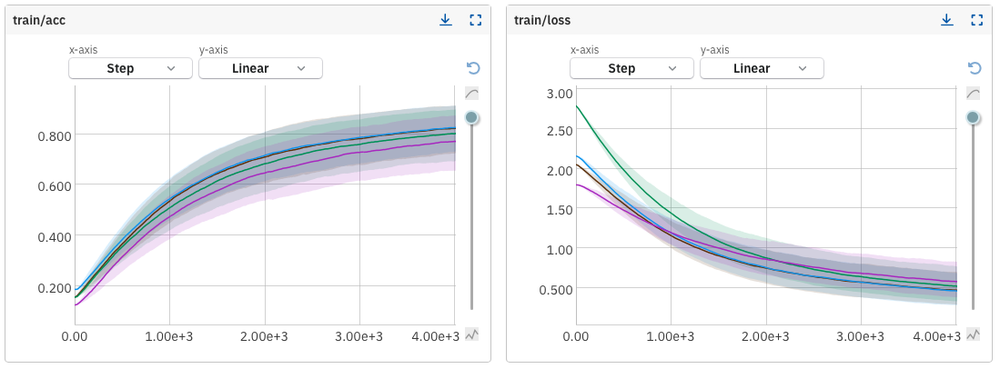

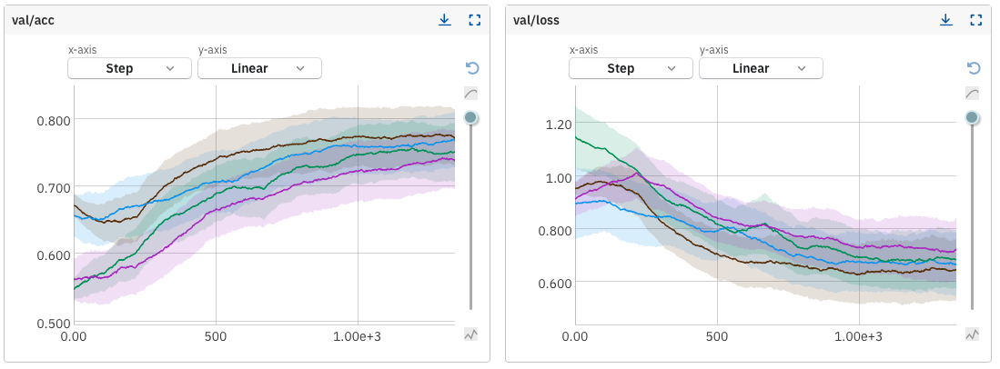

Generate new data loaders using the updated index lists that exclude noise for both training and testing after running the k-fold cross-validation.

In [ ]:
TrainX = np.array([dataset[i][0] for i in idxTrainNoisy])
TrainY = np.array([dataset[i][1] for i in idxTrainNoisy])
TrainZ = np.array([dataset[i][2] for i in idxTrainNoisy])  #ID train of the images

tensorTrainX = torch.tensor(TrainX, dtype=torch.float32)
tensorTrainY = torch.tensor(TrainY, dtype=torch.long)
tensorTrainZ = torch.tensor(TrainZ, dtype=torch.long)

# Create a TensorDataset object from the data
tensorDatasetTrain = TensorDataset(tensorTrainX, tensorTrainY, tensorTrainZ)

# Create a DataLoader object with batch size 32
trainDataloader = DataLoader(tensorDatasetTrain, batch_size=32, shuffle=True)

TestX = np.array([dataset[j][0] for j in idxTestNoisy])
TestY = np.array([dataset[j][1] for j in idxTestNoisy])
TestZ = np.array([dataset[j][2] for j in idxTestNoisy])    #ID test of the images

tensorTestX = torch.tensor(TestX, dtype=torch.float32)
tensorTestY = torch.tensor(TestY, dtype=torch.long)
tensorTestZ = torch.tensor(TestZ, dtype=torch.long)

tensorDatasetTest = TensorDataset(tensorTestX, tensorTestY, tensorTestZ)
testDataloader = DataLoader(tensorDatasetTest, batch_size=32, shuffle=True)

In [ ]:
net = BasicCNN(numLabels=6)
net = net.to(device)
criterionBasic = nn.CrossEntropyLoss()
optimizerBasic = optim.Adam(net.parameters(), lr=0.001)    #net.parameters is the wight of the NN

run = neptune.init_run(
    project="gihazshay/finalProjectML",
    api_token="eyJhcGlfYWRkcmVzcyI6Imh0dHBzOi8vYXBwLm5lcHR1bmUuYWkiLCJhcGlfdXJsIjoiaHR0cHM6Ly9hcHAubmVwdHVuZS5haSIsImFwaV9rZXkiOiI0Mjc3OWFhMi0zYWI3LTRiMjQtYjFiMC0xMGNkYWU4MjBkOTcifQ==",
)

params = {"learning_rate": 0.001, "optimizer": "Adam"}
run["parameters"] = params

trainModel = train(net, trainDataloader, optimizerBasic, 12, criterionBasic)
testAcc, testLoss = test(net, testDataloader, criterionBasic)

run.stop()

[neptune] [info   ] Neptune initialized. Open in the app: https://app.neptune.ai/gihazshay/finalProjectML/e/FIN-429


Epoch 0:  99%|█████████▉| 442/446 [00:05<00:00, 79.67batch/s]/usr/local/lib/python3.10/dist-packages/torch/autograd/graph.py:744: UserWarning: Plan failed with a cudnnException: CUDNN_BACKEND_EXECUTION_PLAN_DESCRIPTOR: cudnnFinalize Descriptor Failed cudnn_status: CUDNN_STATUS_NOT_SUPPORTED (Triggered internally at ../aten/src/ATen/native/cudnn/Conv_v8.cpp:919.)
  return Variable._execution_engine.run_backward(  # Calls into the C++ engine to run the backward pass
Epoch 0: 100%|██████████| 446/446 [00:05<00:00, 81.39batch/s]


              precision    recall  f1-score   support

           0       0.64      0.69      0.66      2451
           1       0.51      0.40      0.45      2366
           2       0.58      0.58      0.58      2581
           3       0.56      0.62      0.59      2298
           4       0.80      0.81      0.81      2333
           5       0.53      0.54      0.53      2234

    accuracy                           0.61     14263
   macro avg       0.60      0.61      0.60     14263
weighted avg       0.60      0.61      0.60     14263



Epoch 1: 100%|██████████| 446/446 [00:05<00:00, 81.80batch/s]


              precision    recall  f1-score   support

           0       0.74      0.76      0.75      2451
           1       0.62      0.53      0.57      2366
           2       0.69      0.66      0.67      2581
           3       0.65      0.74      0.69      2298
           4       0.90      0.87      0.89      2333
           5       0.66      0.70      0.68      2234

    accuracy                           0.71     14263
   macro avg       0.71      0.71      0.71     14263
weighted avg       0.71      0.71      0.71     14263



Epoch 2: 100%|██████████| 446/446 [00:05<00:00, 79.71batch/s]


              precision    recall  f1-score   support

           0       0.77      0.78      0.78      2451
           1       0.67      0.58      0.62      2366
           2       0.71      0.70      0.70      2581
           3       0.67      0.76      0.71      2298
           4       0.92      0.89      0.90      2333
           5       0.70      0.73      0.71      2234

    accuracy                           0.74     14263
   macro avg       0.74      0.74      0.74     14263
weighted avg       0.74      0.74      0.74     14263



Epoch 3: 100%|██████████| 446/446 [00:05<00:00, 86.56batch/s]


              precision    recall  f1-score   support

           0       0.79      0.79      0.79      2451
           1       0.69      0.64      0.66      2366
           2       0.73      0.70      0.71      2581
           3       0.70      0.78      0.74      2298
           4       0.92      0.91      0.91      2333
           5       0.74      0.75      0.74      2234

    accuracy                           0.76     14263
   macro avg       0.76      0.76      0.76     14263
weighted avg       0.76      0.76      0.76     14263



Epoch 4: 100%|██████████| 446/446 [00:05<00:00, 81.14batch/s]


              precision    recall  f1-score   support

           0       0.80      0.81      0.80      2451
           1       0.72      0.68      0.70      2366
           2       0.75      0.73      0.74      2581
           3       0.71      0.79      0.75      2298
           4       0.93      0.91      0.92      2333
           5       0.76      0.77      0.76      2234

    accuracy                           0.78     14263
   macro avg       0.78      0.78      0.78     14263
weighted avg       0.78      0.78      0.78     14263



Epoch 5: 100%|██████████| 446/446 [00:06<00:00, 72.40batch/s]


              precision    recall  f1-score   support

           0       0.81      0.82      0.82      2451
           1       0.75      0.72      0.73      2366
           2       0.76      0.75      0.75      2581
           3       0.74      0.80      0.77      2298
           4       0.93      0.92      0.92      2333
           5       0.77      0.77      0.77      2234

    accuracy                           0.80     14263
   macro avg       0.80      0.80      0.80     14263
weighted avg       0.80      0.80      0.80     14263



Epoch 6: 100%|██████████| 446/446 [00:05<00:00, 84.48batch/s]


              precision    recall  f1-score   support

           0       0.82      0.83      0.82      2451
           1       0.76      0.74      0.75      2366
           2       0.77      0.75      0.76      2581
           3       0.75      0.80      0.78      2298
           4       0.94      0.92      0.93      2333
           5       0.78      0.79      0.78      2234

    accuracy                           0.80     14263
   macro avg       0.80      0.80      0.80     14263
weighted avg       0.80      0.80      0.80     14263



Epoch 7: 100%|██████████| 446/446 [00:05<00:00, 82.70batch/s]


              precision    recall  f1-score   support

           0       0.83      0.83      0.83      2451
           1       0.77      0.75      0.76      2366
           2       0.78      0.76      0.77      2581
           3       0.77      0.81      0.79      2298
           4       0.93      0.93      0.93      2333
           5       0.80      0.79      0.80      2234

    accuracy                           0.81     14263
   macro avg       0.81      0.81      0.81     14263
weighted avg       0.81      0.81      0.81     14263



Epoch 8: 100%|██████████| 446/446 [00:05<00:00, 74.58batch/s]


              precision    recall  f1-score   support

           0       0.84      0.84      0.84      2451
           1       0.78      0.76      0.77      2366
           2       0.79      0.77      0.78      2581
           3       0.77      0.82      0.80      2298
           4       0.94      0.94      0.94      2333
           5       0.81      0.81      0.81      2234

    accuracy                           0.82     14263
   macro avg       0.82      0.82      0.82     14263
weighted avg       0.82      0.82      0.82     14263



Epoch 9: 100%|██████████| 446/446 [00:05<00:00, 83.54batch/s]


              precision    recall  f1-score   support

           0       0.85      0.85      0.85      2451
           1       0.78      0.76      0.77      2366
           2       0.79      0.77      0.78      2581
           3       0.77      0.83      0.80      2298
           4       0.94      0.94      0.94      2333
           5       0.81      0.81      0.81      2234

    accuracy                           0.82     14263
   macro avg       0.83      0.83      0.83     14263
weighted avg       0.83      0.82      0.82     14263



Epoch 10: 100%|██████████| 446/446 [00:05<00:00, 84.19batch/s]


              precision    recall  f1-score   support

           0       0.85      0.85      0.85      2451
           1       0.81      0.78      0.80      2366
           2       0.79      0.78      0.79      2581
           3       0.79      0.83      0.81      2298
           4       0.95      0.94      0.94      2333
           5       0.82      0.82      0.82      2234

    accuracy                           0.83     14263
   macro avg       0.83      0.83      0.83     14263
weighted avg       0.83      0.83      0.83     14263



Epoch 11: 100%|██████████| 446/446 [00:05<00:00, 78.68batch/s]


              precision    recall  f1-score   support

           0       0.86      0.86      0.86      2451
           1       0.80      0.79      0.80      2366
           2       0.81      0.78      0.79      2581
           3       0.79      0.84      0.82      2298
           4       0.94      0.94      0.94      2333
           5       0.83      0.82      0.83      2234

    accuracy                           0.84     14263
   macro avg       0.84      0.84      0.84     14263
weighted avg       0.84      0.84      0.84     14263



100%|██████████| 79/79 [00:00<00:00, 114.10batch/s]


              precision    recall  f1-score   support

           0       0.75      0.83      0.79       423
           1       0.72      0.72      0.72       410
           2       0.72      0.76      0.74       452
           3       0.77      0.74      0.75       439
           4       0.94      0.91      0.93       405
           5       0.76      0.68      0.72       386

    accuracy                           0.77      2515
   macro avg       0.78      0.77      0.77      2515
weighted avg       0.78      0.77      0.77      2515

[neptune] [info   ] Shutting down background jobs, please wait a moment...
[neptune] [info   ] Done!
[neptune] [info   ] Waiting for the remaining 22 operations to synchronize with Neptune. Do not kill this process.
[neptune] [info   ] All 22 operations synced, thanks for waiting!
[neptune] [info   ] Explore the metadata in the Neptune app: https://app.neptune.ai/gihazshay/finalProjectML/e/FIN-429/metadata


#### Results

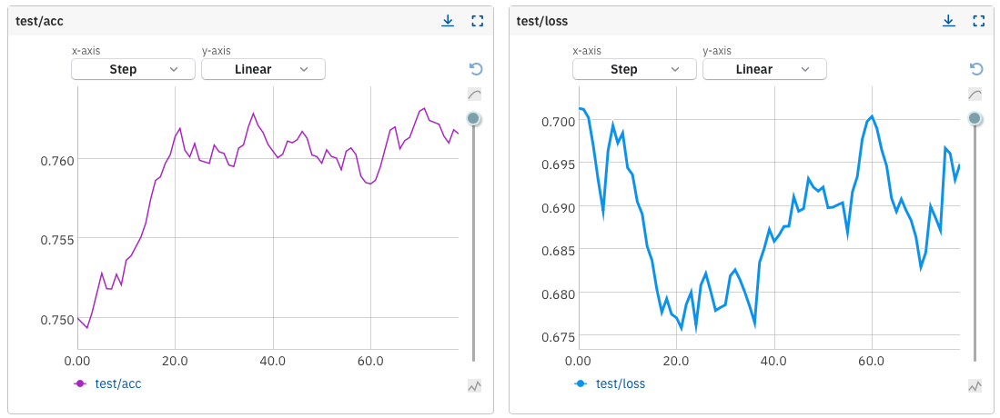

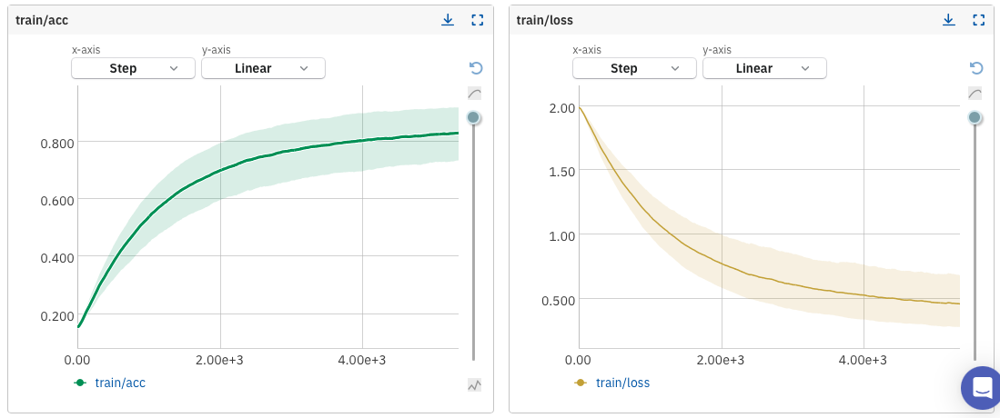

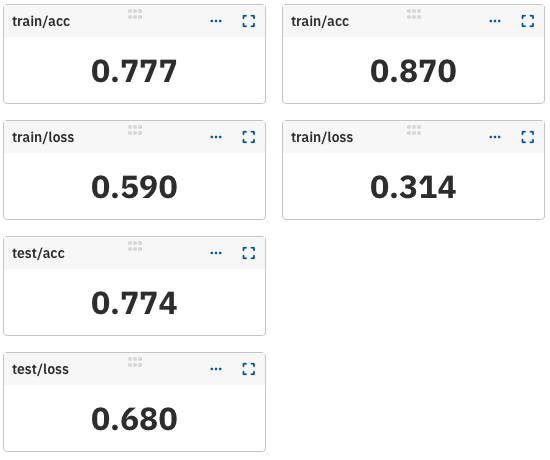

### Comparison



train/acc (average):

                     with noise-0.777     no noise-0.777

train/loss (average):

                     with noise-0.599     no noise-0.590

test/acc (average):

                     with noise-0.773     no noise-0.774

test/acc (average):

                     with noise-0.638     no noise-0.680

train/acc (last):

                     with noise-0.857     no noise-0.870

train/acc (last):

                     with noise-0.384     no noise-0.314

The performance of the network with noise can be observed on `12 Epochs`.

#### Conclusion

When comparing the results between the data with noise and without noise, we observe a very small improvement. This indicates that there is no significant impact on the performance of the network when noise is present in the data.

Therefore, there is no essential need to remove the images that contain noise from our dataset!



---



# Augmentation

Data augmentation is a technique used to artificially increase the size and diversity of a training dataset by applying various transformations to the original data. This process helps to improve our model, particularly in scenarios where collecting a large amount of diverse data is challenging.

For our dataset, which contains a diverse collection of images of buildings, forests, glaciers, streets, mountains, and seas, selecting appropriate augmentation techniques is crucial. We need augmentations that enhance the variability of the dataset while preserving the semantic meaning of the images.

Some augmentations, such as 90-degree rotations, are not suitable for our dataset as they can distort the natural orientation of the scenes. Similarly, converting images to grayscale might strip away essential color information that could be vital for classification tasks.

In this project, we will examine first two effective augmentation techniques: **Color Jitter** and **Horizontal Flip**. These augmentations are chosen because they increase the variability of the dataset without compromising the semantic integrity of the images. Once we achieve satisfactory results with the initial augmentations, we will explore additional augmentations to further enhance the model's performance.


To implement these augmentations, we will define a new dataset that includes both the original images and their augmented versions. This approach will allow us to effectively assess the impact of these augmentations on the model's performance.

In [ ]:
class ImageDatasetAug(Dataset):
    """
    custume dataset for intel dataset.
    """
    def __init__(self, tableOfPicture, imgDir, transform=None, target_transform=None):
        self.imgLabels = tableOfPicture
        self.imgDir = imgDir
        self.transform = transform
        self.target_transform = target_transform

    def __len__(self):
        return len(self.imgLabels)

    def __getitem__(self, idx):
        imgPath = os.path.join(self.imgDir, str(self.imgLabels.iloc[idx, 0]) + ".jpg")
        image = Image.open(imgPath).convert("RGB")
        image = read_image(imgPath)
        label = self.imgLabels.iloc[idx, 1]
        imageId = self.imgLabels.iloc[idx, 0]
        if self.transform:
            imageOrg = self.transform[0](image)
            imageAug = self.transform[1](image)
            #imageAug2 = self.transform[2](image)


        if self.target_transform:
            label = self.target_transform(label)
        return imageOrg, int(label), int(imageId), imageAug  #, imageAug2

**Important Note:**

I initially tried to implement the k-fold algorithm with the same architectural approach, but the CPU and GPU became overloaded, preventing the network from running with the augmentations. Therefore, I needed to find an alternative solution.

After half a day (!) of in-depth research, I discovered a more efficient method to create seperate datesets for train test and validation dataloaders. Instead of using the original code approach, we can create dataloaders in a way that minimizes the burden on the hardware components. By using the `Subset` function, we can divide the dataset according to the requested indices and internally convert the images to `np.array` and then to tensors. This approach allows us to produce our dataloaders efficiently, without overloading the CPU and GPU.

In [ ]:
transform0 = transforms.Resize((150, 150))

transform1 = transforms.Compose([
    transforms.Resize((150, 150)),
    transforms.ColorJitter(saturation=1.0),  # Adjust saturation with a range of 0.5
])


transform2 = transforms.Compose([
    transforms.Resize((150, 150)),
    transforms.RandomHorizontalFlip(p=1.0),  # Always flip the image
])


transform_list = [transform0,transform1,transform2]

In [ ]:
dataset_train = ImageDatasetAug(trainDataFrame, destination_folderPath, transform_list)
dataset_test = ImageDatasetAug(TestDataFrame, destination_folderPath, transform_list)


*Sanity check:*

In [ ]:
len(dataset_train)

14478

In [ ]:
len(dataset_test)

2556

### Augmentation Printed Images

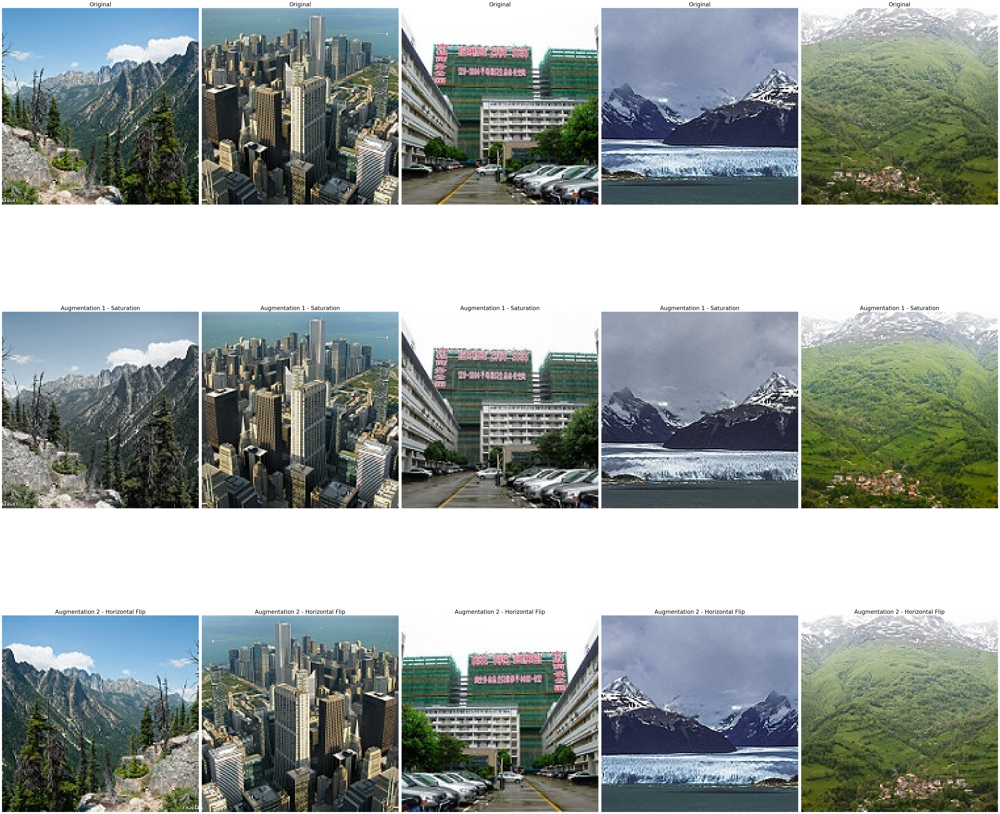

In [ ]:
fig, axes = plt.subplots(3, 5, figsize=(50, 50))

for i in range(5):
  ax1 = axes[0, i]
  ax2 = axes[1, i]
  ax3 = axes[2, i]
  idx = random.choice(trainDataFrame.index)
  image1 = np.array(dataset_train[idx][0])
  image2 = np.array(dataset_train[idx][3])
  image3 = np.array(dataset_train[idx][4])
  ax1.imshow(image1.transpose(1, 2, 0)) # squeeze Remove axes of length one
  ax1.axis('off')  # Turn off axis
  ax2.imshow(image2.transpose(1, 2, 0)) # squeeze Remove axes of length one
  ax2.axis('off')  # Turn off axis
  ax3.imshow(image3.transpose(1, 2, 0)) # squeeze Remove axes of length one
  ax3.axis('off')  # Turn off axis


for ax in axes[0, :]:
    ax.set_title('Original', fontsize=20)
for ax in axes[1, :]:
    ax.set_title('Augmentation 1 - Saturation', fontsize=20)
for ax in axes[2, :]:
    ax.set_title('Augmentation 2 - Horizontal Flip', fontsize=20)

plt.tight_layout()
plt.show()

### New Train&Test Loops

Costume train and test loops for the new dataset (with the augmentation)

In [ ]:
def trainAug(model, dataLoaderTrain, optimizer, epochs, criterion, dataLoaderValidation=None):
    model.train()


    for epoch in range(epochs):
      accuracy = 0.0
      predList = None
      labelList = None
      correct = 0
      valAcc = 0
      valLoss = 0

      with tqdm(dataLoaderTrain, unit="batch") as tepoch:
        for batch_idx, (image, label, id, aug1) in enumerate(tepoch):


            if epoch%2 == 0:
              data =  image.to(torch.float32).to(device)

            else:
              data =  aug1.to(torch.float32).to(device)

            tepoch.set_description(f"Epoch {epoch}")

            # send to device
            data, label, id = data.to(device), label.to(device), id.to(device)

            optimizer.zero_grad()
            output = model(data)
            loss = criterion(output, label)
            loss.backward()
            optimizer.step()

            # print statistics
            pred = output.data.max(1, keepdim=True)[1] # get the index of the max log-probability
            correctBatch = pred.eq(label.data.view_as(pred)).cpu().sum().item()
            correct += correctBatch
            run["train/loss"].append(loss.item())
            run["train/acc"].append(correctBatch/len(label))


            if batch_idx == 0:
              predList = pred
              labelList = label
            else:
              predList = torch.cat((predList, pred), 0)
              labelList = torch.cat((labelList, label), 0)

        accuracy = 100. * correct / len(dataLoaderTrain.dataset)
        report2 = classification_report(labelList.cpu(), predList.cpu())
        print(report2)

        #Validtion part
        tepoch.close()
        if dataLoaderValidation != None:
          print(f"Validtion part------EPOCH------:{epoch}")
          if epoch == epochs -1:
            valAcc, valLoss = test(model, dataLoaderValidation, criterion ,lastEpoch = True, val=True)
          else:
            valAcc, valLoss = test(model, dataLoaderValidation, criterion ,lastEpoch = False, val=True)



    return accuracy, loss.item() , valAcc, valLoss        #we return this val for k fold calculation acc&loss for each fold

In [ ]:
def test(model, dataLoader, criterion, lastEpoch=None, val=False, kfold=None):
    model.eval()

    predDataFrame = pd.DataFrame({'id':[], 'pred':[], 'label':[]})
    accuracy = 0.0
    predList = None
    labelList = None
    correct = 0
    correctBatch = 0
    with tqdm(dataLoader, unit="batch") as loader:
      with torch.no_grad():
        for batch_idx, (data, label, id, _) in enumerate(loader):
          data = data.to(torch.float32).to(device)

          # send to device
          data, label, id = data.to(device), label.to(device), id.to(device)

          output = model(data)
          loss = criterion(output, label)

          # print statistics
          pred = output.data.max(1, keepdim=True)[1] # get the index of the max log-probability
          correctBatch = pred.eq(label.data.view_as(pred)).cpu().sum().item()
          correct += correctBatch

          if val == True:
            run["val/loss"].append(loss.item())
            run["val/acc"].append(correctBatch/len(label))
          else:
            run["test/loss"].append(loss.item())
            run["test/acc"].append(correctBatch/len(label))

          if batch_idx == 0:
            predList = pred
            labelList = label
          else:
            predList = torch.cat((predList, pred), 0)
            labelList = torch.cat((labelList, label), 0)

          #this statment to create a table in the last epoch
          #the table shows the prediction and the true label for each image.
          new_row_epoch = pd.DataFrame({'id': id.cpu(), 'pred': pred.cpu().flatten(),'label': label.cpu()})
          # adding a new row to the existind dataframe
          predDataFrame = pd.concat([predDataFrame, new_row_epoch], ignore_index=True)


        accuracy = 100. * correct / len(dataLoader.dataset)
        report1 = classification_report(labelList.cpu(), predList.cpu())
        if lastEpoch == True:
           run["val/pred"]= neptune.types.File.as_html(predDataFrame)
        if val==False:
           run["test/pred"]= neptune.types.File.as_html(predDataFrame)
        print(report1)

    return accuracy, loss.item()      #we return this val for k fold calculation acc&loss for each fold

In [ ]:
len(test)

10858

### ColorJitter

**Color Jitter:** This technique randomly changes the brightness, contrast, saturation, and hue of the images, helping the model become invariant to changes in lighting and color conditions.

In [ ]:
transform0 = transforms.Resize((150, 150))

transform1 = transforms.Compose([
    transforms.Resize((150, 150)),
    transforms.ColorJitter(saturation=1.0),  # Adjust saturation with a range of 0.5
])


transform_list = [transform0,transform1]

In [ ]:
dataset_train = ImageDatasetAug(trainDataFrame, destination_folderPath, transform_list)
dataset_test = ImageDatasetAug(TestDataFrame, destination_folderPath, transform_list)

In [ ]:
num_folds = 4  # Change this to the desired number of folds

# Initialize the KFold object
kf = KFold(n_splits=num_folds, shuffle=True, random_state=40)


foldNum = 0
foldsMatrix = {}


for train_indices, val_indices in kf.split(idxTrain):

    train_subset = Subset(dataset_train, train_indices)
    val_subset = Subset(dataset_train, val_indices)

    # Create a DataLoader object with batch size 32
    trainDataloaderKfold = DataLoader(train_subset, batch_size=32, shuffle=True)
    valDataloaderKfold = DataLoader(val_subset, batch_size=32, shuffle=True)

    print(f"------fold------:{foldNum}")

    run = neptune.init_run(
    project="gihazshay/finalProjectML",
    api_token="eyJhcGlfYWRkcmVzcyI6Imh0dHBzOi8vYXBwLm5lcHR1bmUuYWkiLCJhcGlfdXJsIjoiaHR0cHM6Ly9hcHAubmVwdHVuZS5haSIsImFwaV9rZXkiOiI0Mjc3OWFhMi0zYWI3LTRiMjQtYjFiMC0xMGNkYWU4MjBkOTcifQ==",
    )

    params = {"learning_rate": 0.001, "optimizer": "Adam"}
    run["parameters"] = params

    net = BasicCNN(numLabels=6)
    net = net.to(device)
    criterionBasic = nn.CrossEntropyLoss()
    optimizerBasic = optim.Adam(net.parameters(), lr=0.001)    #net.parameters is the wight of the NN
    trainAcc, trainLoss, valAcc, valLoss = trainAug(net, trainDataloaderKfold, optimizerBasic, 13, criterionBasic, valDataloaderKfold)

    run.stop()
    foldsMatrix[f"fold {foldNum}"] = {'train_acc':trainAcc, 'train_loss':trainLoss,
                                      'val_acc':valAcc, 'val_loss':valLoss}
    foldNum += 1


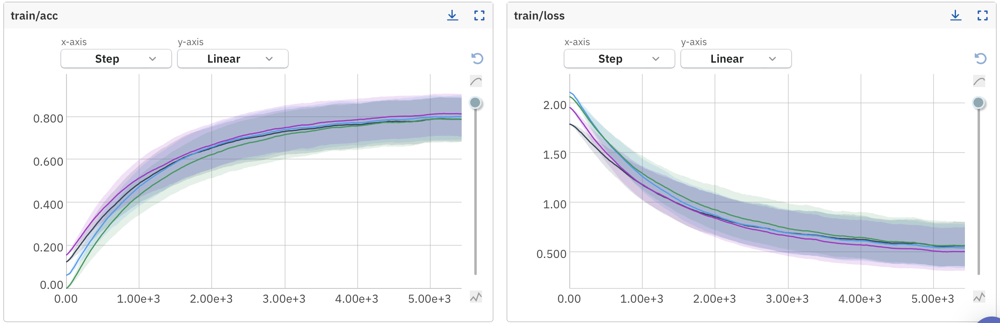

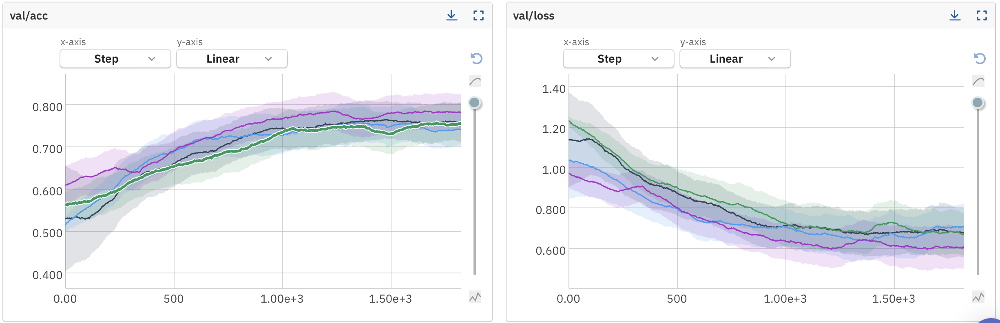

In [ ]:
trainDataloader = DataLoader(dataset_train, batch_size=32, shuffle=True)
testDataloader = DataLoader(dataset_test, batch_size=32, shuffle=True)

In [ ]:
net = BasicCNN(numLabels=6)
net = net.to(device)
criterionBasic = nn.CrossEntropyLoss()
optimizerBasic = optim.Adam(net.parameters(), lr=0.001)    #net.parameters is the wight of the NN

run = neptune.init_run(
    project="gihazshay/finalProjectML",
    api_token="eyJhcGlfYWRkcmVzcyI6Imh0dHBzOi8vYXBwLm5lcHR1bmUuYWkiLCJhcGlfdXJsIjoiaHR0cHM6Ly9hcHAubmVwdHVuZS5haSIsImFwaV9rZXkiOiI0Mjc3OWFhMi0zYWI3LTRiMjQtYjFiMC0xMGNkYWU4MjBkOTcifQ==",
)

params = {"learning_rate": 0.001, "optimizer": "Adam"}
run["parameters"] = params

trainModel = trainAug(net, trainDataloader, optimizerBasic, 13, criterionBasic)
testAcc, testLoss = test(net, testDataloader, criterionBasic)

run.stop()

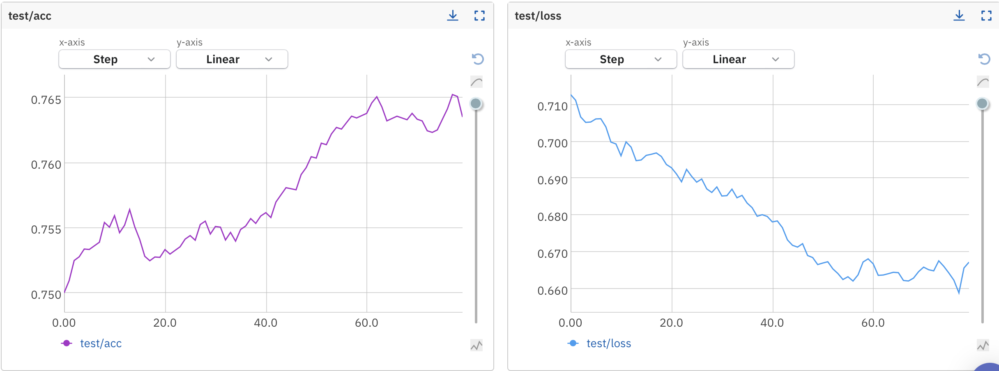

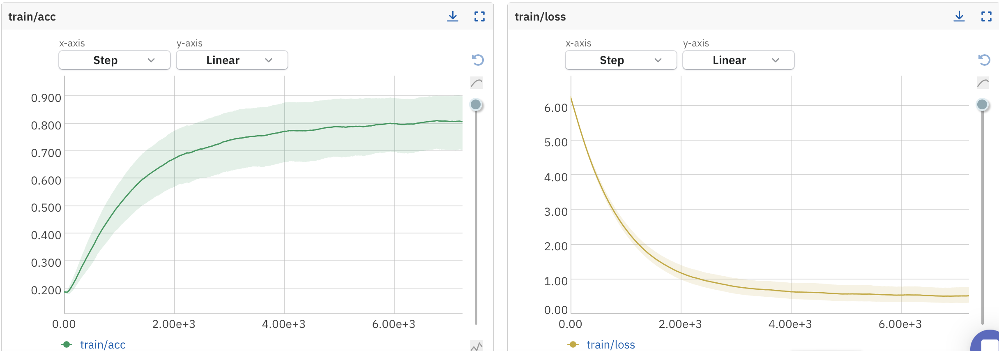

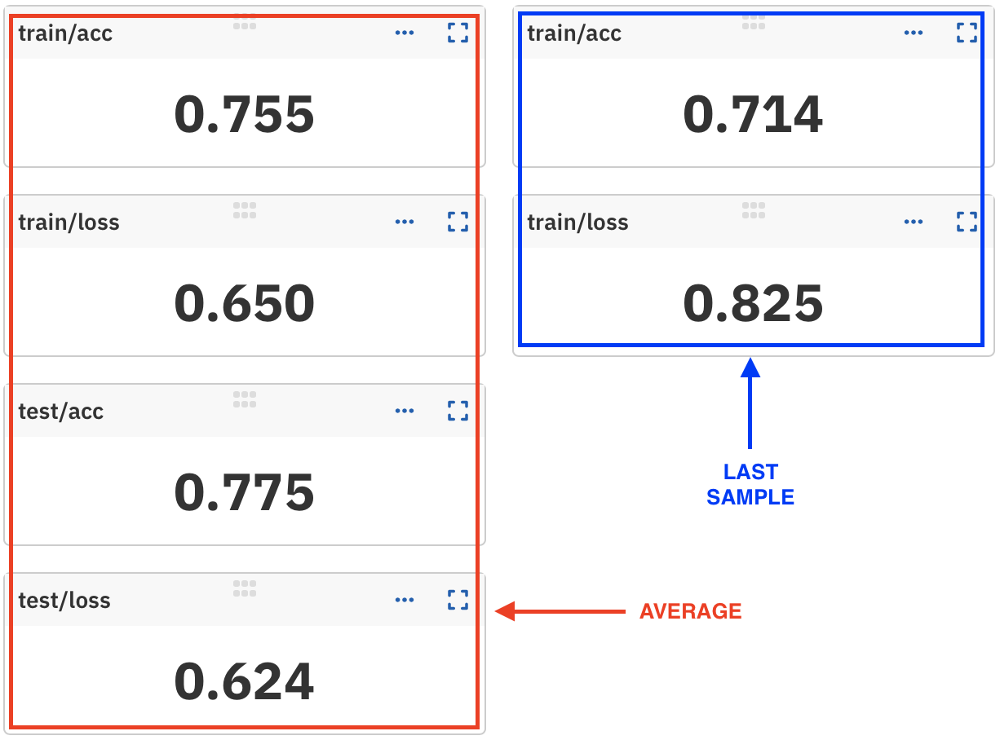

### RandomHorizontalFlip


**Horizontal Flip:** This technique flips the image horizontally, which helps the model to learn features regardless of their orientation.


In [ ]:
transform_list = [transform0,transform2]

In [ ]:
dataset_train = ImageDatasetAug(trainDataFrame, destination_folderPath, transform_list)
dataset_test = ImageDatasetAug(TestDataFrame, destination_folderPath, transform_list)


In [ ]:
num_folds = 4  # Change this to the desired number of folds

# Initialize the KFold object
kf = KFold(n_splits=num_folds, shuffle=True, random_state=40)


foldNum = 0
foldsMatrix = {}


for train_indices, val_indices in kf.split(idxTrain):

    train_subset = Subset(dataset_train, train_indices)
    val_subset = Subset(dataset_train, val_indices)

    # Create a DataLoader object with batch size 32
    trainDataloaderKfold = DataLoader(train_subset, batch_size=32, shuffle=True)
    valDataloaderKfold = DataLoader(val_subset, batch_size=32, shuffle=True)

    print(f"------fold------:{foldNum}")

    run = neptune.init_run(
    project="gihazshay/finalProjectML",
    api_token="eyJhcGlfYWRkcmVzcyI6Imh0dHBzOi8vYXBwLm5lcHR1bmUuYWkiLCJhcGlfdXJsIjoiaHR0cHM6Ly9hcHAubmVwdHVuZS5haSIsImFwaV9rZXkiOiI0Mjc3OWFhMi0zYWI3LTRiMjQtYjFiMC0xMGNkYWU4MjBkOTcifQ==",
    )

    params = {"learning_rate": 0.001, "optimizer": "Adam"}
    run["parameters"] = params

    net = BasicCNN(numLabels=6)
    net = net.to(device)
    criterionBasic = nn.CrossEntropyLoss()
    optimizerBasic = optim.Adam(net.parameters(), lr=0.001)    #net.parameters is the wight of the NN
    trainAcc, trainLoss, valAcc, valLoss = trainAug(net, trainDataloaderKfold, optimizerBasic, 13, criterionBasic, valDataloaderKfold)

    run.stop()
    foldsMatrix[f"fold {foldNum}"] = {'train_acc':trainAcc, 'train_loss':trainLoss,
                                      'val_acc':valAcc, 'val_loss':valLoss}
    foldNum += 1


------fold------:0


[neptune] [warning] NeptuneWarning: The following monitoring options are disabled by default in interactive sessions: 'capture_stdout', 'capture_stderr', 'capture_traceback', and 'capture_hardware_metrics'. To enable them, set each parameter to 'True' when initializing the run. The monitoring will continue until you call run.stop() or the kernel stops. Also note: Your source files can only be tracked if you pass the path(s) to the 'source_code' argument. For help, see the Neptune docs: https://docs.neptune.ai/logging/source_code/


[neptune] [info   ] Neptune initialized. Open in the app: https://app.neptune.ai/gihazshay/finalProjectML/e/FIN-488


Epoch 0:   0%|          | 0/340 [00:00<?, ?batch/s]/usr/local/lib/python3.10/dist-packages/torch/autograd/graph.py:744: UserWarning: Plan failed with a cudnnException: CUDNN_BACKEND_EXECUTION_PLAN_DESCRIPTOR: cudnnFinalize Descriptor Failed cudnn_status: CUDNN_STATUS_NOT_SUPPORTED (Triggered internally at ../aten/src/ATen/native/cudnn/Conv_v8.cpp:919.)
  return Variable._execution_engine.run_backward(  # Calls into the C++ engine to run the backward pass
Epoch 0: 100%|██████████| 340/340 [00:16<00:00, 20.62batch/s]


              precision    recall  f1-score   support

           0       0.57      0.60      0.58      1822
           1       0.40      0.18      0.24      1766
           2       0.52      0.55      0.53      1964
           3       0.47      0.62      0.53      1871
           4       0.74      0.75      0.75      1745
           5       0.43      0.47      0.45      1690

    accuracy                           0.53     10858
   macro avg       0.52      0.53      0.51     10858
weighted avg       0.52      0.53      0.52     10858

Validtion part------EPOCH------:0


100%|██████████| 114/114 [00:03<00:00, 33.63batch/s]


              precision    recall  f1-score   support

           0       0.60      0.69      0.64       629
           1       0.50      0.42      0.46       600
           2       0.61      0.55      0.58       617
           3       0.69      0.35      0.46       642
           4       0.74      0.90      0.81       588
           5       0.42      0.60      0.49       544

    accuracy                           0.58      3620
   macro avg       0.59      0.59      0.57      3620
weighted avg       0.59      0.58      0.57      3620



Epoch 1: 100%|██████████| 340/340 [00:14<00:00, 23.92batch/s]


              precision    recall  f1-score   support

           0       0.67      0.70      0.68      1822
           1       0.53      0.40      0.46      1766
           2       0.61      0.62      0.61      1964
           3       0.57      0.61      0.59      1871
           4       0.86      0.81      0.83      1745
           5       0.54      0.63      0.58      1690

    accuracy                           0.63     10858
   macro avg       0.63      0.63      0.63     10858
weighted avg       0.63      0.63      0.63     10858

Validtion part------EPOCH------:1


100%|██████████| 114/114 [00:03<00:00, 34.13batch/s]


              precision    recall  f1-score   support

           0       0.76      0.64      0.70       629
           1       0.59      0.47      0.52       600
           2       0.66      0.64      0.65       617
           3       0.59      0.64      0.62       642
           4       0.80      0.90      0.85       588
           5       0.58      0.70      0.63       544

    accuracy                           0.66      3620
   macro avg       0.66      0.66      0.66      3620
weighted avg       0.66      0.66      0.66      3620



Epoch 2: 100%|██████████| 340/340 [00:13<00:00, 24.59batch/s]


              precision    recall  f1-score   support

           0       0.71      0.72      0.71      1822
           1       0.59      0.51      0.55      1766
           2       0.65      0.64      0.65      1964
           3       0.61      0.66      0.63      1871
           4       0.88      0.84      0.86      1745
           5       0.62      0.68      0.65      1690

    accuracy                           0.67     10858
   macro avg       0.68      0.68      0.67     10858
weighted avg       0.68      0.67      0.67     10858

Validtion part------EPOCH------:2


100%|██████████| 114/114 [00:03<00:00, 33.71batch/s]


              precision    recall  f1-score   support

           0       0.72      0.73      0.72       629
           1       0.70      0.38      0.49       600
           2       0.63      0.73      0.68       617
           3       0.60      0.74      0.66       642
           4       0.97      0.77      0.86       588
           5       0.61      0.78      0.68       544

    accuracy                           0.69      3620
   macro avg       0.70      0.69      0.68      3620
weighted avg       0.70      0.69      0.68      3620



Epoch 3: 100%|██████████| 340/340 [00:13<00:00, 24.42batch/s]


              precision    recall  f1-score   support

           0       0.73      0.74      0.74      1822
           1       0.61      0.57      0.59      1766
           2       0.67      0.65      0.66      1964
           3       0.64      0.69      0.66      1871
           4       0.90      0.87      0.89      1745
           5       0.69      0.73      0.71      1690

    accuracy                           0.71     10858
   macro avg       0.71      0.71      0.71     10858
weighted avg       0.71      0.71      0.71     10858

Validtion part------EPOCH------:3


100%|██████████| 114/114 [00:04<00:00, 27.94batch/s]


              precision    recall  f1-score   support

           0       0.72      0.75      0.73       629
           1       0.64      0.56      0.60       600
           2       0.79      0.48      0.59       617
           3       0.63      0.77      0.69       642
           4       0.99      0.72      0.83       588
           5       0.56      0.87      0.68       544

    accuracy                           0.69      3620
   macro avg       0.72      0.69      0.69      3620
weighted avg       0.72      0.69      0.69      3620



Epoch 4: 100%|██████████| 340/340 [00:13<00:00, 25.14batch/s]


              precision    recall  f1-score   support

           0       0.75      0.76      0.75      1822
           1       0.67      0.64      0.65      1766
           2       0.70      0.67      0.68      1964
           3       0.68      0.72      0.70      1871
           4       0.90      0.87      0.89      1745
           5       0.71      0.74      0.72      1690

    accuracy                           0.73     10858
   macro avg       0.73      0.73      0.73     10858
weighted avg       0.73      0.73      0.73     10858

Validtion part------EPOCH------:4


100%|██████████| 114/114 [00:04<00:00, 24.97batch/s]


              precision    recall  f1-score   support

           0       0.86      0.67      0.75       629
           1       0.70      0.58      0.63       600
           2       0.68      0.74      0.71       617
           3       0.66      0.74      0.70       642
           4       0.94      0.88      0.91       588
           5       0.65      0.85      0.74       544

    accuracy                           0.74      3620
   macro avg       0.75      0.74      0.74      3620
weighted avg       0.75      0.74      0.74      3620



Epoch 5: 100%|██████████| 340/340 [00:13<00:00, 25.72batch/s]


              precision    recall  f1-score   support

           0       0.77      0.77      0.77      1822
           1       0.68      0.67      0.68      1766
           2       0.71      0.67      0.69      1964
           3       0.69      0.73      0.71      1871
           4       0.92      0.90      0.91      1745
           5       0.72      0.75      0.74      1690

    accuracy                           0.75     10858
   macro avg       0.75      0.75      0.75     10858
weighted avg       0.75      0.75      0.75     10858

Validtion part------EPOCH------:5


100%|██████████| 114/114 [00:06<00:00, 16.33batch/s]


              precision    recall  f1-score   support

           0       0.83      0.73      0.78       629
           1       0.69      0.73      0.71       600
           2       0.73      0.69      0.71       617
           3       0.74      0.71      0.73       642
           4       0.91      0.92      0.91       588
           5       0.70      0.83      0.76       544

    accuracy                           0.77      3620
   macro avg       0.77      0.77      0.77      3620
weighted avg       0.77      0.77      0.77      3620



Epoch 6: 100%|██████████| 340/340 [00:26<00:00, 12.78batch/s]


              precision    recall  f1-score   support

           0       0.77      0.79      0.78      1822
           1       0.70      0.70      0.70      1766
           2       0.71      0.69      0.70      1964
           3       0.71      0.73      0.72      1871
           4       0.92      0.90      0.91      1745
           5       0.74      0.75      0.75      1690

    accuracy                           0.76     10858
   macro avg       0.76      0.76      0.76     10858
weighted avg       0.76      0.76      0.76     10858

Validtion part------EPOCH------:6


100%|██████████| 114/114 [00:10<00:00, 10.82batch/s]


              precision    recall  f1-score   support

           0       0.81      0.74      0.77       629
           1       0.62      0.78      0.69       600
           2       0.75      0.60      0.66       617
           3       0.79      0.66      0.72       642
           4       0.95      0.89      0.92       588
           5       0.64      0.85      0.73       544

    accuracy                           0.75      3620
   macro avg       0.76      0.75      0.75      3620
weighted avg       0.76      0.75      0.75      3620



Epoch 7: 100%|██████████| 340/340 [00:30<00:00, 11.24batch/s]


              precision    recall  f1-score   support

           0       0.79      0.79      0.79      1822
           1       0.73      0.72      0.72      1766
           2       0.73      0.69      0.71      1964
           3       0.72      0.76      0.74      1871
           4       0.92      0.91      0.91      1745
           5       0.75      0.77      0.76      1690

    accuracy                           0.77     10858
   macro avg       0.77      0.77      0.77     10858
weighted avg       0.77      0.77      0.77     10858

Validtion part------EPOCH------:7


100%|██████████| 114/114 [00:07<00:00, 16.21batch/s]


              precision    recall  f1-score   support

           0       0.77      0.73      0.75       629
           1       0.64      0.81      0.71       600
           2       0.76      0.63      0.69       617
           3       0.81      0.57      0.67       642
           4       0.98      0.82      0.89       588
           5       0.59      0.88      0.71       544

    accuracy                           0.74      3620
   macro avg       0.76      0.74      0.74      3620
weighted avg       0.76      0.74      0.74      3620



Epoch 8: 100%|██████████| 340/340 [00:30<00:00, 11.18batch/s]


              precision    recall  f1-score   support

           0       0.79      0.79      0.79      1822
           1       0.73      0.75      0.74      1766
           2       0.74      0.70      0.72      1964
           3       0.73      0.74      0.74      1871
           4       0.91      0.91      0.91      1745
           5       0.76      0.77      0.76      1690

    accuracy                           0.78     10858
   macro avg       0.78      0.78      0.78     10858
weighted avg       0.78      0.78      0.78     10858

Validtion part------EPOCH------:8


100%|██████████| 114/114 [00:05<00:00, 21.42batch/s]


              precision    recall  f1-score   support

           0       0.86      0.70      0.77       629
           1       0.74      0.68      0.71       600
           2       0.65      0.77      0.70       617
           3       0.71      0.72      0.71       642
           4       0.91      0.93      0.92       588
           5       0.75      0.79      0.77       544

    accuracy                           0.76      3620
   macro avg       0.77      0.76      0.76      3620
weighted avg       0.77      0.76      0.76      3620



Epoch 9: 100%|██████████| 340/340 [00:32<00:00, 10.46batch/s]


              precision    recall  f1-score   support

           0       0.79      0.80      0.79      1822
           1       0.76      0.74      0.75      1766
           2       0.75      0.72      0.74      1964
           3       0.74      0.76      0.75      1871
           4       0.92      0.92      0.92      1745
           5       0.76      0.77      0.77      1690

    accuracy                           0.78     10858
   macro avg       0.79      0.79      0.79     10858
weighted avg       0.78      0.78      0.78     10858

Validtion part------EPOCH------:9


100%|██████████| 114/114 [00:08<00:00, 12.86batch/s]


              precision    recall  f1-score   support

           0       0.81      0.79      0.80       629
           1       0.85      0.59      0.70       600
           2       0.71      0.77      0.74       617
           3       0.70      0.81      0.75       642
           4       0.94      0.90      0.92       588
           5       0.73      0.83      0.78       544

    accuracy                           0.78      3620
   macro avg       0.79      0.78      0.78      3620
weighted avg       0.79      0.78      0.78      3620



Epoch 10: 100%|██████████| 340/340 [00:22<00:00, 15.37batch/s]


              precision    recall  f1-score   support

           0       0.80      0.81      0.81      1822
           1       0.77      0.77      0.77      1766
           2       0.76      0.74      0.75      1964
           3       0.75      0.76      0.75      1871
           4       0.93      0.92      0.92      1745
           5       0.79      0.79      0.79      1690

    accuracy                           0.80     10858
   macro avg       0.80      0.80      0.80     10858
weighted avg       0.80      0.80      0.80     10858

Validtion part------EPOCH------:10


100%|██████████| 114/114 [00:05<00:00, 21.58batch/s]


              precision    recall  f1-score   support

           0       0.68      0.72      0.70       629
           1       0.70      0.72      0.71       600
           2       0.73      0.56      0.63       617
           3       0.88      0.38      0.53       642
           4       0.95      0.86      0.90       588
           5       0.47      0.91      0.62       544

    accuracy                           0.68      3620
   macro avg       0.74      0.69      0.68      3620
weighted avg       0.74      0.68      0.68      3620



Epoch 11: 100%|██████████| 340/340 [00:21<00:00, 15.71batch/s]


              precision    recall  f1-score   support

           0       0.81      0.82      0.81      1822
           1       0.77      0.77      0.77      1766
           2       0.76      0.72      0.74      1964
           3       0.74      0.77      0.75      1871
           4       0.93      0.92      0.93      1745
           5       0.77      0.78      0.77      1690

    accuracy                           0.79     10858
   macro avg       0.80      0.80      0.80     10858
weighted avg       0.79      0.79      0.79     10858

Validtion part------EPOCH------:11


100%|██████████| 114/114 [00:04<00:00, 26.52batch/s]


              precision    recall  f1-score   support

           0       0.78      0.82      0.80       629
           1       0.74      0.81      0.77       600
           2       0.78      0.66      0.72       617
           3       0.71      0.82      0.76       642
           4       0.99      0.85      0.91       588
           5       0.79      0.77      0.78       544

    accuracy                           0.79      3620
   macro avg       0.80      0.79      0.79      3620
weighted avg       0.80      0.79      0.79      3620



Epoch 12: 100%|██████████| 340/340 [00:14<00:00, 24.03batch/s]


              precision    recall  f1-score   support

           0       0.81      0.82      0.81      1822
           1       0.77      0.78      0.78      1766
           2       0.76      0.73      0.75      1964
           3       0.75      0.77      0.76      1871
           4       0.93      0.92      0.92      1745
           5       0.78      0.78      0.78      1690

    accuracy                           0.80     10858
   macro avg       0.80      0.80      0.80     10858
weighted avg       0.80      0.80      0.80     10858

Validtion part------EPOCH------:12


100%|██████████| 114/114 [00:04<00:00, 27.38batch/s]


              precision    recall  f1-score   support

           0       0.85      0.72      0.78       629
           1       0.68      0.85      0.75       600
           2       0.78      0.71      0.74       617
           3       0.79      0.65      0.72       642
           4       0.98      0.86      0.91       588
           5       0.66      0.88      0.76       544

    accuracy                           0.78      3620
   macro avg       0.79      0.78      0.78      3620
weighted avg       0.79      0.78      0.78      3620

[neptune] [info   ] Shutting down background jobs, please wait a moment...
[neptune] [info   ] Done!
[neptune] [info   ] Waiting for the remaining 147 operations to synchronize with Neptune. Do not kill this process.
[neptune] [info   ] All 147 operations synced, thanks for waiting!
[neptune] [info   ] Explore the metadata in the Neptune app: https://app.neptune.ai/gihazshay/finalProjectML/e/FIN-488/metadata
------fold------:1
[neptune] [info   ] Neptun

Epoch 0: 100%|██████████| 340/340 [00:23<00:00, 14.65batch/s]


              precision    recall  f1-score   support

           0       0.59      0.61      0.60      1850
           1       0.39      0.21      0.27      1800
           2       0.56      0.50      0.53      1924
           3       0.42      0.60      0.50      1908
           4       0.70      0.77      0.73      1732
           5       0.49      0.49      0.49      1644

    accuracy                           0.53     10858
   macro avg       0.52      0.53      0.52     10858
weighted avg       0.52      0.53      0.52     10858

Validtion part------EPOCH------:0


100%|██████████| 114/114 [00:10<00:00, 11.03batch/s]


              precision    recall  f1-score   support

           0       0.67      0.70      0.68       601
           1       0.55      0.06      0.11       566
           2       0.63      0.60      0.61       657
           3       0.47      0.67      0.56       605
           4       0.82      0.91      0.86       601
           5       0.52      0.68      0.59       590

    accuracy                           0.61      3620
   macro avg       0.61      0.60      0.57      3620
weighted avg       0.61      0.61      0.57      3620



Epoch 1: 100%|██████████| 340/340 [00:28<00:00, 12.04batch/s]


              precision    recall  f1-score   support

           0       0.67      0.72      0.70      1850
           1       0.56      0.43      0.49      1800
           2       0.64      0.60      0.62      1924
           3       0.56      0.64      0.60      1908
           4       0.88      0.82      0.85      1732
           5       0.58      0.67      0.62      1644

    accuracy                           0.64     10858
   macro avg       0.65      0.65      0.64     10858
weighted avg       0.65      0.64      0.64     10858

Validtion part------EPOCH------:1


100%|██████████| 114/114 [00:05<00:00, 22.60batch/s]


              precision    recall  f1-score   support

           0       0.73      0.73      0.73       601
           1       0.43      0.65      0.52       566
           2       0.64      0.59      0.62       657
           3       0.64      0.44      0.52       605
           4       0.92      0.88      0.90       601
           5       0.67      0.66      0.67       590

    accuracy                           0.66      3620
   macro avg       0.67      0.66      0.66      3620
weighted avg       0.68      0.66      0.66      3620



Epoch 2: 100%|██████████| 340/340 [00:17<00:00, 19.18batch/s]


              precision    recall  f1-score   support

           0       0.70      0.74      0.72      1850
           1       0.62      0.52      0.56      1800
           2       0.66      0.64      0.65      1924
           3       0.62      0.68      0.65      1908
           4       0.88      0.86      0.87      1732
           5       0.65      0.69      0.67      1644

    accuracy                           0.69     10858
   macro avg       0.69      0.69      0.69     10858
weighted avg       0.69      0.69      0.68     10858

Validtion part------EPOCH------:2


100%|██████████| 114/114 [00:04<00:00, 23.95batch/s]


              precision    recall  f1-score   support

           0       0.72      0.82      0.77       601
           1       0.71      0.37      0.49       566
           2       0.66      0.68      0.67       657
           3       0.57      0.82      0.67       605
           4       0.90      0.90      0.90       601
           5       0.77      0.63      0.69       590

    accuracy                           0.71      3620
   macro avg       0.72      0.71      0.70      3620
weighted avg       0.72      0.71      0.70      3620



Epoch 3: 100%|██████████| 340/340 [00:13<00:00, 25.91batch/s]


              precision    recall  f1-score   support

           0       0.73      0.75      0.74      1850
           1       0.63      0.57      0.60      1800
           2       0.67      0.65      0.66      1924
           3       0.64      0.69      0.67      1908
           4       0.89      0.87      0.88      1732
           5       0.68      0.72      0.70      1644

    accuracy                           0.71     10858
   macro avg       0.71      0.71      0.71     10858
weighted avg       0.71      0.71      0.71     10858

Validtion part------EPOCH------:3


100%|██████████| 114/114 [00:04<00:00, 25.68batch/s]


              precision    recall  f1-score   support

           0       0.72      0.83      0.77       601
           1       0.54      0.71      0.62       566
           2       0.61      0.68      0.65       657
           3       0.74      0.59      0.65       605
           4       0.92      0.93      0.93       601
           5       0.83      0.54      0.66       590

    accuracy                           0.71      3620
   macro avg       0.73      0.71      0.71      3620
weighted avg       0.73      0.71      0.71      3620



Epoch 4: 100%|██████████| 340/340 [00:13<00:00, 24.39batch/s]


              precision    recall  f1-score   support

           0       0.76      0.78      0.77      1850
           1       0.65      0.61      0.63      1800
           2       0.69      0.66      0.67      1924
           3       0.65      0.71      0.68      1908
           4       0.91      0.89      0.90      1732
           5       0.71      0.72      0.72      1644

    accuracy                           0.73     10858
   macro avg       0.73      0.73      0.73     10858
weighted avg       0.73      0.73      0.73     10858

Validtion part------EPOCH------:4


100%|██████████| 114/114 [00:03<00:00, 31.97batch/s]


              precision    recall  f1-score   support

           0       0.72      0.63      0.67       601
           1       0.71      0.56      0.63       566
           2       0.75      0.60      0.67       657
           3       0.74      0.63      0.68       605
           4       0.94      0.86      0.90       601
           5       0.49      0.88      0.63       590

    accuracy                           0.69      3620
   macro avg       0.73      0.69      0.70      3620
weighted avg       0.73      0.69      0.70      3620



Epoch 5: 100%|██████████| 340/340 [00:13<00:00, 24.46batch/s]


              precision    recall  f1-score   support

           0       0.76      0.78      0.77      1850
           1       0.67      0.64      0.65      1800
           2       0.70      0.67      0.68      1924
           3       0.67      0.72      0.69      1908
           4       0.91      0.90      0.91      1732
           5       0.72      0.73      0.73      1644

    accuracy                           0.74     10858
   macro avg       0.74      0.74      0.74     10858
weighted avg       0.74      0.74      0.74     10858

Validtion part------EPOCH------:5


100%|██████████| 114/114 [00:03<00:00, 33.97batch/s]


              precision    recall  f1-score   support

           0       0.73      0.79      0.76       601
           1       0.77      0.32      0.45       566
           2       0.71      0.63      0.67       657
           3       0.52      0.85      0.65       605
           4       0.82      0.96      0.89       601
           5       0.83      0.65      0.73       590

    accuracy                           0.70      3620
   macro avg       0.73      0.70      0.69      3620
weighted avg       0.73      0.70      0.69      3620



Epoch 6: 100%|██████████| 340/340 [00:14<00:00, 23.09batch/s]


              precision    recall  f1-score   support

           0       0.77      0.79      0.78      1850
           1       0.67      0.64      0.66      1800
           2       0.70      0.66      0.68      1924
           3       0.68      0.72      0.70      1908
           4       0.91      0.90      0.90      1732
           5       0.74      0.75      0.74      1644

    accuracy                           0.74     10858
   macro avg       0.74      0.74      0.74     10858
weighted avg       0.74      0.74      0.74     10858

Validtion part------EPOCH------:6


100%|██████████| 114/114 [00:03<00:00, 34.27batch/s]


              precision    recall  f1-score   support

           0       0.68      0.84      0.75       601
           1       0.66      0.59      0.62       566
           2       0.77      0.49      0.60       657
           3       0.62      0.72      0.67       605
           4       0.85      0.95      0.90       601
           5       0.71      0.70      0.71       590

    accuracy                           0.71      3620
   macro avg       0.72      0.71      0.71      3620
weighted avg       0.72      0.71      0.71      3620



Epoch 7: 100%|██████████| 340/340 [00:13<00:00, 24.54batch/s]


              precision    recall  f1-score   support

           0       0.78      0.80      0.79      1850
           1       0.69      0.67      0.68      1800
           2       0.72      0.67      0.69      1924
           3       0.69      0.74      0.71      1908
           4       0.92      0.91      0.92      1732
           5       0.76      0.76      0.76      1644

    accuracy                           0.76     10858
   macro avg       0.76      0.76      0.76     10858
weighted avg       0.76      0.76      0.76     10858

Validtion part------EPOCH------:7


100%|██████████| 114/114 [00:03<00:00, 34.09batch/s]


              precision    recall  f1-score   support

           0       0.79      0.80      0.79       601
           1       0.71      0.63      0.67       566
           2       0.66      0.76      0.70       657
           3       0.67      0.78      0.72       605
           4       0.95      0.91      0.93       601
           5       0.81      0.65      0.72       590

    accuracy                           0.76      3620
   macro avg       0.77      0.75      0.76      3620
weighted avg       0.76      0.76      0.76      3620



Epoch 8: 100%|██████████| 340/340 [00:13<00:00, 24.43batch/s]


              precision    recall  f1-score   support

           0       0.79      0.80      0.80      1850
           1       0.71      0.68      0.70      1800
           2       0.72      0.69      0.71      1924
           3       0.71      0.75      0.73      1908
           4       0.92      0.92      0.92      1732
           5       0.76      0.76      0.76      1644

    accuracy                           0.77     10858
   macro avg       0.77      0.77      0.77     10858
weighted avg       0.77      0.77      0.77     10858

Validtion part------EPOCH------:8


100%|██████████| 114/114 [00:03<00:00, 34.84batch/s]


              precision    recall  f1-score   support

           0       0.77      0.81      0.79       601
           1       0.49      0.87      0.62       566
           2       0.74      0.60      0.67       657
           3       0.87      0.38      0.53       605
           4       0.95      0.91      0.93       601
           5       0.75      0.76      0.76       590

    accuracy                           0.72      3620
   macro avg       0.76      0.72      0.72      3620
weighted avg       0.76      0.72      0.72      3620



Epoch 9: 100%|██████████| 340/340 [00:13<00:00, 24.47batch/s]


              precision    recall  f1-score   support

           0       0.81      0.82      0.81      1850
           1       0.71      0.69      0.70      1800
           2       0.72      0.70      0.71      1924
           3       0.71      0.73      0.72      1908
           4       0.93      0.92      0.93      1732
           5       0.76      0.78      0.77      1644

    accuracy                           0.77     10858
   macro avg       0.77      0.77      0.77     10858
weighted avg       0.77      0.77      0.77     10858

Validtion part------EPOCH------:9


100%|██████████| 114/114 [00:03<00:00, 33.71batch/s]


              precision    recall  f1-score   support

           0       0.74      0.76      0.75       601
           1       0.56      0.81      0.66       566
           2       0.76      0.58      0.66       657
           3       0.80      0.52      0.63       605
           4       0.95      0.90      0.93       601
           5       0.69      0.83      0.75       590

    accuracy                           0.73      3620
   macro avg       0.75      0.74      0.73      3620
weighted avg       0.75      0.73      0.73      3620



Epoch 10: 100%|██████████| 340/340 [00:14<00:00, 23.68batch/s]


              precision    recall  f1-score   support

           0       0.80      0.81      0.81      1850
           1       0.72      0.69      0.71      1800
           2       0.72      0.69      0.71      1924
           3       0.71      0.76      0.73      1908
           4       0.92      0.92      0.92      1732
           5       0.77      0.76      0.76      1644

    accuracy                           0.77     10858
   macro avg       0.77      0.77      0.77     10858
weighted avg       0.77      0.77      0.77     10858

Validtion part------EPOCH------:10


100%|██████████| 114/114 [00:05<00:00, 19.24batch/s]


              precision    recall  f1-score   support

           0       0.77      0.76      0.76       601
           1       0.73      0.72      0.73       566
           2       0.73      0.72      0.73       657
           3       0.78      0.69      0.73       605
           4       0.92      0.92      0.92       601
           5       0.71      0.81      0.75       590

    accuracy                           0.77      3620
   macro avg       0.77      0.77      0.77      3620
weighted avg       0.77      0.77      0.77      3620



Epoch 11: 100%|██████████| 340/340 [00:24<00:00, 14.00batch/s]


              precision    recall  f1-score   support

           0       0.81      0.82      0.82      1850
           1       0.72      0.70      0.71      1800
           2       0.73      0.71      0.72      1924
           3       0.71      0.74      0.73      1908
           4       0.93      0.92      0.92      1732
           5       0.77      0.78      0.78      1644

    accuracy                           0.78     10858
   macro avg       0.78      0.78      0.78     10858
weighted avg       0.78      0.78      0.78     10858

Validtion part------EPOCH------:11


100%|██████████| 114/114 [00:05<00:00, 20.99batch/s]


              precision    recall  f1-score   support

           0       0.76      0.86      0.80       601
           1       0.70      0.72      0.71       566
           2       0.70      0.75      0.72       657
           3       0.80      0.65      0.72       605
           4       0.91      0.93      0.92       601
           5       0.80      0.75      0.77       590

    accuracy                           0.78      3620
   macro avg       0.78      0.78      0.77      3620
weighted avg       0.78      0.78      0.77      3620



Epoch 12: 100%|██████████| 340/340 [00:23<00:00, 14.39batch/s]


              precision    recall  f1-score   support

           0       0.82      0.83      0.82      1850
           1       0.73      0.71      0.72      1800
           2       0.73      0.71      0.72      1924
           3       0.72      0.76      0.74      1908
           4       0.93      0.93      0.93      1732
           5       0.79      0.78      0.78      1644

    accuracy                           0.79     10858
   macro avg       0.79      0.79      0.79     10858
weighted avg       0.79      0.79      0.79     10858

Validtion part------EPOCH------:12


100%|██████████| 114/114 [00:04<00:00, 26.90batch/s]


              precision    recall  f1-score   support

           0       0.81      0.75      0.78       601
           1       0.60      0.82      0.69       566
           2       0.74      0.65      0.69       657
           3       0.79      0.61      0.69       605
           4       0.94      0.91      0.92       601
           5       0.72      0.82      0.77       590

    accuracy                           0.76      3620
   macro avg       0.77      0.76      0.76      3620
weighted avg       0.77      0.76      0.76      3620

[neptune] [info   ] Shutting down background jobs, please wait a moment...
[neptune] [info   ] Done!
[neptune] [info   ] Waiting for the remaining 1 operations to synchronize with Neptune. Do not kill this process.
[neptune] [info   ] All 1 operations synced, thanks for waiting!
[neptune] [info   ] Explore the metadata in the Neptune app: https://app.neptune.ai/gihazshay/finalProjectML/e/FIN-489/metadata
------fold------:2
[neptune] [info   ] Neptune in

Epoch 0: 100%|██████████| 340/340 [00:22<00:00, 15.20batch/s]


              precision    recall  f1-score   support

           0       0.55      0.61      0.58      1855
           1       0.43      0.26      0.33      1767
           2       0.50      0.52      0.51      1933
           3       0.50      0.54      0.52      1863
           4       0.75      0.75      0.75      1737
           5       0.45      0.53      0.49      1704

    accuracy                           0.54     10859
   macro avg       0.53      0.54      0.53     10859
weighted avg       0.53      0.54      0.53     10859

Validtion part------EPOCH------:0


100%|██████████| 114/114 [00:04<00:00, 27.20batch/s]


              precision    recall  f1-score   support

           0       0.65      0.64      0.64       596
           1       0.46      0.57      0.51       599
           2       0.70      0.48      0.57       648
           3       0.77      0.39      0.51       650
           4       0.78      0.90      0.84       596
           5       0.45      0.70      0.55       530

    accuracy                           0.61      3619
   macro avg       0.63      0.61      0.60      3619
weighted avg       0.64      0.61      0.60      3619



Epoch 1: 100%|██████████| 340/340 [00:13<00:00, 24.38batch/s]


              precision    recall  f1-score   support

           0       0.70      0.72      0.71      1855
           1       0.55      0.44      0.49      1767
           2       0.62      0.60      0.61      1933
           3       0.60      0.67      0.63      1863
           4       0.87      0.86      0.87      1737
           5       0.60      0.65      0.63      1704

    accuracy                           0.66     10859
   macro avg       0.66      0.66      0.66     10859
weighted avg       0.66      0.66      0.65     10859

Validtion part------EPOCH------:1


100%|██████████| 114/114 [00:03<00:00, 31.82batch/s]


              precision    recall  f1-score   support

           0       0.81      0.59      0.68       596
           1       0.67      0.51      0.58       599
           2       0.67      0.60      0.63       648
           3       0.66      0.79      0.72       650
           4       0.88      0.93      0.90       596
           5       0.56      0.78      0.65       530

    accuracy                           0.70      3619
   macro avg       0.71      0.70      0.70      3619
weighted avg       0.71      0.70      0.70      3619



Epoch 2: 100%|██████████| 340/340 [00:14<00:00, 23.52batch/s]


              precision    recall  f1-score   support

           0       0.74      0.75      0.75      1855
           1       0.61      0.56      0.58      1767
           2       0.66      0.62      0.64      1933
           3       0.66      0.73      0.69      1863
           4       0.91      0.89      0.90      1737
           5       0.67      0.71      0.69      1704

    accuracy                           0.71     10859
   macro avg       0.71      0.71      0.71     10859
weighted avg       0.71      0.71      0.71     10859

Validtion part------EPOCH------:2


100%|██████████| 114/114 [00:03<00:00, 33.78batch/s]


              precision    recall  f1-score   support

           0       0.75      0.73      0.74       596
           1       0.59      0.66      0.62       599
           2       0.59      0.67      0.62       648
           3       0.84      0.38      0.53       650
           4       0.89      0.94      0.92       596
           5       0.57      0.77      0.66       530

    accuracy                           0.69      3619
   macro avg       0.71      0.69      0.68      3619
weighted avg       0.71      0.69      0.68      3619



Epoch 3: 100%|██████████| 340/340 [00:14<00:00, 24.05batch/s]


              precision    recall  f1-score   support

           0       0.75      0.77      0.76      1855
           1       0.64      0.61      0.63      1767
           2       0.68      0.66      0.67      1933
           3       0.69      0.71      0.70      1863
           4       0.91      0.91      0.91      1737
           5       0.70      0.71      0.70      1704

    accuracy                           0.73     10859
   macro avg       0.73      0.73      0.73     10859
weighted avg       0.73      0.73      0.73     10859

Validtion part------EPOCH------:3


100%|██████████| 114/114 [00:03<00:00, 33.89batch/s]


              precision    recall  f1-score   support

           0       0.79      0.71      0.75       596
           1       0.58      0.78      0.66       599
           2       0.77      0.57      0.65       648
           3       0.70      0.71      0.70       650
           4       0.96      0.89      0.92       596
           5       0.69      0.76      0.73       530

    accuracy                           0.73      3619
   macro avg       0.75      0.74      0.74      3619
weighted avg       0.75      0.73      0.73      3619



Epoch 4: 100%|██████████| 340/340 [00:14<00:00, 24.24batch/s]


              precision    recall  f1-score   support

           0       0.77      0.78      0.78      1855
           1       0.67      0.64      0.65      1767
           2       0.70      0.67      0.68      1933
           3       0.71      0.75      0.73      1863
           4       0.92      0.91      0.91      1737
           5       0.71      0.73      0.72      1704

    accuracy                           0.74     10859
   macro avg       0.75      0.75      0.75     10859
weighted avg       0.74      0.74      0.74     10859

Validtion part------EPOCH------:4


100%|██████████| 114/114 [00:03<00:00, 33.86batch/s]


              precision    recall  f1-score   support

           0       0.67      0.88      0.76       596
           1       0.70      0.64      0.67       599
           2       0.76      0.59      0.66       648
           3       0.62      0.87      0.73       650
           4       0.97      0.90      0.93       596
           5       0.82      0.52      0.64       530

    accuracy                           0.74      3619
   macro avg       0.76      0.73      0.73      3619
weighted avg       0.75      0.74      0.73      3619



Epoch 5: 100%|██████████| 340/340 [00:14<00:00, 23.60batch/s]


              precision    recall  f1-score   support

           0       0.78      0.79      0.78      1855
           1       0.69      0.66      0.67      1767
           2       0.70      0.68      0.69      1933
           3       0.70      0.74      0.72      1863
           4       0.92      0.92      0.92      1737
           5       0.74      0.74      0.74      1704

    accuracy                           0.75     10859
   macro avg       0.75      0.75      0.75     10859
weighted avg       0.75      0.75      0.75     10859

Validtion part------EPOCH------:5


100%|██████████| 114/114 [00:03<00:00, 33.65batch/s]


              precision    recall  f1-score   support

           0       0.73      0.79      0.76       596
           1       0.55      0.84      0.67       599
           2       0.75      0.53      0.62       648
           3       0.76      0.59      0.66       650
           4       0.98      0.86      0.92       596
           5       0.70      0.74      0.72       530

    accuracy                           0.72      3619
   macro avg       0.74      0.73      0.72      3619
weighted avg       0.74      0.72      0.72      3619



Epoch 6: 100%|██████████| 340/340 [00:28<00:00, 11.76batch/s]


              precision    recall  f1-score   support

           0       0.79      0.80      0.80      1855
           1       0.71      0.70      0.71      1767
           2       0.73      0.69      0.71      1933
           3       0.74      0.77      0.75      1863
           4       0.92      0.92      0.92      1737
           5       0.75      0.75      0.75      1704

    accuracy                           0.77     10859
   macro avg       0.77      0.77      0.77     10859
weighted avg       0.77      0.77      0.77     10859

Validtion part------EPOCH------:6


100%|██████████| 114/114 [00:05<00:00, 19.81batch/s]


              precision    recall  f1-score   support

           0       0.81      0.75      0.78       596
           1       0.75      0.66      0.70       599
           2       0.64      0.78      0.70       648
           3       0.78      0.66      0.72       650
           4       0.92      0.94      0.93       596
           5       0.70      0.77      0.74       530

    accuracy                           0.76      3619
   macro avg       0.77      0.76      0.76      3619
weighted avg       0.76      0.76      0.76      3619



Epoch 7: 100%|██████████| 340/340 [00:24<00:00, 13.84batch/s]


              precision    recall  f1-score   support

           0       0.79      0.80      0.79      1855
           1       0.72      0.69      0.70      1767
           2       0.69      0.69      0.69      1933
           3       0.71      0.74      0.73      1863
           4       0.92      0.92      0.92      1737
           5       0.76      0.77      0.76      1704

    accuracy                           0.77     10859
   macro avg       0.77      0.77      0.77     10859
weighted avg       0.77      0.77      0.77     10859

Validtion part------EPOCH------:7


100%|██████████| 114/114 [00:03<00:00, 29.79batch/s]


              precision    recall  f1-score   support

           0       0.78      0.74      0.76       596
           1       0.78      0.56      0.65       599
           2       0.58      0.81      0.67       648
           3       0.77      0.64      0.70       650
           4       0.85      0.96      0.90       596
           5       0.73      0.68      0.71       530

    accuracy                           0.73      3619
   macro avg       0.75      0.73      0.73      3619
weighted avg       0.75      0.73      0.73      3619



Epoch 8: 100%|██████████| 340/340 [00:14<00:00, 23.57batch/s]


              precision    recall  f1-score   support

           0       0.81      0.82      0.82      1855
           1       0.72      0.73      0.73      1767
           2       0.73      0.71      0.72      1933
           3       0.74      0.76      0.75      1863
           4       0.94      0.93      0.93      1737
           5       0.78      0.78      0.78      1704

    accuracy                           0.79     10859
   macro avg       0.79      0.79      0.79     10859
weighted avg       0.79      0.79      0.79     10859

Validtion part------EPOCH------:8


100%|██████████| 114/114 [00:05<00:00, 21.71batch/s]


              precision    recall  f1-score   support

           0       0.84      0.72      0.77       596
           1       0.76      0.66      0.71       599
           2       0.72      0.70      0.71       648
           3       0.73      0.80      0.76       650
           4       0.95      0.93      0.94       596
           5       0.67      0.85      0.75       530

    accuracy                           0.77      3619
   macro avg       0.78      0.77      0.77      3619
weighted avg       0.78      0.77      0.77      3619



Epoch 9: 100%|██████████| 340/340 [00:25<00:00, 13.56batch/s]


              precision    recall  f1-score   support

           0       0.81      0.81      0.81      1855
           1       0.73      0.71      0.72      1767
           2       0.72      0.71      0.71      1933
           3       0.72      0.74      0.73      1863
           4       0.93      0.93      0.93      1737
           5       0.77      0.78      0.77      1704

    accuracy                           0.78     10859
   macro avg       0.78      0.78      0.78     10859
weighted avg       0.78      0.78      0.78     10859

Validtion part------EPOCH------:9


100%|██████████| 114/114 [00:05<00:00, 19.95batch/s]


              precision    recall  f1-score   support

           0       0.80      0.79      0.79       596
           1       0.76      0.64      0.70       599
           2       0.75      0.65      0.70       648
           3       0.66      0.85      0.74       650
           4       0.98      0.90      0.94       596
           5       0.71      0.78      0.74       530

    accuracy                           0.77      3619
   macro avg       0.78      0.77      0.77      3619
weighted avg       0.78      0.77      0.77      3619



Epoch 10: 100%|██████████| 340/340 [00:19<00:00, 17.34batch/s]


              precision    recall  f1-score   support

           0       0.81      0.83      0.82      1855
           1       0.75      0.74      0.75      1767
           2       0.74      0.72      0.73      1933
           3       0.75      0.76      0.75      1863
           4       0.94      0.94      0.94      1737
           5       0.79      0.79      0.79      1704

    accuracy                           0.79     10859
   macro avg       0.80      0.80      0.80     10859
weighted avg       0.79      0.79      0.79     10859

Validtion part------EPOCH------:10


100%|██████████| 114/114 [00:03<00:00, 32.17batch/s]


              precision    recall  f1-score   support

           0       0.75      0.81      0.78       596
           1       0.76      0.69      0.72       599
           2       0.83      0.57      0.67       648
           3       0.67      0.85      0.75       650
           4       0.98      0.85      0.91       596
           5       0.67      0.81      0.73       530

    accuracy                           0.76      3619
   macro avg       0.78      0.76      0.76      3619
weighted avg       0.78      0.76      0.76      3619



Epoch 11: 100%|██████████| 340/340 [00:14<00:00, 24.27batch/s]


              precision    recall  f1-score   support

           0       0.82      0.83      0.83      1855
           1       0.75      0.74      0.75      1767
           2       0.73      0.72      0.73      1933
           3       0.75      0.76      0.75      1863
           4       0.93      0.93      0.93      1737
           5       0.78      0.79      0.79      1704

    accuracy                           0.79     10859
   macro avg       0.80      0.80      0.80     10859
weighted avg       0.79      0.79      0.79     10859

Validtion part------EPOCH------:11


100%|██████████| 114/114 [00:04<00:00, 27.37batch/s]


              precision    recall  f1-score   support

           0       0.75      0.87      0.80       596
           1       0.78      0.67      0.72       599
           2       0.68      0.74      0.71       648
           3       0.72      0.76      0.74       650
           4       0.94      0.96      0.95       596
           5       0.79      0.63      0.70       530

    accuracy                           0.77      3619
   macro avg       0.78      0.77      0.77      3619
weighted avg       0.78      0.77      0.77      3619



Epoch 12: 100%|██████████| 340/340 [00:13<00:00, 25.51batch/s]


              precision    recall  f1-score   support

           0       0.82      0.83      0.83      1855
           1       0.76      0.76      0.76      1767
           2       0.74      0.72      0.73      1933
           3       0.76      0.76      0.76      1863
           4       0.94      0.94      0.94      1737
           5       0.80      0.80      0.80      1704

    accuracy                           0.80     10859
   macro avg       0.80      0.80      0.80     10859
weighted avg       0.80      0.80      0.80     10859

Validtion part------EPOCH------:12


100%|██████████| 114/114 [00:08<00:00, 14.18batch/s]


              precision    recall  f1-score   support

           0       0.79      0.82      0.80       596
           1       0.72      0.78      0.74       599
           2       0.75      0.69      0.72       648
           3       0.76      0.73      0.75       650
           4       0.96      0.93      0.95       596
           5       0.73      0.77      0.75       530

    accuracy                           0.78      3619
   macro avg       0.78      0.78      0.78      3619
weighted avg       0.78      0.78      0.78      3619

[neptune] [info   ] Shutting down background jobs, please wait a moment...
[neptune] [info   ] Done!
[neptune] [info   ] Waiting for the remaining 63 operations to synchronize with Neptune. Do not kill this process.
[neptune] [info   ] All 63 operations synced, thanks for waiting!
[neptune] [info   ] Explore the metadata in the Neptune app: https://app.neptune.ai/gihazshay/finalProjectML/e/FIN-490/metadata
------fold------:3
[neptune] [info   ] Neptune 

Epoch 0: 100%|██████████| 340/340 [00:21<00:00, 15.72batch/s]


              precision    recall  f1-score   support

           0       0.39      0.64      0.48      1826
           1       0.35      0.20      0.25      1765
           2       0.46      0.48      0.47      1922
           3       0.51      0.48      0.50      1897
           4       0.76      0.63      0.69      1785
           5       0.44      0.42      0.43      1664

    accuracy                           0.48     10859
   macro avg       0.48      0.47      0.47     10859
weighted avg       0.48      0.48      0.47     10859

Validtion part------EPOCH------:0


100%|██████████| 114/114 [00:05<00:00, 19.65batch/s]


              precision    recall  f1-score   support

           0       0.81      0.39      0.53       625
           1       0.39      0.46      0.43       601
           2       0.68      0.40      0.50       659
           3       0.52      0.70      0.60       616
           4       0.78      0.87      0.82       548
           5       0.50      0.70      0.58       570

    accuracy                           0.58      3619
   macro avg       0.61      0.59      0.58      3619
weighted avg       0.62      0.58      0.57      3619



Epoch 1: 100%|██████████| 340/340 [00:13<00:00, 25.19batch/s]


              precision    recall  f1-score   support

           0       0.67      0.71      0.69      1826
           1       0.44      0.35      0.39      1765
           2       0.59      0.55      0.57      1922
           3       0.58      0.67      0.62      1897
           4       0.86      0.85      0.85      1785
           5       0.60      0.63      0.62      1664

    accuracy                           0.63     10859
   macro avg       0.62      0.63      0.62     10859
weighted avg       0.62      0.63      0.62     10859

Validtion part------EPOCH------:1


100%|██████████| 114/114 [00:04<00:00, 25.54batch/s]


              precision    recall  f1-score   support

           0       0.73      0.78      0.75       625
           1       0.52      0.45      0.48       601
           2       0.67      0.59      0.63       659
           3       0.58      0.75      0.66       616
           4       0.87      0.86      0.87       548
           5       0.73      0.66      0.70       570

    accuracy                           0.68      3619
   macro avg       0.68      0.68      0.68      3619
weighted avg       0.68      0.68      0.68      3619



Epoch 2: 100%|██████████| 340/340 [00:29<00:00, 11.67batch/s]


              precision    recall  f1-score   support

           0       0.71      0.73      0.72      1826
           1       0.55      0.45      0.50      1765
           2       0.63      0.64      0.64      1922
           3       0.63      0.70      0.67      1897
           4       0.89      0.89      0.89      1785
           5       0.66      0.67      0.67      1664

    accuracy                           0.68     10859
   macro avg       0.68      0.68      0.68     10859
weighted avg       0.68      0.68      0.68     10859

Validtion part------EPOCH------:2


100%|██████████| 114/114 [00:09<00:00, 11.76batch/s]


              precision    recall  f1-score   support

           0       0.78      0.79      0.79       625
           1       0.61      0.52      0.56       601
           2       0.51      0.80      0.63       659
           3       0.68      0.53      0.60       616
           4       0.92      0.85      0.89       548
           5       0.76      0.61      0.68       570

    accuracy                           0.68      3619
   macro avg       0.71      0.68      0.69      3619
weighted avg       0.70      0.68      0.69      3619



Epoch 3: 100%|██████████| 340/340 [00:16<00:00, 20.78batch/s]


              precision    recall  f1-score   support

           0       0.74      0.75      0.75      1826
           1       0.63      0.57      0.60      1765
           2       0.65      0.65      0.65      1922
           3       0.68      0.72      0.70      1897
           4       0.91      0.91      0.91      1785
           5       0.69      0.71      0.70      1664

    accuracy                           0.72     10859
   macro avg       0.72      0.72      0.72     10859
weighted avg       0.72      0.72      0.72     10859

Validtion part------EPOCH------:3


100%|██████████| 114/114 [00:03<00:00, 33.76batch/s]


              precision    recall  f1-score   support

           0       0.86      0.73      0.79       625
           1       0.57      0.73      0.64       601
           2       0.64      0.71      0.67       659
           3       0.84      0.51      0.63       616
           4       0.89      0.93      0.91       548
           5       0.72      0.80      0.76       570

    accuracy                           0.73      3619
   macro avg       0.75      0.74      0.73      3619
weighted avg       0.75      0.73      0.73      3619



Epoch 4: 100%|██████████| 340/340 [00:14<00:00, 24.15batch/s]


              precision    recall  f1-score   support

           0       0.76      0.78      0.77      1826
           1       0.67      0.60      0.64      1765
           2       0.66      0.67      0.66      1922
           3       0.70      0.75      0.72      1897
           4       0.93      0.91      0.92      1785
           5       0.71      0.73      0.72      1664

    accuracy                           0.74     10859
   macro avg       0.74      0.74      0.74     10859
weighted avg       0.74      0.74      0.74     10859

Validtion part------EPOCH------:4


100%|██████████| 114/114 [00:03<00:00, 29.89batch/s]


              precision    recall  f1-score   support

           0       0.79      0.79      0.79       625
           1       0.77      0.49      0.60       601
           2       0.59      0.75      0.66       659
           3       0.74      0.71      0.72       616
           4       0.80      0.97      0.88       548
           5       0.80      0.73      0.76       570

    accuracy                           0.74      3619
   macro avg       0.75      0.74      0.74      3619
weighted avg       0.74      0.74      0.73      3619



Epoch 5: 100%|██████████| 340/340 [00:13<00:00, 24.85batch/s]


              precision    recall  f1-score   support

           0       0.77      0.79      0.78      1826
           1       0.69      0.62      0.65      1765
           2       0.65      0.67      0.66      1922
           3       0.70      0.73      0.72      1897
           4       0.93      0.92      0.92      1785
           5       0.72      0.73      0.73      1664

    accuracy                           0.74     10859
   macro avg       0.74      0.74      0.74     10859
weighted avg       0.74      0.74      0.74     10859

Validtion part------EPOCH------:5


100%|██████████| 114/114 [00:04<00:00, 25.27batch/s]


              precision    recall  f1-score   support

           0       0.78      0.65      0.71       625
           1       0.58      0.82      0.68       601
           2       0.80      0.46      0.59       659
           3       0.68      0.81      0.74       616
           4       0.99      0.80      0.89       548
           5       0.66      0.78      0.72       570

    accuracy                           0.72      3619
   macro avg       0.75      0.72      0.72      3619
weighted avg       0.75      0.72      0.72      3619



Epoch 6: 100%|██████████| 340/340 [00:13<00:00, 25.27batch/s]


              precision    recall  f1-score   support

           0       0.78      0.80      0.79      1826
           1       0.70      0.63      0.66      1765
           2       0.68      0.68      0.68      1922
           3       0.71      0.75      0.73      1897
           4       0.93      0.92      0.93      1785
           5       0.74      0.75      0.74      1664

    accuracy                           0.76     10859
   macro avg       0.76      0.76      0.76     10859
weighted avg       0.75      0.76      0.75     10859

Validtion part------EPOCH------:6


100%|██████████| 114/114 [00:04<00:00, 23.96batch/s]


              precision    recall  f1-score   support

           0       0.73      0.91      0.81       625
           1       0.77      0.65      0.70       601
           2       0.75      0.60      0.67       659
           3       0.68      0.81      0.74       616
           4       0.92      0.91      0.92       548
           5       0.78      0.73      0.76       570

    accuracy                           0.77      3619
   macro avg       0.77      0.77      0.77      3619
weighted avg       0.77      0.77      0.76      3619



Epoch 7: 100%|██████████| 340/340 [00:13<00:00, 25.17batch/s]


              precision    recall  f1-score   support

           0       0.79      0.81      0.80      1826
           1       0.71      0.66      0.69      1765
           2       0.69      0.69      0.69      1922
           3       0.73      0.74      0.74      1897
           4       0.94      0.92      0.93      1785
           5       0.74      0.75      0.75      1664

    accuracy                           0.76     10859
   macro avg       0.77      0.77      0.76     10859
weighted avg       0.76      0.76      0.76     10859

Validtion part------EPOCH------:7


100%|██████████| 114/114 [00:04<00:00, 27.27batch/s]


              precision    recall  f1-score   support

           0       0.78      0.89      0.83       625
           1       0.76      0.70      0.73       601
           2       0.72      0.69      0.71       659
           3       0.74      0.80      0.77       616
           4       0.93      0.93      0.93       548
           5       0.82      0.74      0.77       570

    accuracy                           0.79      3619
   macro avg       0.79      0.79      0.79      3619
weighted avg       0.79      0.79      0.79      3619



Epoch 8: 100%|██████████| 340/340 [00:14<00:00, 23.91batch/s]


              precision    recall  f1-score   support

           0       0.79      0.82      0.81      1826
           1       0.74      0.69      0.71      1765
           2       0.69      0.70      0.70      1922
           3       0.75      0.75      0.75      1897
           4       0.93      0.93      0.93      1785
           5       0.76      0.76      0.76      1664

    accuracy                           0.78     10859
   macro avg       0.78      0.78      0.78     10859
weighted avg       0.78      0.78      0.78     10859

Validtion part------EPOCH------:8


100%|██████████| 114/114 [00:03<00:00, 33.62batch/s]


              precision    recall  f1-score   support

           0       0.90      0.70      0.79       625
           1       0.78      0.64      0.71       601
           2       0.69      0.70      0.70       659
           3       0.69      0.80      0.74       616
           4       0.91      0.93      0.92       548
           5       0.71      0.86      0.78       570

    accuracy                           0.77      3619
   macro avg       0.78      0.77      0.77      3619
weighted avg       0.78      0.77      0.77      3619



Epoch 9: 100%|██████████| 340/340 [00:14<00:00, 23.81batch/s]


              precision    recall  f1-score   support

           0       0.80      0.81      0.80      1826
           1       0.75      0.70      0.72      1765
           2       0.69      0.70      0.69      1922
           3       0.73      0.75      0.74      1897
           4       0.94      0.93      0.94      1785
           5       0.75      0.77      0.76      1664

    accuracy                           0.78     10859
   macro avg       0.78      0.78      0.78     10859
weighted avg       0.78      0.78      0.78     10859

Validtion part------EPOCH------:9


100%|██████████| 114/114 [00:03<00:00, 33.87batch/s]


              precision    recall  f1-score   support

           0       0.76      0.85      0.80       625
           1       0.84      0.59      0.69       601
           2       0.66      0.73      0.69       659
           3       0.69      0.82      0.75       616
           4       0.86      0.97      0.91       548
           5       0.86      0.64      0.73       570

    accuracy                           0.76      3619
   macro avg       0.78      0.77      0.76      3619
weighted avg       0.77      0.76      0.76      3619



Epoch 10: 100%|██████████| 340/340 [00:14<00:00, 23.88batch/s]


              precision    recall  f1-score   support

           0       0.80      0.82      0.81      1826
           1       0.75      0.70      0.72      1765
           2       0.71      0.71      0.71      1922
           3       0.74      0.76      0.75      1897
           4       0.94      0.93      0.94      1785
           5       0.76      0.77      0.77      1664

    accuracy                           0.78     10859
   macro avg       0.78      0.78      0.78     10859
weighted avg       0.78      0.78      0.78     10859

Validtion part------EPOCH------:10


100%|██████████| 114/114 [00:03<00:00, 33.19batch/s]


              precision    recall  f1-score   support

           0       0.80      0.77      0.79       625
           1       0.70      0.80      0.75       601
           2       0.79      0.53      0.64       659
           3       0.73      0.78      0.76       616
           4       0.96      0.89      0.92       548
           5       0.70      0.88      0.78       570

    accuracy                           0.77      3619
   macro avg       0.78      0.78      0.77      3619
weighted avg       0.78      0.77      0.77      3619



Epoch 11: 100%|██████████| 340/340 [00:14<00:00, 23.60batch/s]


              precision    recall  f1-score   support

           0       0.81      0.83      0.82      1826
           1       0.76      0.72      0.74      1765
           2       0.71      0.72      0.71      1922
           3       0.75      0.76      0.75      1897
           4       0.95      0.94      0.94      1785
           5       0.77      0.78      0.77      1664

    accuracy                           0.79     10859
   macro avg       0.79      0.79      0.79     10859
weighted avg       0.79      0.79      0.79     10859

Validtion part------EPOCH------:11


100%|██████████| 114/114 [00:03<00:00, 32.61batch/s]


              precision    recall  f1-score   support

           0       0.81      0.87      0.84       625
           1       0.84      0.66      0.74       601
           2       0.72      0.75      0.73       659
           3       0.75      0.78      0.77       616
           4       0.91      0.95      0.93       548
           5       0.77      0.79      0.78       570

    accuracy                           0.80      3619
   macro avg       0.80      0.80      0.80      3619
weighted avg       0.80      0.80      0.80      3619



Epoch 12: 100%|██████████| 340/340 [00:14<00:00, 23.93batch/s]


              precision    recall  f1-score   support

           0       0.81      0.82      0.81      1826
           1       0.76      0.73      0.75      1765
           2       0.71      0.73      0.72      1922
           3       0.76      0.75      0.75      1897
           4       0.94      0.94      0.94      1785
           5       0.77      0.77      0.77      1664

    accuracy                           0.79     10859
   macro avg       0.79      0.79      0.79     10859
weighted avg       0.79      0.79      0.79     10859

Validtion part------EPOCH------:12


100%|██████████| 114/114 [00:03<00:00, 33.13batch/s]


              precision    recall  f1-score   support

           0       0.81      0.84      0.82       625
           1       0.80      0.76      0.78       601
           2       0.72      0.75      0.73       659
           3       0.74      0.79      0.76       616
           4       0.92      0.94      0.93       548
           5       0.83      0.72      0.77       570

    accuracy                           0.80      3619
   macro avg       0.80      0.80      0.80      3619
weighted avg       0.80      0.80      0.80      3619

[neptune] [info   ] Shutting down background jobs, please wait a moment...
[neptune] [info   ] Done!
[neptune] [info   ] Waiting for the remaining 171 operations to synchronize with Neptune. Do not kill this process.
[neptune] [info   ] All 171 operations synced, thanks for waiting!
[neptune] [info   ] Explore the metadata in the Neptune app: https://app.neptune.ai/gihazshay/finalProjectML/e/FIN-491/metadata


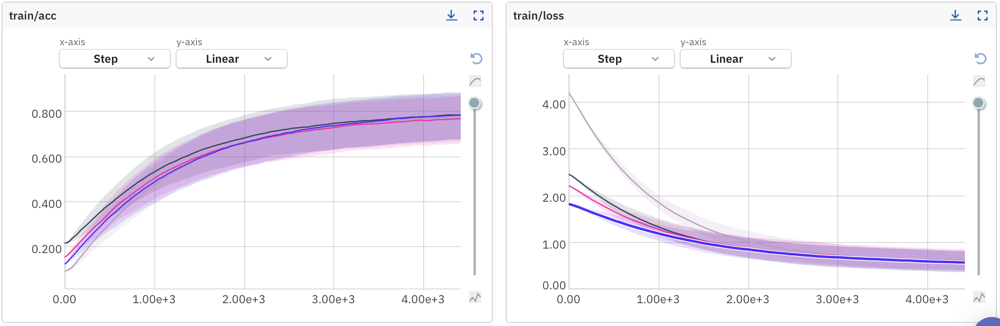

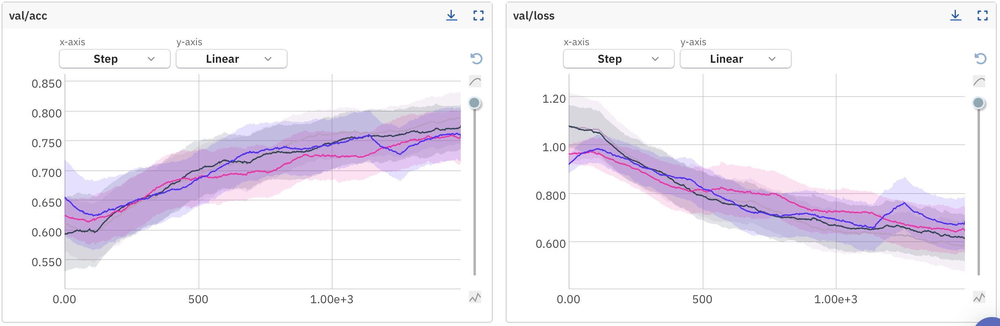

In [ ]:
trainDataloader = DataLoader(dataset_train, batch_size=32, shuffle=True)
testDataloader = DataLoader(dataset_test, batch_size=32, shuffle=True)

In [ ]:
net = BasicCNN(numLabels=6)
net = net.to(device)
criterionBasic = nn.CrossEntropyLoss()
optimizerBasic = optim.Adam(net.parameters(), lr=0.001)    #net.parameters is the wight of the NN

run = neptune.init_run(
    project="gihazshay/finalProjectML",
    api_token="eyJhcGlfYWRkcmVzcyI6Imh0dHBzOi8vYXBwLm5lcHR1bmUuYWkiLCJhcGlfdXJsIjoiaHR0cHM6Ly9hcHAubmVwdHVuZS5haSIsImFwaV9rZXkiOiI0Mjc3OWFhMi0zYWI3LTRiMjQtYjFiMC0xMGNkYWU4MjBkOTcifQ==",
)

params = {"learning_rate": 0.001, "optimizer": "Adam"}
run["parameters"] = params

trainModel = trainAug(net, trainDataloader, optimizerBasic, 13, criterionBasic)
testAcc, testLoss = test(net, testDataloader, criterionBasic)

run.stop()

[neptune] [info   ] Neptune initialized. Open in the app: https://app.neptune.ai/gihazshay/finalProjectML/e/FIN-492


Epoch 0: 100%|██████████| 453/453 [00:19<00:00, 23.60batch/s]


              precision    recall  f1-score   support

           0       0.58      0.64      0.61      2451
           1       0.45      0.36      0.40      2366
           2       0.48      0.42      0.45      2581
           3       0.50      0.55      0.53      2513
           4       0.68      0.78      0.73      2333
           5       0.49      0.48      0.49      2234

    accuracy                           0.54     14478
   macro avg       0.53      0.54      0.53     14478
weighted avg       0.53      0.54      0.53     14478



Epoch 1: 100%|██████████| 453/453 [00:18<00:00, 24.80batch/s]


              precision    recall  f1-score   support

           0       0.70      0.73      0.71      2451
           1       0.60      0.57      0.59      2366
           2       0.63      0.54      0.58      2581
           3       0.61      0.66      0.64      2513
           4       0.85      0.83      0.84      2333
           5       0.58      0.63      0.61      2234

    accuracy                           0.66     14478
   macro avg       0.66      0.66      0.66     14478
weighted avg       0.66      0.66      0.66     14478



Epoch 2: 100%|██████████| 453/453 [00:18<00:00, 24.97batch/s]


              precision    recall  f1-score   support

           0       0.73      0.76      0.75      2451
           1       0.67      0.65      0.66      2366
           2       0.69      0.62      0.65      2581
           3       0.67      0.71      0.69      2513
           4       0.88      0.86      0.87      2333
           5       0.67      0.70      0.69      2234

    accuracy                           0.72     14478
   macro avg       0.72      0.72      0.72     14478
weighted avg       0.72      0.72      0.72     14478



Epoch 3: 100%|██████████| 453/453 [00:18<00:00, 24.69batch/s]


              precision    recall  f1-score   support

           0       0.74      0.77      0.76      2451
           1       0.71      0.70      0.70      2366
           2       0.70      0.65      0.67      2581
           3       0.69      0.74      0.72      2513
           4       0.89      0.87      0.88      2333
           5       0.70      0.71      0.70      2234

    accuracy                           0.74     14478
   macro avg       0.74      0.74      0.74     14478
weighted avg       0.74      0.74      0.74     14478



Epoch 4: 100%|██████████| 453/453 [00:23<00:00, 19.44batch/s]


              precision    recall  f1-score   support

           0       0.76      0.79      0.78      2451
           1       0.72      0.71      0.71      2366
           2       0.70      0.68      0.69      2581
           3       0.71      0.73      0.72      2513
           4       0.91      0.89      0.90      2333
           5       0.73      0.73      0.73      2234

    accuracy                           0.75     14478
   macro avg       0.76      0.75      0.76     14478
weighted avg       0.75      0.75      0.75     14478



Epoch 5: 100%|██████████| 453/453 [00:26<00:00, 17.36batch/s]


              precision    recall  f1-score   support

           0       0.77      0.79      0.78      2451
           1       0.74      0.74      0.74      2366
           2       0.73      0.69      0.71      2581
           3       0.73      0.75      0.74      2513
           4       0.91      0.89      0.90      2333
           5       0.72      0.73      0.72      2234

    accuracy                           0.76     14478
   macro avg       0.77      0.77      0.77     14478
weighted avg       0.76      0.76      0.76     14478



Epoch 6: 100%|██████████| 453/453 [00:18<00:00, 24.50batch/s]


              precision    recall  f1-score   support

           0       0.78      0.80      0.79      2451
           1       0.75      0.73      0.74      2366
           2       0.72      0.71      0.71      2581
           3       0.74      0.75      0.74      2513
           4       0.91      0.90      0.91      2333
           5       0.75      0.74      0.74      2234

    accuracy                           0.77     14478
   macro avg       0.77      0.77      0.77     14478
weighted avg       0.77      0.77      0.77     14478



Epoch 7: 100%|██████████| 453/453 [00:18<00:00, 23.92batch/s]


              precision    recall  f1-score   support

           0       0.79      0.80      0.79      2451
           1       0.75      0.76      0.76      2366
           2       0.74      0.72      0.73      2581
           3       0.75      0.76      0.76      2513
           4       0.92      0.91      0.91      2333
           5       0.75      0.75      0.75      2234

    accuracy                           0.78     14478
   macro avg       0.78      0.78      0.78     14478
weighted avg       0.78      0.78      0.78     14478



Epoch 8: 100%|██████████| 453/453 [00:19<00:00, 23.83batch/s]


              precision    recall  f1-score   support

           0       0.78      0.82      0.80      2451
           1       0.76      0.76      0.76      2366
           2       0.75      0.71      0.73      2581
           3       0.74      0.76      0.75      2513
           4       0.92      0.91      0.91      2333
           5       0.76      0.75      0.75      2234

    accuracy                           0.78     14478
   macro avg       0.79      0.79      0.79     14478
weighted avg       0.78      0.78      0.78     14478



Epoch 9: 100%|██████████| 453/453 [00:18<00:00, 25.09batch/s]


              precision    recall  f1-score   support

           0       0.80      0.82      0.81      2451
           1       0.78      0.77      0.77      2366
           2       0.75      0.74      0.75      2581
           3       0.76      0.77      0.77      2513
           4       0.92      0.92      0.92      2333
           5       0.76      0.76      0.76      2234

    accuracy                           0.79     14478
   macro avg       0.79      0.80      0.79     14478
weighted avg       0.79      0.79      0.79     14478



Epoch 10: 100%|██████████| 453/453 [00:24<00:00, 18.23batch/s]


              precision    recall  f1-score   support

           0       0.80      0.82      0.81      2451
           1       0.79      0.79      0.79      2366
           2       0.76      0.74      0.75      2581
           3       0.77      0.77      0.77      2513
           4       0.92      0.92      0.92      2333
           5       0.78      0.77      0.78      2234

    accuracy                           0.80     14478
   macro avg       0.80      0.80      0.80     14478
weighted avg       0.80      0.80      0.80     14478



Epoch 11: 100%|██████████| 453/453 [00:24<00:00, 18.13batch/s]


              precision    recall  f1-score   support

           0       0.80      0.82      0.81      2451
           1       0.77      0.78      0.78      2366
           2       0.76      0.75      0.75      2581
           3       0.76      0.76      0.76      2513
           4       0.92      0.91      0.92      2333
           5       0.77      0.76      0.77      2234

    accuracy                           0.80     14478
   macro avg       0.80      0.80      0.80     14478
weighted avg       0.80      0.80      0.80     14478



Epoch 12: 100%|██████████| 453/453 [00:18<00:00, 25.12batch/s]


              precision    recall  f1-score   support

           0       0.81      0.83      0.82      2451
           1       0.77      0.79      0.78      2366
           2       0.75      0.74      0.74      2581
           3       0.76      0.76      0.76      2513
           4       0.92      0.92      0.92      2333
           5       0.78      0.78      0.78      2234

    accuracy                           0.80     14478
   macro avg       0.80      0.80      0.80     14478
weighted avg       0.80      0.80      0.80     14478



100%|██████████| 80/80 [00:02<00:00, 33.41batch/s]


              precision    recall  f1-score   support

           0       0.81      0.74      0.77       432
           1       0.78      0.76      0.77       418
           2       0.76      0.73      0.75       456
           3       0.75      0.81      0.78       444
           4       0.93      0.92      0.93       412
           5       0.73      0.79      0.76       394

    accuracy                           0.79      2556
   macro avg       0.79      0.79      0.79      2556
weighted avg       0.79      0.79      0.79      2556

[neptune] [info   ] Shutting down background jobs, please wait a moment...
[neptune] [info   ] Done!
[neptune] [info   ] Waiting for the remaining 19 operations to synchronize with Neptune. Do not kill this process.
[neptune] [info   ] All 19 operations synced, thanks for waiting!
[neptune] [info   ] Explore the metadata in the Neptune app: https://app.neptune.ai/gihazshay/finalProjectML/e/FIN-492/metadata


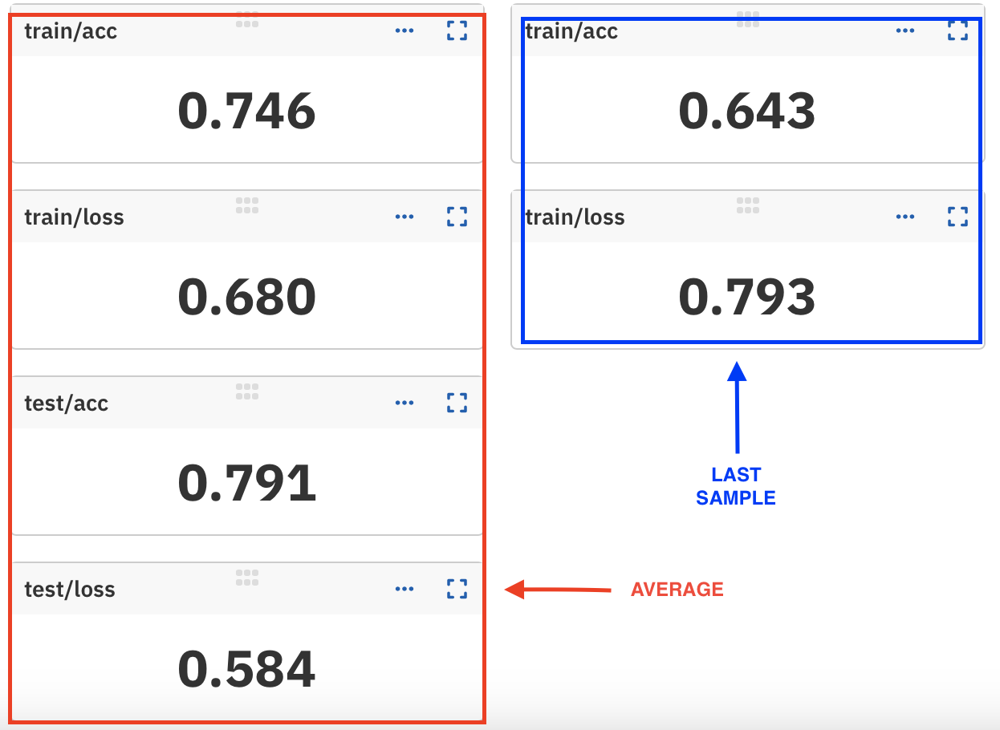

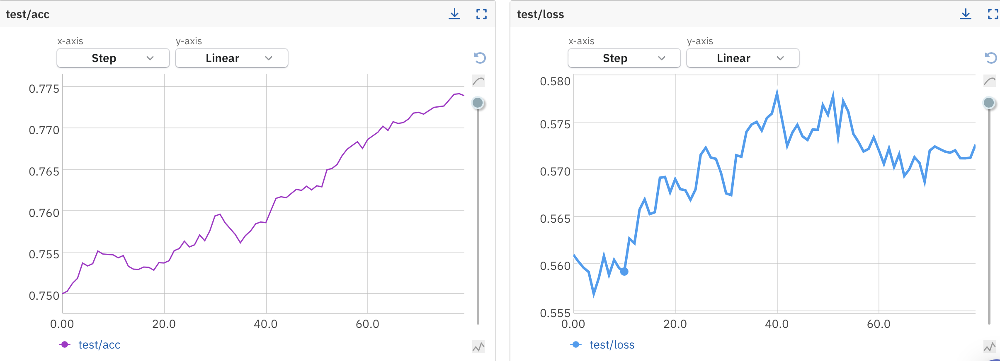

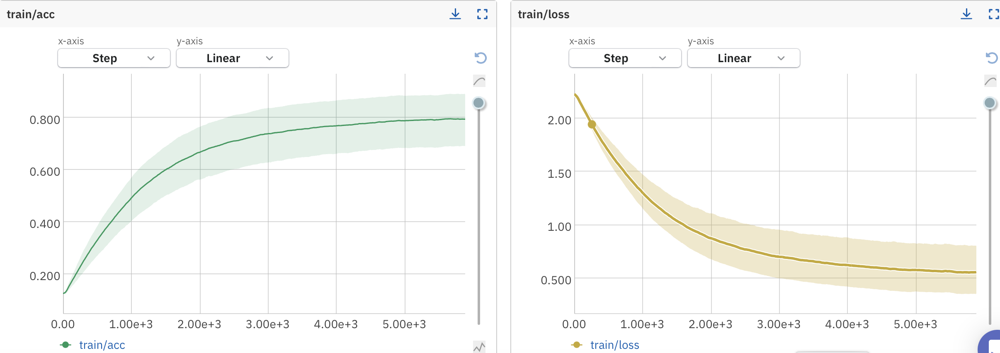

Let's pause for a moment and analyze the results. Initially, I applied `ColorJitter` augmentation alone, followed by `Horizontal Flip`. However, the results were not as promising as expected and did not significantly improve the model's performance.

After learning more about augmentations, I realized that applying them individually might not be the best approach. The effectiveness of augmentations can be limited when used in isolation because they do not provide enough variability to the training data. To address this, I decided to use an augmentation pipeline.

### Augmentation Pipeline

An augmentation pipeline involves applying a series of augmentations sequentially to each image, creating a more diverse and varied training set. This approach helps the model generalize better by exposing it to a wider range of variations. By combining multiple augmentations, we can simulate different conditions and perspectives, making the model more robust and capable of handling real-world data variations.


By combining augmentations like resizing, flipping, and color adjustments, we provide diverse training examples to improve the model's generalization ability.

In [ ]:
transform0 = transforms.Resize((150, 150))

transform1 = transforms.Compose([
    transforms.Resize((150, 150)),
    transforms.ColorJitter(saturation=1.0),
    transforms.RandomHorizontalFlip(p=0.5)
])

transform_list = [transform0,transform1]

In [ ]:
dataset_train = ImageDatasetAug(trainDataFrame, destination_folderPath, transform_list)
dataset_test = ImageDatasetAug(TestDataFrame, destination_folderPath, transform_list)


In [ ]:
num_folds = 4  # Change this to the desired number of folds

# Initialize the KFold object
kf = KFold(n_splits=num_folds, shuffle=True, random_state=40)


foldNum = 0
foldsMatrix = {}


for train_indices, val_indices in kf.split(idxTrain):

    train_subset = Subset(dataset_train, train_indices)
    val_subset = Subset(dataset_train, val_indices)

    # Create a DataLoader object with batch size 32
    trainDataloaderKfold = DataLoader(train_subset, batch_size=32, shuffle=True)
    valDataloaderKfold = DataLoader(val_subset, batch_size=32, shuffle=True)

    print(f"------fold------:{foldNum}")

    run = neptune.init_run(
    project="gihazshay/finalProjectML",
    api_token="eyJhcGlfYWRkcmVzcyI6Imh0dHBzOi8vYXBwLm5lcHR1bmUuYWkiLCJhcGlfdXJsIjoiaHR0cHM6Ly9hcHAubmVwdHVuZS5haSIsImFwaV9rZXkiOiI0Mjc3OWFhMi0zYWI3LTRiMjQtYjFiMC0xMGNkYWU4MjBkOTcifQ==",
    )

    params = {"learning_rate": 0.001, "optimizer": "Adam"}
    run["parameters"] = params

    net = BasicCNN(numLabels=6)
    net = net.to(device)
    criterionBasic = nn.CrossEntropyLoss()
    optimizerBasic = optim.Adam(net.parameters(), lr=0.001)    #net.parameters is the wight of the NN
    trainAcc, trainLoss, valAcc, valLoss = trainAug(net, trainDataloaderKfold, optimizerBasic, 13, criterionBasic, valDataloaderKfold)

    run.stop()
    foldsMatrix[f"fold {foldNum}"] = {'train_acc':trainAcc, 'train_loss':trainLoss,
                                      'val_acc':valAcc, 'val_loss':valLoss}
    foldNum += 1


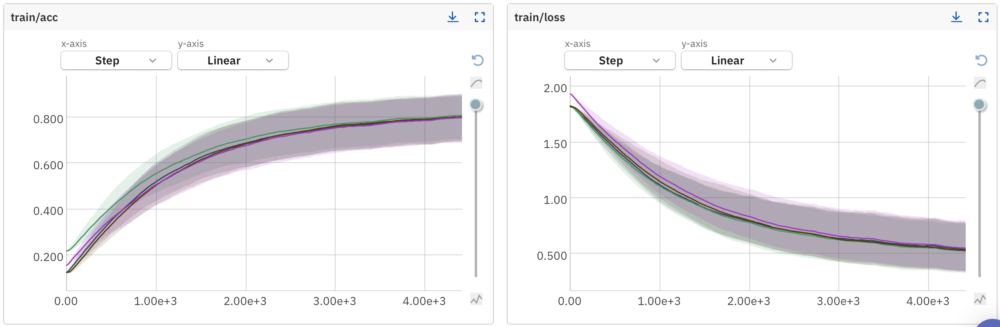

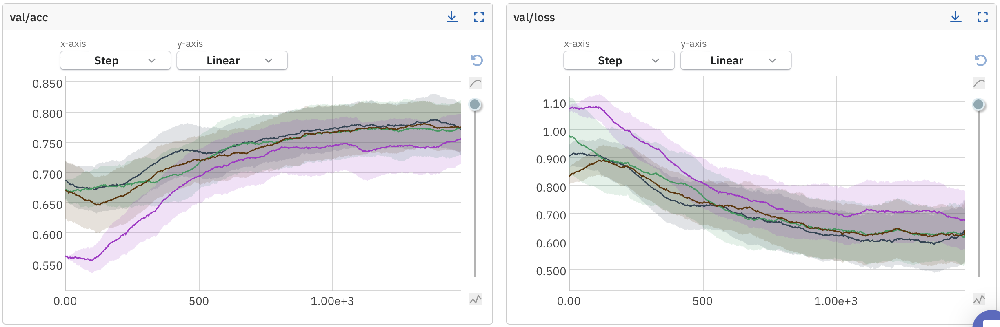

In [ ]:
trainDataloader = DataLoader(dataset_train, batch_size=32, shuffle=True)
testDataloader = DataLoader(dataset_test, batch_size=32, shuffle=True)

In [ ]:
net = BasicCNN(numLabels=6)
net = net.to(device)
criterionBasic = nn.CrossEntropyLoss()
optimizerBasic = optim.Adam(net.parameters(), lr=0.001)    #net.parameters is the wight of the NN

run = neptune.init_run(
    project="gihazshay/finalProjectML",
    api_token="eyJhcGlfYWRkcmVzcyI6Imh0dHBzOi8vYXBwLm5lcHR1bmUuYWkiLCJhcGlfdXJsIjoiaHR0cHM6Ly9hcHAubmVwdHVuZS5haSIsImFwaV9rZXkiOiI0Mjc3OWFhMi0zYWI3LTRiMjQtYjFiMC0xMGNkYWU4MjBkOTcifQ==",
)

params = {"learning_rate": 0.001, "optimizer": "Adam"}
run["parameters"] = params

trainModel = trainAug(net, trainDataloader, optimizerBasic, 13, criterionBasic)
testAcc, testLoss = test(net, testDataloader, criterionBasic)

run.stop()

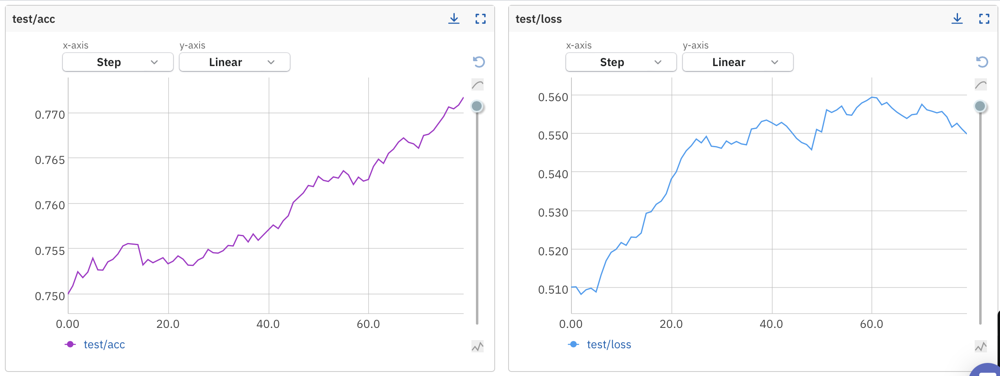

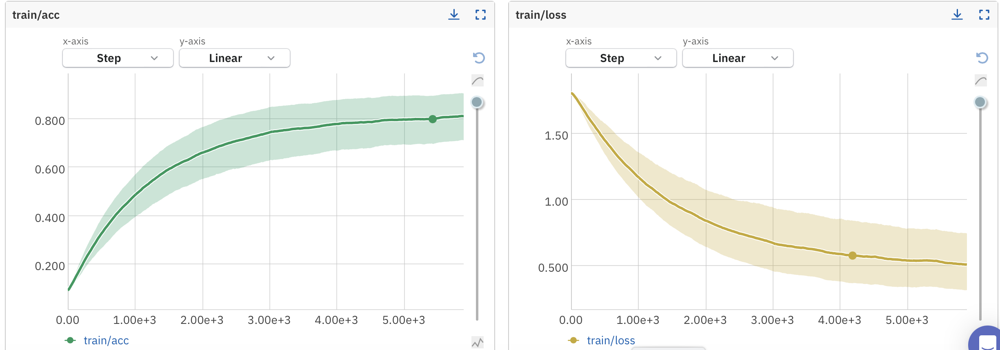

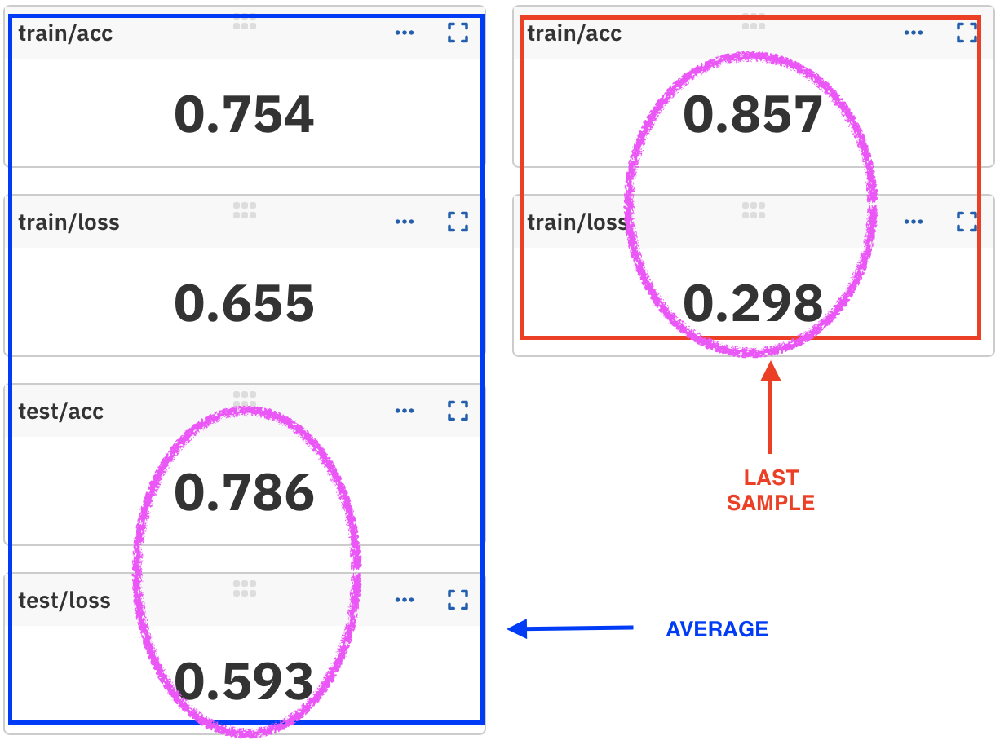

**For now, this is the best-performing model!**

#### Analysis


We can clearly see that the performance of the network improved when we applied both augmentations together.

It's important to note that the selection of values for each augmentation was determined through trial and error. For example, for `ColorJitter`, we initially ran the model with a saturation value of $4$ and observed that the system performance was suboptimal. We then adjusted the saturation to $1$, which yielded better results. Similarly, for `RandomHorizontalFlip`, we first set the flip probability to $1$, meaning every image was flipped. After further research, we realized it was better to flip images with a probability of about $0.5$, which provided more balanced results.

To further improve the system, we can experiment with additional augmentations. Since determining the best augmentation can only be achieved through various experiments, we will analyze the model's performance results and identify where the model is making errors.

Our tactic will be to identify patterns in the model's errors. For instance, we will check if the model frequently misclassifies images with a specific label as another label.

While we should expect some "strange" mistakes due to the model's imperfections and the limitations we face (such as system depth and hardware constraints), examining these errors can provide insights into which augmentations might help improve performance. By understanding the specific areas where the model struggles, we can tailor our augmentation strategy to address these weaknesses.

Before we begin to view the images, I will add a CSV file containing a table with the image number, prediction, and correct label in the test sequence.

In [ ]:
PredResults = pd.read_csv('/content/NNresultsPred.csv', header = None, names = ['idx', 'imageID', 'prediction', 'Label'])

In [ ]:
PredResults

,idx,imageID,prediction,Label
0,NaN,id,pred,label
1,0.0,3707,4,4
2,1.0,12050,5,0
3,2.0,9610,2,1
4,3.0,3145,4,4
...,...,...,...,...
2552,2551.0,3655,4,4
2553,2552.0,7074,2,2
2554,2553.0,16316,1,1
2555,2554.0,6618,3,3


#### Confusion Matrix

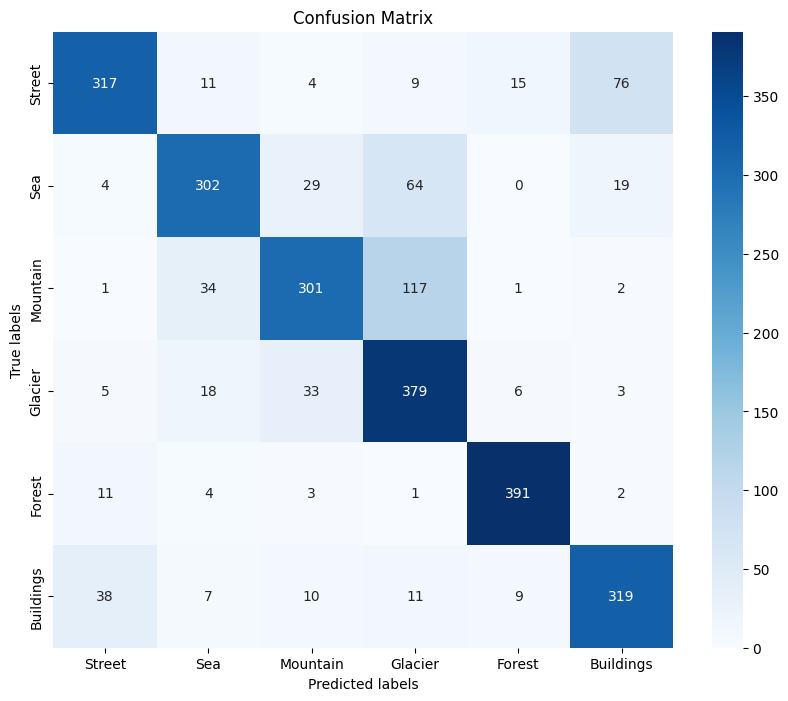

In [ ]:
predictions = PredResults['prediction']
actual_labels = PredResults['Label']

# Compute the confusion matrix
conf_matrix = confusion_matrix(actual_labels, predictions)
conf_matrix = conf_matrix[:6, :6]

class_names = ['Street', 'Sea', 'Mountain', 'Glacier', 'Forest', 'Buildings']
# Plot the confusion matrix
plt.figure(figsize=(10, 8))
sns.heatmap(conf_matrix, annot=True, fmt='d', cmap='Blues', xticklabels=class_names, yticklabels=class_names)
plt.xlabel('Predicted labels')
plt.ylabel('True labels')
plt.title('Confusion Matrix')
plt.show()

##### **Street to Buildings and vise versa:**

           label:Street          pred:Buildings   ----> 76 errors

           label:Buildings       pred:Street      ----> 38 errors


Street images often contain buildings, causing the model to confuse images of streets with those of buildings. This overlap in visual features (e.g., structures, windows) can lead to misclassification.

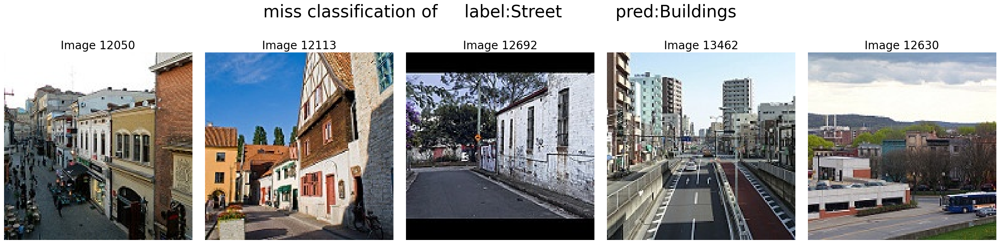

In [ ]:
fig, axes = plt.subplots(1, 5, figsize=(25, 5))  # 1x5 grid of subplots

# List of specific indices to display
indices = [12050, 12113, 12692, 13462, 12630]  # Replace with your specific indices

for i, idx in enumerate(indices):
    ax = axes[i]
    image = np.array(dataset[idx][0])
    ax.imshow(image.transpose(1, 2, 0))  # Display the image
    ax.axis('off')  # Turn off axis
    ax.set_title(f'Image {idx}', fontsize=20)

plt.tight_layout()
plt.suptitle('miss classification of     label:Street          pred:Buildings', fontsize=30 , y=1.2)
plt.show()

##### Sea to Mountain and vise versa:

                label:Sea             pred:Mountain   ----> 34 errors

                label:Mountain        pred:Sea        ----> 29 errors


Many sea images may include mountains or hills in the background, leading to a visual overlap. The model might be picking up on these background features rather than focusing on the primary subject (the sea).


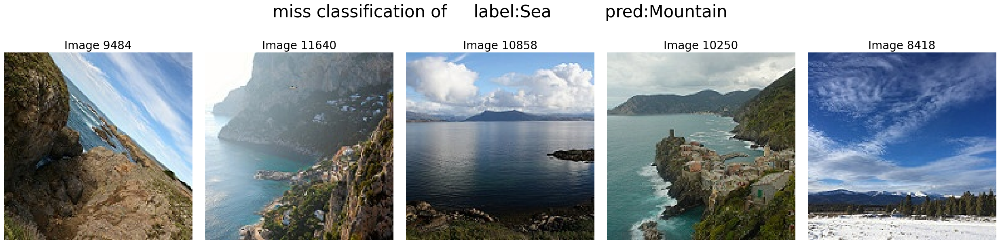

In [ ]:
fig, axes = plt.subplots(1, 5, figsize=(25, 5))  # 1x5 grid of subplots

# List of specific indices to display
indices = [9484, 11640, 10858, 10250, 8418]  # Replace with your specific indices

for i, idx in enumerate(indices):
    ax = axes[i]
    image = np.array(dataset[idx][0])
    ax.imshow(image.transpose(1, 2, 0))  # Display the image
    ax.axis('off')  # Turn off axis
    ax.set_title(f'Image {idx}', fontsize=20)

plt.tight_layout()
plt.suptitle('miss classification of     label:Sea          pred:Mountain', fontsize=30 , y=1.2)
plt.show()

##### Mountain to Glacier and vise versa:

                label:Mountain        pred:Glacier   ----> 117 errors

                label:Glacier         pred:Mountain  ----> 33 errors


There is a significant visual similarity between snowy mountains and glaciers. Both categories contain white, snowy features that can be hard to distinguish, especially if the images of glaciers also include rocky or mountain-like features.

Also note that glacier images often contain noise that can appear as mountain-like features, further confusing the model.

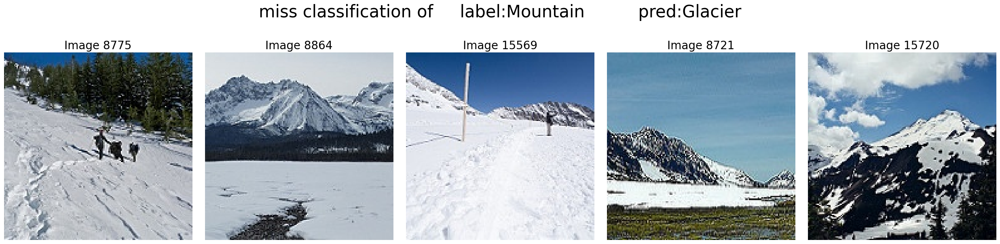

In [ ]:
fig, axes = plt.subplots(1, 5, figsize=(25, 5))  # 1x5 grid of subplots

# List of specific indices to display
indices = [8775, 8864, 15569, 8721, 15720]  # Replace with your specific indices

for i, idx in enumerate(indices):
    ax = axes[i]
    image = np.array(dataset[idx][0])
    ax.imshow(image.transpose(1, 2, 0))  # Display the image
    ax.axis('off')  # Turn off axis
    ax.set_title(f'Image {idx}', fontsize=20)

plt.tight_layout()
plt.suptitle('miss classification of     label:Mountain          pred:Glacier', fontsize=30 , y=1.2)
plt.show()

##### Sea to Glacier and vise versa:

                label:Sea        pred:Glacier   ----> 64 errors

                label:Glacier         pred:Sea  ----> 18 errors


The misclassification between sea and glacier may occur due to similar textures and colors, noise in glacier images, and model complexity.

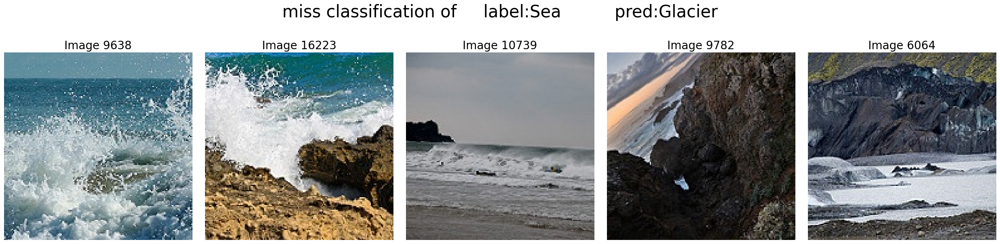

In [ ]:
fig, axes = plt.subplots(1, 5, figsize=(25, 5))  # 1x5 grid of subplots

# List of specific indices to display
indices = [9638, 16223, 10739, 9782, 6064]  # Replace with your specific indices

for i, idx in enumerate(indices):
    ax = axes[i]
    image = np.array(dataset[idx][0])
    ax.imshow(image.transpose(1, 2, 0))  # Display the image
    ax.axis('off')  # Turn off axis
    ax.set_title(f'Image {idx}', fontsize=20)

plt.tight_layout()
plt.suptitle('miss classification of     label:Sea          pred:Glacier', fontsize=30 , y=1.2)
plt.show()

After analyzing the misclassifications made by our model, it is evident that certain categories such as streets being mistaken for buildings, seas for mountains, and mountains for glaciers are particularly challenging due to their visual similarities. Additionally, noise present in glacier images often leads to confusion with mountain images.

To address these issues and enhance the model's performance, we need to apply thoughtful data augmentation techniques. By doing so, we can improve the variability of our training data, help the model generalize better, and reduce the impact of misleading features.

To address these specific misclassifications and the noise issue, the following augmentations can be considered in addition to ColorJitter and Horizontal Flip:



*   ***Gaussian Blur:*** Adding a slight blur can force the model to focus more on the overall shape and color patterns rather than fine details, which might help in differentiating between sea and mountains or streets and buildings.


*   ***Contrast Adjustment:*** Adjusting the contrast can help the model learn to recognize features under different lighting conditions, which might improve its ability to distinguish between classes that look similar in certain lighting (e.g., snowy mountains vs. glaciers).


*   ***Normalize:*** Normalizing the images helps to standardize the pixel values, improving the training stability and convergence of the model. This is particularly useful in handling variations in lighting and color across different images.



### Upgrade Pipline

Before we dive in, let me explain more about the augmentation we will going to use:

* **Gaussian Blur** is a type of image-blurring filter that uses a Gaussian function. This function reduces the noise and detail in the image by averaging the pixel values with their neighbors, where the neighboring pixels' contributions decrease with distance from the central pixel.

  * *Parameters:*

    * **Kernel Size:**
The kernel size defines the width and height of the Gaussian filter. It must be an odd number (e.g., 3x3, 5x5).
A larger kernel size means that more pixels will be averaged, resulting in a stronger blur.
Example: A 3x3 kernel applies a slight blur, whereas a 15x15 kernel will produce a much stronger blur.

    * **Sigma (Standard Deviation):**
Sigma defines the amount of blur. It determines the spread of the Gaussian function.
A smaller sigma means less blurring, while a larger sigma results in more significant blurring.
Example: A sigma of 1.0 will result in a light blur, while a sigma of 5.0 will result in a heavy blur.

* **Contrast Adjustment** alters the contrast of the image, making bright areas brighter and dark areas darker, or vice versa.

   * *Parameters:*

      * **Contrast Factor:**
A contrast factor of 1.0 leaves the image unchanged.
A factor greater than 1.0 increases contrast, making the bright areas brighter and dark areas darker.
A factor between 0 and 1.0 decreases contrast, making the image appear more gray.

* **Normalization** is a technique used to scale pixel values to a common range, typically to improve the convergence of the training process. It adjusts the mean and standard deviation of the dataset's pixel values to predefined values.

  * *Parameters:*

    * **Mean:**
The mean value is subtracted from each pixel.
Commonly used mean values for pretrained models (like those trained on ImageNet) are [0.485, 0.456, 0.406] for the RGB channels.

    * **Standard Deviation (Std):**
Each pixel value is divided by the standard deviation.
Commonly used standard deviation values for pretrained models are [0.229, 0.224, 0.225] for the RGB channels.


In [ ]:
transform0 = transforms.Compose([
    transforms.Resize((150, 150))
])

transform1 = transforms.Compose([
    transforms.Resize((150, 150)),
    transforms.ColorJitter(saturation=0.8, contrast=0.5),
    transforms.RandomHorizontalFlip(p=0.5),
    transforms.RandomApply([transforms.GaussianBlur(kernel_size=(5, 5), sigma=(0.1,2.5))], p=0.5)

])

transform_list = [transform0,transform1]

This setup will apply a series of augmentations to our dataset, which can help the model become more robust and improve its performance on the misclassified categories.

In [ ]:
dataset_train = ImageDatasetAug(trainDataFrame, destination_folderPath, transform_list)
dataset_test = ImageDatasetAug(TestDataFrame, destination_folderPath, transform_list)


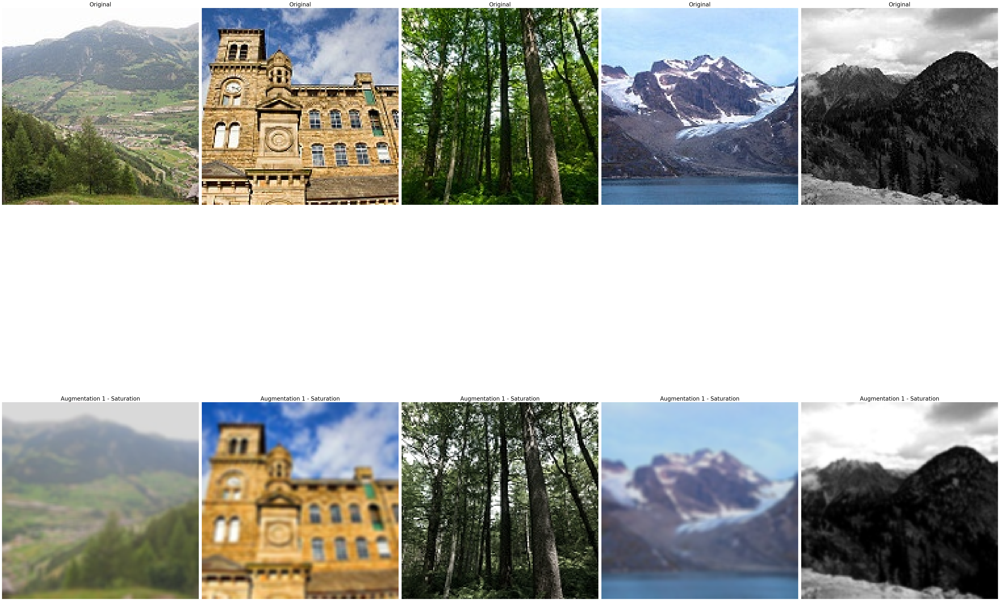

In [ ]:
fig, axes = plt.subplots(2, 5, figsize=(50, 50))

for i in range(5):
  ax1 = axes[0, i]
  ax2 = axes[1, i]
  idx = random.choice(trainDataFrame.index)
  image1 = np.array(dataset_train[idx][0])
  image2 = np.array(dataset_train[idx][3])
  ax1.imshow(image1.transpose(1, 2, 0)) # squeeze Remove axes of length one
  ax1.axis('off')  # Turn off axis
  ax2.imshow(image2.transpose(1, 2, 0)) # squeeze Remove axes of length one
  ax2.axis('off')  # Turn off axis

for ax in axes[0, :]:
    ax.set_title('Original', fontsize=20)
for ax in axes[1, :]:
    ax.set_title('Augmentation Pipline', fontsize=20)

plt.tight_layout()
plt.show()

In [ ]:
num_folds = 4  # Change this to the desired number of folds

# Initialize the KFold object
kf = KFold(n_splits=num_folds, shuffle=True, random_state=40)


foldNum = 0
foldsMatrix = {}


for train_indices, val_indices in kf.split(idxTrain):

    train_subset = Subset(dataset_train, train_indices)
    val_subset = Subset(dataset_train, val_indices)



    # Create a DataLoader object with batch size 32
    trainDataloaderKfold = DataLoader(train_subset, batch_size=32, shuffle=True)
    valDataloaderKfold = DataLoader(val_subset, batch_size=32, shuffle=True)

    trainDataloaderKfold = trainDataloaderKfold
    valDataloaderKfold = valDataloaderKfold

    print(f"------fold------:{foldNum}")

    run = neptune.init_run(
    project="gihazshay/finalProjectML",
    api_token="eyJhcGlfYWRkcmVzcyI6Imh0dHBzOi8vYXBwLm5lcHR1bmUuYWkiLCJhcGlfdXJsIjoiaHR0cHM6Ly9hcHAubmVwdHVuZS5haSIsImFwaV9rZXkiOiI0Mjc3OWFhMi0zYWI3LTRiMjQtYjFiMC0xMGNkYWU4MjBkOTcifQ==",
    )

    params = {"learning_rate": 0.001, "optimizer": "Adam"}
    run["parameters"] = params

    net = BasicCNN(numLabels=6)
    net = net.to(device)
    criterionBasic = nn.CrossEntropyLoss()
    optimizerBasic = optim.Adam(net.parameters(), lr=0.001)    #net.parameters is the wight of the NN
    trainAcc, trainLoss, valAcc, valLoss = trainAug(net, trainDataloaderKfold, optimizerBasic, 13, criterionBasic, valDataloaderKfold)

    run.stop()
    foldsMatrix[f"fold {foldNum}"] = {'train_acc':trainAcc, 'train_loss':trainLoss,
                                      'val_acc':valAcc, 'val_loss':valLoss}
    foldNum += 1


------fold------:0
[neptune] [info   ] Neptune initialized. Open in the app: https://app.neptune.ai/gihazshay/finalProjectML/e/FIN-510


Epoch 0: 100%|██████████| 340/340 [01:59<00:00,  2.85batch/s]


              precision    recall  f1-score   support

           0       0.55      0.66      0.60      1822
           1       0.42      0.22      0.29      1766
           2       0.54      0.44      0.49      1964
           3       0.48      0.65      0.55      1871
           4       0.77      0.78      0.78      1745
           5       0.50      0.53      0.52      1690

    accuracy                           0.55     10858
   macro avg       0.54      0.55      0.54     10858
weighted avg       0.54      0.55      0.54     10858

Validtion part------EPOCH------:0


100%|██████████| 114/114 [00:25<00:00,  4.42batch/s]


              precision    recall  f1-score   support

           0       0.61      0.88      0.72       629
           1       0.56      0.42      0.48       600
           2       0.62      0.64      0.63       617
           3       0.65      0.63      0.64       642
           4       0.95      0.84      0.89       588
           5       0.60      0.55      0.57       544

    accuracy                           0.66      3620
   macro avg       0.67      0.66      0.66      3620
weighted avg       0.67      0.66      0.66      3620



Epoch 1: 100%|██████████| 340/340 [01:39<00:00,  3.43batch/s]


              precision    recall  f1-score   support

           0       0.64      0.67      0.65      1822
           1       0.47      0.30      0.37      1766
           2       0.56      0.58      0.57      1964
           3       0.50      0.64      0.56      1871
           4       0.82      0.78      0.80      1745
           5       0.59      0.60      0.60      1690

    accuracy                           0.60     10858
   macro avg       0.60      0.60      0.59     10858
weighted avg       0.60      0.60      0.59     10858

Validtion part------EPOCH------:1


100%|██████████| 114/114 [00:27<00:00,  4.15batch/s]


              precision    recall  f1-score   support

           0       0.82      0.62      0.70       629
           1       0.48      0.49      0.48       600
           2       0.64      0.54      0.59       617
           3       0.60      0.70      0.64       642
           4       0.85      0.91      0.88       588
           5       0.60      0.71      0.65       544

    accuracy                           0.66      3620
   macro avg       0.66      0.66      0.66      3620
weighted avg       0.67      0.66      0.66      3620



Epoch 2: 100%|██████████| 340/340 [01:36<00:00,  3.53batch/s]


              precision    recall  f1-score   support

           0       0.74      0.76      0.75      1822
           1       0.59      0.49      0.54      1766
           2       0.64      0.65      0.65      1964
           3       0.63      0.69      0.66      1871
           4       0.90      0.90      0.90      1745
           5       0.69      0.70      0.70      1690

    accuracy                           0.70     10858
   macro avg       0.70      0.70      0.70     10858
weighted avg       0.70      0.70      0.70     10858

Validtion part------EPOCH------:2


100%|██████████| 114/114 [00:24<00:00,  4.61batch/s]


              precision    recall  f1-score   support

           0       0.77      0.76      0.77       629
           1       0.57      0.72      0.63       600
           2       0.70      0.63      0.66       617
           3       0.70      0.63      0.66       642
           4       0.96      0.87      0.91       588
           5       0.68      0.72      0.70       544

    accuracy                           0.72      3620
   macro avg       0.73      0.72      0.72      3620
weighted avg       0.73      0.72      0.72      3620



Epoch 3: 100%|██████████| 340/340 [01:38<00:00,  3.45batch/s]


              precision    recall  f1-score   support

           0       0.69      0.72      0.71      1822
           1       0.57      0.47      0.51      1766
           2       0.60      0.64      0.62      1964
           3       0.59      0.65      0.62      1871
           4       0.86      0.86      0.86      1745
           5       0.67      0.66      0.67      1690

    accuracy                           0.67     10858
   macro avg       0.67      0.67      0.67     10858
weighted avg       0.66      0.67      0.66     10858

Validtion part------EPOCH------:3


100%|██████████| 114/114 [00:26<00:00,  4.32batch/s]


              precision    recall  f1-score   support

           0       0.71      0.80      0.75       629
           1       0.72      0.48      0.58       600
           2       0.56      0.78      0.65       617
           3       0.75      0.52      0.61       642
           4       0.83      0.97      0.89       588
           5       0.69      0.65      0.67       544

    accuracy                           0.70      3620
   macro avg       0.71      0.70      0.69      3620
weighted avg       0.71      0.70      0.69      3620



Epoch 4: 100%|██████████| 340/340 [01:35<00:00,  3.57batch/s]


              precision    recall  f1-score   support

           0       0.79      0.80      0.79      1822
           1       0.69      0.61      0.65      1766
           2       0.67      0.67      0.67      1964
           3       0.68      0.73      0.70      1871
           4       0.91      0.92      0.91      1745
           5       0.74      0.75      0.74      1690

    accuracy                           0.74     10858
   macro avg       0.74      0.74      0.74     10858
weighted avg       0.74      0.74      0.74     10858

Validtion part------EPOCH------:4


100%|██████████| 114/114 [00:24<00:00,  4.58batch/s]


              precision    recall  f1-score   support

           0       0.71      0.69      0.70       629
           1       0.76      0.53      0.63       600
           2       0.81      0.48      0.61       617
           3       0.59      0.86      0.70       642
           4       0.98      0.80      0.88       588
           5       0.58      0.85      0.69       544

    accuracy                           0.70      3620
   macro avg       0.74      0.70      0.70      3620
weighted avg       0.74      0.70      0.70      3620



Epoch 5: 100%|██████████| 340/340 [01:35<00:00,  3.55batch/s]


              precision    recall  f1-score   support

           0       0.72      0.75      0.74      1822
           1       0.63      0.57      0.60      1766
           2       0.64      0.65      0.64      1964
           3       0.63      0.66      0.64      1871
           4       0.88      0.87      0.87      1745
           5       0.71      0.70      0.70      1690

    accuracy                           0.70     10858
   macro avg       0.70      0.70      0.70     10858
weighted avg       0.70      0.70      0.70     10858

Validtion part------EPOCH------:5


100%|██████████| 114/114 [00:25<00:00,  4.46batch/s]


              precision    recall  f1-score   support

           0       0.83      0.64      0.72       629
           1       0.70      0.59      0.64       600
           2       0.54      0.83      0.66       617
           3       0.82      0.44      0.57       642
           4       0.87      0.95      0.91       588
           5       0.64      0.83      0.72       544

    accuracy                           0.71      3620
   macro avg       0.73      0.71      0.70      3620
weighted avg       0.74      0.71      0.70      3620



Epoch 6: 100%|██████████| 340/340 [01:37<00:00,  3.49batch/s]


              precision    recall  f1-score   support

           0       0.79      0.80      0.80      1822
           1       0.73      0.68      0.70      1766
           2       0.72      0.71      0.71      1964
           3       0.70      0.73      0.72      1871
           4       0.92      0.92      0.92      1745
           5       0.76      0.77      0.76      1690

    accuracy                           0.77     10858
   macro avg       0.77      0.77      0.77     10858
weighted avg       0.77      0.77      0.77     10858

Validtion part------EPOCH------:6


100%|██████████| 114/114 [00:25<00:00,  4.50batch/s]


              precision    recall  f1-score   support

           0       0.83      0.77      0.80       629
           1       0.77      0.61      0.68       600
           2       0.69      0.75      0.72       617
           3       0.65      0.80      0.72       642
           4       0.90      0.94      0.92       588
           5       0.79      0.71      0.75       544

    accuracy                           0.76      3620
   macro avg       0.77      0.76      0.76      3620
weighted avg       0.77      0.76      0.76      3620



Epoch 7: 100%|██████████| 340/340 [01:37<00:00,  3.49batch/s]


              precision    recall  f1-score   support

           0       0.73      0.75      0.74      1822
           1       0.66      0.63      0.65      1766
           2       0.66      0.66      0.66      1964
           3       0.65      0.67      0.66      1871
           4       0.88      0.88      0.88      1745
           5       0.73      0.71      0.72      1690

    accuracy                           0.72     10858
   macro avg       0.72      0.72      0.72     10858
weighted avg       0.72      0.72      0.72     10858

Validtion part------EPOCH------:7


100%|██████████| 114/114 [00:25<00:00,  4.50batch/s]


              precision    recall  f1-score   support

           0       0.87      0.62      0.72       629
           1       0.73      0.70      0.71       600
           2       0.72      0.69      0.70       617
           3       0.68      0.74      0.71       642
           4       0.91      0.94      0.92       588
           5       0.64      0.82      0.72       544

    accuracy                           0.75      3620
   macro avg       0.76      0.75      0.75      3620
weighted avg       0.76      0.75      0.75      3620



Epoch 8: 100%|██████████| 340/340 [01:38<00:00,  3.47batch/s]


              precision    recall  f1-score   support

           0       0.82      0.82      0.82      1822
           1       0.75      0.72      0.73      1766
           2       0.73      0.71      0.72      1964
           3       0.71      0.75      0.73      1871
           4       0.93      0.93      0.93      1745
           5       0.78      0.79      0.79      1690

    accuracy                           0.79     10858
   macro avg       0.79      0.79      0.79     10858
weighted avg       0.79      0.79      0.79     10858

Validtion part------EPOCH------:8


100%|██████████| 114/114 [00:25<00:00,  4.43batch/s]


              precision    recall  f1-score   support

           0       0.67      0.73      0.70       629
           1       0.65      0.76      0.70       600
           2       0.77      0.61      0.68       617
           3       0.77      0.71      0.74       642
           4       0.99      0.72      0.83       588
           5       0.64      0.83      0.72       544

    accuracy                           0.73      3620
   macro avg       0.75      0.73      0.73      3620
weighted avg       0.75      0.73      0.73      3620



Epoch 9: 100%|██████████| 340/340 [01:38<00:00,  3.44batch/s]


              precision    recall  f1-score   support

           0       0.77      0.77      0.77      1822
           1       0.67      0.66      0.66      1766
           2       0.67      0.67      0.67      1964
           3       0.68      0.69      0.68      1871
           4       0.90      0.90      0.90      1745
           5       0.73      0.73      0.73      1690

    accuracy                           0.74     10858
   macro avg       0.74      0.74      0.74     10858
weighted avg       0.74      0.74      0.74     10858

Validtion part------EPOCH------:9


100%|██████████| 114/114 [00:26<00:00,  4.24batch/s]


              precision    recall  f1-score   support

           0       0.81      0.74      0.77       629
           1       0.64      0.81      0.71       600
           2       0.75      0.61      0.67       617
           3       0.75      0.70      0.72       642
           4       0.94      0.93      0.93       588
           5       0.69      0.78      0.74       544

    accuracy                           0.76      3620
   macro avg       0.76      0.76      0.76      3620
weighted avg       0.76      0.76      0.76      3620



Epoch 10: 100%|██████████| 340/340 [01:39<00:00,  3.43batch/s]


              precision    recall  f1-score   support

           0       0.82      0.83      0.82      1822
           1       0.75      0.73      0.74      1766
           2       0.74      0.72      0.73      1964
           3       0.73      0.76      0.74      1871
           4       0.93      0.94      0.93      1745
           5       0.80      0.80      0.80      1690

    accuracy                           0.79     10858
   macro avg       0.80      0.80      0.80     10858
weighted avg       0.79      0.79      0.79     10858

Validtion part------EPOCH------:10


100%|██████████| 114/114 [00:27<00:00,  4.21batch/s]


              precision    recall  f1-score   support

           0       0.82      0.73      0.78       629
           1       0.78      0.60      0.68       600
           2       0.64      0.82      0.72       617
           3       0.73      0.71      0.72       642
           4       0.88      0.96      0.92       588
           5       0.75      0.74      0.75       544

    accuracy                           0.76      3620
   macro avg       0.77      0.76      0.76      3620
weighted avg       0.77      0.76      0.76      3620



Epoch 11: 100%|██████████| 340/340 [01:38<00:00,  3.47batch/s]


              precision    recall  f1-score   support

           0       0.77      0.79      0.78      1822
           1       0.70      0.68      0.69      1766
           2       0.69      0.69      0.69      1964
           3       0.69      0.69      0.69      1871
           4       0.90      0.90      0.90      1745
           5       0.76      0.75      0.75      1690

    accuracy                           0.75     10858
   macro avg       0.75      0.75      0.75     10858
weighted avg       0.75      0.75      0.75     10858

Validtion part------EPOCH------:11


100%|██████████| 114/114 [00:27<00:00,  4.21batch/s]


              precision    recall  f1-score   support

           0       0.84      0.76      0.80       629
           1       0.78      0.66      0.72       600
           2       0.67      0.79      0.73       617
           3       0.74      0.73      0.73       642
           4       0.88      0.97      0.92       588
           5       0.76      0.75      0.75       544

    accuracy                           0.78      3620
   macro avg       0.78      0.78      0.78      3620
weighted avg       0.78      0.78      0.77      3620



Epoch 12: 100%|██████████| 340/340 [01:36<00:00,  3.52batch/s]


              precision    recall  f1-score   support

           0       0.82      0.83      0.83      1822
           1       0.78      0.75      0.77      1766
           2       0.75      0.74      0.74      1964
           3       0.74      0.76      0.75      1871
           4       0.93      0.94      0.94      1745
           5       0.80      0.80      0.80      1690

    accuracy                           0.80     10858
   macro avg       0.80      0.80      0.80     10858
weighted avg       0.80      0.80      0.80     10858

Validtion part------EPOCH------:12


100%|██████████| 114/114 [00:26<00:00,  4.38batch/s]


              precision    recall  f1-score   support

           0       0.76      0.85      0.81       629
           1       0.82      0.66      0.73       600
           2       0.72      0.74      0.73       617
           3       0.66      0.80      0.73       642
           4       0.94      0.93      0.93       588
           5       0.82      0.68      0.74       544

    accuracy                           0.78      3620
   macro avg       0.79      0.78      0.78      3620
weighted avg       0.79      0.78      0.78      3620

[neptune] [info   ] Shutting down background jobs, please wait a moment...
[neptune] [info   ] Done!
[neptune] [info   ] Waiting for the remaining 9 operations to synchronize with Neptune. Do not kill this process.
[neptune] [info   ] All 9 operations synced, thanks for waiting!
[neptune] [info   ] Explore the metadata in the Neptune app: https://app.neptune.ai/gihazshay/finalProjectML/e/FIN-510/metadata
------fold------:1
[neptune] [info   ] Neptune in

Epoch 0: 100%|██████████| 340/340 [01:42<00:00,  3.31batch/s]


              precision    recall  f1-score   support

           0       0.42      0.33      0.37      1850
           1       0.26      0.03      0.05      1800
           2       0.42      0.20      0.27      1924
           3       0.25      0.49      0.33      1908
           4       0.49      0.27      0.35      1732
           5       0.22      0.48      0.30      1644

    accuracy                           0.30     10858
   macro avg       0.34      0.30      0.28     10858
weighted avg       0.34      0.30      0.28     10858

Validtion part------EPOCH------:0


100%|██████████| 114/114 [00:24<00:00,  4.59batch/s]


              precision    recall  f1-score   support

           0       0.65      0.36      0.46       601
           1       0.40      0.01      0.01       566
           2       0.44      0.57      0.49       657
           3       0.46      0.64      0.53       605
           4       0.56      0.88      0.68       601
           5       0.50      0.52      0.51       590

    accuracy                           0.50      3620
   macro avg       0.50      0.50      0.45      3620
weighted avg       0.50      0.50      0.45      3620



Epoch 1: 100%|██████████| 340/340 [01:40<00:00,  3.38batch/s]


              precision    recall  f1-score   support

           0       0.60      0.60      0.60      1850
           1       0.35      0.13      0.19      1800
           2       0.47      0.47      0.47      1924
           3       0.41      0.61      0.49      1908
           4       0.69      0.71      0.70      1732
           5       0.48      0.51      0.50      1644

    accuracy                           0.51     10858
   macro avg       0.50      0.51      0.49     10858
weighted avg       0.50      0.51      0.49     10858

Validtion part------EPOCH------:1


100%|██████████| 114/114 [00:26<00:00,  4.37batch/s]


              precision    recall  f1-score   support

           0       0.62      0.65      0.63       601
           1       0.37      0.23      0.28       566
           2       0.54      0.43      0.48       657
           3       0.46      0.65      0.54       605
           4       0.69      0.89      0.77       601
           5       0.61      0.50      0.55       590

    accuracy                           0.56      3620
   macro avg       0.55      0.56      0.54      3620
weighted avg       0.55      0.56      0.54      3620



Epoch 2: 100%|██████████| 340/340 [01:36<00:00,  3.51batch/s]


              precision    recall  f1-score   support

           0       0.67      0.69      0.68      1850
           1       0.43      0.30      0.36      1800
           2       0.54      0.54      0.54      1924
           3       0.50      0.58      0.54      1908
           4       0.80      0.81      0.81      1732
           5       0.59      0.65      0.62      1644

    accuracy                           0.59     10858
   macro avg       0.59      0.60      0.59     10858
weighted avg       0.59      0.59      0.59     10858

Validtion part------EPOCH------:2


100%|██████████| 114/114 [00:25<00:00,  4.50batch/s]


              precision    recall  f1-score   support

           0       0.71      0.73      0.72       601
           1       0.45      0.23      0.30       566
           2       0.57      0.61      0.59       657
           3       0.52      0.68      0.59       605
           4       0.88      0.84      0.86       601
           5       0.63      0.69      0.66       590

    accuracy                           0.63      3620
   macro avg       0.63      0.63      0.62      3620
weighted avg       0.63      0.63      0.62      3620



Epoch 3: 100%|██████████| 340/340 [01:35<00:00,  3.56batch/s]


              precision    recall  f1-score   support

           0       0.66      0.69      0.67      1850
           1       0.44      0.30      0.36      1800
           2       0.56      0.54      0.55      1924
           3       0.49      0.61      0.54      1908
           4       0.80      0.78      0.79      1732
           5       0.59      0.63      0.61      1644

    accuracy                           0.59     10858
   macro avg       0.59      0.59      0.59     10858
weighted avg       0.59      0.59      0.59     10858

Validtion part------EPOCH------:3


100%|██████████| 114/114 [00:25<00:00,  4.51batch/s]


              precision    recall  f1-score   support

           0       0.57      0.82      0.67       601
           1       0.57      0.20      0.29       566
           2       0.63      0.53      0.57       657
           3       0.46      0.80      0.59       605
           4       0.98      0.61      0.75       601
           5       0.66      0.65      0.65       590

    accuracy                           0.61      3620
   macro avg       0.65      0.60      0.59      3620
weighted avg       0.65      0.61      0.59      3620



Epoch 4: 100%|██████████| 340/340 [01:35<00:00,  3.57batch/s]


              precision    recall  f1-score   support

           0       0.73      0.76      0.75      1850
           1       0.51      0.43      0.46      1800
           2       0.62      0.60      0.61      1924
           3       0.59      0.64      0.61      1908
           4       0.86      0.86      0.86      1732
           5       0.66      0.69      0.67      1644

    accuracy                           0.66     10858
   macro avg       0.66      0.66      0.66     10858
weighted avg       0.66      0.66      0.66     10858

Validtion part------EPOCH------:4


100%|██████████| 114/114 [00:25<00:00,  4.45batch/s]


              precision    recall  f1-score   support

           0       0.68      0.76      0.72       601
           1       0.45      0.55      0.50       566
           2       0.67      0.52      0.59       657
           3       0.63      0.54      0.58       605
           4       0.96      0.75      0.85       601
           5       0.60      0.78      0.68       590

    accuracy                           0.65      3620
   macro avg       0.67      0.65      0.65      3620
weighted avg       0.67      0.65      0.65      3620



Epoch 5: 100%|██████████| 340/340 [01:37<00:00,  3.50batch/s]


              precision    recall  f1-score   support

           0       0.71      0.72      0.71      1850
           1       0.50      0.44      0.47      1800
           2       0.61      0.61      0.61      1924
           3       0.57      0.62      0.59      1908
           4       0.84      0.83      0.83      1732
           5       0.65      0.67      0.66      1644

    accuracy                           0.64     10858
   macro avg       0.65      0.65      0.65     10858
weighted avg       0.64      0.64      0.64     10858

Validtion part------EPOCH------:5


100%|██████████| 114/114 [00:26<00:00,  4.33batch/s]


              precision    recall  f1-score   support

           0       0.65      0.83      0.73       601
           1       0.49      0.50      0.50       566
           2       0.63      0.66      0.65       657
           3       0.69      0.58      0.63       605
           4       0.87      0.91      0.89       601
           5       0.74      0.56      0.64       590

    accuracy                           0.67      3620
   macro avg       0.68      0.67      0.67      3620
weighted avg       0.68      0.67      0.67      3620



Epoch 6: 100%|██████████| 340/340 [01:37<00:00,  3.48batch/s]


              precision    recall  f1-score   support

           0       0.74      0.78      0.76      1850
           1       0.56      0.52      0.54      1800
           2       0.65      0.64      0.65      1924
           3       0.65      0.68      0.66      1908
           4       0.89      0.87      0.88      1732
           5       0.68      0.70      0.69      1644

    accuracy                           0.70     10858
   macro avg       0.70      0.70      0.70     10858
weighted avg       0.69      0.70      0.69     10858

Validtion part------EPOCH------:6


100%|██████████| 114/114 [00:26<00:00,  4.36batch/s]


              precision    recall  f1-score   support

           0       0.74      0.69      0.71       601
           1       0.59      0.41      0.48       566
           2       0.60      0.68      0.64       657
           3       0.62      0.68      0.65       605
           4       0.75      0.96      0.84       601
           5       0.76      0.62      0.68       590

    accuracy                           0.68      3620
   macro avg       0.68      0.67      0.67      3620
weighted avg       0.67      0.68      0.67      3620



Epoch 7: 100%|██████████| 340/340 [01:37<00:00,  3.50batch/s]


              precision    recall  f1-score   support

           0       0.72      0.74      0.73      1850
           1       0.56      0.56      0.56      1800
           2       0.64      0.62      0.63      1924
           3       0.64      0.64      0.64      1908
           4       0.85      0.85      0.85      1732
           5       0.68      0.68      0.68      1644

    accuracy                           0.68     10858
   macro avg       0.68      0.68      0.68     10858
weighted avg       0.68      0.68      0.68     10858

Validtion part------EPOCH------:7


100%|██████████| 114/114 [00:26<00:00,  4.31batch/s]


              precision    recall  f1-score   support

           0       0.71      0.74      0.73       601
           1       0.60      0.48      0.54       566
           2       0.68      0.62      0.65       657
           3       0.60      0.80      0.68       605
           4       0.97      0.74      0.84       601
           5       0.64      0.74      0.68       590

    accuracy                           0.69      3620
   macro avg       0.70      0.69      0.69      3620
weighted avg       0.70      0.69      0.69      3620



Epoch 8: 100%|██████████| 340/340 [01:41<00:00,  3.37batch/s]


              precision    recall  f1-score   support

           0       0.78      0.79      0.78      1850
           1       0.65      0.63      0.64      1800
           2       0.68      0.67      0.67      1924
           3       0.70      0.71      0.71      1908
           4       0.90      0.90      0.90      1732
           5       0.73      0.74      0.73      1644

    accuracy                           0.74     10858
   macro avg       0.74      0.74      0.74     10858
weighted avg       0.74      0.74      0.74     10858

Validtion part------EPOCH------:8


100%|██████████| 114/114 [00:24<00:00,  4.66batch/s]


              precision    recall  f1-score   support

           0       0.76      0.71      0.73       601
           1       0.62      0.66      0.64       566
           2       0.70      0.65      0.67       657
           3       0.75      0.64      0.69       605
           4       0.93      0.88      0.90       601
           5       0.62      0.80      0.70       590

    accuracy                           0.72      3620
   macro avg       0.73      0.72      0.72      3620
weighted avg       0.73      0.72      0.72      3620



Epoch 9: 100%|██████████| 340/340 [01:37<00:00,  3.49batch/s]


              precision    recall  f1-score   support

           0       0.76      0.77      0.76      1850
           1       0.64      0.65      0.64      1800
           2       0.69      0.66      0.67      1924
           3       0.67      0.67      0.67      1908
           4       0.87      0.88      0.87      1732
           5       0.71      0.72      0.71      1644

    accuracy                           0.72     10858
   macro avg       0.72      0.72      0.72     10858
weighted avg       0.72      0.72      0.72     10858

Validtion part------EPOCH------:9


100%|██████████| 114/114 [00:24<00:00,  4.65batch/s]


              precision    recall  f1-score   support

           0       0.68      0.85      0.76       601
           1       0.76      0.54      0.63       566
           2       0.70      0.73      0.71       657
           3       0.64      0.81      0.72       605
           4       0.96      0.84      0.89       601
           5       0.77      0.64      0.70       590

    accuracy                           0.74      3620
   macro avg       0.75      0.74      0.74      3620
weighted avg       0.75      0.74      0.74      3620



Epoch 10: 100%|██████████| 340/340 [01:39<00:00,  3.43batch/s]


              precision    recall  f1-score   support

           0       0.78      0.82      0.80      1850
           1       0.71      0.70      0.70      1800
           2       0.73      0.71      0.72      1924
           3       0.73      0.73      0.73      1908
           4       0.92      0.91      0.92      1732
           5       0.76      0.76      0.76      1644

    accuracy                           0.77     10858
   macro avg       0.77      0.77      0.77     10858
weighted avg       0.77      0.77      0.77     10858

Validtion part------EPOCH------:10


100%|██████████| 114/114 [00:26<00:00,  4.34batch/s]


              precision    recall  f1-score   support

           0       0.68      0.83      0.75       601
           1       0.71      0.61      0.66       566
           2       0.70      0.72      0.71       657
           3       0.72      0.74      0.73       605
           4       0.96      0.81      0.88       601
           5       0.73      0.72      0.73       590

    accuracy                           0.74      3620
   macro avg       0.75      0.74      0.74      3620
weighted avg       0.75      0.74      0.74      3620



Epoch 11: 100%|██████████| 340/340 [01:36<00:00,  3.52batch/s]


              precision    recall  f1-score   support

           0       0.76      0.77      0.77      1850
           1       0.64      0.68      0.66      1800
           2       0.69      0.65      0.67      1924
           3       0.70      0.69      0.69      1908
           4       0.88      0.88      0.88      1732
           5       0.72      0.74      0.73      1644

    accuracy                           0.73     10858
   macro avg       0.73      0.73      0.73     10858
weighted avg       0.73      0.73      0.73     10858

Validtion part------EPOCH------:11


100%|██████████| 114/114 [00:27<00:00,  4.18batch/s]


              precision    recall  f1-score   support

           0       0.72      0.79      0.75       601
           1       0.72      0.64      0.68       566
           2       0.71      0.69      0.70       657
           3       0.69      0.74      0.71       605
           4       0.82      0.95      0.88       601
           5       0.77      0.63      0.69       590

    accuracy                           0.74      3620
   macro avg       0.74      0.74      0.74      3620
weighted avg       0.74      0.74      0.74      3620



Epoch 12: 100%|██████████| 340/340 [01:40<00:00,  3.38batch/s]


              precision    recall  f1-score   support

           0       0.82      0.82      0.82      1850
           1       0.74      0.75      0.75      1800
           2       0.75      0.73      0.74      1924
           3       0.75      0.75      0.75      1908
           4       0.92      0.92      0.92      1732
           5       0.78      0.78      0.78      1644

    accuracy                           0.79     10858
   macro avg       0.79      0.79      0.79     10858
weighted avg       0.79      0.79      0.79     10858

Validtion part------EPOCH------:12


100%|██████████| 114/114 [00:27<00:00,  4.18batch/s]


              precision    recall  f1-score   support

           0       0.70      0.86      0.77       601
           1       0.55      0.84      0.66       566
           2       0.73      0.67      0.70       657
           3       0.85      0.52      0.64       605
           4       0.94      0.93      0.93       601
           5       0.80      0.61      0.69       590

    accuracy                           0.74      3620
   macro avg       0.76      0.74      0.73      3620
weighted avg       0.76      0.74      0.73      3620

[neptune] [info   ] Shutting down background jobs, please wait a moment...
[neptune] [info   ] Done!
[neptune] [info   ] Waiting for the remaining 11 operations to synchronize with Neptune. Do not kill this process.
[neptune] [info   ] All 11 operations synced, thanks for waiting!
[neptune] [info   ] Explore the metadata in the Neptune app: https://app.neptune.ai/gihazshay/finalProjectML/e/FIN-511/metadata
------fold------:2
[neptune] [info   ] Neptune 

Epoch 0: 100%|██████████| 340/340 [01:39<00:00,  3.41batch/s]


              precision    recall  f1-score   support

           0       0.56      0.62      0.59      1855
           1       0.43      0.30      0.36      1767
           2       0.50      0.47      0.49      1933
           3       0.52      0.55      0.53      1863
           4       0.69      0.73      0.71      1737
           5       0.48      0.55      0.51      1704

    accuracy                           0.54     10859
   macro avg       0.53      0.54      0.53     10859
weighted avg       0.53      0.54      0.53     10859

Validtion part------EPOCH------:0


100%|██████████| 114/114 [00:25<00:00,  4.47batch/s]


              precision    recall  f1-score   support

           0       0.74      0.63      0.68       596
           1       0.57      0.22      0.31       599
           2       0.65      0.50      0.56       648
           3       0.45      0.89      0.60       650
           4       0.71      0.93      0.81       596
           5       0.75      0.45      0.57       530

    accuracy                           0.61      3619
   macro avg       0.64      0.60      0.59      3619
weighted avg       0.64      0.61      0.59      3619



Epoch 1: 100%|██████████| 340/340 [01:47<00:00,  3.15batch/s]


              precision    recall  f1-score   support

           0       0.67      0.71      0.69      1855
           1       0.49      0.33      0.40      1767
           2       0.53      0.59      0.56      1933
           3       0.55      0.64      0.59      1863
           4       0.82      0.77      0.80      1737
           5       0.60      0.62      0.61      1704

    accuracy                           0.61     10859
   macro avg       0.61      0.61      0.61     10859
weighted avg       0.61      0.61      0.61     10859

Validtion part------EPOCH------:1


100%|██████████| 114/114 [00:26<00:00,  4.36batch/s]


              precision    recall  f1-score   support

           0       0.69      0.79      0.74       596
           1       0.64      0.45      0.53       599
           2       0.59      0.66      0.62       648
           3       0.69      0.67      0.68       650
           4       0.83      0.92      0.87       596
           5       0.63      0.59      0.61       530

    accuracy                           0.68      3619
   macro avg       0.68      0.68      0.68      3619
weighted avg       0.68      0.68      0.68      3619



Epoch 2: 100%|██████████| 340/340 [01:46<00:00,  3.18batch/s]


              precision    recall  f1-score   support

           0       0.74      0.76      0.75      1855
           1       0.62      0.53      0.57      1767
           2       0.63      0.62      0.62      1933
           3       0.67      0.73      0.69      1863
           4       0.87      0.86      0.86      1737
           5       0.68      0.71      0.69      1704

    accuracy                           0.70     10859
   macro avg       0.70      0.70      0.70     10859
weighted avg       0.70      0.70      0.70     10859

Validtion part------EPOCH------:2


100%|██████████| 114/114 [00:25<00:00,  4.39batch/s]


              precision    recall  f1-score   support

           0       0.71      0.80      0.75       596
           1       0.58      0.74      0.65       599
           2       0.74      0.50      0.60       648
           3       0.69      0.73      0.71       650
           4       0.91      0.89      0.90       596
           5       0.73      0.65      0.69       530

    accuracy                           0.72      3619
   macro avg       0.73      0.72      0.72      3619
weighted avg       0.73      0.72      0.72      3619



Epoch 3: 100%|██████████| 340/340 [01:41<00:00,  3.36batch/s]


              precision    recall  f1-score   support

           0       0.72      0.73      0.72      1855
           1       0.62      0.50      0.55      1767
           2       0.57      0.62      0.59      1933
           3       0.63      0.68      0.65      1863
           4       0.85      0.83      0.84      1737
           5       0.69      0.70      0.69      1704

    accuracy                           0.68     10859
   macro avg       0.68      0.68      0.68     10859
weighted avg       0.68      0.68      0.67     10859

Validtion part------EPOCH------:3


100%|██████████| 114/114 [00:26<00:00,  4.28batch/s]


              precision    recall  f1-score   support

           0       0.67      0.80      0.73       596
           1       0.63      0.76      0.69       599
           2       0.76      0.48      0.59       648
           3       0.70      0.71      0.71       650
           4       0.97      0.77      0.86       596
           5       0.64      0.78      0.70       530

    accuracy                           0.71      3619
   macro avg       0.73      0.72      0.71      3619
weighted avg       0.73      0.71      0.71      3619



Epoch 4: 100%|██████████| 340/340 [01:38<00:00,  3.46batch/s]


              precision    recall  f1-score   support

           0       0.78      0.81      0.79      1855
           1       0.70      0.66      0.68      1767
           2       0.68      0.66      0.67      1933
           3       0.71      0.75      0.73      1863
           4       0.89      0.89      0.89      1737
           5       0.76      0.76      0.76      1704

    accuracy                           0.75     10859
   macro avg       0.75      0.75      0.75     10859
weighted avg       0.75      0.75      0.75     10859

Validtion part------EPOCH------:4


100%|██████████| 114/114 [00:27<00:00,  4.21batch/s]


              precision    recall  f1-score   support

           0       0.76      0.70      0.73       596
           1       0.60      0.74      0.67       599
           2       0.65      0.70      0.67       648
           3       0.75      0.61      0.67       650
           4       0.98      0.76      0.86       596
           5       0.66      0.79      0.72       530

    accuracy                           0.71      3619
   macro avg       0.73      0.72      0.72      3619
weighted avg       0.73      0.71      0.72      3619



Epoch 5: 100%|██████████| 340/340 [01:44<00:00,  3.24batch/s]


              precision    recall  f1-score   support

           0       0.75      0.75      0.75      1855
           1       0.69      0.63      0.66      1767
           2       0.63      0.66      0.64      1933
           3       0.68      0.70      0.69      1863
           4       0.88      0.88      0.88      1737
           5       0.72      0.73      0.73      1704

    accuracy                           0.72     10859
   macro avg       0.73      0.72      0.72     10859
weighted avg       0.72      0.72      0.72     10859

Validtion part------EPOCH------:5


100%|██████████| 114/114 [00:24<00:00,  4.72batch/s]


              precision    recall  f1-score   support

           0       0.72      0.83      0.77       596
           1       0.79      0.51      0.62       599
           2       0.61      0.73      0.66       648
           3       0.66      0.75      0.70       650
           4       0.84      0.94      0.88       596
           5       0.83      0.58      0.68       530

    accuracy                           0.73      3619
   macro avg       0.74      0.72      0.72      3619
weighted avg       0.74      0.73      0.72      3619



Epoch 6: 100%|██████████| 340/340 [01:40<00:00,  3.38batch/s]


              precision    recall  f1-score   support

           0       0.80      0.81      0.81      1855
           1       0.73      0.69      0.71      1767
           2       0.71      0.69      0.70      1933
           3       0.73      0.77      0.75      1863
           4       0.91      0.90      0.90      1737
           5       0.77      0.79      0.78      1704

    accuracy                           0.77     10859
   macro avg       0.78      0.78      0.78     10859
weighted avg       0.77      0.77      0.77     10859

Validtion part------EPOCH------:6


100%|██████████| 114/114 [00:24<00:00,  4.64batch/s]


              precision    recall  f1-score   support

           0       0.77      0.80      0.79       596
           1       0.74      0.65      0.70       599
           2       0.70      0.66      0.68       648
           3       0.68      0.80      0.74       650
           4       0.88      0.93      0.90       596
           5       0.78      0.69      0.73       530

    accuracy                           0.76      3619
   macro avg       0.76      0.76      0.76      3619
weighted avg       0.76      0.76      0.75      3619



Epoch 7: 100%|██████████| 340/340 [01:47<00:00,  3.17batch/s]


              precision    recall  f1-score   support

           0       0.77      0.78      0.78      1855
           1       0.70      0.66      0.68      1767
           2       0.64      0.68      0.66      1933
           3       0.70      0.70      0.70      1863
           4       0.89      0.89      0.89      1737
           5       0.75      0.74      0.74      1704

    accuracy                           0.74     10859
   macro avg       0.74      0.74      0.74     10859
weighted avg       0.74      0.74      0.74     10859

Validtion part------EPOCH------:7


100%|██████████| 114/114 [00:26<00:00,  4.28batch/s]


              precision    recall  f1-score   support

           0       0.72      0.80      0.76       596
           1       0.78      0.59      0.67       599
           2       0.62      0.69      0.65       648
           3       0.68      0.78      0.73       650
           4       0.84      0.95      0.89       596
           5       0.82      0.56      0.66       530

    accuracy                           0.73      3619
   macro avg       0.74      0.73      0.73      3619
weighted avg       0.74      0.73      0.73      3619



Epoch 8: 100%|██████████| 340/340 [01:44<00:00,  3.25batch/s]


              precision    recall  f1-score   support

           0       0.81      0.82      0.81      1855
           1       0.75      0.73      0.74      1767
           2       0.72      0.71      0.72      1933
           3       0.75      0.77      0.76      1863
           4       0.91      0.90      0.91      1737
           5       0.79      0.79      0.79      1704

    accuracy                           0.79     10859
   macro avg       0.79      0.79      0.79     10859
weighted avg       0.79      0.79      0.79     10859

Validtion part------EPOCH------:8


100%|██████████| 114/114 [00:25<00:00,  4.50batch/s]


              precision    recall  f1-score   support

           0       0.76      0.80      0.78       596
           1       0.78      0.59      0.67       599
           2       0.70      0.68      0.69       648
           3       0.65      0.83      0.73       650
           4       0.96      0.85      0.90       596
           5       0.73      0.76      0.75       530

    accuracy                           0.75      3619
   macro avg       0.76      0.75      0.75      3619
weighted avg       0.76      0.75      0.75      3619



Epoch 9: 100%|██████████| 340/340 [01:47<00:00,  3.15batch/s]


              precision    recall  f1-score   support

           0       0.79      0.80      0.80      1855
           1       0.72      0.70      0.71      1767
           2       0.68      0.69      0.68      1933
           3       0.72      0.71      0.71      1863
           4       0.89      0.89      0.89      1737
           5       0.76      0.76      0.76      1704

    accuracy                           0.76     10859
   macro avg       0.76      0.76      0.76     10859
weighted avg       0.76      0.76      0.76     10859

Validtion part------EPOCH------:9


100%|██████████| 114/114 [00:24<00:00,  4.60batch/s]


              precision    recall  f1-score   support

           0       0.74      0.84      0.79       596
           1       0.74      0.69      0.72       599
           2       0.77      0.55      0.64       648
           3       0.64      0.85      0.73       650
           4       0.86      0.93      0.89       596
           5       0.83      0.64      0.72       530

    accuracy                           0.75      3619
   macro avg       0.76      0.75      0.75      3619
weighted avg       0.76      0.75      0.75      3619



Epoch 10: 100%|██████████| 340/340 [01:49<00:00,  3.10batch/s]


              precision    recall  f1-score   support

           0       0.82      0.84      0.83      1855
           1       0.76      0.76      0.76      1767
           2       0.74      0.72      0.73      1933
           3       0.74      0.76      0.75      1863
           4       0.92      0.92      0.92      1737
           5       0.81      0.80      0.80      1704

    accuracy                           0.80     10859
   macro avg       0.80      0.80      0.80     10859
weighted avg       0.80      0.80      0.80     10859

Validtion part------EPOCH------:10


100%|██████████| 114/114 [00:26<00:00,  4.37batch/s]


              precision    recall  f1-score   support

           0       0.76      0.74      0.75       596
           1       0.79      0.56      0.65       599
           2       0.58      0.77      0.66       648
           3       0.71      0.69      0.70       650
           4       0.79      0.95      0.87       596
           5       0.80      0.60      0.68       530

    accuracy                           0.72      3619
   macro avg       0.74      0.72      0.72      3619
weighted avg       0.73      0.72      0.72      3619



Epoch 11: 100%|██████████| 340/340 [01:47<00:00,  3.15batch/s]


              precision    recall  f1-score   support

           0       0.79      0.80      0.79      1855
           1       0.73      0.69      0.71      1767
           2       0.67      0.71      0.69      1933
           3       0.71      0.70      0.71      1863
           4       0.88      0.89      0.89      1737
           5       0.77      0.77      0.77      1704

    accuracy                           0.76     10859
   macro avg       0.76      0.76      0.76     10859
weighted avg       0.76      0.76      0.76     10859

Validtion part------EPOCH------:11


100%|██████████| 114/114 [00:26<00:00,  4.28batch/s]


              precision    recall  f1-score   support

           0       0.79      0.76      0.77       596
           1       0.81      0.51      0.62       599
           2       0.56      0.79      0.65       648
           3       0.69      0.65      0.67       650
           4       0.85      0.94      0.89       596
           5       0.76      0.68      0.72       530

    accuracy                           0.72      3619
   macro avg       0.74      0.72      0.72      3619
weighted avg       0.74      0.72      0.72      3619



Epoch 12: 100%|██████████| 340/340 [01:48<00:00,  3.14batch/s]


              precision    recall  f1-score   support

           0       0.84      0.85      0.85      1855
           1       0.79      0.78      0.78      1767
           2       0.75      0.74      0.75      1933
           3       0.77      0.78      0.78      1863
           4       0.92      0.93      0.93      1737
           5       0.83      0.82      0.83      1704

    accuracy                           0.82     10859
   macro avg       0.82      0.82      0.82     10859
weighted avg       0.82      0.82      0.82     10859

Validtion part------EPOCH------:12


100%|██████████| 114/114 [00:23<00:00,  4.75batch/s]


              precision    recall  f1-score   support

           0       0.72      0.76      0.74       596
           1       0.76      0.65      0.70       599
           2       0.67      0.69      0.68       648
           3       0.70      0.71      0.71       650
           4       0.78      0.96      0.86       596
           5       0.78      0.63      0.69       530

    accuracy                           0.73      3619
   macro avg       0.74      0.73      0.73      3619
weighted avg       0.73      0.73      0.73      3619

[neptune] [info   ] Shutting down background jobs, please wait a moment...
[neptune] [info   ] Done!
[neptune] [info   ] Waiting for the remaining 29 operations to synchronize with Neptune. Do not kill this process.
[neptune] [info   ] All 29 operations synced, thanks for waiting!
[neptune] [info   ] Explore the metadata in the Neptune app: https://app.neptune.ai/gihazshay/finalProjectML/e/FIN-512/metadata
------fold------:3
[neptune] [info   ] Neptune 

Epoch 0: 100%|██████████| 340/340 [01:51<00:00,  3.05batch/s]


              precision    recall  f1-score   support

           0       0.58      0.63      0.61      1826
           1       0.41      0.24      0.30      1765
           2       0.53      0.54      0.53      1922
           3       0.49      0.59      0.54      1897
           4       0.74      0.75      0.75      1785
           5       0.45      0.48      0.46      1664

    accuracy                           0.54     10859
   macro avg       0.53      0.54      0.53     10859
weighted avg       0.53      0.54      0.53     10859

Validtion part------EPOCH------:0


100%|██████████| 114/114 [00:24<00:00,  4.63batch/s]


              precision    recall  f1-score   support

           0       0.60      0.80      0.69       625
           1       0.49      0.32      0.39       601
           2       0.57      0.68      0.62       659
           3       0.61      0.59      0.60       616
           4       0.81      0.81      0.81       548
           5       0.62      0.50      0.55       570

    accuracy                           0.62      3619
   macro avg       0.62      0.62      0.61      3619
weighted avg       0.61      0.62      0.61      3619



Epoch 1: 100%|██████████| 340/340 [01:51<00:00,  3.04batch/s]


              precision    recall  f1-score   support

           0       0.61      0.68      0.64      1826
           1       0.43      0.28      0.34      1765
           2       0.55      0.59      0.57      1922
           3       0.51      0.62      0.56      1897
           4       0.81      0.69      0.74      1785
           5       0.53      0.56      0.54      1664

    accuracy                           0.57     10859
   macro avg       0.57      0.57      0.57     10859
weighted avg       0.57      0.57      0.57     10859

Validtion part------EPOCH------:1


100%|██████████| 114/114 [00:25<00:00,  4.43batch/s]


              precision    recall  f1-score   support

           0       0.63      0.66      0.64       625
           1       0.65      0.12      0.20       601
           2       0.49      0.69      0.57       659
           3       0.65      0.51      0.57       616
           4       0.67      0.91      0.77       548
           5       0.55      0.66      0.60       570

    accuracy                           0.59      3619
   macro avg       0.61      0.59      0.56      3619
weighted avg       0.60      0.59      0.56      3619



Epoch 2: 100%|██████████| 340/340 [01:44<00:00,  3.25batch/s]


              precision    recall  f1-score   support

           0       0.70      0.72      0.71      1826
           1       0.53      0.35      0.42      1765
           2       0.60      0.66      0.63      1922
           3       0.59      0.68      0.63      1897
           4       0.85      0.83      0.84      1785
           5       0.62      0.66      0.64      1664

    accuracy                           0.65     10859
   macro avg       0.65      0.65      0.64     10859
weighted avg       0.65      0.65      0.65     10859

Validtion part------EPOCH------:2


100%|██████████| 114/114 [00:26<00:00,  4.24batch/s]


              precision    recall  f1-score   support

           0       0.80      0.68      0.74       625
           1       0.49      0.56      0.52       601
           2       0.65      0.65      0.65       659
           3       0.69      0.50      0.58       616
           4       0.83      0.86      0.84       548
           5       0.63      0.80      0.70       570

    accuracy                           0.67      3619
   macro avg       0.68      0.68      0.67      3619
weighted avg       0.68      0.67      0.67      3619



Epoch 3: 100%|██████████| 340/340 [01:44<00:00,  3.25batch/s]


              precision    recall  f1-score   support

           0       0.67      0.72      0.69      1826
           1       0.52      0.40      0.45      1765
           2       0.60      0.61      0.60      1922
           3       0.57      0.66      0.61      1897
           4       0.84      0.75      0.79      1785
           5       0.61      0.66      0.64      1664

    accuracy                           0.63     10859
   macro avg       0.63      0.63      0.63     10859
weighted avg       0.63      0.63      0.63     10859

Validtion part------EPOCH------:3


100%|██████████| 114/114 [00:24<00:00,  4.65batch/s]


              precision    recall  f1-score   support

           0       0.74      0.78      0.76       625
           1       0.66      0.38      0.48       601
           2       0.68      0.53      0.59       659
           3       0.47      0.88      0.61       616
           4       0.85      0.85      0.85       548
           5       0.78      0.54      0.64       570

    accuracy                           0.66      3619
   macro avg       0.69      0.66      0.65      3619
weighted avg       0.69      0.66      0.65      3619



Epoch 4: 100%|██████████| 340/340 [01:48<00:00,  3.13batch/s]


              precision    recall  f1-score   support

           0       0.74      0.76      0.75      1826
           1       0.62      0.52      0.57      1765
           2       0.65      0.66      0.65      1922
           3       0.65      0.71      0.68      1897
           4       0.89      0.87      0.88      1785
           5       0.68      0.72      0.70      1664

    accuracy                           0.70     10859
   macro avg       0.70      0.70      0.70     10859
weighted avg       0.70      0.70      0.70     10859

Validtion part------EPOCH------:4


100%|██████████| 114/114 [00:26<00:00,  4.33batch/s]


              precision    recall  f1-score   support

           0       0.76      0.77      0.77       625
           1       0.64      0.69      0.66       601
           2       0.66      0.70      0.68       659
           3       0.78      0.62      0.69       616
           4       0.87      0.89      0.88       548
           5       0.71      0.73      0.72       570

    accuracy                           0.73      3619
   macro avg       0.74      0.73      0.73      3619
weighted avg       0.73      0.73      0.73      3619



Epoch 5: 100%|██████████| 340/340 [01:45<00:00,  3.23batch/s]


              precision    recall  f1-score   support

           0       0.70      0.74      0.72      1826
           1       0.60      0.56      0.58      1765
           2       0.65      0.63      0.64      1922
           3       0.62      0.66      0.64      1897
           4       0.87      0.81      0.84      1785
           5       0.66      0.69      0.67      1664

    accuracy                           0.68     10859
   macro avg       0.68      0.68      0.68     10859
weighted avg       0.68      0.68      0.68     10859

Validtion part------EPOCH------:5


100%|██████████| 114/114 [00:24<00:00,  4.71batch/s]


              precision    recall  f1-score   support

           0       0.71      0.75      0.73       625
           1       0.71      0.60      0.65       601
           2       0.62      0.75      0.68       659
           3       0.70      0.49      0.57       616
           4       0.68      0.97      0.80       548
           5       0.75      0.57      0.65       570

    accuracy                           0.69      3619
   macro avg       0.69      0.69      0.68      3619
weighted avg       0.69      0.69      0.68      3619



Epoch 6: 100%|██████████| 340/340 [01:43<00:00,  3.30batch/s]


              precision    recall  f1-score   support

           0       0.77      0.78      0.78      1826
           1       0.68      0.63      0.65      1765
           2       0.69      0.68      0.69      1922
           3       0.69      0.72      0.71      1897
           4       0.90      0.89      0.90      1785
           5       0.71      0.74      0.72      1664

    accuracy                           0.74     10859
   macro avg       0.74      0.74      0.74     10859
weighted avg       0.74      0.74      0.74     10859

Validtion part------EPOCH------:6


100%|██████████| 114/114 [00:27<00:00,  4.19batch/s]


              precision    recall  f1-score   support

           0       0.70      0.75      0.73       625
           1       0.76      0.59      0.66       601
           2       0.69      0.70      0.70       659
           3       0.64      0.80      0.71       616
           4       0.72      0.97      0.82       548
           5       0.87      0.47      0.61       570

    accuracy                           0.71      3619
   macro avg       0.73      0.71      0.71      3619
weighted avg       0.73      0.71      0.70      3619



Epoch 7: 100%|██████████| 340/340 [01:50<00:00,  3.09batch/s]


              precision    recall  f1-score   support

           0       0.74      0.74      0.74      1826
           1       0.67      0.63      0.65      1765
           2       0.68      0.65      0.66      1922
           3       0.65      0.70      0.68      1897
           4       0.87      0.85      0.86      1785
           5       0.68      0.71      0.69      1664

    accuracy                           0.71     10859
   macro avg       0.71      0.71      0.71     10859
weighted avg       0.71      0.71      0.71     10859

Validtion part------EPOCH------:7


100%|██████████| 114/114 [00:26<00:00,  4.30batch/s]


              precision    recall  f1-score   support

           0       0.74      0.73      0.74       625
           1       0.71      0.62      0.66       601
           2       0.68      0.68      0.68       659
           3       0.59      0.80      0.68       616
           4       0.78      0.96      0.86       548
           5       0.86      0.47      0.61       570

    accuracy                           0.71      3619
   macro avg       0.73      0.71      0.70      3619
weighted avg       0.72      0.71      0.70      3619



Epoch 8: 100%|██████████| 340/340 [01:47<00:00,  3.18batch/s]


              precision    recall  f1-score   support

           0       0.80      0.79      0.79      1826
           1       0.72      0.68      0.70      1765
           2       0.70      0.69      0.69      1922
           3       0.70      0.74      0.72      1897
           4       0.91      0.90      0.91      1785
           5       0.74      0.76      0.75      1664

    accuracy                           0.76     10859
   macro avg       0.76      0.76      0.76     10859
weighted avg       0.76      0.76      0.76     10859

Validtion part------EPOCH------:8


100%|██████████| 114/114 [00:24<00:00,  4.69batch/s]


              precision    recall  f1-score   support

           0       0.83      0.72      0.77       625
           1       0.70      0.73      0.71       601
           2       0.70      0.72      0.71       659
           3       0.73      0.69      0.71       616
           4       0.93      0.86      0.90       548
           5       0.69      0.81      0.74       570

    accuracy                           0.75      3619
   macro avg       0.76      0.76      0.76      3619
weighted avg       0.76      0.75      0.75      3619



Epoch 9: 100%|██████████| 340/340 [01:50<00:00,  3.07batch/s]


              precision    recall  f1-score   support

           0       0.76      0.76      0.76      1826
           1       0.70      0.67      0.68      1765
           2       0.69      0.68      0.69      1922
           3       0.67      0.69      0.68      1897
           4       0.89      0.88      0.88      1785
           5       0.70      0.73      0.72      1664

    accuracy                           0.73     10859
   macro avg       0.73      0.73      0.73     10859
weighted avg       0.73      0.73      0.73     10859

Validtion part------EPOCH------:9


100%|██████████| 114/114 [00:26<00:00,  4.31batch/s]


              precision    recall  f1-score   support

           0       0.75      0.80      0.77       625
           1       0.73      0.74      0.74       601
           2       0.80      0.60      0.68       659
           3       0.68      0.78      0.73       616
           4       0.95      0.86      0.90       548
           5       0.70      0.80      0.75       570

    accuracy                           0.76      3619
   macro avg       0.77      0.76      0.76      3619
weighted avg       0.77      0.76      0.76      3619



Epoch 10: 100%|██████████| 340/340 [01:51<00:00,  3.04batch/s]


              precision    recall  f1-score   support

           0       0.81      0.82      0.81      1826
           1       0.75      0.74      0.75      1765
           2       0.74      0.73      0.73      1922
           3       0.74      0.75      0.74      1897
           4       0.92      0.92      0.92      1785
           5       0.77      0.78      0.77      1664

    accuracy                           0.79     10859
   macro avg       0.79      0.79      0.79     10859
weighted avg       0.79      0.79      0.79     10859

Validtion part------EPOCH------:10


100%|██████████| 114/114 [00:26<00:00,  4.35batch/s]


              precision    recall  f1-score   support

           0       0.80      0.81      0.81       625
           1       0.74      0.74      0.74       601
           2       0.82      0.59      0.69       659
           3       0.66      0.81      0.73       616
           4       0.92      0.90      0.91       548
           5       0.73      0.80      0.76       570

    accuracy                           0.77      3619
   macro avg       0.78      0.78      0.77      3619
weighted avg       0.78      0.77      0.77      3619



Epoch 11: 100%|██████████| 340/340 [01:50<00:00,  3.09batch/s]


              precision    recall  f1-score   support

           0       0.76      0.77      0.77      1826
           1       0.72      0.72      0.72      1765
           2       0.71      0.69      0.70      1922
           3       0.69      0.71      0.70      1897
           4       0.89      0.88      0.89      1785
           5       0.71      0.71      0.71      1664

    accuracy                           0.75     10859
   macro avg       0.75      0.75      0.75     10859
weighted avg       0.75      0.75      0.75     10859

Validtion part------EPOCH------:11


100%|██████████| 114/114 [00:26<00:00,  4.23batch/s]


              precision    recall  f1-score   support

           0       0.81      0.78      0.79       625
           1       0.71      0.78      0.74       601
           2       0.72      0.77      0.74       659
           3       0.78      0.61      0.68       616
           4       0.84      0.96      0.90       548
           5       0.78      0.73      0.75       570

    accuracy                           0.77      3619
   macro avg       0.77      0.77      0.77      3619
weighted avg       0.77      0.77      0.77      3619



Epoch 12: 100%|██████████| 340/340 [01:54<00:00,  2.97batch/s]


              precision    recall  f1-score   support

           0       0.83      0.82      0.82      1826
           1       0.78      0.75      0.76      1765
           2       0.74      0.74      0.74      1922
           3       0.73      0.75      0.74      1897
           4       0.92      0.92      0.92      1785
           5       0.78      0.79      0.79      1664

    accuracy                           0.80     10859
   macro avg       0.80      0.80      0.80     10859
weighted avg       0.80      0.80      0.80     10859

Validtion part------EPOCH------:12


100%|██████████| 114/114 [00:27<00:00,  4.08batch/s]


              precision    recall  f1-score   support

           0       0.82      0.78      0.80       625
           1       0.69      0.82      0.75       601
           2       0.77      0.69      0.73       659
           3       0.75      0.67      0.71       616
           4       0.91      0.92      0.91       548
           5       0.73      0.79      0.76       570

    accuracy                           0.78      3619
   macro avg       0.78      0.78      0.78      3619
weighted avg       0.78      0.78      0.77      3619

[neptune] [info   ] Shutting down background jobs, please wait a moment...
[neptune] [info   ] Done!
[neptune] [info   ] Waiting for the remaining 7 operations to synchronize with Neptune. Do not kill this process.
[neptune] [info   ] All 7 operations synced, thanks for waiting!
[neptune] [info   ] Explore the metadata in the Neptune app: https://app.neptune.ai/gihazshay/finalProjectML/e/FIN-513/metadata


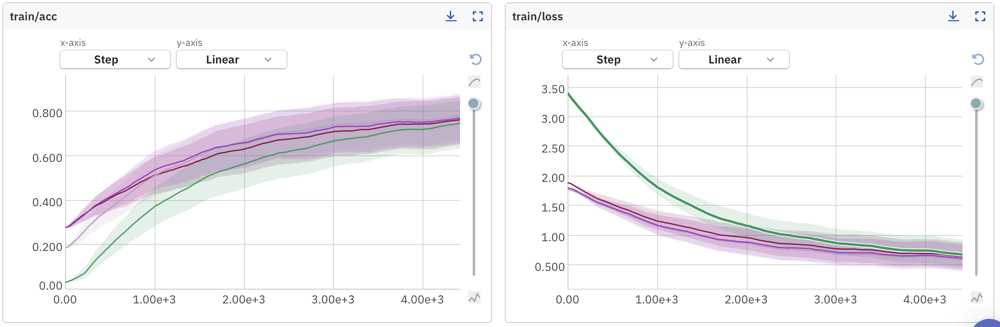

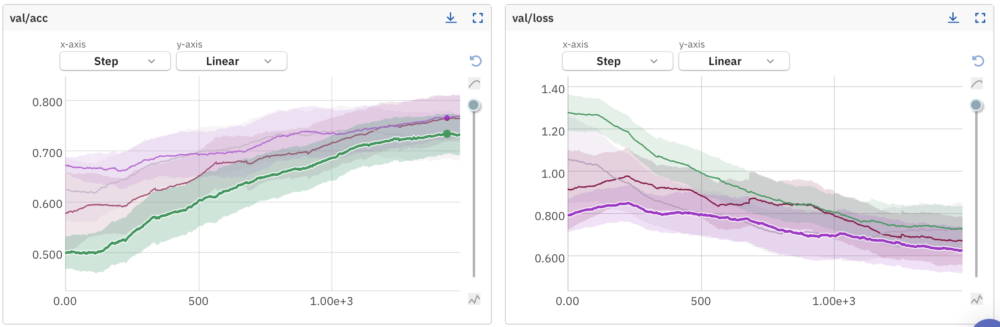

In [ ]:
trainDataloader = DataLoader(dataset_train, batch_size=32, shuffle=True)
testDataloader = DataLoader(dataset_test, batch_size=32, shuffle=True)

In [ ]:
net = BasicCNN(numLabels=6)
net = net.to(device)
criterionBasic = nn.CrossEntropyLoss()
optimizerBasic = optim.Adam(net.parameters(), lr=0.001)    #net.parameters is the wight of the NN

run = neptune.init_run(
    project="gihazshay/finalProjectML",
    api_token="eyJhcGlfYWRkcmVzcyI6Imh0dHBzOi8vYXBwLm5lcHR1bmUuYWkiLCJhcGlfdXJsIjoiaHR0cHM6Ly9hcHAubmVwdHVuZS5haSIsImFwaV9rZXkiOiI0Mjc3OWFhMi0zYWI3LTRiMjQtYjFiMC0xMGNkYWU4MjBkOTcifQ==",
)

params = {"learning_rate": 0.001, "optimizer": "Adam"}
run["parameters"] = params

trainModel = trainAug(net, trainDataloader, optimizerBasic, 13, criterionBasic)
testAcc, testLoss = test(net, testDataloader, criterionBasic)

run.stop()

[neptune] [info   ] Neptune initialized. Open in the app: https://app.neptune.ai/gihazshay/finalProjectML/e/FIN-514


Epoch 0: 100%|██████████| 453/453 [02:24<00:00,  3.14batch/s]


              precision    recall  f1-score   support

           0       0.61      0.65      0.63      2451
           1       0.44      0.25      0.32      2366
           2       0.55      0.62      0.58      2581
           3       0.51      0.59      0.55      2513
           4       0.76      0.80      0.78      2333
           5       0.49      0.50      0.49      2234

    accuracy                           0.57     14478
   macro avg       0.56      0.57      0.56     14478
weighted avg       0.56      0.57      0.56     14478



Epoch 1: 100%|██████████| 453/453 [02:24<00:00,  3.13batch/s]


              precision    recall  f1-score   support

           0       0.65      0.69      0.67      2451
           1       0.47      0.31      0.38      2366
           2       0.59      0.63      0.61      2581
           3       0.51      0.63      0.56      2513
           4       0.82      0.75      0.78      2333
           5       0.58      0.59      0.58      2234

    accuracy                           0.60     14478
   macro avg       0.60      0.60      0.60     14478
weighted avg       0.60      0.60      0.60     14478



Epoch 2: 100%|██████████| 453/453 [02:23<00:00,  3.17batch/s]


              precision    recall  f1-score   support

           0       0.75      0.77      0.76      2451
           1       0.66      0.58      0.62      2366
           2       0.68      0.65      0.66      2581
           3       0.64      0.70      0.67      2513
           4       0.89      0.88      0.89      2333
           5       0.69      0.72      0.70      2234

    accuracy                           0.72     14478
   macro avg       0.72      0.72      0.72     14478
weighted avg       0.72      0.72      0.71     14478



Epoch 3: 100%|██████████| 453/453 [02:21<00:00,  3.21batch/s]


              precision    recall  f1-score   support

           0       0.70      0.73      0.72      2451
           1       0.61      0.54      0.57      2366
           2       0.65      0.63      0.64      2581
           3       0.60      0.70      0.64      2513
           4       0.88      0.82      0.85      2333
           5       0.66      0.67      0.66      2234

    accuracy                           0.68     14478
   macro avg       0.68      0.68      0.68     14478
weighted avg       0.68      0.68      0.68     14478



Epoch 4: 100%|██████████| 453/453 [02:24<00:00,  3.13batch/s]


              precision    recall  f1-score   support

           0       0.77      0.78      0.77      2451
           1       0.71      0.65      0.68      2366
           2       0.72      0.69      0.70      2581
           3       0.69      0.73      0.71      2513
           4       0.91      0.91      0.91      2333
           5       0.72      0.74      0.73      2234

    accuracy                           0.75     14478
   macro avg       0.75      0.75      0.75     14478
weighted avg       0.75      0.75      0.75     14478



Epoch 5: 100%|██████████| 453/453 [02:24<00:00,  3.14batch/s]


              precision    recall  f1-score   support

           0       0.71      0.75      0.73      2451
           1       0.66      0.61      0.63      2366
           2       0.68      0.66      0.67      2581
           3       0.63      0.69      0.66      2513
           4       0.89      0.84      0.86      2333
           5       0.69      0.69      0.69      2234

    accuracy                           0.71     14478
   macro avg       0.71      0.71      0.71     14478
weighted avg       0.71      0.71      0.71     14478



Epoch 6: 100%|██████████| 453/453 [02:19<00:00,  3.26batch/s]


              precision    recall  f1-score   support

           0       0.78      0.80      0.79      2451
           1       0.73      0.70      0.72      2366
           2       0.73      0.71      0.72      2581
           3       0.70      0.72      0.71      2513
           4       0.91      0.91      0.91      2333
           5       0.75      0.77      0.76      2234

    accuracy                           0.77     14478
   macro avg       0.77      0.77      0.77     14478
weighted avg       0.77      0.77      0.77     14478



Epoch 7: 100%|██████████| 453/453 [02:20<00:00,  3.22batch/s]


              precision    recall  f1-score   support

           0       0.76      0.77      0.76      2451
           1       0.68      0.65      0.66      2366
           2       0.69      0.66      0.67      2581
           3       0.65      0.71      0.68      2513
           4       0.90      0.88      0.89      2333
           5       0.71      0.72      0.71      2234

    accuracy                           0.73     14478
   macro avg       0.73      0.73      0.73     14478
weighted avg       0.73      0.73      0.73     14478



Epoch 8: 100%|██████████| 453/453 [02:20<00:00,  3.21batch/s]


              precision    recall  f1-score   support

           0       0.81      0.81      0.81      2451
           1       0.75      0.75      0.75      2366
           2       0.75      0.73      0.74      2581
           3       0.73      0.74      0.73      2513
           4       0.92      0.93      0.93      2333
           5       0.77      0.79      0.78      2234

    accuracy                           0.79     14478
   macro avg       0.79      0.79      0.79     14478
weighted avg       0.79      0.79      0.79     14478



Epoch 9: 100%|██████████| 453/453 [02:24<00:00,  3.12batch/s]


              precision    recall  f1-score   support

           0       0.76      0.79      0.78      2451
           1       0.69      0.67      0.68      2366
           2       0.70      0.67      0.68      2581
           3       0.68      0.71      0.70      2513
           4       0.91      0.90      0.90      2333
           5       0.72      0.73      0.73      2234

    accuracy                           0.74     14478
   macro avg       0.75      0.74      0.74     14478
weighted avg       0.74      0.74      0.74     14478



Epoch 10: 100%|██████████| 453/453 [02:20<00:00,  3.23batch/s]


              precision    recall  f1-score   support

           0       0.82      0.83      0.82      2451
           1       0.78      0.76      0.77      2366
           2       0.77      0.74      0.75      2581
           3       0.74      0.76      0.75      2513
           4       0.94      0.94      0.94      2333
           5       0.80      0.81      0.80      2234

    accuracy                           0.81     14478
   macro avg       0.81      0.81      0.81     14478
weighted avg       0.81      0.81      0.81     14478



Epoch 11: 100%|██████████| 453/453 [02:20<00:00,  3.22batch/s]


              precision    recall  f1-score   support

           0       0.77      0.80      0.78      2451
           1       0.72      0.70      0.71      2366
           2       0.71      0.71      0.71      2581
           3       0.68      0.70      0.69      2513
           4       0.91      0.89      0.90      2333
           5       0.74      0.73      0.73      2234

    accuracy                           0.75     14478
   macro avg       0.75      0.75      0.75     14478
weighted avg       0.75      0.75      0.75     14478



Epoch 12: 100%|██████████| 453/453 [02:24<00:00,  3.14batch/s]


              precision    recall  f1-score   support

           0       0.83      0.84      0.83      2451
           1       0.77      0.78      0.78      2366
           2       0.77      0.74      0.75      2581
           3       0.75      0.76      0.75      2513
           4       0.94      0.94      0.94      2333
           5       0.81      0.81      0.81      2234

    accuracy                           0.81     14478
   macro avg       0.81      0.81      0.81     14478
weighted avg       0.81      0.81      0.81     14478



100%|██████████| 80/80 [00:17<00:00,  4.51batch/s]


              precision    recall  f1-score   support

           0       0.80      0.68      0.74       432
           1       0.69      0.74      0.71       418
           2       0.80      0.71      0.75       456
           3       0.81      0.66      0.72       444
           4       0.91      0.96      0.93       412
           5       0.63      0.86      0.73       394

    accuracy                           0.76      2556
   macro avg       0.77      0.77      0.76      2556
weighted avg       0.77      0.76      0.76      2556

[neptune] [info   ] Shutting down background jobs, please wait a moment...
[neptune] [info   ] Done!
[neptune] [info   ] Waiting for the remaining 37 operations to synchronize with Neptune. Do not kill this process.
[neptune] [info   ] All 37 operations synced, thanks for waiting!
[neptune] [info   ] Explore the metadata in the Neptune app: https://app.neptune.ai/gihazshay/finalProjectML/e/FIN-514/metadata


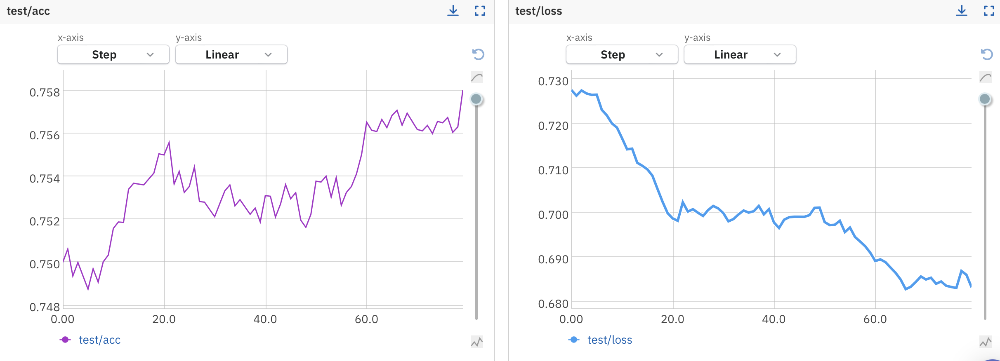

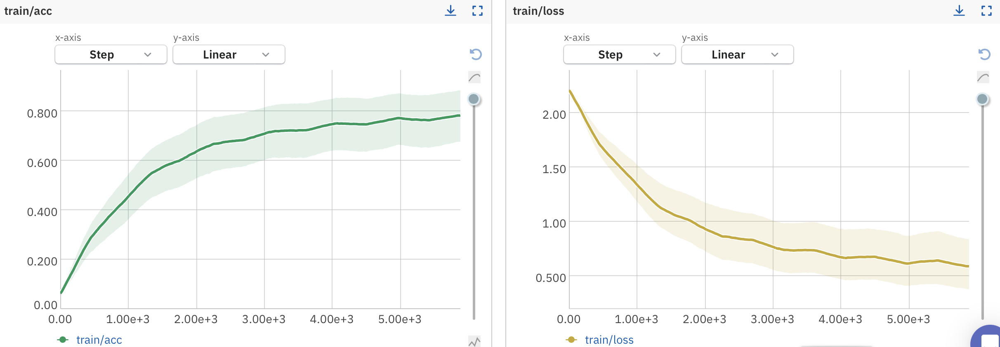

***Fisrt column: average***

***Second column: last sample***

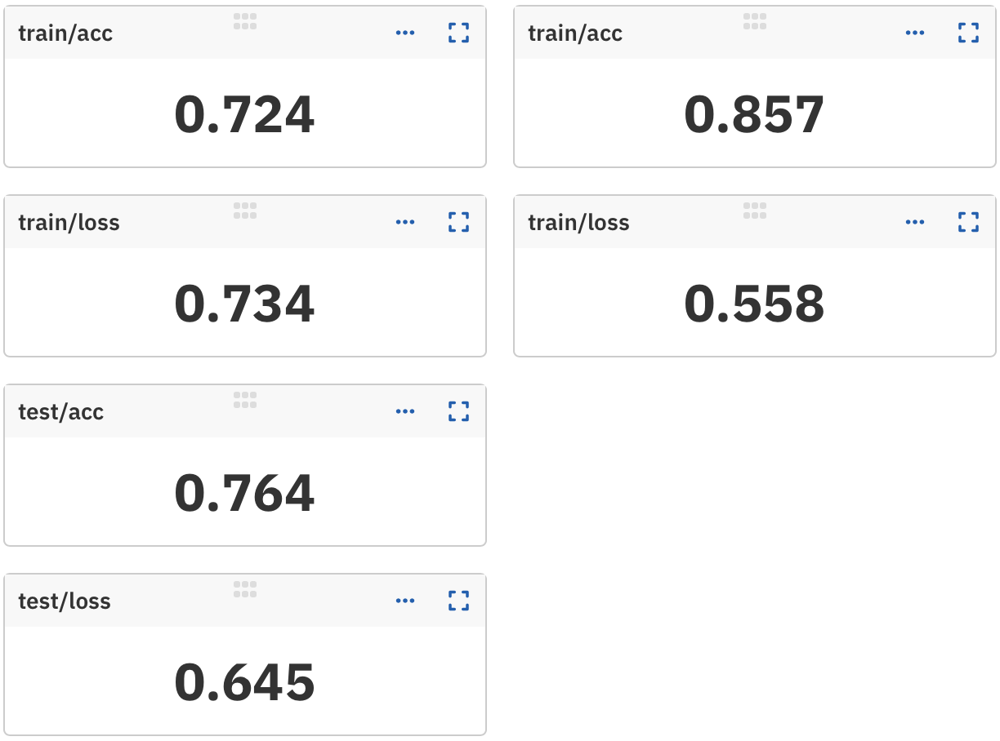

We can conclude from the validation graphs that extending the training period could improve the model's performance, which is currently suboptimal.

Therefore, we will increase the number of epochs to 21.

In [ ]:
num_folds = 4  # Change this to the desired number of folds

# Initialize the KFold object
kf = KFold(n_splits=num_folds, shuffle=True, random_state=40)


foldNum = 0
foldsMatrix = {}


for train_indices, val_indices in kf.split(idxTrain):

    train_subset = Subset(dataset_train, train_indices)
    val_subset = Subset(dataset_train, val_indices)



    # Create a DataLoader object with batch size 32
    trainDataloaderKfold = DataLoader(train_subset, batch_size=32, shuffle=True)
    valDataloaderKfold = DataLoader(val_subset, batch_size=32, shuffle=True)

    trainDataloaderKfold = trainDataloaderKfold
    valDataloaderKfold = valDataloaderKfold

    print(f"------fold------:{foldNum}")

    run = neptune.init_run(
    project="gihazshay/finalProjectML",
    api_token="eyJhcGlfYWRkcmVzcyI6Imh0dHBzOi8vYXBwLm5lcHR1bmUuYWkiLCJhcGlfdXJsIjoiaHR0cHM6Ly9hcHAubmVwdHVuZS5haSIsImFwaV9rZXkiOiI0Mjc3OWFhMi0zYWI3LTRiMjQtYjFiMC0xMGNkYWU4MjBkOTcifQ==",
    )

    params = {"learning_rate": 0.001, "optimizer": "Adam"}
    run["parameters"] = params

    net = BasicCNN(numLabels=6)
    net = net.to(device)
    criterionBasic = nn.CrossEntropyLoss()
    optimizerBasic = optim.Adam(net.parameters(), lr=0.001)    #net.parameters is the wight of the NN
    trainAcc, trainLoss, valAcc, valLoss = trainAug(net, trainDataloaderKfold, optimizerBasic, 21, criterionBasic, valDataloaderKfold)

    run.stop()
    foldsMatrix[f"fold {foldNum}"] = {'train_acc':trainAcc, 'train_loss':trainLoss,
                                      'val_acc':valAcc, 'val_loss':valLoss}
    foldNum += 1


------fold------:0


[neptune] [warning] NeptuneWarning: The following monitoring options are disabled by default in interactive sessions: 'capture_stdout', 'capture_stderr', 'capture_traceback', and 'capture_hardware_metrics'. To enable them, set each parameter to 'True' when initializing the run. The monitoring will continue until you call run.stop() or the kernel stops. Also note: Your source files can only be tracked if you pass the path(s) to the 'source_code' argument. For help, see the Neptune docs: https://docs.neptune.ai/logging/source_code/


[neptune] [info   ] Neptune initialized. Open in the app: https://app.neptune.ai/gihazshay/finalProjectML/e/FIN-519


Epoch 0: 100%|██████████| 340/340 [01:57<00:00,  2.89batch/s]


              precision    recall  f1-score   support

           0       0.59      0.60      0.60      1822
           1       0.39      0.27      0.32      1766
           2       0.52      0.52      0.52      1964
           3       0.47      0.53      0.49      1871
           4       0.70      0.79      0.74      1745
           5       0.43      0.45      0.44      1690

    accuracy                           0.53     10858
   macro avg       0.52      0.53      0.52     10858
weighted avg       0.52      0.53      0.52     10858

Validtion part------EPOCH------:0


100%|██████████| 114/114 [00:27<00:00,  4.09batch/s]


              precision    recall  f1-score   support

           0       0.67      0.75      0.71       629
           1       0.43      0.23      0.30       600
           2       0.58      0.70      0.63       617
           3       0.56      0.63      0.59       642
           4       0.90      0.80      0.85       588
           5       0.55      0.60      0.58       544

    accuracy                           0.62      3620
   macro avg       0.61      0.62      0.61      3620
weighted avg       0.61      0.62      0.61      3620



Epoch 1: 100%|██████████| 340/340 [02:02<00:00,  2.78batch/s]


              precision    recall  f1-score   support

           0       0.61      0.65      0.63      1822
           1       0.42      0.25      0.31      1766
           2       0.55      0.59      0.57      1964
           3       0.48      0.60      0.53      1871
           4       0.80      0.73      0.77      1745
           5       0.52      0.57      0.54      1690

    accuracy                           0.57     10858
   macro avg       0.57      0.57      0.56     10858
weighted avg       0.56      0.57      0.56     10858

Validtion part------EPOCH------:1


100%|██████████| 114/114 [00:26<00:00,  4.30batch/s]


              precision    recall  f1-score   support

           0       0.64      0.78      0.70       629
           1       0.49      0.26      0.34       600
           2       0.67      0.55      0.60       617
           3       0.47      0.85      0.60       642
           4       0.97      0.72      0.83       588
           5       0.68      0.50      0.58       544

    accuracy                           0.62      3620
   macro avg       0.65      0.61      0.61      3620
weighted avg       0.65      0.62      0.61      3620



Epoch 2: 100%|██████████| 340/340 [01:55<00:00,  2.93batch/s]


              precision    recall  f1-score   support

           0       0.71      0.73      0.72      1822
           1       0.50      0.39      0.44      1766
           2       0.62      0.65      0.63      1964
           3       0.59      0.65      0.62      1871
           4       0.86      0.85      0.86      1745
           5       0.65      0.68      0.66      1690

    accuracy                           0.66     10858
   macro avg       0.66      0.66      0.66     10858
weighted avg       0.65      0.66      0.65     10858

Validtion part------EPOCH------:2


100%|██████████| 114/114 [00:25<00:00,  4.40batch/s]


              precision    recall  f1-score   support

           0       0.73      0.64      0.68       629
           1       0.62      0.02      0.03       600
           2       0.66      0.60      0.63       617
           3       0.46      0.82      0.59       642
           4       0.67      0.95      0.79       588
           5       0.64      0.60      0.62       544

    accuracy                           0.61      3620
   macro avg       0.63      0.61      0.56      3620
weighted avg       0.63      0.61      0.56      3620



Epoch 3: 100%|██████████| 340/340 [01:58<00:00,  2.86batch/s]


              precision    recall  f1-score   support

           0       0.68      0.72      0.70      1822
           1       0.51      0.42      0.46      1766
           2       0.59      0.59      0.59      1964
           3       0.58      0.66      0.61      1871
           4       0.87      0.81      0.84      1745
           5       0.62      0.65      0.63      1690

    accuracy                           0.64     10858
   macro avg       0.64      0.64      0.64     10858
weighted avg       0.64      0.64      0.64     10858

Validtion part------EPOCH------:3


100%|██████████| 114/114 [00:28<00:00,  3.97batch/s]


              precision    recall  f1-score   support

           0       0.75      0.73      0.74       629
           1       0.69      0.27      0.38       600
           2       0.69      0.59      0.64       617
           3       0.54      0.83      0.66       642
           4       0.87      0.92      0.89       588
           5       0.62      0.73      0.67       544

    accuracy                           0.68      3620
   macro avg       0.69      0.68      0.66      3620
weighted avg       0.69      0.68      0.66      3620



Epoch 4: 100%|██████████| 340/340 [01:56<00:00,  2.93batch/s]


              precision    recall  f1-score   support

           0       0.76      0.77      0.76      1822
           1       0.61      0.57      0.59      1766
           2       0.65      0.63      0.64      1964
           3       0.67      0.72      0.70      1871
           4       0.90      0.91      0.91      1745
           5       0.70      0.72      0.71      1690

    accuracy                           0.72     10858
   macro avg       0.72      0.72      0.72     10858
weighted avg       0.72      0.72      0.72     10858

Validtion part------EPOCH------:4


100%|██████████| 114/114 [00:28<00:00,  3.94batch/s]


              precision    recall  f1-score   support

           0       0.73      0.79      0.76       629
           1       0.73      0.59      0.65       600
           2       0.70      0.72      0.71       617
           3       0.69      0.80      0.74       642
           4       0.95      0.84      0.89       588
           5       0.71      0.71      0.71       544

    accuracy                           0.74      3620
   macro avg       0.75      0.74      0.74      3620
weighted avg       0.75      0.74      0.74      3620



Epoch 5: 100%|██████████| 340/340 [01:59<00:00,  2.84batch/s]


              precision    recall  f1-score   support

           0       0.74      0.72      0.73      1822
           1       0.61      0.58      0.60      1766
           2       0.64      0.62      0.63      1964
           3       0.65      0.69      0.67      1871
           4       0.87      0.87      0.87      1745
           5       0.69      0.71      0.70      1690

    accuracy                           0.70     10858
   macro avg       0.70      0.70      0.70     10858
weighted avg       0.70      0.70      0.70     10858

Validtion part------EPOCH------:5


100%|██████████| 114/114 [00:30<00:00,  3.76batch/s]


              precision    recall  f1-score   support

           0       0.63      0.89      0.73       629
           1       0.81      0.47      0.59       600
           2       0.71      0.67      0.69       617
           3       0.67      0.77      0.72       642
           4       0.95      0.85      0.90       588
           5       0.63      0.65      0.64       544

    accuracy                           0.72      3620
   macro avg       0.74      0.71      0.71      3620
weighted avg       0.73      0.72      0.71      3620



Epoch 6: 100%|██████████| 340/340 [01:57<00:00,  2.90batch/s]


              precision    recall  f1-score   support

           0       0.77      0.79      0.78      1822
           1       0.70      0.68      0.69      1766
           2       0.69      0.68      0.68      1964
           3       0.71      0.72      0.71      1871
           4       0.91      0.91      0.91      1745
           5       0.74      0.74      0.74      1690

    accuracy                           0.75     10858
   macro avg       0.75      0.75      0.75     10858
weighted avg       0.75      0.75      0.75     10858

Validtion part------EPOCH------:6


100%|██████████| 114/114 [00:28<00:00,  4.06batch/s]


              precision    recall  f1-score   support

           0       0.77      0.76      0.77       629
           1       0.69      0.74      0.71       600
           2       0.82      0.54      0.65       617
           3       0.69      0.82      0.75       642
           4       0.93      0.90      0.92       588
           5       0.67      0.76      0.71       544

    accuracy                           0.75      3620
   macro avg       0.76      0.75      0.75      3620
weighted avg       0.76      0.75      0.75      3620



Epoch 7: 100%|██████████| 340/340 [01:57<00:00,  2.90batch/s]


              precision    recall  f1-score   support

           0       0.75      0.75      0.75      1822
           1       0.66      0.65      0.65      1766
           2       0.67      0.65      0.66      1964
           3       0.67      0.70      0.69      1871
           4       0.89      0.89      0.89      1745
           5       0.70      0.72      0.71      1690

    accuracy                           0.72     10858
   macro avg       0.72      0.73      0.72     10858
weighted avg       0.72      0.72      0.72     10858

Validtion part------EPOCH------:7


100%|██████████| 114/114 [00:26<00:00,  4.32batch/s]


              precision    recall  f1-score   support

           0       0.81      0.76      0.79       629
           1       0.74      0.61      0.67       600
           2       0.70      0.71      0.70       617
           3       0.68      0.81      0.74       642
           4       0.91      0.91      0.91       588
           5       0.74      0.76      0.75       544

    accuracy                           0.76      3620
   macro avg       0.76      0.76      0.76      3620
weighted avg       0.76      0.76      0.76      3620



Epoch 8: 100%|██████████| 340/340 [02:00<00:00,  2.83batch/s]


              precision    recall  f1-score   support

           0       0.80      0.81      0.81      1822
           1       0.73      0.71      0.72      1766
           2       0.72      0.70      0.71      1964
           3       0.72      0.75      0.73      1871
           4       0.93      0.93      0.93      1745
           5       0.77      0.77      0.77      1690

    accuracy                           0.78     10858
   macro avg       0.78      0.78      0.78     10858
weighted avg       0.78      0.78      0.78     10858

Validtion part------EPOCH------:8


100%|██████████| 114/114 [00:27<00:00,  4.20batch/s]


              precision    recall  f1-score   support

           0       0.85      0.67      0.75       629
           1       0.67      0.77      0.72       600
           2       0.79      0.63      0.70       617
           3       0.71      0.79      0.75       642
           4       0.88      0.95      0.92       588
           5       0.70      0.78      0.74       544

    accuracy                           0.76      3620
   macro avg       0.77      0.76      0.76      3620
weighted avg       0.77      0.76      0.76      3620



Epoch 9: 100%|██████████| 340/340 [01:59<00:00,  2.84batch/s]


              precision    recall  f1-score   support

           0       0.75      0.76      0.75      1822
           1       0.67      0.67      0.67      1766
           2       0.67      0.65      0.66      1964
           3       0.68      0.69      0.68      1871
           4       0.88      0.90      0.89      1745
           5       0.74      0.73      0.73      1690

    accuracy                           0.73     10858
   macro avg       0.73      0.73      0.73     10858
weighted avg       0.73      0.73      0.73     10858

Validtion part------EPOCH------:9


100%|██████████| 114/114 [00:27<00:00,  4.11batch/s]


              precision    recall  f1-score   support

           0       0.80      0.74      0.77       629
           1       0.77      0.51      0.61       600
           2       0.69      0.67      0.68       617
           3       0.58      0.85      0.69       642
           4       0.85      0.95      0.90       588
           5       0.80      0.67      0.73       544

    accuracy                           0.73      3620
   macro avg       0.75      0.73      0.73      3620
weighted avg       0.75      0.73      0.73      3620



Epoch 10: 100%|██████████| 340/340 [02:03<00:00,  2.75batch/s]


              precision    recall  f1-score   support

           0       0.81      0.81      0.81      1822
           1       0.76      0.73      0.74      1766
           2       0.72      0.71      0.72      1964
           3       0.73      0.75      0.74      1871
           4       0.92      0.94      0.93      1745
           5       0.77      0.77      0.77      1690

    accuracy                           0.78     10858
   macro avg       0.79      0.79      0.79     10858
weighted avg       0.78      0.78      0.78     10858

Validtion part------EPOCH------:10


100%|██████████| 114/114 [00:27<00:00,  4.08batch/s]


              precision    recall  f1-score   support

           0       0.65      0.84      0.73       629
           1       0.70      0.77      0.73       600
           2       0.78      0.53      0.63       617
           3       0.70      0.81      0.75       642
           4       0.98      0.70      0.82       588
           5       0.73      0.74      0.74       544

    accuracy                           0.73      3620
   macro avg       0.76      0.73      0.73      3620
weighted avg       0.75      0.73      0.73      3620



Epoch 11: 100%|██████████| 340/340 [01:59<00:00,  2.85batch/s]


              precision    recall  f1-score   support

           0       0.77      0.77      0.77      1822
           1       0.69      0.70      0.70      1766
           2       0.69      0.67      0.68      1964
           3       0.69      0.70      0.70      1871
           4       0.90      0.91      0.91      1745
           5       0.74      0.74      0.74      1690

    accuracy                           0.75     10858
   macro avg       0.75      0.75      0.75     10858
weighted avg       0.75      0.75      0.75     10858

Validtion part------EPOCH------:11


100%|██████████| 114/114 [00:28<00:00,  4.01batch/s]


              precision    recall  f1-score   support

           0       0.78      0.81      0.79       629
           1       0.65      0.82      0.72       600
           2       0.79      0.60      0.68       617
           3       0.77      0.71      0.74       642
           4       0.92      0.93      0.93       588
           5       0.74      0.75      0.75       544

    accuracy                           0.77      3620
   macro avg       0.78      0.77      0.77      3620
weighted avg       0.78      0.77      0.77      3620



Epoch 12: 100%|██████████| 340/340 [01:56<00:00,  2.93batch/s]


              precision    recall  f1-score   support

           0       0.81      0.84      0.83      1822
           1       0.78      0.76      0.77      1766
           2       0.75      0.73      0.74      1964
           3       0.75      0.77      0.76      1871
           4       0.93      0.93      0.93      1745
           5       0.81      0.80      0.80      1690

    accuracy                           0.80     10858
   macro avg       0.81      0.81      0.81     10858
weighted avg       0.80      0.80      0.80     10858

Validtion part------EPOCH------:12


100%|██████████| 114/114 [00:30<00:00,  3.76batch/s]


              precision    recall  f1-score   support

           0       0.86      0.66      0.75       629
           1       0.62      0.84      0.71       600
           2       0.74      0.62      0.67       617
           3       0.78      0.67      0.72       642
           4       0.92      0.94      0.93       588
           5       0.69      0.83      0.75       544

    accuracy                           0.76      3620
   macro avg       0.77      0.76      0.76      3620
weighted avg       0.77      0.76      0.75      3620



Epoch 13: 100%|██████████| 340/340 [01:58<00:00,  2.87batch/s]


              precision    recall  f1-score   support

           0       0.78      0.78      0.78      1822
           1       0.71      0.70      0.70      1766
           2       0.70      0.69      0.70      1964
           3       0.70      0.70      0.70      1871
           4       0.89      0.91      0.90      1745
           5       0.74      0.73      0.74      1690

    accuracy                           0.75     10858
   macro avg       0.75      0.75      0.75     10858
weighted avg       0.75      0.75      0.75     10858

Validtion part------EPOCH------:13


100%|██████████| 114/114 [00:26<00:00,  4.29batch/s]


              precision    recall  f1-score   support

           0       0.79      0.76      0.78       629
           1       0.75      0.72      0.73       600
           2       0.71      0.70      0.71       617
           3       0.68      0.80      0.74       642
           4       0.88      0.94      0.91       588
           5       0.81      0.66      0.73       544

    accuracy                           0.77      3620
   macro avg       0.77      0.76      0.77      3620
weighted avg       0.77      0.77      0.76      3620



Epoch 14: 100%|██████████| 340/340 [02:00<00:00,  2.81batch/s]


              precision    recall  f1-score   support

           0       0.82      0.85      0.84      1822
           1       0.78      0.77      0.78      1766
           2       0.75      0.73      0.74      1964
           3       0.74      0.76      0.75      1871
           4       0.95      0.94      0.94      1745
           5       0.81      0.80      0.81      1690

    accuracy                           0.81     10858
   macro avg       0.81      0.81      0.81     10858
weighted avg       0.81      0.81      0.81     10858

Validtion part------EPOCH------:14


100%|██████████| 114/114 [00:27<00:00,  4.09batch/s]


              precision    recall  f1-score   support

           0       0.83      0.72      0.77       629
           1       0.61      0.84      0.70       600
           2       0.74      0.61      0.67       617
           3       0.81      0.64      0.71       642
           4       0.96      0.89      0.92       588
           5       0.68      0.85      0.75       544

    accuracy                           0.75      3620
   macro avg       0.77      0.76      0.76      3620
weighted avg       0.77      0.75      0.75      3620



Epoch 15: 100%|██████████| 340/340 [01:54<00:00,  2.96batch/s]


              precision    recall  f1-score   support

           0       0.78      0.79      0.79      1822
           1       0.72      0.70      0.71      1766
           2       0.69      0.70      0.70      1964
           3       0.71      0.70      0.70      1871
           4       0.90      0.92      0.91      1745
           5       0.76      0.77      0.76      1690

    accuracy                           0.76     10858
   macro avg       0.76      0.76      0.76     10858
weighted avg       0.76      0.76      0.76     10858

Validtion part------EPOCH------:15


100%|██████████| 114/114 [00:28<00:00,  4.05batch/s]


              precision    recall  f1-score   support

           0       0.73      0.79      0.76       629
           1       0.80      0.60      0.68       600
           2       0.76      0.59      0.67       617
           3       0.59      0.88      0.70       642
           4       0.98      0.82      0.89       588
           5       0.72      0.72      0.72       544

    accuracy                           0.74      3620
   macro avg       0.76      0.73      0.74      3620
weighted avg       0.76      0.74      0.74      3620



Epoch 16: 100%|██████████| 340/340 [02:00<00:00,  2.83batch/s]


              precision    recall  f1-score   support

           0       0.83      0.86      0.84      1822
           1       0.79      0.78      0.79      1766
           2       0.76      0.74      0.75      1964
           3       0.75      0.77      0.76      1871
           4       0.94      0.94      0.94      1745
           5       0.83      0.83      0.83      1690

    accuracy                           0.82     10858
   macro avg       0.82      0.82      0.82     10858
weighted avg       0.82      0.82      0.82     10858

Validtion part------EPOCH------:16


100%|██████████| 114/114 [00:28<00:00,  4.07batch/s]


              precision    recall  f1-score   support

           0       0.74      0.83      0.79       629
           1       0.76      0.69      0.72       600
           2       0.78      0.64      0.70       617
           3       0.63      0.84      0.72       642
           4       0.98      0.86      0.92       588
           5       0.78      0.71      0.74       544

    accuracy                           0.76      3620
   macro avg       0.78      0.76      0.76      3620
weighted avg       0.78      0.76      0.76      3620



Epoch 17: 100%|██████████| 340/340 [01:59<00:00,  2.85batch/s]


              precision    recall  f1-score   support

           0       0.79      0.81      0.80      1822
           1       0.72      0.72      0.72      1766
           2       0.71      0.70      0.70      1964
           3       0.71      0.71      0.71      1871
           4       0.92      0.92      0.92      1745
           5       0.76      0.76      0.76      1690

    accuracy                           0.77     10858
   macro avg       0.77      0.77      0.77     10858
weighted avg       0.77      0.77      0.77     10858

Validtion part------EPOCH------:17


100%|██████████| 114/114 [00:29<00:00,  3.88batch/s]


              precision    recall  f1-score   support

           0       0.76      0.81      0.78       629
           1       0.75      0.68      0.72       600
           2       0.72      0.71      0.71       617
           3       0.71      0.77      0.74       642
           4       0.95      0.88      0.92       588
           5       0.74      0.76      0.75       544

    accuracy                           0.77      3620
   macro avg       0.77      0.77      0.77      3620
weighted avg       0.77      0.77      0.77      3620



Epoch 18: 100%|██████████| 340/340 [01:57<00:00,  2.88batch/s]


              precision    recall  f1-score   support

           0       0.85      0.86      0.85      1822
           1       0.80      0.79      0.80      1766
           2       0.77      0.75      0.76      1964
           3       0.77      0.77      0.77      1871
           4       0.95      0.95      0.95      1745
           5       0.84      0.83      0.83      1690

    accuracy                           0.83     10858
   macro avg       0.83      0.83      0.83     10858
weighted avg       0.83      0.83      0.83     10858

Validtion part------EPOCH------:18


100%|██████████| 114/114 [00:27<00:00,  4.17batch/s]


              precision    recall  f1-score   support

           0       0.80      0.76      0.78       629
           1       0.76      0.74      0.75       600
           2       0.70      0.74      0.72       617
           3       0.75      0.75      0.75       642
           4       0.90      0.95      0.93       588
           5       0.76      0.73      0.74       544

    accuracy                           0.78      3620
   macro avg       0.78      0.78      0.78      3620
weighted avg       0.78      0.78      0.78      3620



Epoch 19: 100%|██████████| 340/340 [02:02<00:00,  2.78batch/s]


              precision    recall  f1-score   support

           0       0.79      0.80      0.79      1822
           1       0.72      0.74      0.73      1766
           2       0.71      0.70      0.70      1964
           3       0.72      0.70      0.71      1871
           4       0.91      0.92      0.91      1745
           5       0.76      0.75      0.76      1690

    accuracy                           0.77     10858
   macro avg       0.77      0.77      0.77     10858
weighted avg       0.77      0.77      0.77     10858

Validtion part------EPOCH------:19


100%|██████████| 114/114 [00:26<00:00,  4.33batch/s]


              precision    recall  f1-score   support

           0       0.84      0.76      0.80       629
           1       0.80      0.65      0.71       600
           2       0.70      0.74      0.72       617
           3       0.70      0.79      0.74       642
           4       0.92      0.94      0.93       588
           5       0.75      0.80      0.77       544

    accuracy                           0.78      3620
   macro avg       0.78      0.78      0.78      3620
weighted avg       0.78      0.78      0.78      3620



Epoch 20: 100%|██████████| 340/340 [01:56<00:00,  2.92batch/s]


              precision    recall  f1-score   support

           0       0.84      0.86      0.85      1822
           1       0.82      0.80      0.81      1766
           2       0.77      0.76      0.76      1964
           3       0.76      0.77      0.77      1871
           4       0.95      0.95      0.95      1745
           5       0.84      0.84      0.84      1690

    accuracy                           0.83     10858
   macro avg       0.83      0.83      0.83     10858
weighted avg       0.83      0.83      0.83     10858

Validtion part------EPOCH------:20


100%|██████████| 114/114 [00:27<00:00,  4.15batch/s]


              precision    recall  f1-score   support

           0       0.80      0.70      0.75       629
           1       0.81      0.69      0.74       600
           2       0.75      0.72      0.73       617
           3       0.75      0.77      0.76       642
           4       0.93      0.91      0.92       588
           5       0.65      0.86      0.74       544

    accuracy                           0.77      3620
   macro avg       0.78      0.78      0.77      3620
weighted avg       0.78      0.77      0.77      3620

[neptune] [info   ] Shutting down background jobs, please wait a moment...
[neptune] [info   ] Done!
[neptune] [info   ] Waiting for the remaining 11 operations to synchronize with Neptune. Do not kill this process.
[neptune] [info   ] All 11 operations synced, thanks for waiting!
[neptune] [info   ] Explore the metadata in the Neptune app: https://app.neptune.ai/gihazshay/finalProjectML/e/FIN-519/metadata
------fold------:1
[neptune] [info   ] Neptune 

Epoch 0: 100%|██████████| 340/340 [01:58<00:00,  2.88batch/s]


              precision    recall  f1-score   support

           0       0.57      0.64      0.60      1850
           1       0.50      0.35      0.41      1800
           2       0.54      0.53      0.54      1924
           3       0.49      0.58      0.53      1908
           4       0.75      0.77      0.76      1732
           5       0.50      0.48      0.49      1644

    accuracy                           0.56     10858
   macro avg       0.56      0.56      0.55     10858
weighted avg       0.56      0.56      0.55     10858

Validtion part------EPOCH------:0


100%|██████████| 114/114 [00:27<00:00,  4.09batch/s]


              precision    recall  f1-score   support

           0       0.61      0.74      0.67       601
           1       0.79      0.21      0.33       566
           2       0.65      0.45      0.53       657
           3       0.43      0.88      0.58       605
           4       0.98      0.67      0.79       601
           5       0.60      0.66      0.63       590

    accuracy                           0.60      3620
   macro avg       0.68      0.60      0.59      3620
weighted avg       0.68      0.60      0.59      3620



Epoch 1: 100%|██████████| 340/340 [01:58<00:00,  2.86batch/s]


              precision    recall  f1-score   support

           0       0.63      0.70      0.66      1850
           1       0.52      0.48      0.50      1800
           2       0.57      0.53      0.55      1924
           3       0.56      0.63      0.59      1908
           4       0.84      0.76      0.80      1732
           5       0.58      0.58      0.58      1644

    accuracy                           0.61     10858
   macro avg       0.62      0.61      0.61     10858
weighted avg       0.61      0.61      0.61     10858

Validtion part------EPOCH------:1


100%|██████████| 114/114 [00:27<00:00,  4.09batch/s]


              precision    recall  f1-score   support

           0       0.64      0.78      0.70       601
           1       0.55      0.65      0.59       566
           2       0.68      0.44      0.54       657
           3       0.60      0.75      0.67       605
           4       0.92      0.78      0.85       601
           5       0.69      0.63      0.66       590

    accuracy                           0.67      3620
   macro avg       0.68      0.67      0.67      3620
weighted avg       0.68      0.67      0.67      3620



Epoch 2: 100%|██████████| 340/340 [01:56<00:00,  2.92batch/s]


              precision    recall  f1-score   support

           0       0.70      0.74      0.72      1850
           1       0.61      0.56      0.58      1800
           2       0.64      0.60      0.62      1924
           3       0.64      0.69      0.66      1908
           4       0.87      0.84      0.85      1732
           5       0.64      0.67      0.65      1644

    accuracy                           0.68     10858
   macro avg       0.68      0.68      0.68     10858
weighted avg       0.68      0.68      0.68     10858

Validtion part------EPOCH------:2


100%|██████████| 114/114 [00:26<00:00,  4.23batch/s]


              precision    recall  f1-score   support

           0       0.74      0.72      0.73       601
           1       0.57      0.69      0.63       566
           2       0.61      0.64      0.63       657
           3       0.76      0.61      0.68       605
           4       0.84      0.93      0.88       601
           5       0.73      0.63      0.68       590

    accuracy                           0.70      3620
   macro avg       0.71      0.70      0.70      3620
weighted avg       0.71      0.70      0.70      3620



Epoch 3: 100%|██████████| 340/340 [01:56<00:00,  2.93batch/s]


              precision    recall  f1-score   support

           0       0.67      0.75      0.71      1850
           1       0.59      0.58      0.59      1800
           2       0.62      0.57      0.59      1924
           3       0.63      0.65      0.64      1908
           4       0.87      0.80      0.83      1732
           5       0.62      0.65      0.64      1644

    accuracy                           0.66     10858
   macro avg       0.67      0.67      0.67     10858
weighted avg       0.67      0.66      0.66     10858

Validtion part------EPOCH------:3


100%|██████████| 114/114 [00:31<00:00,  3.65batch/s]


              precision    recall  f1-score   support

           0       0.71      0.72      0.71       601
           1       0.67      0.63      0.65       566
           2       0.62      0.69      0.65       657
           3       0.68      0.73      0.71       605
           4       0.96      0.80      0.88       601
           5       0.65      0.65      0.65       590

    accuracy                           0.71      3620
   macro avg       0.72      0.70      0.71      3620
weighted avg       0.71      0.71      0.71      3620



Epoch 4: 100%|██████████| 340/340 [01:53<00:00,  3.00batch/s]


              precision    recall  f1-score   support

           0       0.74      0.76      0.75      1850
           1       0.67      0.65      0.66      1800
           2       0.67      0.62      0.64      1924
           3       0.69      0.73      0.71      1908
           4       0.90      0.88      0.89      1732
           5       0.68      0.70      0.69      1644

    accuracy                           0.72     10858
   macro avg       0.72      0.72      0.72     10858
weighted avg       0.72      0.72      0.72     10858

Validtion part------EPOCH------:4


100%|██████████| 114/114 [00:28<00:00,  4.02batch/s]


              precision    recall  f1-score   support

           0       0.73      0.76      0.75       601
           1       0.41      0.93      0.57       566
           2       0.79      0.39      0.53       657
           3       0.84      0.42      0.56       605
           4       0.94      0.85      0.89       601
           5       0.71      0.66      0.68       590

    accuracy                           0.66      3620
   macro avg       0.74      0.67      0.66      3620
weighted avg       0.74      0.66      0.66      3620



Epoch 5: 100%|██████████| 340/340 [01:50<00:00,  3.06batch/s]


              precision    recall  f1-score   support

           0       0.71      0.76      0.73      1850
           1       0.64      0.64      0.64      1800
           2       0.66      0.63      0.64      1924
           3       0.67      0.68      0.68      1908
           4       0.88      0.84      0.86      1732
           5       0.66      0.66      0.66      1644

    accuracy                           0.70     10858
   macro avg       0.70      0.70      0.70     10858
weighted avg       0.70      0.70      0.70     10858

Validtion part------EPOCH------:5


100%|██████████| 114/114 [00:28<00:00,  4.02batch/s]


              precision    recall  f1-score   support

           0       0.78      0.69      0.73       601
           1       0.65      0.76      0.70       566
           2       0.70      0.63      0.66       657
           3       0.77      0.70      0.73       605
           4       0.91      0.89      0.90       601
           5       0.66      0.78      0.72       590

    accuracy                           0.74      3620
   macro avg       0.75      0.74      0.74      3620
weighted avg       0.75      0.74      0.74      3620



Epoch 6: 100%|██████████| 340/340 [01:56<00:00,  2.93batch/s]


              precision    recall  f1-score   support

           0       0.76      0.80      0.78      1850
           1       0.72      0.71      0.71      1800
           2       0.71      0.68      0.70      1924
           3       0.73      0.72      0.72      1908
           4       0.91      0.89      0.90      1732
           5       0.72      0.73      0.72      1644

    accuracy                           0.75     10858
   macro avg       0.76      0.76      0.76     10858
weighted avg       0.75      0.75      0.75     10858

Validtion part------EPOCH------:6


100%|██████████| 114/114 [00:28<00:00,  3.97batch/s]


              precision    recall  f1-score   support

           0       0.69      0.84      0.76       601
           1       0.64      0.80      0.71       566
           2       0.79      0.52      0.63       657
           3       0.74      0.76      0.75       605
           4       0.94      0.88      0.91       601
           5       0.71      0.69      0.70       590

    accuracy                           0.74      3620
   macro avg       0.75      0.75      0.74      3620
weighted avg       0.75      0.74      0.74      3620



Epoch 7: 100%|██████████| 340/340 [01:56<00:00,  2.91batch/s]


              precision    recall  f1-score   support

           0       0.72      0.76      0.74      1850
           1       0.66      0.68      0.67      1800
           2       0.66      0.62      0.64      1924
           3       0.69      0.69      0.69      1908
           4       0.88      0.85      0.87      1732
           5       0.68      0.68      0.68      1644

    accuracy                           0.71     10858
   macro avg       0.71      0.71      0.71     10858
weighted avg       0.71      0.71      0.71     10858

Validtion part------EPOCH------:7


100%|██████████| 114/114 [00:28<00:00,  3.97batch/s]


              precision    recall  f1-score   support

           0       0.70      0.80      0.75       601
           1       0.82      0.51      0.63       566
           2       0.72      0.60      0.65       657
           3       0.61      0.85      0.71       605
           4       0.96      0.83      0.89       601
           5       0.67      0.77      0.72       590

    accuracy                           0.73      3620
   macro avg       0.75      0.73      0.72      3620
weighted avg       0.75      0.73      0.72      3620



Epoch 8: 100%|██████████| 340/340 [01:59<00:00,  2.84batch/s]


              precision    recall  f1-score   support

           0       0.78      0.82      0.80      1850
           1       0.73      0.73      0.73      1800
           2       0.72      0.69      0.71      1924
           3       0.73      0.74      0.74      1908
           4       0.91      0.90      0.91      1732
           5       0.74      0.75      0.75      1644

    accuracy                           0.77     10858
   macro avg       0.77      0.77      0.77     10858
weighted avg       0.77      0.77      0.77     10858

Validtion part------EPOCH------:8


100%|██████████| 114/114 [00:26<00:00,  4.25batch/s]


              precision    recall  f1-score   support

           0       0.64      0.87      0.74       601
           1       0.79      0.65      0.71       566
           2       0.78      0.61      0.68       657
           3       0.67      0.82      0.73       605
           4       0.93      0.88      0.91       601
           5       0.74      0.63      0.68       590

    accuracy                           0.74      3620
   macro avg       0.76      0.74      0.74      3620
weighted avg       0.76      0.74      0.74      3620



Epoch 9: 100%|██████████| 340/340 [02:02<00:00,  2.77batch/s]


              precision    recall  f1-score   support

           0       0.73      0.78      0.75      1850
           1       0.69      0.71      0.70      1800
           2       0.69      0.65      0.67      1924
           3       0.71      0.71      0.71      1908
           4       0.90      0.86      0.88      1732
           5       0.71      0.70      0.71      1644

    accuracy                           0.73     10858
   macro avg       0.74      0.74      0.74     10858
weighted avg       0.74      0.73      0.73     10858

Validtion part------EPOCH------:9


100%|██████████| 114/114 [00:30<00:00,  3.74batch/s]


              precision    recall  f1-score   support

           0       0.81      0.67      0.73       601
           1       0.62      0.81      0.70       566
           2       0.77      0.56      0.65       657
           3       0.70      0.78      0.74       605
           4       0.96      0.88      0.92       601
           5       0.67      0.79      0.73       590

    accuracy                           0.74      3620
   macro avg       0.76      0.75      0.74      3620
weighted avg       0.76      0.74      0.74      3620



Epoch 10: 100%|██████████| 340/340 [02:06<00:00,  2.70batch/s]


              precision    recall  f1-score   support

           0       0.78      0.81      0.79      1850
           1       0.75      0.74      0.75      1800
           2       0.73      0.71      0.72      1924
           3       0.75      0.74      0.75      1908
           4       0.92      0.91      0.91      1732
           5       0.74      0.75      0.75      1644

    accuracy                           0.78     10858
   macro avg       0.78      0.78      0.78     10858
weighted avg       0.78      0.78      0.78     10858

Validtion part------EPOCH------:10


100%|██████████| 114/114 [00:27<00:00,  4.16batch/s]


              precision    recall  f1-score   support

           0       0.73      0.82      0.77       601
           1       0.63      0.84      0.72       566
           2       0.84      0.48      0.61       657
           3       0.70      0.79      0.74       605
           4       0.92      0.91      0.92       601
           5       0.73      0.66      0.69       590

    accuracy                           0.75      3620
   macro avg       0.76      0.75      0.74      3620
weighted avg       0.76      0.75      0.74      3620



Epoch 11: 100%|██████████| 340/340 [01:59<00:00,  2.85batch/s]


              precision    recall  f1-score   support

           0       0.74      0.78      0.76      1850
           1       0.70      0.71      0.70      1800
           2       0.69      0.66      0.67      1924
           3       0.72      0.72      0.72      1908
           4       0.88      0.88      0.88      1732
           5       0.72      0.70      0.71      1644

    accuracy                           0.74     10858
   macro avg       0.74      0.74      0.74     10858
weighted avg       0.74      0.74      0.74     10858

Validtion part------EPOCH------:11


100%|██████████| 114/114 [00:29<00:00,  3.93batch/s]


              precision    recall  f1-score   support

           0       0.75      0.75      0.75       601
           1       0.64      0.81      0.72       566
           2       0.76      0.62      0.68       657
           3       0.79      0.69      0.74       605
           4       0.90      0.93      0.91       601
           5       0.71      0.74      0.73       590

    accuracy                           0.75      3620
   macro avg       0.76      0.76      0.75      3620
weighted avg       0.76      0.75      0.75      3620



Epoch 12: 100%|██████████| 340/340 [01:57<00:00,  2.90batch/s]


              precision    recall  f1-score   support

           0       0.80      0.83      0.81      1850
           1       0.78      0.78      0.78      1800
           2       0.74      0.73      0.73      1924
           3       0.76      0.75      0.75      1908
           4       0.93      0.92      0.92      1732
           5       0.77      0.77      0.77      1644

    accuracy                           0.79     10858
   macro avg       0.80      0.80      0.80     10858
weighted avg       0.79      0.79      0.79     10858

Validtion part------EPOCH------:12


100%|██████████| 114/114 [00:28<00:00,  4.04batch/s]


              precision    recall  f1-score   support

           0       0.73      0.76      0.74       601
           1       0.68      0.84      0.75       566
           2       0.83      0.55      0.66       657
           3       0.78      0.72      0.75       605
           4       0.90      0.93      0.91       601
           5       0.67      0.75      0.70       590

    accuracy                           0.75      3620
   macro avg       0.76      0.76      0.75      3620
weighted avg       0.76      0.75      0.75      3620



Epoch 13: 100%|██████████| 340/340 [01:58<00:00,  2.86batch/s]


              precision    recall  f1-score   support

           0       0.75      0.79      0.77      1850
           1       0.70      0.72      0.71      1800
           2       0.69      0.66      0.67      1924
           3       0.70      0.70      0.70      1908
           4       0.89      0.88      0.89      1732
           5       0.72      0.72      0.72      1644

    accuracy                           0.74     10858
   macro avg       0.74      0.74      0.74     10858
weighted avg       0.74      0.74      0.74     10858

Validtion part------EPOCH------:13


100%|██████████| 114/114 [00:27<00:00,  4.09batch/s]


              precision    recall  f1-score   support

           0       0.71      0.83      0.76       601
           1       0.84      0.61      0.70       566
           2       0.66      0.74      0.70       657
           3       0.72      0.74      0.73       605
           4       0.90      0.93      0.91       601
           5       0.76      0.68      0.72       590

    accuracy                           0.76      3620
   macro avg       0.76      0.75      0.75      3620
weighted avg       0.76      0.76      0.75      3620



Epoch 14: 100%|██████████| 340/340 [01:57<00:00,  2.89batch/s]


              precision    recall  f1-score   support

           0       0.81      0.83      0.82      1850
           1       0.79      0.80      0.80      1800
           2       0.77      0.74      0.76      1924
           3       0.77      0.77      0.77      1908
           4       0.93      0.93      0.93      1732
           5       0.78      0.79      0.79      1644

    accuracy                           0.81     10858
   macro avg       0.81      0.81      0.81     10858
weighted avg       0.81      0.81      0.81     10858

Validtion part------EPOCH------:14


100%|██████████| 114/114 [00:28<00:00,  4.01batch/s]


              precision    recall  f1-score   support

           0       0.77      0.77      0.77       601
           1       0.67      0.83      0.74       566
           2       0.77      0.59      0.67       657
           3       0.76      0.74      0.75       605
           4       0.91      0.93      0.92       601
           5       0.72      0.76      0.74       590

    accuracy                           0.77      3620
   macro avg       0.77      0.77      0.76      3620
weighted avg       0.77      0.77      0.76      3620



Epoch 15: 100%|██████████| 340/340 [01:58<00:00,  2.88batch/s]


              precision    recall  f1-score   support

           0       0.77      0.78      0.77      1850
           1       0.72      0.75      0.74      1800
           2       0.71      0.68      0.69      1924
           3       0.72      0.71      0.72      1908
           4       0.89      0.89      0.89      1732
           5       0.73      0.73      0.73      1644

    accuracy                           0.76     10858
   macro avg       0.76      0.76      0.76     10858
weighted avg       0.76      0.76      0.76     10858

Validtion part------EPOCH------:15


100%|██████████| 114/114 [00:28<00:00,  4.06batch/s]


              precision    recall  f1-score   support

           0       0.73      0.69      0.71       601
           1       0.86      0.61      0.72       566
           2       0.71      0.72      0.71       657
           3       0.73      0.67      0.70       605
           4       0.87      0.95      0.91       601
           5       0.62      0.81      0.71       590

    accuracy                           0.74      3620
   macro avg       0.76      0.74      0.74      3620
weighted avg       0.75      0.74      0.74      3620



Epoch 16: 100%|██████████| 340/340 [01:59<00:00,  2.85batch/s]


              precision    recall  f1-score   support

           0       0.83      0.84      0.84      1850
           1       0.81      0.82      0.81      1800
           2       0.77      0.76      0.76      1924
           3       0.79      0.77      0.78      1908
           4       0.93      0.93      0.93      1732
           5       0.79      0.80      0.79      1644

    accuracy                           0.82     10858
   macro avg       0.82      0.82      0.82     10858
weighted avg       0.82      0.82      0.82     10858

Validtion part------EPOCH------:16


100%|██████████| 114/114 [00:27<00:00,  4.10batch/s]


              precision    recall  f1-score   support

           0       0.78      0.80      0.79       601
           1       0.65      0.90      0.76       566
           2       0.74      0.69      0.71       657
           3       0.78      0.72      0.75       605
           4       0.94      0.88      0.91       601
           5       0.80      0.65      0.72       590

    accuracy                           0.77      3620
   macro avg       0.78      0.77      0.77      3620
weighted avg       0.78      0.77      0.77      3620



Epoch 17: 100%|██████████| 340/340 [02:02<00:00,  2.79batch/s]


              precision    recall  f1-score   support

           0       0.78      0.80      0.79      1850
           1       0.74      0.76      0.75      1800
           2       0.71      0.70      0.70      1924
           3       0.73      0.70      0.72      1908
           4       0.90      0.90      0.90      1732
           5       0.75      0.74      0.74      1644

    accuracy                           0.77     10858
   macro avg       0.77      0.77      0.77     10858
weighted avg       0.77      0.77      0.77     10858

Validtion part------EPOCH------:17


100%|██████████| 114/114 [00:27<00:00,  4.19batch/s]


              precision    recall  f1-score   support

           0       0.74      0.81      0.77       601
           1       0.84      0.55      0.67       566
           2       0.71      0.70      0.71       657
           3       0.60      0.84      0.70       605
           4       0.90      0.93      0.91       601
           5       0.79      0.65      0.71       590

    accuracy                           0.75      3620
   macro avg       0.76      0.75      0.75      3620
weighted avg       0.76      0.75      0.75      3620



Epoch 18: 100%|██████████| 340/340 [01:57<00:00,  2.90batch/s]


              precision    recall  f1-score   support

           0       0.84      0.86      0.85      1850
           1       0.82      0.81      0.81      1800
           2       0.78      0.77      0.77      1924
           3       0.79      0.78      0.78      1908
           4       0.94      0.94      0.94      1732
           5       0.81      0.81      0.81      1644

    accuracy                           0.83     10858
   macro avg       0.83      0.83      0.83     10858
weighted avg       0.83      0.83      0.83     10858

Validtion part------EPOCH------:18


100%|██████████| 114/114 [00:27<00:00,  4.07batch/s]


              precision    recall  f1-score   support

           0       0.79      0.79      0.79       601
           1       0.55      0.92      0.69       566
           2       0.76      0.55      0.64       657
           3       0.77      0.63      0.69       605
           4       0.94      0.91      0.93       601
           5       0.79      0.70      0.75       590

    accuracy                           0.75      3620
   macro avg       0.77      0.75      0.75      3620
weighted avg       0.77      0.75      0.75      3620



Epoch 19: 100%|██████████| 340/340 [01:55<00:00,  2.94batch/s]


              precision    recall  f1-score   support

           0       0.79      0.80      0.79      1850
           1       0.74      0.75      0.74      1800
           2       0.72      0.71      0.71      1924
           3       0.73      0.71      0.72      1908
           4       0.90      0.90      0.90      1732
           5       0.75      0.75      0.75      1644

    accuracy                           0.77     10858
   macro avg       0.77      0.77      0.77     10858
weighted avg       0.77      0.77      0.77     10858

Validtion part------EPOCH------:19


100%|██████████| 114/114 [00:27<00:00,  4.13batch/s]


              precision    recall  f1-score   support

           0       0.76      0.79      0.78       601
           1       0.79      0.67      0.73       566
           2       0.71      0.76      0.73       657
           3       0.67      0.83      0.74       605
           4       0.90      0.93      0.92       601
           5       0.81      0.62      0.70       590

    accuracy                           0.77      3620
   macro avg       0.77      0.77      0.77      3620
weighted avg       0.77      0.77      0.77      3620



Epoch 20: 100%|██████████| 340/340 [01:55<00:00,  2.94batch/s]


              precision    recall  f1-score   support

           0       0.84      0.86      0.85      1850
           1       0.82      0.83      0.83      1800
           2       0.79      0.76      0.77      1924
           3       0.78      0.78      0.78      1908
           4       0.94      0.94      0.94      1732
           5       0.81      0.82      0.82      1644

    accuracy                           0.83     10858
   macro avg       0.83      0.83      0.83     10858
weighted avg       0.83      0.83      0.83     10858

Validtion part------EPOCH------:20


100%|██████████| 114/114 [00:30<00:00,  3.68batch/s]


              precision    recall  f1-score   support

           0       0.78      0.78      0.78       601
           1       0.73      0.81      0.77       566
           2       0.78      0.65      0.71       657
           3       0.70      0.82      0.76       605
           4       0.93      0.90      0.92       601
           5       0.78      0.72      0.75       590

    accuracy                           0.78      3620
   macro avg       0.79      0.78      0.78      3620
weighted avg       0.79      0.78      0.78      3620

[neptune] [info   ] Shutting down background jobs, please wait a moment...
[neptune] [info   ] Done!
[neptune] [info   ] Waiting for the remaining 41 operations to synchronize with Neptune. Do not kill this process.
[neptune] [info   ] All 41 operations synced, thanks for waiting!
[neptune] [info   ] Explore the metadata in the Neptune app: https://app.neptune.ai/gihazshay/finalProjectML/e/FIN-520/metadata
------fold------:2
[neptune] [info   ] Neptune 

Epoch 0: 100%|██████████| 340/340 [01:57<00:00,  2.89batch/s]


              precision    recall  f1-score   support

           0       0.56      0.62      0.59      1855
           1       0.47      0.23      0.31      1767
           2       0.54      0.52      0.53      1933
           3       0.46      0.55      0.50      1863
           4       0.70      0.79      0.74      1737
           5       0.48      0.54      0.51      1704

    accuracy                           0.54     10859
   macro avg       0.54      0.54      0.53     10859
weighted avg       0.53      0.54      0.53     10859

Validtion part------EPOCH------:0


100%|██████████| 114/114 [00:28<00:00,  4.02batch/s]


              precision    recall  f1-score   support

           0       0.72      0.64      0.68       596
           1       0.63      0.29      0.40       599
           2       0.59      0.68      0.63       648
           3       0.61      0.59      0.60       650
           4       0.76      0.92      0.83       596
           5       0.52      0.71      0.60       530

    accuracy                           0.64      3619
   macro avg       0.64      0.64      0.62      3619
weighted avg       0.64      0.64      0.62      3619



Epoch 1: 100%|██████████| 340/340 [02:00<00:00,  2.81batch/s]


              precision    recall  f1-score   support

           0       0.63      0.66      0.65      1855
           1       0.49      0.36      0.41      1767
           2       0.56      0.60      0.58      1933
           3       0.50      0.58      0.54      1863
           4       0.82      0.74      0.78      1737
           5       0.57      0.62      0.59      1704

    accuracy                           0.59     10859
   macro avg       0.60      0.59      0.59     10859
weighted avg       0.59      0.59      0.59     10859

Validtion part------EPOCH------:1


100%|██████████| 114/114 [00:31<00:00,  3.62batch/s]


              precision    recall  f1-score   support

           0       0.69      0.74      0.71       596
           1       0.55      0.42      0.48       599
           2       0.61      0.64      0.63       648
           3       0.52      0.72      0.61       650
           4       0.91      0.84      0.87       596
           5       0.71      0.53      0.61       530

    accuracy                           0.65      3619
   macro avg       0.67      0.65      0.65      3619
weighted avg       0.66      0.65      0.65      3619



Epoch 2: 100%|██████████| 340/340 [02:01<00:00,  2.79batch/s]


              precision    recall  f1-score   support

           0       0.73      0.75      0.74      1855
           1       0.58      0.49      0.54      1767
           2       0.63      0.65      0.64      1933
           3       0.61      0.65      0.63      1863
           4       0.89      0.86      0.88      1737
           5       0.67      0.70      0.69      1704

    accuracy                           0.68     10859
   macro avg       0.69      0.69      0.68     10859
weighted avg       0.68      0.68      0.68     10859

Validtion part------EPOCH------:2


100%|██████████| 114/114 [00:32<00:00,  3.56batch/s]


              precision    recall  f1-score   support

           0       0.66      0.86      0.75       596
           1       0.63      0.59      0.61       599
           2       0.68      0.67      0.67       648
           3       0.63      0.67      0.65       650
           4       0.92      0.88      0.90       596
           5       0.77      0.55      0.64       530

    accuracy                           0.70      3619
   macro avg       0.71      0.70      0.70      3619
weighted avg       0.71      0.70      0.70      3619



Epoch 3: 100%|██████████| 340/340 [01:58<00:00,  2.86batch/s]


              precision    recall  f1-score   support

           0       0.70      0.73      0.72      1855
           1       0.59      0.54      0.56      1767
           2       0.63      0.62      0.62      1933
           3       0.59      0.63      0.61      1863
           4       0.86      0.83      0.85      1737
           5       0.64      0.66      0.65      1704

    accuracy                           0.67     10859
   macro avg       0.67      0.67      0.67     10859
weighted avg       0.67      0.67      0.67     10859

Validtion part------EPOCH------:3


100%|██████████| 114/114 [00:31<00:00,  3.57batch/s]


              precision    recall  f1-score   support

           0       0.77      0.68      0.72       596
           1       0.80      0.36      0.49       599
           2       0.64      0.68      0.66       648
           3       0.54      0.84      0.66       650
           4       0.82      0.93      0.87       596
           5       0.74      0.64      0.69       530

    accuracy                           0.69      3619
   macro avg       0.72      0.69      0.68      3619
weighted avg       0.71      0.69      0.68      3619



Epoch 4: 100%|██████████| 340/340 [02:00<00:00,  2.83batch/s]


              precision    recall  f1-score   support

           0       0.77      0.79      0.78      1855
           1       0.64      0.63      0.63      1767
           2       0.69      0.67      0.68      1933
           3       0.68      0.70      0.69      1863
           4       0.91      0.89      0.90      1737
           5       0.72      0.74      0.73      1704

    accuracy                           0.73     10859
   macro avg       0.74      0.74      0.74     10859
weighted avg       0.73      0.73      0.73     10859

Validtion part------EPOCH------:4


100%|██████████| 114/114 [00:26<00:00,  4.23batch/s]


              precision    recall  f1-score   support

           0       0.85      0.58      0.69       596
           1       0.66      0.68      0.67       599
           2       0.68      0.71      0.70       648
           3       0.71      0.65      0.68       650
           4       0.81      0.95      0.87       596
           5       0.66      0.77      0.71       530

    accuracy                           0.72      3619
   macro avg       0.73      0.72      0.72      3619
weighted avg       0.73      0.72      0.72      3619



Epoch 5: 100%|██████████| 340/340 [02:02<00:00,  2.77batch/s]


              precision    recall  f1-score   support

           0       0.74      0.75      0.75      1855
           1       0.63      0.60      0.62      1767
           2       0.65      0.63      0.64      1933
           3       0.62      0.66      0.64      1863
           4       0.87      0.86      0.87      1737
           5       0.68      0.68      0.68      1704

    accuracy                           0.70     10859
   macro avg       0.70      0.70      0.70     10859
weighted avg       0.70      0.70      0.70     10859

Validtion part------EPOCH------:5


100%|██████████| 114/114 [00:27<00:00,  4.20batch/s]


              precision    recall  f1-score   support

           0       0.70      0.76      0.73       596
           1       0.69      0.67      0.68       599
           2       0.70      0.67      0.69       648
           3       0.72      0.63      0.67       650
           4       0.80      0.96      0.87       596
           5       0.71      0.66      0.69       530

    accuracy                           0.72      3619
   macro avg       0.72      0.72      0.72      3619
weighted avg       0.72      0.72      0.72      3619



Epoch 6: 100%|██████████| 340/340 [02:01<00:00,  2.80batch/s]


              precision    recall  f1-score   support

           0       0.79      0.79      0.79      1855
           1       0.71      0.69      0.70      1767
           2       0.74      0.71      0.72      1933
           3       0.70      0.73      0.72      1863
           4       0.91      0.92      0.91      1737
           5       0.74      0.76      0.75      1704

    accuracy                           0.76     10859
   macro avg       0.77      0.77      0.77     10859
weighted avg       0.76      0.76      0.76     10859

Validtion part------EPOCH------:6


100%|██████████| 114/114 [00:28<00:00,  4.05batch/s]


              precision    recall  f1-score   support

           0       0.76      0.78      0.77       596
           1       0.63      0.73      0.67       599
           2       0.67      0.76      0.71       648
           3       0.76      0.62      0.69       650
           4       0.94      0.90      0.92       596
           5       0.73      0.65      0.69       530

    accuracy                           0.74      3619
   macro avg       0.75      0.74      0.74      3619
weighted avg       0.75      0.74      0.74      3619



Epoch 7: 100%|██████████| 340/340 [01:59<00:00,  2.85batch/s]


              precision    recall  f1-score   support

           0       0.74      0.75      0.75      1855
           1       0.66      0.66      0.66      1767
           2       0.69      0.67      0.68      1933
           3       0.66      0.67      0.66      1863
           4       0.89      0.88      0.88      1737
           5       0.69      0.69      0.69      1704

    accuracy                           0.72     10859
   macro avg       0.72      0.72      0.72     10859
weighted avg       0.72      0.72      0.72     10859

Validtion part------EPOCH------:7


100%|██████████| 114/114 [00:26<00:00,  4.36batch/s]


              precision    recall  f1-score   support

           0       0.74      0.82      0.77       596
           1       0.76      0.56      0.65       599
           2       0.80      0.57      0.66       648
           3       0.59      0.84      0.70       650
           4       0.90      0.94      0.92       596
           5       0.72      0.70      0.71       530

    accuracy                           0.74      3619
   macro avg       0.75      0.74      0.74      3619
weighted avg       0.75      0.74      0.73      3619



Epoch 8: 100%|██████████| 340/340 [02:02<00:00,  2.78batch/s]


              precision    recall  f1-score   support

           0       0.79      0.80      0.79      1855
           1       0.74      0.72      0.73      1767
           2       0.76      0.72      0.74      1933
           3       0.71      0.75      0.73      1863
           4       0.92      0.91      0.92      1737
           5       0.75      0.76      0.76      1704

    accuracy                           0.78     10859
   macro avg       0.78      0.78      0.78     10859
weighted avg       0.78      0.78      0.78     10859

Validtion part------EPOCH------:8


100%|██████████| 114/114 [00:27<00:00,  4.20batch/s]


              precision    recall  f1-score   support

           0       0.76      0.78      0.77       596
           1       0.71      0.73      0.72       599
           2       0.70      0.75      0.72       648
           3       0.80      0.60      0.69       650
           4       0.95      0.91      0.93       596
           5       0.66      0.80      0.72       530

    accuracy                           0.76      3619
   macro avg       0.76      0.76      0.76      3619
weighted avg       0.77      0.76      0.76      3619



Epoch 9: 100%|██████████| 340/340 [02:01<00:00,  2.80batch/s]


              precision    recall  f1-score   support

           0       0.76      0.75      0.75      1855
           1       0.67      0.65      0.66      1767
           2       0.70      0.68      0.69      1933
           3       0.66      0.68      0.67      1863
           4       0.87      0.88      0.88      1737
           5       0.70      0.71      0.71      1704

    accuracy                           0.73     10859
   macro avg       0.73      0.73      0.73     10859
weighted avg       0.73      0.73      0.73     10859

Validtion part------EPOCH------:9


100%|██████████| 114/114 [00:27<00:00,  4.08batch/s]


              precision    recall  f1-score   support

           0       0.78      0.74      0.76       596
           1       0.76      0.64      0.70       599
           2       0.69      0.72      0.70       648
           3       0.66      0.79      0.72       650
           4       0.91      0.92      0.92       596
           5       0.74      0.68      0.71       530

    accuracy                           0.75      3619
   macro avg       0.76      0.75      0.75      3619
weighted avg       0.75      0.75      0.75      3619



Epoch 10: 100%|██████████| 340/340 [01:58<00:00,  2.87batch/s]


              precision    recall  f1-score   support

           0       0.81      0.82      0.82      1855
           1       0.74      0.72      0.73      1767
           2       0.77      0.75      0.76      1933
           3       0.73      0.75      0.74      1863
           4       0.93      0.93      0.93      1737
           5       0.78      0.78      0.78      1704

    accuracy                           0.79     10859
   macro avg       0.79      0.79      0.79     10859
weighted avg       0.79      0.79      0.79     10859

Validtion part------EPOCH------:10


100%|██████████| 114/114 [00:26<00:00,  4.32batch/s]


              precision    recall  f1-score   support

           0       0.79      0.70      0.74       596
           1       0.78      0.57      0.66       599
           2       0.65      0.78      0.71       648
           3       0.74      0.63      0.68       650
           4       0.86      0.95      0.90       596
           5       0.63      0.79      0.70       530

    accuracy                           0.73      3619
   macro avg       0.74      0.74      0.73      3619
weighted avg       0.74      0.73      0.73      3619



Epoch 11: 100%|██████████| 340/340 [02:01<00:00,  2.80batch/s]


              precision    recall  f1-score   support

           0       0.77      0.77      0.77      1855
           1       0.70      0.69      0.69      1767
           2       0.70      0.69      0.70      1933
           3       0.68      0.70      0.69      1863
           4       0.87      0.89      0.88      1737
           5       0.73      0.71      0.72      1704

    accuracy                           0.74     10859
   macro avg       0.74      0.74      0.74     10859
weighted avg       0.74      0.74      0.74     10859

Validtion part------EPOCH------:11


100%|██████████| 114/114 [00:28<00:00,  4.05batch/s]


              precision    recall  f1-score   support

           0       0.68      0.78      0.73       596
           1       0.66      0.77      0.71       599
           2       0.75      0.69      0.72       648
           3       0.76      0.66      0.70       650
           4       0.81      0.96      0.88       596
           5       0.78      0.54      0.64       530

    accuracy                           0.74      3619
   macro avg       0.74      0.73      0.73      3619
weighted avg       0.74      0.74      0.73      3619



Epoch 12: 100%|██████████| 340/340 [02:07<00:00,  2.68batch/s]


              precision    recall  f1-score   support

           0       0.83      0.83      0.83      1855
           1       0.77      0.76      0.76      1767
           2       0.77      0.74      0.76      1933
           3       0.73      0.76      0.74      1863
           4       0.94      0.94      0.94      1737
           5       0.78      0.79      0.79      1704

    accuracy                           0.80     10859
   macro avg       0.80      0.80      0.80     10859
weighted avg       0.80      0.80      0.80     10859

Validtion part------EPOCH------:12


100%|██████████| 114/114 [00:28<00:00,  4.04batch/s]


              precision    recall  f1-score   support

           0       0.78      0.81      0.79       596
           1       0.66      0.82      0.73       599
           2       0.76      0.70      0.73       648
           3       0.74      0.68      0.71       650
           4       0.94      0.92      0.93       596
           5       0.77      0.69      0.73       530

    accuracy                           0.77      3619
   macro avg       0.77      0.77      0.77      3619
weighted avg       0.77      0.77      0.77      3619



Epoch 13: 100%|██████████| 340/340 [02:06<00:00,  2.69batch/s]


              precision    recall  f1-score   support

           0       0.77      0.78      0.78      1855
           1       0.71      0.70      0.71      1767
           2       0.71      0.69      0.70      1933
           3       0.68      0.70      0.69      1863
           4       0.90      0.90      0.90      1737
           5       0.74      0.73      0.73      1704

    accuracy                           0.75     10859
   macro avg       0.75      0.75      0.75     10859
weighted avg       0.75      0.75      0.75     10859

Validtion part------EPOCH------:13


100%|██████████| 114/114 [00:28<00:00,  3.96batch/s]


              precision    recall  f1-score   support

           0       0.79      0.71      0.75       596
           1       0.71      0.74      0.72       599
           2       0.64      0.75      0.69       648
           3       0.77      0.65      0.71       650
           4       0.84      0.96      0.90       596
           5       0.75      0.65      0.70       530

    accuracy                           0.74      3619
   macro avg       0.75      0.74      0.74      3619
weighted avg       0.75      0.74      0.74      3619



Epoch 14: 100%|██████████| 340/340 [02:08<00:00,  2.65batch/s]


              precision    recall  f1-score   support

           0       0.83      0.83      0.83      1855
           1       0.79      0.77      0.78      1767
           2       0.79      0.76      0.78      1933
           3       0.75      0.78      0.76      1863
           4       0.94      0.94      0.94      1737
           5       0.79      0.80      0.79      1704

    accuracy                           0.81     10859
   macro avg       0.81      0.81      0.81     10859
weighted avg       0.81      0.81      0.81     10859

Validtion part------EPOCH------:14


100%|██████████| 114/114 [00:30<00:00,  3.76batch/s]


              precision    recall  f1-score   support

           0       0.79      0.79      0.79       596
           1       0.75      0.71      0.73       599
           2       0.67      0.81      0.73       648
           3       0.77      0.67      0.72       650
           4       0.92      0.94      0.93       596
           5       0.76      0.71      0.73       530

    accuracy                           0.77      3619
   macro avg       0.78      0.77      0.77      3619
weighted avg       0.78      0.77      0.77      3619



Epoch 15: 100%|██████████| 340/340 [02:00<00:00,  2.82batch/s]


              precision    recall  f1-score   support

           0       0.79      0.79      0.79      1855
           1       0.71      0.70      0.70      1767
           2       0.71      0.70      0.70      1933
           3       0.69      0.70      0.70      1863
           4       0.90      0.90      0.90      1737
           5       0.74      0.73      0.74      1704

    accuracy                           0.75     10859
   macro avg       0.75      0.75      0.75     10859
weighted avg       0.75      0.75      0.75     10859

Validtion part------EPOCH------:15


100%|██████████| 114/114 [00:29<00:00,  3.82batch/s]


              precision    recall  f1-score   support

           0       0.78      0.78      0.78       596
           1       0.73      0.78      0.76       599
           2       0.76      0.73      0.74       648
           3       0.78      0.68      0.72       650
           4       0.95      0.93      0.94       596
           5       0.70      0.79      0.74       530

    accuracy                           0.78      3619
   macro avg       0.78      0.78      0.78      3619
weighted avg       0.78      0.78      0.78      3619



Epoch 16: 100%|██████████| 340/340 [01:59<00:00,  2.83batch/s]


              precision    recall  f1-score   support

           0       0.84      0.84      0.84      1855
           1       0.80      0.79      0.80      1767
           2       0.79      0.78      0.79      1933
           3       0.76      0.77      0.76      1863
           4       0.94      0.94      0.94      1737
           5       0.81      0.82      0.81      1704

    accuracy                           0.82     10859
   macro avg       0.82      0.82      0.82     10859
weighted avg       0.82      0.82      0.82     10859

Validtion part------EPOCH------:16


100%|██████████| 114/114 [00:28<00:00,  4.02batch/s]


              precision    recall  f1-score   support

           0       0.74      0.83      0.79       596
           1       0.80      0.67      0.73       599
           2       0.70      0.78      0.73       648
           3       0.74      0.72      0.73       650
           4       0.92      0.94      0.93       596
           5       0.75      0.69      0.72       530

    accuracy                           0.77      3619
   macro avg       0.78      0.77      0.77      3619
weighted avg       0.77      0.77      0.77      3619



Epoch 17: 100%|██████████| 340/340 [01:55<00:00,  2.95batch/s]


              precision    recall  f1-score   support

           0       0.77      0.77      0.77      1855
           1       0.72      0.71      0.71      1767
           2       0.70      0.71      0.71      1933
           3       0.69      0.70      0.70      1863
           4       0.88      0.89      0.89      1737
           5       0.74      0.72      0.73      1704

    accuracy                           0.75     10859
   macro avg       0.75      0.75      0.75     10859
weighted avg       0.75      0.75      0.75     10859

Validtion part------EPOCH------:17


100%|██████████| 114/114 [00:28<00:00,  4.00batch/s]


              precision    recall  f1-score   support

           0       0.80      0.73      0.76       596
           1       0.65      0.83      0.73       599
           2       0.79      0.66      0.72       648
           3       0.71      0.72      0.71       650
           4       0.91      0.96      0.93       596
           5       0.75      0.67      0.71       530

    accuracy                           0.76      3619
   macro avg       0.77      0.76      0.76      3619
weighted avg       0.77      0.76      0.76      3619



Epoch 18: 100%|██████████| 340/340 [01:53<00:00,  2.99batch/s]


              precision    recall  f1-score   support

           0       0.84      0.85      0.84      1855
           1       0.80      0.78      0.79      1767
           2       0.80      0.77      0.78      1933
           3       0.75      0.78      0.76      1863
           4       0.95      0.95      0.95      1737
           5       0.81      0.81      0.81      1704

    accuracy                           0.82     10859
   macro avg       0.82      0.82      0.82     10859
weighted avg       0.82      0.82      0.82     10859

Validtion part------EPOCH------:18


100%|██████████| 114/114 [00:28<00:00,  3.96batch/s]


              precision    recall  f1-score   support

           0       0.78      0.79      0.78       596
           1       0.74      0.75      0.74       599
           2       0.73      0.73      0.73       648
           3       0.74      0.74      0.74       650
           4       0.91      0.95      0.93       596
           5       0.76      0.70      0.73       530

    accuracy                           0.78      3619
   macro avg       0.77      0.77      0.77      3619
weighted avg       0.77      0.78      0.77      3619



Epoch 19: 100%|██████████| 340/340 [01:51<00:00,  3.06batch/s]


              precision    recall  f1-score   support

           0       0.78      0.80      0.79      1855
           1       0.72      0.72      0.72      1767
           2       0.72      0.72      0.72      1933
           3       0.70      0.71      0.70      1863
           4       0.91      0.91      0.91      1737
           5       0.77      0.75      0.76      1704

    accuracy                           0.76     10859
   macro avg       0.77      0.77      0.77     10859
weighted avg       0.76      0.76      0.76     10859

Validtion part------EPOCH------:19


100%|██████████| 114/114 [00:29<00:00,  3.80batch/s]


              precision    recall  f1-score   support

           0       0.76      0.74      0.75       596
           1       0.86      0.65      0.74       599
           2       0.72      0.79      0.75       648
           3       0.74      0.73      0.73       650
           4       0.89      0.95      0.92       596
           5       0.69      0.78      0.73       530

    accuracy                           0.77      3619
   macro avg       0.78      0.77      0.77      3619
weighted avg       0.78      0.77      0.77      3619



Epoch 20: 100%|██████████| 340/340 [01:50<00:00,  3.07batch/s]


              precision    recall  f1-score   support

           0       0.83      0.85      0.84      1855
           1       0.81      0.80      0.81      1767
           2       0.80      0.78      0.79      1933
           3       0.78      0.79      0.79      1863
           4       0.93      0.94      0.94      1737
           5       0.82      0.81      0.82      1704

    accuracy                           0.83     10859
   macro avg       0.83      0.83      0.83     10859
weighted avg       0.83      0.83      0.83     10859

Validtion part------EPOCH------:20


100%|██████████| 114/114 [00:27<00:00,  4.18batch/s]


              precision    recall  f1-score   support

           0       0.84      0.65      0.73       596
           1       0.71      0.81      0.76       599
           2       0.80      0.72      0.76       648
           3       0.77      0.69      0.73       650
           4       0.87      0.96      0.91       596
           5       0.67      0.83      0.74       530

    accuracy                           0.77      3619
   macro avg       0.78      0.78      0.77      3619
weighted avg       0.78      0.77      0.77      3619

[neptune] [info   ] Shutting down background jobs, please wait a moment...
[neptune] [info   ] Done!
[neptune] [info   ] Waiting for the remaining 13 operations to synchronize with Neptune. Do not kill this process.
[neptune] [info   ] All 13 operations synced, thanks for waiting!
[neptune] [info   ] Explore the metadata in the Neptune app: https://app.neptune.ai/gihazshay/finalProjectML/e/FIN-521/metadata
------fold------:3
[neptune] [info   ] Neptune 

Epoch 0: 100%|██████████| 340/340 [01:54<00:00,  2.97batch/s]


              precision    recall  f1-score   support

           0       0.45      0.55      0.50      1826
           1       0.44      0.27      0.34      1765
           2       0.47      0.41      0.44      1922
           3       0.43      0.49      0.46      1897
           4       0.63      0.64      0.64      1785
           5       0.40      0.45      0.42      1664

    accuracy                           0.47     10859
   macro avg       0.47      0.47      0.46     10859
weighted avg       0.47      0.47      0.47     10859

Validtion part------EPOCH------:0


100%|██████████| 114/114 [00:25<00:00,  4.47batch/s]


              precision    recall  f1-score   support

           0       0.75      0.69      0.72       625
           1       0.53      0.36      0.43       601
           2       0.43      0.75      0.55       659
           3       0.64      0.54      0.59       616
           4       0.80      0.87      0.83       548
           5       0.73      0.49      0.59       570

    accuracy                           0.62      3619
   macro avg       0.65      0.62      0.62      3619
weighted avg       0.64      0.62      0.61      3619



Epoch 1: 100%|██████████| 340/340 [01:53<00:00,  2.99batch/s]


              precision    recall  f1-score   support

           0       0.63      0.65      0.64      1826
           1       0.50      0.36      0.42      1765
           2       0.55      0.58      0.56      1922
           3       0.52      0.63      0.57      1897
           4       0.82      0.77      0.80      1785
           5       0.58      0.59      0.59      1664

    accuracy                           0.60     10859
   macro avg       0.60      0.60      0.60     10859
weighted avg       0.60      0.60      0.60     10859

Validtion part------EPOCH------:1


100%|██████████| 114/114 [00:26<00:00,  4.27batch/s]


              precision    recall  f1-score   support

           0       0.78      0.71      0.74       625
           1       0.59      0.33      0.42       601
           2       0.55      0.70      0.61       659
           3       0.58      0.75      0.66       616
           4       0.86      0.91      0.88       548
           5       0.74      0.63      0.68       570

    accuracy                           0.67      3619
   macro avg       0.68      0.67      0.67      3619
weighted avg       0.68      0.67      0.66      3619



Epoch 2: 100%|██████████| 340/340 [01:47<00:00,  3.15batch/s]


              precision    recall  f1-score   support

           0       0.72      0.73      0.73      1826
           1       0.59      0.47      0.52      1765
           2       0.61      0.63      0.62      1922
           3       0.65      0.72      0.68      1897
           4       0.89      0.89      0.89      1785
           5       0.68      0.69      0.68      1664

    accuracy                           0.69     10859
   macro avg       0.69      0.69      0.69     10859
weighted avg       0.69      0.69      0.69     10859

Validtion part------EPOCH------:2


100%|██████████| 114/114 [00:30<00:00,  3.77batch/s]


              precision    recall  f1-score   support

           0       0.68      0.79      0.73       625
           1       0.69      0.48      0.57       601
           2       0.64      0.65      0.64       659
           3       0.67      0.74      0.70       616
           4       0.80      0.96      0.87       548
           5       0.75      0.62      0.68       570

    accuracy                           0.70      3619
   macro avg       0.70      0.71      0.70      3619
weighted avg       0.70      0.70      0.70      3619



Epoch 3: 100%|██████████| 340/340 [01:41<00:00,  3.33batch/s]


              precision    recall  f1-score   support

           0       0.70      0.70      0.70      1826
           1       0.55      0.49      0.52      1765
           2       0.60      0.61      0.61      1922
           3       0.62      0.69      0.65      1897
           4       0.88      0.86      0.87      1785
           5       0.67      0.68      0.67      1664

    accuracy                           0.67     10859
   macro avg       0.67      0.67      0.67     10859
weighted avg       0.67      0.67      0.67     10859

Validtion part------EPOCH------:3


100%|██████████| 114/114 [00:26<00:00,  4.29batch/s]


              precision    recall  f1-score   support

           0       0.70      0.81      0.75       625
           1       0.64      0.62      0.63       601
           2       0.66      0.61      0.64       659
           3       0.69      0.70      0.70       616
           4       0.79      0.98      0.88       548
           5       0.84      0.61      0.71       570

    accuracy                           0.72      3619
   macro avg       0.72      0.72      0.72      3619
weighted avg       0.72      0.72      0.71      3619



Epoch 4: 100%|██████████| 340/340 [01:47<00:00,  3.16batch/s]


              precision    recall  f1-score   support

           0       0.75      0.76      0.76      1826
           1       0.65      0.60      0.62      1765
           2       0.66      0.65      0.66      1922
           3       0.70      0.76      0.73      1897
           4       0.93      0.91      0.92      1785
           5       0.72      0.72      0.72      1664

    accuracy                           0.73     10859
   macro avg       0.73      0.73      0.73     10859
weighted avg       0.73      0.73      0.73     10859

Validtion part------EPOCH------:4


100%|██████████| 114/114 [00:28<00:00,  3.98batch/s]


              precision    recall  f1-score   support

           0       0.85      0.70      0.77       625
           1       0.77      0.45      0.57       601
           2       0.59      0.74      0.66       659
           3       0.66      0.79      0.72       616
           4       0.86      0.95      0.90       548
           5       0.76      0.78      0.77       570

    accuracy                           0.73      3619
   macro avg       0.75      0.74      0.73      3619
weighted avg       0.74      0.73      0.73      3619



Epoch 5: 100%|██████████| 340/340 [01:46<00:00,  3.18batch/s]


              precision    recall  f1-score   support

           0       0.72      0.73      0.73      1826
           1       0.63      0.56      0.60      1765
           2       0.63      0.64      0.63      1922
           3       0.65      0.72      0.68      1897
           4       0.89      0.87      0.88      1785
           5       0.69      0.70      0.69      1664

    accuracy                           0.70     10859
   macro avg       0.70      0.70      0.70     10859
weighted avg       0.70      0.70      0.70     10859

Validtion part------EPOCH------:5


100%|██████████| 114/114 [00:26<00:00,  4.38batch/s]


              precision    recall  f1-score   support

           0       0.76      0.75      0.75       625
           1       0.66      0.71      0.69       601
           2       0.69      0.64      0.67       659
           3       0.72      0.72      0.72       616
           4       0.77      0.98      0.86       548
           5       0.85      0.65      0.74       570

    accuracy                           0.74      3619
   macro avg       0.74      0.74      0.74      3619
weighted avg       0.74      0.74      0.73      3619



Epoch 6: 100%|██████████| 340/340 [01:44<00:00,  3.25batch/s]


              precision    recall  f1-score   support

           0       0.78      0.79      0.78      1826
           1       0.69      0.66      0.67      1765
           2       0.69      0.67      0.68      1922
           3       0.71      0.76      0.73      1897
           4       0.93      0.92      0.93      1785
           5       0.75      0.75      0.75      1664

    accuracy                           0.76     10859
   macro avg       0.76      0.76      0.76     10859
weighted avg       0.76      0.76      0.76     10859

Validtion part------EPOCH------:6


100%|██████████| 114/114 [00:27<00:00,  4.19batch/s]


              precision    recall  f1-score   support

           0       0.79      0.84      0.82       625
           1       0.65      0.73      0.69       601
           2       0.65      0.70      0.67       659
           3       0.80      0.60      0.68       616
           4       0.91      0.95      0.93       548
           5       0.80      0.76      0.78       570

    accuracy                           0.76      3619
   macro avg       0.77      0.76      0.76      3619
weighted avg       0.76      0.76      0.76      3619



Epoch 7: 100%|██████████| 340/340 [01:44<00:00,  3.27batch/s]


              precision    recall  f1-score   support

           0       0.75      0.76      0.75      1826
           1       0.65      0.63      0.64      1765
           2       0.64      0.63      0.63      1922
           3       0.67      0.70      0.69      1897
           4       0.91      0.88      0.90      1785
           5       0.71      0.71      0.71      1664

    accuracy                           0.72     10859
   macro avg       0.72      0.72      0.72     10859
weighted avg       0.72      0.72      0.72     10859

Validtion part------EPOCH------:7


100%|██████████| 114/114 [00:27<00:00,  4.20batch/s]


              precision    recall  f1-score   support

           0       0.82      0.69      0.75       625
           1       0.76      0.41      0.53       601
           2       0.62      0.66      0.64       659
           3       0.51      0.86      0.64       616
           4       0.87      0.94      0.91       548
           5       0.83      0.63      0.72       570

    accuracy                           0.70      3619
   macro avg       0.74      0.70      0.70      3619
weighted avg       0.73      0.70      0.69      3619



Epoch 8: 100%|██████████| 340/340 [01:43<00:00,  3.28batch/s]


              precision    recall  f1-score   support

           0       0.80      0.81      0.80      1826
           1       0.73      0.69      0.71      1765
           2       0.70      0.69      0.70      1922
           3       0.71      0.76      0.74      1897
           4       0.94      0.93      0.93      1785
           5       0.76      0.77      0.77      1664

    accuracy                           0.77     10859
   macro avg       0.78      0.77      0.77     10859
weighted avg       0.77      0.77      0.77     10859

Validtion part------EPOCH------:8


100%|██████████| 114/114 [00:29<00:00,  3.92batch/s]


              precision    recall  f1-score   support

           0       0.66      0.92      0.77       625
           1       0.72      0.75      0.73       601
           2       0.75      0.65      0.70       659
           3       0.74      0.72      0.73       616
           4       0.97      0.81      0.88       548
           5       0.78      0.70      0.74       570

    accuracy                           0.76      3619
   macro avg       0.77      0.76      0.76      3619
weighted avg       0.77      0.76      0.76      3619



Epoch 9: 100%|██████████| 340/340 [01:42<00:00,  3.31batch/s]


              precision    recall  f1-score   support

           0       0.75      0.78      0.76      1826
           1       0.67      0.65      0.66      1765
           2       0.67      0.66      0.66      1922
           3       0.68      0.71      0.70      1897
           4       0.91      0.88      0.90      1785
           5       0.73      0.72      0.72      1664

    accuracy                           0.73     10859
   macro avg       0.73      0.73      0.73     10859
weighted avg       0.73      0.73      0.73     10859

Validtion part------EPOCH------:9


100%|██████████| 114/114 [00:27<00:00,  4.14batch/s]


              precision    recall  f1-score   support

           0       0.88      0.75      0.81       625
           1       0.71      0.69      0.70       601
           2       0.72      0.68      0.70       659
           3       0.68      0.75      0.71       616
           4       0.91      0.96      0.93       548
           5       0.78      0.83      0.80       570

    accuracy                           0.77      3619
   macro avg       0.78      0.78      0.78      3619
weighted avg       0.77      0.77      0.77      3619



Epoch 10: 100%|██████████| 340/340 [01:47<00:00,  3.18batch/s]


              precision    recall  f1-score   support

           0       0.81      0.81      0.81      1826
           1       0.75      0.72      0.73      1765
           2       0.71      0.70      0.71      1922
           3       0.73      0.77      0.75      1897
           4       0.94      0.93      0.94      1785
           5       0.77      0.78      0.77      1664

    accuracy                           0.78     10859
   macro avg       0.78      0.78      0.78     10859
weighted avg       0.78      0.78      0.78     10859

Validtion part------EPOCH------:10


100%|██████████| 114/114 [00:25<00:00,  4.52batch/s]


              precision    recall  f1-score   support

           0       0.77      0.85      0.81       625
           1       0.78      0.63      0.70       601
           2       0.73      0.65      0.69       659
           3       0.59      0.86      0.70       616
           4       0.96      0.87      0.91       548
           5       0.84      0.68      0.75       570

    accuracy                           0.75      3619
   macro avg       0.78      0.76      0.76      3619
weighted avg       0.77      0.75      0.76      3619



Epoch 11: 100%|██████████| 340/340 [01:47<00:00,  3.15batch/s]


              precision    recall  f1-score   support

           0       0.76      0.78      0.77      1826
           1       0.70      0.67      0.69      1765
           2       0.69      0.67      0.68      1922
           3       0.67      0.71      0.69      1897
           4       0.91      0.89      0.90      1785
           5       0.73      0.74      0.74      1664

    accuracy                           0.74     10859
   macro avg       0.75      0.74      0.74     10859
weighted avg       0.74      0.74      0.74     10859

Validtion part------EPOCH------:11


100%|██████████| 114/114 [00:28<00:00,  4.06batch/s]


              precision    recall  f1-score   support

           0       0.80      0.83      0.82       625
           1       0.79      0.71      0.74       601
           2       0.73      0.71      0.72       659
           3       0.72      0.76      0.74       616
           4       0.91      0.95      0.93       548
           5       0.81      0.79      0.80       570

    accuracy                           0.79      3619
   macro avg       0.79      0.79      0.79      3619
weighted avg       0.79      0.79      0.79      3619



Epoch 12: 100%|██████████| 340/340 [01:45<00:00,  3.22batch/s]


              precision    recall  f1-score   support

           0       0.82      0.83      0.83      1826
           1       0.77      0.74      0.75      1765
           2       0.74      0.73      0.74      1922
           3       0.75      0.78      0.76      1897
           4       0.95      0.94      0.94      1785
           5       0.79      0.79      0.79      1664

    accuracy                           0.80     10859
   macro avg       0.80      0.80      0.80     10859
weighted avg       0.80      0.80      0.80     10859

Validtion part------EPOCH------:12


100%|██████████| 114/114 [00:28<00:00,  4.06batch/s]


              precision    recall  f1-score   support

           0       0.74      0.87      0.80       625
           1       0.75      0.75      0.75       601
           2       0.77      0.66      0.71       659
           3       0.71      0.80      0.75       616
           4       0.88      0.96      0.92       548
           5       0.85      0.64      0.73       570

    accuracy                           0.78      3619
   macro avg       0.78      0.78      0.78      3619
weighted avg       0.78      0.78      0.77      3619



Epoch 13: 100%|██████████| 340/340 [01:43<00:00,  3.28batch/s]


              precision    recall  f1-score   support

           0       0.78      0.78      0.78      1826
           1       0.71      0.69      0.70      1765
           2       0.69      0.66      0.68      1922
           3       0.70      0.73      0.71      1897
           4       0.91      0.91      0.91      1785
           5       0.76      0.77      0.76      1664

    accuracy                           0.76     10859
   macro avg       0.76      0.76      0.76     10859
weighted avg       0.76      0.76      0.76     10859

Validtion part------EPOCH------:13


100%|██████████| 114/114 [00:27<00:00,  4.09batch/s]


              precision    recall  f1-score   support

           0       0.83      0.82      0.82       625
           1       0.67      0.84      0.75       601
           2       0.77      0.68      0.72       659
           3       0.76      0.70      0.73       616
           4       0.92      0.94      0.93       548
           5       0.80      0.77      0.79       570

    accuracy                           0.79      3619
   macro avg       0.79      0.79      0.79      3619
weighted avg       0.79      0.79      0.79      3619



Epoch 14: 100%|██████████| 340/340 [01:46<00:00,  3.20batch/s]


              precision    recall  f1-score   support

           0       0.83      0.83      0.83      1826
           1       0.77      0.76      0.77      1765
           2       0.75      0.73      0.74      1922
           3       0.75      0.78      0.77      1897
           4       0.94      0.93      0.94      1785
           5       0.80      0.81      0.80      1664

    accuracy                           0.81     10859
   macro avg       0.81      0.81      0.81     10859
weighted avg       0.81      0.81      0.81     10859

Validtion part------EPOCH------:14


100%|██████████| 114/114 [00:27<00:00,  4.21batch/s]


              precision    recall  f1-score   support

           0       0.79      0.80      0.80       625
           1       0.78      0.75      0.76       601
           2       0.73      0.71      0.72       659
           3       0.77      0.70      0.73       616
           4       0.82      0.97      0.89       548
           5       0.78      0.76      0.77       570

    accuracy                           0.78      3619
   macro avg       0.78      0.78      0.78      3619
weighted avg       0.78      0.78      0.78      3619



Epoch 15: 100%|██████████| 340/340 [01:46<00:00,  3.18batch/s]


              precision    recall  f1-score   support

           0       0.79      0.81      0.80      1826
           1       0.72      0.71      0.71      1765
           2       0.70      0.69      0.70      1922
           3       0.70      0.73      0.72      1897
           4       0.92      0.90      0.91      1785
           5       0.75      0.74      0.74      1664

    accuracy                           0.76     10859
   macro avg       0.76      0.76      0.76     10859
weighted avg       0.76      0.76      0.76     10859

Validtion part------EPOCH------:15


100%|██████████| 114/114 [00:27<00:00,  4.18batch/s]


              precision    recall  f1-score   support

           0       0.83      0.82      0.83       625
           1       0.72      0.83      0.77       601
           2       0.76      0.68      0.72       659
           3       0.78      0.68      0.72       616
           4       0.88      0.97      0.92       548
           5       0.78      0.79      0.78       570

    accuracy                           0.79      3619
   macro avg       0.79      0.79      0.79      3619
weighted avg       0.79      0.79      0.79      3619



Epoch 16: 100%|██████████| 340/340 [01:43<00:00,  3.28batch/s]


              precision    recall  f1-score   support

           0       0.84      0.86      0.85      1826
           1       0.79      0.79      0.79      1765
           2       0.76      0.74      0.75      1922
           3       0.76      0.78      0.77      1897
           4       0.96      0.94      0.95      1785
           5       0.82      0.82      0.82      1664

    accuracy                           0.82     10859
   macro avg       0.82      0.82      0.82     10859
weighted avg       0.82      0.82      0.82     10859

Validtion part------EPOCH------:16


100%|██████████| 114/114 [00:29<00:00,  3.89batch/s]


              precision    recall  f1-score   support

           0       0.76      0.88      0.82       625
           1       0.81      0.71      0.76       601
           2       0.70      0.75      0.72       659
           3       0.73      0.77      0.75       616
           4       0.90      0.95      0.93       548
           5       0.87      0.65      0.75       570

    accuracy                           0.79      3619
   macro avg       0.79      0.79      0.79      3619
weighted avg       0.79      0.79      0.78      3619



Epoch 17: 100%|██████████| 340/340 [01:45<00:00,  3.21batch/s]


              precision    recall  f1-score   support

           0       0.78      0.80      0.79      1826
           1       0.71      0.72      0.71      1765
           2       0.69      0.68      0.68      1922
           3       0.71      0.72      0.72      1897
           4       0.92      0.91      0.92      1785
           5       0.76      0.76      0.76      1664

    accuracy                           0.76     10859
   macro avg       0.76      0.76      0.76     10859
weighted avg       0.76      0.76      0.76     10859

Validtion part------EPOCH------:17


100%|██████████| 114/114 [00:28<00:00,  4.01batch/s]


              precision    recall  f1-score   support

           0       0.78      0.85      0.82       625
           1       0.78      0.76      0.77       601
           2       0.78      0.66      0.71       659
           3       0.70      0.78      0.74       616
           4       0.93      0.93      0.93       548
           5       0.78      0.77      0.78       570

    accuracy                           0.79      3619
   macro avg       0.79      0.79      0.79      3619
weighted avg       0.79      0.79      0.79      3619



Epoch 18: 100%|██████████| 340/340 [01:50<00:00,  3.08batch/s]


              precision    recall  f1-score   support

           0       0.85      0.87      0.86      1826
           1       0.80      0.79      0.79      1765
           2       0.76      0.75      0.76      1922
           3       0.77      0.79      0.78      1897
           4       0.95      0.95      0.95      1785
           5       0.83      0.81      0.82      1664

    accuracy                           0.82     10859
   macro avg       0.83      0.83      0.83     10859
weighted avg       0.82      0.82      0.82     10859

Validtion part------EPOCH------:18


100%|██████████| 114/114 [00:26<00:00,  4.23batch/s]


              precision    recall  f1-score   support

           0       0.85      0.74      0.80       625
           1       0.71      0.81      0.76       601
           2       0.77      0.65      0.71       659
           3       0.76      0.72      0.74       616
           4       0.94      0.91      0.93       548
           5       0.69      0.87      0.77       570

    accuracy                           0.78      3619
   macro avg       0.79      0.78      0.78      3619
weighted avg       0.79      0.78      0.78      3619



Epoch 19: 100%|██████████| 340/340 [01:50<00:00,  3.07batch/s]


              precision    recall  f1-score   support

           0       0.78      0.81      0.79      1826
           1       0.74      0.73      0.73      1765
           2       0.72      0.72      0.72      1922
           3       0.73      0.73      0.73      1897
           4       0.92      0.91      0.92      1785
           5       0.76      0.75      0.75      1664

    accuracy                           0.77     10859
   macro avg       0.78      0.78      0.78     10859
weighted avg       0.77      0.77      0.77     10859

Validtion part------EPOCH------:19


100%|██████████| 114/114 [00:26<00:00,  4.30batch/s]


              precision    recall  f1-score   support

           0       0.78      0.84      0.81       625
           1       0.83      0.60      0.69       601
           2       0.71      0.69      0.70       659
           3       0.64      0.84      0.73       616
           4       0.85      0.96      0.90       548
           5       0.85      0.67      0.75       570

    accuracy                           0.76      3619
   macro avg       0.78      0.77      0.76      3619
weighted avg       0.77      0.76      0.76      3619



Epoch 20: 100%|██████████| 340/340 [01:47<00:00,  3.16batch/s]


              precision    recall  f1-score   support

           0       0.85      0.88      0.86      1826
           1       0.80      0.80      0.80      1765
           2       0.77      0.76      0.76      1922
           3       0.77      0.79      0.78      1897
           4       0.95      0.94      0.95      1785
           5       0.84      0.83      0.84      1664

    accuracy                           0.83     10859
   macro avg       0.83      0.83      0.83     10859
weighted avg       0.83      0.83      0.83     10859

Validtion part------EPOCH------:20


100%|██████████| 114/114 [00:27<00:00,  4.07batch/s]


              precision    recall  f1-score   support

           0       0.79      0.81      0.80       625
           1       0.74      0.82      0.78       601
           2       0.78      0.68      0.72       659
           3       0.75      0.73      0.74       616
           4       0.95      0.88      0.91       548
           5       0.73      0.81      0.77       570

    accuracy                           0.78      3619
   macro avg       0.79      0.79      0.79      3619
weighted avg       0.79      0.78      0.78      3619

[neptune] [info   ] Shutting down background jobs, please wait a moment...
[neptune] [info   ] Done!
[neptune] [info   ] Waiting for the remaining 29 operations to synchronize with Neptune. Do not kill this process.
[neptune] [info   ] All 29 operations synced, thanks for waiting!
[neptune] [info   ] Explore the metadata in the Neptune app: https://app.neptune.ai/gihazshay/finalProjectML/e/FIN-522/metadata


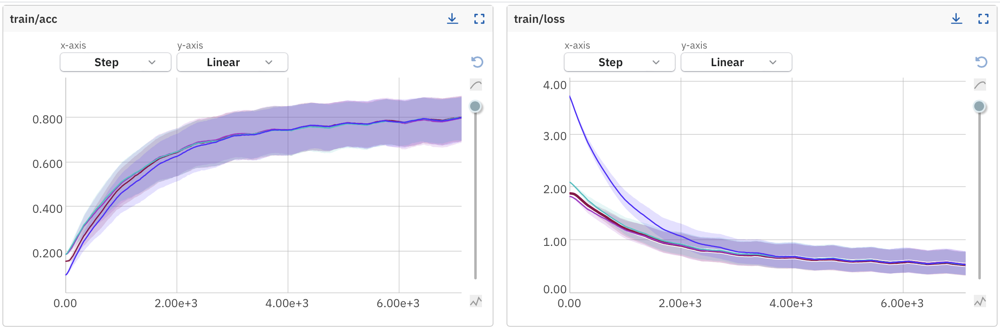

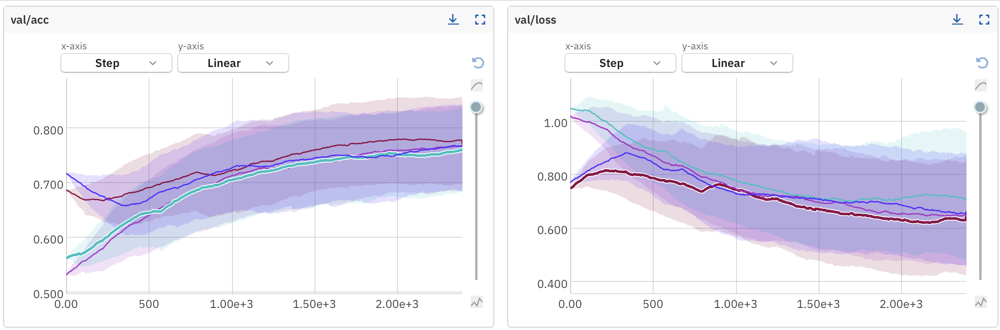

In [ ]:
net = BasicCNN(numLabels=6)
net = net.to(device)
criterionBasic = nn.CrossEntropyLoss()
optimizerBasic = optim.Adam(net.parameters(), lr=0.001)    #net.parameters is the wight of the NN

run = neptune.init_run(
    project="gihazshay/finalProjectML",
    api_token="eyJhcGlfYWRkcmVzcyI6Imh0dHBzOi8vYXBwLm5lcHR1bmUuYWkiLCJhcGlfdXJsIjoiaHR0cHM6Ly9hcHAubmVwdHVuZS5haSIsImFwaV9rZXkiOiI0Mjc3OWFhMi0zYWI3LTRiMjQtYjFiMC0xMGNkYWU4MjBkOTcifQ==",
)

params = {"learning_rate": 0.001, "optimizer": "Adam"}
run["parameters"] = params

trainModel = trainAug(net, trainDataloader, optimizerBasic, 21, criterionBasic)
testAcc, testLoss = test(net, testDataloader, criterionBasic)

run.stop()

[neptune] [info   ] Neptune initialized. Open in the app: https://app.neptune.ai/gihazshay/finalProjectML/e/FIN-523


Epoch 0: 100%|██████████| 453/453 [02:50<00:00,  2.66batch/s]


              precision    recall  f1-score   support

           0       0.58      0.65      0.62      2451
           1       0.48      0.31      0.37      2366
           2       0.55      0.58      0.57      2581
           3       0.53      0.62      0.58      2513
           4       0.77      0.77      0.77      2333
           5       0.55      0.55      0.55      2234

    accuracy                           0.58     14478
   macro avg       0.58      0.58      0.57     14478
weighted avg       0.58      0.58      0.57     14478



Epoch 1: 100%|██████████| 453/453 [02:38<00:00,  2.85batch/s]


              precision    recall  f1-score   support

           0       0.66      0.67      0.67      2451
           1       0.49      0.42      0.45      2366
           2       0.58      0.58      0.58      2581
           3       0.56      0.66      0.61      2513
           4       0.80      0.77      0.78      2333
           5       0.63      0.61      0.62      2234

    accuracy                           0.62     14478
   macro avg       0.62      0.62      0.62     14478
weighted avg       0.62      0.62      0.62     14478



Epoch 2: 100%|██████████| 453/453 [02:25<00:00,  3.11batch/s]


              precision    recall  f1-score   support

           0       0.73      0.75      0.74      2451
           1       0.59      0.54      0.56      2366
           2       0.64      0.61      0.62      2581
           3       0.67      0.73      0.70      2513
           4       0.85      0.86      0.86      2333
           5       0.69      0.70      0.70      2234

    accuracy                           0.70     14478
   macro avg       0.70      0.70      0.70     14478
weighted avg       0.70      0.70      0.70     14478



Epoch 3: 100%|██████████| 453/453 [02:21<00:00,  3.21batch/s]


              precision    recall  f1-score   support

           0       0.72      0.72      0.72      2451
           1       0.56      0.55      0.55      2366
           2       0.62      0.59      0.60      2581
           3       0.64      0.69      0.66      2513
           4       0.84      0.82      0.83      2333
           5       0.67      0.68      0.67      2234

    accuracy                           0.67     14478
   macro avg       0.67      0.67      0.67     14478
weighted avg       0.67      0.67      0.67     14478



Epoch 4: 100%|██████████| 453/453 [02:26<00:00,  3.10batch/s]


              precision    recall  f1-score   support

           0       0.77      0.79      0.78      2451
           1       0.63      0.63      0.63      2366
           2       0.67      0.62      0.65      2581
           3       0.70      0.74      0.72      2513
           4       0.89      0.88      0.88      2333
           5       0.73      0.73      0.73      2234

    accuracy                           0.73     14478
   macro avg       0.73      0.73      0.73     14478
weighted avg       0.73      0.73      0.73     14478



Epoch 5: 100%|██████████| 453/453 [02:23<00:00,  3.15batch/s]


              precision    recall  f1-score   support

           0       0.73      0.75      0.74      2451
           1       0.60      0.63      0.62      2366
           2       0.66      0.61      0.63      2581
           3       0.68      0.68      0.68      2513
           4       0.86      0.84      0.85      2333
           5       0.69      0.69      0.69      2234

    accuracy                           0.70     14478
   macro avg       0.70      0.70      0.70     14478
weighted avg       0.70      0.70      0.70     14478



Epoch 6: 100%|██████████| 453/453 [02:22<00:00,  3.19batch/s]


              precision    recall  f1-score   support

           0       0.78      0.80      0.79      2451
           1       0.68      0.68      0.68      2366
           2       0.71      0.67      0.69      2581
           3       0.72      0.75      0.74      2513
           4       0.90      0.89      0.90      2333
           5       0.74      0.75      0.75      2234

    accuracy                           0.76     14478
   macro avg       0.76      0.76      0.76     14478
weighted avg       0.76      0.76      0.75     14478



Epoch 7: 100%|██████████| 453/453 [02:22<00:00,  3.17batch/s]


              precision    recall  f1-score   support

           0       0.74      0.76      0.75      2451
           1       0.64      0.67      0.66      2366
           2       0.68      0.64      0.66      2581
           3       0.69      0.70      0.70      2513
           4       0.88      0.86      0.87      2333
           5       0.71      0.71      0.71      2234

    accuracy                           0.72     14478
   macro avg       0.72      0.72      0.72     14478
weighted avg       0.72      0.72      0.72     14478



Epoch 8: 100%|██████████| 453/453 [02:22<00:00,  3.17batch/s]


              precision    recall  f1-score   support

           0       0.79      0.81      0.80      2451
           1       0.71      0.71      0.71      2366
           2       0.72      0.68      0.70      2581
           3       0.73      0.76      0.75      2513
           4       0.90      0.90      0.90      2333
           5       0.76      0.76      0.76      2234

    accuracy                           0.77     14478
   macro avg       0.77      0.77      0.77     14478
weighted avg       0.77      0.77      0.77     14478



Epoch 9: 100%|██████████| 453/453 [02:21<00:00,  3.19batch/s]


              precision    recall  f1-score   support

           0       0.75      0.76      0.75      2451
           1       0.66      0.69      0.68      2366
           2       0.69      0.67      0.68      2581
           3       0.71      0.70      0.71      2513
           4       0.88      0.87      0.87      2333
           5       0.71      0.73      0.72      2234

    accuracy                           0.73     14478
   macro avg       0.73      0.73      0.73     14478
weighted avg       0.73      0.73      0.73     14478



Epoch 10: 100%|██████████| 453/453 [02:20<00:00,  3.21batch/s]


              precision    recall  f1-score   support

           0       0.80      0.82      0.81      2451
           1       0.72      0.73      0.73      2366
           2       0.74      0.70      0.72      2581
           3       0.75      0.76      0.76      2513
           4       0.92      0.91      0.91      2333
           5       0.78      0.78      0.78      2234

    accuracy                           0.78     14478
   macro avg       0.78      0.78      0.78     14478
weighted avg       0.78      0.78      0.78     14478



Epoch 11: 100%|██████████| 453/453 [02:20<00:00,  3.22batch/s]


              precision    recall  f1-score   support

           0       0.77      0.77      0.77      2451
           1       0.69      0.70      0.70      2366
           2       0.69      0.66      0.68      2581
           3       0.71      0.71      0.71      2513
           4       0.89      0.89      0.89      2333
           5       0.72      0.72      0.72      2234

    accuracy                           0.74     14478
   macro avg       0.74      0.74      0.74     14478
weighted avg       0.74      0.74      0.74     14478



Epoch 12: 100%|██████████| 453/453 [02:19<00:00,  3.24batch/s]


              precision    recall  f1-score   support

           0       0.81      0.83      0.82      2451
           1       0.75      0.76      0.75      2366
           2       0.75      0.72      0.73      2581
           3       0.76      0.77      0.77      2513
           4       0.92      0.92      0.92      2333
           5       0.80      0.79      0.79      2234

    accuracy                           0.80     14478
   macro avg       0.80      0.80      0.80     14478
weighted avg       0.80      0.80      0.80     14478



Epoch 13: 100%|██████████| 453/453 [02:19<00:00,  3.25batch/s]


              precision    recall  f1-score   support

           0       0.76      0.76      0.76      2451
           1       0.69      0.70      0.69      2366
           2       0.69      0.66      0.67      2581
           3       0.71      0.71      0.71      2513
           4       0.88      0.89      0.88      2333
           5       0.72      0.73      0.73      2234

    accuracy                           0.74     14478
   macro avg       0.74      0.74      0.74     14478
weighted avg       0.74      0.74      0.74     14478



Epoch 14: 100%|██████████| 453/453 [02:20<00:00,  3.23batch/s]


              precision    recall  f1-score   support

           0       0.82      0.84      0.83      2451
           1       0.77      0.76      0.77      2366
           2       0.75      0.72      0.74      2581
           3       0.76      0.77      0.76      2513
           4       0.92      0.92      0.92      2333
           5       0.80      0.80      0.80      2234

    accuracy                           0.80     14478
   macro avg       0.80      0.80      0.80     14478
weighted avg       0.80      0.80      0.80     14478



Epoch 15: 100%|██████████| 453/453 [02:20<00:00,  3.22batch/s]


              precision    recall  f1-score   support

           0       0.78      0.78      0.78      2451
           1       0.70      0.71      0.70      2366
           2       0.70      0.68      0.69      2581
           3       0.71      0.71      0.71      2513
           4       0.88      0.89      0.89      2333
           5       0.75      0.75      0.75      2234

    accuracy                           0.75     14478
   macro avg       0.75      0.75      0.75     14478
weighted avg       0.75      0.75      0.75     14478



Epoch 16: 100%|██████████| 453/453 [02:22<00:00,  3.18batch/s]


              precision    recall  f1-score   support

           0       0.83      0.84      0.84      2451
           1       0.77      0.78      0.77      2366
           2       0.77      0.74      0.75      2581
           3       0.77      0.78      0.77      2513
           4       0.92      0.92      0.92      2333
           5       0.81      0.82      0.81      2234

    accuracy                           0.81     14478
   macro avg       0.81      0.81      0.81     14478
weighted avg       0.81      0.81      0.81     14478



Epoch 17: 100%|██████████| 453/453 [02:16<00:00,  3.32batch/s]


              precision    recall  f1-score   support

           0       0.78      0.79      0.78      2451
           1       0.71      0.73      0.72      2366
           2       0.70      0.68      0.69      2581
           3       0.73      0.71      0.72      2513
           4       0.89      0.90      0.90      2333
           5       0.77      0.75      0.76      2234

    accuracy                           0.76     14478
   macro avg       0.76      0.76      0.76     14478
weighted avg       0.76      0.76      0.76     14478



Epoch 18: 100%|██████████| 453/453 [02:22<00:00,  3.17batch/s]


              precision    recall  f1-score   support

           0       0.84      0.85      0.84      2451
           1       0.79      0.79      0.79      2366
           2       0.77      0.75      0.76      2581
           3       0.78      0.79      0.78      2513
           4       0.93      0.93      0.93      2333
           5       0.82      0.82      0.82      2234

    accuracy                           0.82     14478
   macro avg       0.82      0.82      0.82     14478
weighted avg       0.82      0.82      0.82     14478



Epoch 19: 100%|██████████| 453/453 [02:24<00:00,  3.12batch/s]


              precision    recall  f1-score   support

           0       0.78      0.79      0.79      2451
           1       0.73      0.75      0.74      2366
           2       0.72      0.70      0.71      2581
           3       0.72      0.72      0.72      2513
           4       0.89      0.90      0.90      2333
           5       0.76      0.75      0.76      2234

    accuracy                           0.77     14478
   macro avg       0.77      0.77      0.77     14478
weighted avg       0.77      0.77      0.77     14478



Epoch 20: 100%|██████████| 453/453 [02:36<00:00,  2.89batch/s]


              precision    recall  f1-score   support

           0       0.84      0.85      0.85      2451
           1       0.81      0.81      0.81      2366
           2       0.78      0.76      0.77      2581
           3       0.78      0.79      0.79      2513
           4       0.93      0.93      0.93      2333
           5       0.83      0.83      0.83      2234

    accuracy                           0.83     14478
   macro avg       0.83      0.83      0.83     14478
weighted avg       0.83      0.83      0.83     14478



100%|██████████| 80/80 [00:19<00:00,  4.15batch/s]


              precision    recall  f1-score   support

           0       0.82      0.71      0.76       432
           1       0.69      0.77      0.72       418
           2       0.71      0.70      0.70       456
           3       0.77      0.74      0.75       444
           4       0.95      0.87      0.91       412
           5       0.71      0.83      0.77       394

    accuracy                           0.77      2556
   macro avg       0.77      0.77      0.77      2556
weighted avg       0.77      0.77      0.77      2556

[neptune] [info   ] Shutting down background jobs, please wait a moment...
[neptune] [info   ] Done!
[neptune] [info   ] Waiting for the remaining 9 operations to synchronize with Neptune. Do not kill this process.
[neptune] [info   ] All 9 operations synced, thanks for waiting!
[neptune] [info   ] Explore the metadata in the Neptune app: https://app.neptune.ai/gihazshay/finalProjectML/e/FIN-523/metadata


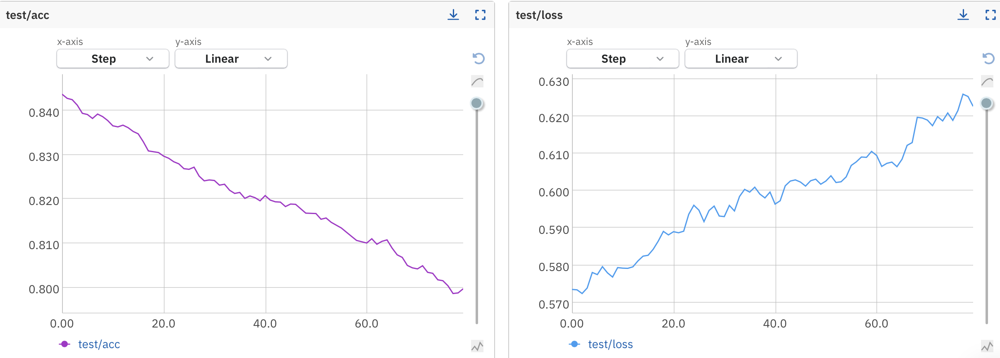

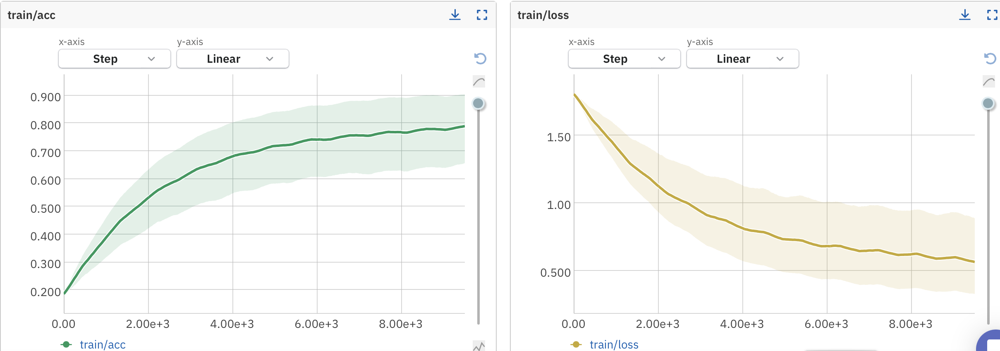

***Fisrt column: average***

***Second column: last sample***

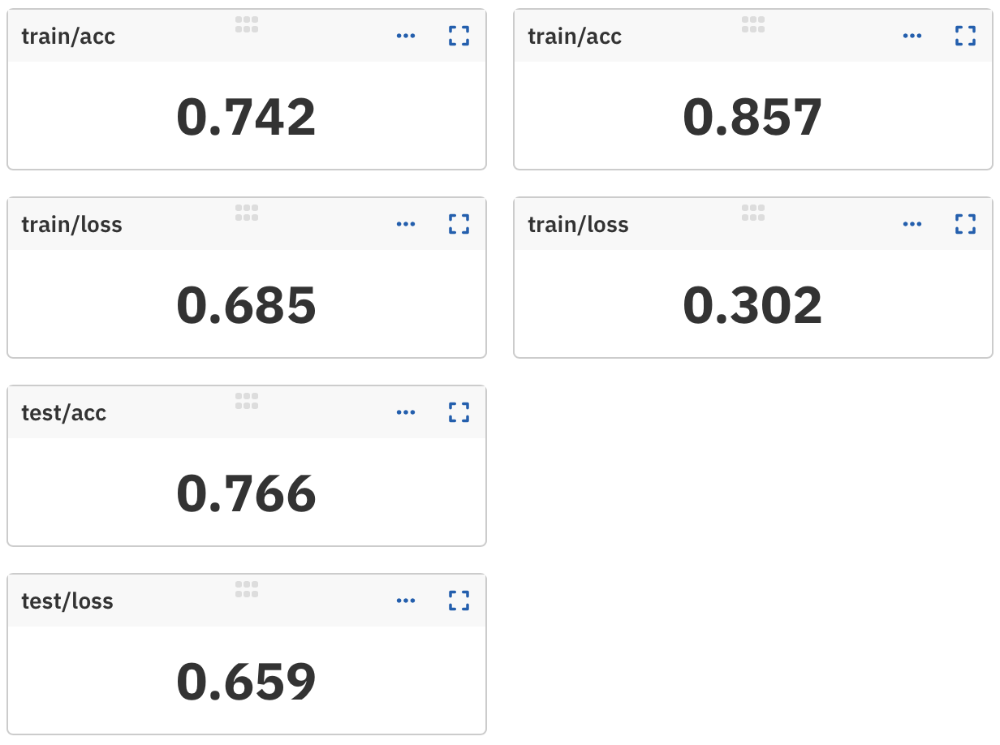

Unfortunately, the model did improve, but not as much as we expected. From the shape of the graphs, it is evident that the model learns with each epoch. However, to achieve the expected results (over 78% accuracy), we likely need to increase the number of epochs and deepen the network.

---

# Final Model Results - 78.6% accuracy

**Train:**

  * ***Accuracy - 85.7%***


* ***Loss - 0.298***


**Test:**
* ***Accuracy - 78.6%***



# Benchmarks

For benchmarking, we will compare my model with two other models from Kaggle.

The first model is [pre-trained ResNet18](https://www.kaggle.com/code/arbazkhan971/image-classification-using-cnn-94-accuracy/notebook) Convolutional Neural Net model, achieving an test accuracy of 94%.

The second model, is a [custom CNN](https://www.kaggle.com/code/nadaemad2002/intel-image-classification-cnn) architecture with deep net configuration.


Here's an overview of the models:


***Pre-trained ResNet18 Model:***

* **Architecture:** ResNet18 with pre-trained weights.
* **Number of Layers:** Deep architecture with multiple convolutional layers and residual connections.
* **Pretrained Model:** Yes, it's a pre-trained model on a large dataset.
* **Data Augmentation:** No.
* **Noise Filtering:** Not specified.

*  **Results:** 94% test accuracy.


***Model 2 - custom CNN:***

* **Architecture:**
 *   5 Conv2D layers
 *   5 MaxPooling layers
 *   1 Flatten leyer
 *   3 FC layers
 *   2 Dropout layers


* **Pretrained Model:** No, it's a custom architecture.
* **Data Augmentation:** No.
* **Noise Filtering:** Not specified.
* **Results:**  
 1.   train_loss: 0.3363
 2.   train_accuracy: 87.83%
 3.   val_loss: 0.7077
 4.   val_accuracy: 79.20%


Here's the comparison:

***My model currently achieves:***
 1.   train_loss: 0.298
 2.   train_accuracy: 85.7%
 3.   val_loss: 0.695
 4.   val_accuracy: 75.50%
 5.   test_accuracy:78.6%
 6.   test_loss:0.593



## Conclusion
First, the performance of the first model is excellent, primarily due to its use of a very deep and pre-trained architecture.

When considering the second model, it might seem intuitive to expect our model to perform similarly or even better. This second model, like ours, is not pre-trained, but it includes a different component that requires thoughtful consideration. The second model is significantly deeper than ours, containing more than 2 million internal computational parameters. When we designed our model, we accounted for our computational power limitations, which led us to develop a model that isn't as deep.

Despite this, our model achieves very good performance, possibly even surpassing the second model in some aspects. This success is attributed to the careful thought behind each decision in our network's design. Every hyperparameter was meticulously considered and tested to ensure the optimal value for our model.

Additionally, unlike the two comparison models, we examined the impact of noise in our data. Although the effect was found to be negligible, it was a crucial step in our model-building process. We also performed various augmentations to enhance our model's performance, carefully selecting each one.

It's important to acknowledge that while more can always be done, including building potentially better networks, we had to balance this with the project's time constraints. After careful consideration, we chose to "make lemonade out of lemons," optimizing our resources and constraints.

---

# Summary

Reflecting on this project, I realize how much I have learned and grown through this experience. Diving into the world of machine learning and deep learning has been an eye-opening journey that I have come to deeply appreciate. Despite the challenges, I thoroughly enjoyed working on this project and discovering new aspects of machine learning at every step.

From the outset, this project has been an exploration into unfamiliar territory. Starting with the basics of CNNs and progressing through various stages of data preparation, model building, and performance tuning, each phase has been a valuable learning experience. This project has not only honed my technical skills but also strengthened my problem-solving abilities and resilience.

**Several significant challenges throughout this project:**

1. **Understanding How to Start:** This was my first attempt into coding related to AI, and it was quite daunting. However, with time and persistence, I began to adapt. The need to understand every aspect of the process pushed me to gain a profound understanding of the subject matter. I had to dive deep into concepts, read numerous articles and tutorials, and constantly experiment with different approaches.
2. **Managing Expectations:** Despite my desire to create the perfect model, it was not feasible with the limited resources available. I had to learn to balance ambition with practicality. This meant accepting that some aspects of the project would need to be simplified or approached differently to fit within the constraints of time and computational power.
3. **The Major Challenge:** Lack of GPU time! 😊 It was a persistent struggle that added a humorous yet frustrating twist to the project. Waiting for GPU resources sometimes felt like an eternity.
4. **Discovering Issues at the Last Minute:** As I approached the project's noise removal phase, I discovered a critical issue — data leakage. Mishandling of indices and datasets meant that images were sorted differently with each run. This was a pivotal moment of uncertainty, but after half a day of extensive Googling, I identified and resolved the problem, enabling me to rerun the entire code from start to finish.
5. **Removing Irrelevant Components:** I performed many tasks that turned out to be unnecessary. After a discussion with my project advisor, Dr. Nir Schlesinger, I realized that certain hyperparameters (such as weight initialization and bias adjustments, adding dropout layers etc) did not need the extensive focus I initially gave them (without success in improving the model). This revelation helped streamline my efforts and saved considerable time. It was a lesson in prioritization and understanding which aspects of the model truly impact performance.

Through these challenges, I have learned to appreciate the intricate details involved in machine learning projects. The iterative nature of model building, where each adjustment can lead to new insights or require a rethinking of previous assumptions, has been both demanding and exhilarating.

After all the challenges mentioned above, I can now say unequivocally that if I had any doubts about pursuing a master's degree, this project has clarified my direction. The exposure to this field and the inherent uncertainties within it have only fueled my desire to delve deeper into the world of AI. It is clear to me now that my master's degree (hopefully) will focus on this fascinating subject.

In summary, this project was rewarding. The exposure to machine learning concepts and the hands-on experience have fueled my passion for the field. Despite the obstacles and the steep learning curve, I am proud of the progress I have made and look forward to continuing my journey in machine learning and artificial intelligence. This project has been a stepping stone, and I am excited about the future opportunities and projects that lie ahead.

---

I would like to extend my deepest gratitude to Dr. Nir Schlesinger for his invaluable guidance and support throughout this project. His insights and advice were instrumental in navigating the complexities of machine learning. Additionally, I want to thank everyone who takes the time to read this notebook. Your interest and engagement are greatly appreciated. Thank you for dedicating your time to exploring my project, and I hope it provides you with valuable insights and inspiration in your own machine learning journey.

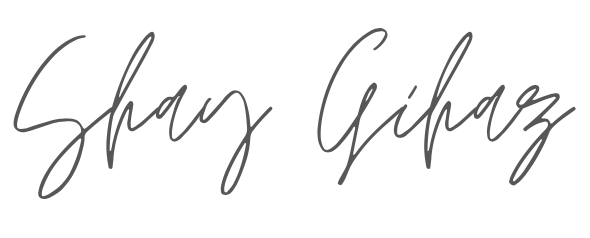